# Mask R-CNN Training and Inference
In this notebook we use Matterport's implementation of Mask R-CNN to train on a custom dataset, then use the trained weights to run inference on new images.

This is part of a tutorial posted at http://www.immersivelimit.com/tutorials/using-mask-r-cnn-on-custom-coco-like-dataset, so check there for more details.

### Not a beginner tutorial...
This is not intended to be a complete beginner tutorial.
- You should know how to clone a git repository from GitHub
- You should have a decent understanding of Python programming
- You should understand the basics of training deep neural networks. If you've never done it before, I wouldn't recommend starting here. Find a beginner deep learning tutorial/course and start there. There's lots of great free stuff on YouTube.

## **Download the Free Training Dataset First!
I've provided a free training dataset of cigarette butt images for use with this tutorial.
1. Download it from here: http://www.immersivelimit.com/datasets/cigarette-butts
2. Then extract the files and put it in the "../datasets" directory of this repo
3. The code below will be looking for "../datasets/cig_butts/train", "../datasets/cig_butts/val", and "../datasets/cig_butts/real_test"

In [1]:
import os
import sys
import json
import numpy as np
import time
from PIL import Image, ImageDraw

## Import Matterport's "mrcnn" libraries
1. I'm using a forked version of Matterport's Mask_RCNN git repo to make sure this code works, even if the main repo changes. As of July 29, 2018, there is a bug in Matterport's version that breaks loading an existing model that I've fixed in my version (and submitted a pull request to fix it in theirs).
  - My version is here: https://github.com/akTwelve/Mask_RCNN
  - The original is here: https://github.com/matterport/Mask_RCNN
2. Update the code cell below to point to the root directory of the repo on your machine.

In [2]:
# Set the ROOT_DIR variable to the root directory of the Mask_RCNN git repo
ROOT_DIR = '/home/biorobotica/Mobile_Mask_RCNN'
assert os.path.exists(ROOT_DIR), 'ROOT_DIR does not exist. Did you forget to read the instructions above? ;)'

# Import mrcnn libraries
sys.path.append(ROOT_DIR) 
from mmrcnn.config import Config
import mmrcnn.utils as utils
from mmrcnn import visualize
import mmrcnn.model as modellib


DEBUG:matplotlib.backends:backend module://ipykernel.pylab.backend_inline version unknown
Using TensorFlow backend.
DEBUG:matplotlib.backends:backend module://ipykernel.pylab.backend_inline version unknown


## Set up logging and pre-trained model paths
This will default to sub-directories in your mask_rcnn_dir, but if you want them somewhere else, updated it here.

It will also download the pre-trained coco model.

In [3]:
# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
#COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mobile_mask_rcnn_coco.h5")
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

## Configuration
Define configurations for training on the Cigarette Butt dataset.
### Note
These are settings that worked on my machine (GTX 970 graphics card). If you are getting OOM (Out of Memory) errors, you may need to tweak the settings or your computer may not be powerful enough. If you have a better graphics card, you will want to tweak it to take advantage of that.

In [4]:
class CustomCocoConfig(Config):
    """Configuration for training on the cigarette butts dataset.
    Derives from the base Config class and overrides values specific
    to the cigarette butts dataset.
    """
    # Give the configuration a recognizable name
    NAME = "tableware"

    # Train on 1 GPU and 1 image per GPU. Batch size is 1 (GPUs * images/GPU).
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

    # Number of classes (including background)
    NUM_CLASSES = 1 + 6  # background + 1 (cig_butt)

    # All of our training images are 512x512
    IMAGE_MIN_DIM = 512
    IMAGE_MAX_DIM = 512

    # You can experiment with this number to see if it improves training
    STEPS_PER_EPOCH = 1000

    # This is how often validation is run. If you are using too much hard drive space
    # on saved models (in the MODEL_DIR), try making this value larger.
    #VALIDATION_STEPS = 5
    VALIDATION_STEPS = 30
    
    # Matterport originally used resnet101, but I downsized to fit it on my graphics card
    #BACKBONE = 'mobilenetv1'
    BACKBONE = 'resnet50'
    #BACKBONE = 'resnet101'

    # To be honest, I haven't taken the time to figure out what these do
    RPN_ANCHOR_SCALES = (8, 16, 32, 64, 128)
    TRAIN_ROIS_PER_IMAGE = 32
    MAX_GT_INSTANCES = 50 
    POST_NMS_ROIS_INFERENCE = 500 
    POST_NMS_ROIS_TRAINING = 1000 
    
config = CustomCocoConfig()
config.display()


Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_MAX_DIM                  512
IMAGE_META_SIZE                19
IMAGE_MIN_DIM                  512
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [512 512   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'mrcnn_mask_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'rpn_class_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE                     [28, 28]
MAX_GT_INSTANCES               50
MEAN_PIXEL                     [123.7 116.8 103.9]
MINI

# Define the dataset
I've attempted to make this generic to any COCO-like dataset. That means if you have another dataset defined in the COCO format, it should work.

In [5]:
class CocoLikeDataset(utils.Dataset):
    """ Generates a COCO-like dataset, i.e. an image dataset annotated in the style of the COCO dataset.
        See http://cocodataset.org/#home for more information.
    """
    def load_data(self, annotation_json, images_dir):
        """ Load the coco-like dataset from json
        Args:
            annotation_json: The path to the coco annotations json file
            images_dir: The directory holding the images referred to by the json file
        """
        # Load json from file
        json_file = open(annotation_json)
        coco_json = json.load(json_file)
        json_file.close()
        
        # Add the class names using the base method from utils.Dataset
        source_name = "coco_like"
        for category in coco_json['categories']:
            class_id = category['id']
            class_name = category['name']
            if class_id < 1:
                print('Error: Class id for "{}" cannot be less than one. (0 is reserved for the background)'.format(class_name))
                return
            
            self.add_class(source_name, class_id, class_name)
        
        # Get all annotations
        annotations = {}
        for annotation in coco_json['annotations']:
            image_id = annotation['image_id']
            if image_id not in annotations:
                annotations[image_id] = []
            annotations[image_id].append(annotation)
        
        # Get all images and add them to the dataset
        seen_images = {}
        for image in coco_json['images']:
            image_id = image['id']
            if image_id in seen_images:
                print("Warning: Skipping duplicate image id: {}".format(image))
            else:
                seen_images[image_id] = image
                try:
                    image_file_name = image['file_name']
                    image_width = image['width']
                    image_height = image['height']
                except KeyError as key:
                    print("Warning: Skipping image (id: {}) with missing key: {}".format(image_id, key))
                
                image_path = os.path.abspath(os.path.join(images_dir, image_file_name))
                image_annotations = annotations[image_id]
                
                # Add the image using the base method from utils.Dataset
                self.add_image(
                    source=source_name,
                    image_id=image_id,
                    path=image_path,
                    width=image_width,
                    height=image_height,
                    annotations=image_annotations
                )
                
    def load_mask(self, image_id):
        """ Load instance masks for the given image.
        MaskRCNN expects masks in the form of a bitmap [height, width, instances].
        Args:
            image_id: The id of the image to load masks for
        Returns:
            masks: A bool array of shape [height, width, instance count] with
                one mask per instance.
            class_ids: a 1D array of class IDs of the instance masks.
        """
        image_info = self.image_info[image_id]
        annotations = image_info['annotations']
        instance_masks = []
        class_ids = []
        
        for annotation in annotations:
            class_id = annotation['category_id']
            mask = Image.new('1', (image_info['width'], image_info['height']))
            mask_draw = ImageDraw.ImageDraw(mask, '1')
            for segmentation in annotation['segmentation']:
                mask_draw.polygon(segmentation, fill=1)
                bool_array = np.array(mask) > 0
                instance_masks.append(bool_array)
                class_ids.append(class_id)

        mask = np.dstack(instance_masks)
        class_ids = np.array(class_ids, dtype=np.int32)
        
        return mask, class_ids

# Create the Training and Validation Datasets
Make sure you download the training dataset linked at the top of this notebook. If you put the dataset somewhere else, update the paths below.

In [6]:
dataset_train = CocoLikeDataset()
#dataset_train.load_data('/home/biorobotica/docker_volumen/datasets/tableware/train/annotations/instances_tableware_train2019.json', '/home/biorobotica/docker_volumen/datasets/tableware/train/tableware_train2019/')
dataset_train.load_data('/home/biorobotica/docker_volumen/datasets/tableware/train/instances_tableware_train.json', '/home/biorobotica/docker_volumen/datasets/tableware/train/images/')
dataset_train.prepare()

dataset_val = CocoLikeDataset()
#dataset_val.load_data('/home/biorobotica/docker_volumen/datasets/tableware/val/annotations/instances_tableware_val2019.json', '/home/biorobotica/docker_volumen/datasets/tableware/val/tableware_val2019/')
dataset_val.load_data('/home/biorobotica/docker_volumen/datasets/tableware/val/instances_tableware_val.json', '/home/biorobotica/docker_volumen/datasets/tableware/val/images/')
dataset_val.prepare()

## Display a few images from the training dataset

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:matplotlib.font_manager:findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=9.0 to DejaVu Sans (u'/usr/local/lib/python2.7/dist-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf') with score of 0.050000
DEBUG:matplotlib.font_manager:findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0 to DejaVu Sans (u'/usr/local/lib/python2.7/dist-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf') with score of 0.050000


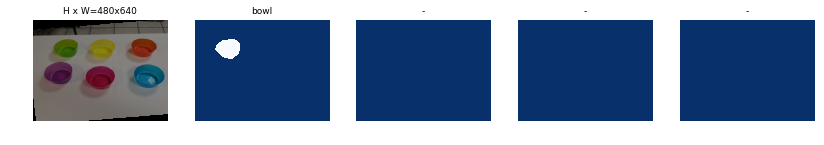

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


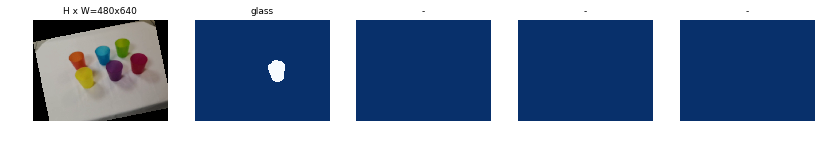

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


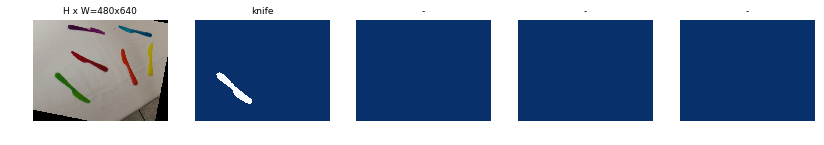

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


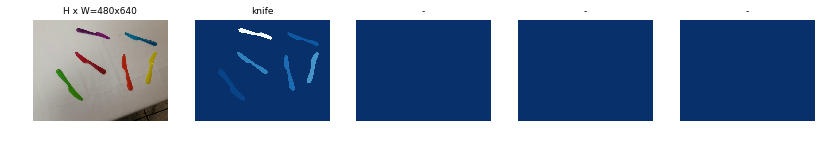

In [7]:
dataset = dataset_train
image_ids = np.random.choice(dataset.image_ids, 4)
for image_id in image_ids:
    image = dataset.load_image(image_id)
    mask, class_ids = dataset.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, dataset.class_names)

# Create the Training Model and Train
This code is largely borrowed from the train_shapes.ipynb notebook.

In [8]:
# Create model in training mode
model = modellib.MaskRCNN(mode="training", config=config,
                          model_dir=MODEL_DIR)

In [9]:
# Which weights to start with?
init_with = "coco"  # imagenet, coco, or last

if init_with == "imagenet":
    model.load_weights(model.get_imagenet_weights(), by_name=True)
elif init_with == "coco":
    # Load weights trained on MS COCO, but skip layers that
    # are different due to the different number of classes
    # See README for instructions to download the COCO weights
    model.load_weights(COCO_MODEL_PATH, by_name=True,
                       exclude=["mrcnn_class_logits", "mrcnn_bbox_fc", 
                                "mrcnn_bbox", "mrcnn_mask"])
elif init_with == "last":
    # Load the last model you trained and continue training
    model.load_weights(model.find_last(), by_name=True)

## Training

Train in two stages:

1. Only the heads. Here we're freezing all the backbone layers and training only the randomly initialized layers (i.e. the ones that we didn't use pre-trained weights from MS COCO). To train only the head layers, pass layers='heads' to the train() function.

2. Fine-tune all layers. For this simple example it's not necessary, but we're including it to show the process. Simply pass layers="all to train all layers.



In [11]:
# Train the head branches
# Passing layers="heads" freezes all layers except the head
# layers. You can also pass a regular expression to select
# which layers to train by name pattern.
start_train = time.time()
model.train(dataset_train, dataset_val, 
            learning_rate=config.LEARNING_RATE, 
            #epochs=4, 
            epochs=50,
            layers='heads')
end_train = time.time()
minutes = round((end_train - start_train) / 60, 2)
#print(f'Training took {minutes} minutes')


Starting at epoch 0. LR=0.001

Checkpoint Path: /home/biorobotica/Mobile_Mask_RCNN/logs/512_tableware20190419T0619/mask_rcnn_512_tableware_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4       (

/usr/local/lib/python2.7/dist-packages/tensorflow/python/ops/gradients_impl.py:112: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/home/biorobotica/.local/lib/python2.7/site-packages/keras/engine/training.py:2087: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM '

Epoch 1/50


/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugi

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   8/1000 [..............................] - ETA: 36:07 - loss: 3.2718 - rpn_class_loss: 0.0198 - rpn_bbox_loss: 0.9089 - mrcnn_class_loss: 0.9289 - mrcnn_bbox_loss: 0.8293 - mrcnn_mask_loss: 0.5848

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 20:59 - loss: 2.9234 - rpn_class_loss: 0.0164 - rpn_bbox_loss: 1.1043 - mrcnn_class_loss: 0.5395 - mrcnn_bbox_loss: 0.6870 - mrcnn_mask_loss: 0.5762

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 15:49 - loss: 3.1049 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.9895 - mrcnn_class_loss: 0.5280 - mrcnn_bbox_loss: 0.8531 - mrcnn_mask_loss: 0.7207

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  25/1000 [..............................] - ETA: 15:25 - loss: 3.1438 - rpn_class_loss: 0.0148 - rpn_bbox_loss: 0.9960 - mrcnn_class_loss: 0.5305 - mrcnn_bbox_loss: 0.8650 - mrcnn_mask_loss: 0.7375

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  33/1000 [..............................] - ETA: 13:00 - loss: 3.0869 - rpn_class_loss: 0.0165 - rpn_bbox_loss: 0.9257 - mrcnn_class_loss: 0.5373 - mrcnn_bbox_loss: 0.8608 - mrcnn_mask_loss: 0.7465

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 11:41 - loss: 3.0666 - rpn_class_loss: 0.0173 - rpn_bbox_loss: 0.9182 - mrcnn_class_loss: 0.5395 - mrcnn_bbox_loss: 0.8655 - mrcnn_mask_loss: 0.7260

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  42/1000 [>.............................] - ETA: 11:22 - loss: 2.9734 - rpn_class_loss: 0.0169 - rpn_bbox_loss: 0.9056 - mrcnn_class_loss: 0.5156 - mrcnn_bbox_loss: 0.8340 - mrcnn_mask_loss: 0.7013

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  50/1000 [>.............................] - ETA: 10:25 - loss: 2.8001 - rpn_class_loss: 0.0163 - rpn_bbox_loss: 0.9049 - mrcnn_class_loss: 0.4636 - mrcnn_bbox_loss: 0.7697 - mrcnn_mask_loss: 0.6456

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 9:42 - loss: 2.7424 - rpn_class_loss: 0.0170 - rpn_bbox_loss: 0.9034 - mrcnn_class_loss: 0.4485 - mrcnn_bbox_loss: 0.7558 - mrcnn_mask_loss: 0.6177

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  66/1000 [>.............................] - ETA: 9:08 - loss: 2.6710 - rpn_class_loss: 0.0165 - rpn_bbox_loss: 0.8899 - mrcnn_class_loss: 0.4354 - mrcnn_bbox_loss: 0.7356 - mrcnn_mask_loss: 0.5936

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  74/1000 [=>............................] - ETA: 8:40 - loss: 2.6050 - rpn_class_loss: 0.0165 - rpn_bbox_loss: 0.8776 - mrcnn_class_loss: 0.4187 - mrcnn_bbox_loss: 0.7106 - mrcnn_mask_loss: 0.5816

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  82/1000 [=>............................] - ETA: 8:18 - loss: 2.5457 - rpn_class_loss: 0.0159 - rpn_bbox_loss: 0.8782 - mrcnn_class_loss: 0.3960 - mrcnn_bbox_loss: 0.6937 - mrcnn_mask_loss: 0.5619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  90/1000 [=>............................] - ETA: 7:59 - loss: 2.4825 - rpn_class_loss: 0.0157 - rpn_bbox_loss: 0.8509 - mrcnn_class_loss: 0.3836 - mrcnn_bbox_loss: 0.6887 - mrcnn_mask_loss: 0.5436

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  98/1000 [=>............................] - ETA: 7:43 - loss: 2.4009 - rpn_class_loss: 0.0157 - rpn_bbox_loss: 0.8235 - mrcnn_class_loss: 0.3720 - mrcnn_bbox_loss: 0.6691 - mrcnn_mask_loss: 0.5206

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 106/1000 [==>...........................] - ETA: 7:29 - loss: 2.3298 - rpn_class_loss: 0.0154 - rpn_bbox_loss: 0.8262 - mrcnn_class_loss: 0.3537 - mrcnn_bbox_loss: 0.6349 - mrcnn_mask_loss: 0.4996

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 114/1000 [==>...........................] - ETA: 7:17 - loss: 2.2828 - rpn_class_loss: 0.0149 - rpn_bbox_loss: 0.8286 - mrcnn_class_loss: 0.3388 - mrcnn_bbox_loss: 0.6196 - mrcnn_mask_loss: 0.4809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 122/1000 [==>...........................] - ETA: 7:06 - loss: 2.2419 - rpn_class_loss: 0.0147 - rpn_bbox_loss: 0.8364 - mrcnn_class_loss: 0.3294 - mrcnn_bbox_loss: 0.5974 - mrcnn_mask_loss: 0.4640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 130/1000 [==>...........................] - ETA: 6:55 - loss: 2.2029 - rpn_class_loss: 0.0148 - rpn_bbox_loss: 0.8272 - mrcnn_class_loss: 0.3263 - mrcnn_bbox_loss: 0.5843 - mrcnn_mask_loss: 0.4503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 6:46 - loss: 2.1745 - rpn_class_loss: 0.0146 - rpn_bbox_loss: 0.8270 - mrcnn_class_loss: 0.3236 - mrcnn_bbox_loss: 0.5704 - mrcnn_mask_loss: 0.4388

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 6:37 - loss: 2.1401 - rpn_class_loss: 0.0144 - rpn_bbox_loss: 0.8180 - mrcnn_class_loss: 0.3126 - mrcnn_bbox_loss: 0.5644 - mrcnn_mask_loss: 0.4307

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 6:29 - loss: 2.0950 - rpn_class_loss: 0.0142 - rpn_bbox_loss: 0.8073 - mrcnn_class_loss: 0.3039 - mrcnn_bbox_loss: 0.5540 - mrcnn_mask_loss: 0.4155

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 6:23 - loss: 2.0671 - rpn_class_loss: 0.0140 - rpn_bbox_loss: 0.8031 - mrcnn_class_loss: 0.2960 - mrcnn_bbox_loss: 0.5481 - mrcnn_mask_loss: 0.4059

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 167/1000 [====>.........................] - ETA: 6:19 - loss: 2.0479 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.7987 - mrcnn_class_loss: 0.2917 - mrcnn_bbox_loss: 0.5462 - mrcnn_mask_loss: 0.3976

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 172/1000 [====>.........................] - ETA: 6:16 - loss: 2.0400 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.8063 - mrcnn_class_loss: 0.2857 - mrcnn_bbox_loss: 0.5453 - mrcnn_mask_loss: 0.3890

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 6:13 - loss: 2.0325 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.8035 - mrcnn_class_loss: 0.2891 - mrcnn_bbox_loss: 0.5426 - mrcnn_mask_loss: 0.3837

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 6:10 - loss: 2.0168 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.7999 - mrcnn_class_loss: 0.2861 - mrcnn_bbox_loss: 0.5375 - mrcnn_mask_loss: 0.3799

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 6:06 - loss: 1.9948 - rpn_class_loss: 0.0134 - rpn_bbox_loss: 0.7906 - mrcnn_class_loss: 0.2842 - mrcnn_bbox_loss: 0.5323 - mrcnn_mask_loss: 0.3743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 193/1000 [====>.........................] - ETA: 6:00 - loss: 1.9907 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.8027 - mrcnn_class_loss: 0.2772 - mrcnn_bbox_loss: 0.5269 - mrcnn_mask_loss: 0.3706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 5:54 - loss: 1.9923 - rpn_class_loss: 0.0133 - rpn_bbox_loss: 0.8239 - mrcnn_class_loss: 0.2736 - mrcnn_bbox_loss: 0.5173 - mrcnn_mask_loss: 0.3643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 209/1000 [=====>........................] - ETA: 5:48 - loss: 1.9736 - rpn_class_loss: 0.0133 - rpn_bbox_loss: 0.8199 - mrcnn_class_loss: 0.2726 - mrcnn_bbox_loss: 0.5129 - mrcnn_mask_loss: 0.3549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 217/1000 [=====>........................] - ETA: 5:42 - loss: 1.9394 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.8069 - mrcnn_class_loss: 0.2672 - mrcnn_bbox_loss: 0.5041 - mrcnn_mask_loss: 0.3481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 225/1000 [=====>........................] - ETA: 5:37 - loss: 1.9240 - rpn_class_loss: 0.0130 - rpn_bbox_loss: 0.7996 - mrcnn_class_loss: 0.2642 - mrcnn_bbox_loss: 0.5051 - mrcnn_mask_loss: 0.3421

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 5:33 - loss: 1.9198 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.8063 - mrcnn_class_loss: 0.2638 - mrcnn_bbox_loss: 0.5003 - mrcnn_mask_loss: 0.3363

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 5:30 - loss: 1.9075 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.8027 - mrcnn_class_loss: 0.2616 - mrcnn_bbox_loss: 0.4971 - mrcnn_mask_loss: 0.3331

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 237/1000 [======>.......................] - ETA: 5:29 - loss: 1.8996 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.8008 - mrcnn_class_loss: 0.2597 - mrcnn_bbox_loss: 0.4948 - mrcnn_mask_loss: 0.3312

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 5:27 - loss: 1.8984 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.8019 - mrcnn_class_loss: 0.2590 - mrcnn_bbox_loss: 0.4952 - mrcnn_mask_loss: 0.3291

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 245/1000 [======>.......................] - ETA: 5:24 - loss: 1.8927 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.8031 - mrcnn_class_loss: 0.2577 - mrcnn_bbox_loss: 0.4940 - mrcnn_mask_loss: 0.3248

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 5:19 - loss: 1.8781 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.8011 - mrcnn_class_loss: 0.2568 - mrcnn_bbox_loss: 0.4889 - mrcnn_mask_loss: 0.3183

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 257/1000 [======>.......................] - ETA: 5:16 - loss: 1.8668 - rpn_class_loss: 0.0130 - rpn_bbox_loss: 0.7973 - mrcnn_class_loss: 0.2551 - mrcnn_bbox_loss: 0.4862 - mrcnn_mask_loss: 0.3152

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 5:13 - loss: 1.8559 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.7929 - mrcnn_class_loss: 0.2527 - mrcnn_bbox_loss: 0.4855 - mrcnn_mask_loss: 0.3119

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 270/1000 [=======>......................] - ETA: 5:09 - loss: 1.8498 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.8013 - mrcnn_class_loss: 0.2501 - mrcnn_bbox_loss: 0.4797 - mrcnn_mask_loss: 0.3058

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 278/1000 [=======>......................] - ETA: 5:04 - loss: 1.8416 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.8058 - mrcnn_class_loss: 0.2476 - mrcnn_bbox_loss: 0.4754 - mrcnn_mask_loss: 0.3000

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 286/1000 [=======>......................] - ETA: 5:00 - loss: 1.8315 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.8051 - mrcnn_class_loss: 0.2470 - mrcnn_bbox_loss: 0.4708 - mrcnn_mask_loss: 0.2957

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 294/1000 [=======>......................] - ETA: 4:55 - loss: 1.8167 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.8015 - mrcnn_class_loss: 0.2451 - mrcnn_bbox_loss: 0.4671 - mrcnn_mask_loss: 0.2903

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 296/1000 [=======>......................] - ETA: 4:54 - loss: 1.8142 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.8007 - mrcnn_class_loss: 0.2454 - mrcnn_bbox_loss: 0.4656 - mrcnn_mask_loss: 0.2896

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 299/1000 [=======>......................] - ETA: 4:52 - loss: 1.8056 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.7991 - mrcnn_class_loss: 0.2439 - mrcnn_bbox_loss: 0.4621 - mrcnn_mask_loss: 0.2877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 305/1000 [========>.....................] - ETA: 4:49 - loss: 1.7948 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.7961 - mrcnn_class_loss: 0.2408 - mrcnn_bbox_loss: 0.4593 - mrcnn_mask_loss: 0.2859

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 4:46 - loss: 1.7838 - rpn_class_loss: 0.0126 - rpn_bbox_loss: 0.7974 - mrcnn_class_loss: 0.2375 - mrcnn_bbox_loss: 0.4541 - mrcnn_mask_loss: 0.2822

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 314/1000 [========>.....................] - ETA: 4:44 - loss: 1.7777 - rpn_class_loss: 0.0125 - rpn_bbox_loss: 0.7964 - mrcnn_class_loss: 0.2366 - mrcnn_bbox_loss: 0.4516 - mrcnn_mask_loss: 0.2807

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 4:40 - loss: 1.7658 - rpn_class_loss: 0.0124 - rpn_bbox_loss: 0.7931 - mrcnn_class_loss: 0.2335 - mrcnn_bbox_loss: 0.4501 - mrcnn_mask_loss: 0.2767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 330/1000 [========>.....................] - ETA: 4:36 - loss: 1.7519 - rpn_class_loss: 0.0123 - rpn_bbox_loss: 0.7901 - mrcnn_class_loss: 0.2305 - mrcnn_bbox_loss: 0.4456 - mrcnn_mask_loss: 0.2734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 331/1000 [========>.....................] - ETA: 4:36 - loss: 1.7497 - rpn_class_loss: 0.0123 - rpn_bbox_loss: 0.7899 - mrcnn_class_loss: 0.2298 - mrcnn_bbox_loss: 0.4449 - mrcnn_mask_loss: 0.2728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:32 - loss: 1.7317 - rpn_class_loss: 0.0121 - rpn_bbox_loss: 0.7830 - mrcnn_class_loss: 0.2260 - mrcnn_bbox_loss: 0.4399 - mrcnn_mask_loss: 0.2706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 347/1000 [=========>....................] - ETA: 4:28 - loss: 1.7208 - rpn_class_loss: 0.0121 - rpn_bbox_loss: 0.7774 - mrcnn_class_loss: 0.2248 - mrcnn_bbox_loss: 0.4392 - mrcnn_mask_loss: 0.2673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 4:24 - loss: 1.7050 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.7725 - mrcnn_class_loss: 0.2220 - mrcnn_bbox_loss: 0.4345 - mrcnn_mask_loss: 0.2641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 363/1000 [=========>....................] - ETA: 4:20 - loss: 1.6962 - rpn_class_loss: 0.0121 - rpn_bbox_loss: 0.7695 - mrcnn_class_loss: 0.2218 - mrcnn_bbox_loss: 0.4323 - mrcnn_mask_loss: 0.2606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:16 - loss: 1.6823 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.7648 - mrcnn_class_loss: 0.2195 - mrcnn_bbox_loss: 0.4283 - mrcnn_mask_loss: 0.2576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 4:13 - loss: 1.6710 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.7595 - mrcnn_class_loss: 0.2192 - mrcnn_bbox_loss: 0.4255 - mrcnn_mask_loss: 0.2548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:12 - loss: 1.6709 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.7596 - mrcnn_class_loss: 0.2195 - mrcnn_bbox_loss: 0.4258 - mrcnn_mask_loss: 0.2541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 382/1000 [==========>...................] - ETA: 4:11 - loss: 1.6686 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.7620 - mrcnn_class_loss: 0.2183 - mrcnn_bbox_loss: 0.4236 - mrcnn_mask_loss: 0.2527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 4:08 - loss: 1.6568 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.7596 - mrcnn_class_loss: 0.2164 - mrcnn_bbox_loss: 0.4185 - mrcnn_mask_loss: 0.2506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 397/1000 [==========>...................] - ETA: 4:04 - loss: 1.6498 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.7561 - mrcnn_class_loss: 0.2166 - mrcnn_bbox_loss: 0.4176 - mrcnn_mask_loss: 0.2478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 405/1000 [===========>..................] - ETA: 4:00 - loss: 1.6471 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.7546 - mrcnn_class_loss: 0.2151 - mrcnn_bbox_loss: 0.4202 - mrcnn_mask_loss: 0.2452

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 406/1000 [===========>..................] - ETA: 4:00 - loss: 1.6477 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.7554 - mrcnn_class_loss: 0.2151 - mrcnn_bbox_loss: 0.4204 - mrcnn_mask_loss: 0.2450

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 3:56 - loss: 1.6378 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.7528 - mrcnn_class_loss: 0.2124 - mrcnn_bbox_loss: 0.4180 - mrcnn_mask_loss: 0.2426

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 422/1000 [===========>..................] - ETA: 3:53 - loss: 1.6243 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.7512 - mrcnn_class_loss: 0.2096 - mrcnn_bbox_loss: 0.4126 - mrcnn_mask_loss: 0.2391

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 3:49 - loss: 1.6198 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.7484 - mrcnn_class_loss: 0.2108 - mrcnn_bbox_loss: 0.4120 - mrcnn_mask_loss: 0.2367

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 3:46 - loss: 1.6109 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.7482 - mrcnn_class_loss: 0.2085 - mrcnn_bbox_loss: 0.4083 - mrcnn_mask_loss: 0.2340

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 446/1000 [============>.................] - ETA: 3:42 - loss: 1.5997 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.7427 - mrcnn_class_loss: 0.2086 - mrcnn_bbox_loss: 0.4046 - mrcnn_mask_loss: 0.2319

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:39 - loss: 1.5920 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.7400 - mrcnn_class_loss: 0.2093 - mrcnn_bbox_loss: 0.4012 - mrcnn_mask_loss: 0.2298

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 455/1000 [============>.................] - ETA: 3:38 - loss: 1.5923 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.7395 - mrcnn_class_loss: 0.2098 - mrcnn_bbox_loss: 0.4015 - mrcnn_mask_loss: 0.2297

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:35 - loss: 1.5857 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.7354 - mrcnn_class_loss: 0.2102 - mrcnn_bbox_loss: 0.4007 - mrcnn_mask_loss: 0.2276

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 471/1000 [=============>................] - ETA: 3:31 - loss: 1.5742 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.7295 - mrcnn_class_loss: 0.2090 - mrcnn_bbox_loss: 0.3978 - mrcnn_mask_loss: 0.2262

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 3:28 - loss: 1.5688 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.7282 - mrcnn_class_loss: 0.2090 - mrcnn_bbox_loss: 0.3955 - mrcnn_mask_loss: 0.2245

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 3:24 - loss: 1.5586 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.7246 - mrcnn_class_loss: 0.2077 - mrcnn_bbox_loss: 0.3921 - mrcnn_mask_loss: 0.2227

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 3:21 - loss: 1.5508 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.7233 - mrcnn_class_loss: 0.2052 - mrcnn_bbox_loss: 0.3902 - mrcnn_mask_loss: 0.2206

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:17 - loss: 1.5430 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.7210 - mrcnn_class_loss: 0.2040 - mrcnn_bbox_loss: 0.3878 - mrcnn_mask_loss: 0.2188

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:14 - loss: 1.5374 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.7199 - mrcnn_class_loss: 0.2029 - mrcnn_bbox_loss: 0.3862 - mrcnn_mask_loss: 0.2170

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 519/1000 [==============>...............] - ETA: 3:11 - loss: 1.5331 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.7206 - mrcnn_class_loss: 0.2017 - mrcnn_bbox_loss: 0.3841 - mrcnn_mask_loss: 0.2154

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 524/1000 [==============>...............] - ETA: 3:09 - loss: 1.5291 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.7184 - mrcnn_class_loss: 0.2021 - mrcnn_bbox_loss: 0.3829 - mrcnn_mask_loss: 0.2144

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 532/1000 [==============>...............] - ETA: 3:05 - loss: 1.5292 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.7208 - mrcnn_class_loss: 0.2038 - mrcnn_bbox_loss: 0.3805 - mrcnn_mask_loss: 0.2127

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 540/1000 [===============>..............] - ETA: 3:02 - loss: 1.5260 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.7229 - mrcnn_class_loss: 0.2029 - mrcnn_bbox_loss: 0.3782 - mrcnn_mask_loss: 0.2106

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 548/1000 [===============>..............] - ETA: 2:59 - loss: 1.5201 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.7209 - mrcnn_class_loss: 0.2034 - mrcnn_bbox_loss: 0.3755 - mrcnn_mask_loss: 0.2090

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 555/1000 [===============>..............] - ETA: 2:56 - loss: 1.5141 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.7188 - mrcnn_class_loss: 0.2028 - mrcnn_bbox_loss: 0.3737 - mrcnn_mask_loss: 0.2075

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 557/1000 [===============>..............] - ETA: 2:55 - loss: 1.5111 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.7168 - mrcnn_class_loss: 0.2030 - mrcnn_bbox_loss: 0.3730 - mrcnn_mask_loss: 0.2071

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 565/1000 [===============>..............] - ETA: 2:52 - loss: 1.5122 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.7189 - mrcnn_class_loss: 0.2028 - mrcnn_bbox_loss: 0.3725 - mrcnn_mask_loss: 0.2068

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 566/1000 [===============>..............] - ETA: 2:52 - loss: 1.5109 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.7178 - mrcnn_class_loss: 0.2031 - mrcnn_bbox_loss: 0.3723 - mrcnn_mask_loss: 0.2065

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 574/1000 [================>.............] - ETA: 2:48 - loss: 1.5071 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.7156 - mrcnn_class_loss: 0.2043 - mrcnn_bbox_loss: 0.3710 - mrcnn_mask_loss: 0.2051

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 2:45 - loss: 1.5031 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.7166 - mrcnn_class_loss: 0.2027 - mrcnn_bbox_loss: 0.3694 - mrcnn_mask_loss: 0.2033

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 590/1000 [================>.............] - ETA: 2:42 - loss: 1.5031 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.7206 - mrcnn_class_loss: 0.2026 - mrcnn_bbox_loss: 0.3668 - mrcnn_mask_loss: 0.2019

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 598/1000 [================>.............] - ETA: 2:39 - loss: 1.4958 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.7194 - mrcnn_class_loss: 0.2009 - mrcnn_bbox_loss: 0.3642 - mrcnn_mask_loss: 0.2002

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 606/1000 [=================>............] - ETA: 2:36 - loss: 1.4860 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.7148 - mrcnn_class_loss: 0.2000 - mrcnn_bbox_loss: 0.3616 - mrcnn_mask_loss: 0.1985

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 614/1000 [=================>............] - ETA: 2:33 - loss: 1.4792 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.7137 - mrcnn_class_loss: 0.1986 - mrcnn_bbox_loss: 0.3587 - mrcnn_mask_loss: 0.1971

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:30 - loss: 1.4731 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.7096 - mrcnn_class_loss: 0.1985 - mrcnn_bbox_loss: 0.3571 - mrcnn_mask_loss: 0.1967

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 623/1000 [=================>............] - ETA: 2:29 - loss: 1.4718 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.7101 - mrcnn_class_loss: 0.1979 - mrcnn_bbox_loss: 0.3565 - mrcnn_mask_loss: 0.1963

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 624/1000 [=================>............] - ETA: 2:29 - loss: 1.4712 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.7097 - mrcnn_class_loss: 0.1976 - mrcnn_bbox_loss: 0.3568 - mrcnn_mask_loss: 0.1961

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:28 - loss: 1.4702 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.7092 - mrcnn_class_loss: 0.1975 - mrcnn_bbox_loss: 0.3567 - mrcnn_mask_loss: 0.1958

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 633/1000 [=================>............] - ETA: 2:25 - loss: 1.4627 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.7061 - mrcnn_class_loss: 0.1964 - mrcnn_bbox_loss: 0.3546 - mrcnn_mask_loss: 0.1946

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 641/1000 [==================>...........] - ETA: 2:22 - loss: 1.4623 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.7079 - mrcnn_class_loss: 0.1963 - mrcnn_bbox_loss: 0.3537 - mrcnn_mask_loss: 0.1935

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 649/1000 [==================>...........] - ETA: 2:19 - loss: 1.4549 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.7038 - mrcnn_class_loss: 0.1959 - mrcnn_bbox_loss: 0.3520 - mrcnn_mask_loss: 0.1923

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 657/1000 [==================>...........] - ETA: 2:16 - loss: 1.4512 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.7028 - mrcnn_class_loss: 0.1955 - mrcnn_bbox_loss: 0.3509 - mrcnn_mask_loss: 0.1911

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 665/1000 [==================>...........] - ETA: 2:12 - loss: 1.4440 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.6997 - mrcnn_class_loss: 0.1944 - mrcnn_bbox_loss: 0.3484 - mrcnn_mask_loss: 0.1905

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 2:09 - loss: 1.4367 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.6972 - mrcnn_class_loss: 0.1935 - mrcnn_bbox_loss: 0.3457 - mrcnn_mask_loss: 0.1895

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 678/1000 [===================>..........] - ETA: 2:07 - loss: 1.4325 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.6951 - mrcnn_class_loss: 0.1925 - mrcnn_bbox_loss: 0.3453 - mrcnn_mask_loss: 0.1888

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 682/1000 [===================>..........] - ETA: 2:06 - loss: 1.4281 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.6923 - mrcnn_class_loss: 0.1922 - mrcnn_bbox_loss: 0.3441 - mrcnn_mask_loss: 0.1888

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 690/1000 [===================>..........] - ETA: 2:03 - loss: 1.4233 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.6919 - mrcnn_class_loss: 0.1907 - mrcnn_bbox_loss: 0.3425 - mrcnn_mask_loss: 0.1875

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 698/1000 [===================>..........] - ETA: 1:59 - loss: 1.4194 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.6906 - mrcnn_class_loss: 0.1910 - mrcnn_bbox_loss: 0.3408 - mrcnn_mask_loss: 0.1864

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 706/1000 [====================>.........] - ETA: 1:56 - loss: 1.4187 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.6908 - mrcnn_class_loss: 0.1923 - mrcnn_bbox_loss: 0.3393 - mrcnn_mask_loss: 0.1854

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 712/1000 [====================>.........] - ETA: 1:54 - loss: 1.4144 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.6898 - mrcnn_class_loss: 0.1917 - mrcnn_bbox_loss: 0.3376 - mrcnn_mask_loss: 0.1846

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 1:53 - loss: 1.4128 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.6900 - mrcnn_class_loss: 0.1913 - mrcnn_bbox_loss: 0.3367 - mrcnn_mask_loss: 0.1841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 723/1000 [====================>.........] - ETA: 1:50 - loss: 1.4094 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.6886 - mrcnn_class_loss: 0.1916 - mrcnn_bbox_loss: 0.3351 - mrcnn_mask_loss: 0.1835

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 1:46 - loss: 1.4084 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.6885 - mrcnn_class_loss: 0.1919 - mrcnn_bbox_loss: 0.3349 - mrcnn_mask_loss: 0.1824

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 739/1000 [=====================>........] - ETA: 1:43 - loss: 1.4050 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6879 - mrcnn_class_loss: 0.1914 - mrcnn_bbox_loss: 0.3337 - mrcnn_mask_loss: 0.1814

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 1:43 - loss: 1.4035 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6870 - mrcnn_class_loss: 0.1912 - mrcnn_bbox_loss: 0.3334 - mrcnn_mask_loss: 0.1813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 1:40 - loss: 1.3997 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6858 - mrcnn_class_loss: 0.1900 - mrcnn_bbox_loss: 0.3325 - mrcnn_mask_loss: 0.1809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 1:37 - loss: 1.3965 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6867 - mrcnn_class_loss: 0.1885 - mrcnn_bbox_loss: 0.3301 - mrcnn_mask_loss: 0.1805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 762/1000 [=====================>........] - ETA: 1:34 - loss: 1.3901 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6837 - mrcnn_class_loss: 0.1878 - mrcnn_bbox_loss: 0.3284 - mrcnn_mask_loss: 0.1797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:33 - loss: 1.3901 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6835 - mrcnn_class_loss: 0.1889 - mrcnn_bbox_loss: 0.3278 - mrcnn_mask_loss: 0.1794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 773/1000 [======================>.......] - ETA: 1:30 - loss: 1.3886 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6838 - mrcnn_class_loss: 0.1888 - mrcnn_bbox_loss: 0.3270 - mrcnn_mask_loss: 0.1785

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 775/1000 [======================>.......] - ETA: 1:29 - loss: 1.3878 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.6835 - mrcnn_class_loss: 0.1890 - mrcnn_bbox_loss: 0.3266 - mrcnn_mask_loss: 0.1782

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:26 - loss: 1.3855 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6829 - mrcnn_class_loss: 0.1892 - mrcnn_bbox_loss: 0.3255 - mrcnn_mask_loss: 0.1775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:23 - loss: 1.3803 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6816 - mrcnn_class_loss: 0.1877 - mrcnn_bbox_loss: 0.3238 - mrcnn_mask_loss: 0.1765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:22 - loss: 1.3778 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.6811 - mrcnn_class_loss: 0.1874 - mrcnn_bbox_loss: 0.3227 - mrcnn_mask_loss: 0.1760

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:20 - loss: 1.3734 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.6793 - mrcnn_class_loss: 0.1869 - mrcnn_bbox_loss: 0.3212 - mrcnn_mask_loss: 0.1755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 807/1000 [=======================>......] - ETA: 1:17 - loss: 1.3687 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.6778 - mrcnn_class_loss: 0.1864 - mrcnn_bbox_loss: 0.3196 - mrcnn_mask_loss: 0.1746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:13 - loss: 1.3631 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.6752 - mrcnn_class_loss: 0.1855 - mrcnn_bbox_loss: 0.3183 - mrcnn_mask_loss: 0.1736

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 823/1000 [=======================>......] - ETA: 1:10 - loss: 1.3590 - rpn_class_loss: 0.0104 - rpn_bbox_loss: 0.6741 - mrcnn_class_loss: 0.1850 - mrcnn_bbox_loss: 0.3167 - mrcnn_mask_loss: 0.1728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 831/1000 [=======================>......] - ETA: 1:07 - loss: 1.3536 - rpn_class_loss: 0.0104 - rpn_bbox_loss: 0.6715 - mrcnn_class_loss: 0.1836 - mrcnn_bbox_loss: 0.3161 - mrcnn_mask_loss: 0.1720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:04 - loss: 1.3520 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.6716 - mrcnn_class_loss: 0.1836 - mrcnn_bbox_loss: 0.3152 - mrcnn_mask_loss: 0.1712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 847/1000 [========================>.....] - ETA: 1:01 - loss: 1.3480 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.6701 - mrcnn_class_loss: 0.1827 - mrcnn_bbox_loss: 0.3141 - mrcnn_mask_loss: 0.1708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 58s - loss: 1.3443 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.6697 - mrcnn_class_loss: 0.1820 - mrcnn_bbox_loss: 0.3124 - mrcnn_mask_loss: 0.1700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 863/1000 [========================>.....] - ETA: 54s - loss: 1.3409 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.6687 - mrcnn_class_loss: 0.1811 - mrcnn_bbox_loss: 0.3117 - mrcnn_mask_loss: 0.1692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 864/1000 [========================>.....] - ETA: 54s - loss: 1.3421 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.6700 - mrcnn_class_loss: 0.1812 - mrcnn_bbox_loss: 0.3115 - mrcnn_mask_loss: 0.1691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 872/1000 [=========================>....] - ETA: 51s - loss: 1.3371 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.6678 - mrcnn_class_loss: 0.1811 - mrcnn_bbox_loss: 0.3097 - mrcnn_mask_loss: 0.1683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 48s - loss: 1.3327 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.6660 - mrcnn_class_loss: 0.1802 - mrcnn_bbox_loss: 0.3084 - mrcnn_mask_loss: 0.1678

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 45s - loss: 1.3286 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.6647 - mrcnn_class_loss: 0.1799 - mrcnn_bbox_loss: 0.3067 - mrcnn_mask_loss: 0.1671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 41s - loss: 1.3243 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.6640 - mrcnn_class_loss: 0.1788 - mrcnn_bbox_loss: 0.3051 - mrcnn_mask_loss: 0.1662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 41s - loss: 1.3240 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.6641 - mrcnn_class_loss: 0.1787 - mrcnn_bbox_loss: 0.3049 - mrcnn_mask_loss: 0.1661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 38s - loss: 1.3195 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.6621 - mrcnn_class_loss: 0.1780 - mrcnn_bbox_loss: 0.3035 - mrcnn_mask_loss: 0.1657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 907/1000 [==========================>...] - ETA: 37s - loss: 1.3184 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.6614 - mrcnn_class_loss: 0.1780 - mrcnn_bbox_loss: 0.3033 - mrcnn_mask_loss: 0.1656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 34s - loss: 1.3142 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.6598 - mrcnn_class_loss: 0.1774 - mrcnn_bbox_loss: 0.3020 - mrcnn_mask_loss: 0.1648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 916/1000 [==========================>...] - ETA: 33s - loss: 1.3128 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.6589 - mrcnn_class_loss: 0.1772 - mrcnn_bbox_loss: 0.3018 - mrcnn_mask_loss: 0.1648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 923/1000 [==========================>...] - ETA: 31s - loss: 1.3078 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.6570 - mrcnn_class_loss: 0.1765 - mrcnn_bbox_loss: 0.3001 - mrcnn_mask_loss: 0.1641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 30s - loss: 1.3074 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.6570 - mrcnn_class_loss: 0.1763 - mrcnn_bbox_loss: 0.3000 - mrcnn_mask_loss: 0.1640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 932/1000 [==========================>...] - ETA: 27s - loss: 1.3046 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.6562 - mrcnn_class_loss: 0.1758 - mrcnn_bbox_loss: 0.2992 - mrcnn_mask_loss: 0.1633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 940/1000 [===========================>..] - ETA: 24s - loss: 1.3031 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6552 - mrcnn_class_loss: 0.1764 - mrcnn_bbox_loss: 0.2985 - mrcnn_mask_loss: 0.1630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 20s - loss: 1.3002 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6540 - mrcnn_class_loss: 0.1766 - mrcnn_bbox_loss: 0.2972 - mrcnn_mask_loss: 0.1623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 17s - loss: 1.2966 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6523 - mrcnn_class_loss: 0.1764 - mrcnn_bbox_loss: 0.2961 - mrcnn_mask_loss: 0.1618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 959/1000 [===========================>..] - ETA: 16s - loss: 1.2955 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6523 - mrcnn_class_loss: 0.1761 - mrcnn_bbox_loss: 0.2956 - mrcnn_mask_loss: 0.1617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 965/1000 [===========================>..] - ETA: 14s - loss: 1.2936 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6513 - mrcnn_class_loss: 0.1762 - mrcnn_bbox_loss: 0.2947 - mrcnn_mask_loss: 0.1614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 966/1000 [===========================>..] - ETA: 13s - loss: 1.2930 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6508 - mrcnn_class_loss: 0.1763 - mrcnn_bbox_loss: 0.2945 - mrcnn_mask_loss: 0.1613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 974/1000 [============================>.] - ETA: 10s - loss: 1.2906 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6491 - mrcnn_class_loss: 0.1769 - mrcnn_bbox_loss: 0.2936 - mrcnn_mask_loss: 0.1609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 10s - loss: 1.2898 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6487 - mrcnn_class_loss: 0.1768 - mrcnn_bbox_loss: 0.2935 - mrcnn_mask_loss: 0.1608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 7s - loss: 1.2858 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6468 - mrcnn_class_loss: 0.1762 - mrcnn_bbox_loss: 0.2922 - mrcnn_mask_loss: 0.1606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 5s - loss: 1.2829 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6456 - mrcnn_class_loss: 0.1758 - mrcnn_bbox_loss: 0.2913 - mrcnn_mask_loss: 0.1603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 3s - loss: 1.2819 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6456 - mrcnn_class_loss: 0.1759 - mrcnn_bbox_loss: 0.2905 - mrcnn_mask_loss: 0.1598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 0s - loss: 1.2786 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6438 - mrcnn_class_loss: 0.1760 - mrcnn_bbox_loss: 0.2895 - mrcnn_mask_loss: 0.1594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 1.2786 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6440 - mrcnn_class_loss: 0.1760 - mrcnn_bbox_loss: 0.2893 - mrcnn_mask_loss: 0.1594

/home/biorobotica/.local/lib/python2.7/site-packages/keras/engine/training.py:2348: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing a

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 420s 420ms/step - loss: 1.2776 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.6434 - mrcnn_class_loss: 0.1759 - mrcnn_bbox_loss: 0.2891 - mrcnn_mask_loss: 0.1592 - val_loss: 0.8682 - val_rpn_class_loss: 0.0061 - val_rpn_bbox_loss: 0.4819 - val_mrcnn_class_loss: 0.1100 - val_mrcnn_bbox_loss: 0.1837 - val_mrcnn_mask_loss: 0.0865
Epoch 2/50
   6/1000 [..............................] - ETA: 5:48 - loss: 0.8625 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.3911 - mrcnn_class_loss: 0.1016 - mrcnn_bbox_loss: 0.2308 - mrcnn_mask_loss: 0.1281

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 5:53 - loss: 0.8946 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4160 - mrcnn_class_loss: 0.1526 - mrcnn_bbox_loss: 0.2095 - mrcnn_mask_loss: 0.1085

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  15/1000 [..............................] - ETA: 5:52 - loss: 0.9290 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.4472 - mrcnn_class_loss: 0.1699 - mrcnn_bbox_loss: 0.1984 - mrcnn_mask_loss: 0.1042

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  23/1000 [..............................] - ETA: 5:53 - loss: 0.8387 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.4333 - mrcnn_class_loss: 0.1368 - mrcnn_bbox_loss: 0.1689 - mrcnn_mask_loss: 0.0913

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  31/1000 [..............................] - ETA: 5:53 - loss: 0.8194 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4312 - mrcnn_class_loss: 0.1338 - mrcnn_bbox_loss: 0.1516 - mrcnn_mask_loss: 0.0951

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  39/1000 [>.............................] - ETA: 5:50 - loss: 0.8138 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4224 - mrcnn_class_loss: 0.1430 - mrcnn_bbox_loss: 0.1469 - mrcnn_mask_loss: 0.0939

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 5:48 - loss: 0.8179 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4230 - mrcnn_class_loss: 0.1475 - mrcnn_bbox_loss: 0.1474 - mrcnn_mask_loss: 0.0923

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 5:46 - loss: 0.8249 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4261 - mrcnn_class_loss: 0.1436 - mrcnn_bbox_loss: 0.1539 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 5:43 - loss: 0.8530 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4436 - mrcnn_class_loss: 0.1524 - mrcnn_bbox_loss: 0.1560 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 5:41 - loss: 0.8671 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4432 - mrcnn_class_loss: 0.1541 - mrcnn_bbox_loss: 0.1678 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 5:38 - loss: 0.8684 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.4471 - mrcnn_class_loss: 0.1522 - mrcnn_bbox_loss: 0.1661 - mrcnn_mask_loss: 0.0946

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  87/1000 [=>............................] - ETA: 5:35 - loss: 0.8456 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4335 - mrcnn_class_loss: 0.1463 - mrcnn_bbox_loss: 0.1651 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 5:33 - loss: 0.8637 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.4517 - mrcnn_class_loss: 0.1434 - mrcnn_bbox_loss: 0.1683 - mrcnn_mask_loss: 0.0920

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 5:34 - loss: 0.8614 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.4513 - mrcnn_class_loss: 0.1421 - mrcnn_bbox_loss: 0.1681 - mrcnn_mask_loss: 0.0916

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 5:31 - loss: 0.8783 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.4622 - mrcnn_class_loss: 0.1463 - mrcnn_bbox_loss: 0.1674 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 5:29 - loss: 0.8811 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.4600 - mrcnn_class_loss: 0.1467 - mrcnn_bbox_loss: 0.1668 - mrcnn_mask_loss: 0.0991

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:28 - loss: 0.8805 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.4589 - mrcnn_class_loss: 0.1478 - mrcnn_bbox_loss: 0.1666 - mrcnn_mask_loss: 0.0987

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 5:27 - loss: 0.8666 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.4481 - mrcnn_class_loss: 0.1497 - mrcnn_bbox_loss: 0.1626 - mrcnn_mask_loss: 0.0978

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 5:26 - loss: 0.8749 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.4533 - mrcnn_class_loss: 0.1481 - mrcnn_bbox_loss: 0.1679 - mrcnn_mask_loss: 0.0971

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 130/1000 [==>...........................] - ETA: 5:27 - loss: 0.8761 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.4558 - mrcnn_class_loss: 0.1473 - mrcnn_bbox_loss: 0.1668 - mrcnn_mask_loss: 0.0976

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 5:25 - loss: 0.8915 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.4636 - mrcnn_class_loss: 0.1505 - mrcnn_bbox_loss: 0.1703 - mrcnn_mask_loss: 0.0987

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:23 - loss: 0.8974 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.4646 - mrcnn_class_loss: 0.1499 - mrcnn_bbox_loss: 0.1748 - mrcnn_mask_loss: 0.0996

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 5:26 - loss: 0.9001 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.4650 - mrcnn_class_loss: 0.1521 - mrcnn_bbox_loss: 0.1747 - mrcnn_mask_loss: 0.0998

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 155/1000 [===>..........................] - ETA: 5:23 - loss: 0.9008 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4653 - mrcnn_class_loss: 0.1510 - mrcnn_bbox_loss: 0.1748 - mrcnn_mask_loss: 0.1014

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 5:25 - loss: 0.8991 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4643 - mrcnn_class_loss: 0.1508 - mrcnn_bbox_loss: 0.1744 - mrcnn_mask_loss: 0.1014

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 164/1000 [===>..........................] - ETA: 5:22 - loss: 0.8991 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4635 - mrcnn_class_loss: 0.1535 - mrcnn_bbox_loss: 0.1720 - mrcnn_mask_loss: 0.1019

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 5:21 - loss: 0.8956 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4657 - mrcnn_class_loss: 0.1501 - mrcnn_bbox_loss: 0.1697 - mrcnn_mask_loss: 0.1022

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 5:20 - loss: 0.8953 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4699 - mrcnn_class_loss: 0.1479 - mrcnn_bbox_loss: 0.1682 - mrcnn_mask_loss: 0.1012

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 5:19 - loss: 0.8999 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4754 - mrcnn_class_loss: 0.1468 - mrcnn_bbox_loss: 0.1685 - mrcnn_mask_loss: 0.1010

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 189/1000 [====>.........................] - ETA: 5:16 - loss: 0.8986 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4826 - mrcnn_class_loss: 0.1417 - mrcnn_bbox_loss: 0.1667 - mrcnn_mask_loss: 0.0996

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 190/1000 [====>.........................] - ETA: 5:17 - loss: 0.8956 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4808 - mrcnn_class_loss: 0.1409 - mrcnn_bbox_loss: 0.1663 - mrcnn_mask_loss: 0.0994

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:18 - loss: 0.8950 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4806 - mrcnn_class_loss: 0.1418 - mrcnn_bbox_loss: 0.1654 - mrcnn_mask_loss: 0.0990

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:14 - loss: 0.9118 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.5049 - mrcnn_class_loss: 0.1389 - mrcnn_bbox_loss: 0.1625 - mrcnn_mask_loss: 0.0974

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 207/1000 [=====>........................] - ETA: 5:11 - loss: 0.8995 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4969 - mrcnn_class_loss: 0.1364 - mrcnn_bbox_loss: 0.1600 - mrcnn_mask_loss: 0.0981

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 208/1000 [=====>........................] - ETA: 5:12 - loss: 0.8995 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4970 - mrcnn_class_loss: 0.1367 - mrcnn_bbox_loss: 0.1596 - mrcnn_mask_loss: 0.0980

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 216/1000 [=====>........................] - ETA: 5:08 - loss: 0.8907 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4900 - mrcnn_class_loss: 0.1369 - mrcnn_bbox_loss: 0.1588 - mrcnn_mask_loss: 0.0970

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 224/1000 [=====>........................] - ETA: 5:06 - loss: 0.8902 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4905 - mrcnn_class_loss: 0.1361 - mrcnn_bbox_loss: 0.1585 - mrcnn_mask_loss: 0.0970

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 232/1000 [=====>........................] - ETA: 5:04 - loss: 0.8823 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4862 - mrcnn_class_loss: 0.1335 - mrcnn_bbox_loss: 0.1576 - mrcnn_mask_loss: 0.0972

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 233/1000 [=====>........................] - ETA: 5:05 - loss: 0.8838 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4893 - mrcnn_class_loss: 0.1329 - mrcnn_bbox_loss: 0.1569 - mrcnn_mask_loss: 0.0968

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 241/1000 [======>.......................] - ETA: 5:01 - loss: 0.8746 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4817 - mrcnn_class_loss: 0.1316 - mrcnn_bbox_loss: 0.1571 - mrcnn_mask_loss: 0.0963

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 4:58 - loss: 0.8732 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4778 - mrcnn_class_loss: 0.1319 - mrcnn_bbox_loss: 0.1577 - mrcnn_mask_loss: 0.0981

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 257/1000 [======>.......................] - ETA: 4:55 - loss: 0.8736 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4765 - mrcnn_class_loss: 0.1340 - mrcnn_bbox_loss: 0.1572 - mrcnn_mask_loss: 0.0982

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 258/1000 [======>.......................] - ETA: 4:56 - loss: 0.8747 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4766 - mrcnn_class_loss: 0.1335 - mrcnn_bbox_loss: 0.1574 - mrcnn_mask_loss: 0.0996

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 266/1000 [======>.......................] - ETA: 4:53 - loss: 0.8740 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4738 - mrcnn_class_loss: 0.1319 - mrcnn_bbox_loss: 0.1615 - mrcnn_mask_loss: 0.0991

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 4:54 - loss: 0.8727 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4731 - mrcnn_class_loss: 0.1315 - mrcnn_bbox_loss: 0.1611 - mrcnn_mask_loss: 0.0992

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 4:50 - loss: 0.8657 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4673 - mrcnn_class_loss: 0.1313 - mrcnn_bbox_loss: 0.1609 - mrcnn_mask_loss: 0.0986

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 283/1000 [=======>......................] - ETA: 4:48 - loss: 0.8647 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4658 - mrcnn_class_loss: 0.1308 - mrcnn_bbox_loss: 0.1620 - mrcnn_mask_loss: 0.0986

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:49 - loss: 0.8634 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4654 - mrcnn_class_loss: 0.1304 - mrcnn_bbox_loss: 0.1616 - mrcnn_mask_loss: 0.0985

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 292/1000 [=======>......................] - ETA: 4:45 - loss: 0.8584 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4632 - mrcnn_class_loss: 0.1296 - mrcnn_bbox_loss: 0.1603 - mrcnn_mask_loss: 0.0979

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 4:42 - loss: 0.8594 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4642 - mrcnn_class_loss: 0.1300 - mrcnn_bbox_loss: 0.1594 - mrcnn_mask_loss: 0.0982

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 308/1000 [========>.....................] - ETA: 4:39 - loss: 0.8643 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4684 - mrcnn_class_loss: 0.1299 - mrcnn_bbox_loss: 0.1589 - mrcnn_mask_loss: 0.0994

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 316/1000 [========>.....................] - ETA: 4:36 - loss: 0.8593 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4659 - mrcnn_class_loss: 0.1291 - mrcnn_bbox_loss: 0.1576 - mrcnn_mask_loss: 0.0990

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 324/1000 [========>.....................] - ETA: 4:33 - loss: 0.8584 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4648 - mrcnn_class_loss: 0.1298 - mrcnn_bbox_loss: 0.1569 - mrcnn_mask_loss: 0.0990

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 332/1000 [========>.....................] - ETA: 4:30 - loss: 0.8562 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4626 - mrcnn_class_loss: 0.1299 - mrcnn_bbox_loss: 0.1571 - mrcnn_mask_loss: 0.0988

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 340/1000 [=========>....................] - ETA: 4:28 - loss: 0.8536 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4643 - mrcnn_class_loss: 0.1283 - mrcnn_bbox_loss: 0.1551 - mrcnn_mask_loss: 0.0980

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 348/1000 [=========>....................] - ETA: 4:25 - loss: 0.8565 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4673 - mrcnn_class_loss: 0.1292 - mrcnn_bbox_loss: 0.1547 - mrcnn_mask_loss: 0.0974

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 356/1000 [=========>....................] - ETA: 4:22 - loss: 0.8542 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4644 - mrcnn_class_loss: 0.1284 - mrcnn_bbox_loss: 0.1560 - mrcnn_mask_loss: 0.0974

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 364/1000 [=========>....................] - ETA: 4:19 - loss: 0.8531 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4629 - mrcnn_class_loss: 0.1302 - mrcnn_bbox_loss: 0.1549 - mrcnn_mask_loss: 0.0970

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 4:16 - loss: 0.8518 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4629 - mrcnn_class_loss: 0.1303 - mrcnn_bbox_loss: 0.1540 - mrcnn_mask_loss: 0.0965

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:13 - loss: 0.8463 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4592 - mrcnn_class_loss: 0.1303 - mrcnn_bbox_loss: 0.1524 - mrcnn_mask_loss: 0.0963

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 388/1000 [==========>...................] - ETA: 4:10 - loss: 0.8464 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4581 - mrcnn_class_loss: 0.1303 - mrcnn_bbox_loss: 0.1526 - mrcnn_mask_loss: 0.0973

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:07 - loss: 0.8505 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4649 - mrcnn_class_loss: 0.1298 - mrcnn_bbox_loss: 0.1515 - mrcnn_mask_loss: 0.0963

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:04 - loss: 0.8485 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4620 - mrcnn_class_loss: 0.1309 - mrcnn_bbox_loss: 0.1510 - mrcnn_mask_loss: 0.0966

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 412/1000 [===========>..................] - ETA: 4:01 - loss: 0.8426 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4587 - mrcnn_class_loss: 0.1301 - mrcnn_bbox_loss: 0.1499 - mrcnn_mask_loss: 0.0959

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 420/1000 [===========>..................] - ETA: 3:58 - loss: 0.8380 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4569 - mrcnn_class_loss: 0.1295 - mrcnn_bbox_loss: 0.1483 - mrcnn_mask_loss: 0.0954

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 428/1000 [===========>..................] - ETA: 3:55 - loss: 0.8347 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4542 - mrcnn_class_loss: 0.1292 - mrcnn_bbox_loss: 0.1477 - mrcnn_mask_loss: 0.0958

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 433/1000 [===========>..................] - ETA: 3:53 - loss: 0.8323 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4531 - mrcnn_class_loss: 0.1284 - mrcnn_bbox_loss: 0.1470 - mrcnn_mask_loss: 0.0958

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 3:51 - loss: 0.8341 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4549 - mrcnn_class_loss: 0.1287 - mrcnn_bbox_loss: 0.1468 - mrcnn_mask_loss: 0.0959

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 444/1000 [============>.................] - ETA: 3:49 - loss: 0.8313 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4527 - mrcnn_class_loss: 0.1291 - mrcnn_bbox_loss: 0.1460 - mrcnn_mask_loss: 0.0956

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 3:48 - loss: 0.8319 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4535 - mrcnn_class_loss: 0.1293 - mrcnn_bbox_loss: 0.1457 - mrcnn_mask_loss: 0.0955

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:45 - loss: 0.8458 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4681 - mrcnn_class_loss: 0.1295 - mrcnn_bbox_loss: 0.1447 - mrcnn_mask_loss: 0.0953

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 3:44 - loss: 0.8428 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.4655 - mrcnn_class_loss: 0.1292 - mrcnn_bbox_loss: 0.1448 - mrcnn_mask_loss: 0.0951

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:41 - loss: 0.8428 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4645 - mrcnn_class_loss: 0.1305 - mrcnn_bbox_loss: 0.1447 - mrcnn_mask_loss: 0.0950

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 465/1000 [============>.................] - ETA: 3:41 - loss: 0.8409 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4633 - mrcnn_class_loss: 0.1303 - mrcnn_bbox_loss: 0.1443 - mrcnn_mask_loss: 0.0948

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 472/1000 [=============>................] - ETA: 3:38 - loss: 0.8362 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4599 - mrcnn_class_loss: 0.1304 - mrcnn_bbox_loss: 0.1432 - mrcnn_mask_loss: 0.0946

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 480/1000 [=============>................] - ETA: 3:35 - loss: 0.8324 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.4574 - mrcnn_class_loss: 0.1302 - mrcnn_bbox_loss: 0.1424 - mrcnn_mask_loss: 0.0943

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 3:32 - loss: 0.8300 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4544 - mrcnn_class_loss: 0.1309 - mrcnn_bbox_loss: 0.1425 - mrcnn_mask_loss: 0.0941

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 496/1000 [=============>................] - ETA: 3:28 - loss: 0.8283 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4520 - mrcnn_class_loss: 0.1319 - mrcnn_bbox_loss: 0.1425 - mrcnn_mask_loss: 0.0940

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 504/1000 [==============>...............] - ETA: 3:25 - loss: 0.8304 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4507 - mrcnn_class_loss: 0.1342 - mrcnn_bbox_loss: 0.1429 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:22 - loss: 0.8314 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4519 - mrcnn_class_loss: 0.1344 - mrcnn_bbox_loss: 0.1425 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:19 - loss: 0.8322 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.4514 - mrcnn_class_loss: 0.1364 - mrcnn_bbox_loss: 0.1420 - mrcnn_mask_loss: 0.0945

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 3:16 - loss: 0.8280 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4477 - mrcnn_class_loss: 0.1361 - mrcnn_bbox_loss: 0.1419 - mrcnn_mask_loss: 0.0945

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 536/1000 [===============>..............] - ETA: 3:12 - loss: 0.8263 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4472 - mrcnn_class_loss: 0.1355 - mrcnn_bbox_loss: 0.1414 - mrcnn_mask_loss: 0.0944

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:09 - loss: 0.8248 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4451 - mrcnn_class_loss: 0.1361 - mrcnn_bbox_loss: 0.1413 - mrcnn_mask_loss: 0.0944

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 3:06 - loss: 0.8216 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4427 - mrcnn_class_loss: 0.1363 - mrcnn_bbox_loss: 0.1405 - mrcnn_mask_loss: 0.0944

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 3:03 - loss: 0.8193 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4404 - mrcnn_class_loss: 0.1369 - mrcnn_bbox_loss: 0.1398 - mrcnn_mask_loss: 0.0943

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 3:00 - loss: 0.8212 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4399 - mrcnn_class_loss: 0.1389 - mrcnn_bbox_loss: 0.1398 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 2:59 - loss: 0.8204 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4398 - mrcnn_class_loss: 0.1385 - mrcnn_bbox_loss: 0.1395 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 577/1000 [================>.............] - ETA: 2:56 - loss: 0.8230 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4412 - mrcnn_class_loss: 0.1391 - mrcnn_bbox_loss: 0.1400 - mrcnn_mask_loss: 0.0948

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 585/1000 [================>.............] - ETA: 2:53 - loss: 0.8200 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.4391 - mrcnn_class_loss: 0.1390 - mrcnn_bbox_loss: 0.1392 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 593/1000 [================>.............] - ETA: 2:50 - loss: 0.8182 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4391 - mrcnn_class_loss: 0.1378 - mrcnn_bbox_loss: 0.1388 - mrcnn_mask_loss: 0.0948

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 2:49 - loss: 0.8185 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4388 - mrcnn_class_loss: 0.1384 - mrcnn_bbox_loss: 0.1388 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 2:46 - loss: 0.8160 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4371 - mrcnn_class_loss: 0.1384 - mrcnn_bbox_loss: 0.1382 - mrcnn_mask_loss: 0.0944

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:42 - loss: 0.8144 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.4359 - mrcnn_class_loss: 0.1386 - mrcnn_bbox_loss: 0.1379 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 2:39 - loss: 0.8140 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4351 - mrcnn_class_loss: 0.1400 - mrcnn_bbox_loss: 0.1372 - mrcnn_mask_loss: 0.0940

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:36 - loss: 0.8122 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4350 - mrcnn_class_loss: 0.1391 - mrcnn_bbox_loss: 0.1366 - mrcnn_mask_loss: 0.0938

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:33 - loss: 0.8110 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4350 - mrcnn_class_loss: 0.1390 - mrcnn_bbox_loss: 0.1358 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 641/1000 [==================>...........] - ETA: 2:30 - loss: 0.8104 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4346 - mrcnn_class_loss: 0.1388 - mrcnn_bbox_loss: 0.1355 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 642/1000 [==================>...........] - ETA: 2:30 - loss: 0.8100 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4342 - mrcnn_class_loss: 0.1391 - mrcnn_bbox_loss: 0.1354 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 2:26 - loss: 0.8085 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4333 - mrcnn_class_loss: 0.1395 - mrcnn_bbox_loss: 0.1349 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 2:23 - loss: 0.8062 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4315 - mrcnn_class_loss: 0.1396 - mrcnn_bbox_loss: 0.1345 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 2:19 - loss: 0.8058 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4308 - mrcnn_class_loss: 0.1397 - mrcnn_bbox_loss: 0.1339 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 2:16 - loss: 0.8029 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4288 - mrcnn_class_loss: 0.1395 - mrcnn_bbox_loss: 0.1331 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 2:16 - loss: 0.8023 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4284 - mrcnn_class_loss: 0.1394 - mrcnn_bbox_loss: 0.1330 - mrcnn_mask_loss: 0.0938

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:12 - loss: 0.8011 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4275 - mrcnn_class_loss: 0.1393 - mrcnn_bbox_loss: 0.1326 - mrcnn_mask_loss: 0.0940

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 691/1000 [===================>..........] - ETA: 2:09 - loss: 0.7983 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4253 - mrcnn_class_loss: 0.1392 - mrcnn_bbox_loss: 0.1325 - mrcnn_mask_loss: 0.0938

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 692/1000 [===================>..........] - ETA: 2:09 - loss: 0.7982 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4253 - mrcnn_class_loss: 0.1391 - mrcnn_bbox_loss: 0.1324 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 700/1000 [====================>.........] - ETA: 2:05 - loss: 0.7998 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4252 - mrcnn_class_loss: 0.1400 - mrcnn_bbox_loss: 0.1334 - mrcnn_mask_loss: 0.0936

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 2:02 - loss: 0.7962 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4228 - mrcnn_class_loss: 0.1392 - mrcnn_bbox_loss: 0.1331 - mrcnn_mask_loss: 0.0935

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 1:59 - loss: 0.7930 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4208 - mrcnn_class_loss: 0.1386 - mrcnn_bbox_loss: 0.1323 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 717/1000 [====================>.........] - ETA: 1:58 - loss: 0.7916 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4200 - mrcnn_class_loss: 0.1384 - mrcnn_bbox_loss: 0.1320 - mrcnn_mask_loss: 0.0936

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 1:56 - loss: 0.7896 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4190 - mrcnn_class_loss: 0.1380 - mrcnn_bbox_loss: 0.1317 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 726/1000 [====================>.........] - ETA: 1:54 - loss: 0.7875 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4177 - mrcnn_class_loss: 0.1374 - mrcnn_bbox_loss: 0.1314 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 734/1000 [=====================>........] - ETA: 1:51 - loss: 0.7869 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.4168 - mrcnn_class_loss: 0.1364 - mrcnn_bbox_loss: 0.1309 - mrcnn_mask_loss: 0.0952

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 739/1000 [=====================>........] - ETA: 1:49 - loss: 0.7850 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4151 - mrcnn_class_loss: 0.1363 - mrcnn_bbox_loss: 0.1309 - mrcnn_mask_loss: 0.0952

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 1:47 - loss: 0.7855 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4155 - mrcnn_class_loss: 0.1365 - mrcnn_bbox_loss: 0.1307 - mrcnn_mask_loss: 0.0953

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 751/1000 [=====================>........] - ETA: 1:44 - loss: 0.7843 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4152 - mrcnn_class_loss: 0.1359 - mrcnn_bbox_loss: 0.1303 - mrcnn_mask_loss: 0.0954

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:41 - loss: 0.7824 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4140 - mrcnn_class_loss: 0.1358 - mrcnn_bbox_loss: 0.1297 - mrcnn_mask_loss: 0.0955

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 767/1000 [======================>.......] - ETA: 1:37 - loss: 0.7824 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4143 - mrcnn_class_loss: 0.1351 - mrcnn_bbox_loss: 0.1298 - mrcnn_mask_loss: 0.0957

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 768/1000 [======================>.......] - ETA: 1:37 - loss: 0.7824 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4142 - mrcnn_class_loss: 0.1352 - mrcnn_bbox_loss: 0.1298 - mrcnn_mask_loss: 0.0957

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 776/1000 [======================>.......] - ETA: 1:34 - loss: 0.7798 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4124 - mrcnn_class_loss: 0.1352 - mrcnn_bbox_loss: 0.1293 - mrcnn_mask_loss: 0.0955

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:31 - loss: 0.7788 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4110 - mrcnn_class_loss: 0.1357 - mrcnn_bbox_loss: 0.1291 - mrcnn_mask_loss: 0.0956

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 790/1000 [======================>.......] - ETA: 1:28 - loss: 0.7770 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4108 - mrcnn_class_loss: 0.1351 - mrcnn_bbox_loss: 0.1284 - mrcnn_mask_loss: 0.0952

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 798/1000 [======================>.......] - ETA: 1:24 - loss: 0.7753 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4099 - mrcnn_class_loss: 0.1350 - mrcnn_bbox_loss: 0.1281 - mrcnn_mask_loss: 0.0950

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:24 - loss: 0.7757 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4104 - mrcnn_class_loss: 0.1349 - mrcnn_bbox_loss: 0.1280 - mrcnn_mask_loss: 0.0950

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 807/1000 [=======================>......] - ETA: 1:21 - loss: 0.7743 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.4097 - mrcnn_class_loss: 0.1347 - mrcnn_bbox_loss: 0.1276 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:17 - loss: 0.7715 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4083 - mrcnn_class_loss: 0.1342 - mrcnn_bbox_loss: 0.1272 - mrcnn_mask_loss: 0.0945

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 823/1000 [=======================>......] - ETA: 1:14 - loss: 0.7682 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4057 - mrcnn_class_loss: 0.1342 - mrcnn_bbox_loss: 0.1266 - mrcnn_mask_loss: 0.0943

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:14 - loss: 0.7676 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4053 - mrcnn_class_loss: 0.1341 - mrcnn_bbox_loss: 0.1265 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:13 - loss: 0.7672 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4051 - mrcnn_class_loss: 0.1339 - mrcnn_bbox_loss: 0.1265 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 833/1000 [=======================>......] - ETA: 1:10 - loss: 0.7677 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4064 - mrcnn_class_loss: 0.1340 - mrcnn_bbox_loss: 0.1260 - mrcnn_mask_loss: 0.0940

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:08 - loss: 0.7665 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4056 - mrcnn_class_loss: 0.1337 - mrcnn_bbox_loss: 0.1258 - mrcnn_mask_loss: 0.0941

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 844/1000 [========================>.....] - ETA: 1:05 - loss: 0.7658 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4058 - mrcnn_class_loss: 0.1331 - mrcnn_bbox_loss: 0.1253 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 852/1000 [========================>.....] - ETA: 1:02 - loss: 0.7647 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4058 - mrcnn_class_loss: 0.1324 - mrcnn_bbox_loss: 0.1251 - mrcnn_mask_loss: 0.0940

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 1:00 - loss: 0.7661 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4062 - mrcnn_class_loss: 0.1329 - mrcnn_bbox_loss: 0.1254 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 857/1000 [========================>.....] - ETA: 1:00 - loss: 0.7657 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4060 - mrcnn_class_loss: 0.1329 - mrcnn_bbox_loss: 0.1253 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 57s - loss: 0.7645 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4048 - mrcnn_class_loss: 0.1329 - mrcnn_bbox_loss: 0.1251 - mrcnn_mask_loss: 0.0943

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 872/1000 [=========================>....] - ETA: 53s - loss: 0.7648 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4041 - mrcnn_class_loss: 0.1335 - mrcnn_bbox_loss: 0.1257 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 874/1000 [=========================>....] - ETA: 53s - loss: 0.7641 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4035 - mrcnn_class_loss: 0.1334 - mrcnn_bbox_loss: 0.1257 - mrcnn_mask_loss: 0.0941

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 881/1000 [=========================>....] - ETA: 50s - loss: 0.7623 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4021 - mrcnn_class_loss: 0.1334 - mrcnn_bbox_loss: 0.1253 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 46s - loss: 0.7596 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4006 - mrcnn_class_loss: 0.1326 - mrcnn_bbox_loss: 0.1251 - mrcnn_mask_loss: 0.0939

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 46s - loss: 0.7589 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.4002 - mrcnn_class_loss: 0.1325 - mrcnn_bbox_loss: 0.1249 - mrcnn_mask_loss: 0.0939

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 43s - loss: 0.7581 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.3992 - mrcnn_class_loss: 0.1331 - mrcnn_bbox_loss: 0.1246 - mrcnn_mask_loss: 0.0938

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 906/1000 [==========================>...] - ETA: 39s - loss: 0.7573 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.3988 - mrcnn_class_loss: 0.1334 - mrcnn_bbox_loss: 0.1242 - mrcnn_mask_loss: 0.0935

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 36s - loss: 0.7546 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.3974 - mrcnn_class_loss: 0.1326 - mrcnn_bbox_loss: 0.1238 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 922/1000 [==========================>...] - ETA: 32s - loss: 0.7535 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3961 - mrcnn_class_loss: 0.1329 - mrcnn_bbox_loss: 0.1240 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 930/1000 [==========================>...] - ETA: 29s - loss: 0.7526 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3956 - mrcnn_class_loss: 0.1330 - mrcnn_bbox_loss: 0.1236 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 26s - loss: 0.7510 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3946 - mrcnn_class_loss: 0.1328 - mrcnn_bbox_loss: 0.1232 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 946/1000 [===========================>..] - ETA: 22s - loss: 0.7498 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3938 - mrcnn_class_loss: 0.1326 - mrcnn_bbox_loss: 0.1228 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 20s - loss: 0.7493 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3940 - mrcnn_class_loss: 0.1323 - mrcnn_bbox_loss: 0.1225 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 955/1000 [===========================>..] - ETA: 19s - loss: 0.7492 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3930 - mrcnn_class_loss: 0.1332 - mrcnn_bbox_loss: 0.1225 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 963/1000 [===========================>..] - ETA: 15s - loss: 0.7493 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3932 - mrcnn_class_loss: 0.1327 - mrcnn_bbox_loss: 0.1227 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 15s - loss: 0.7491 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3929 - mrcnn_class_loss: 0.1326 - mrcnn_bbox_loss: 0.1228 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 11s - loss: 0.7484 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3921 - mrcnn_class_loss: 0.1327 - mrcnn_bbox_loss: 0.1230 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 10s - loss: 0.7478 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3921 - mrcnn_class_loss: 0.1322 - mrcnn_bbox_loss: 0.1230 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 981/1000 [============================>.] - ETA: 8s - loss: 0.7479 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3913 - mrcnn_class_loss: 0.1331 - mrcnn_bbox_loss: 0.1230 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 7s - loss: 0.7475 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3910 - mrcnn_class_loss: 0.1331 - mrcnn_bbox_loss: 0.1230 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 4s - loss: 0.7476 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3908 - mrcnn_class_loss: 0.1332 - mrcnn_bbox_loss: 0.1232 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 0s - loss: 0.7469 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3895 - mrcnn_class_loss: 0.1337 - mrcnn_bbox_loss: 0.1232 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.7463 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3892 - mrcnn_class_loss: 0.1336 - mrcnn_bbox_loss: 0.1231 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 435s 435ms/step - loss: 0.7462 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3890 - mrcnn_class_loss: 0.1336 - mrcnn_bbox_loss: 0.1232 - mrcnn_mask_loss: 0.0932 - val_loss: 0.6827 - val_rpn_class_loss: 0.0046 - val_rpn_bbox_loss: 0.3046 - val_mrcnn_class_loss: 0.1581 - val_mrcnn_bbox_loss: 0.1095 - val_mrcnn_mask_loss: 0.1059
Epoch 3/50
   3/1000 [..............................] - ETA: 5:58 - loss: 0.5267 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.1997 - mrcnn_class_loss: 0.1371 - mrcnn_bbox_loss: 0.1131 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   7/1000 [..............................] - ETA: 5:59 - loss: 0.5313 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.1946 - mrcnn_class_loss: 0.1308 - mrcnn_bbox_loss: 0.1194 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  15/1000 [..............................] - ETA: 6:13 - loss: 0.7254 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2947 - mrcnn_class_loss: 0.2196 - mrcnn_bbox_loss: 0.1173 - mrcnn_mask_loss: 0.0873

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  23/1000 [..............................] - ETA: 6:17 - loss: 0.7107 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2915 - mrcnn_class_loss: 0.2174 - mrcnn_bbox_loss: 0.1033 - mrcnn_mask_loss: 0.0905

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  31/1000 [..............................] - ETA: 6:15 - loss: 0.6280 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.2707 - mrcnn_class_loss: 0.1767 - mrcnn_bbox_loss: 0.0883 - mrcnn_mask_loss: 0.0854

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  39/1000 [>.............................] - ETA: 6:13 - loss: 0.6360 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2997 - mrcnn_class_loss: 0.1549 - mrcnn_bbox_loss: 0.0900 - mrcnn_mask_loss: 0.0848

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 6:13 - loss: 0.5850 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2655 - mrcnn_class_loss: 0.1423 - mrcnn_bbox_loss: 0.0864 - mrcnn_mask_loss: 0.0845

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 6:14 - loss: 0.5760 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2592 - mrcnn_class_loss: 0.1345 - mrcnn_bbox_loss: 0.0860 - mrcnn_mask_loss: 0.0901

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 6:17 - loss: 0.5951 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2673 - mrcnn_class_loss: 0.1449 - mrcnn_bbox_loss: 0.0865 - mrcnn_mask_loss: 0.0902

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  71/1000 [=>............................] - ETA: 6:16 - loss: 0.5937 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2696 - mrcnn_class_loss: 0.1406 - mrcnn_bbox_loss: 0.0885 - mrcnn_mask_loss: 0.0890

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  79/1000 [=>............................] - ETA: 6:16 - loss: 0.6002 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2651 - mrcnn_class_loss: 0.1446 - mrcnn_bbox_loss: 0.0949 - mrcnn_mask_loss: 0.0897

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 6:18 - loss: 0.6059 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2629 - mrcnn_class_loss: 0.1470 - mrcnn_bbox_loss: 0.1013 - mrcnn_mask_loss: 0.0888

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  88/1000 [=>............................] - ETA: 6:20 - loss: 0.6008 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2593 - mrcnn_class_loss: 0.1441 - mrcnn_bbox_loss: 0.1035 - mrcnn_mask_loss: 0.0880

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 6:18 - loss: 0.5806 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2485 - mrcnn_class_loss: 0.1392 - mrcnn_bbox_loss: 0.0995 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 6:18 - loss: 0.5935 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2488 - mrcnn_class_loss: 0.1421 - mrcnn_bbox_loss: 0.1036 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 112/1000 [==>...........................] - ETA: 6:14 - loss: 0.5926 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2536 - mrcnn_class_loss: 0.1380 - mrcnn_bbox_loss: 0.1027 - mrcnn_mask_loss: 0.0928

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 113/1000 [==>...........................] - ETA: 6:17 - loss: 0.5915 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2539 - mrcnn_class_loss: 0.1371 - mrcnn_bbox_loss: 0.1026 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 6:11 - loss: 0.5857 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2565 - mrcnn_class_loss: 0.1314 - mrcnn_bbox_loss: 0.0997 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 6:07 - loss: 0.5877 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2613 - mrcnn_class_loss: 0.1308 - mrcnn_bbox_loss: 0.0980 - mrcnn_mask_loss: 0.0921

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 130/1000 [==>...........................] - ETA: 6:10 - loss: 0.5899 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2618 - mrcnn_class_loss: 0.1299 - mrcnn_bbox_loss: 0.0975 - mrcnn_mask_loss: 0.0951

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 138/1000 [===>..........................] - ETA: 6:04 - loss: 0.5861 - rpn_class_loss: 0.0054 - rpn_bbox_loss: 0.2593 - mrcnn_class_loss: 0.1292 - mrcnn_bbox_loss: 0.0972 - mrcnn_mask_loss: 0.0950

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 142/1000 [===>..........................] - ETA: 6:04 - loss: 0.5801 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2568 - mrcnn_class_loss: 0.1277 - mrcnn_bbox_loss: 0.0958 - mrcnn_mask_loss: 0.0943

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 148/1000 [===>..........................] - ETA: 6:00 - loss: 0.5863 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2659 - mrcnn_class_loss: 0.1258 - mrcnn_bbox_loss: 0.0944 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 6:01 - loss: 0.5873 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2659 - mrcnn_class_loss: 0.1274 - mrcnn_bbox_loss: 0.0940 - mrcnn_mask_loss: 0.0945

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 157/1000 [===>..........................] - ETA: 5:55 - loss: 0.5831 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2655 - mrcnn_class_loss: 0.1255 - mrcnn_bbox_loss: 0.0931 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 5:51 - loss: 0.5932 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2665 - mrcnn_class_loss: 0.1337 - mrcnn_bbox_loss: 0.0929 - mrcnn_mask_loss: 0.0944

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 5:48 - loss: 0.5908 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2625 - mrcnn_class_loss: 0.1345 - mrcnn_bbox_loss: 0.0924 - mrcnn_mask_loss: 0.0960

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 5:45 - loss: 0.5920 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2631 - mrcnn_class_loss: 0.1374 - mrcnn_bbox_loss: 0.0913 - mrcnn_mask_loss: 0.0946

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 189/1000 [====>.........................] - ETA: 5:43 - loss: 0.5862 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2613 - mrcnn_class_loss: 0.1342 - mrcnn_bbox_loss: 0.0913 - mrcnn_mask_loss: 0.0938

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 197/1000 [====>.........................] - ETA: 5:41 - loss: 0.5910 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2660 - mrcnn_class_loss: 0.1352 - mrcnn_bbox_loss: 0.0909 - mrcnn_mask_loss: 0.0929

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:38 - loss: 0.5879 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2633 - mrcnn_class_loss: 0.1346 - mrcnn_bbox_loss: 0.0915 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 5:37 - loss: 0.5908 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2664 - mrcnn_class_loss: 0.1349 - mrcnn_bbox_loss: 0.0914 - mrcnn_mask_loss: 0.0920

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 5:34 - loss: 0.5951 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2703 - mrcnn_class_loss: 0.1347 - mrcnn_bbox_loss: 0.0908 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 222/1000 [=====>........................] - ETA: 5:31 - loss: 0.5957 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2692 - mrcnn_class_loss: 0.1349 - mrcnn_bbox_loss: 0.0921 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 223/1000 [=====>........................] - ETA: 5:32 - loss: 0.5941 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2686 - mrcnn_class_loss: 0.1344 - mrcnn_bbox_loss: 0.0920 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 231/1000 [=====>........................] - ETA: 5:28 - loss: 0.5871 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2659 - mrcnn_class_loss: 0.1319 - mrcnn_bbox_loss: 0.0912 - mrcnn_mask_loss: 0.0921

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 5:25 - loss: 0.5797 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2620 - mrcnn_class_loss: 0.1300 - mrcnn_bbox_loss: 0.0898 - mrcnn_mask_loss: 0.0919

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 5:23 - loss: 0.5948 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2736 - mrcnn_class_loss: 0.1316 - mrcnn_bbox_loss: 0.0919 - mrcnn_mask_loss: 0.0917

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 255/1000 [======>.......................] - ETA: 5:19 - loss: 0.5959 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2725 - mrcnn_class_loss: 0.1312 - mrcnn_bbox_loss: 0.0949 - mrcnn_mask_loss: 0.0913

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 5:16 - loss: 0.5934 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2713 - mrcnn_class_loss: 0.1297 - mrcnn_bbox_loss: 0.0955 - mrcnn_mask_loss: 0.0910

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 268/1000 [=======>......................] - ETA: 5:14 - loss: 0.5929 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2707 - mrcnn_class_loss: 0.1289 - mrcnn_bbox_loss: 0.0966 - mrcnn_mask_loss: 0.0908

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 269/1000 [=======>......................] - ETA: 5:15 - loss: 0.5925 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2709 - mrcnn_class_loss: 0.1285 - mrcnn_bbox_loss: 0.0964 - mrcnn_mask_loss: 0.0908

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 277/1000 [=======>......................] - ETA: 5:11 - loss: 0.5945 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2733 - mrcnn_class_loss: 0.1271 - mrcnn_bbox_loss: 0.0972 - mrcnn_mask_loss: 0.0910

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 5:07 - loss: 0.5934 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2751 - mrcnn_class_loss: 0.1251 - mrcnn_bbox_loss: 0.0969 - mrcnn_mask_loss: 0.0903

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 286/1000 [=======>......................] - ETA: 5:08 - loss: 0.5932 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2748 - mrcnn_class_loss: 0.1249 - mrcnn_bbox_loss: 0.0973 - mrcnn_mask_loss: 0.0902

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 294/1000 [=======>......................] - ETA: 5:04 - loss: 0.6070 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2923 - mrcnn_class_loss: 0.1225 - mrcnn_bbox_loss: 0.0966 - mrcnn_mask_loss: 0.0895

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 302/1000 [========>.....................] - ETA: 5:01 - loss: 0.6099 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2916 - mrcnn_class_loss: 0.1218 - mrcnn_bbox_loss: 0.0993 - mrcnn_mask_loss: 0.0912

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 308/1000 [========>.....................] - ETA: 4:59 - loss: 0.6116 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2930 - mrcnn_class_loss: 0.1212 - mrcnn_bbox_loss: 0.1002 - mrcnn_mask_loss: 0.0912

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 4:57 - loss: 0.6158 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2960 - mrcnn_class_loss: 0.1211 - mrcnn_bbox_loss: 0.1013 - mrcnn_mask_loss: 0.0913

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 4:54 - loss: 0.6145 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2958 - mrcnn_class_loss: 0.1199 - mrcnn_bbox_loss: 0.1009 - mrcnn_mask_loss: 0.0919

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 328/1000 [========>.....................] - ETA: 4:50 - loss: 0.6179 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2971 - mrcnn_class_loss: 0.1215 - mrcnn_bbox_loss: 0.1010 - mrcnn_mask_loss: 0.0923

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 336/1000 [=========>....................] - ETA: 4:46 - loss: 0.6183 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2982 - mrcnn_class_loss: 0.1210 - mrcnn_bbox_loss: 0.1011 - mrcnn_mask_loss: 0.0920

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 4:43 - loss: 0.6165 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2976 - mrcnn_class_loss: 0.1201 - mrcnn_bbox_loss: 0.1006 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 345/1000 [=========>....................] - ETA: 4:43 - loss: 0.6151 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2967 - mrcnn_class_loss: 0.1198 - mrcnn_bbox_loss: 0.1005 - mrcnn_mask_loss: 0.0921

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:39 - loss: 0.6124 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2941 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.0993 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 361/1000 [=========>....................] - ETA: 4:36 - loss: 0.6084 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2907 - mrcnn_class_loss: 0.1201 - mrcnn_bbox_loss: 0.0992 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 369/1000 [==========>...................] - ETA: 4:32 - loss: 0.6070 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2875 - mrcnn_class_loss: 0.1217 - mrcnn_bbox_loss: 0.0991 - mrcnn_mask_loss: 0.0928

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:33 - loss: 0.6095 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2898 - mrcnn_class_loss: 0.1220 - mrcnn_bbox_loss: 0.0990 - mrcnn_mask_loss: 0.0929

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 4:29 - loss: 0.6092 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2891 - mrcnn_class_loss: 0.1210 - mrcnn_bbox_loss: 0.0990 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 4:29 - loss: 0.6087 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2884 - mrcnn_class_loss: 0.1212 - mrcnn_bbox_loss: 0.0989 - mrcnn_mask_loss: 0.0942

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 387/1000 [==========>...................] - ETA: 4:25 - loss: 0.6060 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2880 - mrcnn_class_loss: 0.1198 - mrcnn_bbox_loss: 0.0981 - mrcnn_mask_loss: 0.0941

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 395/1000 [==========>...................] - ETA: 4:22 - loss: 0.6044 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2858 - mrcnn_class_loss: 0.1213 - mrcnn_bbox_loss: 0.0976 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 403/1000 [===========>..................] - ETA: 4:18 - loss: 0.6031 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2853 - mrcnn_class_loss: 0.1213 - mrcnn_bbox_loss: 0.0970 - mrcnn_mask_loss: 0.0935

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 411/1000 [===========>..................] - ETA: 4:15 - loss: 0.6044 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2853 - mrcnn_class_loss: 0.1221 - mrcnn_bbox_loss: 0.0974 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 419/1000 [===========>..................] - ETA: 4:12 - loss: 0.5999 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2821 - mrcnn_class_loss: 0.1212 - mrcnn_bbox_loss: 0.0970 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 427/1000 [===========>..................] - ETA: 4:08 - loss: 0.5973 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2811 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.0962 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 4:05 - loss: 0.5952 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2795 - mrcnn_class_loss: 0.1213 - mrcnn_bbox_loss: 0.0959 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 436/1000 [============>.................] - ETA: 4:05 - loss: 0.6003 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2840 - mrcnn_class_loss: 0.1216 - mrcnn_bbox_loss: 0.0960 - mrcnn_mask_loss: 0.0927

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 444/1000 [============>.................] - ETA: 4:01 - loss: 0.5995 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2845 - mrcnn_class_loss: 0.1201 - mrcnn_bbox_loss: 0.0961 - mrcnn_mask_loss: 0.0928

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 452/1000 [============>.................] - ETA: 3:58 - loss: 0.5977 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2847 - mrcnn_class_loss: 0.1189 - mrcnn_bbox_loss: 0.0958 - mrcnn_mask_loss: 0.0923

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 453/1000 [============>.................] - ETA: 3:58 - loss: 0.5974 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2843 - mrcnn_class_loss: 0.1186 - mrcnn_bbox_loss: 0.0957 - mrcnn_mask_loss: 0.0927

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 3:57 - loss: 0.5983 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2854 - mrcnn_class_loss: 0.1187 - mrcnn_bbox_loss: 0.0956 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 3:55 - loss: 0.5968 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2848 - mrcnn_class_loss: 0.1183 - mrcnn_bbox_loss: 0.0951 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 460/1000 [============>.................] - ETA: 3:54 - loss: 0.5968 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2846 - mrcnn_class_loss: 0.1185 - mrcnn_bbox_loss: 0.0951 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 465/1000 [============>.................] - ETA: 3:52 - loss: 0.5962 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2845 - mrcnn_class_loss: 0.1189 - mrcnn_bbox_loss: 0.0946 - mrcnn_mask_loss: 0.0923

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 473/1000 [=============>................] - ETA: 3:49 - loss: 0.5972 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2867 - mrcnn_class_loss: 0.1177 - mrcnn_bbox_loss: 0.0944 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 481/1000 [=============>................] - ETA: 3:46 - loss: 0.5966 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2865 - mrcnn_class_loss: 0.1173 - mrcnn_bbox_loss: 0.0943 - mrcnn_mask_loss: 0.0927

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 489/1000 [=============>................] - ETA: 3:43 - loss: 0.5958 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2855 - mrcnn_class_loss: 0.1170 - mrcnn_bbox_loss: 0.0943 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 3:39 - loss: 0.5920 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2835 - mrcnn_class_loss: 0.1161 - mrcnn_bbox_loss: 0.0939 - mrcnn_mask_loss: 0.0927

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 505/1000 [==============>...............] - ETA: 3:35 - loss: 0.5927 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2826 - mrcnn_class_loss: 0.1165 - mrcnn_bbox_loss: 0.0940 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 513/1000 [==============>...............] - ETA: 3:32 - loss: 0.5897 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2811 - mrcnn_class_loss: 0.1162 - mrcnn_bbox_loss: 0.0933 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 3:31 - loss: 0.5907 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2824 - mrcnn_class_loss: 0.1159 - mrcnn_bbox_loss: 0.0934 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 523/1000 [==============>...............] - ETA: 3:28 - loss: 0.5955 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2860 - mrcnn_class_loss: 0.1160 - mrcnn_bbox_loss: 0.0942 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 531/1000 [==============>...............] - ETA: 3:24 - loss: 0.5928 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2836 - mrcnn_class_loss: 0.1165 - mrcnn_bbox_loss: 0.0935 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 539/1000 [===============>..............] - ETA: 3:20 - loss: 0.5911 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2820 - mrcnn_class_loss: 0.1169 - mrcnn_bbox_loss: 0.0931 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 547/1000 [===============>..............] - ETA: 3:17 - loss: 0.5907 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2816 - mrcnn_class_loss: 0.1174 - mrcnn_bbox_loss: 0.0926 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 555/1000 [===============>..............] - ETA: 3:14 - loss: 0.5903 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2803 - mrcnn_class_loss: 0.1186 - mrcnn_bbox_loss: 0.0925 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 562/1000 [===============>..............] - ETA: 3:11 - loss: 0.5915 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2812 - mrcnn_class_loss: 0.1188 - mrcnn_bbox_loss: 0.0928 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 564/1000 [===============>..............] - ETA: 3:10 - loss: 0.5911 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2810 - mrcnn_class_loss: 0.1188 - mrcnn_bbox_loss: 0.0927 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 572/1000 [================>.............] - ETA: 3:06 - loss: 0.5898 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2791 - mrcnn_class_loss: 0.1197 - mrcnn_bbox_loss: 0.0926 - mrcnn_mask_loss: 0.0927

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 575/1000 [================>.............] - ETA: 3:05 - loss: 0.5892 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.2788 - mrcnn_class_loss: 0.1193 - mrcnn_bbox_loss: 0.0926 - mrcnn_mask_loss: 0.0928

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 3:02 - loss: 0.5885 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2781 - mrcnn_class_loss: 0.1188 - mrcnn_bbox_loss: 0.0931 - mrcnn_mask_loss: 0.0927

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 589/1000 [================>.............] - ETA: 2:59 - loss: 0.5890 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2766 - mrcnn_class_loss: 0.1212 - mrcnn_bbox_loss: 0.0928 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 597/1000 [================>.............] - ETA: 2:55 - loss: 0.5920 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2787 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.0934 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 605/1000 [=================>............] - ETA: 2:52 - loss: 0.5885 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2773 - mrcnn_class_loss: 0.1196 - mrcnn_bbox_loss: 0.0928 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 2:48 - loss: 0.5906 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2787 - mrcnn_class_loss: 0.1201 - mrcnn_bbox_loss: 0.0929 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:45 - loss: 0.5888 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2774 - mrcnn_class_loss: 0.1203 - mrcnn_bbox_loss: 0.0925 - mrcnn_mask_loss: 0.0929

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:42 - loss: 0.5899 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2779 - mrcnn_class_loss: 0.1200 - mrcnn_bbox_loss: 0.0930 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 637/1000 [==================>...........] - ETA: 2:38 - loss: 0.5875 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2767 - mrcnn_class_loss: 0.1196 - mrcnn_bbox_loss: 0.0926 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 2:35 - loss: 0.5886 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2760 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.0928 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 653/1000 [==================>...........] - ETA: 2:31 - loss: 0.5885 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2760 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.0925 - mrcnn_mask_loss: 0.0935

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 658/1000 [==================>...........] - ETA: 2:29 - loss: 0.5876 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2753 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.0924 - mrcnn_mask_loss: 0.0936

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 2:27 - loss: 0.5873 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2750 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.0923 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 670/1000 [===================>..........] - ETA: 2:24 - loss: 0.5857 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2741 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.0920 - mrcnn_mask_loss: 0.0935

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 678/1000 [===================>..........] - ETA: 2:21 - loss: 0.5836 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2730 - mrcnn_class_loss: 0.1200 - mrcnn_bbox_loss: 0.0917 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 686/1000 [===================>..........] - ETA: 2:17 - loss: 0.5817 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2717 - mrcnn_class_loss: 0.1198 - mrcnn_bbox_loss: 0.0916 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:14 - loss: 0.5832 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2728 - mrcnn_class_loss: 0.1200 - mrcnn_bbox_loss: 0.0919 - mrcnn_mask_loss: 0.0928

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 2:11 - loss: 0.5826 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2720 - mrcnn_class_loss: 0.1205 - mrcnn_bbox_loss: 0.0918 - mrcnn_mask_loss: 0.0927

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 709/1000 [====================>.........] - ETA: 2:07 - loss: 0.5806 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2705 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.0913 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 710/1000 [====================>.........] - ETA: 2:07 - loss: 0.5805 - rpn_class_loss: 0.0057 - rpn_bbox_loss: 0.2704 - mrcnn_class_loss: 0.1207 - mrcnn_bbox_loss: 0.0913 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:03 - loss: 0.5791 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2690 - mrcnn_class_loss: 0.1211 - mrcnn_bbox_loss: 0.0912 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 723/1000 [====================>.........] - ETA: 2:01 - loss: 0.5789 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2696 - mrcnn_class_loss: 0.1207 - mrcnn_bbox_loss: 0.0909 - mrcnn_mask_loss: 0.0920

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 1:59 - loss: 0.5801 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2712 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.0906 - mrcnn_mask_loss: 0.0918

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 736/1000 [=====================>........] - ETA: 1:55 - loss: 0.5814 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2714 - mrcnn_class_loss: 0.1213 - mrcnn_bbox_loss: 0.0910 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 744/1000 [=====================>........] - ETA: 1:52 - loss: 0.5831 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2714 - mrcnn_class_loss: 0.1211 - mrcnn_bbox_loss: 0.0909 - mrcnn_mask_loss: 0.0941

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 752/1000 [=====================>........] - ETA: 1:48 - loss: 0.5820 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2707 - mrcnn_class_loss: 0.1211 - mrcnn_bbox_loss: 0.0907 - mrcnn_mask_loss: 0.0940

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 760/1000 [=====================>........] - ETA: 1:45 - loss: 0.5804 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2703 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.0904 - mrcnn_mask_loss: 0.0937

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 1:42 - loss: 0.5794 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2699 - mrcnn_class_loss: 0.1205 - mrcnn_bbox_loss: 0.0901 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 769/1000 [======================>.......] - ETA: 1:41 - loss: 0.5785 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2694 - mrcnn_class_loss: 0.1203 - mrcnn_bbox_loss: 0.0900 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 777/1000 [======================>.......] - ETA: 1:37 - loss: 0.5790 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2693 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.0901 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 1:34 - loss: 0.5787 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2693 - mrcnn_class_loss: 0.1203 - mrcnn_bbox_loss: 0.0904 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 793/1000 [======================>.......] - ETA: 1:30 - loss: 0.5803 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2711 - mrcnn_class_loss: 0.1202 - mrcnn_bbox_loss: 0.0904 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 801/1000 [=======================>......] - ETA: 1:27 - loss: 0.5806 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2705 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.0905 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:26 - loss: 0.5808 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2705 - mrcnn_class_loss: 0.1211 - mrcnn_bbox_loss: 0.0905 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:23 - loss: 0.5799 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2694 - mrcnn_class_loss: 0.1214 - mrcnn_bbox_loss: 0.0905 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:19 - loss: 0.5807 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2696 - mrcnn_class_loss: 0.1215 - mrcnn_bbox_loss: 0.0908 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 819/1000 [=======================>......] - ETA: 1:19 - loss: 0.5804 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2694 - mrcnn_class_loss: 0.1214 - mrcnn_bbox_loss: 0.0908 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 827/1000 [=======================>......] - ETA: 1:15 - loss: 0.5787 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2680 - mrcnn_class_loss: 0.1215 - mrcnn_bbox_loss: 0.0905 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:12 - loss: 0.5786 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2675 - mrcnn_class_loss: 0.1218 - mrcnn_bbox_loss: 0.0904 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 838/1000 [========================>.....] - ETA: 1:11 - loss: 0.5797 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2678 - mrcnn_class_loss: 0.1227 - mrcnn_bbox_loss: 0.0903 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 844/1000 [========================>.....] - ETA: 1:08 - loss: 0.5787 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2674 - mrcnn_class_loss: 0.1225 - mrcnn_bbox_loss: 0.0901 - mrcnn_mask_loss: 0.0933

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 845/1000 [========================>.....] - ETA: 1:08 - loss: 0.5785 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2671 - mrcnn_class_loss: 0.1226 - mrcnn_bbox_loss: 0.0901 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 853/1000 [========================>.....] - ETA: 1:04 - loss: 0.5776 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2668 - mrcnn_class_loss: 0.1224 - mrcnn_bbox_loss: 0.0899 - mrcnn_mask_loss: 0.0930

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 861/1000 [========================>.....] - ETA: 1:01 - loss: 0.5758 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2657 - mrcnn_class_loss: 0.1222 - mrcnn_bbox_loss: 0.0897 - mrcnn_mask_loss: 0.0928

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 57s - loss: 0.5762 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2662 - mrcnn_class_loss: 0.1224 - mrcnn_bbox_loss: 0.0895 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 53s - loss: 0.5770 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2663 - mrcnn_class_loss: 0.1226 - mrcnn_bbox_loss: 0.0898 - mrcnn_mask_loss: 0.0927

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 50s - loss: 0.5772 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2662 - mrcnn_class_loss: 0.1232 - mrcnn_bbox_loss: 0.0898 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 893/1000 [=========================>....] - ETA: 46s - loss: 0.5759 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2656 - mrcnn_class_loss: 0.1225 - mrcnn_bbox_loss: 0.0898 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 894/1000 [=========================>....] - ETA: 46s - loss: 0.5756 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2656 - mrcnn_class_loss: 0.1224 - mrcnn_bbox_loss: 0.0897 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 902/1000 [==========================>...] - ETA: 43s - loss: 0.5745 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2645 - mrcnn_class_loss: 0.1226 - mrcnn_bbox_loss: 0.0896 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 39s - loss: 0.5747 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2643 - mrcnn_class_loss: 0.1228 - mrcnn_bbox_loss: 0.0897 - mrcnn_mask_loss: 0.0923

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 918/1000 [==========================>...] - ETA: 36s - loss: 0.5743 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2640 - mrcnn_class_loss: 0.1229 - mrcnn_bbox_loss: 0.0895 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 926/1000 [==========================>...] - ETA: 32s - loss: 0.5745 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2638 - mrcnn_class_loss: 0.1235 - mrcnn_bbox_loss: 0.0892 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 927/1000 [==========================>...] - ETA: 32s - loss: 0.5744 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2638 - mrcnn_class_loss: 0.1235 - mrcnn_bbox_loss: 0.0892 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 29s - loss: 0.5731 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2628 - mrcnn_class_loss: 0.1237 - mrcnn_bbox_loss: 0.0889 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 28s - loss: 0.5727 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2625 - mrcnn_class_loss: 0.1236 - mrcnn_bbox_loss: 0.0888 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 941/1000 [===========================>..] - ETA: 25s - loss: 0.5736 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2636 - mrcnn_class_loss: 0.1236 - mrcnn_bbox_loss: 0.0887 - mrcnn_mask_loss: 0.0921

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 24s - loss: 0.5746 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2642 - mrcnn_class_loss: 0.1240 - mrcnn_bbox_loss: 0.0887 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 945/1000 [===========================>..] - ETA: 24s - loss: 0.5747 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2640 - mrcnn_class_loss: 0.1242 - mrcnn_bbox_loss: 0.0887 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 23s - loss: 0.5745 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2640 - mrcnn_class_loss: 0.1241 - mrcnn_bbox_loss: 0.0887 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 954/1000 [===========================>..] - ETA: 20s - loss: 0.5729 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2631 - mrcnn_class_loss: 0.1239 - mrcnn_bbox_loss: 0.0884 - mrcnn_mask_loss: 0.0919

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 957/1000 [===========================>..] - ETA: 18s - loss: 0.5724 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2630 - mrcnn_class_loss: 0.1236 - mrcnn_bbox_loss: 0.0884 - mrcnn_mask_loss: 0.0918

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 963/1000 [===========================>..] - ETA: 16s - loss: 0.5717 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2630 - mrcnn_class_loss: 0.1234 - mrcnn_bbox_loss: 0.0881 - mrcnn_mask_loss: 0.0917

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 15s - loss: 0.5718 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2628 - mrcnn_class_loss: 0.1237 - mrcnn_bbox_loss: 0.0881 - mrcnn_mask_loss: 0.0917

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 972/1000 [============================>.] - ETA: 12s - loss: 0.5731 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.2637 - mrcnn_class_loss: 0.1241 - mrcnn_bbox_loss: 0.0879 - mrcnn_mask_loss: 0.0918

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 8s - loss: 0.5723 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2636 - mrcnn_class_loss: 0.1237 - mrcnn_bbox_loss: 0.0876 - mrcnn_mask_loss: 0.0918

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 988/1000 [============================>.] - ETA: 5s - loss: 0.5701 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2621 - mrcnn_class_loss: 0.1235 - mrcnn_bbox_loss: 0.0874 - mrcnn_mask_loss: 0.0916

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 1s - loss: 0.5702 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2624 - mrcnn_class_loss: 0.1235 - mrcnn_bbox_loss: 0.0873 - mrcnn_mask_loss: 0.0916

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.5699 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2623 - mrcnn_class_loss: 0.1234 - mrcnn_bbox_loss: 0.0873 - mrcnn_mask_loss: 0.0915

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 452s 452ms/step - loss: 0.5696 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.2620 - mrcnn_class_loss: 0.1234 - mrcnn_bbox_loss: 0.0873 - mrcnn_mask_loss: 0.0914 - val_loss: 0.5349 - val_rpn_class_loss: 0.0031 - val_rpn_bbox_loss: 0.2444 - val_mrcnn_class_loss: 0.1054 - val_mrcnn_bbox_loss: 0.0846 - val_mrcnn_mask_loss: 0.0975
Epoch 4/50
   4/1000 [..............................] - ETA: 5:57 - loss: 0.4743 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.1484 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0695 - mrcnn_mask_loss: 0.1815

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  12/1000 [..............................] - ETA: 6:16 - loss: 0.4755 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.1923 - mrcnn_class_loss: 0.0870 - mrcnn_bbox_loss: 0.0722 - mrcnn_mask_loss: 0.1155

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 6:29 - loss: 0.4228 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.1721 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.0644 - mrcnn_mask_loss: 0.0916

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  28/1000 [..............................] - ETA: 6:23 - loss: 0.4452 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1557 - mrcnn_class_loss: 0.1048 - mrcnn_bbox_loss: 0.0750 - mrcnn_mask_loss: 0.1032

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 6:21 - loss: 0.4244 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1577 - mrcnn_class_loss: 0.0980 - mrcnn_bbox_loss: 0.0688 - mrcnn_mask_loss: 0.0936

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 6:17 - loss: 0.4281 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1668 - mrcnn_class_loss: 0.0969 - mrcnn_bbox_loss: 0.0647 - mrcnn_mask_loss: 0.0934

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  51/1000 [>.............................] - ETA: 6:20 - loss: 0.4348 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.1666 - mrcnn_class_loss: 0.1069 - mrcnn_bbox_loss: 0.0651 - mrcnn_mask_loss: 0.0902

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  53/1000 [>.............................] - ETA: 6:18 - loss: 0.4421 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.1719 - mrcnn_class_loss: 0.1082 - mrcnn_bbox_loss: 0.0649 - mrcnn_mask_loss: 0.0911

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  61/1000 [>.............................] - ETA: 6:18 - loss: 0.4525 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.1787 - mrcnn_class_loss: 0.1146 - mrcnn_bbox_loss: 0.0647 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  69/1000 [=>............................] - ETA: 6:21 - loss: 0.4822 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.1970 - mrcnn_class_loss: 0.1194 - mrcnn_bbox_loss: 0.0657 - mrcnn_mask_loss: 0.0947

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  77/1000 [=>............................] - ETA: 6:21 - loss: 0.4976 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2038 - mrcnn_class_loss: 0.1268 - mrcnn_bbox_loss: 0.0671 - mrcnn_mask_loss: 0.0946

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 6:20 - loss: 0.4976 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2035 - mrcnn_class_loss: 0.1248 - mrcnn_bbox_loss: 0.0674 - mrcnn_mask_loss: 0.0967

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 6:22 - loss: 0.5159 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2057 - mrcnn_class_loss: 0.1364 - mrcnn_bbox_loss: 0.0703 - mrcnn_mask_loss: 0.0982

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 6:23 - loss: 0.5133 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2090 - mrcnn_class_loss: 0.1343 - mrcnn_bbox_loss: 0.0692 - mrcnn_mask_loss: 0.0954

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 6:21 - loss: 0.5131 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2119 - mrcnn_class_loss: 0.1322 - mrcnn_bbox_loss: 0.0692 - mrcnn_mask_loss: 0.0946

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 110/1000 [==>...........................] - ETA: 6:27 - loss: 0.5102 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2084 - mrcnn_class_loss: 0.1297 - mrcnn_bbox_loss: 0.0713 - mrcnn_mask_loss: 0.0957

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 118/1000 [==>...........................] - ETA: 6:23 - loss: 0.5054 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2088 - mrcnn_class_loss: 0.1251 - mrcnn_bbox_loss: 0.0707 - mrcnn_mask_loss: 0.0956

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 126/1000 [==>...........................] - ETA: 6:18 - loss: 0.4981 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2069 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.0709 - mrcnn_mask_loss: 0.0943

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 134/1000 [===>..........................] - ETA: 6:15 - loss: 0.4933 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2050 - mrcnn_class_loss: 0.1194 - mrcnn_bbox_loss: 0.0699 - mrcnn_mask_loss: 0.0940

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 6:18 - loss: 0.4919 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2043 - mrcnn_class_loss: 0.1187 - mrcnn_bbox_loss: 0.0701 - mrcnn_mask_loss: 0.0936

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 140/1000 [===>..........................] - ETA: 6:15 - loss: 0.5051 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2110 - mrcnn_class_loss: 0.1249 - mrcnn_bbox_loss: 0.0705 - mrcnn_mask_loss: 0.0936

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 144/1000 [===>..........................] - ETA: 6:12 - loss: 0.5048 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2125 - mrcnn_class_loss: 0.1224 - mrcnn_bbox_loss: 0.0715 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 6:13 - loss: 0.5035 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2122 - mrcnn_class_loss: 0.1216 - mrcnn_bbox_loss: 0.0715 - mrcnn_mask_loss: 0.0929

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 6:07 - loss: 0.4995 - rpn_class_loss: 0.0054 - rpn_bbox_loss: 0.2129 - mrcnn_class_loss: 0.1178 - mrcnn_bbox_loss: 0.0706 - mrcnn_mask_loss: 0.0928

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 161/1000 [===>..........................] - ETA: 6:03 - loss: 0.5049 - rpn_class_loss: 0.0054 - rpn_bbox_loss: 0.2176 - mrcnn_class_loss: 0.1141 - mrcnn_bbox_loss: 0.0753 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 6:01 - loss: 0.5035 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2154 - mrcnn_class_loss: 0.1150 - mrcnn_bbox_loss: 0.0747 - mrcnn_mask_loss: 0.0932

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 5:58 - loss: 0.5103 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2205 - mrcnn_class_loss: 0.1154 - mrcnn_bbox_loss: 0.0767 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 5:55 - loss: 0.5064 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2167 - mrcnn_class_loss: 0.1164 - mrcnn_bbox_loss: 0.0756 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 190/1000 [====>.........................] - ETA: 5:55 - loss: 0.5034 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2164 - mrcnn_class_loss: 0.1142 - mrcnn_bbox_loss: 0.0754 - mrcnn_mask_loss: 0.0921

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 5:54 - loss: 0.5025 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2153 - mrcnn_class_loss: 0.1145 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0924

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 196/1000 [====>.........................] - ETA: 5:53 - loss: 0.5023 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2166 - mrcnn_class_loss: 0.1138 - mrcnn_bbox_loss: 0.0749 - mrcnn_mask_loss: 0.0917

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 197/1000 [====>.........................] - ETA: 5:53 - loss: 0.5060 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2194 - mrcnn_class_loss: 0.1141 - mrcnn_bbox_loss: 0.0752 - mrcnn_mask_loss: 0.0920

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 5:50 - loss: 0.5055 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2208 - mrcnn_class_loss: 0.1129 - mrcnn_bbox_loss: 0.0750 - mrcnn_mask_loss: 0.0914

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 202/1000 [=====>........................] - ETA: 5:51 - loss: 0.5045 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2200 - mrcnn_class_loss: 0.1128 - mrcnn_bbox_loss: 0.0750 - mrcnn_mask_loss: 0.0915

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 210/1000 [=====>........................] - ETA: 5:46 - loss: 0.5078 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.2225 - mrcnn_class_loss: 0.1116 - mrcnn_bbox_loss: 0.0753 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 216/1000 [=====>........................] - ETA: 5:44 - loss: 0.5058 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2240 - mrcnn_class_loss: 0.1094 - mrcnn_bbox_loss: 0.0747 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 219/1000 [=====>........................] - ETA: 5:42 - loss: 0.5041 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2226 - mrcnn_class_loss: 0.1085 - mrcnn_bbox_loss: 0.0746 - mrcnn_mask_loss: 0.0931

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 227/1000 [=====>........................] - ETA: 5:39 - loss: 0.5011 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2193 - mrcnn_class_loss: 0.1095 - mrcnn_bbox_loss: 0.0747 - mrcnn_mask_loss: 0.0925

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 233/1000 [=====>........................] - ETA: 5:37 - loss: 0.5006 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2170 - mrcnn_class_loss: 0.1120 - mrcnn_bbox_loss: 0.0748 - mrcnn_mask_loss: 0.0918

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 236/1000 [======>.......................] - ETA: 5:35 - loss: 0.4986 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2157 - mrcnn_class_loss: 0.1123 - mrcnn_bbox_loss: 0.0742 - mrcnn_mask_loss: 0.0914

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 244/1000 [======>.......................] - ETA: 5:32 - loss: 0.5013 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2188 - mrcnn_class_loss: 0.1113 - mrcnn_bbox_loss: 0.0743 - mrcnn_mask_loss: 0.0917

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 252/1000 [======>.......................] - ETA: 5:29 - loss: 0.5068 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2205 - mrcnn_class_loss: 0.1140 - mrcnn_bbox_loss: 0.0756 - mrcnn_mask_loss: 0.0917

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 5:26 - loss: 0.5026 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2176 - mrcnn_class_loss: 0.1135 - mrcnn_bbox_loss: 0.0758 - mrcnn_mask_loss: 0.0908

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 5:27 - loss: 0.5031 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2173 - mrcnn_class_loss: 0.1139 - mrcnn_bbox_loss: 0.0760 - mrcnn_mask_loss: 0.0909

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 269/1000 [=======>......................] - ETA: 5:22 - loss: 0.5013 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2159 - mrcnn_class_loss: 0.1138 - mrcnn_bbox_loss: 0.0764 - mrcnn_mask_loss: 0.0903

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 277/1000 [=======>......................] - ETA: 5:19 - loss: 0.4978 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2136 - mrcnn_class_loss: 0.1134 - mrcnn_bbox_loss: 0.0757 - mrcnn_mask_loss: 0.0900

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 278/1000 [=======>......................] - ETA: 5:22 - loss: 0.4972 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2134 - mrcnn_class_loss: 0.1135 - mrcnn_bbox_loss: 0.0756 - mrcnn_mask_loss: 0.0899

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 286/1000 [=======>......................] - ETA: 5:18 - loss: 0.4988 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2158 - mrcnn_class_loss: 0.1127 - mrcnn_bbox_loss: 0.0756 - mrcnn_mask_loss: 0.0897

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 5:18 - loss: 0.5005 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2169 - mrcnn_class_loss: 0.1135 - mrcnn_bbox_loss: 0.0755 - mrcnn_mask_loss: 0.0896

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 5:16 - loss: 0.4986 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2153 - mrcnn_class_loss: 0.1131 - mrcnn_bbox_loss: 0.0752 - mrcnn_mask_loss: 0.0900

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 5:14 - loss: 0.4989 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2170 - mrcnn_class_loss: 0.1122 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0896

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 5:11 - loss: 0.4959 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2153 - mrcnn_class_loss: 0.1104 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0901

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 5:11 - loss: 0.4957 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2141 - mrcnn_class_loss: 0.1116 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0899

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 318/1000 [========>.....................] - ETA: 5:09 - loss: 0.4920 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2123 - mrcnn_class_loss: 0.1108 - mrcnn_bbox_loss: 0.0746 - mrcnn_mask_loss: 0.0894

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 321/1000 [========>.....................] - ETA: 5:07 - loss: 0.4918 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.2120 - mrcnn_class_loss: 0.1109 - mrcnn_bbox_loss: 0.0743 - mrcnn_mask_loss: 0.0895

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 329/1000 [========>.....................] - ETA: 5:03 - loss: 0.4893 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2100 - mrcnn_class_loss: 0.1112 - mrcnn_bbox_loss: 0.0742 - mrcnn_mask_loss: 0.0889

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 337/1000 [=========>....................] - ETA: 4:59 - loss: 0.4859 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2076 - mrcnn_class_loss: 0.1111 - mrcnn_bbox_loss: 0.0743 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 341/1000 [=========>....................] - ETA: 4:57 - loss: 0.4860 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2081 - mrcnn_class_loss: 0.1105 - mrcnn_bbox_loss: 0.0739 - mrcnn_mask_loss: 0.0885

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 346/1000 [=========>....................] - ETA: 4:54 - loss: 0.4859 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2081 - mrcnn_class_loss: 0.1108 - mrcnn_bbox_loss: 0.0738 - mrcnn_mask_loss: 0.0884

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 354/1000 [=========>....................] - ETA: 4:51 - loss: 0.4797 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2055 - mrcnn_class_loss: 0.1085 - mrcnn_bbox_loss: 0.0730 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 4:52 - loss: 0.4795 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2050 - mrcnn_class_loss: 0.1082 - mrcnn_bbox_loss: 0.0732 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 363/1000 [=========>....................] - ETA: 4:47 - loss: 0.4798 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2047 - mrcnn_class_loss: 0.1089 - mrcnn_bbox_loss: 0.0730 - mrcnn_mask_loss: 0.0884

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 364/1000 [=========>....................] - ETA: 4:47 - loss: 0.4795 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2046 - mrcnn_class_loss: 0.1090 - mrcnn_bbox_loss: 0.0729 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 4:43 - loss: 0.4773 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2029 - mrcnn_class_loss: 0.1091 - mrcnn_bbox_loss: 0.0723 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 373/1000 [==========>...................] - ETA: 4:43 - loss: 0.4776 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2034 - mrcnn_class_loss: 0.1088 - mrcnn_bbox_loss: 0.0724 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 4:41 - loss: 0.4775 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2021 - mrcnn_class_loss: 0.1097 - mrcnn_bbox_loss: 0.0726 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 382/1000 [==========>...................] - ETA: 4:39 - loss: 0.4776 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2019 - mrcnn_class_loss: 0.1096 - mrcnn_bbox_loss: 0.0727 - mrcnn_mask_loss: 0.0886

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 4:36 - loss: 0.4754 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2002 - mrcnn_class_loss: 0.1099 - mrcnn_bbox_loss: 0.0723 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 4:33 - loss: 0.4744 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1990 - mrcnn_class_loss: 0.1098 - mrcnn_bbox_loss: 0.0720 - mrcnn_mask_loss: 0.0889

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 406/1000 [===========>..................] - ETA: 4:29 - loss: 0.4717 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1978 - mrcnn_class_loss: 0.1086 - mrcnn_bbox_loss: 0.0719 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 4:26 - loss: 0.4710 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1973 - mrcnn_class_loss: 0.1094 - mrcnn_bbox_loss: 0.0714 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 4:26 - loss: 0.4703 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1969 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0713 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 423/1000 [===========>..................] - ETA: 4:22 - loss: 0.4684 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1960 - mrcnn_class_loss: 0.1085 - mrcnn_bbox_loss: 0.0713 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 431/1000 [===========>..................] - ETA: 4:18 - loss: 0.4684 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1952 - mrcnn_class_loss: 0.1091 - mrcnn_bbox_loss: 0.0713 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 4:15 - loss: 0.4791 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2030 - mrcnn_class_loss: 0.1090 - mrcnn_bbox_loss: 0.0740 - mrcnn_mask_loss: 0.0884

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 440/1000 [============>.................] - ETA: 4:14 - loss: 0.4795 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2036 - mrcnn_class_loss: 0.1090 - mrcnn_bbox_loss: 0.0739 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 448/1000 [============>.................] - ETA: 4:10 - loss: 0.4752 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2018 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.0734 - mrcnn_mask_loss: 0.0878

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 456/1000 [============>.................] - ETA: 4:07 - loss: 0.4786 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2053 - mrcnn_class_loss: 0.1074 - mrcnn_bbox_loss: 0.0736 - mrcnn_mask_loss: 0.0875

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 464/1000 [============>.................] - ETA: 4:03 - loss: 0.4796 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2052 - mrcnn_class_loss: 0.1080 - mrcnn_bbox_loss: 0.0740 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 465/1000 [============>.................] - ETA: 4:03 - loss: 0.4796 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.2055 - mrcnn_class_loss: 0.1078 - mrcnn_bbox_loss: 0.0739 - mrcnn_mask_loss: 0.0876

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 473/1000 [=============>................] - ETA: 3:59 - loss: 0.4859 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2117 - mrcnn_class_loss: 0.1084 - mrcnn_bbox_loss: 0.0735 - mrcnn_mask_loss: 0.0874

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 481/1000 [=============>................] - ETA: 3:55 - loss: 0.4864 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2127 - mrcnn_class_loss: 0.1083 - mrcnn_bbox_loss: 0.0734 - mrcnn_mask_loss: 0.0872

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 489/1000 [=============>................] - ETA: 3:51 - loss: 0.4865 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2122 - mrcnn_class_loss: 0.1093 - mrcnn_bbox_loss: 0.0732 - mrcnn_mask_loss: 0.0870

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 497/1000 [=============>................] - ETA: 3:47 - loss: 0.4867 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2110 - mrcnn_class_loss: 0.1096 - mrcnn_bbox_loss: 0.0733 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 505/1000 [==============>...............] - ETA: 3:43 - loss: 0.4886 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2101 - mrcnn_class_loss: 0.1111 - mrcnn_bbox_loss: 0.0744 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 513/1000 [==============>...............] - ETA: 3:40 - loss: 0.4878 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2087 - mrcnn_class_loss: 0.1117 - mrcnn_bbox_loss: 0.0743 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 516/1000 [==============>...............] - ETA: 3:39 - loss: 0.4868 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2082 - mrcnn_class_loss: 0.1113 - mrcnn_bbox_loss: 0.0742 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 522/1000 [==============>...............] - ETA: 3:36 - loss: 0.4854 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2081 - mrcnn_class_loss: 0.1107 - mrcnn_bbox_loss: 0.0738 - mrcnn_mask_loss: 0.0878

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 530/1000 [==============>...............] - ETA: 3:33 - loss: 0.4859 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2072 - mrcnn_class_loss: 0.1102 - mrcnn_bbox_loss: 0.0753 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 533/1000 [==============>...............] - ETA: 3:32 - loss: 0.4871 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2079 - mrcnn_class_loss: 0.1102 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0889

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 539/1000 [===============>..............] - ETA: 3:29 - loss: 0.4848 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2067 - mrcnn_class_loss: 0.1094 - mrcnn_bbox_loss: 0.0748 - mrcnn_mask_loss: 0.0890

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 540/1000 [===============>..............] - ETA: 3:29 - loss: 0.4844 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2066 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0747 - mrcnn_mask_loss: 0.0890

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 548/1000 [===============>..............] - ETA: 3:25 - loss: 0.4841 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2067 - mrcnn_class_loss: 0.1089 - mrcnn_bbox_loss: 0.0745 - mrcnn_mask_loss: 0.0890

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 556/1000 [===============>..............] - ETA: 3:21 - loss: 0.4813 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2054 - mrcnn_class_loss: 0.1083 - mrcnn_bbox_loss: 0.0741 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 564/1000 [===============>..............] - ETA: 3:17 - loss: 0.4811 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2057 - mrcnn_class_loss: 0.1082 - mrcnn_bbox_loss: 0.0739 - mrcnn_mask_loss: 0.0885

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 572/1000 [================>.............] - ETA: 3:14 - loss: 0.4798 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2041 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0735 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 573/1000 [================>.............] - ETA: 3:14 - loss: 0.4797 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2041 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0734 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 581/1000 [================>.............] - ETA: 3:10 - loss: 0.4792 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2039 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0732 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 3:09 - loss: 0.4801 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2050 - mrcnn_class_loss: 0.1090 - mrcnn_bbox_loss: 0.0731 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 590/1000 [================>.............] - ETA: 3:05 - loss: 0.4792 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2047 - mrcnn_class_loss: 0.1086 - mrcnn_bbox_loss: 0.0730 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 591/1000 [================>.............] - ETA: 3:05 - loss: 0.4791 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2048 - mrcnn_class_loss: 0.1086 - mrcnn_bbox_loss: 0.0730 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 599/1000 [================>.............] - ETA: 3:01 - loss: 0.4812 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2058 - mrcnn_class_loss: 0.1095 - mrcnn_bbox_loss: 0.0732 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 607/1000 [=================>............] - ETA: 2:58 - loss: 0.4864 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2060 - mrcnn_class_loss: 0.1115 - mrcnn_bbox_loss: 0.0747 - mrcnn_mask_loss: 0.0892

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 608/1000 [=================>............] - ETA: 2:57 - loss: 0.4865 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2060 - mrcnn_class_loss: 0.1116 - mrcnn_bbox_loss: 0.0748 - mrcnn_mask_loss: 0.0892

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 2:54 - loss: 0.4858 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2055 - mrcnn_class_loss: 0.1120 - mrcnn_bbox_loss: 0.0746 - mrcnn_mask_loss: 0.0889

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 617/1000 [=================>............] - ETA: 2:53 - loss: 0.4858 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2053 - mrcnn_class_loss: 0.1121 - mrcnn_bbox_loss: 0.0746 - mrcnn_mask_loss: 0.0889

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 625/1000 [=================>............] - ETA: 2:49 - loss: 0.4863 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2049 - mrcnn_class_loss: 0.1122 - mrcnn_bbox_loss: 0.0756 - mrcnn_mask_loss: 0.0886

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 2:46 - loss: 0.4862 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2047 - mrcnn_class_loss: 0.1126 - mrcnn_bbox_loss: 0.0757 - mrcnn_mask_loss: 0.0883

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 636/1000 [==================>...........] - ETA: 2:44 - loss: 0.4849 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2041 - mrcnn_class_loss: 0.1125 - mrcnn_bbox_loss: 0.0754 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:41 - loss: 0.4836 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2033 - mrcnn_class_loss: 0.1121 - mrcnn_bbox_loss: 0.0754 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 652/1000 [==================>...........] - ETA: 2:37 - loss: 0.4855 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2047 - mrcnn_class_loss: 0.1120 - mrcnn_bbox_loss: 0.0759 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:33 - loss: 0.4846 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2043 - mrcnn_class_loss: 0.1120 - mrcnn_bbox_loss: 0.0756 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 668/1000 [===================>..........] - ETA: 2:29 - loss: 0.4840 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2039 - mrcnn_class_loss: 0.1122 - mrcnn_bbox_loss: 0.0753 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 676/1000 [===================>..........] - ETA: 2:26 - loss: 0.4826 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2035 - mrcnn_class_loss: 0.1120 - mrcnn_bbox_loss: 0.0749 - mrcnn_mask_loss: 0.0874

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 677/1000 [===================>..........] - ETA: 2:25 - loss: 0.4823 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2034 - mrcnn_class_loss: 0.1119 - mrcnn_bbox_loss: 0.0748 - mrcnn_mask_loss: 0.0874

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:22 - loss: 0.4818 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2026 - mrcnn_class_loss: 0.1120 - mrcnn_bbox_loss: 0.0748 - mrcnn_mask_loss: 0.0875

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 693/1000 [===================>..........] - ETA: 2:18 - loss: 0.4794 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2013 - mrcnn_class_loss: 0.1114 - mrcnn_bbox_loss: 0.0746 - mrcnn_mask_loss: 0.0874

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 2:14 - loss: 0.4778 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2005 - mrcnn_class_loss: 0.1108 - mrcnn_bbox_loss: 0.0743 - mrcnn_mask_loss: 0.0874

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 709/1000 [====================>.........] - ETA: 2:11 - loss: 0.4780 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2007 - mrcnn_class_loss: 0.1104 - mrcnn_bbox_loss: 0.0742 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:11 - loss: 0.4790 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2015 - mrcnn_class_loss: 0.1103 - mrcnn_bbox_loss: 0.0744 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:07 - loss: 0.4775 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2009 - mrcnn_class_loss: 0.1097 - mrcnn_bbox_loss: 0.0742 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 726/1000 [====================>.........] - ETA: 2:03 - loss: 0.4772 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2015 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0740 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 734/1000 [=====================>........] - ETA: 2:00 - loss: 0.4768 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.2011 - mrcnn_class_loss: 0.1093 - mrcnn_bbox_loss: 0.0739 - mrcnn_mask_loss: 0.0876

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 742/1000 [=====================>........] - ETA: 1:56 - loss: 0.4792 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2025 - mrcnn_class_loss: 0.1097 - mrcnn_bbox_loss: 0.0742 - mrcnn_mask_loss: 0.0880

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 750/1000 [=====================>........] - ETA: 1:52 - loss: 0.4800 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2021 - mrcnn_class_loss: 0.1100 - mrcnn_bbox_loss: 0.0748 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 1:49 - loss: 0.4808 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2020 - mrcnn_class_loss: 0.1106 - mrcnn_bbox_loss: 0.0749 - mrcnn_mask_loss: 0.0886

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:48 - loss: 0.4808 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2019 - mrcnn_class_loss: 0.1106 - mrcnn_bbox_loss: 0.0749 - mrcnn_mask_loss: 0.0886

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 767/1000 [======================>.......] - ETA: 1:44 - loss: 0.4839 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2035 - mrcnn_class_loss: 0.1117 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0888

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 775/1000 [======================>.......] - ETA: 1:41 - loss: 0.4830 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2028 - mrcnn_class_loss: 0.1114 - mrcnn_bbox_loss: 0.0752 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:38 - loss: 0.4821 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2019 - mrcnn_class_loss: 0.1115 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 784/1000 [======================>.......] - ETA: 1:37 - loss: 0.4818 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2020 - mrcnn_class_loss: 0.1113 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0886

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 1:33 - loss: 0.4832 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2023 - mrcnn_class_loss: 0.1120 - mrcnn_bbox_loss: 0.0752 - mrcnn_mask_loss: 0.0888

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:30 - loss: 0.4830 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2026 - mrcnn_class_loss: 0.1117 - mrcnn_bbox_loss: 0.0752 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 801/1000 [=======================>......] - ETA: 1:29 - loss: 0.4828 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2023 - mrcnn_class_loss: 0.1118 - mrcnn_bbox_loss: 0.0751 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 809/1000 [=======================>......] - ETA: 1:26 - loss: 0.4848 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2032 - mrcnn_class_loss: 0.1126 - mrcnn_bbox_loss: 0.0753 - mrcnn_mask_loss: 0.0888

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:25 - loss: 0.4845 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2031 - mrcnn_class_loss: 0.1126 - mrcnn_bbox_loss: 0.0752 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:21 - loss: 0.4836 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2018 - mrcnn_class_loss: 0.1135 - mrcnn_bbox_loss: 0.0749 - mrcnn_mask_loss: 0.0885

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 826/1000 [=======================>......] - ETA: 1:18 - loss: 0.4833 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2015 - mrcnn_class_loss: 0.1138 - mrcnn_bbox_loss: 0.0747 - mrcnn_mask_loss: 0.0885

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 834/1000 [========================>.....] - ETA: 1:14 - loss: 0.4825 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2010 - mrcnn_class_loss: 0.1136 - mrcnn_bbox_loss: 0.0744 - mrcnn_mask_loss: 0.0886

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:11 - loss: 0.4832 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2014 - mrcnn_class_loss: 0.1138 - mrcnn_bbox_loss: 0.0745 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:08 - loss: 0.4817 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2006 - mrcnn_class_loss: 0.1136 - mrcnn_bbox_loss: 0.0742 - mrcnn_mask_loss: 0.0885

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 849/1000 [========================>.....] - ETA: 1:07 - loss: 0.4819 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2006 - mrcnn_class_loss: 0.1139 - mrcnn_bbox_loss: 0.0742 - mrcnn_mask_loss: 0.0885

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 852/1000 [========================>.....] - ETA: 1:06 - loss: 0.4817 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2003 - mrcnn_class_loss: 0.1139 - mrcnn_bbox_loss: 0.0740 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 860/1000 [========================>.....] - ETA: 1:03 - loss: 0.4820 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2008 - mrcnn_class_loss: 0.1139 - mrcnn_bbox_loss: 0.0738 - mrcnn_mask_loss: 0.0887

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 868/1000 [=========================>....] - ETA: 59s - loss: 0.4820 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2004 - mrcnn_class_loss: 0.1144 - mrcnn_bbox_loss: 0.0737 - mrcnn_mask_loss: 0.0886

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 55s - loss: 0.4804 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1995 - mrcnn_class_loss: 0.1142 - mrcnn_bbox_loss: 0.0733 - mrcnn_mask_loss: 0.0885

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 52s - loss: 0.4788 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1989 - mrcnn_class_loss: 0.1139 - mrcnn_bbox_loss: 0.0730 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 885/1000 [=========================>....] - ETA: 51s - loss: 0.4787 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1990 - mrcnn_class_loss: 0.1138 - mrcnn_bbox_loss: 0.0730 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 888/1000 [=========================>....] - ETA: 50s - loss: 0.4780 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1986 - mrcnn_class_loss: 0.1136 - mrcnn_bbox_loss: 0.0728 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 894/1000 [=========================>....] - ETA: 47s - loss: 0.4767 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1981 - mrcnn_class_loss: 0.1131 - mrcnn_bbox_loss: 0.0726 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 902/1000 [==========================>...] - ETA: 44s - loss: 0.4753 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1969 - mrcnn_class_loss: 0.1135 - mrcnn_bbox_loss: 0.0723 - mrcnn_mask_loss: 0.0878

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 903/1000 [==========================>...] - ETA: 43s - loss: 0.4752 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1969 - mrcnn_class_loss: 0.1134 - mrcnn_bbox_loss: 0.0724 - mrcnn_mask_loss: 0.0878

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 911/1000 [==========================>...] - ETA: 39s - loss: 0.4761 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1978 - mrcnn_class_loss: 0.1132 - mrcnn_bbox_loss: 0.0723 - mrcnn_mask_loss: 0.0880

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 36s - loss: 0.4760 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1979 - mrcnn_class_loss: 0.1132 - mrcnn_bbox_loss: 0.0723 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 922/1000 [==========================>...] - ETA: 35s - loss: 0.4755 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1975 - mrcnn_class_loss: 0.1133 - mrcnn_bbox_loss: 0.0721 - mrcnn_mask_loss: 0.0878

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 928/1000 [==========================>...] - ETA: 32s - loss: 0.4745 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1970 - mrcnn_class_loss: 0.1131 - mrcnn_bbox_loss: 0.0719 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 31s - loss: 0.4746 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.1971 - mrcnn_class_loss: 0.1132 - mrcnn_bbox_loss: 0.0719 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 937/1000 [===========================>..] - ETA: 28s - loss: 0.4726 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1961 - mrcnn_class_loss: 0.1126 - mrcnn_bbox_loss: 0.0716 - mrcnn_mask_loss: 0.0876

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 945/1000 [===========================>..] - ETA: 24s - loss: 0.4748 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1971 - mrcnn_class_loss: 0.1130 - mrcnn_bbox_loss: 0.0718 - mrcnn_mask_loss: 0.0882

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 21s - loss: 0.4745 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1970 - mrcnn_class_loss: 0.1130 - mrcnn_bbox_loss: 0.0716 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 961/1000 [===========================>..] - ETA: 17s - loss: 0.4739 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1969 - mrcnn_class_loss: 0.1128 - mrcnn_bbox_loss: 0.0714 - mrcnn_mask_loss: 0.0880

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 13s - loss: 0.4723 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1960 - mrcnn_class_loss: 0.1124 - mrcnn_bbox_loss: 0.0712 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 13s - loss: 0.4721 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1960 - mrcnn_class_loss: 0.1122 - mrcnn_bbox_loss: 0.0712 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 971/1000 [============================>.] - ETA: 13s - loss: 0.4720 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1960 - mrcnn_class_loss: 0.1122 - mrcnn_bbox_loss: 0.0712 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 9s - loss: 0.4722 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1964 - mrcnn_class_loss: 0.1119 - mrcnn_bbox_loss: 0.0712 - mrcnn_mask_loss: 0.0880

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 5s - loss: 0.4717 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1963 - mrcnn_class_loss: 0.1116 - mrcnn_bbox_loss: 0.0712 - mrcnn_mask_loss: 0.0879

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.4714 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1961 - mrcnn_class_loss: 0.1117 - mrcnn_bbox_loss: 0.0712 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.4708 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1959 - mrcnn_class_loss: 0.1115 - mrcnn_bbox_loss: 0.0711 - mrcnn_mask_loss: 0.0876

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 461s 461ms/step - loss: 0.4706 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1958 - mrcnn_class_loss: 0.1114 - mrcnn_bbox_loss: 0.0710 - mrcnn_mask_loss: 0.0876 - val_loss: 0.3610 - val_rpn_class_loss: 0.0030 - val_rpn_bbox_loss: 0.1713 - val_mrcnn_class_loss: 0.0675 - val_mrcnn_bbox_loss: 0.0518 - val_mrcnn_mask_loss: 0.0673
Epoch 5/50
   3/1000 [..............................] - ETA: 5:49 - loss: 0.8093 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3183 - mrcnn_class_loss: 0.3168 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.1253

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 6:08 - loss: 0.3960 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1446 - mrcnn_class_loss: 0.1215 - mrcnn_bbox_loss: 0.0423 - mrcnn_mask_loss: 0.0835

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 6:05 - loss: 0.4417 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1732 - mrcnn_class_loss: 0.1112 - mrcnn_bbox_loss: 0.0600 - mrcnn_mask_loss: 0.0926

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 6:12 - loss: 0.5179 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.2147 - mrcnn_class_loss: 0.1334 - mrcnn_bbox_loss: 0.0670 - mrcnn_mask_loss: 0.0987

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 6:16 - loss: 0.4964 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1960 - mrcnn_class_loss: 0.1240 - mrcnn_bbox_loss: 0.0732 - mrcnn_mask_loss: 0.0993

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  43/1000 [>.............................] - ETA: 6:17 - loss: 0.4734 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1913 - mrcnn_class_loss: 0.1140 - mrcnn_bbox_loss: 0.0701 - mrcnn_mask_loss: 0.0943

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 6:19 - loss: 0.4747 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.2032 - mrcnn_class_loss: 0.1063 - mrcnn_bbox_loss: 0.0690 - mrcnn_mask_loss: 0.0923

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  59/1000 [>.............................] - ETA: 6:18 - loss: 0.4877 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.2122 - mrcnn_class_loss: 0.1098 - mrcnn_bbox_loss: 0.0695 - mrcnn_mask_loss: 0.0922

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 6:22 - loss: 0.4874 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.2125 - mrcnn_class_loss: 0.1083 - mrcnn_bbox_loss: 0.0708 - mrcnn_mask_loss: 0.0918

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 6:16 - loss: 0.4684 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1991 - mrcnn_class_loss: 0.1074 - mrcnn_bbox_loss: 0.0696 - mrcnn_mask_loss: 0.0884

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 6:15 - loss: 0.4620 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1914 - mrcnn_class_loss: 0.1081 - mrcnn_bbox_loss: 0.0721 - mrcnn_mask_loss: 0.0859

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  84/1000 [=>............................] - ETA: 6:10 - loss: 0.4516 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1859 - mrcnn_class_loss: 0.1053 - mrcnn_bbox_loss: 0.0705 - mrcnn_mask_loss: 0.0857

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  92/1000 [=>............................] - ETA: 6:09 - loss: 0.4604 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.2017 - mrcnn_class_loss: 0.1015 - mrcnn_bbox_loss: 0.0689 - mrcnn_mask_loss: 0.0839

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 6:07 - loss: 0.4461 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1947 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.0674 - mrcnn_mask_loss: 0.0823

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 101/1000 [==>...........................] - ETA: 6:10 - loss: 0.4607 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.2050 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.0697 - mrcnn_mask_loss: 0.0846

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 6:06 - loss: 0.4596 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.2003 - mrcnn_class_loss: 0.1013 - mrcnn_bbox_loss: 0.0699 - mrcnn_mask_loss: 0.0837

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 6:06 - loss: 0.4625 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1990 - mrcnn_class_loss: 0.1053 - mrcnn_bbox_loss: 0.0683 - mrcnn_mask_loss: 0.0854

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 6:05 - loss: 0.4556 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1957 - mrcnn_class_loss: 0.1046 - mrcnn_bbox_loss: 0.0668 - mrcnn_mask_loss: 0.0840

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 126/1000 [==>...........................] - ETA: 6:04 - loss: 0.4553 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1945 - mrcnn_class_loss: 0.1052 - mrcnn_bbox_loss: 0.0667 - mrcnn_mask_loss: 0.0845

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 127/1000 [==>...........................] - ETA: 6:06 - loss: 0.4552 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1940 - mrcnn_class_loss: 0.1049 - mrcnn_bbox_loss: 0.0668 - mrcnn_mask_loss: 0.0851

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 6:02 - loss: 0.4553 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1930 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.0684 - mrcnn_mask_loss: 0.0869

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 6:03 - loss: 0.4540 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1922 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.0681 - mrcnn_mask_loss: 0.0866

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 6:05 - loss: 0.4539 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1919 - mrcnn_class_loss: 0.1028 - mrcnn_bbox_loss: 0.0683 - mrcnn_mask_loss: 0.0867

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 5:59 - loss: 0.4578 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1946 - mrcnn_class_loss: 0.1041 - mrcnn_bbox_loss: 0.0671 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:56 - loss: 0.4550 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1909 - mrcnn_class_loss: 0.1051 - mrcnn_bbox_loss: 0.0675 - mrcnn_mask_loss: 0.0872

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:55 - loss: 0.4497 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1886 - mrcnn_class_loss: 0.1023 - mrcnn_bbox_loss: 0.0673 - mrcnn_mask_loss: 0.0873

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:58 - loss: 0.4526 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1899 - mrcnn_class_loss: 0.1035 - mrcnn_bbox_loss: 0.0677 - mrcnn_mask_loss: 0.0873

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 163/1000 [===>..........................] - ETA: 5:59 - loss: 0.4530 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1893 - mrcnn_class_loss: 0.1039 - mrcnn_bbox_loss: 0.0680 - mrcnn_mask_loss: 0.0876

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 171/1000 [====>.........................] - ETA: 5:54 - loss: 0.4549 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1935 - mrcnn_class_loss: 0.1029 - mrcnn_bbox_loss: 0.0668 - mrcnn_mask_loss: 0.0873

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 179/1000 [====>.........................] - ETA: 5:50 - loss: 0.4552 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1923 - mrcnn_class_loss: 0.1048 - mrcnn_bbox_loss: 0.0662 - mrcnn_mask_loss: 0.0874

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 5:47 - loss: 0.4572 - rpn_class_loss: 0.0046 - rpn_bbox_loss: 0.1912 - mrcnn_class_loss: 0.1066 - mrcnn_bbox_loss: 0.0675 - mrcnn_mask_loss: 0.0873

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:48 - loss: 0.4630 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1955 - mrcnn_class_loss: 0.1079 - mrcnn_bbox_loss: 0.0674 - mrcnn_mask_loss: 0.0876

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:45 - loss: 0.4579 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1941 - mrcnn_class_loss: 0.1057 - mrcnn_bbox_loss: 0.0668 - mrcnn_mask_loss: 0.0867

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 5:45 - loss: 0.4560 - rpn_class_loss: 0.0046 - rpn_bbox_loss: 0.1931 - mrcnn_class_loss: 0.1053 - mrcnn_bbox_loss: 0.0667 - mrcnn_mask_loss: 0.0864

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:44 - loss: 0.4558 - rpn_class_loss: 0.0046 - rpn_bbox_loss: 0.1927 - mrcnn_class_loss: 0.1057 - mrcnn_bbox_loss: 0.0666 - mrcnn_mask_loss: 0.0861

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 5:40 - loss: 0.4585 - rpn_class_loss: 0.0046 - rpn_bbox_loss: 0.1937 - mrcnn_class_loss: 0.1083 - mrcnn_bbox_loss: 0.0661 - mrcnn_mask_loss: 0.0858

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:36 - loss: 0.4580 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1954 - mrcnn_class_loss: 0.1073 - mrcnn_bbox_loss: 0.0659 - mrcnn_mask_loss: 0.0848

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 229/1000 [=====>........................] - ETA: 5:32 - loss: 0.4583 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1955 - mrcnn_class_loss: 0.1078 - mrcnn_bbox_loss: 0.0653 - mrcnn_mask_loss: 0.0852

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 5:32 - loss: 0.4625 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1999 - mrcnn_class_loss: 0.1074 - mrcnn_bbox_loss: 0.0655 - mrcnn_mask_loss: 0.0852

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 239/1000 [======>.......................] - ETA: 5:28 - loss: 0.4572 - rpn_class_loss: 0.0046 - rpn_bbox_loss: 0.1967 - mrcnn_class_loss: 0.1060 - mrcnn_bbox_loss: 0.0653 - mrcnn_mask_loss: 0.0846

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 247/1000 [======>.......................] - ETA: 5:24 - loss: 0.4527 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1931 - mrcnn_class_loss: 0.1054 - mrcnn_bbox_loss: 0.0655 - mrcnn_mask_loss: 0.0842

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 250/1000 [======>.......................] - ETA: 5:25 - loss: 0.4548 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1950 - mrcnn_class_loss: 0.1052 - mrcnn_bbox_loss: 0.0663 - mrcnn_mask_loss: 0.0839

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 256/1000 [======>.......................] - ETA: 5:21 - loss: 0.4558 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1941 - mrcnn_class_loss: 0.1063 - mrcnn_bbox_loss: 0.0673 - mrcnn_mask_loss: 0.0837

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 264/1000 [======>.......................] - ETA: 5:17 - loss: 0.4506 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1899 - mrcnn_class_loss: 0.1054 - mrcnn_bbox_loss: 0.0674 - mrcnn_mask_loss: 0.0834

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 5:18 - loss: 0.4498 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1897 - mrcnn_class_loss: 0.1053 - mrcnn_bbox_loss: 0.0672 - mrcnn_mask_loss: 0.0833

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 273/1000 [=======>......................] - ETA: 5:14 - loss: 0.4486 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1879 - mrcnn_class_loss: 0.1064 - mrcnn_bbox_loss: 0.0667 - mrcnn_mask_loss: 0.0833

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 281/1000 [=======>......................] - ETA: 5:12 - loss: 0.4459 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1866 - mrcnn_class_loss: 0.1056 - mrcnn_bbox_loss: 0.0667 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 5:08 - loss: 0.4441 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1845 - mrcnn_class_loss: 0.1072 - mrcnn_bbox_loss: 0.0662 - mrcnn_mask_loss: 0.0820

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 5:05 - loss: 0.4388 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1815 - mrcnn_class_loss: 0.1066 - mrcnn_bbox_loss: 0.0652 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 305/1000 [========>.....................] - ETA: 5:01 - loss: 0.4391 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1809 - mrcnn_class_loss: 0.1077 - mrcnn_bbox_loss: 0.0645 - mrcnn_mask_loss: 0.0818

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 313/1000 [========>.....................] - ETA: 4:58 - loss: 0.4349 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1780 - mrcnn_class_loss: 0.1072 - mrcnn_bbox_loss: 0.0641 - mrcnn_mask_loss: 0.0814

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 321/1000 [========>.....................] - ETA: 4:54 - loss: 0.4311 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1751 - mrcnn_class_loss: 0.1069 - mrcnn_bbox_loss: 0.0636 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 329/1000 [========>.....................] - ETA: 4:51 - loss: 0.4336 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1760 - mrcnn_class_loss: 0.1084 - mrcnn_bbox_loss: 0.0638 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 330/1000 [========>.....................] - ETA: 4:51 - loss: 0.4340 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1762 - mrcnn_class_loss: 0.1087 - mrcnn_bbox_loss: 0.0638 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 4:47 - loss: 0.4328 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1752 - mrcnn_class_loss: 0.1089 - mrcnn_bbox_loss: 0.0637 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 346/1000 [=========>....................] - ETA: 4:44 - loss: 0.4322 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1743 - mrcnn_class_loss: 0.1093 - mrcnn_bbox_loss: 0.0636 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 347/1000 [=========>....................] - ETA: 4:44 - loss: 0.4324 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1745 - mrcnn_class_loss: 0.1091 - mrcnn_bbox_loss: 0.0635 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 355/1000 [=========>....................] - ETA: 4:41 - loss: 0.4272 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1725 - mrcnn_class_loss: 0.1073 - mrcnn_bbox_loss: 0.0627 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 356/1000 [=========>....................] - ETA: 4:41 - loss: 0.4283 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1731 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.0630 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 364/1000 [=========>....................] - ETA: 4:37 - loss: 0.4306 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1747 - mrcnn_class_loss: 0.1086 - mrcnn_bbox_loss: 0.0630 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 4:34 - loss: 0.4281 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1735 - mrcnn_class_loss: 0.1076 - mrcnn_bbox_loss: 0.0628 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:30 - loss: 0.4271 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1729 - mrcnn_class_loss: 0.1069 - mrcnn_bbox_loss: 0.0624 - mrcnn_mask_loss: 0.0807

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:27 - loss: 0.4281 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1717 - mrcnn_class_loss: 0.1094 - mrcnn_bbox_loss: 0.0622 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 396/1000 [==========>...................] - ETA: 4:24 - loss: 0.4286 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1723 - mrcnn_class_loss: 0.1098 - mrcnn_bbox_loss: 0.0618 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:20 - loss: 0.4291 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1727 - mrcnn_class_loss: 0.1097 - mrcnn_bbox_loss: 0.0616 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 405/1000 [===========>..................] - ETA: 4:21 - loss: 0.4283 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1723 - mrcnn_class_loss: 0.1096 - mrcnn_bbox_loss: 0.0615 - mrcnn_mask_loss: 0.0807

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 413/1000 [===========>..................] - ETA: 4:16 - loss: 0.4287 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1727 - mrcnn_class_loss: 0.1091 - mrcnn_bbox_loss: 0.0618 - mrcnn_mask_loss: 0.0809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 421/1000 [===========>..................] - ETA: 4:13 - loss: 0.4295 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1720 - mrcnn_class_loss: 0.1105 - mrcnn_bbox_loss: 0.0619 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 4:13 - loss: 0.4289 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1718 - mrcnn_class_loss: 0.1102 - mrcnn_bbox_loss: 0.0618 - mrcnn_mask_loss: 0.0809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 4:09 - loss: 0.4266 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1709 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0617 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 4:06 - loss: 0.4262 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1702 - mrcnn_class_loss: 0.1087 - mrcnn_bbox_loss: 0.0621 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 4:06 - loss: 0.4271 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1707 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0621 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 4:02 - loss: 0.4265 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1705 - mrcnn_class_loss: 0.1087 - mrcnn_bbox_loss: 0.0621 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 3:59 - loss: 0.4241 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1694 - mrcnn_class_loss: 0.1081 - mrcnn_bbox_loss: 0.0617 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 463/1000 [============>.................] - ETA: 3:56 - loss: 0.4235 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1684 - mrcnn_class_loss: 0.1088 - mrcnn_bbox_loss: 0.0617 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 468/1000 [=============>................] - ETA: 3:54 - loss: 0.4235 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1680 - mrcnn_class_loss: 0.1094 - mrcnn_bbox_loss: 0.0616 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 472/1000 [=============>................] - ETA: 3:52 - loss: 0.4251 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1701 - mrcnn_class_loss: 0.1092 - mrcnn_bbox_loss: 0.0614 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 480/1000 [=============>................] - ETA: 3:48 - loss: 0.4254 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1690 - mrcnn_class_loss: 0.1083 - mrcnn_bbox_loss: 0.0632 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 3:45 - loss: 0.4270 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1687 - mrcnn_class_loss: 0.1085 - mrcnn_bbox_loss: 0.0639 - mrcnn_mask_loss: 0.0817

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 496/1000 [=============>................] - ETA: 3:41 - loss: 0.4273 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1689 - mrcnn_class_loss: 0.1086 - mrcnn_bbox_loss: 0.0637 - mrcnn_mask_loss: 0.0820

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:37 - loss: 0.4293 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1699 - mrcnn_class_loss: 0.1083 - mrcnn_bbox_loss: 0.0642 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:34 - loss: 0.4281 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1689 - mrcnn_class_loss: 0.1082 - mrcnn_bbox_loss: 0.0639 - mrcnn_mask_loss: 0.0828

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:30 - loss: 0.4262 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1680 - mrcnn_class_loss: 0.1079 - mrcnn_bbox_loss: 0.0634 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 522/1000 [==============>...............] - ETA: 3:30 - loss: 0.4254 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1677 - mrcnn_class_loss: 0.1076 - mrcnn_bbox_loss: 0.0634 - mrcnn_mask_loss: 0.0826

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 529/1000 [==============>...............] - ETA: 3:27 - loss: 0.4242 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1670 - mrcnn_class_loss: 0.1070 - mrcnn_bbox_loss: 0.0633 - mrcnn_mask_loss: 0.0829

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 537/1000 [===============>..............] - ETA: 3:23 - loss: 0.4240 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1666 - mrcnn_class_loss: 0.1073 - mrcnn_bbox_loss: 0.0634 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:20 - loss: 0.4225 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1659 - mrcnn_class_loss: 0.1067 - mrcnn_bbox_loss: 0.0632 - mrcnn_mask_loss: 0.0826

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 3:16 - loss: 0.4219 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1652 - mrcnn_class_loss: 0.1069 - mrcnn_bbox_loss: 0.0631 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 3:13 - loss: 0.4206 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1646 - mrcnn_class_loss: 0.1063 - mrcnn_bbox_loss: 0.0630 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 3:13 - loss: 0.4219 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1646 - mrcnn_class_loss: 0.1074 - mrcnn_bbox_loss: 0.0632 - mrcnn_mask_loss: 0.0828

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 3:09 - loss: 0.4222 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1645 - mrcnn_class_loss: 0.1070 - mrcnn_bbox_loss: 0.0633 - mrcnn_mask_loss: 0.0833

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 3:05 - loss: 0.4203 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1637 - mrcnn_class_loss: 0.1062 - mrcnn_bbox_loss: 0.0631 - mrcnn_mask_loss: 0.0832

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 586/1000 [================>.............] - ETA: 3:02 - loss: 0.4203 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1634 - mrcnn_class_loss: 0.1062 - mrcnn_bbox_loss: 0.0631 - mrcnn_mask_loss: 0.0835

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 2:58 - loss: 0.4209 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1631 - mrcnn_class_loss: 0.1062 - mrcnn_bbox_loss: 0.0632 - mrcnn_mask_loss: 0.0843

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 2:55 - loss: 0.4192 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1623 - mrcnn_class_loss: 0.1059 - mrcnn_bbox_loss: 0.0629 - mrcnn_mask_loss: 0.0841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:51 - loss: 0.4200 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1630 - mrcnn_class_loss: 0.1062 - mrcnn_bbox_loss: 0.0629 - mrcnn_mask_loss: 0.0840

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 611/1000 [=================>............] - ETA: 2:51 - loss: 0.4203 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1631 - mrcnn_class_loss: 0.1064 - mrcnn_bbox_loss: 0.0629 - mrcnn_mask_loss: 0.0840

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 619/1000 [=================>............] - ETA: 2:47 - loss: 0.4232 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1641 - mrcnn_class_loss: 0.1081 - mrcnn_bbox_loss: 0.0629 - mrcnn_mask_loss: 0.0841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 2:43 - loss: 0.4224 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1637 - mrcnn_class_loss: 0.1076 - mrcnn_bbox_loss: 0.0629 - mrcnn_mask_loss: 0.0843

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 635/1000 [==================>...........] - ETA: 2:40 - loss: 0.4218 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1633 - mrcnn_class_loss: 0.1077 - mrcnn_bbox_loss: 0.0625 - mrcnn_mask_loss: 0.0842

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 2:36 - loss: 0.4219 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1637 - mrcnn_class_loss: 0.1079 - mrcnn_bbox_loss: 0.0622 - mrcnn_mask_loss: 0.0841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:36 - loss: 0.4223 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1639 - mrcnn_class_loss: 0.1081 - mrcnn_bbox_loss: 0.0622 - mrcnn_mask_loss: 0.0841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 652/1000 [==================>...........] - ETA: 2:32 - loss: 0.4239 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1645 - mrcnn_class_loss: 0.1081 - mrcnn_bbox_loss: 0.0625 - mrcnn_mask_loss: 0.0849

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:29 - loss: 0.4225 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1634 - mrcnn_class_loss: 0.1082 - mrcnn_bbox_loss: 0.0621 - mrcnn_mask_loss: 0.0848

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 668/1000 [===================>..........] - ETA: 2:25 - loss: 0.4222 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1634 - mrcnn_class_loss: 0.1081 - mrcnn_bbox_loss: 0.0621 - mrcnn_mask_loss: 0.0846

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:25 - loss: 0.4221 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1634 - mrcnn_class_loss: 0.1081 - mrcnn_bbox_loss: 0.0621 - mrcnn_mask_loss: 0.0846

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 2:23 - loss: 0.4212 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1628 - mrcnn_class_loss: 0.1079 - mrcnn_bbox_loss: 0.0620 - mrcnn_mask_loss: 0.0846

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 680/1000 [===================>..........] - ETA: 2:20 - loss: 0.4210 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1630 - mrcnn_class_loss: 0.1077 - mrcnn_bbox_loss: 0.0620 - mrcnn_mask_loss: 0.0844

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 2:20 - loss: 0.4206 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1628 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.0620 - mrcnn_mask_loss: 0.0844

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 689/1000 [===================>..........] - ETA: 2:16 - loss: 0.4204 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1627 - mrcnn_class_loss: 0.1077 - mrcnn_bbox_loss: 0.0617 - mrcnn_mask_loss: 0.0844

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 697/1000 [===================>..........] - ETA: 2:13 - loss: 0.4192 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1619 - mrcnn_class_loss: 0.1074 - mrcnn_bbox_loss: 0.0616 - mrcnn_mask_loss: 0.0844

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 698/1000 [===================>..........] - ETA: 2:12 - loss: 0.4190 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1617 - mrcnn_class_loss: 0.1074 - mrcnn_bbox_loss: 0.0616 - mrcnn_mask_loss: 0.0843

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 706/1000 [====================>.........] - ETA: 2:09 - loss: 0.4186 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1617 - mrcnn_class_loss: 0.1072 - mrcnn_bbox_loss: 0.0615 - mrcnn_mask_loss: 0.0843

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 714/1000 [====================>.........] - ETA: 2:05 - loss: 0.4202 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1633 - mrcnn_class_loss: 0.1072 - mrcnn_bbox_loss: 0.0617 - mrcnn_mask_loss: 0.0841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 722/1000 [====================>.........] - ETA: 2:02 - loss: 0.4192 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1626 - mrcnn_class_loss: 0.1072 - mrcnn_bbox_loss: 0.0615 - mrcnn_mask_loss: 0.0840

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 1:58 - loss: 0.4210 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1642 - mrcnn_class_loss: 0.1073 - mrcnn_bbox_loss: 0.0616 - mrcnn_mask_loss: 0.0841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:54 - loss: 0.4200 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1635 - mrcnn_class_loss: 0.1069 - mrcnn_bbox_loss: 0.0615 - mrcnn_mask_loss: 0.0842

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:51 - loss: 0.4193 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1633 - mrcnn_class_loss: 0.1068 - mrcnn_bbox_loss: 0.0614 - mrcnn_mask_loss: 0.0840

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 1:47 - loss: 0.4174 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1622 - mrcnn_class_loss: 0.1062 - mrcnn_bbox_loss: 0.0612 - mrcnn_mask_loss: 0.0839

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 1:44 - loss: 0.4170 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1622 - mrcnn_class_loss: 0.1060 - mrcnn_bbox_loss: 0.0612 - mrcnn_mask_loss: 0.0837

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:40 - loss: 0.4157 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1618 - mrcnn_class_loss: 0.1056 - mrcnn_bbox_loss: 0.0609 - mrcnn_mask_loss: 0.0836

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 778/1000 [======================>.......] - ETA: 1:37 - loss: 0.4155 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1623 - mrcnn_class_loss: 0.1050 - mrcnn_bbox_loss: 0.0608 - mrcnn_mask_loss: 0.0834

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:33 - loss: 0.4169 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1638 - mrcnn_class_loss: 0.1049 - mrcnn_bbox_loss: 0.0608 - mrcnn_mask_loss: 0.0836

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:30 - loss: 0.4174 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1638 - mrcnn_class_loss: 0.1048 - mrcnn_bbox_loss: 0.0610 - mrcnn_mask_loss: 0.0840

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:26 - loss: 0.4191 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1649 - mrcnn_class_loss: 0.1052 - mrcnn_bbox_loss: 0.0613 - mrcnn_mask_loss: 0.0839

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 810/1000 [=======================>......] - ETA: 1:23 - loss: 0.4190 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1649 - mrcnn_class_loss: 0.1045 - mrcnn_bbox_loss: 0.0613 - mrcnn_mask_loss: 0.0844

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:21 - loss: 0.4195 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1644 - mrcnn_class_loss: 0.1054 - mrcnn_bbox_loss: 0.0613 - mrcnn_mask_loss: 0.0845

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 819/1000 [=======================>......] - ETA: 1:19 - loss: 0.4192 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1642 - mrcnn_class_loss: 0.1054 - mrcnn_bbox_loss: 0.0614 - mrcnn_mask_loss: 0.0844

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 827/1000 [=======================>......] - ETA: 1:15 - loss: 0.4182 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1637 - mrcnn_class_loss: 0.1052 - mrcnn_bbox_loss: 0.0612 - mrcnn_mask_loss: 0.0842

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:12 - loss: 0.4171 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1636 - mrcnn_class_loss: 0.1047 - mrcnn_bbox_loss: 0.0610 - mrcnn_mask_loss: 0.0838

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:08 - loss: 0.4167 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1633 - mrcnn_class_loss: 0.1051 - mrcnn_bbox_loss: 0.0608 - mrcnn_mask_loss: 0.0836

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 851/1000 [========================>.....] - ETA: 1:05 - loss: 0.4163 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1634 - mrcnn_class_loss: 0.1049 - mrcnn_bbox_loss: 0.0607 - mrcnn_mask_loss: 0.0834

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 1:04 - loss: 0.4165 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1637 - mrcnn_class_loss: 0.1048 - mrcnn_bbox_loss: 0.0608 - mrcnn_mask_loss: 0.0834

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 860/1000 [========================>.....] - ETA: 1:01 - loss: 0.4162 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1636 - mrcnn_class_loss: 0.1051 - mrcnn_bbox_loss: 0.0606 - mrcnn_mask_loss: 0.0831

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 1:01 - loss: 0.4171 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1642 - mrcnn_class_loss: 0.1050 - mrcnn_bbox_loss: 0.0606 - mrcnn_mask_loss: 0.0834

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 57s - loss: 0.4159 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1639 - mrcnn_class_loss: 0.1046 - mrcnn_bbox_loss: 0.0605 - mrcnn_mask_loss: 0.0832

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 53s - loss: 0.4142 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1631 - mrcnn_class_loss: 0.1040 - mrcnn_bbox_loss: 0.0603 - mrcnn_mask_loss: 0.0829

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 50s - loss: 0.4129 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1625 - mrcnn_class_loss: 0.1036 - mrcnn_bbox_loss: 0.0602 - mrcnn_mask_loss: 0.0828

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 893/1000 [=========================>....] - ETA: 46s - loss: 0.4117 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1621 - mrcnn_class_loss: 0.1031 - mrcnn_bbox_loss: 0.0600 - mrcnn_mask_loss: 0.0826

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 901/1000 [==========================>...] - ETA: 43s - loss: 0.4117 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1624 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.0601 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 39s - loss: 0.4113 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1623 - mrcnn_class_loss: 0.1026 - mrcnn_bbox_loss: 0.0600 - mrcnn_mask_loss: 0.0826

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 36s - loss: 0.4158 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1661 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.0602 - mrcnn_mask_loss: 0.0829

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 32s - loss: 0.4176 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1665 - mrcnn_class_loss: 0.1035 - mrcnn_bbox_loss: 0.0605 - mrcnn_mask_loss: 0.0832

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 930/1000 [==========================>...] - ETA: 30s - loss: 0.4169 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1663 - mrcnn_class_loss: 0.1033 - mrcnn_bbox_loss: 0.0604 - mrcnn_mask_loss: 0.0830

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 934/1000 [===========================>..] - ETA: 29s - loss: 0.4167 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1664 - mrcnn_class_loss: 0.1031 - mrcnn_bbox_loss: 0.0604 - mrcnn_mask_loss: 0.0829

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 942/1000 [===========================>..] - ETA: 25s - loss: 0.4159 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1664 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.0601 - mrcnn_mask_loss: 0.0828

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 23s - loss: 0.4154 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1664 - mrcnn_class_loss: 0.1023 - mrcnn_bbox_loss: 0.0600 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 951/1000 [===========================>..] - ETA: 21s - loss: 0.4154 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1667 - mrcnn_class_loss: 0.1022 - mrcnn_bbox_loss: 0.0600 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 18s - loss: 0.4168 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1677 - mrcnn_class_loss: 0.1023 - mrcnn_bbox_loss: 0.0601 - mrcnn_mask_loss: 0.0828

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 17s - loss: 0.4166 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1676 - mrcnn_class_loss: 0.1022 - mrcnn_bbox_loss: 0.0601 - mrcnn_mask_loss: 0.0828

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 968/1000 [============================>.] - ETA: 14s - loss: 0.4148 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1667 - mrcnn_class_loss: 0.1017 - mrcnn_bbox_loss: 0.0599 - mrcnn_mask_loss: 0.0825

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 974/1000 [============================>.] - ETA: 11s - loss: 0.4144 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1663 - mrcnn_class_loss: 0.1019 - mrcnn_bbox_loss: 0.0598 - mrcnn_mask_loss: 0.0824

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 978/1000 [============================>.] - ETA: 9s - loss: 0.4139 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1660 - mrcnn_class_loss: 0.1018 - mrcnn_bbox_loss: 0.0598 - mrcnn_mask_loss: 0.0825 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 986/1000 [============================>.] - ETA: 6s - loss: 0.4121 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1651 - mrcnn_class_loss: 0.1013 - mrcnn_bbox_loss: 0.0595 - mrcnn_mask_loss: 0.0822

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.4121 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1648 - mrcnn_class_loss: 0.1016 - mrcnn_bbox_loss: 0.0596 - mrcnn_mask_loss: 0.0822

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.4122 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1648 - mrcnn_class_loss: 0.1015 - mrcnn_bbox_loss: 0.0596 - mrcnn_mask_loss: 0.0824

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 452s 452ms/step - loss: 0.4122 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1647 - mrcnn_class_loss: 0.1014 - mrcnn_bbox_loss: 0.0596 - mrcnn_mask_loss: 0.0826 - val_loss: 0.4365 - val_rpn_class_loss: 0.0029 - val_rpn_bbox_loss: 0.1735 - val_mrcnn_class_loss: 0.1217 - val_mrcnn_bbox_loss: 0.0660 - val_mrcnn_mask_loss: 0.0725
Epoch 6/50
   2/1000 [..............................] - ETA: 5:54 - loss: 0.3909 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.1507 - mrcnn_bbox_loss: 0.0644 - mrcnn_mask_loss: 0.1311

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  10/1000 [..............................] - ETA: 6:33 - loss: 0.4327 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1265 - mrcnn_class_loss: 0.1469 - mrcnn_bbox_loss: 0.0642 - mrcnn_mask_loss: 0.0918

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  18/1000 [..............................] - ETA: 6:32 - loss: 0.3590 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1126 - mrcnn_class_loss: 0.1014 - mrcnn_bbox_loss: 0.0571 - mrcnn_mask_loss: 0.0846

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 6:51 - loss: 0.3519 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1233 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.0575 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 6:36 - loss: 0.3830 - rpn_class_loss: 0.0046 - rpn_bbox_loss: 0.1540 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.0538 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  35/1000 [>.............................] - ETA: 6:32 - loss: 0.3591 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1515 - mrcnn_class_loss: 0.0735 - mrcnn_bbox_loss: 0.0518 - mrcnn_mask_loss: 0.0781

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  43/1000 [>.............................] - ETA: 6:34 - loss: 0.3605 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1512 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.0531 - mrcnn_mask_loss: 0.0785

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  48/1000 [>.............................] - ETA: 6:36 - loss: 0.3700 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1561 - mrcnn_class_loss: 0.0788 - mrcnn_bbox_loss: 0.0525 - mrcnn_mask_loss: 0.0786

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 6:29 - loss: 0.3647 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1555 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0784

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  62/1000 [>.............................] - ETA: 6:25 - loss: 0.3813 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1625 - mrcnn_class_loss: 0.0817 - mrcnn_bbox_loss: 0.0530 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 6:25 - loss: 0.3821 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1587 - mrcnn_class_loss: 0.0877 - mrcnn_bbox_loss: 0.0524 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  78/1000 [=>............................] - ETA: 6:28 - loss: 0.3863 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1588 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.0518 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  83/1000 [=>............................] - ETA: 6:27 - loss: 0.3906 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1623 - mrcnn_class_loss: 0.0962 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  87/1000 [=>............................] - ETA: 6:23 - loss: 0.3888 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1620 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.0509 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 6:22 - loss: 0.3861 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1585 - mrcnn_class_loss: 0.0957 - mrcnn_bbox_loss: 0.0499 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 6:20 - loss: 0.3956 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1622 - mrcnn_class_loss: 0.0989 - mrcnn_bbox_loss: 0.0515 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 6:21 - loss: 0.3967 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1615 - mrcnn_class_loss: 0.1003 - mrcnn_bbox_loss: 0.0519 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 6:15 - loss: 0.3986 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1592 - mrcnn_class_loss: 0.1038 - mrcnn_bbox_loss: 0.0518 - mrcnn_mask_loss: 0.0799

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 6:12 - loss: 0.4030 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1702 - mrcnn_class_loss: 0.1001 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 6:14 - loss: 0.4026 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1695 - mrcnn_class_loss: 0.1001 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0786

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 6:08 - loss: 0.4053 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1729 - mrcnn_class_loss: 0.0974 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 6:05 - loss: 0.4047 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1752 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 145/1000 [===>..........................] - ETA: 6:01 - loss: 0.4010 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1733 - mrcnn_class_loss: 0.0933 - mrcnn_bbox_loss: 0.0498 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 6:02 - loss: 0.4006 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1725 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.0496 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 5:57 - loss: 0.3999 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1719 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.0507 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:55 - loss: 0.3960 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1680 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 163/1000 [===>..........................] - ETA: 5:54 - loss: 0.3999 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1704 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.0510 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 164/1000 [===>..........................] - ETA: 5:56 - loss: 0.3996 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1701 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.0510 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 172/1000 [====>.........................] - ETA: 5:52 - loss: 0.4037 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1688 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.0528 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 180/1000 [====>.........................] - ETA: 5:48 - loss: 0.4021 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1682 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.0528 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 188/1000 [====>.........................] - ETA: 5:45 - loss: 0.4034 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1655 - mrcnn_class_loss: 0.0993 - mrcnn_bbox_loss: 0.0539 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 196/1000 [====>.........................] - ETA: 5:42 - loss: 0.4033 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1638 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.0568 - mrcnn_mask_loss: 0.0798

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 5:39 - loss: 0.3989 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1599 - mrcnn_class_loss: 0.1000 - mrcnn_bbox_loss: 0.0560 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 207/1000 [=====>........................] - ETA: 5:39 - loss: 0.4018 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1620 - mrcnn_class_loss: 0.0999 - mrcnn_bbox_loss: 0.0562 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 5:35 - loss: 0.4155 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1748 - mrcnn_class_loss: 0.1010 - mrcnn_bbox_loss: 0.0557 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:32 - loss: 0.4092 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1713 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.0553 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 222/1000 [=====>........................] - ETA: 5:33 - loss: 0.4079 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.1706 - mrcnn_class_loss: 0.0987 - mrcnn_bbox_loss: 0.0552 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 230/1000 [=====>........................] - ETA: 5:28 - loss: 0.4040 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1679 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.0551 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 238/1000 [======>.......................] - ETA: 5:25 - loss: 0.4040 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1650 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.0545 - mrcnn_mask_loss: 0.0838

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 242/1000 [======>.......................] - ETA: 5:24 - loss: 0.4049 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1667 - mrcnn_class_loss: 0.0957 - mrcnn_bbox_loss: 0.0545 - mrcnn_mask_loss: 0.0836

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 5:23 - loss: 0.4047 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1664 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.0544 - mrcnn_mask_loss: 0.0835

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 250/1000 [======>.......................] - ETA: 5:19 - loss: 0.4027 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1645 - mrcnn_class_loss: 0.0959 - mrcnn_bbox_loss: 0.0541 - mrcnn_mask_loss: 0.0838

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 258/1000 [======>.......................] - ETA: 5:17 - loss: 0.3972 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1614 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.0536 - mrcnn_mask_loss: 0.0833

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 5:17 - loss: 0.3947 - rpn_class_loss: 0.0043 - rpn_bbox_loss: 0.1600 - mrcnn_class_loss: 0.0943 - mrcnn_bbox_loss: 0.0533 - mrcnn_mask_loss: 0.0828

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 267/1000 [=======>......................] - ETA: 5:14 - loss: 0.3934 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1597 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.0533 - mrcnn_mask_loss: 0.0826

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 5:11 - loss: 0.3936 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1601 - mrcnn_class_loss: 0.0933 - mrcnn_bbox_loss: 0.0532 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 276/1000 [=======>......................] - ETA: 5:11 - loss: 0.3933 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1599 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.0531 - mrcnn_mask_loss: 0.0827

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 5:07 - loss: 0.3912 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1573 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.0529 - mrcnn_mask_loss: 0.0820

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 5:08 - loss: 0.3909 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1568 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.0528 - mrcnn_mask_loss: 0.0820

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 293/1000 [=======>......................] - ETA: 5:04 - loss: 0.3901 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1561 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.0529 - mrcnn_mask_loss: 0.0822

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 301/1000 [========>.....................] - ETA: 5:01 - loss: 0.3873 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1552 - mrcnn_class_loss: 0.0940 - mrcnn_bbox_loss: 0.0526 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 4:58 - loss: 0.3846 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1546 - mrcnn_class_loss: 0.0924 - mrcnn_bbox_loss: 0.0523 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 317/1000 [========>.....................] - ETA: 4:54 - loss: 0.3856 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1538 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.0521 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 325/1000 [========>.....................] - ETA: 4:51 - loss: 0.3862 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1549 - mrcnn_class_loss: 0.0938 - mrcnn_bbox_loss: 0.0521 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 4:51 - loss: 0.3858 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1549 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.0520 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 334/1000 [=========>....................] - ETA: 4:47 - loss: 0.3819 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1530 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 342/1000 [=========>....................] - ETA: 4:44 - loss: 0.3820 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1528 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 4:44 - loss: 0.3816 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1527 - mrcnn_class_loss: 0.0932 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 351/1000 [=========>....................] - ETA: 4:40 - loss: 0.3774 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1508 - mrcnn_class_loss: 0.0918 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 4:37 - loss: 0.3767 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1497 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0807

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 4:37 - loss: 0.3765 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1496 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 368/1000 [==========>...................] - ETA: 4:34 - loss: 0.3753 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1483 - mrcnn_class_loss: 0.0921 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 369/1000 [==========>...................] - ETA: 4:34 - loss: 0.3746 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1480 - mrcnn_class_loss: 0.0918 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0804

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 4:31 - loss: 0.3769 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1504 - mrcnn_class_loss: 0.0916 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 4:27 - loss: 0.3778 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1502 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 390/1000 [==========>...................] - ETA: 4:25 - loss: 0.3774 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1502 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.0507 - mrcnn_mask_loss: 0.0817

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 394/1000 [==========>...................] - ETA: 4:23 - loss: 0.3772 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1502 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.0507 - mrcnn_mask_loss: 0.0817

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 402/1000 [===========>..................] - ETA: 4:20 - loss: 0.3759 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1493 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.0508 - mrcnn_mask_loss: 0.0815

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 410/1000 [===========>..................] - ETA: 4:16 - loss: 0.3747 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1481 - mrcnn_class_loss: 0.0904 - mrcnn_bbox_loss: 0.0510 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 414/1000 [===========>..................] - ETA: 4:15 - loss: 0.3748 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1486 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.0510 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 419/1000 [===========>..................] - ETA: 4:12 - loss: 0.3731 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1477 - mrcnn_class_loss: 0.0896 - mrcnn_bbox_loss: 0.0508 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 427/1000 [===========>..................] - ETA: 4:08 - loss: 0.3712 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1473 - mrcnn_class_loss: 0.0888 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 4:05 - loss: 0.3707 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1462 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0508 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 436/1000 [============>.................] - ETA: 4:05 - loss: 0.3711 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1466 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.0508 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 4:05 - loss: 0.3706 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1465 - mrcnn_class_loss: 0.0884 - mrcnn_bbox_loss: 0.0508 - mrcnn_mask_loss: 0.0809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 4:01 - loss: 0.3694 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1460 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.0507 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 3:57 - loss: 0.3667 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1450 - mrcnn_class_loss: 0.0870 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:57 - loss: 0.3683 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1461 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0807

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 3:54 - loss: 0.3700 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1463 - mrcnn_class_loss: 0.0891 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:54 - loss: 0.3698 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1463 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 3:50 - loss: 0.3698 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1460 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 3:47 - loss: 0.3728 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1467 - mrcnn_class_loss: 0.0907 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 487/1000 [=============>................] - ETA: 3:44 - loss: 0.3730 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1460 - mrcnn_class_loss: 0.0912 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 495/1000 [=============>................] - ETA: 3:40 - loss: 0.3736 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1467 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 496/1000 [=============>................] - ETA: 3:40 - loss: 0.3734 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1465 - mrcnn_class_loss: 0.0913 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:36 - loss: 0.3738 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1464 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0814

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:33 - loss: 0.3729 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1464 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0814

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:29 - loss: 0.3703 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1453 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 3:26 - loss: 0.3687 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1441 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 536/1000 [===============>..............] - ETA: 3:22 - loss: 0.3694 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1444 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.0500 - mrcnn_mask_loss: 0.0807

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:19 - loss: 0.3682 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1437 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:19 - loss: 0.3683 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1437 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 3:16 - loss: 0.3681 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1431 - mrcnn_class_loss: 0.0904 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 554/1000 [===============>..............] - ETA: 3:15 - loss: 0.3674 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1424 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 3:12 - loss: 0.3674 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1426 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0507 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 3:08 - loss: 0.3687 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1436 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0800

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 3:05 - loss: 0.3695 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1435 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.0519 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 586/1000 [================>.............] - ETA: 3:01 - loss: 0.3702 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1434 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.0520 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 2:58 - loss: 0.3724 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1440 - mrcnn_class_loss: 0.0922 - mrcnn_bbox_loss: 0.0524 - mrcnn_mask_loss: 0.0799

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 2:54 - loss: 0.3719 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1435 - mrcnn_class_loss: 0.0919 - mrcnn_bbox_loss: 0.0525 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 2:52 - loss: 0.3718 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1436 - mrcnn_class_loss: 0.0916 - mrcnn_bbox_loss: 0.0526 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 611/1000 [=================>............] - ETA: 2:50 - loss: 0.3719 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1435 - mrcnn_class_loss: 0.0915 - mrcnn_bbox_loss: 0.0529 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 612/1000 [=================>............] - ETA: 2:50 - loss: 0.3720 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1436 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.0529 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 2:46 - loss: 0.3733 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1451 - mrcnn_class_loss: 0.0913 - mrcnn_bbox_loss: 0.0530 - mrcnn_mask_loss: 0.0799

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 627/1000 [=================>............] - ETA: 2:43 - loss: 0.3717 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1445 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.0528 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 629/1000 [=================>............] - ETA: 2:42 - loss: 0.3720 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1447 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.0527 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 637/1000 [==================>...........] - ETA: 2:39 - loss: 0.3723 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1454 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.0525 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 638/1000 [==================>...........] - ETA: 2:38 - loss: 0.3720 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1452 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.0524 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 646/1000 [==================>...........] - ETA: 2:35 - loss: 0.3705 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1447 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.0523 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 654/1000 [==================>...........] - ETA: 2:31 - loss: 0.3703 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1444 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0523 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 2:28 - loss: 0.3702 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1445 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0523 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 670/1000 [===================>..........] - ETA: 2:24 - loss: 0.3692 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1435 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0523 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 678/1000 [===================>..........] - ETA: 2:21 - loss: 0.3683 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1428 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.0521 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 686/1000 [===================>..........] - ETA: 2:17 - loss: 0.3707 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1448 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0522 - mrcnn_mask_loss: 0.0798

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:14 - loss: 0.3701 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1444 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0521 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 695/1000 [===================>..........] - ETA: 2:14 - loss: 0.3699 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1444 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0520 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 703/1000 [====================>.........] - ETA: 2:10 - loss: 0.3698 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1443 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0520 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 2:06 - loss: 0.3690 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1441 - mrcnn_class_loss: 0.0896 - mrcnn_bbox_loss: 0.0519 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 719/1000 [====================>.........] - ETA: 2:03 - loss: 0.3676 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1437 - mrcnn_class_loss: 0.0892 - mrcnn_bbox_loss: 0.0517 - mrcnn_mask_loss: 0.0791

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 1:59 - loss: 0.3672 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1437 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.0515 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 1:59 - loss: 0.3675 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1438 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.0516 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 736/1000 [=====================>........] - ETA: 1:55 - loss: 0.3674 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1438 - mrcnn_class_loss: 0.0892 - mrcnn_bbox_loss: 0.0515 - mrcnn_mask_loss: 0.0791

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 1:55 - loss: 0.3679 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1439 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.0517 - mrcnn_mask_loss: 0.0791

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 745/1000 [=====================>........] - ETA: 1:52 - loss: 0.3674 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1438 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.0515 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 753/1000 [=====================>........] - ETA: 1:48 - loss: 0.3659 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1430 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0788

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 754/1000 [=====================>........] - ETA: 1:48 - loss: 0.3656 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1428 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0788

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:46 - loss: 0.3650 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1426 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.0513 - mrcnn_mask_loss: 0.0791

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 763/1000 [=====================>........] - ETA: 1:44 - loss: 0.3639 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1421 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 1:43 - loss: 0.3637 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1419 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.0511 - mrcnn_mask_loss: 0.0793

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 772/1000 [======================>.......] - ETA: 1:40 - loss: 0.3635 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1416 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 773/1000 [======================>.......] - ETA: 1:39 - loss: 0.3635 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1415 - mrcnn_class_loss: 0.0876 - mrcnn_bbox_loss: 0.0511 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 781/1000 [======================>.......] - ETA: 1:36 - loss: 0.3633 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1414 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.0510 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 788/1000 [======================>.......] - ETA: 1:33 - loss: 0.3634 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1412 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.0510 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:32 - loss: 0.3634 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1414 - mrcnn_class_loss: 0.0876 - mrcnn_bbox_loss: 0.0510 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 792/1000 [======================>.......] - ETA: 1:31 - loss: 0.3631 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1412 - mrcnn_class_loss: 0.0876 - mrcnn_bbox_loss: 0.0509 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:28 - loss: 0.3624 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1410 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.0508 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 807/1000 [=======================>......] - ETA: 1:24 - loss: 0.3618 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1413 - mrcnn_class_loss: 0.0868 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0793

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:21 - loss: 0.3623 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1413 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 816/1000 [=======================>......] - ETA: 1:21 - loss: 0.3623 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1413 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:17 - loss: 0.3626 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1413 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.0508 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 832/1000 [=======================>......] - ETA: 1:14 - loss: 0.3623 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1408 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.0507 - mrcnn_mask_loss: 0.0791

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 833/1000 [=======================>......] - ETA: 1:13 - loss: 0.3622 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1407 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0791

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 836/1000 [========================>.....] - ETA: 1:12 - loss: 0.3615 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1404 - mrcnn_class_loss: 0.0876 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:09 - loss: 0.3612 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1402 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:07 - loss: 0.3603 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1398 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 851/1000 [========================>.....] - ETA: 1:05 - loss: 0.3602 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1398 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 852/1000 [========================>.....] - ETA: 1:05 - loss: 0.3602 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1398 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 1:05 - loss: 0.3602 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1398 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 861/1000 [========================>.....] - ETA: 1:01 - loss: 0.3607 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1391 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 862/1000 [========================>.....] - ETA: 1:01 - loss: 0.3609 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1390 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 870/1000 [=========================>....] - ETA: 57s - loss: 0.3628 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1407 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 878/1000 [=========================>....] - ETA: 53s - loss: 0.3632 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1410 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 886/1000 [=========================>....] - ETA: 50s - loss: 0.3621 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1402 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0807

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 47s - loss: 0.3641 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1410 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.0507 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 895/1000 [=========================>....] - ETA: 46s - loss: 0.3646 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1415 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.0507 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 903/1000 [==========================>...] - ETA: 43s - loss: 0.3654 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1411 - mrcnn_class_loss: 0.0880 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 42s - loss: 0.3656 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1413 - mrcnn_class_loss: 0.0880 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 39s - loss: 0.3669 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1421 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.0516 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 35s - loss: 0.3664 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1419 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 31s - loss: 0.3673 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1424 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 936/1000 [===========================>..] - ETA: 28s - loss: 0.3668 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1423 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.0513 - mrcnn_mask_loss: 0.0809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 940/1000 [===========================>..] - ETA: 26s - loss: 0.3670 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1423 - mrcnn_class_loss: 0.0888 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 23s - loss: 0.3684 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1430 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.0511 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 954/1000 [===========================>..] - ETA: 20s - loss: 0.3675 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1427 - mrcnn_class_loss: 0.0891 - mrcnn_bbox_loss: 0.0509 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 18s - loss: 0.3690 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1430 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 15s - loss: 0.3696 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1432 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 12s - loss: 0.3696 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1433 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0513 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 973/1000 [============================>.] - ETA: 11s - loss: 0.3696 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1432 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0513 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 981/1000 [============================>.] - ETA: 8s - loss: 0.3697 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1430 - mrcnn_class_loss: 0.0904 - mrcnn_bbox_loss: 0.0514 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 989/1000 [============================>.] - ETA: 4s - loss: 0.3685 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1428 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 4s - loss: 0.3685 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1428 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0807

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 0s - loss: 0.3680 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1425 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0511 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.3678 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1424 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.0511 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.lo

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 457s 457ms/step - loss: 0.3681 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1425 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0511 - mrcnn_mask_loss: 0.0807 - val_loss: 0.3725 - val_rpn_class_loss: 0.0025 - val_rpn_bbox_loss: 0.1286 - val_mrcnn_class_loss: 0.1069 - val_mrcnn_bbox_loss: 0.0623 - val_mrcnn_mask_loss: 0.0722
Epoch 7/50
   6/1000 [..............................] - ETA: 5:59 - loss: 0.5285 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.2661 - mrcnn_class_loss: 0.1311 - mrcnn_bbox_loss: 0.0491 - mrcnn_mask_loss: 0.0786

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  14/1000 [..............................] - ETA: 6:09 - loss: 0.4237 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.2095 - mrcnn_class_loss: 0.0956 - mrcnn_bbox_loss: 0.0435 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 6:18 - loss: 0.3783 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.1647 - mrcnn_class_loss: 0.0980 - mrcnn_bbox_loss: 0.0437 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 6:26 - loss: 0.3756 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.1479 - mrcnn_class_loss: 0.1128 - mrcnn_bbox_loss: 0.0439 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  31/1000 [..............................] - ETA: 6:37 - loss: 0.3887 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.1580 - mrcnn_class_loss: 0.1154 - mrcnn_bbox_loss: 0.0435 - mrcnn_mask_loss: 0.0695

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  38/1000 [>.............................] - ETA: 6:27 - loss: 0.3737 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.1496 - mrcnn_class_loss: 0.1112 - mrcnn_bbox_loss: 0.0437 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  40/1000 [>.............................] - ETA: 6:31 - loss: 0.3900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.1615 - mrcnn_class_loss: 0.1068 - mrcnn_bbox_loss: 0.0430 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  46/1000 [>.............................] - ETA: 6:24 - loss: 0.3989 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.1568 - mrcnn_class_loss: 0.1072 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0837

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 6:22 - loss: 0.4106 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.1633 - mrcnn_class_loss: 0.1141 - mrcnn_bbox_loss: 0.0490 - mrcnn_mask_loss: 0.0816

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  62/1000 [>.............................] - ETA: 6:20 - loss: 0.4002 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.1563 - mrcnn_class_loss: 0.1088 - mrcnn_bbox_loss: 0.0529 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 6:18 - loss: 0.3936 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1469 - mrcnn_class_loss: 0.1107 - mrcnn_bbox_loss: 0.0515 - mrcnn_mask_loss: 0.0819

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  78/1000 [=>............................] - ETA: 6:16 - loss: 0.3817 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1430 - mrcnn_class_loss: 0.1049 - mrcnn_bbox_loss: 0.0512 - mrcnn_mask_loss: 0.0798

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  86/1000 [=>............................] - ETA: 6:17 - loss: 0.3730 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1397 - mrcnn_class_loss: 0.1012 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 6:20 - loss: 0.3916 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1627 - mrcnn_class_loss: 0.0976 - mrcnn_bbox_loss: 0.0489 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 6:21 - loss: 0.4082 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1834 - mrcnn_class_loss: 0.0943 - mrcnn_bbox_loss: 0.0497 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 110/1000 [==>...........................] - ETA: 6:18 - loss: 0.4065 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.1827 - mrcnn_class_loss: 0.0923 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 118/1000 [==>...........................] - ETA: 6:16 - loss: 0.3991 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1794 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.0493 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 6:19 - loss: 0.4007 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1788 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0495 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 127/1000 [==>...........................] - ETA: 6:15 - loss: 0.4030 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1755 - mrcnn_class_loss: 0.0942 - mrcnn_bbox_loss: 0.0502 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 6:12 - loss: 0.4018 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1728 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.0505 - mrcnn_mask_loss: 0.0808

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 143/1000 [===>..........................] - ETA: 6:11 - loss: 0.3993 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.1719 - mrcnn_class_loss: 0.0916 - mrcnn_bbox_loss: 0.0506 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 150/1000 [===>..........................] - ETA: 6:08 - loss: 0.3956 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1655 - mrcnn_class_loss: 0.0959 - mrcnn_bbox_loss: 0.0502 - mrcnn_mask_loss: 0.0800

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 6:06 - loss: 0.3911 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1632 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.0496 - mrcnn_mask_loss: 0.0793

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 6:02 - loss: 0.3851 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1604 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.0494 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:58 - loss: 0.3889 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.1618 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.0502 - mrcnn_mask_loss: 0.0782

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 5:57 - loss: 0.3842 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1581 - mrcnn_class_loss: 0.0957 - mrcnn_bbox_loss: 0.0491 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 5:55 - loss: 0.3840 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1577 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:53 - loss: 0.3804 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1548 - mrcnn_class_loss: 0.0966 - mrcnn_bbox_loss: 0.0478 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 193/1000 [====>.........................] - ETA: 5:52 - loss: 0.3818 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1553 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.0481 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:51 - loss: 0.3810 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1551 - mrcnn_class_loss: 0.0968 - mrcnn_bbox_loss: 0.0479 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 196/1000 [====>.........................] - ETA: 5:52 - loss: 0.3796 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1545 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.0477 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 5:49 - loss: 0.3779 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1527 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.0473 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 212/1000 [=====>........................] - ETA: 5:45 - loss: 0.3778 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1519 - mrcnn_class_loss: 0.0979 - mrcnn_bbox_loss: 0.0474 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 220/1000 [=====>........................] - ETA: 5:42 - loss: 0.3740 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1497 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.0476 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 228/1000 [=====>........................] - ETA: 5:39 - loss: 0.3725 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1489 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.0469 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 235/1000 [======>.......................] - ETA: 5:36 - loss: 0.3771 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1520 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.0476 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 237/1000 [======>.......................] - ETA: 5:36 - loss: 0.3762 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1511 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.0476 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 5:34 - loss: 0.3783 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1522 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.0483 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 5:32 - loss: 0.3793 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1519 - mrcnn_class_loss: 0.0990 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 255/1000 [======>.......................] - ETA: 5:28 - loss: 0.3732 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1496 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.0477 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 256/1000 [======>.......................] - ETA: 5:29 - loss: 0.3721 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1491 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.0476 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 264/1000 [======>.......................] - ETA: 5:25 - loss: 0.3695 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1472 - mrcnn_class_loss: 0.0959 - mrcnn_bbox_loss: 0.0477 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 272/1000 [=======>......................] - ETA: 5:21 - loss: 0.3718 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1481 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.0481 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 280/1000 [=======>......................] - ETA: 5:18 - loss: 0.3720 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1472 - mrcnn_class_loss: 0.0961 - mrcnn_bbox_loss: 0.0483 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 5:14 - loss: 0.3715 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1479 - mrcnn_class_loss: 0.0953 - mrcnn_bbox_loss: 0.0482 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 5:14 - loss: 0.3711 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1478 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.0482 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 5:10 - loss: 0.3731 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1489 - mrcnn_class_loss: 0.0954 - mrcnn_bbox_loss: 0.0481 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 298/1000 [=======>......................] - ETA: 5:10 - loss: 0.3723 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1485 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.0480 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 5:06 - loss: 0.3732 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1479 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.0478 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 314/1000 [========>.....................] - ETA: 5:02 - loss: 0.3763 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1500 - mrcnn_class_loss: 0.0975 - mrcnn_bbox_loss: 0.0480 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 321/1000 [========>.....................] - ETA: 4:59 - loss: 0.3777 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1508 - mrcnn_class_loss: 0.0983 - mrcnn_bbox_loss: 0.0481 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 323/1000 [========>.....................] - ETA: 4:58 - loss: 0.3765 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1505 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.0480 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 331/1000 [========>.....................] - ETA: 4:55 - loss: 0.3736 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1483 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.0477 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:52 - loss: 0.3698 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1461 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.0480 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 347/1000 [=========>....................] - ETA: 4:48 - loss: 0.3731 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1463 - mrcnn_class_loss: 0.0975 - mrcnn_bbox_loss: 0.0488 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 4:45 - loss: 0.3730 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1461 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.0485 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 356/1000 [=========>....................] - ETA: 4:45 - loss: 0.3726 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1458 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 364/1000 [=========>....................] - ETA: 4:41 - loss: 0.3752 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1495 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.0482 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 4:39 - loss: 0.3730 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1485 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.0481 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 373/1000 [==========>...................] - ETA: 4:39 - loss: 0.3734 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1490 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.0481 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 381/1000 [==========>...................] - ETA: 4:36 - loss: 0.3729 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1477 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.0480 - mrcnn_mask_loss: 0.0760

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 4:32 - loss: 0.3718 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1464 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.0483 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 397/1000 [==========>...................] - ETA: 4:28 - loss: 0.3730 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1475 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.0483 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 405/1000 [===========>..................] - ETA: 4:24 - loss: 0.3703 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1462 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.0480 - mrcnn_mask_loss: 0.0762

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 4:21 - loss: 0.3706 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1458 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.0483 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 4:18 - loss: 0.3695 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1447 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.0479 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 429/1000 [===========>..................] - ETA: 4:14 - loss: 0.3707 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1448 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.0483 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 4:11 - loss: 0.3720 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1466 - mrcnn_class_loss: 0.0966 - mrcnn_bbox_loss: 0.0485 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 444/1000 [============>.................] - ETA: 4:07 - loss: 0.3708 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1461 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 447/1000 [============>.................] - ETA: 4:07 - loss: 0.3701 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1458 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 4:03 - loss: 0.3687 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1454 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.0486 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 4:00 - loss: 0.3694 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1458 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 471/1000 [=============>................] - ETA: 3:56 - loss: 0.3689 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1458 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.0486 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 479/1000 [=============>................] - ETA: 3:53 - loss: 0.3676 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1455 - mrcnn_class_loss: 0.0936 - mrcnn_bbox_loss: 0.0486 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 480/1000 [=============>................] - ETA: 3:53 - loss: 0.3688 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1465 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 3:49 - loss: 0.3682 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1457 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.0491 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 489/1000 [=============>................] - ETA: 3:48 - loss: 0.3679 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1455 - mrcnn_class_loss: 0.0930 - mrcnn_bbox_loss: 0.0491 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 3:44 - loss: 0.3655 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1439 - mrcnn_class_loss: 0.0925 - mrcnn_bbox_loss: 0.0489 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 498/1000 [=============>................] - ETA: 3:44 - loss: 0.3719 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1485 - mrcnn_class_loss: 0.0924 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 3:41 - loss: 0.3727 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1497 - mrcnn_class_loss: 0.0920 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 3:37 - loss: 0.3738 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1509 - mrcnn_class_loss: 0.0923 - mrcnn_bbox_loss: 0.0498 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 516/1000 [==============>...............] - ETA: 3:36 - loss: 0.3731 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1505 - mrcnn_class_loss: 0.0921 - mrcnn_bbox_loss: 0.0498 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 523/1000 [==============>...............] - ETA: 3:33 - loss: 0.3703 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1493 - mrcnn_class_loss: 0.0913 - mrcnn_bbox_loss: 0.0495 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 3:31 - loss: 0.3694 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1492 - mrcnn_class_loss: 0.0907 - mrcnn_bbox_loss: 0.0493 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 533/1000 [==============>...............] - ETA: 3:28 - loss: 0.3678 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1484 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.0492 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 3:24 - loss: 0.3653 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1472 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0490 - mrcnn_mask_loss: 0.0762

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 549/1000 [===============>..............] - ETA: 3:21 - loss: 0.3665 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1475 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0490 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 550/1000 [===============>..............] - ETA: 3:20 - loss: 0.3661 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1473 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0490 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 3:17 - loss: 0.3665 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1467 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0491 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 566/1000 [===============>..............] - ETA: 3:13 - loss: 0.3650 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1459 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.0491 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 574/1000 [================>.............] - ETA: 3:10 - loss: 0.3643 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1453 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.0490 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 3:06 - loss: 0.3637 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1453 - mrcnn_class_loss: 0.0891 - mrcnn_bbox_loss: 0.0489 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 590/1000 [================>.............] - ETA: 3:03 - loss: 0.3635 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1452 - mrcnn_class_loss: 0.0888 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 598/1000 [================>.............] - ETA: 2:59 - loss: 0.3641 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1449 - mrcnn_class_loss: 0.0895 - mrcnn_bbox_loss: 0.0489 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 606/1000 [=================>............] - ETA: 2:56 - loss: 0.3641 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1449 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 614/1000 [=================>............] - ETA: 2:52 - loss: 0.3646 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1447 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.0485 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 615/1000 [=================>............] - ETA: 2:52 - loss: 0.3647 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1450 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 623/1000 [=================>............] - ETA: 2:48 - loss: 0.3636 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1442 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0482 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 631/1000 [=================>............] - ETA: 2:45 - loss: 0.3633 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1441 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.0481 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 639/1000 [==================>...........] - ETA: 2:41 - loss: 0.3628 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1431 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0485 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 640/1000 [==================>...........] - ETA: 2:41 - loss: 0.3627 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1430 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0485 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 648/1000 [==================>...........] - ETA: 2:37 - loss: 0.3618 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1422 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0486 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 656/1000 [==================>...........] - ETA: 2:34 - loss: 0.3655 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1434 - mrcnn_class_loss: 0.0906 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 657/1000 [==================>...........] - ETA: 2:34 - loss: 0.3654 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1432 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 665/1000 [==================>...........] - ETA: 2:30 - loss: 0.3661 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1439 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.0502 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 673/1000 [===================>..........] - ETA: 2:27 - loss: 0.3654 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1438 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.0499 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 2:26 - loss: 0.3662 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1443 - mrcnn_class_loss: 0.0906 - mrcnn_bbox_loss: 0.0500 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 2:23 - loss: 0.3648 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1437 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0498 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 685/1000 [===================>..........] - ETA: 2:22 - loss: 0.3643 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1436 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0497 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 686/1000 [===================>..........] - ETA: 2:22 - loss: 0.3640 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1435 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0496 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:18 - loss: 0.3639 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1431 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0498 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 702/1000 [====================>.........] - ETA: 2:14 - loss: 0.3634 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1428 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0498 - mrcnn_mask_loss: 0.0779

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:10 - loss: 0.3614 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1418 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.0496 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:07 - loss: 0.3606 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1415 - mrcnn_class_loss: 0.0885 - mrcnn_bbox_loss: 0.0496 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 726/1000 [====================>.........] - ETA: 2:03 - loss: 0.3596 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1412 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.0495 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 1:59 - loss: 0.3597 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1416 - mrcnn_class_loss: 0.0880 - mrcnn_bbox_loss: 0.0493 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 735/1000 [=====================>........] - ETA: 1:59 - loss: 0.3596 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1416 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.0493 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 1:55 - loss: 0.3625 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1419 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 744/1000 [=====================>........] - ETA: 1:55 - loss: 0.3625 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1419 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0502 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 752/1000 [=====================>........] - ETA: 1:51 - loss: 0.3627 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1421 - mrcnn_class_loss: 0.0892 - mrcnn_bbox_loss: 0.0502 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 760/1000 [=====================>........] - ETA: 1:48 - loss: 0.3623 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1419 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 768/1000 [======================>.......] - ETA: 1:44 - loss: 0.3608 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1409 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.0500 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 769/1000 [======================>.......] - ETA: 1:44 - loss: 0.3606 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1407 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.0500 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 772/1000 [======================>.......] - ETA: 1:42 - loss: 0.3607 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1409 - mrcnn_class_loss: 0.0888 - mrcnn_bbox_loss: 0.0500 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 778/1000 [======================>.......] - ETA: 1:39 - loss: 0.3615 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1408 - mrcnn_class_loss: 0.0892 - mrcnn_bbox_loss: 0.0503 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:36 - loss: 0.3613 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1408 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.0504 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:32 - loss: 0.3602 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1403 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.0501 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:29 - loss: 0.3597 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1401 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.0500 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:25 - loss: 0.3589 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1397 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0498 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:21 - loss: 0.3582 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1392 - mrcnn_class_loss: 0.0885 - mrcnn_bbox_loss: 0.0497 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 823/1000 [=======================>......] - ETA: 1:19 - loss: 0.3589 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1398 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0496 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:17 - loss: 0.3586 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1397 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.0495 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 836/1000 [========================>.....] - ETA: 1:13 - loss: 0.3582 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1395 - mrcnn_class_loss: 0.0884 - mrcnn_bbox_loss: 0.0494 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 844/1000 [========================>.....] - ETA: 1:10 - loss: 0.3583 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1391 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.0495 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 845/1000 [========================>.....] - ETA: 1:09 - loss: 0.3582 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1390 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.0495 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 1:06 - loss: 0.3592 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1398 - mrcnn_class_loss: 0.0885 - mrcnn_bbox_loss: 0.0495 - mrcnn_mask_loss: 0.0779

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 1:02 - loss: 0.3582 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1393 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.0494 - mrcnn_mask_loss: 0.0779

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 59s - loss: 0.3578 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1390 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.0492 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 870/1000 [=========================>....] - ETA: 58s - loss: 0.3577 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1389 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.0492 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 878/1000 [=========================>....] - ETA: 54s - loss: 0.3568 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1383 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.0491 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 886/1000 [=========================>....] - ETA: 51s - loss: 0.3558 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1380 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.0489 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 894/1000 [=========================>....] - ETA: 47s - loss: 0.3555 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1378 - mrcnn_class_loss: 0.0880 - mrcnn_bbox_loss: 0.0488 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 902/1000 [==========================>...] - ETA: 44s - loss: 0.3554 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1373 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.0488 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 40s - loss: 0.3539 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1365 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.0486 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 918/1000 [==========================>...] - ETA: 37s - loss: 0.3528 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1357 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 36s - loss: 0.3526 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1356 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 35s - loss: 0.3524 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1356 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.0483 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 928/1000 [==========================>...] - ETA: 32s - loss: 0.3529 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1353 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.0484 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 28s - loss: 0.3518 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1352 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.0483 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 937/1000 [===========================>..] - ETA: 28s - loss: 0.3517 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1351 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.0482 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 945/1000 [===========================>..] - ETA: 24s - loss: 0.3534 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1350 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0486 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 953/1000 [===========================>..] - ETA: 21s - loss: 0.3531 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1348 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 955/1000 [===========================>..] - ETA: 20s - loss: 0.3528 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1346 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 963/1000 [===========================>..] - ETA: 16s - loss: 0.3520 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1341 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.0486 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 964/1000 [===========================>..] - ETA: 16s - loss: 0.3523 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1342 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 12s - loss: 0.3533 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1345 - mrcnn_class_loss: 0.0888 - mrcnn_bbox_loss: 0.0488 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 978/1000 [============================>.] - ETA: 9s - loss: 0.3538 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1346 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.0488 - mrcnn_mask_loss: 0.0776 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 983/1000 [============================>.] - ETA: 7s - loss: 0.3536 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1345 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 991/1000 [============================>.] - ETA: 4s - loss: 0.3535 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1342 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0488 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.3535 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1340 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0488 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/l

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 464s 464ms/step - loss: 0.3533 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1339 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0775 - val_loss: 0.5398 - val_rpn_class_loss: 0.0029 - val_rpn_bbox_loss: 0.1714 - val_mrcnn_class_loss: 0.1873 - val_mrcnn_bbox_loss: 0.0918 - val_mrcnn_mask_loss: 0.0863
Epoch 8/50
   7/1000 [..............................] - ETA: 5:54 - loss: 0.4713 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1262 - mrcnn_class_loss: 0.1815 - mrcnn_bbox_loss: 0.0546 - mrcnn_mask_loss: 0.1049

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  15/1000 [..............................] - ETA: 6:28 - loss: 0.3654 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.0991 - mrcnn_class_loss: 0.1317 - mrcnn_bbox_loss: 0.0433 - mrcnn_mask_loss: 0.0878

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 6:27 - loss: 0.3816 - rpn_class_loss: 0.0046 - rpn_bbox_loss: 0.1174 - mrcnn_class_loss: 0.1072 - mrcnn_bbox_loss: 0.0436 - mrcnn_mask_loss: 0.1087

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 6:22 - loss: 0.3702 - rpn_class_loss: 0.0045 - rpn_bbox_loss: 0.1144 - mrcnn_class_loss: 0.0989 - mrcnn_bbox_loss: 0.0462 - mrcnn_mask_loss: 0.1062

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 6:22 - loss: 0.3460 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1122 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.0408 - mrcnn_mask_loss: 0.0941

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 6:22 - loss: 0.3356 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1067 - mrcnn_class_loss: 0.0957 - mrcnn_bbox_loss: 0.0397 - mrcnn_mask_loss: 0.0899

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  48/1000 [>.............................] - ETA: 6:21 - loss: 0.3170 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.0970 - mrcnn_class_loss: 0.0929 - mrcnn_bbox_loss: 0.0388 - mrcnn_mask_loss: 0.0848

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  56/1000 [>.............................] - ETA: 6:19 - loss: 0.3157 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.0985 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.0388 - mrcnn_mask_loss: 0.0839

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  64/1000 [>.............................] - ETA: 6:17 - loss: 0.3308 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1053 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0888

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  65/1000 [>.............................] - ETA: 6:23 - loss: 0.3282 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1038 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.0395 - mrcnn_mask_loss: 0.0881

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  73/1000 [=>............................] - ETA: 6:16 - loss: 0.3248 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1039 - mrcnn_class_loss: 0.0907 - mrcnn_bbox_loss: 0.0395 - mrcnn_mask_loss: 0.0870

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  81/1000 [=>............................] - ETA: 6:16 - loss: 0.3236 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1009 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0862

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  89/1000 [=>............................] - ETA: 6:14 - loss: 0.3257 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1013 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0877

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 6:14 - loss: 0.3240 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1011 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.0380 - mrcnn_mask_loss: 0.0861

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  98/1000 [=>............................] - ETA: 6:12 - loss: 0.3201 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.1000 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.0377 - mrcnn_mask_loss: 0.0856

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 6:15 - loss: 0.3186 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.0993 - mrcnn_class_loss: 0.0930 - mrcnn_bbox_loss: 0.0375 - mrcnn_mask_loss: 0.0851

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 107/1000 [==>...........................] - ETA: 6:11 - loss: 0.3260 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1024 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.0375 - mrcnn_mask_loss: 0.0830

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 115/1000 [==>...........................] - ETA: 6:10 - loss: 0.3313 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1080 - mrcnn_class_loss: 0.0993 - mrcnn_bbox_loss: 0.0385 - mrcnn_mask_loss: 0.0817

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 6:07 - loss: 0.3514 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1203 - mrcnn_class_loss: 0.1004 - mrcnn_bbox_loss: 0.0458 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 131/1000 [==>...........................] - ETA: 6:04 - loss: 0.3509 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1214 - mrcnn_class_loss: 0.0994 - mrcnn_bbox_loss: 0.0462 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 132/1000 [==>...........................] - ETA: 6:07 - loss: 0.3503 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.1211 - mrcnn_class_loss: 0.0991 - mrcnn_bbox_loss: 0.0462 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 140/1000 [===>..........................] - ETA: 6:04 - loss: 0.3531 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1213 - mrcnn_class_loss: 0.1009 - mrcnn_bbox_loss: 0.0455 - mrcnn_mask_loss: 0.0818

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 6:05 - loss: 0.3520 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1207 - mrcnn_class_loss: 0.1003 - mrcnn_bbox_loss: 0.0457 - mrcnn_mask_loss: 0.0818

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 6:01 - loss: 0.3710 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.1413 - mrcnn_class_loss: 0.1004 - mrcnn_bbox_loss: 0.0446 - mrcnn_mask_loss: 0.0812

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 5:58 - loss: 0.3700 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1404 - mrcnn_class_loss: 0.0998 - mrcnn_bbox_loss: 0.0447 - mrcnn_mask_loss: 0.0817

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 5:54 - loss: 0.3725 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1475 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.0441 - mrcnn_mask_loss: 0.0811

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 166/1000 [===>..........................] - ETA: 5:55 - loss: 0.3722 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1473 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.0441 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 174/1000 [====>.........................] - ETA: 5:50 - loss: 0.3672 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1443 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.0440 - mrcnn_mask_loss: 0.0804

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 182/1000 [====>.........................] - ETA: 5:47 - loss: 0.3615 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1419 - mrcnn_class_loss: 0.0925 - mrcnn_bbox_loss: 0.0439 - mrcnn_mask_loss: 0.0798

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 5:48 - loss: 0.3602 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1413 - mrcnn_class_loss: 0.0920 - mrcnn_bbox_loss: 0.0438 - mrcnn_mask_loss: 0.0796

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 190/1000 [====>.........................] - ETA: 5:44 - loss: 0.3581 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1390 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.0438 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:43 - loss: 0.3572 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1389 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.0439 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 5:39 - loss: 0.3591 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1391 - mrcnn_class_loss: 0.0919 - mrcnn_bbox_loss: 0.0439 - mrcnn_mask_loss: 0.0809

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 208/1000 [=====>........................] - ETA: 5:37 - loss: 0.3542 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1365 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0437 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 5:36 - loss: 0.3503 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1345 - mrcnn_class_loss: 0.0896 - mrcnn_bbox_loss: 0.0431 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 219/1000 [=====>........................] - ETA: 5:33 - loss: 0.3484 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1331 - mrcnn_class_loss: 0.0891 - mrcnn_bbox_loss: 0.0435 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 222/1000 [=====>........................] - ETA: 5:35 - loss: 0.3459 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1319 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.0434 - mrcnn_mask_loss: 0.0791

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 228/1000 [=====>........................] - ETA: 5:31 - loss: 0.3421 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1296 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.0434 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 229/1000 [=====>........................] - ETA: 5:33 - loss: 0.3410 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1291 - mrcnn_class_loss: 0.0867 - mrcnn_bbox_loss: 0.0432 - mrcnn_mask_loss: 0.0788

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 237/1000 [======>.......................] - ETA: 5:29 - loss: 0.3387 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1279 - mrcnn_class_loss: 0.0863 - mrcnn_bbox_loss: 0.0433 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 245/1000 [======>.......................] - ETA: 5:26 - loss: 0.3373 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1279 - mrcnn_class_loss: 0.0853 - mrcnn_bbox_loss: 0.0433 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 5:22 - loss: 0.3342 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1270 - mrcnn_class_loss: 0.0840 - mrcnn_bbox_loss: 0.0431 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 5:19 - loss: 0.3314 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1245 - mrcnn_class_loss: 0.0835 - mrcnn_bbox_loss: 0.0434 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 269/1000 [=======>......................] - ETA: 5:16 - loss: 0.3304 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1250 - mrcnn_class_loss: 0.0830 - mrcnn_bbox_loss: 0.0429 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 277/1000 [=======>......................] - ETA: 5:13 - loss: 0.3295 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1250 - mrcnn_class_loss: 0.0820 - mrcnn_bbox_loss: 0.0426 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 282/1000 [=======>......................] - ETA: 5:11 - loss: 0.3292 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1249 - mrcnn_class_loss: 0.0822 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 287/1000 [=======>......................] - ETA: 5:09 - loss: 0.3265 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1238 - mrcnn_class_loss: 0.0812 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 5:09 - loss: 0.3270 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1236 - mrcnn_class_loss: 0.0813 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 296/1000 [=======>......................] - ETA: 5:05 - loss: 0.3294 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1265 - mrcnn_class_loss: 0.0810 - mrcnn_bbox_loss: 0.0419 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 304/1000 [========>.....................] - ETA: 5:01 - loss: 0.3289 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1247 - mrcnn_class_loss: 0.0822 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 4:58 - loss: 0.3267 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1233 - mrcnn_class_loss: 0.0817 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 4:55 - loss: 0.3281 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1237 - mrcnn_class_loss: 0.0825 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 328/1000 [========>.....................] - ETA: 4:52 - loss: 0.3266 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1226 - mrcnn_class_loss: 0.0811 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0779

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:49 - loss: 0.3268 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1221 - mrcnn_class_loss: 0.0822 - mrcnn_bbox_loss: 0.0417 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 344/1000 [=========>....................] - ETA: 4:45 - loss: 0.3266 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1224 - mrcnn_class_loss: 0.0820 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 352/1000 [=========>....................] - ETA: 4:42 - loss: 0.3252 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1222 - mrcnn_class_loss: 0.0811 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 4:39 - loss: 0.3237 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1214 - mrcnn_class_loss: 0.0803 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 368/1000 [==========>...................] - ETA: 4:36 - loss: 0.3214 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1204 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 376/1000 [==========>...................] - ETA: 4:32 - loss: 0.3190 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1192 - mrcnn_class_loss: 0.0783 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 384/1000 [==========>...................] - ETA: 4:29 - loss: 0.3195 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1194 - mrcnn_class_loss: 0.0785 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 4:28 - loss: 0.3196 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1199 - mrcnn_class_loss: 0.0782 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 393/1000 [==========>...................] - ETA: 4:26 - loss: 0.3188 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1199 - mrcnn_class_loss: 0.0777 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 4:23 - loss: 0.3187 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1207 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 402/1000 [===========>..................] - ETA: 4:22 - loss: 0.3190 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1207 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 410/1000 [===========>..................] - ETA: 4:18 - loss: 0.3210 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1229 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 411/1000 [===========>..................] - ETA: 4:18 - loss: 0.3208 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1229 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 419/1000 [===========>..................] - ETA: 4:15 - loss: 0.3224 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1229 - mrcnn_class_loss: 0.0778 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 420/1000 [===========>..................] - ETA: 4:15 - loss: 0.3218 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1227 - mrcnn_class_loss: 0.0777 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 428/1000 [===========>..................] - ETA: 4:11 - loss: 0.3204 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1218 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 436/1000 [============>.................] - ETA: 4:08 - loss: 0.3198 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1206 - mrcnn_class_loss: 0.0777 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 4:07 - loss: 0.3207 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1213 - mrcnn_class_loss: 0.0781 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 4:04 - loss: 0.3230 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1224 - mrcnn_class_loss: 0.0790 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 4:01 - loss: 0.3225 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1226 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 461/1000 [============>.................] - ETA: 3:57 - loss: 0.3237 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1229 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 469/1000 [=============>................] - ETA: 3:54 - loss: 0.3223 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1219 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 477/1000 [=============>................] - ETA: 3:50 - loss: 0.3214 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1207 - mrcnn_class_loss: 0.0791 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 485/1000 [=============>................] - ETA: 3:46 - loss: 0.3205 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1198 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 3:43 - loss: 0.3197 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1194 - mrcnn_class_loss: 0.0785 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:39 - loss: 0.3203 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1202 - mrcnn_class_loss: 0.0783 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 509/1000 [==============>...............] - ETA: 3:36 - loss: 0.3188 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1195 - mrcnn_class_loss: 0.0778 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 510/1000 [==============>...............] - ETA: 3:36 - loss: 0.3187 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1196 - mrcnn_class_loss: 0.0777 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0767

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 518/1000 [==============>...............] - ETA: 3:32 - loss: 0.3215 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1229 - mrcnn_class_loss: 0.0775 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 526/1000 [==============>...............] - ETA: 3:29 - loss: 0.3211 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1228 - mrcnn_class_loss: 0.0773 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 534/1000 [===============>..............] - ETA: 3:26 - loss: 0.3204 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1218 - mrcnn_class_loss: 0.0780 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0761

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 542/1000 [===============>..............] - ETA: 3:22 - loss: 0.3224 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1219 - mrcnn_class_loss: 0.0794 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 550/1000 [===============>..............] - ETA: 3:19 - loss: 0.3215 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1214 - mrcnn_class_loss: 0.0795 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0760

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 3:15 - loss: 0.3215 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1216 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0760

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 559/1000 [===============>..............] - ETA: 3:15 - loss: 0.3215 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1216 - mrcnn_class_loss: 0.0794 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 3:12 - loss: 0.3215 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1211 - mrcnn_class_loss: 0.0796 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0761

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 3:08 - loss: 0.3224 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1215 - mrcnn_class_loss: 0.0800 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0760

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 576/1000 [================>.............] - ETA: 3:08 - loss: 0.3223 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1214 - mrcnn_class_loss: 0.0799 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0760

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 3:05 - loss: 0.3213 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1213 - mrcnn_class_loss: 0.0794 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 3:04 - loss: 0.3213 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1213 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 3:03 - loss: 0.3206 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1210 - mrcnn_class_loss: 0.0792 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 2:59 - loss: 0.3199 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1203 - mrcnn_class_loss: 0.0794 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:59 - loss: 0.3194 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1202 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:55 - loss: 0.3179 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1192 - mrcnn_class_loss: 0.0792 - mrcnn_bbox_loss: 0.0408 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 611/1000 [=================>............] - ETA: 2:52 - loss: 0.3182 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1188 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.0407 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 619/1000 [=================>............] - ETA: 2:49 - loss: 0.3171 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1183 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 2:45 - loss: 0.3154 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1173 - mrcnn_class_loss: 0.0785 - mrcnn_bbox_loss: 0.0404 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 635/1000 [==================>...........] - ETA: 2:41 - loss: 0.3158 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1175 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.0403 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 640/1000 [==================>...........] - ETA: 2:39 - loss: 0.3154 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1177 - mrcnn_class_loss: 0.0785 - mrcnn_bbox_loss: 0.0402 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:37 - loss: 0.3149 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1175 - mrcnn_class_loss: 0.0782 - mrcnn_bbox_loss: 0.0403 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 652/1000 [==================>...........] - ETA: 2:34 - loss: 0.3138 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1173 - mrcnn_class_loss: 0.0776 - mrcnn_bbox_loss: 0.0402 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:30 - loss: 0.3141 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.1173 - mrcnn_class_loss: 0.0780 - mrcnn_bbox_loss: 0.0400 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 2:27 - loss: 0.3132 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1169 - mrcnn_class_loss: 0.0779 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 676/1000 [===================>..........] - ETA: 2:23 - loss: 0.3117 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1162 - mrcnn_class_loss: 0.0773 - mrcnn_bbox_loss: 0.0398 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 677/1000 [===================>..........] - ETA: 2:23 - loss: 0.3115 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1161 - mrcnn_class_loss: 0.0772 - mrcnn_bbox_loss: 0.0398 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 685/1000 [===================>..........] - ETA: 2:19 - loss: 0.3105 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1157 - mrcnn_class_loss: 0.0768 - mrcnn_bbox_loss: 0.0397 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 686/1000 [===================>..........] - ETA: 2:19 - loss: 0.3112 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1165 - mrcnn_class_loss: 0.0767 - mrcnn_bbox_loss: 0.0397 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:15 - loss: 0.3101 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1157 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0397 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 702/1000 [====================>.........] - ETA: 2:12 - loss: 0.3113 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1166 - mrcnn_class_loss: 0.0768 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:08 - loss: 0.3114 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1168 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 2:08 - loss: 0.3112 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1168 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 719/1000 [====================>.........] - ETA: 2:05 - loss: 0.3123 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.1168 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.0400 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 2:01 - loss: 0.3113 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1161 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.0398 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 1:59 - loss: 0.3116 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1164 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 734/1000 [=====================>........] - ETA: 1:58 - loss: 0.3115 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1162 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 735/1000 [=====================>........] - ETA: 1:58 - loss: 0.3113 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1161 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:56 - loss: 0.3115 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1161 - mrcnn_class_loss: 0.0768 - mrcnn_bbox_loss: 0.0401 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:53 - loss: 0.3114 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1161 - mrcnn_class_loss: 0.0767 - mrcnn_bbox_loss: 0.0402 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 754/1000 [=====================>........] - ETA: 1:49 - loss: 0.3118 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1162 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.0402 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 1:45 - loss: 0.3121 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1163 - mrcnn_class_loss: 0.0772 - mrcnn_bbox_loss: 0.0403 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 763/1000 [=====================>........] - ETA: 1:45 - loss: 0.3118 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1162 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.0403 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:44 - loss: 0.3117 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1162 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.0403 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 772/1000 [======================>.......] - ETA: 1:41 - loss: 0.3111 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1160 - mrcnn_class_loss: 0.0768 - mrcnn_bbox_loss: 0.0402 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 780/1000 [======================>.......] - ETA: 1:37 - loss: 0.3106 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1157 - mrcnn_class_loss: 0.0766 - mrcnn_bbox_loss: 0.0402 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 781/1000 [======================>.......] - ETA: 1:37 - loss: 0.3107 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1157 - mrcnn_class_loss: 0.0768 - mrcnn_bbox_loss: 0.0402 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 789/1000 [======================>.......] - ETA: 1:33 - loss: 0.3102 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1156 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.0401 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:30 - loss: 0.3093 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1150 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0400 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 804/1000 [=======================>......] - ETA: 1:27 - loss: 0.3089 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1148 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0400 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 806/1000 [=======================>......] - ETA: 1:26 - loss: 0.3103 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1152 - mrcnn_class_loss: 0.0766 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 814/1000 [=======================>......] - ETA: 1:22 - loss: 0.3098 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1151 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0404 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:22 - loss: 0.3098 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1150 - mrcnn_class_loss: 0.0767 - mrcnn_bbox_loss: 0.0404 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 823/1000 [=======================>......] - ETA: 1:18 - loss: 0.3093 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1145 - mrcnn_class_loss: 0.0768 - mrcnn_bbox_loss: 0.0403 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 831/1000 [=======================>......] - ETA: 1:15 - loss: 0.3096 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1144 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.0404 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:11 - loss: 0.3098 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1149 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.0403 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 847/1000 [========================>.....] - ETA: 1:08 - loss: 0.3116 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1164 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 1:04 - loss: 0.3117 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1159 - mrcnn_class_loss: 0.0775 - mrcnn_bbox_loss: 0.0408 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 1:00 - loss: 0.3110 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1156 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.0408 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 57s - loss: 0.3140 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1192 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 53s - loss: 0.3134 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1189 - mrcnn_class_loss: 0.0763 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 887/1000 [=========================>....] - ETA: 50s - loss: 0.3139 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1187 - mrcnn_class_loss: 0.0766 - mrcnn_bbox_loss: 0.0409 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 49s - loss: 0.3137 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1186 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.0409 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 46s - loss: 0.3136 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1187 - mrcnn_class_loss: 0.0763 - mrcnn_bbox_loss: 0.0409 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 42s - loss: 0.3139 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1188 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 39s - loss: 0.3138 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1187 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 35s - loss: 0.3137 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1184 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 32s - loss: 0.3133 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1181 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 31s - loss: 0.3132 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1181 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 937/1000 [===========================>..] - ETA: 28s - loss: 0.3126 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1179 - mrcnn_class_loss: 0.0761 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 27s - loss: 0.3126 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1179 - mrcnn_class_loss: 0.0761 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 946/1000 [===========================>..] - ETA: 24s - loss: 0.3121 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1177 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 954/1000 [===========================>..] - ETA: 20s - loss: 0.3113 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1174 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.0409 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 16s - loss: 0.3117 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1176 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.0408 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 970/1000 [============================>.] - ETA: 13s - loss: 0.3125 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1179 - mrcnn_class_loss: 0.0761 - mrcnn_bbox_loss: 0.0407 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 978/1000 [============================>.] - ETA: 9s - loss: 0.3119 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1178 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.0407 - mrcnn_mask_loss: 0.0744 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 9s - loss: 0.3118 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1177 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 5s - loss: 0.3110 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1175 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 988/1000 [============================>.] - ETA: 5s - loss: 0.3111 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1176 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.0405 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 1s - loss: 0.3105 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1172 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.0405 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 997/1000 [============================>.] - ETA: 1s - loss: 0.3106 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1173 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.0405 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.3106 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1173 - mrcnn_class_loss: 0.0752 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 459s 459ms/step - loss: 0.3105 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1173 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.0406 - mrcnn_mask_loss: 0.0744 - val_loss: 0.4614 - val_rpn_class_loss: 0.0029 - val_rpn_bbox_loss: 0.1893 - val_mrcnn_class_loss: 0.1257 - val_mrcnn_bbox_loss: 0.0613 - val_mrcnn_mask_loss: 0.0821
Epoch 9/50
   5/1000 [..............................] - ETA: 5:55 - loss: 0.1644 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0812 - mrcnn_class_loss: 0.0095 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 6:14 - loss: 0.2942 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0879 - mrcnn_class_loss: 0.0761 - mrcnn_bbox_loss: 0.0368 - mrcnn_mask_loss: 0.0906

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 6:21 - loss: 0.2780 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0838 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0805

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 6:28 - loss: 0.2732 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0353 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 6:35 - loss: 0.2701 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.0350 - mrcnn_mask_loss: 0.0737

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  38/1000 [>.............................] - ETA: 6:29 - loss: 0.2705 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0802 - mrcnn_class_loss: 0.0836 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 6:35 - loss: 0.2653 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0797 - mrcnn_class_loss: 0.0798 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0702

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  44/1000 [>.............................] - ETA: 6:30 - loss: 0.2725 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  48/1000 [>.............................] - ETA: 6:25 - loss: 0.2642 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0680

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  56/1000 [>.............................] - ETA: 6:24 - loss: 0.2885 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0804 - mrcnn_class_loss: 0.0860 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0851

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  57/1000 [>.............................] - ETA: 6:32 - loss: 0.2882 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0794 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0848

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  65/1000 [>.............................] - ETA: 6:24 - loss: 0.2806 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0734 - mrcnn_class_loss: 0.0843 - mrcnn_bbox_loss: 0.0353 - mrcnn_mask_loss: 0.0847

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  73/1000 [=>............................] - ETA: 6:22 - loss: 0.2783 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0704 - mrcnn_class_loss: 0.0849 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0842

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  81/1000 [=>............................] - ETA: 6:22 - loss: 0.2825 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0720 - mrcnn_class_loss: 0.0904 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0815

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  82/1000 [=>............................] - ETA: 6:25 - loss: 0.2826 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0726 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0813

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  90/1000 [=>............................] - ETA: 6:19 - loss: 0.2863 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0767 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0823

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  98/1000 [=>............................] - ETA: 6:20 - loss: 0.2840 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0761 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0815

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 106/1000 [==>...........................] - ETA: 6:17 - loss: 0.2842 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0749 - mrcnn_class_loss: 0.0907 - mrcnn_bbox_loss: 0.0354 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 113/1000 [==>...........................] - ETA: 6:16 - loss: 0.2786 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0732 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.0352 - mrcnn_mask_loss: 0.0791

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 116/1000 [==>...........................] - ETA: 6:14 - loss: 0.2804 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0740 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0788

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 6:16 - loss: 0.2790 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0736 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0785

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 6:12 - loss: 0.2825 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0762 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0779

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 127/1000 [==>...........................] - ETA: 6:22 - loss: 0.2804 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0757 - mrcnn_class_loss: 0.0888 - mrcnn_bbox_loss: 0.0354 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 134/1000 [===>..........................] - ETA: 6:16 - loss: 0.2845 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0771 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.0351 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 142/1000 [===>..........................] - ETA: 6:12 - loss: 0.3056 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0877 - mrcnn_class_loss: 0.1031 - mrcnn_bbox_loss: 0.0362 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 150/1000 [===>..........................] - ETA: 6:09 - loss: 0.3201 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0983 - mrcnn_class_loss: 0.1058 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 158/1000 [===>..........................] - ETA: 6:05 - loss: 0.3161 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0954 - mrcnn_class_loss: 0.1056 - mrcnn_bbox_loss: 0.0363 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 166/1000 [===>..........................] - ETA: 6:02 - loss: 0.3256 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1016 - mrcnn_class_loss: 0.1070 - mrcnn_bbox_loss: 0.0367 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 174/1000 [====>.........................] - ETA: 5:59 - loss: 0.3258 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1015 - mrcnn_class_loss: 0.1084 - mrcnn_bbox_loss: 0.0367 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 182/1000 [====>.........................] - ETA: 5:57 - loss: 0.3269 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1016 - mrcnn_class_loss: 0.1085 - mrcnn_bbox_loss: 0.0365 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 190/1000 [====>.........................] - ETA: 5:53 - loss: 0.3277 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1028 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.0371 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 5:55 - loss: 0.3273 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1025 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.0371 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:51 - loss: 0.3214 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1009 - mrcnn_class_loss: 0.1042 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:47 - loss: 0.3229 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1023 - mrcnn_class_loss: 0.1045 - mrcnn_bbox_loss: 0.0368 - mrcnn_mask_loss: 0.0762

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 215/1000 [=====>........................] - ETA: 5:43 - loss: 0.3234 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1004 - mrcnn_class_loss: 0.1070 - mrcnn_bbox_loss: 0.0375 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 223/1000 [=====>........................] - ETA: 5:40 - loss: 0.3163 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0979 - mrcnn_class_loss: 0.1039 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 231/1000 [=====>........................] - ETA: 5:36 - loss: 0.3200 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1012 - mrcnn_class_loss: 0.1040 - mrcnn_bbox_loss: 0.0371 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 232/1000 [=====>........................] - ETA: 5:37 - loss: 0.3196 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1008 - mrcnn_class_loss: 0.1041 - mrcnn_bbox_loss: 0.0370 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 5:32 - loss: 0.3216 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1011 - mrcnn_class_loss: 0.1046 - mrcnn_bbox_loss: 0.0375 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 5:29 - loss: 0.3209 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1007 - mrcnn_class_loss: 0.1053 - mrcnn_bbox_loss: 0.0373 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 256/1000 [======>.......................] - ETA: 5:25 - loss: 0.3205 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1010 - mrcnn_class_loss: 0.1048 - mrcnn_bbox_loss: 0.0371 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 259/1000 [======>.......................] - ETA: 5:28 - loss: 0.3194 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1009 - mrcnn_class_loss: 0.1042 - mrcnn_bbox_loss: 0.0370 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 267/1000 [=======>......................] - ETA: 5:23 - loss: 0.3200 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0998 - mrcnn_class_loss: 0.1047 - mrcnn_bbox_loss: 0.0375 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 5:24 - loss: 0.3204 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1007 - mrcnn_class_loss: 0.1043 - mrcnn_bbox_loss: 0.0376 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 276/1000 [=======>......................] - ETA: 5:19 - loss: 0.3217 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1032 - mrcnn_class_loss: 0.1035 - mrcnn_bbox_loss: 0.0376 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 5:16 - loss: 0.3263 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1054 - mrcnn_class_loss: 0.1029 - mrcnn_bbox_loss: 0.0401 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 5:16 - loss: 0.3256 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1052 - mrcnn_class_loss: 0.1026 - mrcnn_bbox_loss: 0.0400 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 5:15 - loss: 0.3240 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1048 - mrcnn_class_loss: 0.1016 - mrcnn_bbox_loss: 0.0398 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 296/1000 [=======>......................] - ETA: 5:11 - loss: 0.3216 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1037 - mrcnn_class_loss: 0.1007 - mrcnn_bbox_loss: 0.0397 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 304/1000 [========>.....................] - ETA: 5:07 - loss: 0.3195 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1036 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.0395 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 5:03 - loss: 0.3191 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.1040 - mrcnn_class_loss: 0.0987 - mrcnn_bbox_loss: 0.0394 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 5:00 - loss: 0.3208 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1051 - mrcnn_class_loss: 0.0979 - mrcnn_bbox_loss: 0.0398 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 328/1000 [========>.....................] - ETA: 4:57 - loss: 0.3210 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1059 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.0400 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 330/1000 [========>.....................] - ETA: 4:56 - loss: 0.3198 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1055 - mrcnn_class_loss: 0.0968 - mrcnn_bbox_loss: 0.0399 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 337/1000 [=========>....................] - ETA: 4:52 - loss: 0.3210 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1050 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.0402 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 345/1000 [=========>....................] - ETA: 4:49 - loss: 0.3243 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1059 - mrcnn_class_loss: 0.0991 - mrcnn_bbox_loss: 0.0408 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 353/1000 [=========>....................] - ETA: 4:45 - loss: 0.3234 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1055 - mrcnn_class_loss: 0.0981 - mrcnn_bbox_loss: 0.0407 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 4:45 - loss: 0.3230 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1053 - mrcnn_class_loss: 0.0979 - mrcnn_bbox_loss: 0.0408 - mrcnn_mask_loss: 0.0761

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:42 - loss: 0.3241 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1053 - mrcnn_class_loss: 0.0980 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:38 - loss: 0.3308 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1076 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0788

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 378/1000 [==========>...................] - ETA: 4:35 - loss: 0.3312 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1076 - mrcnn_class_loss: 0.0985 - mrcnn_bbox_loss: 0.0426 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 4:35 - loss: 0.3309 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1074 - mrcnn_class_loss: 0.0983 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 4:33 - loss: 0.3292 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1066 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.0423 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:31 - loss: 0.3273 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1059 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.0422 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 393/1000 [==========>...................] - ETA: 4:29 - loss: 0.3311 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1069 - mrcnn_class_loss: 0.0990 - mrcnn_bbox_loss: 0.0426 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 399/1000 [==========>...................] - ETA: 4:26 - loss: 0.3295 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1062 - mrcnn_class_loss: 0.0983 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 4:23 - loss: 0.3293 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1065 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.0422 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 415/1000 [===========>..................] - ETA: 4:19 - loss: 0.3297 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1072 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.0422 - mrcnn_mask_loss: 0.0800

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 423/1000 [===========>..................] - ETA: 4:16 - loss: 0.3285 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1081 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 431/1000 [===========>..................] - ETA: 4:12 - loss: 0.3271 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1074 - mrcnn_class_loss: 0.0952 - mrcnn_bbox_loss: 0.0419 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 432/1000 [===========>..................] - ETA: 4:12 - loss: 0.3266 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1072 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 433/1000 [===========>..................] - ETA: 4:12 - loss: 0.3261 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1070 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0794

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 441/1000 [============>.................] - ETA: 4:08 - loss: 0.3266 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1078 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.0420 - mrcnn_mask_loss: 0.0793

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 449/1000 [============>.................] - ETA: 4:04 - loss: 0.3243 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1067 - mrcnn_class_loss: 0.0942 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0787

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 4:04 - loss: 0.3240 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1065 - mrcnn_class_loss: 0.0942 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0786

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 4:00 - loss: 0.3242 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1059 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 466/1000 [============>.................] - ETA: 3:57 - loss: 0.3246 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1067 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 474/1000 [=============>................] - ETA: 3:54 - loss: 0.3232 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1062 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0800

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 478/1000 [=============>................] - ETA: 3:52 - loss: 0.3238 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1067 - mrcnn_class_loss: 0.0925 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0800

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 484/1000 [=============>................] - ETA: 3:50 - loss: 0.3247 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1065 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.0422 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 485/1000 [=============>................] - ETA: 3:49 - loss: 0.3244 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1064 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 3:46 - loss: 0.3251 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1067 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.0427 - mrcnn_mask_loss: 0.0798

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:45 - loss: 0.3249 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1066 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.0428 - mrcnn_mask_loss: 0.0798

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 3:42 - loss: 0.3228 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1057 - mrcnn_class_loss: 0.0921 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 510/1000 [==============>...............] - ETA: 3:38 - loss: 0.3230 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1055 - mrcnn_class_loss: 0.0928 - mrcnn_bbox_loss: 0.0424 - mrcnn_mask_loss: 0.0792

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 511/1000 [==============>...............] - ETA: 3:38 - loss: 0.3234 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1058 - mrcnn_class_loss: 0.0928 - mrcnn_bbox_loss: 0.0424 - mrcnn_mask_loss: 0.0793

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 3:34 - loss: 0.3254 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1093 - mrcnn_class_loss: 0.0920 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:34 - loss: 0.3251 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1091 - mrcnn_class_loss: 0.0919 - mrcnn_bbox_loss: 0.0420 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 3:30 - loss: 0.3233 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1083 - mrcnn_class_loss: 0.0915 - mrcnn_bbox_loss: 0.0417 - mrcnn_mask_loss: 0.0787

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 3:26 - loss: 0.3261 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1091 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.0434 - mrcnn_mask_loss: 0.0793

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 537/1000 [===============>..............] - ETA: 3:26 - loss: 0.3259 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1091 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.0434 - mrcnn_mask_loss: 0.0793

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:22 - loss: 0.3247 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1089 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0432 - mrcnn_mask_loss: 0.0793

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 553/1000 [===============>..............] - ETA: 3:19 - loss: 0.3231 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1089 - mrcnn_class_loss: 0.0892 - mrcnn_bbox_loss: 0.0428 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 561/1000 [===============>..............] - ETA: 3:16 - loss: 0.3214 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1087 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.0426 - mrcnn_mask_loss: 0.0788

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 3:16 - loss: 0.3214 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1086 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.0426 - mrcnn_mask_loss: 0.0787

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 3:12 - loss: 0.3221 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1091 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.0424 - mrcnn_mask_loss: 0.0785

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 3:09 - loss: 0.3225 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.1087 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 3:05 - loss: 0.3238 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1094 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.0427 - mrcnn_mask_loss: 0.0785

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 3:02 - loss: 0.3249 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1099 - mrcnn_class_loss: 0.0908 - mrcnn_bbox_loss: 0.0427 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 2:58 - loss: 0.3254 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1098 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.0432 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:54 - loss: 0.3256 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1103 - mrcnn_class_loss: 0.0906 - mrcnn_bbox_loss: 0.0433 - mrcnn_mask_loss: 0.0782

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 2:50 - loss: 0.3264 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1103 - mrcnn_class_loss: 0.0912 - mrcnn_bbox_loss: 0.0433 - mrcnn_mask_loss: 0.0784

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 626/1000 [=================>............] - ETA: 2:47 - loss: 0.3262 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1101 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.0435 - mrcnn_mask_loss: 0.0784

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 634/1000 [==================>...........] - ETA: 2:43 - loss: 0.3253 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1095 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.0434 - mrcnn_mask_loss: 0.0781

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 2:40 - loss: 0.3238 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1088 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.0432 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 2:39 - loss: 0.3235 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1087 - mrcnn_class_loss: 0.0904 - mrcnn_bbox_loss: 0.0432 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 2:36 - loss: 0.3240 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1099 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0430 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 652/1000 [==================>...........] - ETA: 2:35 - loss: 0.3242 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1100 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.0431 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:32 - loss: 0.3247 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1098 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.0429 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 2:28 - loss: 0.3242 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1094 - mrcnn_class_loss: 0.0904 - mrcnn_bbox_loss: 0.0428 - mrcnn_mask_loss: 0.0784

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 676/1000 [===================>..........] - ETA: 2:25 - loss: 0.3228 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1088 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0782

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 677/1000 [===================>..........] - ETA: 2:24 - loss: 0.3231 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1089 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0426 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:21 - loss: 0.3238 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1101 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0782

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 693/1000 [===================>..........] - ETA: 2:17 - loss: 0.3231 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1099 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.0423 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:17 - loss: 0.3235 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1103 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.0423 - mrcnn_mask_loss: 0.0781

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 702/1000 [====================>.........] - ETA: 2:13 - loss: 0.3254 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1111 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0437 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 710/1000 [====================>.........] - ETA: 2:09 - loss: 0.3252 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1113 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0435 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:06 - loss: 0.3253 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1114 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0435 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 726/1000 [====================>.........] - ETA: 2:02 - loss: 0.3242 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1113 - mrcnn_class_loss: 0.0888 - mrcnn_bbox_loss: 0.0433 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 734/1000 [=====================>........] - ETA: 1:58 - loss: 0.3230 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1108 - mrcnn_class_loss: 0.0884 - mrcnn_bbox_loss: 0.0431 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 742/1000 [=====================>........] - ETA: 1:55 - loss: 0.3220 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1103 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.0429 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 750/1000 [=====================>........] - ETA: 1:51 - loss: 0.3223 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1109 - mrcnn_class_loss: 0.0877 - mrcnn_bbox_loss: 0.0429 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 1:48 - loss: 0.3218 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1109 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.0428 - mrcnn_mask_loss: 0.0775

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 1:44 - loss: 0.3209 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1106 - mrcnn_class_loss: 0.0870 - mrcnn_bbox_loss: 0.0427 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 1:40 - loss: 0.3201 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1106 - mrcnn_class_loss: 0.0863 - mrcnn_bbox_loss: 0.0426 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:37 - loss: 0.3186 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1100 - mrcnn_class_loss: 0.0859 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:33 - loss: 0.3186 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1101 - mrcnn_class_loss: 0.0859 - mrcnn_bbox_loss: 0.0425 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 798/1000 [======================>.......] - ETA: 1:30 - loss: 0.3204 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1107 - mrcnn_class_loss: 0.0869 - mrcnn_bbox_loss: 0.0424 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 806/1000 [=======================>......] - ETA: 1:26 - loss: 0.3196 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1107 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.0422 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 807/1000 [=======================>......] - ETA: 1:26 - loss: 0.3193 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1106 - mrcnn_class_loss: 0.0863 - mrcnn_bbox_loss: 0.0422 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:22 - loss: 0.3198 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1107 - mrcnn_class_loss: 0.0866 - mrcnn_bbox_loss: 0.0422 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 816/1000 [=======================>......] - ETA: 1:22 - loss: 0.3197 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1107 - mrcnn_class_loss: 0.0865 - mrcnn_bbox_loss: 0.0422 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 821/1000 [=======================>......] - ETA: 1:19 - loss: 0.3221 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1135 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:18 - loss: 0.3225 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1135 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:16 - loss: 0.3223 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1133 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:13 - loss: 0.3226 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1136 - mrcnn_class_loss: 0.0866 - mrcnn_bbox_loss: 0.0420 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:10 - loss: 0.3221 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1137 - mrcnn_class_loss: 0.0859 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 844/1000 [========================>.....] - ETA: 1:09 - loss: 0.3221 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1138 - mrcnn_class_loss: 0.0859 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 852/1000 [========================>.....] - ETA: 1:06 - loss: 0.3215 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1136 - mrcnn_class_loss: 0.0856 - mrcnn_bbox_loss: 0.0419 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 860/1000 [========================>.....] - ETA: 1:02 - loss: 0.3211 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1133 - mrcnn_class_loss: 0.0855 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 868/1000 [=========================>....] - ETA: 58s - loss: 0.3205 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.1127 - mrcnn_class_loss: 0.0854 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 55s - loss: 0.3203 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1127 - mrcnn_class_loss: 0.0853 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 51s - loss: 0.3202 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1125 - mrcnn_class_loss: 0.0854 - mrcnn_bbox_loss: 0.0418 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 48s - loss: 0.3190 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1120 - mrcnn_class_loss: 0.0850 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 893/1000 [=========================>....] - ETA: 47s - loss: 0.3189 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1120 - mrcnn_class_loss: 0.0849 - mrcnn_bbox_loss: 0.0416 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 900/1000 [==========================>...] - ETA: 44s - loss: 0.3188 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1127 - mrcnn_class_loss: 0.0844 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 41s - loss: 0.3194 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1131 - mrcnn_class_loss: 0.0846 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 37s - loss: 0.3187 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1128 - mrcnn_class_loss: 0.0844 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 916/1000 [==========================>...] - ETA: 37s - loss: 0.3189 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1127 - mrcnn_class_loss: 0.0847 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 33s - loss: 0.3182 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1123 - mrcnn_class_loss: 0.0843 - mrcnn_bbox_loss: 0.0415 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 33s - loss: 0.3180 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1123 - mrcnn_class_loss: 0.0842 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 29s - loss: 0.3181 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1125 - mrcnn_class_loss: 0.0842 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 941/1000 [===========================>..] - ETA: 26s - loss: 0.3175 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1122 - mrcnn_class_loss: 0.0838 - mrcnn_bbox_loss: 0.0414 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 24s - loss: 0.3173 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1120 - mrcnn_class_loss: 0.0839 - mrcnn_bbox_loss: 0.0413 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 950/1000 [===========================>..] - ETA: 22s - loss: 0.3167 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1117 - mrcnn_class_loss: 0.0838 - mrcnn_bbox_loss: 0.0412 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 958/1000 [===========================>..] - ETA: 18s - loss: 0.3168 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1119 - mrcnn_class_loss: 0.0837 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 966/1000 [===========================>..] - ETA: 15s - loss: 0.3176 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1125 - mrcnn_class_loss: 0.0836 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 14s - loss: 0.3175 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1125 - mrcnn_class_loss: 0.0835 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 975/1000 [============================>.] - ETA: 11s - loss: 0.3173 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1122 - mrcnn_class_loss: 0.0835 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 976/1000 [============================>.] - ETA: 10s - loss: 0.3171 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1122 - mrcnn_class_loss: 0.0835 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 984/1000 [============================>.] - ETA: 7s - loss: 0.3181 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1129 - mrcnn_class_loss: 0.0837 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 992/1000 [============================>.] - ETA: 3s - loss: 0.3179 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1126 - mrcnn_class_loss: 0.0838 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 993/1000 [============================>.] - ETA: 3s - loss: 0.3177 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1126 - mrcnn_class_loss: 0.0837 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.3173 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1124 - mrcnn_class_loss: 0.0836 - mrcnn_bbox_loss: 0.0409 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 460s 460ms/step - loss: 0.3175 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.1127 - mrcnn_class_loss: 0.0835 - mrcnn_bbox_loss: 0.0409 - mrcnn_mask_loss: 0.0772 - val_loss: 0.3204 - val_rpn_class_loss: 0.0022 - val_rpn_bbox_loss: 0.1352 - val_mrcnn_class_loss: 0.0789 - val_mrcnn_bbox_loss: 0.0346 - val_mrcnn_mask_loss: 0.0696
Epoch 10/50
   1/1000 [..............................] - ETA: 5:56 - loss: 0.3849 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0686 - mrcnn_class_loss: 0.1721 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.1125

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   7/1000 [..............................] - ETA: 6:19 - loss: 0.3025 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.1011 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  10/1000 [..............................] - ETA: 6:13 - loss: 0.2753 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0769

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  18/1000 [..............................] - ETA: 6:21 - loss: 0.2826 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0875 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  26/1000 [..............................] - ETA: 6:18 - loss: 0.2765 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0813 - mrcnn_class_loss: 0.0956 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0678

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  34/1000 [>.............................] - ETA: 6:17 - loss: 0.2679 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0763 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  42/1000 [>.............................] - ETA: 6:16 - loss: 0.2670 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 6:24 - loss: 0.2687 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0822 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 6:17 - loss: 0.3043 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0889 - mrcnn_class_loss: 0.1119 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  52/1000 [>.............................] - ETA: 6:20 - loss: 0.3027 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0897 - mrcnn_class_loss: 0.1098 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 6:14 - loss: 0.3016 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0950 - mrcnn_class_loss: 0.1038 - mrcnn_bbox_loss: 0.0362 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  62/1000 [>.............................] - ETA: 6:13 - loss: 0.2967 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0924 - mrcnn_class_loss: 0.1026 - mrcnn_bbox_loss: 0.0350 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 6:10 - loss: 0.2952 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0933 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.0363 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  78/1000 [=>............................] - ETA: 6:12 - loss: 0.2965 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0934 - mrcnn_class_loss: 0.0984 - mrcnn_bbox_loss: 0.0365 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  86/1000 [=>............................] - ETA: 6:12 - loss: 0.2955 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0924 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.0372 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 6:12 - loss: 0.3065 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0979 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.0372 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 6:12 - loss: 0.3042 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0988 - mrcnn_class_loss: 0.0962 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 109/1000 [==>...........................] - ETA: 6:11 - loss: 0.2987 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0954 - mrcnn_class_loss: 0.0954 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 6:10 - loss: 0.3024 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0998 - mrcnn_class_loss: 0.0952 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 6:12 - loss: 0.3022 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0990 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 6:12 - loss: 0.3013 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0990 - mrcnn_class_loss: 0.0952 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 121/1000 [==>...........................] - ETA: 6:07 - loss: 0.2999 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0988 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.0362 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 6:05 - loss: 0.2988 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0978 - mrcnn_class_loss: 0.0936 - mrcnn_bbox_loss: 0.0363 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 6:02 - loss: 0.3110 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1118 - mrcnn_class_loss: 0.0921 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 6:04 - loss: 0.3105 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1115 - mrcnn_class_loss: 0.0921 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0680

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:59 - loss: 0.3086 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1105 - mrcnn_class_loss: 0.0925 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 5:56 - loss: 0.3071 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1090 - mrcnn_class_loss: 0.0912 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 159/1000 [===>..........................] - ETA: 5:57 - loss: 0.3089 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1083 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.0362 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 5:55 - loss: 0.3071 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1069 - mrcnn_class_loss: 0.0913 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0702

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 171/1000 [====>.........................] - ETA: 5:53 - loss: 0.3103 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1078 - mrcnn_class_loss: 0.0936 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 5:50 - loss: 0.3087 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1060 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0702

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 5:48 - loss: 0.3099 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1059 - mrcnn_class_loss: 0.0959 - mrcnn_bbox_loss: 0.0355 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 191/1000 [====>.........................] - ETA: 5:45 - loss: 0.3066 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1044 - mrcnn_class_loss: 0.0943 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:46 - loss: 0.3060 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1041 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 5:42 - loss: 0.3090 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1060 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 5:43 - loss: 0.3086 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1059 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 209/1000 [=====>........................] - ETA: 5:39 - loss: 0.3114 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1074 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 217/1000 [=====>........................] - ETA: 5:37 - loss: 0.3101 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1071 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 225/1000 [=====>........................] - ETA: 5:37 - loss: 0.3064 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1059 - mrcnn_class_loss: 0.0924 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 233/1000 [=====>........................] - ETA: 5:34 - loss: 0.3036 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1054 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.0355 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 241/1000 [======>.......................] - ETA: 5:31 - loss: 0.3006 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1038 - mrcnn_class_loss: 0.0907 - mrcnn_bbox_loss: 0.0350 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 5:28 - loss: 0.3043 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1043 - mrcnn_class_loss: 0.0895 - mrcnn_bbox_loss: 0.0387 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 250/1000 [======>.......................] - ETA: 5:28 - loss: 0.3039 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1041 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.0386 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 258/1000 [======>.......................] - ETA: 5:25 - loss: 0.3022 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1028 - mrcnn_class_loss: 0.0896 - mrcnn_bbox_loss: 0.0380 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 266/1000 [======>.......................] - ETA: 5:22 - loss: 0.3017 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1024 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0378 - mrcnn_mask_loss: 0.0701

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 5:22 - loss: 0.3010 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1021 - mrcnn_class_loss: 0.0884 - mrcnn_bbox_loss: 0.0377 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 5:17 - loss: 0.2973 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1006 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.0371 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 276/1000 [=======>......................] - ETA: 5:17 - loss: 0.2972 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1009 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.0370 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 280/1000 [=======>......................] - ETA: 5:15 - loss: 0.2985 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1025 - mrcnn_class_loss: 0.0869 - mrcnn_bbox_loss: 0.0370 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 286/1000 [=======>......................] - ETA: 5:12 - loss: 0.2983 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1016 - mrcnn_class_loss: 0.0866 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 294/1000 [=======>......................] - ETA: 5:09 - loss: 0.2962 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1001 - mrcnn_class_loss: 0.0863 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 302/1000 [========>.....................] - ETA: 5:06 - loss: 0.2953 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1004 - mrcnn_class_loss: 0.0848 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 304/1000 [========>.....................] - ETA: 5:06 - loss: 0.2946 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0999 - mrcnn_class_loss: 0.0843 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 5:02 - loss: 0.2921 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0986 - mrcnn_class_loss: 0.0830 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 5:03 - loss: 0.2915 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0984 - mrcnn_class_loss: 0.0827 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 4:58 - loss: 0.2907 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0973 - mrcnn_class_loss: 0.0834 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 328/1000 [========>.....................] - ETA: 4:55 - loss: 0.2914 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0982 - mrcnn_class_loss: 0.0830 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:52 - loss: 0.2921 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0986 - mrcnn_class_loss: 0.0831 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 4:48 - loss: 0.2913 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0978 - mrcnn_class_loss: 0.0834 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 345/1000 [=========>....................] - ETA: 4:49 - loss: 0.2921 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0980 - mrcnn_class_loss: 0.0840 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:45 - loss: 0.2974 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1038 - mrcnn_class_loss: 0.0831 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:42 - loss: 0.2957 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1034 - mrcnn_class_loss: 0.0824 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 362/1000 [=========>....................] - ETA: 4:42 - loss: 0.2952 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1031 - mrcnn_class_loss: 0.0822 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 370/1000 [==========>...................] - ETA: 4:38 - loss: 0.2966 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.1050 - mrcnn_class_loss: 0.0809 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 376/1000 [==========>...................] - ETA: 4:35 - loss: 0.2972 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1053 - mrcnn_class_loss: 0.0807 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 380/1000 [==========>...................] - ETA: 4:33 - loss: 0.2971 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1052 - mrcnn_class_loss: 0.0808 - mrcnn_bbox_loss: 0.0362 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:30 - loss: 0.2982 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1056 - mrcnn_class_loss: 0.0807 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:26 - loss: 0.2974 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1048 - mrcnn_class_loss: 0.0807 - mrcnn_bbox_loss: 0.0368 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 404/1000 [===========>..................] - ETA: 4:23 - loss: 0.2977 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1047 - mrcnn_class_loss: 0.0807 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 412/1000 [===========>..................] - ETA: 4:19 - loss: 0.2972 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1047 - mrcnn_class_loss: 0.0802 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 420/1000 [===========>..................] - ETA: 4:15 - loss: 0.2949 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1035 - mrcnn_class_loss: 0.0797 - mrcnn_bbox_loss: 0.0364 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 428/1000 [===========>..................] - ETA: 4:12 - loss: 0.2944 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1028 - mrcnn_class_loss: 0.0798 - mrcnn_bbox_loss: 0.0362 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 436/1000 [============>.................] - ETA: 4:08 - loss: 0.2948 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1030 - mrcnn_class_loss: 0.0796 - mrcnn_bbox_loss: 0.0364 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 4:05 - loss: 0.2967 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1035 - mrcnn_class_loss: 0.0803 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 444/1000 [============>.................] - ETA: 4:05 - loss: 0.2973 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1036 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.0372 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 451/1000 [============>.................] - ETA: 4:02 - loss: 0.2988 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1046 - mrcnn_class_loss: 0.0803 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 459/1000 [============>.................] - ETA: 3:58 - loss: 0.2977 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1039 - mrcnn_class_loss: 0.0801 - mrcnn_bbox_loss: 0.0378 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 3:54 - loss: 0.2970 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1039 - mrcnn_class_loss: 0.0796 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 468/1000 [=============>................] - ETA: 3:54 - loss: 0.2969 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1037 - mrcnn_class_loss: 0.0796 - mrcnn_bbox_loss: 0.0378 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 476/1000 [=============>................] - ETA: 3:51 - loss: 0.2974 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1037 - mrcnn_class_loss: 0.0798 - mrcnn_bbox_loss: 0.0378 - mrcnn_mask_loss: 0.0734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 478/1000 [=============>................] - ETA: 3:50 - loss: 0.2978 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1039 - mrcnn_class_loss: 0.0798 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:46 - loss: 0.2962 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1033 - mrcnn_class_loss: 0.0794 - mrcnn_bbox_loss: 0.0378 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:42 - loss: 0.3004 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1083 - mrcnn_class_loss: 0.0786 - mrcnn_bbox_loss: 0.0377 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 3:39 - loss: 0.3032 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1084 - mrcnn_class_loss: 0.0809 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 503/1000 [==============>...............] - ETA: 3:39 - loss: 0.3028 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1082 - mrcnn_class_loss: 0.0808 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:36 - loss: 0.3034 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1080 - mrcnn_class_loss: 0.0810 - mrcnn_bbox_loss: 0.0382 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:36 - loss: 0.3033 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1080 - mrcnn_class_loss: 0.0810 - mrcnn_bbox_loss: 0.0382 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:33 - loss: 0.3027 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1075 - mrcnn_class_loss: 0.0801 - mrcnn_bbox_loss: 0.0385 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 521/1000 [==============>...............] - ETA: 3:32 - loss: 0.3031 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1077 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.0384 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 529/1000 [==============>...............] - ETA: 3:28 - loss: 0.3041 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1078 - mrcnn_class_loss: 0.0813 - mrcnn_bbox_loss: 0.0384 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 537/1000 [===============>..............] - ETA: 3:25 - loss: 0.3038 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1078 - mrcnn_class_loss: 0.0808 - mrcnn_bbox_loss: 0.0385 - mrcnn_mask_loss: 0.0739

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 538/1000 [===============>..............] - ETA: 3:25 - loss: 0.3038 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1078 - mrcnn_class_loss: 0.0809 - mrcnn_bbox_loss: 0.0384 - mrcnn_mask_loss: 0.0739

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 546/1000 [===============>..............] - ETA: 3:21 - loss: 0.3031 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1069 - mrcnn_class_loss: 0.0813 - mrcnn_bbox_loss: 0.0384 - mrcnn_mask_loss: 0.0737

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 547/1000 [===============>..............] - ETA: 3:21 - loss: 0.3028 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1068 - mrcnn_class_loss: 0.0812 - mrcnn_bbox_loss: 0.0383 - mrcnn_mask_loss: 0.0737

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 555/1000 [===============>..............] - ETA: 3:17 - loss: 0.3022 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1064 - mrcnn_class_loss: 0.0814 - mrcnn_bbox_loss: 0.0381 - mrcnn_mask_loss: 0.0734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 563/1000 [===============>..............] - ETA: 3:14 - loss: 0.3045 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1070 - mrcnn_class_loss: 0.0821 - mrcnn_bbox_loss: 0.0389 - mrcnn_mask_loss: 0.0736

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 3:10 - loss: 0.3050 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1076 - mrcnn_class_loss: 0.0823 - mrcnn_bbox_loss: 0.0388 - mrcnn_mask_loss: 0.0736

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 3:07 - loss: 0.3057 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1074 - mrcnn_class_loss: 0.0825 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0739

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 3:03 - loss: 0.3047 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1066 - mrcnn_class_loss: 0.0824 - mrcnn_bbox_loss: 0.0389 - mrcnn_mask_loss: 0.0739

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:59 - loss: 0.3065 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1077 - mrcnn_class_loss: 0.0826 - mrcnn_bbox_loss: 0.0392 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:59 - loss: 0.3063 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1076 - mrcnn_class_loss: 0.0826 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 604/1000 [=================>............] - ETA: 2:55 - loss: 0.3083 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1086 - mrcnn_class_loss: 0.0829 - mrcnn_bbox_loss: 0.0396 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 612/1000 [=================>............] - ETA: 2:52 - loss: 0.3074 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1078 - mrcnn_class_loss: 0.0829 - mrcnn_bbox_loss: 0.0395 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 2:50 - loss: 0.3087 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1085 - mrcnn_class_loss: 0.0833 - mrcnn_bbox_loss: 0.0396 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 622/1000 [=================>............] - ETA: 2:48 - loss: 0.3083 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1086 - mrcnn_class_loss: 0.0831 - mrcnn_bbox_loss: 0.0396 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 2:44 - loss: 0.3079 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1089 - mrcnn_class_loss: 0.0827 - mrcnn_bbox_loss: 0.0394 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 638/1000 [==================>...........] - ETA: 2:40 - loss: 0.3081 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1090 - mrcnn_class_loss: 0.0832 - mrcnn_bbox_loss: 0.0393 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 2:37 - loss: 0.3075 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1088 - mrcnn_class_loss: 0.0831 - mrcnn_bbox_loss: 0.0392 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 646/1000 [==================>...........] - ETA: 2:37 - loss: 0.3078 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1089 - mrcnn_class_loss: 0.0833 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0736

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 654/1000 [==================>...........] - ETA: 2:33 - loss: 0.3066 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1082 - mrcnn_class_loss: 0.0831 - mrcnn_bbox_loss: 0.0390 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 2:30 - loss: 0.3108 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1114 - mrcnn_class_loss: 0.0830 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 663/1000 [==================>...........] - ETA: 2:29 - loss: 0.3105 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1112 - mrcnn_class_loss: 0.0829 - mrcnn_bbox_loss: 0.0390 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 671/1000 [===================>..........] - ETA: 2:26 - loss: 0.3090 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1107 - mrcnn_class_loss: 0.0823 - mrcnn_bbox_loss: 0.0389 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 2:22 - loss: 0.3080 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1102 - mrcnn_class_loss: 0.0821 - mrcnn_bbox_loss: 0.0389 - mrcnn_mask_loss: 0.0740

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 680/1000 [===================>..........] - ETA: 2:22 - loss: 0.3082 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1101 - mrcnn_class_loss: 0.0822 - mrcnn_bbox_loss: 0.0390 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 688/1000 [===================>..........] - ETA: 2:18 - loss: 0.3095 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1109 - mrcnn_class_loss: 0.0823 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:15 - loss: 0.3090 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1105 - mrcnn_class_loss: 0.0823 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:11 - loss: 0.3090 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1106 - mrcnn_class_loss: 0.0820 - mrcnn_bbox_loss: 0.0392 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 712/1000 [====================>.........] - ETA: 2:07 - loss: 0.3087 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1103 - mrcnn_class_loss: 0.0819 - mrcnn_bbox_loss: 0.0394 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 713/1000 [====================>.........] - ETA: 2:07 - loss: 0.3085 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1102 - mrcnn_class_loss: 0.0819 - mrcnn_bbox_loss: 0.0393 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 2:03 - loss: 0.3081 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1102 - mrcnn_class_loss: 0.0818 - mrcnn_bbox_loss: 0.0392 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 728/1000 [====================>.........] - ETA: 2:00 - loss: 0.3071 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1097 - mrcnn_class_loss: 0.0815 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0740

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 729/1000 [====================>.........] - ETA: 2:00 - loss: 0.3077 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1100 - mrcnn_class_loss: 0.0814 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 732/1000 [====================>.........] - ETA: 1:58 - loss: 0.3074 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1097 - mrcnn_class_loss: 0.0816 - mrcnn_bbox_loss: 0.0391 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 1:55 - loss: 0.3076 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1100 - mrcnn_class_loss: 0.0812 - mrcnn_bbox_loss: 0.0389 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 1:55 - loss: 0.3078 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1099 - mrcnn_class_loss: 0.0815 - mrcnn_bbox_loss: 0.0389 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 749/1000 [=====================>........] - ETA: 1:51 - loss: 0.3066 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1097 - mrcnn_class_loss: 0.0809 - mrcnn_bbox_loss: 0.0388 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 757/1000 [=====================>........] - ETA: 1:48 - loss: 0.3069 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1101 - mrcnn_class_loss: 0.0808 - mrcnn_bbox_loss: 0.0388 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:44 - loss: 0.3064 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1097 - mrcnn_class_loss: 0.0810 - mrcnn_bbox_loss: 0.0386 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 773/1000 [======================>.......] - ETA: 1:40 - loss: 0.3056 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1094 - mrcnn_class_loss: 0.0805 - mrcnn_bbox_loss: 0.0386 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 1:40 - loss: 0.3058 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1094 - mrcnn_class_loss: 0.0807 - mrcnn_bbox_loss: 0.0386 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 782/1000 [======================>.......] - ETA: 1:36 - loss: 0.3047 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1089 - mrcnn_class_loss: 0.0803 - mrcnn_bbox_loss: 0.0384 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 788/1000 [======================>.......] - ETA: 1:34 - loss: 0.3052 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1091 - mrcnn_class_loss: 0.0807 - mrcnn_bbox_loss: 0.0384 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 791/1000 [======================>.......] - ETA: 1:32 - loss: 0.3046 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1089 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.0384 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:29 - loss: 0.3047 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1087 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.0383 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 800/1000 [=======================>......] - ETA: 1:29 - loss: 0.3045 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1086 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.0383 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 808/1000 [=======================>......] - ETA: 1:25 - loss: 0.3038 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1086 - mrcnn_class_loss: 0.0798 - mrcnn_bbox_loss: 0.0382 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 816/1000 [=======================>......] - ETA: 1:21 - loss: 0.3029 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1080 - mrcnn_class_loss: 0.0798 - mrcnn_bbox_loss: 0.0380 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 817/1000 [=======================>......] - ETA: 1:21 - loss: 0.3033 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1084 - mrcnn_class_loss: 0.0799 - mrcnn_bbox_loss: 0.0381 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:17 - loss: 0.3028 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1080 - mrcnn_class_loss: 0.0799 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:17 - loss: 0.3028 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1080 - mrcnn_class_loss: 0.0800 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:13 - loss: 0.3030 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1078 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0740

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:10 - loss: 0.3018 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1072 - mrcnn_class_loss: 0.0801 - mrcnn_bbox_loss: 0.0378 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 850/1000 [========================>.....] - ETA: 1:06 - loss: 0.3007 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1069 - mrcnn_class_loss: 0.0796 - mrcnn_bbox_loss: 0.0377 - mrcnn_mask_loss: 0.0737

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 851/1000 [========================>.....] - ETA: 1:06 - loss: 0.3009 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1068 - mrcnn_class_loss: 0.0797 - mrcnn_bbox_loss: 0.0378 - mrcnn_mask_loss: 0.0737

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 859/1000 [========================>.....] - ETA: 1:02 - loss: 0.3000 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1064 - mrcnn_class_loss: 0.0794 - mrcnn_bbox_loss: 0.0377 - mrcnn_mask_loss: 0.0736

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 867/1000 [=========================>....] - ETA: 59s - loss: 0.2995 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1061 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.0376 - mrcnn_mask_loss: 0.0736

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 868/1000 [=========================>....] - ETA: 58s - loss: 0.2994 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1061 - mrcnn_class_loss: 0.0792 - mrcnn_bbox_loss: 0.0376 - mrcnn_mask_loss: 0.0736

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 55s - loss: 0.2986 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1057 - mrcnn_class_loss: 0.0790 - mrcnn_bbox_loss: 0.0375 - mrcnn_mask_loss: 0.0734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 877/1000 [=========================>....] - ETA: 54s - loss: 0.2984 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1057 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.0375 - mrcnn_mask_loss: 0.0734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 51s - loss: 0.2978 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1053 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.0374 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 886/1000 [=========================>....] - ETA: 50s - loss: 0.2981 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1056 - mrcnn_class_loss: 0.0790 - mrcnn_bbox_loss: 0.0374 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 894/1000 [=========================>....] - ETA: 47s - loss: 0.2974 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1054 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.0374 - mrcnn_mask_loss: 0.0731

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 902/1000 [==========================>...] - ETA: 43s - loss: 0.2977 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1053 - mrcnn_class_loss: 0.0791 - mrcnn_bbox_loss: 0.0375 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 40s - loss: 0.2969 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1048 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.0374 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 911/1000 [==========================>...] - ETA: 39s - loss: 0.2967 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1048 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.0374 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 36s - loss: 0.2962 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1047 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.0373 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 32s - loss: 0.2963 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1045 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.0373 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 28s - loss: 0.2965 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1050 - mrcnn_class_loss: 0.0784 - mrcnn_bbox_loss: 0.0373 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 943/1000 [===========================>..] - ETA: 25s - loss: 0.2965 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1047 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.0372 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 951/1000 [===========================>..] - ETA: 21s - loss: 0.2954 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1043 - mrcnn_class_loss: 0.0784 - mrcnn_bbox_loss: 0.0371 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 959/1000 [===========================>..] - ETA: 18s - loss: 0.2953 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1045 - mrcnn_class_loss: 0.0781 - mrcnn_bbox_loss: 0.0370 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 967/1000 [============================>.] - ETA: 14s - loss: 0.2949 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1043 - mrcnn_class_loss: 0.0779 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 11s - loss: 0.2944 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1042 - mrcnn_class_loss: 0.0777 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 977/1000 [============================>.] - ETA: 10s - loss: 0.2944 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1042 - mrcnn_class_loss: 0.0778 - mrcnn_bbox_loss: 0.0368 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 985/1000 [============================>.] - ETA: 6s - loss: 0.2939 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1041 - mrcnn_class_loss: 0.0776 - mrcnn_bbox_loss: 0.0367 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 3s - loss: 0.2936 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1040 - mrcnn_class_loss: 0.0776 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.2934 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1038 - mrcnn_class_loss: 0.0776 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.2938 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1038 - mrcnn_class_loss: 0.0778 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 458s 458ms/step - loss: 0.2936 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.1037 - mrcnn_class_loss: 0.0778 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0727 - val_loss: 0.2877 - val_rpn_class_loss: 0.0030 - val_rpn_bbox_loss: 0.0841 - val_mrcnn_class_loss: 0.0810 - val_mrcnn_bbox_loss: 0.0266 - val_mrcnn_mask_loss: 0.0930
Epoch 11/50
   2/1000 [..............................] - ETA: 5:43 - loss: 0.1728 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   3/1000 [..............................] - ETA: 5:58 - loss: 0.1904 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0635 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0353 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 5:59 - loss: 0.1801 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  19/1000 [..............................] - ETA: 6:04 - loss: 0.2602 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0901 - mrcnn_class_loss: 0.0703 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 6:14 - loss: 0.2527 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0682 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 6:14 - loss: 0.2499 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0762 - mrcnn_class_loss: 0.0738 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  43/1000 [>.............................] - ETA: 6:11 - loss: 0.2413 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0728 - mrcnn_class_loss: 0.0688 - mrcnn_bbox_loss: 0.0290 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 6:14 - loss: 0.2280 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0670 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0282 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  59/1000 [>.............................] - ETA: 6:11 - loss: 0.2675 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0855 - mrcnn_class_loss: 0.0720 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 6:11 - loss: 0.2739 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0882 - mrcnn_class_loss: 0.0768 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0702

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 6:15 - loss: 0.2760 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0884 - mrcnn_class_loss: 0.0780 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  75/1000 [=>............................] - ETA: 6:11 - loss: 0.2780 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0826 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 6:10 - loss: 0.2771 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0858 - mrcnn_class_loss: 0.0821 - mrcnn_bbox_loss: 0.0352 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  78/1000 [=>............................] - ETA: 6:13 - loss: 0.2748 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0851 - mrcnn_class_loss: 0.0812 - mrcnn_bbox_loss: 0.0351 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  86/1000 [=>............................] - ETA: 6:10 - loss: 0.2806 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0855 - mrcnn_class_loss: 0.0821 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  87/1000 [=>............................] - ETA: 6:14 - loss: 0.2788 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0813 - mrcnn_bbox_loss: 0.0368 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 6:10 - loss: 0.2836 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0861 - mrcnn_class_loss: 0.0820 - mrcnn_bbox_loss: 0.0368 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 6:08 - loss: 0.2862 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0875 - mrcnn_class_loss: 0.0819 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0782

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 111/1000 [==>...........................] - ETA: 6:06 - loss: 0.2924 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0873 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0800

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 119/1000 [==>...........................] - ETA: 6:04 - loss: 0.2924 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0889 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 6:08 - loss: 0.2917 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0856 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0787

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 6:03 - loss: 0.2952 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0925 - mrcnn_class_loss: 0.0866 - mrcnn_bbox_loss: 0.0350 - mrcnn_mask_loss: 0.0782

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 6:01 - loss: 0.2899 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0897 - mrcnn_class_loss: 0.0852 - mrcnn_bbox_loss: 0.0344 - mrcnn_mask_loss: 0.0779

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 6:02 - loss: 0.2901 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0899 - mrcnn_class_loss: 0.0855 - mrcnn_bbox_loss: 0.0343 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 145/1000 [===>..........................] - ETA: 5:58 - loss: 0.3020 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0920 - mrcnn_class_loss: 0.0859 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0857

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:55 - loss: 0.2993 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0912 - mrcnn_class_loss: 0.0849 - mrcnn_bbox_loss: 0.0352 - mrcnn_mask_loss: 0.0854

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 154/1000 [===>..........................] - ETA: 5:58 - loss: 0.3011 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0914 - mrcnn_class_loss: 0.0861 - mrcnn_bbox_loss: 0.0354 - mrcnn_mask_loss: 0.0856

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:53 - loss: 0.2995 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0920 - mrcnn_class_loss: 0.0846 - mrcnn_bbox_loss: 0.0351 - mrcnn_mask_loss: 0.0852

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 5:50 - loss: 0.3009 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0911 - mrcnn_class_loss: 0.0855 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0859

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 5:46 - loss: 0.3004 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0917 - mrcnn_class_loss: 0.0838 - mrcnn_bbox_loss: 0.0362 - mrcnn_mask_loss: 0.0861

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 186/1000 [====>.........................] - ETA: 5:44 - loss: 0.2981 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0910 - mrcnn_class_loss: 0.0828 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0856

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 5:45 - loss: 0.2976 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0908 - mrcnn_class_loss: 0.0826 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0854

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:40 - loss: 0.2949 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0905 - mrcnn_class_loss: 0.0809 - mrcnn_bbox_loss: 0.0359 - mrcnn_mask_loss: 0.0848

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 196/1000 [====>.........................] - ETA: 5:41 - loss: 0.2950 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0909 - mrcnn_class_loss: 0.0806 - mrcnn_bbox_loss: 0.0360 - mrcnn_mask_loss: 0.0847

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 5:36 - loss: 0.2905 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0895 - mrcnn_class_loss: 0.0786 - mrcnn_bbox_loss: 0.0355 - mrcnn_mask_loss: 0.0842

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 205/1000 [=====>........................] - ETA: 5:37 - loss: 0.2899 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0894 - mrcnn_class_loss: 0.0784 - mrcnn_bbox_loss: 0.0354 - mrcnn_mask_loss: 0.0840

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 213/1000 [=====>........................] - ETA: 5:34 - loss: 0.2912 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0945 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.0347 - mrcnn_mask_loss: 0.0830

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:30 - loss: 0.2898 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0939 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.0342 - mrcnn_mask_loss: 0.0829

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 229/1000 [=====>........................] - ETA: 5:27 - loss: 0.2903 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0965 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.0340 - mrcnn_mask_loss: 0.0824

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 232/1000 [=====>........................] - ETA: 5:27 - loss: 0.2894 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0960 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0822

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 238/1000 [======>.......................] - ETA: 5:24 - loss: 0.2863 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0952 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0814

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 246/1000 [======>.......................] - ETA: 5:20 - loss: 0.2861 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0953 - mrcnn_class_loss: 0.0734 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0810

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 254/1000 [======>.......................] - ETA: 5:17 - loss: 0.2816 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0939 - mrcnn_class_loss: 0.0714 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0803

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 262/1000 [======>.......................] - ETA: 5:14 - loss: 0.2811 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0947 - mrcnn_class_loss: 0.0704 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0799

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 263/1000 [======>.......................] - ETA: 5:15 - loss: 0.2810 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0947 - mrcnn_class_loss: 0.0703 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0798

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 5:11 - loss: 0.2782 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0933 - mrcnn_class_loss: 0.0701 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0789

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 5:07 - loss: 0.2771 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0923 - mrcnn_class_loss: 0.0707 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 5:05 - loss: 0.2767 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0929 - mrcnn_class_loss: 0.0699 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0783

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 5:05 - loss: 0.2763 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0929 - mrcnn_class_loss: 0.0696 - mrcnn_bbox_loss: 0.0329 - mrcnn_mask_loss: 0.0782

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 296/1000 [=======>......................] - ETA: 5:01 - loss: 0.2736 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0917 - mrcnn_class_loss: 0.0688 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 304/1000 [========>.....................] - ETA: 4:58 - loss: 0.2707 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0902 - mrcnn_class_loss: 0.0685 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 4:58 - loss: 0.2698 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0897 - mrcnn_class_loss: 0.0681 - mrcnn_bbox_loss: 0.0323 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 4:56 - loss: 0.2701 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0896 - mrcnn_class_loss: 0.0679 - mrcnn_bbox_loss: 0.0323 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 4:53 - loss: 0.2698 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0678 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0777

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 4:50 - loss: 0.2681 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0888 - mrcnn_class_loss: 0.0669 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 330/1000 [========>.....................] - ETA: 4:47 - loss: 0.2721 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0905 - mrcnn_class_loss: 0.0680 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 4:47 - loss: 0.2718 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0903 - mrcnn_class_loss: 0.0681 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 339/1000 [=========>....................] - ETA: 4:44 - loss: 0.2713 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0905 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 347/1000 [=========>....................] - ETA: 4:41 - loss: 0.2708 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0899 - mrcnn_class_loss: 0.0671 - mrcnn_bbox_loss: 0.0329 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 4:38 - loss: 0.2702 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0902 - mrcnn_class_loss: 0.0664 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 363/1000 [=========>....................] - ETA: 4:34 - loss: 0.2674 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0651 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0776

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 368/1000 [==========>...................] - ETA: 4:33 - loss: 0.2660 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0885 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 372/1000 [==========>...................] - ETA: 4:31 - loss: 0.2654 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0880 - mrcnn_class_loss: 0.0650 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0773

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:28 - loss: 0.2644 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0876 - mrcnn_class_loss: 0.0650 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:24 - loss: 0.2637 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0875 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0323 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 396/1000 [==========>...................] - ETA: 4:21 - loss: 0.2644 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0873 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:17 - loss: 0.2651 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0878 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 412/1000 [===========>..................] - ETA: 4:14 - loss: 0.2644 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0881 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0319 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 413/1000 [===========>..................] - ETA: 4:14 - loss: 0.2653 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0887 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0320 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 4:10 - loss: 0.2653 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0317 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 429/1000 [===========>..................] - ETA: 4:06 - loss: 0.2678 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0910 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0320 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 4:06 - loss: 0.2675 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0909 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0320 - mrcnn_mask_loss: 0.0762

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 4:03 - loss: 0.2675 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0908 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 446/1000 [============>.................] - ETA: 4:00 - loss: 0.2681 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0910 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0762

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 3:56 - loss: 0.2679 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0912 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.0323 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 455/1000 [============>.................] - ETA: 3:55 - loss: 0.2674 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0910 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:52 - loss: 0.2671 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0901 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 471/1000 [=============>................] - ETA: 3:49 - loss: 0.2669 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0900 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 3:46 - loss: 0.2664 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 3:42 - loss: 0.2678 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0898 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 491/1000 [=============>................] - ETA: 3:41 - loss: 0.2668 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0895 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 494/1000 [=============>................] - ETA: 3:39 - loss: 0.2665 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0892 - mrcnn_class_loss: 0.0661 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 499/1000 [=============>................] - ETA: 3:37 - loss: 0.2671 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0898 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 503/1000 [==============>...............] - ETA: 3:36 - loss: 0.2664 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0896 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 508/1000 [==============>...............] - ETA: 3:34 - loss: 0.2657 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0894 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 509/1000 [==============>...............] - ETA: 3:34 - loss: 0.2656 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 3:30 - loss: 0.2650 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0895 - mrcnn_class_loss: 0.0653 - mrcnn_bbox_loss: 0.0329 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 3:26 - loss: 0.2657 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0890 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 533/1000 [==============>...............] - ETA: 3:23 - loss: 0.2663 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 3:19 - loss: 0.2650 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0888 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 549/1000 [===============>..............] - ETA: 3:16 - loss: 0.2639 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0883 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 550/1000 [===============>..............] - ETA: 3:16 - loss: 0.2636 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0883 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0329 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 3:12 - loss: 0.2643 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0887 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 3:12 - loss: 0.2640 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0886 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 3:08 - loss: 0.2641 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 3:04 - loss: 0.2629 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0883 - mrcnn_class_loss: 0.0644 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 3:01 - loss: 0.2619 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0878 - mrcnn_class_loss: 0.0644 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0742

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 591/1000 [================>.............] - ETA: 2:58 - loss: 0.2628 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0883 - mrcnn_class_loss: 0.0644 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 599/1000 [================>.............] - ETA: 2:54 - loss: 0.2627 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0889 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 2:53 - loss: 0.2627 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 2:50 - loss: 0.2636 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 2:50 - loss: 0.2640 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 617/1000 [=================>............] - ETA: 2:46 - loss: 0.2667 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0911 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 625/1000 [=================>............] - ETA: 2:43 - loss: 0.2670 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0914 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 633/1000 [=================>............] - ETA: 2:39 - loss: 0.2662 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0908 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 641/1000 [==================>...........] - ETA: 2:36 - loss: 0.2652 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0903 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 649/1000 [==================>...........] - ETA: 2:32 - loss: 0.2692 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0924 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 657/1000 [==================>...........] - ETA: 2:29 - loss: 0.2678 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 2:29 - loss: 0.2684 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0922 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 2:25 - loss: 0.2677 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0917 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 2:22 - loss: 0.2682 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0917 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 2:21 - loss: 0.2680 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0916 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 2:19 - loss: 0.2681 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0914 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:17 - loss: 0.2676 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0911 - mrcnn_class_loss: 0.0644 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 693/1000 [===================>..........] - ETA: 2:13 - loss: 0.2677 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0908 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:13 - loss: 0.2674 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0907 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 701/1000 [====================>.........] - ETA: 2:10 - loss: 0.2680 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0904 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 705/1000 [====================>.........] - ETA: 2:08 - loss: 0.2681 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0902 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 2:05 - loss: 0.2706 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0666 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 714/1000 [====================>.........] - ETA: 2:05 - loss: 0.2707 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 722/1000 [====================>.........] - ETA: 2:01 - loss: 0.2712 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 1:58 - loss: 0.2711 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0922 - mrcnn_class_loss: 0.0664 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 1:57 - loss: 0.2710 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0923 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 739/1000 [=====================>........] - ETA: 1:54 - loss: 0.2703 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0922 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 740/1000 [=====================>........] - ETA: 1:53 - loss: 0.2706 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0924 - mrcnn_class_loss: 0.0661 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 1:50 - loss: 0.2702 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 1:46 - loss: 0.2711 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0924 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:46 - loss: 0.2713 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0925 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:42 - loss: 0.2718 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0926 - mrcnn_class_loss: 0.0666 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 1:42 - loss: 0.2716 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0926 - mrcnn_class_loss: 0.0666 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 1:38 - loss: 0.2713 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0927 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:35 - loss: 0.2699 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:31 - loss: 0.2700 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0922 - mrcnn_class_loss: 0.0661 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 797/1000 [======================>.......] - ETA: 1:29 - loss: 0.2699 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0922 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:28 - loss: 0.2699 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0922 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 807/1000 [=======================>......] - ETA: 1:24 - loss: 0.2698 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0922 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 815/1000 [=======================>......] - ETA: 1:21 - loss: 0.2692 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0923 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 822/1000 [=======================>......] - ETA: 1:18 - loss: 0.2692 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0920 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:17 - loss: 0.2694 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0919 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 832/1000 [=======================>......] - ETA: 1:13 - loss: 0.2693 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:10 - loss: 0.2692 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0915 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 846/1000 [========================>.....] - ETA: 1:07 - loss: 0.2689 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0914 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 852/1000 [========================>.....] - ETA: 1:04 - loss: 0.2694 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0916 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 1:04 - loss: 0.2693 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0915 - mrcnn_class_loss: 0.0664 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 1:00 - loss: 0.2693 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0915 - mrcnn_class_loss: 0.0664 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 57s - loss: 0.2697 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 53s - loss: 0.2695 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0661 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 50s - loss: 0.2699 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 893/1000 [=========================>....] - ETA: 46s - loss: 0.2700 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0919 - mrcnn_class_loss: 0.0664 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 894/1000 [=========================>....] - ETA: 46s - loss: 0.2702 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 902/1000 [==========================>...] - ETA: 42s - loss: 0.2705 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 39s - loss: 0.2696 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0915 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 918/1000 [==========================>...] - ETA: 35s - loss: 0.2695 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0914 - mrcnn_class_loss: 0.0664 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 922/1000 [==========================>...] - ETA: 34s - loss: 0.2696 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0914 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 32s - loss: 0.2695 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0913 - mrcnn_class_loss: 0.0669 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 935/1000 [===========================>..] - ETA: 28s - loss: 0.2695 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0912 - mrcnn_class_loss: 0.0669 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 943/1000 [===========================>..] - ETA: 24s - loss: 0.2707 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 24s - loss: 0.2705 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 21s - loss: 0.2727 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0937 - mrcnn_class_loss: 0.0672 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 17s - loss: 0.2728 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0937 - mrcnn_class_loss: 0.0675 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 961/1000 [===========================>..] - ETA: 17s - loss: 0.2726 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0936 - mrcnn_class_loss: 0.0674 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 968/1000 [============================>.] - ETA: 14s - loss: 0.2735 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0941 - mrcnn_class_loss: 0.0678 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 13s - loss: 0.2735 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0940 - mrcnn_class_loss: 0.0679 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0755

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 978/1000 [============================>.] - ETA: 9s - loss: 0.2730 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0939 - mrcnn_class_loss: 0.0678 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0753 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 6s - loss: 0.2727 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0939 - mrcnn_class_loss: 0.0676 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.2725 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0936 - mrcnn_class_loss: 0.0676 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2730 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0941 - mrcnn_class_loss: 0.0676 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 451s 451ms/step - loss: 0.2732 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0941 - mrcnn_class_loss: 0.0675 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0754 - val_loss: 0.3294 - val_rpn_class_loss: 0.0033 - val_rpn_bbox_loss: 0.1002 - val_mrcnn_class_loss: 0.0930 - val_mrcnn_bbox_loss: 0.0600 - val_mrcnn_mask_loss: 0.0729
Epoch 12/50
   2/1000 [..............................] - ETA: 5:52 - loss: 0.1298 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0507 - mrcnn_class_loss: 0.0100 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   9/1000 [..............................] - ETA: 6:07 - loss: 0.1771 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0279 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  11/1000 [..............................] - ETA: 6:05 - loss: 0.2024 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0509 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0695

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 6:07 - loss: 0.2403 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0811 - mrcnn_bbox_loss: 0.0295 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 6:08 - loss: 0.2573 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0575 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.0374 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 6:10 - loss: 0.2518 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0601 - mrcnn_class_loss: 0.0797 - mrcnn_bbox_loss: 0.0356 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 6:16 - loss: 0.2623 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0622 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.0362 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  44/1000 [>.............................] - ETA: 6:10 - loss: 0.2713 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0758 - mrcnn_class_loss: 0.0861 - mrcnn_bbox_loss: 0.0344 - mrcnn_mask_loss: 0.0721

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  45/1000 [>.............................] - ETA: 6:17 - loss: 0.2707 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0746 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  53/1000 [>.............................] - ETA: 6:12 - loss: 0.2577 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0751 - mrcnn_class_loss: 0.0767 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  61/1000 [>.............................] - ETA: 6:10 - loss: 0.2820 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0791 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.0318 - mrcnn_mask_loss: 0.0795

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  69/1000 [=>............................] - ETA: 6:07 - loss: 0.2822 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0772 - mrcnn_class_loss: 0.0906 - mrcnn_bbox_loss: 0.0317 - mrcnn_mask_loss: 0.0801

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  77/1000 [=>............................] - ETA: 6:06 - loss: 0.2811 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0810 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.0316 - mrcnn_mask_loss: 0.0781

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 6:06 - loss: 0.2983 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0935 - mrcnn_class_loss: 0.0906 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0788

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  93/1000 [=>............................] - ETA: 6:04 - loss: 0.2843 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0890 - mrcnn_class_loss: 0.0841 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0766

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  94/1000 [=>............................] - ETA: 6:08 - loss: 0.2840 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0841 - mrcnn_bbox_loss: 0.0319 - mrcnn_mask_loss: 0.0765

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 6:04 - loss: 0.2872 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0884 - mrcnn_class_loss: 0.0868 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 110/1000 [==>...........................] - ETA: 6:04 - loss: 0.2812 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0859 - mrcnn_class_loss: 0.0850 - mrcnn_bbox_loss: 0.0318 - mrcnn_mask_loss: 0.0761

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 6:05 - loss: 0.2798 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0844 - mrcnn_bbox_loss: 0.0316 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 6:06 - loss: 0.2791 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0837 - mrcnn_bbox_loss: 0.0315 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 120/1000 [==>...........................] - ETA: 6:01 - loss: 0.2758 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0852 - mrcnn_class_loss: 0.0790 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 6:02 - loss: 0.2777 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0863 - mrcnn_class_loss: 0.0800 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0779

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 129/1000 [==>...........................] - ETA: 5:59 - loss: 0.2736 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0782 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0774

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 5:56 - loss: 0.2694 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0834 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.0310 - mrcnn_mask_loss: 0.0768

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 5:53 - loss: 0.2693 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0820 - mrcnn_class_loss: 0.0776 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0762

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:51 - loss: 0.2664 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0801 - mrcnn_class_loss: 0.0781 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:49 - loss: 0.2638 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0782 - mrcnn_class_loss: 0.0780 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0748

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:50 - loss: 0.2627 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0778 - mrcnn_class_loss: 0.0775 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 170/1000 [====>.........................] - ETA: 5:46 - loss: 0.2619 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0801 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.0300 - mrcnn_mask_loss: 0.0740

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 5:43 - loss: 0.2630 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0802 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.0303 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 179/1000 [====>.........................] - ETA: 5:44 - loss: 0.2625 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0800 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.0303 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 187/1000 [====>.........................] - ETA: 5:40 - loss: 0.2610 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0798 - mrcnn_class_loss: 0.0735 - mrcnn_bbox_loss: 0.0301 - mrcnn_mask_loss: 0.0753

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:40 - loss: 0.2612 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0804 - mrcnn_class_loss: 0.0729 - mrcnn_bbox_loss: 0.0302 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 196/1000 [====>.........................] - ETA: 5:37 - loss: 0.2603 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0800 - mrcnn_class_loss: 0.0722 - mrcnn_bbox_loss: 0.0300 - mrcnn_mask_loss: 0.0757

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 197/1000 [====>.........................] - ETA: 5:38 - loss: 0.2612 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0802 - mrcnn_class_loss: 0.0725 - mrcnn_bbox_loss: 0.0300 - mrcnn_mask_loss: 0.0760

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 5:34 - loss: 0.2603 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0804 - mrcnn_class_loss: 0.0719 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 206/1000 [=====>........................] - ETA: 5:35 - loss: 0.2602 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0801 - mrcnn_class_loss: 0.0722 - mrcnn_bbox_loss: 0.0296 - mrcnn_mask_loss: 0.0758

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 5:33 - loss: 0.2598 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0818 - mrcnn_class_loss: 0.0708 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 215/1000 [=====>........................] - ETA: 5:31 - loss: 0.2619 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0823 - mrcnn_class_loss: 0.0724 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0754

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 216/1000 [=====>........................] - ETA: 5:32 - loss: 0.2622 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0725 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 224/1000 [=====>........................] - ETA: 5:27 - loss: 0.2598 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0815 - mrcnn_class_loss: 0.0719 - mrcnn_bbox_loss: 0.0293 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 232/1000 [=====>........................] - ETA: 5:24 - loss: 0.2612 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0714 - mrcnn_bbox_loss: 0.0296 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 240/1000 [======>.......................] - ETA: 5:21 - loss: 0.2633 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0710 - mrcnn_bbox_loss: 0.0295 - mrcnn_mask_loss: 0.0756

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 5:18 - loss: 0.2618 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0701 - mrcnn_bbox_loss: 0.0295 - mrcnn_mask_loss: 0.0752

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 5:17 - loss: 0.2610 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0694 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 257/1000 [======>.......................] - ETA: 5:14 - loss: 0.2594 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0688 - mrcnn_bbox_loss: 0.0292 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 265/1000 [======>.......................] - ETA: 5:11 - loss: 0.2594 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0848 - mrcnn_class_loss: 0.0683 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0743

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 273/1000 [=======>......................] - ETA: 5:08 - loss: 0.2578 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0675 - mrcnn_bbox_loss: 0.0292 - mrcnn_mask_loss: 0.0740

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 274/1000 [=======>......................] - ETA: 5:08 - loss: 0.2585 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0687 - mrcnn_bbox_loss: 0.0292 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 282/1000 [=======>......................] - ETA: 5:04 - loss: 0.2666 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0896 - mrcnn_class_loss: 0.0697 - mrcnn_bbox_loss: 0.0309 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 5:01 - loss: 0.2687 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0903 - mrcnn_class_loss: 0.0698 - mrcnn_bbox_loss: 0.0310 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 298/1000 [=======>......................] - ETA: 4:58 - loss: 0.2664 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0897 - mrcnn_class_loss: 0.0687 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 299/1000 [=======>......................] - ETA: 4:58 - loss: 0.2662 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0895 - mrcnn_class_loss: 0.0687 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0746

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 307/1000 [========>.....................] - ETA: 4:54 - loss: 0.2639 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0884 - mrcnn_class_loss: 0.0683 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 308/1000 [========>.....................] - ETA: 4:55 - loss: 0.2636 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0882 - mrcnn_class_loss: 0.0684 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0740

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 309/1000 [========>.....................] - ETA: 4:55 - loss: 0.2633 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0881 - mrcnn_class_loss: 0.0682 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0739

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 317/1000 [========>.....................] - ETA: 4:51 - loss: 0.2624 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0880 - mrcnn_class_loss: 0.0680 - mrcnn_bbox_loss: 0.0303 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 318/1000 [========>.....................] - ETA: 4:51 - loss: 0.2620 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0878 - mrcnn_class_loss: 0.0678 - mrcnn_bbox_loss: 0.0303 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 4:48 - loss: 0.2613 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0866 - mrcnn_class_loss: 0.0684 - mrcnn_bbox_loss: 0.0303 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:48 - loss: 0.2618 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0868 - mrcnn_class_loss: 0.0687 - mrcnn_bbox_loss: 0.0304 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 335/1000 [=========>....................] - ETA: 4:44 - loss: 0.2607 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0868 - mrcnn_class_loss: 0.0681 - mrcnn_bbox_loss: 0.0301 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 343/1000 [=========>....................] - ETA: 4:42 - loss: 0.2576 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0855 - mrcnn_class_loss: 0.0669 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 4:42 - loss: 0.2571 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0853 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 347/1000 [=========>....................] - ETA: 4:40 - loss: 0.2565 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:37 - loss: 0.2565 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0298 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:34 - loss: 0.2568 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0674 - mrcnn_bbox_loss: 0.0301 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 369/1000 [==========>...................] - ETA: 4:31 - loss: 0.2570 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 4:28 - loss: 0.2607 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0859 - mrcnn_class_loss: 0.0676 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 384/1000 [==========>...................] - ETA: 4:25 - loss: 0.2615 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0857 - mrcnn_class_loss: 0.0687 - mrcnn_bbox_loss: 0.0320 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:24 - loss: 0.2603 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0852 - mrcnn_class_loss: 0.0683 - mrcnn_bbox_loss: 0.0319 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:20 - loss: 0.2591 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0681 - mrcnn_bbox_loss: 0.0315 - mrcnn_mask_loss: 0.0721

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:17 - loss: 0.2589 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0855 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0316 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 405/1000 [===========>..................] - ETA: 4:17 - loss: 0.2590 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0853 - mrcnn_class_loss: 0.0672 - mrcnn_bbox_loss: 0.0316 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 4:13 - loss: 0.2600 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0317 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 4:10 - loss: 0.2626 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0889 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0318 - mrcnn_mask_loss: 0.0731

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 4:07 - loss: 0.2631 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0318 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 4:04 - loss: 0.2637 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0887 - mrcnn_class_loss: 0.0669 - mrcnn_bbox_loss: 0.0320 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 4:00 - loss: 0.2643 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0895 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0320 - mrcnn_mask_loss: 0.0734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 453/1000 [============>.................] - ETA: 3:57 - loss: 0.2636 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0895 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0319 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 3:53 - loss: 0.2633 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0318 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 469/1000 [=============>................] - ETA: 3:50 - loss: 0.2617 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0884 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0317 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 477/1000 [=============>................] - ETA: 3:46 - loss: 0.2601 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0876 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0316 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 485/1000 [=============>................] - ETA: 3:43 - loss: 0.2618 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0316 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 489/1000 [=============>................] - ETA: 3:41 - loss: 0.2613 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0889 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0315 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 491/1000 [=============>................] - ETA: 3:41 - loss: 0.2623 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0888 - mrcnn_class_loss: 0.0664 - mrcnn_bbox_loss: 0.0316 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 3:37 - loss: 0.2609 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0886 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 507/1000 [==============>...............] - ETA: 3:33 - loss: 0.2610 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0895 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 508/1000 [==============>...............] - ETA: 3:33 - loss: 0.2609 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0895 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 516/1000 [==============>...............] - ETA: 3:30 - loss: 0.2609 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 3:30 - loss: 0.2612 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0890 - mrcnn_class_loss: 0.0661 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 3:26 - loss: 0.2600 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0885 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 526/1000 [==============>...............] - ETA: 3:26 - loss: 0.2604 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0886 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 534/1000 [===============>..............] - ETA: 3:22 - loss: 0.2591 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0880 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0311 - mrcnn_mask_loss: 0.0721

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 535/1000 [===============>..............] - ETA: 3:22 - loss: 0.2598 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0884 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0314 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 543/1000 [===============>..............] - ETA: 3:18 - loss: 0.2601 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0650 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:17 - loss: 0.2597 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0889 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 3:14 - loss: 0.2585 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0885 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 3:12 - loss: 0.2585 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0882 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 3:10 - loss: 0.2584 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0881 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0721

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 3:10 - loss: 0.2582 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0880 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0721

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 563/1000 [===============>..............] - ETA: 3:10 - loss: 0.2580 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0879 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0311 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 3:06 - loss: 0.2575 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0875 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 3:02 - loss: 0.2564 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0869 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 580/1000 [================>.............] - ETA: 3:02 - loss: 0.2561 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0869 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 588/1000 [================>.............] - ETA: 2:59 - loss: 0.2549 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0864 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0311 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:55 - loss: 0.2542 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0861 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0311 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 2:52 - loss: 0.2534 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0857 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 2:49 - loss: 0.2534 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0860 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 2:48 - loss: 0.2532 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0859 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0311 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 2:45 - loss: 0.2526 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0858 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0311 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:45 - loss: 0.2527 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0858 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0311 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 625/1000 [=================>............] - ETA: 2:43 - loss: 0.2522 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0310 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:43 - loss: 0.2522 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0855 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0310 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:39 - loss: 0.2519 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0853 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0310 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 2:36 - loss: 0.2522 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0854 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0309 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 2:32 - loss: 0.2520 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0853 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0309 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 2:29 - loss: 0.2513 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 662/1000 [==================>...........] - ETA: 2:27 - loss: 0.2511 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 2:24 - loss: 0.2504 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 676/1000 [===================>..........] - ETA: 2:21 - loss: 0.2500 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0701

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 677/1000 [===================>..........] - ETA: 2:20 - loss: 0.2500 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:17 - loss: 0.2493 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0304 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 686/1000 [===================>..........] - ETA: 2:16 - loss: 0.2494 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0304 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:13 - loss: 0.2493 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0836 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0303 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 2:09 - loss: 0.2491 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0833 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0302 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 707/1000 [====================>.........] - ETA: 2:07 - loss: 0.2506 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0833 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 2:05 - loss: 0.2503 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0831 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 717/1000 [====================>.........] - ETA: 2:03 - loss: 0.2510 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0835 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0711

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 720/1000 [====================>.........] - ETA: 2:02 - loss: 0.2510 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0834 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 2:01 - loss: 0.2511 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0834 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0711

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 1:58 - loss: 0.2504 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0832 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 1:57 - loss: 0.2504 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0834 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 1:54 - loss: 0.2519 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 1:52 - loss: 0.2517 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 749/1000 [=====================>........] - ETA: 1:49 - loss: 0.2519 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0309 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 757/1000 [=====================>........] - ETA: 1:45 - loss: 0.2517 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0850 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:42 - loss: 0.2509 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 773/1000 [======================>.......] - ETA: 1:38 - loss: 0.2506 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 781/1000 [======================>.......] - ETA: 1:35 - loss: 0.2516 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 789/1000 [======================>.......] - ETA: 1:31 - loss: 0.2520 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0304 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:31 - loss: 0.2519 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0304 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 798/1000 [======================>.......] - ETA: 1:28 - loss: 0.2519 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 806/1000 [=======================>......] - ETA: 1:24 - loss: 0.2511 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0304 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 814/1000 [=======================>......] - ETA: 1:21 - loss: 0.2507 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0304 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 822/1000 [=======================>......] - ETA: 1:17 - loss: 0.2501 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0838 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0303 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 830/1000 [=======================>......] - ETA: 1:14 - loss: 0.2504 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0838 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 838/1000 [========================>.....] - ETA: 1:10 - loss: 0.2504 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0836 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 846/1000 [========================>.....] - ETA: 1:07 - loss: 0.2497 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0832 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 847/1000 [========================>.....] - ETA: 1:06 - loss: 0.2495 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0831 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 1:03 - loss: 0.2488 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 1:02 - loss: 0.2486 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 59s - loss: 0.2496 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0832 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0305 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 55s - loss: 0.2516 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 52s - loss: 0.2516 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 48s - loss: 0.2508 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 45s - loss: 0.2506 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 904/1000 [==========================>...] - ETA: 41s - loss: 0.2503 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 38s - loss: 0.2505 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 913/1000 [==========================>...] - ETA: 38s - loss: 0.2506 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 34s - loss: 0.2509 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 31s - loss: 0.2505 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 931/1000 [==========================>...] - ETA: 30s - loss: 0.2508 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 27s - loss: 0.2507 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 23s - loss: 0.2504 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 947/1000 [===========================>..] - ETA: 23s - loss: 0.2503 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 955/1000 [===========================>..] - ETA: 19s - loss: 0.2499 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 963/1000 [===========================>..] - ETA: 16s - loss: 0.2499 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 15s - loss: 0.2498 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 12s - loss: 0.2519 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0862 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 8s - loss: 0.2514 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0858 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 988/1000 [============================>.] - ETA: 5s - loss: 0.2511 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0857 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 989/1000 [============================>.] - ETA: 4s - loss: 0.2511 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0857 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 997/1000 [============================>.] - ETA: 1s - loss: 0.2518 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0857 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0310 - mrcnn_mask_loss: 0.0711

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2518 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0859 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0309 - mrcnn_mask_loss: 0.0711

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 450s 450ms/step - loss: 0.2518 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0859 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0309 - mrcnn_mask_loss: 0.0712 - val_loss: 0.2506 - val_rpn_class_loss: 0.0018 - val_rpn_bbox_loss: 0.0762 - val_mrcnn_class_loss: 0.0702 - val_mrcnn_bbox_loss: 0.0300 - val_mrcnn_mask_loss: 0.0725
Epoch 13/50
   5/1000 [..............................] - ETA: 5:57 - loss: 0.2517 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0848 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0345 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 6:12 - loss: 0.2362 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0817 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0279 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 6:18 - loss: 0.3005 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0951 - mrcnn_class_loss: 0.0790 - mrcnn_bbox_loss: 0.0440 - mrcnn_mask_loss: 0.0800

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 6:16 - loss: 0.2870 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.0862 - mrcnn_class_loss: 0.0735 - mrcnn_bbox_loss: 0.0389 - mrcnn_mask_loss: 0.0845

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  37/1000 [>.............................] - ETA: 6:18 - loss: 0.2699 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.0832 - mrcnn_class_loss: 0.0671 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0802

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  45/1000 [>.............................] - ETA: 6:15 - loss: 0.2774 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.0886 - mrcnn_class_loss: 0.0706 - mrcnn_bbox_loss: 0.0351 - mrcnn_mask_loss: 0.0798

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  53/1000 [>.............................] - ETA: 6:15 - loss: 0.3161 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0983 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.0549 - mrcnn_mask_loss: 0.0849

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 6:16 - loss: 0.3120 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.0953 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.0516 - mrcnn_mask_loss: 0.0857

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  63/1000 [>.............................] - ETA: 6:14 - loss: 0.3015 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.0919 - mrcnn_class_loss: 0.0729 - mrcnn_bbox_loss: 0.0495 - mrcnn_mask_loss: 0.0835

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 6:13 - loss: 0.2977 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.0917 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.0487 - mrcnn_mask_loss: 0.0806

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 6:11 - loss: 0.2915 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.0911 - mrcnn_class_loss: 0.0711 - mrcnn_bbox_loss: 0.0462 - mrcnn_mask_loss: 0.0797

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 6:11 - loss: 0.2870 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0705 - mrcnn_bbox_loss: 0.0450 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 6:08 - loss: 0.2829 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0688 - mrcnn_bbox_loss: 0.0436 - mrcnn_mask_loss: 0.0780

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 6:09 - loss: 0.2833 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0904 - mrcnn_class_loss: 0.0676 - mrcnn_bbox_loss: 0.0437 - mrcnn_mask_loss: 0.0785

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  97/1000 [=>............................] - ETA: 6:06 - loss: 0.2811 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0892 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0435 - mrcnn_mask_loss: 0.0784

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 6:05 - loss: 0.2745 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0864 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0771

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 106/1000 [==>...........................] - ETA: 6:04 - loss: 0.2747 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0865 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0770

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 114/1000 [==>...........................] - ETA: 6:03 - loss: 0.2679 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0407 - mrcnn_mask_loss: 0.0762

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 115/1000 [==>...........................] - ETA: 6:05 - loss: 0.2670 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0407 - mrcnn_mask_loss: 0.0763

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 123/1000 [==>...........................] - ETA: 6:01 - loss: 0.2643 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0839 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0392 - mrcnn_mask_loss: 0.0751

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 5:59 - loss: 0.2601 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0379 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 132/1000 [==>...........................] - ETA: 6:01 - loss: 0.2589 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0822 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0377 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 140/1000 [===>..........................] - ETA: 5:56 - loss: 0.2568 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0806 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0373 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 141/1000 [===>..........................] - ETA: 5:57 - loss: 0.2565 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0802 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0373 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 149/1000 [===>..........................] - ETA: 5:53 - loss: 0.2538 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0737

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 157/1000 [===>..........................] - ETA: 5:51 - loss: 0.2522 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0792 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0358 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 5:48 - loss: 0.2486 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0785 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0352 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 166/1000 [===>..........................] - ETA: 5:49 - loss: 0.2478 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0782 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0351 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 174/1000 [====>.........................] - ETA: 5:47 - loss: 0.2457 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0772 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0349 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 182/1000 [====>.........................] - ETA: 5:43 - loss: 0.2465 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0783 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0352 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 5:42 - loss: 0.2470 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0782 - mrcnn_class_loss: 0.0578 - mrcnn_bbox_loss: 0.0353 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:40 - loss: 0.2468 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0794 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0350 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 5:37 - loss: 0.2442 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0786 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0347 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 208/1000 [=====>........................] - ETA: 5:34 - loss: 0.2468 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0797 - mrcnn_class_loss: 0.0574 - mrcnn_bbox_loss: 0.0351 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 209/1000 [=====>........................] - ETA: 5:35 - loss: 0.2477 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0798 - mrcnn_class_loss: 0.0580 - mrcnn_bbox_loss: 0.0353 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 217/1000 [=====>........................] - ETA: 5:31 - loss: 0.2464 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0794 - mrcnn_class_loss: 0.0577 - mrcnn_bbox_loss: 0.0348 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 225/1000 [=====>........................] - ETA: 5:28 - loss: 0.2451 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0792 - mrcnn_class_loss: 0.0569 - mrcnn_bbox_loss: 0.0343 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 233/1000 [=====>........................] - ETA: 5:24 - loss: 0.2431 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0776 - mrcnn_class_loss: 0.0576 - mrcnn_bbox_loss: 0.0338 - mrcnn_mask_loss: 0.0711

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 241/1000 [======>.......................] - ETA: 5:21 - loss: 0.2428 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 242/1000 [======>.......................] - ETA: 5:21 - loss: 0.2431 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0576 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 5:18 - loss: 0.2468 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0803 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0344 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 251/1000 [======>.......................] - ETA: 5:17 - loss: 0.2470 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0798 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0343 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 5:13 - loss: 0.2463 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0342 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 266/1000 [======>.......................] - ETA: 5:12 - loss: 0.2484 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0807 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 5:11 - loss: 0.2475 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0804 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0338 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 270/1000 [=======>......................] - ETA: 5:10 - loss: 0.2474 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0804 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0338 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 278/1000 [=======>......................] - ETA: 5:07 - loss: 0.2457 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0801 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 286/1000 [=======>......................] - ETA: 5:04 - loss: 0.2468 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0800 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 293/1000 [=======>......................] - ETA: 5:01 - loss: 0.2463 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0791 - mrcnn_class_loss: 0.0604 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 296/1000 [=======>......................] - ETA: 4:59 - loss: 0.2489 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0792 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 304/1000 [========>.....................] - ETA: 4:56 - loss: 0.2505 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0793 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0340 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 4:54 - loss: 0.2519 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0785 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 313/1000 [========>.....................] - ETA: 4:53 - loss: 0.2516 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0785 - mrcnn_class_loss: 0.0653 - mrcnn_bbox_loss: 0.0338 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 321/1000 [========>.....................] - ETA: 4:50 - loss: 0.2497 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0775 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 329/1000 [========>.....................] - ETA: 4:46 - loss: 0.2527 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0791 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0343 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 337/1000 [=========>....................] - ETA: 4:43 - loss: 0.2522 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0789 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0343 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 345/1000 [=========>....................] - ETA: 4:40 - loss: 0.2564 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0342 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:36 - loss: 0.2550 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.0644 - mrcnn_bbox_loss: 0.0340 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 4:37 - loss: 0.2555 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0340 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:33 - loss: 0.2538 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0644 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:30 - loss: 0.2530 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0820 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 4:26 - loss: 0.2505 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0814 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 386/1000 [==========>...................] - ETA: 4:23 - loss: 0.2502 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0806 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 394/1000 [==========>...................] - ETA: 4:20 - loss: 0.2489 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0795 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 402/1000 [===========>..................] - ETA: 4:17 - loss: 0.2492 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0793 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 410/1000 [===========>..................] - ETA: 4:13 - loss: 0.2486 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 418/1000 [===========>..................] - ETA: 4:10 - loss: 0.2490 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0791 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0701

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 4:07 - loss: 0.2481 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 4:04 - loss: 0.2468 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0779 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 442/1000 [============>.................] - ETA: 4:00 - loss: 0.2457 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0774 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 3:57 - loss: 0.2498 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0799 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 3:53 - loss: 0.2490 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0795 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0701

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 466/1000 [============>.................] - ETA: 3:50 - loss: 0.2474 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0792 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 474/1000 [=============>................] - ETA: 3:47 - loss: 0.2463 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0783 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0695

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 482/1000 [=============>................] - ETA: 3:43 - loss: 0.2470 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0781 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:42 - loss: 0.2476 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0780 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 492/1000 [=============>................] - ETA: 3:39 - loss: 0.2477 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0784 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 498/1000 [=============>................] - ETA: 3:37 - loss: 0.2548 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0853 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:35 - loss: 0.2542 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0851 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 509/1000 [==============>...............] - ETA: 3:33 - loss: 0.2534 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 3:29 - loss: 0.2544 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0850 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 3:26 - loss: 0.2542 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0848 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 531/1000 [==============>...............] - ETA: 3:23 - loss: 0.2543 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 534/1000 [===============>..............] - ETA: 3:22 - loss: 0.2538 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 542/1000 [===============>..............] - ETA: 3:18 - loss: 0.2533 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0323 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 550/1000 [===============>..............] - ETA: 3:15 - loss: 0.2528 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 3:11 - loss: 0.2579 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0867 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0340 - mrcnn_mask_loss: 0.0702

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 559/1000 [===============>..............] - ETA: 3:11 - loss: 0.2578 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0866 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0340 - mrcnn_mask_loss: 0.0702

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 3:07 - loss: 0.2579 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0868 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0340 - mrcnn_mask_loss: 0.0701

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 3:06 - loss: 0.2573 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0866 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 3:04 - loss: 0.2566 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0864 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 577/1000 [================>.............] - ETA: 3:04 - loss: 0.2564 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0864 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 585/1000 [================>.............] - ETA: 3:00 - loss: 0.2574 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0340 - mrcnn_mask_loss: 0.0701

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 593/1000 [================>.............] - ETA: 2:56 - loss: 0.2559 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0865 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0338 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 601/1000 [=================>............] - ETA: 2:53 - loss: 0.2549 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0858 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0338 - mrcnn_mask_loss: 0.0701

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 2:50 - loss: 0.2571 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0339 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 617/1000 [=================>............] - ETA: 2:46 - loss: 0.2570 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0870 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0338 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 625/1000 [=================>............] - ETA: 2:43 - loss: 0.2555 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0865 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:42 - loss: 0.2554 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0864 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 2:41 - loss: 0.2552 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0860 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 635/1000 [==================>...........] - ETA: 2:38 - loss: 0.2549 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0857 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 643/1000 [==================>...........] - ETA: 2:35 - loss: 0.2540 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0850 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 651/1000 [==================>...........] - ETA: 2:31 - loss: 0.2551 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0851 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0337 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 2:28 - loss: 0.2556 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 664/1000 [==================>...........] - ETA: 2:26 - loss: 0.2554 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0854 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:23 - loss: 0.2553 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0857 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0336 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 670/1000 [===================>..........] - ETA: 2:23 - loss: 0.2551 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 678/1000 [===================>..........] - ETA: 2:20 - loss: 0.2542 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0852 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 2:19 - loss: 0.2540 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0851 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:17 - loss: 0.2536 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0850 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:15 - loss: 0.2532 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0702

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:12 - loss: 0.2528 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0333 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:08 - loss: 0.2524 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0332 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 712/1000 [====================>.........] - ETA: 2:05 - loss: 0.2527 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0851 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0331 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 720/1000 [====================>.........] - ETA: 2:01 - loss: 0.2517 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0848 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0330 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 1:58 - loss: 0.2511 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0329 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 1:57 - loss: 0.2512 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0848 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 1:54 - loss: 0.2508 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 745/1000 [=====================>........] - ETA: 1:50 - loss: 0.2507 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 753/1000 [=====================>........] - ETA: 1:47 - loss: 0.2512 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 1:47 - loss: 0.2510 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 1:43 - loss: 0.2513 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 770/1000 [======================>.......] - ETA: 1:40 - loss: 0.2508 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 778/1000 [======================>.......] - ETA: 1:36 - loss: 0.2503 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0839 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 1:36 - loss: 0.2501 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0838 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:32 - loss: 0.2497 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0836 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 795/1000 [======================>.......] - ETA: 1:29 - loss: 0.2513 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 803/1000 [=======================>......] - ETA: 1:25 - loss: 0.2519 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 805/1000 [=======================>......] - ETA: 1:25 - loss: 0.2521 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:21 - loss: 0.2518 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 821/1000 [=======================>......] - ETA: 1:18 - loss: 0.2510 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 829/1000 [=======================>......] - ETA: 1:14 - loss: 0.2510 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 837/1000 [========================>.....] - ETA: 1:11 - loss: 0.2511 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 845/1000 [========================>.....] - ETA: 1:07 - loss: 0.2512 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0850 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 1:04 - loss: 0.2512 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0848 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0325 - mrcnn_mask_loss: 0.0696

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 1:00 - loss: 0.2504 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0323 - mrcnn_mask_loss: 0.0695

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 57s - loss: 0.2500 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 53s - loss: 0.2500 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0323 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 881/1000 [=========================>....] - ETA: 52s - loss: 0.2505 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 886/1000 [=========================>....] - ETA: 49s - loss: 0.2497 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 887/1000 [=========================>....] - ETA: 49s - loss: 0.2496 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 895/1000 [=========================>....] - ETA: 45s - loss: 0.2491 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 45s - loss: 0.2489 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 41s - loss: 0.2488 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0839 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 38s - loss: 0.2487 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0839 - mrcnn_class_loss: 0.0606 - mrcnn_bbox_loss: 0.0322 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 34s - loss: 0.2484 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0834 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 31s - loss: 0.2477 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0830 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 934/1000 [===========================>..] - ETA: 28s - loss: 0.2470 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 942/1000 [===========================>..] - ETA: 25s - loss: 0.2466 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 950/1000 [===========================>..] - ETA: 21s - loss: 0.2473 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 21s - loss: 0.2473 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 959/1000 [===========================>..] - ETA: 17s - loss: 0.2471 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 17s - loss: 0.2470 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 968/1000 [============================>.] - ETA: 13s - loss: 0.2466 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 13s - loss: 0.2466 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 10s - loss: 0.2465 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0820 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 6s - loss: 0.2469 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0822 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 6s - loss: 0.2468 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0328 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 3s - loss: 0.2462 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0817 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.2461 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0816 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2460 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0815 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 450s 450ms/step - loss: 0.2458 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0814 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0326 - mrcnn_mask_loss: 0.0694 - val_loss: 0.2670 - val_rpn_class_loss: 0.0022 - val_rpn_bbox_loss: 0.1013 - val_mrcnn_class_loss: 0.0687 - val_mrcnn_bbox_loss: 0.0254 - val_mrcnn_mask_loss: 0.0693


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


Epoch 14/50
   4/1000 [..............................] - ETA: 5:57 - loss: 0.2683 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.0918 - mrcnn_class_loss: 0.0722 - mrcnn_bbox_loss: 0.0353 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 6:09 - loss: 0.2372 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0733 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0759

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 6:11 - loss: 0.2514 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0791 - mrcnn_class_loss: 0.0559 - mrcnn_bbox_loss: 0.0281 - mrcnn_mask_loss: 0.0859

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  28/1000 [..............................] - ETA: 6:11 - loss: 0.2631 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0970 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0285 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 6:14 - loss: 0.2864 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.1213 - mrcnn_class_loss: 0.0577 - mrcnn_bbox_loss: 0.0263 - mrcnn_mask_loss: 0.0787

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 6:14 - loss: 0.2726 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.1103 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0747

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  45/1000 [>.............................] - ETA: 6:19 - loss: 0.2699 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.1095 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  48/1000 [>.............................] - ETA: 6:22 - loss: 0.2638 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.1061 - mrcnn_class_loss: 0.0562 - mrcnn_bbox_loss: 0.0265 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 6:16 - loss: 0.2638 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.1002 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 6:20 - loss: 0.2612 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0992 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 6:15 - loss: 0.2569 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0963 - mrcnn_class_loss: 0.0576 - mrcnn_bbox_loss: 0.0277 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 6:16 - loss: 0.2589 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0933 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0293 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 6:17 - loss: 0.2620 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0955 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0306 - mrcnn_mask_loss: 0.0734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  80/1000 [=>............................] - ETA: 6:21 - loss: 0.2623 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0955 - mrcnn_class_loss: 0.0604 - mrcnn_bbox_loss: 0.0307 - mrcnn_mask_loss: 0.0731

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 6:16 - loss: 0.2656 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0992 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0302 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  96/1000 [=>............................] - ETA: 6:16 - loss: 0.2683 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0972 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0300 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 6:13 - loss: 0.2596 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0933 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 6:09 - loss: 0.2599 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0904 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0300 - mrcnn_mask_loss: 0.0739

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 6:05 - loss: 0.2545 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0869 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0296 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 128/1000 [==>...........................] - ETA: 6:05 - loss: 0.2510 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0854 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0293 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 132/1000 [==>...........................] - ETA: 6:06 - loss: 0.2488 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0840 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0290 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 137/1000 [===>..........................] - ETA: 6:03 - loss: 0.2478 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0287 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 145/1000 [===>..........................] - ETA: 6:00 - loss: 0.2500 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0814 - mrcnn_class_loss: 0.0666 - mrcnn_bbox_loss: 0.0287 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:58 - loss: 0.2494 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0794 - mrcnn_class_loss: 0.0686 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 5:59 - loss: 0.2485 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0790 - mrcnn_class_loss: 0.0684 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:55 - loss: 0.2548 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0837 - mrcnn_class_loss: 0.0705 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 5:52 - loss: 0.2675 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0909 - mrcnn_class_loss: 0.0741 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 5:50 - loss: 0.2726 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0923 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.0293 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 5:49 - loss: 0.2714 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0912 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.0295 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 5:48 - loss: 0.2713 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0910 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.0299 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:44 - loss: 0.2715 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0893 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.0302 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:40 - loss: 0.2711 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0888 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0303 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 210/1000 [=====>........................] - ETA: 5:37 - loss: 0.2690 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0890 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.0301 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 212/1000 [=====>........................] - ETA: 5:36 - loss: 0.2679 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0886 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.0300 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 215/1000 [=====>........................] - ETA: 5:36 - loss: 0.2660 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0876 - mrcnn_class_loss: 0.0741 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:32 - loss: 0.2648 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0874 - mrcnn_class_loss: 0.0733 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 222/1000 [=====>........................] - ETA: 5:34 - loss: 0.2641 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0731 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 230/1000 [=====>........................] - ETA: 5:29 - loss: 0.2624 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0863 - mrcnn_class_loss: 0.0727 - mrcnn_bbox_loss: 0.0296 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 5:30 - loss: 0.2621 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0862 - mrcnn_class_loss: 0.0724 - mrcnn_bbox_loss: 0.0296 - mrcnn_mask_loss: 0.0711

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 5:26 - loss: 0.2594 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0719 - mrcnn_bbox_loss: 0.0294 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 5:26 - loss: 0.2589 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0717 - mrcnn_bbox_loss: 0.0293 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 5:22 - loss: 0.2574 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0707 - mrcnn_bbox_loss: 0.0290 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 256/1000 [======>.......................] - ETA: 5:18 - loss: 0.2574 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0853 - mrcnn_class_loss: 0.0699 - mrcnn_bbox_loss: 0.0290 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 264/1000 [======>.......................] - ETA: 5:15 - loss: 0.2580 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0864 - mrcnn_class_loss: 0.0693 - mrcnn_bbox_loss: 0.0290 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 272/1000 [=======>......................] - ETA: 5:12 - loss: 0.2583 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0863 - mrcnn_class_loss: 0.0694 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 280/1000 [=======>......................] - ETA: 5:08 - loss: 0.2630 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0900 - mrcnn_class_loss: 0.0693 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 5:04 - loss: 0.2630 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0912 - mrcnn_class_loss: 0.0686 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 289/1000 [=======>......................] - ETA: 5:05 - loss: 0.2629 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0910 - mrcnn_class_loss: 0.0686 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 5:01 - loss: 0.2629 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0927 - mrcnn_class_loss: 0.0676 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 305/1000 [========>.....................] - ETA: 4:57 - loss: 0.2621 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0678 - mrcnn_bbox_loss: 0.0290 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 313/1000 [========>.....................] - ETA: 4:54 - loss: 0.2619 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0907 - mrcnn_class_loss: 0.0695 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 4:54 - loss: 0.2616 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0907 - mrcnn_class_loss: 0.0692 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 4:50 - loss: 0.2610 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0906 - mrcnn_class_loss: 0.0689 - mrcnn_bbox_loss: 0.0287 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 330/1000 [========>.....................] - ETA: 4:47 - loss: 0.2624 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0898 - mrcnn_class_loss: 0.0691 - mrcnn_bbox_loss: 0.0285 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 4:44 - loss: 0.2623 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0894 - mrcnn_class_loss: 0.0690 - mrcnn_bbox_loss: 0.0287 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 346/1000 [=========>....................] - ETA: 4:40 - loss: 0.2667 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0930 - mrcnn_class_loss: 0.0695 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 4:36 - loss: 0.2652 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0929 - mrcnn_class_loss: 0.0686 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:33 - loss: 0.2655 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0929 - mrcnn_class_loss: 0.0689 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 363/1000 [=========>....................] - ETA: 4:33 - loss: 0.2650 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0927 - mrcnn_class_loss: 0.0687 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:30 - loss: 0.2653 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0690 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 4:26 - loss: 0.2647 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0911 - mrcnn_class_loss: 0.0697 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 387/1000 [==========>...................] - ETA: 4:23 - loss: 0.2649 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0911 - mrcnn_class_loss: 0.0696 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 395/1000 [==========>...................] - ETA: 4:20 - loss: 0.2643 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0903 - mrcnn_class_loss: 0.0699 - mrcnn_bbox_loss: 0.0287 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:20 - loss: 0.2639 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0902 - mrcnn_class_loss: 0.0698 - mrcnn_bbox_loss: 0.0287 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:16 - loss: 0.2625 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0892 - mrcnn_class_loss: 0.0694 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 412/1000 [===========>..................] - ETA: 4:13 - loss: 0.2614 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0885 - mrcnn_class_loss: 0.0693 - mrcnn_bbox_loss: 0.0289 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 413/1000 [===========>..................] - ETA: 4:13 - loss: 0.2612 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0884 - mrcnn_class_loss: 0.0692 - mrcnn_bbox_loss: 0.0289 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 4:13 - loss: 0.2608 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0882 - mrcnn_class_loss: 0.0691 - mrcnn_bbox_loss: 0.0289 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 4:09 - loss: 0.2606 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0876 - mrcnn_class_loss: 0.0698 - mrcnn_bbox_loss: 0.0289 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 423/1000 [===========>..................] - ETA: 4:08 - loss: 0.2609 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0875 - mrcnn_class_loss: 0.0703 - mrcnn_bbox_loss: 0.0289 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 431/1000 [===========>..................] - ETA: 4:05 - loss: 0.2597 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0866 - mrcnn_class_loss: 0.0702 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 439/1000 [============>.................] - ETA: 4:02 - loss: 0.2585 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0864 - mrcnn_class_loss: 0.0696 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 440/1000 [============>.................] - ETA: 4:02 - loss: 0.2584 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0864 - mrcnn_class_loss: 0.0695 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 448/1000 [============>.................] - ETA: 3:58 - loss: 0.2592 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0873 - mrcnn_class_loss: 0.0694 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 449/1000 [============>.................] - ETA: 3:58 - loss: 0.2589 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0693 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 457/1000 [============>.................] - ETA: 3:54 - loss: 0.2578 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0865 - mrcnn_class_loss: 0.0692 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 465/1000 [============>.................] - ETA: 3:51 - loss: 0.2575 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0858 - mrcnn_class_loss: 0.0697 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 466/1000 [============>.................] - ETA: 3:50 - loss: 0.2577 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0858 - mrcnn_class_loss: 0.0700 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 474/1000 [=============>................] - ETA: 3:46 - loss: 0.2580 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0858 - mrcnn_class_loss: 0.0702 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 482/1000 [=============>................] - ETA: 3:43 - loss: 0.2588 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0857 - mrcnn_class_loss: 0.0697 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 483/1000 [=============>................] - ETA: 3:43 - loss: 0.2584 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0695 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 491/1000 [=============>................] - ETA: 3:39 - loss: 0.2586 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0850 - mrcnn_class_loss: 0.0700 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 492/1000 [=============>................] - ETA: 3:39 - loss: 0.2582 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0699 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 493/1000 [=============>................] - ETA: 3:38 - loss: 0.2579 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0848 - mrcnn_class_loss: 0.0698 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:35 - loss: 0.2572 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0694 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 509/1000 [==============>...............] - ETA: 3:31 - loss: 0.2569 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0688 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 3:28 - loss: 0.2572 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0851 - mrcnn_class_loss: 0.0681 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 3:25 - loss: 0.2567 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0851 - mrcnn_class_loss: 0.0680 - mrcnn_bbox_loss: 0.0282 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 533/1000 [==============>...............] - ETA: 3:21 - loss: 0.2561 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0677 - mrcnn_bbox_loss: 0.0282 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 3:18 - loss: 0.2549 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0670 - mrcnn_bbox_loss: 0.0282 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 549/1000 [===============>..............] - ETA: 3:14 - loss: 0.2549 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0837 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0281 - mrcnn_mask_loss: 0.0741

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 550/1000 [===============>..............] - ETA: 3:14 - loss: 0.2550 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0837 - mrcnn_class_loss: 0.0666 - mrcnn_bbox_loss: 0.0281 - mrcnn_mask_loss: 0.0740

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 3:11 - loss: 0.2550 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0833 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0739

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 3:11 - loss: 0.2551 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0833 - mrcnn_class_loss: 0.0674 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0739

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 3:10 - loss: 0.2547 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0831 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 3:07 - loss: 0.2537 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0279 - mrcnn_mask_loss: 0.0737

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 3:06 - loss: 0.2533 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0279 - mrcnn_mask_loss: 0.0736

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 577/1000 [================>.............] - ETA: 3:03 - loss: 0.2525 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0663 - mrcnn_bbox_loss: 0.0278 - mrcnn_mask_loss: 0.0734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 3:03 - loss: 0.2523 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0278 - mrcnn_mask_loss: 0.0733

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 2:59 - loss: 0.2514 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0822 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0731

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 2:56 - loss: 0.2505 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0817 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0730

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:55 - loss: 0.2505 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0815 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0729

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:52 - loss: 0.2494 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0810 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0727

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 604/1000 [=================>............] - ETA: 2:52 - loss: 0.2491 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0809 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0726

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 2:48 - loss: 0.2480 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0805 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 620/1000 [=================>............] - ETA: 2:45 - loss: 0.2485 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0807 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 628/1000 [=================>............] - ETA: 2:41 - loss: 0.2493 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0818 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 636/1000 [==================>...........] - ETA: 2:37 - loss: 0.2493 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0816 - mrcnn_class_loss: 0.0651 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 644/1000 [==================>...........] - ETA: 2:34 - loss: 0.2494 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 647/1000 [==================>...........] - ETA: 2:33 - loss: 0.2491 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 648/1000 [==================>...........] - ETA: 2:33 - loss: 0.2489 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0820 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 654/1000 [==================>...........] - ETA: 2:30 - loss: 0.2487 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 655/1000 [==================>...........] - ETA: 2:29 - loss: 0.2487 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0820 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 656/1000 [==================>...........] - ETA: 2:29 - loss: 0.2487 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 664/1000 [==================>...........] - ETA: 2:26 - loss: 0.2485 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0822 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 672/1000 [===================>..........] - ETA: 2:22 - loss: 0.2478 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0822 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0723

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 673/1000 [===================>..........] - ETA: 2:22 - loss: 0.2476 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 2:18 - loss: 0.2478 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 682/1000 [===================>..........] - ETA: 2:18 - loss: 0.2479 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 689/1000 [===================>..........] - ETA: 2:14 - loss: 0.2475 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0818 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0721

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 693/1000 [===================>..........] - ETA: 2:13 - loss: 0.2473 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0816 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0720

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 2:09 - loss: 0.2466 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0815 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 709/1000 [====================>.........] - ETA: 2:06 - loss: 0.2465 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0815 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0718

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 717/1000 [====================>.........] - ETA: 2:02 - loss: 0.2462 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0814 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 725/1000 [====================>.........] - ETA: 1:59 - loss: 0.2456 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0810 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 1:55 - loss: 0.2451 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0805 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 1:52 - loss: 0.2443 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0803 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 749/1000 [=====================>........] - ETA: 1:49 - loss: 0.2452 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0807 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:45 - loss: 0.2447 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0807 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:42 - loss: 0.2446 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0804 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 1:39 - loss: 0.2452 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0802 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 774/1000 [======================>.......] - ETA: 1:38 - loss: 0.2450 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0802 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:34 - loss: 0.2454 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0804 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:31 - loss: 0.2450 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0802 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 798/1000 [======================>.......] - ETA: 1:27 - loss: 0.2445 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0798 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:27 - loss: 0.2444 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0798 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 806/1000 [=======================>......] - ETA: 1:24 - loss: 0.2443 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0797 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 808/1000 [=======================>......] - ETA: 1:23 - loss: 0.2440 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0797 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 816/1000 [=======================>......] - ETA: 1:19 - loss: 0.2433 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0794 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:16 - loss: 0.2430 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0792 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0711

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:16 - loss: 0.2430 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0792 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 833/1000 [=======================>......] - ETA: 1:12 - loss: 0.2423 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0789 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:12 - loss: 0.2421 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0788 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 842/1000 [========================>.....] - ETA: 1:08 - loss: 0.2420 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 843/1000 [========================>.....] - ETA: 1:08 - loss: 0.2420 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 851/1000 [========================>.....] - ETA: 1:04 - loss: 0.2416 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0788 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 859/1000 [========================>.....] - ETA: 1:01 - loss: 0.2429 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0795 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 867/1000 [=========================>....] - ETA: 57s - loss: 0.2424 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0792 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 875/1000 [=========================>....] - ETA: 54s - loss: 0.2422 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0791 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0708

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 883/1000 [=========================>....] - ETA: 50s - loss: 0.2417 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0786 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 47s - loss: 0.2408 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0783 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 898/1000 [=========================>....] - ETA: 44s - loss: 0.2411 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0783 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 900/1000 [==========================>...] - ETA: 43s - loss: 0.2412 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0785 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 39s - loss: 0.2407 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0783 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 916/1000 [==========================>...] - ETA: 36s - loss: 0.2407 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0783 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 33s - loss: 0.2401 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0781 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 30s - loss: 0.2397 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0779 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 29s - loss: 0.2396 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0779 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 934/1000 [===========================>..] - ETA: 28s - loss: 0.2396 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0779 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0707

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 942/1000 [===========================>..] - ETA: 25s - loss: 0.2398 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0781 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 949/1000 [===========================>..] - ETA: 22s - loss: 0.2399 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0782 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 20s - loss: 0.2397 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0781 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 17s - loss: 0.2388 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0777 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 961/1000 [===========================>..] - ETA: 16s - loss: 0.2387 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0777 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 969/1000 [============================>.] - ETA: 13s - loss: 0.2385 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0774 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0705

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 9s - loss: 0.2389 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0778 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0704 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 6s - loss: 0.2386 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0776 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 993/1000 [============================>.] - ETA: 3s - loss: 0.2386 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0772 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.2386 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0772 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2387 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0774 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0704

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.lo

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 447s 447ms/step - loss: 0.2387 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0775 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0704 - val_loss: 0.2798 - val_rpn_class_loss: 0.0023 - val_rpn_bbox_loss: 0.1136 - val_mrcnn_class_loss: 0.0617 - val_mrcnn_bbox_loss: 0.0282 - val_mrcnn_mask_loss: 0.0740
Epoch 15/50
   2/1000 [..............................] - ETA: 5:56 - loss: 0.1927 - rpn_class_loss: 5.7795e-04 - rpn_bbox_loss: 0.0907 - mrcnn_class_loss: 0.0145 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  10/1000 [..............................] - ETA: 6:15 - loss: 0.2554 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0981 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0764

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  18/1000 [..............................] - ETA: 6:14 - loss: 0.2343 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0669

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  26/1000 [..............................] - ETA: 6:10 - loss: 0.2247 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0671 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  34/1000 [>.............................] - ETA: 6:10 - loss: 0.2348 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0811 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0668

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 6:20 - loss: 0.2332 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0810 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 6:13 - loss: 0.2415 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0934 - mrcnn_class_loss: 0.0577 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 6:13 - loss: 0.2342 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0870 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 6:16 - loss: 0.2340 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0870 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 6:12 - loss: 0.2392 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0889 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 6:12 - loss: 0.2374 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0839 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 6:11 - loss: 0.2357 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 6:14 - loss: 0.2347 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0853 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 6:09 - loss: 0.2316 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0832 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 6:07 - loss: 0.2457 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0885 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 101/1000 [==>...........................] - ETA: 6:05 - loss: 0.2434 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 6:04 - loss: 0.2448 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0873 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 6:02 - loss: 0.2395 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 6:01 - loss: 0.2358 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0836 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 133/1000 [==>...........................] - ETA: 5:59 - loss: 0.2387 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 5:55 - loss: 0.2426 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0879 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 149/1000 [===>..........................] - ETA: 5:53 - loss: 0.2400 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0868 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 155/1000 [===>..........................] - ETA: 5:51 - loss: 0.2368 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 161/1000 [===>..........................] - ETA: 5:49 - loss: 0.2387 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0880 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:46 - loss: 0.2387 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0866 - mrcnn_class_loss: 0.0604 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 5:47 - loss: 0.2389 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0863 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 5:44 - loss: 0.2395 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0876 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 179/1000 [====>.........................] - ETA: 5:42 - loss: 0.2413 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0901 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 5:43 - loss: 0.2419 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0898 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 182/1000 [====>.........................] - ETA: 5:43 - loss: 0.2442 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0926 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 5:41 - loss: 0.2428 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0925 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 190/1000 [====>.........................] - ETA: 5:39 - loss: 0.2433 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 5:36 - loss: 0.2435 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0935 - mrcnn_class_loss: 0.0574 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:37 - loss: 0.2430 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0935 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:33 - loss: 0.2433 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0931 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 215/1000 [=====>........................] - ETA: 5:31 - loss: 0.2422 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0934 - mrcnn_class_loss: 0.0567 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:29 - loss: 0.2397 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0916 - mrcnn_class_loss: 0.0560 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:27 - loss: 0.2388 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0914 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 234/1000 [======>.......................] - ETA: 5:23 - loss: 0.2384 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0900 - mrcnn_class_loss: 0.0566 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 242/1000 [======>.......................] - ETA: 5:19 - loss: 0.2374 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0887 - mrcnn_class_loss: 0.0574 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 250/1000 [======>.......................] - ETA: 5:16 - loss: 0.2435 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0935 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 5:16 - loss: 0.2429 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0932 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 259/1000 [======>.......................] - ETA: 5:13 - loss: 0.2443 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0929 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 5:10 - loss: 0.2436 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0937 - mrcnn_class_loss: 0.0568 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 268/1000 [=======>......................] - ETA: 5:10 - loss: 0.2440 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0939 - mrcnn_class_loss: 0.0567 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 276/1000 [=======>......................] - ETA: 5:06 - loss: 0.2412 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0925 - mrcnn_class_loss: 0.0557 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 5:02 - loss: 0.2408 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0922 - mrcnn_class_loss: 0.0559 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 5:02 - loss: 0.2407 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0921 - mrcnn_class_loss: 0.0559 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 293/1000 [=======>......................] - ETA: 4:58 - loss: 0.2390 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0911 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 301/1000 [========>.....................] - ETA: 4:55 - loss: 0.2409 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0913 - mrcnn_class_loss: 0.0565 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 309/1000 [========>.....................] - ETA: 4:51 - loss: 0.2401 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0911 - mrcnn_class_loss: 0.0565 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 310/1000 [========>.....................] - ETA: 4:52 - loss: 0.2405 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0915 - mrcnn_class_loss: 0.0565 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 318/1000 [========>.....................] - ETA: 4:48 - loss: 0.2401 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0905 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 4:45 - loss: 0.2411 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0915 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 330/1000 [========>.....................] - ETA: 4:45 - loss: 0.2407 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0906 - mrcnn_class_loss: 0.0575 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 4:41 - loss: 0.2394 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0896 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 346/1000 [=========>....................] - ETA: 4:37 - loss: 0.2400 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0903 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 347/1000 [=========>....................] - ETA: 4:37 - loss: 0.2401 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0901 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 4:34 - loss: 0.2387 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0891 - mrcnn_class_loss: 0.0569 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:32 - loss: 0.2384 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0886 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 364/1000 [=========>....................] - ETA: 4:31 - loss: 0.2375 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0881 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 372/1000 [==========>...................] - ETA: 4:27 - loss: 0.2371 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0874 - mrcnn_class_loss: 0.0575 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:23 - loss: 0.2378 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0871 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:20 - loss: 0.2369 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0866 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:17 - loss: 0.2371 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0863 - mrcnn_class_loss: 0.0579 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:13 - loss: 0.2360 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0860 - mrcnn_class_loss: 0.0575 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 4:13 - loss: 0.2358 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0862 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 413/1000 [===========>..................] - ETA: 4:10 - loss: 0.2347 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0855 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 4:10 - loss: 0.2345 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0854 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 419/1000 [===========>..................] - ETA: 4:08 - loss: 0.2340 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0852 - mrcnn_class_loss: 0.0564 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 422/1000 [===========>..................] - ETA: 4:07 - loss: 0.2333 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0850 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 426/1000 [===========>..................] - ETA: 4:05 - loss: 0.2339 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0854 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 427/1000 [===========>..................] - ETA: 4:05 - loss: 0.2343 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0855 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 4:01 - loss: 0.2353 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0856 - mrcnn_class_loss: 0.0568 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 3:59 - loss: 0.2358 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 447/1000 [============>.................] - ETA: 3:57 - loss: 0.2357 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 452/1000 [============>.................] - ETA: 3:55 - loss: 0.2355 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 460/1000 [============>.................] - ETA: 3:51 - loss: 0.2353 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0846 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 3:51 - loss: 0.2351 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 469/1000 [=============>................] - ETA: 3:47 - loss: 0.2353 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0849 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 477/1000 [=============>................] - ETA: 3:44 - loss: 0.2344 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0844 - mrcnn_class_loss: 0.0566 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 485/1000 [=============>................] - ETA: 3:40 - loss: 0.2338 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0562 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:40 - loss: 0.2338 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0564 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:36 - loss: 0.2334 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 500/1000 [==============>...............] - ETA: 3:34 - loss: 0.2327 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0840 - mrcnn_class_loss: 0.0557 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:33 - loss: 0.2319 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0836 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:32 - loss: 0.2318 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0836 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:29 - loss: 0.2316 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0840 - mrcnn_class_loss: 0.0547 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 513/1000 [==============>...............] - ETA: 3:29 - loss: 0.2319 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0841 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 521/1000 [==============>...............] - ETA: 3:25 - loss: 0.2315 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0547 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 524/1000 [==============>...............] - ETA: 3:24 - loss: 0.2320 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0842 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 530/1000 [==============>...............] - ETA: 3:21 - loss: 0.2315 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0839 - mrcnn_class_loss: 0.0548 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 537/1000 [===============>..............] - ETA: 3:18 - loss: 0.2340 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0847 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 539/1000 [===============>..............] - ETA: 3:17 - loss: 0.2336 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0845 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 547/1000 [===============>..............] - ETA: 3:14 - loss: 0.2334 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0839 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 555/1000 [===============>..............] - ETA: 3:11 - loss: 0.2330 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0839 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 563/1000 [===============>..............] - ETA: 3:07 - loss: 0.2323 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0835 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 564/1000 [===============>..............] - ETA: 3:07 - loss: 0.2325 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0836 - mrcnn_class_loss: 0.0555 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 571/1000 [================>.............] - ETA: 3:04 - loss: 0.2316 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0829 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 574/1000 [================>.............] - ETA: 3:02 - loss: 0.2310 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 582/1000 [================>.............] - ETA: 2:59 - loss: 0.2302 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 589/1000 [================>.............] - ETA: 2:56 - loss: 0.2293 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0816 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 590/1000 [================>.............] - ETA: 2:56 - loss: 0.2291 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0815 - mrcnn_class_loss: 0.0548 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 593/1000 [================>.............] - ETA: 2:54 - loss: 0.2294 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0813 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 2:54 - loss: 0.2293 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0812 - mrcnn_class_loss: 0.0550 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 602/1000 [=================>............] - ETA: 2:51 - loss: 0.2302 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:47 - loss: 0.2293 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0818 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 2:44 - loss: 0.2306 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:40 - loss: 0.2303 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0820 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:37 - loss: 0.2299 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0815 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 642/1000 [==================>...........] - ETA: 2:34 - loss: 0.2295 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0812 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 2:30 - loss: 0.2297 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0810 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 652/1000 [==================>...........] - ETA: 2:30 - loss: 0.2298 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0808 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:26 - loss: 0.2331 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0838 - mrcnn_class_loss: 0.0562 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 2:22 - loss: 0.2331 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0835 - mrcnn_class_loss: 0.0564 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 676/1000 [===================>..........] - ETA: 2:19 - loss: 0.2324 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0832 - mrcnn_class_loss: 0.0560 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 684/1000 [===================>..........] - ETA: 2:15 - loss: 0.2316 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0559 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:15 - loss: 0.2314 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 693/1000 [===================>..........] - ETA: 2:12 - loss: 0.2325 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 2:08 - loss: 0.2320 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0557 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0667

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 2:08 - loss: 0.2318 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0823 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0667

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:05 - loss: 0.2312 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0820 - mrcnn_class_loss: 0.0555 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:01 - loss: 0.2355 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0831 - mrcnn_class_loss: 0.0564 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 726/1000 [====================>.........] - ETA: 1:58 - loss: 0.2360 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0834 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0675

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 734/1000 [=====================>........] - ETA: 1:54 - loss: 0.2372 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0833 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 1:52 - loss: 0.2369 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0831 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 1:50 - loss: 0.2368 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0830 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 744/1000 [=====================>........] - ETA: 1:50 - loss: 0.2366 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0830 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 752/1000 [=====================>........] - ETA: 1:46 - loss: 0.2362 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0564 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 760/1000 [=====================>........] - ETA: 1:43 - loss: 0.2364 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0568 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 1:41 - loss: 0.2364 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:39 - loss: 0.2362 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0823 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 1:38 - loss: 0.2362 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0823 - mrcnn_class_loss: 0.0569 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 779/1000 [======================>.......] - ETA: 1:35 - loss: 0.2365 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:31 - loss: 0.2366 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 795/1000 [======================>.......] - ETA: 1:28 - loss: 0.2366 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0822 - mrcnn_class_loss: 0.0575 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:28 - loss: 0.2365 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0821 - mrcnn_class_loss: 0.0576 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 804/1000 [=======================>......] - ETA: 1:24 - loss: 0.2367 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0820 - mrcnn_class_loss: 0.0578 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:24 - loss: 0.2368 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0819 - mrcnn_class_loss: 0.0579 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:20 - loss: 0.2366 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0818 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0681

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 814/1000 [=======================>......] - ETA: 1:20 - loss: 0.2365 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0817 - mrcnn_class_loss: 0.0580 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0681

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 822/1000 [=======================>......] - ETA: 1:16 - loss: 0.2367 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0814 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 830/1000 [=======================>......] - ETA: 1:13 - loss: 0.2369 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0812 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0263 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 838/1000 [========================>.....] - ETA: 1:09 - loss: 0.2373 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0812 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0264 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 846/1000 [========================>.....] - ETA: 1:06 - loss: 0.2370 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0808 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0264 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 854/1000 [========================>.....] - ETA: 1:03 - loss: 0.2368 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0806 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0265 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 862/1000 [========================>.....] - ETA: 59s - loss: 0.2367 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0803 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0265 - mrcnn_mask_loss: 0.0680 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 870/1000 [=========================>....] - ETA: 56s - loss: 0.2402 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 55s - loss: 0.2402 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 52s - loss: 0.2407 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0831 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 51s - loss: 0.2406 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0831 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 48s - loss: 0.2404 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0831 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 889/1000 [=========================>....] - ETA: 47s - loss: 0.2405 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0832 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 44s - loss: 0.2401 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0830 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 902/1000 [==========================>...] - ETA: 42s - loss: 0.2397 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 906/1000 [==========================>...] - ETA: 40s - loss: 0.2398 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 913/1000 [==========================>...] - ETA: 37s - loss: 0.2397 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 915/1000 [==========================>...] - ETA: 36s - loss: 0.2395 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 923/1000 [==========================>...] - ETA: 33s - loss: 0.2389 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0824 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 32s - loss: 0.2386 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0823 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 932/1000 [==========================>...] - ETA: 29s - loss: 0.2388 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0823 - mrcnn_class_loss: 0.0588 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 940/1000 [===========================>..] - ETA: 25s - loss: 0.2400 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0830 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 24s - loss: 0.2404 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0829 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 949/1000 [===========================>..] - ETA: 22s - loss: 0.2401 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0829 - mrcnn_class_loss: 0.0588 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0690

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 957/1000 [===========================>..] - ETA: 18s - loss: 0.2398 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 965/1000 [===========================>..] - ETA: 15s - loss: 0.2396 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 966/1000 [===========================>..] - ETA: 14s - loss: 0.2396 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 974/1000 [============================>.] - ETA: 11s - loss: 0.2393 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 7s - loss: 0.2398 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0830 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 990/1000 [============================>.] - ETA: 4s - loss: 0.2397 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 991/1000 [============================>.] - ETA: 3s - loss: 0.2398 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0828 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2398 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.0592 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be en

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 445s 445ms/step - loss: 0.2397 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0685 - val_loss: 0.3005 - val_rpn_class_loss: 9.9114e-04 - val_rpn_bbox_loss: 0.1424 - val_mrcnn_class_loss: 0.0327 - val_mrcnn_bbox_loss: 0.0593 - val_mrcnn_mask_loss: 0.0652
Epoch 16/50
   7/1000 [..............................] - ETA: 5:58 - loss: 0.2231 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.0609 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0277 - mrcnn_mask_loss: 0.0815 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  15/1000 [..............................] - ETA: 6:02 - loss: 0.1709 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.0502 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  23/1000 [..............................] - ETA: 6:06 - loss: 0.1895 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  31/1000 [..............................] - ETA: 6:12 - loss: 0.2084 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0590 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  39/1000 [>.............................] - ETA: 6:14 - loss: 0.2664 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.1049 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 6:12 - loss: 0.2424 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0932 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0678

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 6:11 - loss: 0.2435 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0897 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 6:09 - loss: 0.2524 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0903 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0719

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  71/1000 [=>............................] - ETA: 6:07 - loss: 0.2528 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0888 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 6:07 - loss: 0.2470 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0861 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  87/1000 [=>............................] - ETA: 6:05 - loss: 0.2444 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 6:04 - loss: 0.2415 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0826 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 6:05 - loss: 0.2408 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0825 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 6:02 - loss: 0.2400 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0802 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 110/1000 [==>...........................] - ETA: 6:01 - loss: 0.2455 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0810 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:59 - loss: 0.2479 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0814 - mrcnn_class_loss: 0.0675 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 114/1000 [==>...........................] - ETA: 6:01 - loss: 0.2474 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0810 - mrcnn_class_loss: 0.0674 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0713

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 122/1000 [==>...........................] - ETA: 5:56 - loss: 0.2448 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0789 - mrcnn_class_loss: 0.0678 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0709

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 130/1000 [==>...........................] - ETA: 5:54 - loss: 0.2456 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0787 - mrcnn_class_loss: 0.0675 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 5:51 - loss: 0.2420 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0776 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0715

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:48 - loss: 0.2391 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0763 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 5:49 - loss: 0.2413 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0766 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 5:45 - loss: 0.2368 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0744 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:44 - loss: 0.2327 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0728 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 164/1000 [===>..........................] - ETA: 5:43 - loss: 0.2312 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0723 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0714

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 172/1000 [====>.........................] - ETA: 5:41 - loss: 0.2290 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0706 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0706

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 5:38 - loss: 0.2263 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0701 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 188/1000 [====>.........................] - ETA: 5:35 - loss: 0.2262 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0713 - mrcnn_class_loss: 0.0604 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 196/1000 [====>.........................] - ETA: 5:32 - loss: 0.2247 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0704 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0680

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 197/1000 [====>.........................] - ETA: 5:33 - loss: 0.2243 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0704 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 5:29 - loss: 0.2277 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0727 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 5:27 - loss: 0.2257 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0722 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0676

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 5:28 - loss: 0.2256 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0720 - mrcnn_class_loss: 0.0606 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 220/1000 [=====>........................] - ETA: 5:25 - loss: 0.2237 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0709 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0677

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 223/1000 [=====>........................] - ETA: 5:24 - loss: 0.2223 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0704 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0675

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 5:21 - loss: 0.2223 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0707 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 236/1000 [======>.......................] - ETA: 5:19 - loss: 0.2262 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0713 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 5:18 - loss: 0.2247 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0707 - mrcnn_class_loss: 0.0603 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 242/1000 [======>.......................] - ETA: 5:17 - loss: 0.2237 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0701 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 246/1000 [======>.......................] - ETA: 5:15 - loss: 0.2256 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0702 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 5:15 - loss: 0.2255 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0700 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 255/1000 [======>.......................] - ETA: 5:11 - loss: 0.2245 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0694 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0692

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 263/1000 [======>.......................] - ETA: 5:08 - loss: 0.2252 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0682 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 271/1000 [=======>......................] - ETA: 5:05 - loss: 0.2261 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0685 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 5:02 - loss: 0.2250 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0676 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 4:58 - loss: 0.2300 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0708 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 4:58 - loss: 0.2297 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0706 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 296/1000 [=======>......................] - ETA: 4:54 - loss: 0.2285 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0698 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 304/1000 [========>.....................] - ETA: 4:51 - loss: 0.2296 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0693 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 312/1000 [========>.....................] - ETA: 4:48 - loss: 0.2290 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0696 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:45 - loss: 0.2286 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0688 - mrcnn_class_loss: 0.0661 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 4:44 - loss: 0.2291 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0697 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 330/1000 [========>.....................] - ETA: 4:41 - loss: 0.2300 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0693 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 4:41 - loss: 0.2308 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0694 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:37 - loss: 0.2315 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0700 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 347/1000 [=========>....................] - ETA: 4:34 - loss: 0.2303 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0693 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 4:31 - loss: 0.2292 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0688 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 363/1000 [=========>....................] - ETA: 4:27 - loss: 0.2315 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0698 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:24 - loss: 0.2312 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0706 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 4:23 - loss: 0.2309 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0705 - mrcnn_class_loss: 0.0653 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:20 - loss: 0.2313 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0712 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:17 - loss: 0.2327 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0717 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 396/1000 [==========>...................] - ETA: 4:14 - loss: 0.2321 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0714 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 403/1000 [===========>..................] - ETA: 4:11 - loss: 0.2320 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0710 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0698

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 404/1000 [===========>..................] - ETA: 4:11 - loss: 0.2319 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0710 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0699

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 412/1000 [===========>..................] - ETA: 4:07 - loss: 0.2319 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0706 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 420/1000 [===========>..................] - ETA: 4:04 - loss: 0.2310 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0702 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0695

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 428/1000 [===========>..................] - ETA: 4:01 - loss: 0.2310 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0706 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 429/1000 [===========>..................] - ETA: 4:01 - loss: 0.2309 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0705 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 3:57 - loss: 0.2296 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0698 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 3:54 - loss: 0.2290 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0694 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 3:50 - loss: 0.2282 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0691 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 3:47 - loss: 0.2275 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0686 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 462/1000 [============>.................] - ETA: 3:47 - loss: 0.2271 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0685 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 470/1000 [=============>................] - ETA: 3:43 - loss: 0.2270 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0682 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 478/1000 [=============>................] - ETA: 3:40 - loss: 0.2263 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0680 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:37 - loss: 0.2257 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0679 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 494/1000 [=============>................] - ETA: 3:34 - loss: 0.2258 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0674 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0691

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 502/1000 [==============>...............] - ETA: 3:30 - loss: 0.2245 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0669 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0690

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:30 - loss: 0.2242 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0668 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:27 - loss: 0.2239 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0671 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 3:26 - loss: 0.2236 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0670 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:23 - loss: 0.2235 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0668 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 528/1000 [==============>...............] - ETA: 3:19 - loss: 0.2236 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 529/1000 [==============>...............] - ETA: 3:19 - loss: 0.2235 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 537/1000 [===============>..............] - ETA: 3:16 - loss: 0.2231 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:12 - loss: 0.2240 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0670 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 3:09 - loss: 0.2231 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0667 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 554/1000 [===============>..............] - ETA: 3:09 - loss: 0.2229 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 562/1000 [===============>..............] - ETA: 3:05 - loss: 0.2231 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 3:02 - loss: 0.2223 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0681

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 2:59 - loss: 0.2217 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0661 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0678

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 2:55 - loss: 0.2227 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 2:55 - loss: 0.2226 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 595/1000 [================>.............] - ETA: 2:52 - loss: 0.2222 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0658 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:48 - loss: 0.2220 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 2:48 - loss: 0.2220 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 2:45 - loss: 0.2231 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 620/1000 [=================>............] - ETA: 2:41 - loss: 0.2233 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:41 - loss: 0.2234 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:38 - loss: 0.2250 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 637/1000 [==================>...........] - ETA: 2:34 - loss: 0.2249 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 645/1000 [==================>...........] - ETA: 2:31 - loss: 0.2249 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 653/1000 [==================>...........] - ETA: 2:27 - loss: 0.2248 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0658 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0689

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 661/1000 [==================>...........] - ETA: 2:24 - loss: 0.2242 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0656 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 662/1000 [==================>...........] - ETA: 2:24 - loss: 0.2246 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0657 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 670/1000 [===================>..........] - ETA: 2:20 - loss: 0.2243 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0657 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 678/1000 [===================>..........] - ETA: 2:17 - loss: 0.2242 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0654 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0686

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 686/1000 [===================>..........] - ETA: 2:13 - loss: 0.2233 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0650 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 694/1000 [===================>..........] - ETA: 2:10 - loss: 0.2233 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 2:06 - loss: 0.2223 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0649 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:03 - loss: 0.2218 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 2:02 - loss: 0.2221 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0649 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 719/1000 [====================>.........] - ETA: 1:59 - loss: 0.2215 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 1:56 - loss: 0.2209 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0648 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 1:56 - loss: 0.2208 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0648 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 736/1000 [=====================>........] - ETA: 1:52 - loss: 0.2206 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0646 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 744/1000 [=====================>........] - ETA: 1:49 - loss: 0.2202 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0643 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0680

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 752/1000 [=====================>........] - ETA: 1:45 - loss: 0.2195 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0641 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0678

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 760/1000 [=====================>........] - ETA: 1:42 - loss: 0.2191 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0643 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0676

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 1:41 - loss: 0.2189 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0676

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 769/1000 [======================>.......] - ETA: 1:38 - loss: 0.2185 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0641 - mrcnn_class_loss: 0.0603 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 1:35 - loss: 0.2175 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0638 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 778/1000 [======================>.......] - ETA: 1:34 - loss: 0.2174 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0638 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:31 - loss: 0.2171 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0638 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:27 - loss: 0.2174 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0640 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:24 - loss: 0.2176 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0640 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:21 - loss: 0.2169 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0639 - mrcnn_class_loss: 0.0592 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:20 - loss: 0.2168 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0638 - mrcnn_class_loss: 0.0592 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 813/1000 [=======================>......] - ETA: 1:19 - loss: 0.2165 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0637 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 820/1000 [=======================>......] - ETA: 1:16 - loss: 0.2175 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0641 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 821/1000 [=======================>......] - ETA: 1:16 - loss: 0.2176 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0640 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:12 - loss: 0.2170 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0639 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 830/1000 [=======================>......] - ETA: 1:12 - loss: 0.2169 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0639 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 838/1000 [========================>.....] - ETA: 1:09 - loss: 0.2167 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0636 - mrcnn_class_loss: 0.0592 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 846/1000 [========================>.....] - ETA: 1:05 - loss: 0.2159 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0633 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 854/1000 [========================>.....] - ETA: 1:02 - loss: 0.2167 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0635 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 862/1000 [========================>.....] - ETA: 58s - loss: 0.2170 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0635 - mrcnn_class_loss: 0.0588 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 58s - loss: 0.2169 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0634 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 871/1000 [=========================>....] - ETA: 55s - loss: 0.2173 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0637 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0677

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 51s - loss: 0.2169 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0638 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0676

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 887/1000 [=========================>....] - ETA: 48s - loss: 0.2170 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0640 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0676

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 895/1000 [=========================>....] - ETA: 44s - loss: 0.2170 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0639 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0675

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 903/1000 [==========================>...] - ETA: 41s - loss: 0.2164 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0638 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 904/1000 [==========================>...] - ETA: 41s - loss: 0.2178 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0644 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 37s - loss: 0.2192 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0646 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0675

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 917/1000 [==========================>...] - ETA: 35s - loss: 0.2194 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0675

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 922/1000 [==========================>...] - ETA: 33s - loss: 0.2195 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 930/1000 [==========================>...] - ETA: 29s - loss: 0.2190 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0648 - mrcnn_class_loss: 0.0592 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 26s - loss: 0.2190 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0646 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 23s - loss: 0.2185 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0644 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 954/1000 [===========================>..] - ETA: 19s - loss: 0.2185 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0643 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 16s - loss: 0.2184 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 969/1000 [============================>.] - ETA: 13s - loss: 0.2189 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 971/1000 [============================>.] - ETA: 12s - loss: 0.2188 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 11s - loss: 0.2190 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0643 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 980/1000 [============================>.] - ETA: 8s - loss: 0.2187 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0641 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 988/1000 [============================>.] - ETA: 5s - loss: 0.2189 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0669

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 989/1000 [============================>.] - ETA: 4s - loss: 0.2189 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0669

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.2190 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 0s - loss: 0.2188 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0641 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2192 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0646 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.lo

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 441s 441ms/step - loss: 0.2191 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0646 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0669 - val_loss: 0.2399 - val_rpn_class_loss: 0.0018 - val_rpn_bbox_loss: 0.0760 - val_mrcnn_class_loss: 0.0712 - val_mrcnn_bbox_loss: 0.0223 - val_mrcnn_mask_loss: 0.0686
Epoch 17/50
   1/1000 [..............................] - ETA: 5:44 - loss: 0.1342 - rpn_class_loss: 0.0144 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0129 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0841

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   2/1000 [..............................] - ETA: 6:11 - loss: 0.1530 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  10/1000 [..............................] - ETA: 6:10 - loss: 0.2126 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.0772 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0681

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  18/1000 [..............................] - ETA: 6:14 - loss: 0.2372 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0729 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0281 - mrcnn_mask_loss: 0.0680

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  26/1000 [..............................] - ETA: 6:12 - loss: 0.2291 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0667 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 6:18 - loss: 0.2274 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0265 - mrcnn_mask_loss: 0.0710

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  35/1000 [>.............................] - ETA: 6:12 - loss: 0.2297 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0678 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0694

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  43/1000 [>.............................] - ETA: 6:11 - loss: 0.2375 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0720 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0735

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 6:14 - loss: 0.2356 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0709 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0731

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  49/1000 [>.............................] - ETA: 6:11 - loss: 0.2277 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0697 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0716

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  53/1000 [>.............................] - ETA: 6:08 - loss: 0.2330 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0680 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0731

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 6:13 - loss: 0.2326 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0674 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0732

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  62/1000 [>.............................] - ETA: 6:12 - loss: 0.2339 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0708 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0734

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 6:14 - loss: 0.2321 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0710 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0264 - mrcnn_mask_loss: 0.0728

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  78/1000 [=>............................] - ETA: 6:11 - loss: 0.2316 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0699 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0703

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 6:14 - loss: 0.2322 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0710 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0701

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  87/1000 [=>............................] - ETA: 6:09 - loss: 0.2223 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0681 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 6:09 - loss: 0.2242 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0692 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 6:08 - loss: 0.2219 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0684 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 6:13 - loss: 0.2223 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0672 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 6:11 - loss: 0.2255 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0690 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0680

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 6:08 - loss: 0.2236 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0686 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 6:05 - loss: 0.2202 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0678 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0258 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 6:02 - loss: 0.2173 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0681 - mrcnn_class_loss: 0.0562 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 5:58 - loss: 0.2169 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0687 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 5:55 - loss: 0.2380 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0862 - mrcnn_class_loss: 0.0579 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:52 - loss: 0.2372 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0868 - mrcnn_class_loss: 0.0565 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 154/1000 [===>..........................] - ETA: 5:53 - loss: 0.2365 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0865 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:48 - loss: 0.2362 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0855 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 5:45 - loss: 0.2349 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0843 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 5:42 - loss: 0.2346 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0835 - mrcnn_class_loss: 0.0574 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 186/1000 [====>.........................] - ETA: 5:41 - loss: 0.2345 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0818 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 194/1000 [====>.........................] - ETA: 5:39 - loss: 0.2332 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0810 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 202/1000 [=====>........................] - ETA: 5:36 - loss: 0.2313 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0797 - mrcnn_class_loss: 0.0579 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 210/1000 [=====>........................] - ETA: 5:34 - loss: 0.2356 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0832 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 215/1000 [=====>........................] - ETA: 5:32 - loss: 0.2355 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0830 - mrcnn_class_loss: 0.0580 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 220/1000 [=====>........................] - ETA: 5:29 - loss: 0.2376 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0835 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 228/1000 [=====>........................] - ETA: 5:26 - loss: 0.2356 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0822 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 236/1000 [======>.......................] - ETA: 5:23 - loss: 0.2358 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0815 - mrcnn_class_loss: 0.0586 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0677

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 244/1000 [======>.......................] - ETA: 5:19 - loss: 0.2353 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0804 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0676

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 252/1000 [======>.......................] - ETA: 5:16 - loss: 0.2342 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0808 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 5:16 - loss: 0.2342 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0809 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 5:13 - loss: 0.2320 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0800 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 269/1000 [=======>......................] - ETA: 5:09 - loss: 0.2323 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0800 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 277/1000 [=======>......................] - ETA: 5:06 - loss: 0.2329 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0800 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 285/1000 [=======>......................] - ETA: 5:03 - loss: 0.2314 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0792 - mrcnn_class_loss: 0.0594 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 293/1000 [=======>......................] - ETA: 5:00 - loss: 0.2300 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0782 - mrcnn_class_loss: 0.0592 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 301/1000 [========>.....................] - ETA: 4:56 - loss: 0.2289 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0770 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 302/1000 [========>.....................] - ETA: 4:57 - loss: 0.2285 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0769 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 310/1000 [========>.....................] - ETA: 4:53 - loss: 0.2279 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0760 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 315/1000 [========>.....................] - ETA: 4:51 - loss: 0.2270 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0752 - mrcnn_class_loss: 0.0604 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 319/1000 [========>.....................] - ETA: 4:49 - loss: 0.2268 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0752 - mrcnn_class_loss: 0.0604 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 327/1000 [========>.....................] - ETA: 4:45 - loss: 0.2305 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0756 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 332/1000 [========>.....................] - ETA: 4:44 - loss: 0.2316 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0755 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:42 - loss: 0.2304 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0750 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 344/1000 [=========>....................] - ETA: 4:38 - loss: 0.2317 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0746 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 345/1000 [=========>....................] - ETA: 4:38 - loss: 0.2313 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0745 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:35 - loss: 0.2303 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0737 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:32 - loss: 0.2318 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0739 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:32 - loss: 0.2316 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0738 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:28 - loss: 0.2332 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0748 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:28 - loss: 0.2331 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0747 - mrcnn_class_loss: 0.0644 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 4:24 - loss: 0.2321 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0744 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0667

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 4:23 - loss: 0.2316 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0741 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0668

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 4:20 - loss: 0.2310 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0737 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0668

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 4:17 - loss: 0.2298 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0735 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 406/1000 [===========>..................] - ETA: 4:14 - loss: 0.2294 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0732 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 4:11 - loss: 0.2294 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0731 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 4:07 - loss: 0.2287 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0729 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 4:04 - loss: 0.2298 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0730 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 4:00 - loss: 0.2292 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0726 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 439/1000 [============>.................] - ETA: 4:00 - loss: 0.2291 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0725 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 3:56 - loss: 0.2278 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0717 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 448/1000 [============>.................] - ETA: 3:56 - loss: 0.2276 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0716 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 456/1000 [============>.................] - ETA: 3:52 - loss: 0.2282 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0715 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 464/1000 [============>.................] - ETA: 3:49 - loss: 0.2275 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0715 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 472/1000 [=============>................] - ETA: 3:46 - loss: 0.2261 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0708 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 480/1000 [=============>................] - ETA: 3:43 - loss: 0.2249 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0706 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 3:39 - loss: 0.2255 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0705 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:37 - loss: 0.2249 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0702 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 3:35 - loss: 0.2242 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0699 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 498/1000 [=============>................] - ETA: 3:35 - loss: 0.2239 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0698 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 3:31 - loss: 0.2221 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0691 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 3:28 - loss: 0.2224 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0690 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 522/1000 [==============>...............] - ETA: 3:24 - loss: 0.2232 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0690 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 523/1000 [==============>...............] - ETA: 3:25 - loss: 0.2231 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0690 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 530/1000 [==============>...............] - ETA: 3:22 - loss: 0.2223 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0683 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 535/1000 [===============>..............] - ETA: 3:20 - loss: 0.2240 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0686 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 540/1000 [===============>..............] - ETA: 3:17 - loss: 0.2238 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0685 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 548/1000 [===============>..............] - ETA: 3:14 - loss: 0.2234 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0685 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 549/1000 [===============>..............] - ETA: 3:13 - loss: 0.2240 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0689 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 557/1000 [===============>..............] - ETA: 3:10 - loss: 0.2235 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0686 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 565/1000 [===============>..............] - ETA: 3:06 - loss: 0.2244 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0684 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 573/1000 [================>.............] - ETA: 3:03 - loss: 0.2238 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0683 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 3:00 - loss: 0.2241 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0685 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 2:59 - loss: 0.2241 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0685 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 590/1000 [================>.............] - ETA: 2:56 - loss: 0.2235 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0683 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 598/1000 [================>.............] - ETA: 2:53 - loss: 0.2230 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0679 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 606/1000 [=================>............] - ETA: 2:49 - loss: 0.2225 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0676 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 613/1000 [=================>............] - ETA: 2:46 - loss: 0.2216 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0673 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 616/1000 [=================>............] - ETA: 2:45 - loss: 0.2215 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0673 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 624/1000 [=================>............] - ETA: 2:42 - loss: 0.2211 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0673 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:40 - loss: 0.2221 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0676 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:37 - loss: 0.2218 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0676 - mrcnn_class_loss: 0.0611 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 636/1000 [==================>...........] - ETA: 2:37 - loss: 0.2218 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0677 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 2:33 - loss: 0.2213 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0673 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 651/1000 [==================>...........] - ETA: 2:30 - loss: 0.2211 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0673 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 652/1000 [==================>...........] - ETA: 2:30 - loss: 0.2209 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0672 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:26 - loss: 0.2201 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0669 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 661/1000 [==================>...........] - ETA: 2:26 - loss: 0.2200 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0668 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:22 - loss: 0.2201 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0671 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 677/1000 [===================>..........] - ETA: 2:18 - loss: 0.2195 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0670 - mrcnn_class_loss: 0.0606 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:15 - loss: 0.2189 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0668 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 686/1000 [===================>..........] - ETA: 2:15 - loss: 0.2189 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0668 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:11 - loss: 0.2177 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 2:08 - loss: 0.2171 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 703/1000 [====================>.........] - ETA: 2:08 - loss: 0.2170 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0661 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 2:04 - loss: 0.2166 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0660 - mrcnn_class_loss: 0.0592 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 712/1000 [====================>.........] - ETA: 2:04 - loss: 0.2166 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0660 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 720/1000 [====================>.........] - ETA: 2:00 - loss: 0.2166 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0659 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 2:00 - loss: 0.2168 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0661 - mrcnn_class_loss: 0.0592 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 725/1000 [====================>.........] - ETA: 1:58 - loss: 0.2164 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0660 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 1:56 - loss: 0.2162 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0659 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:52 - loss: 0.2164 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:49 - loss: 0.2156 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0660 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 747/1000 [=====================>........] - ETA: 1:48 - loss: 0.2156 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0659 - mrcnn_class_loss: 0.0586 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 750/1000 [=====================>........] - ETA: 1:47 - loss: 0.2152 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0657 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:44 - loss: 0.2151 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0655 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 761/1000 [=====================>........] - ETA: 1:42 - loss: 0.2156 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0657 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 1:40 - loss: 0.2160 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0655 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 768/1000 [======================>.......] - ETA: 1:39 - loss: 0.2161 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0655 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 776/1000 [======================>.......] - ETA: 1:36 - loss: 0.2159 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 1:36 - loss: 0.2157 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 1:32 - loss: 0.2156 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 793/1000 [======================>.......] - ETA: 1:29 - loss: 0.2154 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:26 - loss: 0.2153 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 804/1000 [=======================>......] - ETA: 1:24 - loss: 0.2151 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 812/1000 [=======================>......] - ETA: 1:20 - loss: 0.2154 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 820/1000 [=======================>......] - ETA: 1:17 - loss: 0.2149 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:14 - loss: 0.2153 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0650 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:13 - loss: 0.2154 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0650 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:10 - loss: 0.2157 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 845/1000 [========================>.....] - ETA: 1:06 - loss: 0.2151 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 1:03 - loss: 0.2157 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 59s - loss: 0.2154 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0649 - mrcnn_class_loss: 0.0599 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0650 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 56s - loss: 0.2158 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 53s - loss: 0.2165 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0603 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 885/1000 [=========================>....] - ETA: 49s - loss: 0.2160 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 893/1000 [=========================>....] - ETA: 46s - loss: 0.2157 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0649 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 901/1000 [==========================>...] - ETA: 42s - loss: 0.2161 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 909/1000 [==========================>...] - ETA: 39s - loss: 0.2167 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0656 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 35s - loss: 0.2164 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0654 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 32s - loss: 0.2159 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 931/1000 [==========================>...] - ETA: 29s - loss: 0.2155 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0650 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 934/1000 [===========================>..] - ETA: 28s - loss: 0.2158 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0650 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 941/1000 [===========================>..] - ETA: 25s - loss: 0.2163 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0648 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 945/1000 [===========================>..] - ETA: 23s - loss: 0.2165 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0604 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 20s - loss: 0.2171 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0650 - mrcnn_class_loss: 0.0603 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 961/1000 [===========================>..] - ETA: 16s - loss: 0.2170 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 16s - loss: 0.2171 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 12s - loss: 0.2171 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0649 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 978/1000 [============================>.] - ETA: 9s - loss: 0.2172 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 6s - loss: 0.2165 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0650 - mrcnn_class_loss: 0.0597 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.2162 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0649 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.2163 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0649 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 442s 442ms/step - loss: 0.2162 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0649 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0660 - val_loss: 0.2553 - val_rpn_class_loss: 0.0034 - val_rpn_bbox_loss: 0.1353 - val_mrcnn_class_loss: 0.0375 - val_mrcnn_bbox_loss: 0.0168 - val_mrcnn_mask_loss: 0.0624
Epoch 18/50
   2/1000 [..............................] - ETA: 5:52 - loss: 0.1287 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0201 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  10/1000 [..............................] - ETA: 6:04 - loss: 0.1908 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0673   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  18/1000 [..............................] - ETA: 6:05 - loss: 0.1894 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0781

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 6:10 - loss: 0.1897 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0750

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 6:07 - loss: 0.2523 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0794 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0845

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 6:09 - loss: 0.2329 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0737 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0790

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  43/1000 [>.............................] - ETA: 6:15 - loss: 0.2281 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0719 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0778

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 6:15 - loss: 0.2169 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0675 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0725

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 6:13 - loss: 0.2174 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0745

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 6:10 - loss: 0.2125 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0654 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0722

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 6:13 - loss: 0.2109 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  76/1000 [=>............................] - ETA: 6:09 - loss: 0.2116 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0656 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0702

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 6:12 - loss: 0.2118 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0700

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 6:11 - loss: 0.2064 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0682

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 6:11 - loss: 0.2033 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0637 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0669

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  96/1000 [=>............................] - ETA: 6:09 - loss: 0.2055 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0636 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 6:05 - loss: 0.2036 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0621 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 6:07 - loss: 0.2036 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0623 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 6:03 - loss: 0.2115 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0680 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 114/1000 [==>...........................] - ETA: 6:02 - loss: 0.2167 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0743 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 120/1000 [==>...........................] - ETA: 6:03 - loss: 0.2187 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0735 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 124/1000 [==>...........................] - ETA: 6:01 - loss: 0.2254 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0799 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 132/1000 [==>...........................] - ETA: 5:57 - loss: 0.2215 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0769 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0669

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 140/1000 [===>..........................] - ETA: 5:54 - loss: 0.2169 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0744 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 141/1000 [===>..........................] - ETA: 5:55 - loss: 0.2158 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0740 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 5:51 - loss: 0.2185 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0725 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 5:48 - loss: 0.2173 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0710 - mrcnn_class_loss: 0.0519 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0675

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 165/1000 [===>..........................] - ETA: 5:46 - loss: 0.2134 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0693 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0667

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:45 - loss: 0.2122 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0686 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0668

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 174/1000 [====>.........................] - ETA: 5:43 - loss: 0.2126 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0684 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 175/1000 [====>.........................] - ETA: 5:43 - loss: 0.2119 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0681 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 5:38 - loss: 0.2117 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0676 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0672

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 5:36 - loss: 0.2103 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0659 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:36 - loss: 0.2103 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0657 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 5:34 - loss: 0.2095 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 5:32 - loss: 0.2100 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 209/1000 [=====>........................] - ETA: 5:29 - loss: 0.2089 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0644 - mrcnn_class_loss: 0.0528 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 217/1000 [=====>........................] - ETA: 5:26 - loss: 0.2112 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0655 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 225/1000 [=====>........................] - ETA: 5:23 - loss: 0.2099 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 233/1000 [=====>........................] - ETA: 5:21 - loss: 0.2084 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0646 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 241/1000 [======>.......................] - ETA: 5:18 - loss: 0.2079 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0640 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 242/1000 [======>.......................] - ETA: 5:19 - loss: 0.2079 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0639 - mrcnn_class_loss: 0.0535 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 250/1000 [======>.......................] - ETA: 5:15 - loss: 0.2080 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0638 - mrcnn_class_loss: 0.0535 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 258/1000 [======>.......................] - ETA: 5:12 - loss: 0.2099 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0637 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 5:13 - loss: 0.2095 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0636 - mrcnn_class_loss: 0.0550 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 5:10 - loss: 0.2086 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0628 - mrcnn_class_loss: 0.0547 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 275/1000 [=======>......................] - ETA: 5:06 - loss: 0.2079 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0629 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 283/1000 [=======>......................] - ETA: 5:04 - loss: 0.2068 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0628 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 291/1000 [=======>......................] - ETA: 5:01 - loss: 0.2109 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0633 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 292/1000 [=======>......................] - ETA: 5:01 - loss: 0.2108 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0635 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 4:58 - loss: 0.2107 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0639 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 308/1000 [========>.....................] - ETA: 4:54 - loss: 0.2086 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0634 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 316/1000 [========>.....................] - ETA: 4:51 - loss: 0.2083 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0634 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 321/1000 [========>.....................] - ETA: 4:49 - loss: 0.2076 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0635 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 4:47 - loss: 0.2068 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0633 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 330/1000 [========>.....................] - ETA: 4:46 - loss: 0.2056 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0627 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 334/1000 [=========>....................] - ETA: 4:44 - loss: 0.2050 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0623 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:43 - loss: 0.2046 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0621 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 344/1000 [=========>....................] - ETA: 4:39 - loss: 0.2040 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0618 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 350/1000 [=========>....................] - ETA: 4:36 - loss: 0.2068 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0622 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:35 - loss: 0.2058 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0619 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:32 - loss: 0.2057 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0616 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 369/1000 [==========>...................] - ETA: 4:28 - loss: 0.2047 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 374/1000 [==========>...................] - ETA: 4:26 - loss: 0.2061 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0620 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 4:24 - loss: 0.2057 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0618 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 380/1000 [==========>...................] - ETA: 4:24 - loss: 0.2055 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0617 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 386/1000 [==========>...................] - ETA: 4:21 - loss: 0.2078 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0632 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 4:19 - loss: 0.2075 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0630 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 4:19 - loss: 0.2072 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0628 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 4:16 - loss: 0.2075 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0624 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 406/1000 [===========>..................] - ETA: 4:13 - loss: 0.2067 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0619 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 412/1000 [===========>..................] - ETA: 4:11 - loss: 0.2064 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0618 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 416/1000 [===========>..................] - ETA: 4:09 - loss: 0.2057 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0616 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 424/1000 [===========>..................] - ETA: 4:06 - loss: 0.2077 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0631 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 432/1000 [===========>..................] - ETA: 4:02 - loss: 0.2074 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0635 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 436/1000 [============>.................] - ETA: 4:01 - loss: 0.2075 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0636 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 441/1000 [============>.................] - ETA: 3:58 - loss: 0.2071 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0633 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 449/1000 [============>.................] - ETA: 3:55 - loss: 0.2067 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0635 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 457/1000 [============>.................] - ETA: 3:51 - loss: 0.2060 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0631 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 465/1000 [============>.................] - ETA: 3:48 - loss: 0.2070 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0636 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 473/1000 [=============>................] - ETA: 3:45 - loss: 0.2068 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0633 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 481/1000 [=============>................] - ETA: 3:41 - loss: 0.2068 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0630 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 489/1000 [=============>................] - ETA: 3:37 - loss: 0.2058 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0627 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 497/1000 [=============>................] - ETA: 3:34 - loss: 0.2051 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0622 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:32 - loss: 0.2057 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0622 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 3:30 - loss: 0.2057 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0626 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 3:27 - loss: 0.2051 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0621 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 522/1000 [==============>...............] - ETA: 3:24 - loss: 0.2053 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0625 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 530/1000 [==============>...............] - ETA: 3:20 - loss: 0.2047 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0626 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 538/1000 [===============>..............] - ETA: 3:17 - loss: 0.2049 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0625 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 544/1000 [===============>..............] - ETA: 3:15 - loss: 0.2042 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0620 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 550/1000 [===============>..............] - ETA: 3:12 - loss: 0.2071 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0648 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 558/1000 [===============>..............] - ETA: 3:09 - loss: 0.2065 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0644 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 566/1000 [===============>..............] - ETA: 3:05 - loss: 0.2060 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0645 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 3:05 - loss: 0.2059 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0645 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 3:02 - loss: 0.2056 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 576/1000 [================>.............] - ETA: 3:01 - loss: 0.2056 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0647 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 2:58 - loss: 0.2046 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 2:54 - loss: 0.2038 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0637 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 2:51 - loss: 0.2047 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0637 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 601/1000 [=================>............] - ETA: 2:51 - loss: 0.2052 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0640 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 2:47 - loss: 0.2063 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 617/1000 [=================>............] - ETA: 2:44 - loss: 0.2088 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0668 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 618/1000 [=================>............] - ETA: 2:44 - loss: 0.2086 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0667 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 626/1000 [=================>............] - ETA: 2:40 - loss: 0.2077 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:37 - loss: 0.2075 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 2:33 - loss: 0.2065 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0661 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 2:33 - loss: 0.2067 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 651/1000 [==================>...........] - ETA: 2:29 - loss: 0.2067 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 2:26 - loss: 0.2063 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:25 - loss: 0.2063 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0661 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 2:22 - loss: 0.2070 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:22 - loss: 0.2069 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 677/1000 [===================>..........] - ETA: 2:18 - loss: 0.2071 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:15 - loss: 0.2066 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 686/1000 [===================>..........] - ETA: 2:15 - loss: 0.2066 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 694/1000 [===================>..........] - ETA: 2:11 - loss: 0.2064 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 2:07 - loss: 0.2064 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:04 - loss: 0.2065 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 2:04 - loss: 0.2063 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 719/1000 [====================>.........] - ETA: 2:00 - loss: 0.2062 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0659 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 727/1000 [====================>.........] - ETA: 1:57 - loss: 0.2068 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 735/1000 [=====================>........] - ETA: 1:53 - loss: 0.2070 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 1:50 - loss: 0.2073 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 1:48 - loss: 0.2075 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 752/1000 [=====================>........] - ETA: 1:46 - loss: 0.2073 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 753/1000 [=====================>........] - ETA: 1:46 - loss: 0.2074 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 761/1000 [=====================>........] - ETA: 1:42 - loss: 0.2074 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 769/1000 [======================>.......] - ETA: 1:39 - loss: 0.2068 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0661 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 1:38 - loss: 0.2066 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0659 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 1:34 - loss: 0.2060 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0656 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 787/1000 [======================>.......] - ETA: 1:31 - loss: 0.2071 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 795/1000 [======================>.......] - ETA: 1:28 - loss: 0.2073 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0667 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:27 - loss: 0.2073 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0667 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 804/1000 [=======================>......] - ETA: 1:24 - loss: 0.2063 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 805/1000 [=======================>......] - ETA: 1:23 - loss: 0.2066 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:20 - loss: 0.2060 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 821/1000 [=======================>......] - ETA: 1:16 - loss: 0.2060 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:13 - loss: 0.2058 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0663 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 830/1000 [=======================>......] - ETA: 1:12 - loss: 0.2063 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 831/1000 [=======================>......] - ETA: 1:12 - loss: 0.2062 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:09 - loss: 0.2058 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0660 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 847/1000 [========================>.....] - ETA: 1:05 - loss: 0.2058 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0659 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 855/1000 [========================>.....] - ETA: 1:02 - loss: 0.2055 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0656 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 863/1000 [========================>.....] - ETA: 58s - loss: 0.2056 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0656 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 871/1000 [=========================>....] - ETA: 55s - loss: 0.2054 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 54s - loss: 0.2054 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 51s - loss: 0.2055 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 881/1000 [=========================>....] - ETA: 51s - loss: 0.2057 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0654 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 47s - loss: 0.2053 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 47s - loss: 0.2054 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 43s - loss: 0.2049 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 43s - loss: 0.2047 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 39s - loss: 0.2049 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 908/1000 [==========================>...] - ETA: 39s - loss: 0.2052 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 39s - loss: 0.2051 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0653 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 916/1000 [==========================>...] - ETA: 36s - loss: 0.2059 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0654 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 34s - loss: 0.2064 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0657 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 928/1000 [==========================>...] - ETA: 30s - loss: 0.2075 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0667 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 27s - loss: 0.2072 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 937/1000 [===========================>..] - ETA: 27s - loss: 0.2071 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 945/1000 [===========================>..] - ETA: 23s - loss: 0.2070 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 953/1000 [===========================>..] - ETA: 20s - loss: 0.2064 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0662 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 17s - loss: 0.2066 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 16s - loss: 0.2068 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0666 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 970/1000 [============================>.] - ETA: 12s - loss: 0.2065 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 978/1000 [============================>.] - ETA: 9s - loss: 0.2068 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 9s - loss: 0.2067 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 987/1000 [============================>.] - ETA: 5s - loss: 0.2072 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0670 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 995/1000 [============================>.] - ETA: 2s - loss: 0.2066 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0667 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2063 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 442s 442ms/step - loss: 0.2064 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0647 - val_loss: 0.3825 - val_rpn_class_loss: 0.0025 - val_rpn_bbox_loss: 0.1788 - val_mrcnn_class_loss: 0.0717 - val_mrcnn_bbox_loss: 0.0499 - val_mrcnn_mask_loss: 0.0797
Epoch 19/50
   1/1000 [..............................] - ETA: 5:46 - loss: 0.0629 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0016 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0359

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   4/1000 [..............................] - ETA: 5:52 - loss: 0.1189 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.0194 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0405

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 6:05 - loss: 0.1278 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  13/1000 [..............................] - ETA: 6:12 - loss: 0.1372 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 6:07 - loss: 0.1732 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0596 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 6:13 - loss: 0.1662 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  26/1000 [..............................] - ETA: 6:11 - loss: 0.1635 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  31/1000 [..............................] - ETA: 6:07 - loss: 0.1574 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 6:10 - loss: 0.1544 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  40/1000 [>.............................] - ETA: 6:07 - loss: 0.1589 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  41/1000 [>.............................] - ETA: 6:12 - loss: 0.1601 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0476 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  49/1000 [>.............................] - ETA: 6:08 - loss: 0.1725 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  50/1000 [>.............................] - ETA: 6:11 - loss: 0.1702 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 6:06 - loss: 0.1794 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 6:10 - loss: 0.1778 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 6:07 - loss: 0.1788 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  73/1000 [=>............................] - ETA: 6:10 - loss: 0.1770 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 6:08 - loss: 0.1814 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 6:07 - loss: 0.1929 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0569 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  90/1000 [=>............................] - ETA: 6:08 - loss: 0.1901 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 6:06 - loss: 0.1902 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 101/1000 [==>...........................] - ETA: 6:03 - loss: 0.1919 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0566 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 6:00 - loss: 0.1951 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0566 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 114/1000 [==>...........................] - ETA: 6:00 - loss: 0.1970 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0569 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 119/1000 [==>...........................] - ETA: 5:56 - loss: 0.1969 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0579 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 127/1000 [==>...........................] - ETA: 5:54 - loss: 0.1961 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0576 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 5:56 - loss: 0.1957 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0515 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 5:51 - loss: 0.2006 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 5:53 - loss: 0.1996 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 145/1000 [===>..........................] - ETA: 5:49 - loss: 0.1983 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:51 - loss: 0.1978 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 154/1000 [===>..........................] - ETA: 5:47 - loss: 0.1969 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0579 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:45 - loss: 0.1984 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 5:45 - loss: 0.1980 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 171/1000 [====>.........................] - ETA: 5:41 - loss: 0.1954 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0580 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 175/1000 [====>.........................] - ETA: 5:42 - loss: 0.1951 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0526 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 182/1000 [====>.........................] - ETA: 5:38 - loss: 0.1939 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 190/1000 [====>.........................] - ETA: 5:35 - loss: 0.1945 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 5:32 - loss: 0.1933 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:32 - loss: 0.1937 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0546 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 207/1000 [=====>........................] - ETA: 5:29 - loss: 0.1956 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0550 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 215/1000 [=====>........................] - ETA: 5:26 - loss: 0.1997 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 223/1000 [=====>........................] - ETA: 5:23 - loss: 0.2009 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 231/1000 [=====>........................] - ETA: 5:20 - loss: 0.2003 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0575 - mrcnn_class_loss: 0.0535 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 239/1000 [======>.......................] - ETA: 5:17 - loss: 0.2057 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0592 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 5:13 - loss: 0.2051 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0586 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 5:14 - loss: 0.2047 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0585 - mrcnn_class_loss: 0.0528 - mrcnn_bbox_loss: 0.0260 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 256/1000 [======>.......................] - ETA: 5:10 - loss: 0.2061 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0598 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 264/1000 [======>.......................] - ETA: 5:08 - loss: 0.2040 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0596 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 5:08 - loss: 0.2038 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0597 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0258 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 273/1000 [=======>......................] - ETA: 5:04 - loss: 0.2038 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 281/1000 [=======>......................] - ETA: 5:01 - loss: 0.2060 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0601 - mrcnn_class_loss: 0.0519 - mrcnn_bbox_loss: 0.0257 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 5:00 - loss: 0.2051 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0598 - mrcnn_class_loss: 0.0519 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 291/1000 [=======>......................] - ETA: 4:57 - loss: 0.2036 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0595 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 299/1000 [=======>......................] - ETA: 4:53 - loss: 0.2029 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 4:54 - loss: 0.2031 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0599 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 4:51 - loss: 0.2027 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0597 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 4:49 - loss: 0.2042 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0602 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 310/1000 [========>.....................] - ETA: 4:49 - loss: 0.2043 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0602 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 318/1000 [========>.....................] - ETA: 4:45 - loss: 0.2030 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0602 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 4:42 - loss: 0.2012 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0598 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 334/1000 [=========>....................] - ETA: 4:39 - loss: 0.1998 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0590 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 342/1000 [=========>....................] - ETA: 4:36 - loss: 0.1974 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 350/1000 [=========>....................] - ETA: 4:33 - loss: 0.1961 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0575 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 352/1000 [=========>....................] - ETA: 4:33 - loss: 0.1972 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 4:29 - loss: 0.1989 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 4:30 - loss: 0.1988 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 368/1000 [==========>...................] - ETA: 4:26 - loss: 0.1984 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 369/1000 [==========>...................] - ETA: 4:26 - loss: 0.1981 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 4:22 - loss: 0.1971 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 4:19 - loss: 0.1968 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 393/1000 [==========>...................] - ETA: 4:16 - loss: 0.1972 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 4:13 - loss: 0.1961 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 409/1000 [===========>..................] - ETA: 4:09 - loss: 0.1959 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 4:06 - loss: 0.1948 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 425/1000 [===========>..................] - ETA: 4:03 - loss: 0.1955 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 4:03 - loss: 0.1955 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0575 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 4:01 - loss: 0.1952 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 3:58 - loss: 0.1955 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 3:55 - loss: 0.1951 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 445/1000 [============>.................] - ETA: 3:55 - loss: 0.1946 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 3:51 - loss: 0.1959 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:51 - loss: 0.1957 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 461/1000 [============>.................] - ETA: 3:49 - loss: 0.1957 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0577 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 464/1000 [============>.................] - ETA: 3:47 - loss: 0.1954 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0575 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 472/1000 [=============>................] - ETA: 3:44 - loss: 0.1947 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 475/1000 [=============>................] - ETA: 3:43 - loss: 0.1951 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 477/1000 [=============>................] - ETA: 3:42 - loss: 0.1953 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 482/1000 [=============>................] - ETA: 3:40 - loss: 0.1959 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 3:37 - loss: 0.1950 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 3:34 - loss: 0.1949 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:31 - loss: 0.1950 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:28 - loss: 0.1963 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 3:24 - loss: 0.1954 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 3:21 - loss: 0.1958 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 535/1000 [===============>..............] - ETA: 3:17 - loss: 0.1955 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0569 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 538/1000 [===============>..............] - ETA: 3:17 - loss: 0.1952 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:13 - loss: 0.1961 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 546/1000 [===============>..............] - ETA: 3:13 - loss: 0.1959 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 554/1000 [===============>..............] - ETA: 3:10 - loss: 0.1954 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0569 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 3:06 - loss: 0.1966 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 3:03 - loss: 0.1956 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 3:01 - loss: 0.1962 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 580/1000 [================>.............] - ETA: 2:59 - loss: 0.1959 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 588/1000 [================>.............] - ETA: 2:55 - loss: 0.1963 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:52 - loss: 0.1954 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 604/1000 [=================>............] - ETA: 2:49 - loss: 0.1950 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 610/1000 [=================>............] - ETA: 2:46 - loss: 0.1948 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 2:45 - loss: 0.1950 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:42 - loss: 0.2005 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0596 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:38 - loss: 0.2047 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0615 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0277 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 637/1000 [==================>...........] - ETA: 2:35 - loss: 0.2049 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0618 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0277 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 2:31 - loss: 0.2048 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0616 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 653/1000 [==================>...........] - ETA: 2:28 - loss: 0.2038 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0611 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 2:26 - loss: 0.2040 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0610 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 2:24 - loss: 0.2043 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0610 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 670/1000 [===================>..........] - ETA: 2:21 - loss: 0.2041 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0611 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 678/1000 [===================>..........] - ETA: 2:17 - loss: 0.2039 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 679/1000 [===================>..........] - ETA: 2:17 - loss: 0.2039 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 2:13 - loss: 0.2044 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0618 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 688/1000 [===================>..........] - ETA: 2:13 - loss: 0.2046 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0618 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:10 - loss: 0.2049 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0616 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 697/1000 [===================>..........] - ETA: 2:10 - loss: 0.2049 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0615 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 703/1000 [====================>.........] - ETA: 2:07 - loss: 0.2052 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 706/1000 [====================>.........] - ETA: 2:06 - loss: 0.2049 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 714/1000 [====================>.........] - ETA: 2:02 - loss: 0.2063 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0616 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 2:02 - loss: 0.2062 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0616 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 1:58 - loss: 0.2060 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 724/1000 [====================>.........] - ETA: 1:58 - loss: 0.2059 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 1:54 - loss: 0.2062 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0611 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 1:54 - loss: 0.2061 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0611 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 741/1000 [=====================>........] - ETA: 1:51 - loss: 0.2055 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0611 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 749/1000 [=====================>........] - ETA: 1:47 - loss: 0.2047 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0608 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:44 - loss: 0.2045 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0607 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 758/1000 [=====================>........] - ETA: 1:43 - loss: 0.2044 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0607 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 1:40 - loss: 0.2039 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0605 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 774/1000 [======================>.......] - ETA: 1:36 - loss: 0.2036 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0602 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 779/1000 [======================>.......] - ETA: 1:34 - loss: 0.2037 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0601 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 783/1000 [======================>.......] - ETA: 1:32 - loss: 0.2034 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0599 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 791/1000 [======================>.......] - ETA: 1:29 - loss: 0.2034 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0597 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0265 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 799/1000 [======================>.......] - ETA: 1:26 - loss: 0.2038 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0597 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0264 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 807/1000 [=======================>......] - ETA: 1:22 - loss: 0.2034 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0596 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0263 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:19 - loss: 0.2028 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 820/1000 [=======================>......] - ETA: 1:17 - loss: 0.2031 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0595 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:15 - loss: 0.2030 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0595 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0260 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:15 - loss: 0.2031 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0596 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0260 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 833/1000 [=======================>......] - ETA: 1:11 - loss: 0.2033 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0599 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 841/1000 [========================>.....] - ETA: 1:08 - loss: 0.2029 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0598 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0258 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 849/1000 [========================>.....] - ETA: 1:04 - loss: 0.2034 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0598 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0258 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 857/1000 [========================>.....] - ETA: 1:01 - loss: 0.2033 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0257 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 1:00 - loss: 0.2034 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0257 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 866/1000 [========================>.....] - ETA: 57s - loss: 0.2034 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0257 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 874/1000 [=========================>....] - ETA: 53s - loss: 0.2037 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 882/1000 [=========================>....] - ETA: 50s - loss: 0.2031 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0592 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 890/1000 [=========================>....] - ETA: 47s - loss: 0.2035 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 46s - loss: 0.2034 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 46s - loss: 0.2033 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 900/1000 [==========================>...] - ETA: 42s - loss: 0.2030 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0592 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 39s - loss: 0.2037 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 39s - loss: 0.2037 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 910/1000 [==========================>...] - ETA: 38s - loss: 0.2038 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 918/1000 [==========================>...] - ETA: 35s - loss: 0.2044 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 926/1000 [==========================>...] - ETA: 31s - loss: 0.2045 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0595 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 934/1000 [===========================>..] - ETA: 28s - loss: 0.2040 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 942/1000 [===========================>..] - ETA: 24s - loss: 0.2034 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0590 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 950/1000 [===========================>..] - ETA: 21s - loss: 0.2031 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0590 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 951/1000 [===========================>..] - ETA: 21s - loss: 0.2030 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 959/1000 [===========================>..] - ETA: 17s - loss: 0.2027 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 14s - loss: 0.2027 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0588 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 10s - loss: 0.2027 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0587 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 983/1000 [============================>.] - ETA: 7s - loss: 0.2038 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 6s - loss: 0.2037 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 3s - loss: 0.2033 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0587 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2041 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 441s 441ms/step - loss: 0.2040 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0655 - val_loss: 0.2638 - val_rpn_class_loss: 0.0020 - val_rpn_bbox_loss: 0.0938 - val_mrcnn_class_loss: 0.0535 - val_mrcnn_bbox_loss: 0.0431 - val_mrcnn_mask_loss: 0.0714


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


Epoch 20/50
   8/1000 [..............................] - ETA: 6:11 - loss: 0.1975 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0629 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 6:14 - loss: 0.1687 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0494 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 6:22 - loss: 0.1784 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0577 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  25/1000 [..............................] - ETA: 6:12 - loss: 0.1912 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  26/1000 [..............................] - ETA: 6:17 - loss: 0.1950 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0487 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 6:17 - loss: 0.1944 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0681 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 6:09 - loss: 0.1978 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0670 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 6:07 - loss: 0.2087 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0699 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 6:08 - loss: 0.1992 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0497 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 6:06 - loss: 0.1943 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  65/1000 [>.............................] - ETA: 6:08 - loss: 0.2028 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0509 - mrcnn_class_loss: 0.0693 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  68/1000 [=>............................] - ETA: 6:06 - loss: 0.1976 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0494 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 6:05 - loss: 0.1955 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0486 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  81/1000 [=>............................] - ETA: 6:06 - loss: 0.1905 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 6:02 - loss: 0.1905 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 6:02 - loss: 0.1950 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  97/1000 [=>............................] - ETA: 6:03 - loss: 0.1942 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 5:59 - loss: 0.1914 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:58 - loss: 0.2035 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 119/1000 [==>...........................] - ETA: 5:58 - loss: 0.2028 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 123/1000 [==>...........................] - ETA: 5:56 - loss: 0.2000 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0586 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 124/1000 [==>...........................] - ETA: 5:58 - loss: 0.2000 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0510 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 132/1000 [==>...........................] - ETA: 5:54 - loss: 0.1983 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0278 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 140/1000 [===>..........................] - ETA: 5:51 - loss: 0.1956 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0494 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 148/1000 [===>..........................] - ETA: 5:49 - loss: 0.1943 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 156/1000 [===>..........................] - ETA: 5:47 - loss: 0.2023 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0503 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 164/1000 [===>..........................] - ETA: 5:44 - loss: 0.2069 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0296 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 172/1000 [====>.........................] - ETA: 5:42 - loss: 0.2031 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0505 - mrcnn_class_loss: 0.0576 - mrcnn_bbox_loss: 0.0287 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 5:39 - loss: 0.2069 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0523 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 182/1000 [====>.........................] - ETA: 5:41 - loss: 0.2061 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0281 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 189/1000 [====>.........................] - ETA: 5:36 - loss: 0.2083 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0603 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 197/1000 [====>.........................] - ETA: 5:33 - loss: 0.2076 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 205/1000 [=====>........................] - ETA: 5:30 - loss: 0.2084 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0285 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 5:27 - loss: 0.2094 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0285 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 5:28 - loss: 0.2091 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0285 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 222/1000 [=====>........................] - ETA: 5:23 - loss: 0.2057 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0586 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 230/1000 [=====>........................] - ETA: 5:21 - loss: 0.2050 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 238/1000 [======>.......................] - ETA: 5:19 - loss: 0.2094 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0285 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 246/1000 [======>.......................] - ETA: 5:15 - loss: 0.2098 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 254/1000 [======>.......................] - ETA: 5:12 - loss: 0.2093 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 5:08 - loss: 0.2103 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0278 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 264/1000 [======>.......................] - ETA: 5:08 - loss: 0.2104 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0278 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 5:04 - loss: 0.2101 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0279 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 276/1000 [=======>......................] - ETA: 5:02 - loss: 0.2109 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 281/1000 [=======>......................] - ETA: 5:00 - loss: 0.2105 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0279 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 282/1000 [=======>......................] - ETA: 5:00 - loss: 0.2107 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0279 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 4:56 - loss: 0.2092 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 298/1000 [=======>......................] - ETA: 4:53 - loss: 0.2082 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0274 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 4:50 - loss: 0.2077 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 4:47 - loss: 0.2073 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:45 - loss: 0.2078 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0526 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 323/1000 [========>.....................] - ETA: 4:43 - loss: 0.2074 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 4:40 - loss: 0.2063 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0265 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 339/1000 [=========>....................] - ETA: 4:37 - loss: 0.2068 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0264 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 340/1000 [=========>....................] - ETA: 4:37 - loss: 0.2076 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0264 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 348/1000 [=========>....................] - ETA: 4:33 - loss: 0.2059 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 356/1000 [=========>....................] - ETA: 4:30 - loss: 0.2062 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 364/1000 [=========>....................] - ETA: 4:27 - loss: 0.2055 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0260 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 365/1000 [=========>....................] - ETA: 4:27 - loss: 0.2051 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 373/1000 [==========>...................] - ETA: 4:23 - loss: 0.2058 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 374/1000 [==========>...................] - ETA: 4:23 - loss: 0.2055 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 382/1000 [==========>...................] - ETA: 4:19 - loss: 0.2051 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 4:16 - loss: 0.2044 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0258 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 4:13 - loss: 0.2025 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 399/1000 [==========>...................] - ETA: 4:13 - loss: 0.2031 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0606 - mrcnn_bbox_loss: 0.0257 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 4:09 - loss: 0.2032 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0256 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 4:06 - loss: 0.2022 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0606 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 423/1000 [===========>..................] - ETA: 4:03 - loss: 0.2013 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0602 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 431/1000 [===========>..................] - ETA: 4:00 - loss: 0.2017 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 3:58 - loss: 0.2011 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0606 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 3:58 - loss: 0.2011 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 440/1000 [============>.................] - ETA: 3:56 - loss: 0.2009 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0523 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 442/1000 [============>.................] - ETA: 3:55 - loss: 0.2006 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0522 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 443/1000 [============>.................] - ETA: 3:55 - loss: 0.2006 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0610 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 451/1000 [============>.................] - ETA: 3:51 - loss: 0.2012 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 459/1000 [============>.................] - ETA: 3:48 - loss: 0.2005 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 460/1000 [============>.................] - ETA: 3:48 - loss: 0.2005 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 468/1000 [=============>................] - ETA: 3:45 - loss: 0.2045 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 476/1000 [=============>................] - ETA: 3:41 - loss: 0.2051 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 484/1000 [=============>................] - ETA: 3:38 - loss: 0.2052 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0626 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 492/1000 [=============>................] - ETA: 3:35 - loss: 0.2054 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 500/1000 [==============>...............] - ETA: 3:32 - loss: 0.2068 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:30 - loss: 0.2075 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 3:29 - loss: 0.2074 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0651 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:27 - loss: 0.2074 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 519/1000 [==============>...............] - ETA: 3:23 - loss: 0.2076 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 3:20 - loss: 0.2073 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 535/1000 [===============>..............] - ETA: 3:17 - loss: 0.2068 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0653 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 543/1000 [===============>..............] - ETA: 3:13 - loss: 0.2057 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 544/1000 [===============>..............] - ETA: 3:13 - loss: 0.2055 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 3:09 - loss: 0.2071 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 3:06 - loss: 0.2066 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 565/1000 [===============>..............] - ETA: 3:04 - loss: 0.2063 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 572/1000 [================>.............] - ETA: 3:01 - loss: 0.2061 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 574/1000 [================>.............] - ETA: 3:00 - loss: 0.2059 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 2:57 - loss: 0.2057 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 2:56 - loss: 0.2056 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 591/1000 [================>.............] - ETA: 2:53 - loss: 0.2056 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 599/1000 [================>.............] - ETA: 2:50 - loss: 0.2066 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 607/1000 [=================>............] - ETA: 2:46 - loss: 0.2075 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 615/1000 [=================>............] - ETA: 2:43 - loss: 0.2078 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0650 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 623/1000 [=================>............] - ETA: 2:40 - loss: 0.2088 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 631/1000 [=================>............] - ETA: 2:36 - loss: 0.2085 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 639/1000 [==================>...........] - ETA: 2:33 - loss: 0.2084 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 640/1000 [==================>...........] - ETA: 2:33 - loss: 0.2083 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 648/1000 [==================>...........] - ETA: 2:29 - loss: 0.2083 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0651 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 649/1000 [==================>...........] - ETA: 2:29 - loss: 0.2083 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0650 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 657/1000 [==================>...........] - ETA: 2:25 - loss: 0.2077 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 665/1000 [==================>...........] - ETA: 2:22 - loss: 0.2070 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 673/1000 [===================>..........] - ETA: 2:18 - loss: 0.2069 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 2:15 - loss: 0.2060 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:12 - loss: 0.2059 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 690/1000 [===================>..........] - ETA: 2:11 - loss: 0.2056 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 698/1000 [===================>..........] - ETA: 2:08 - loss: 0.2050 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:08 - loss: 0.2051 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 707/1000 [====================>.........] - ETA: 2:04 - loss: 0.2047 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0620 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 2:01 - loss: 0.2055 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 1:57 - loss: 0.2054 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 724/1000 [====================>.........] - ETA: 1:57 - loss: 0.2052 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 732/1000 [====================>.........] - ETA: 1:54 - loss: 0.2050 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 733/1000 [====================>.........] - ETA: 1:53 - loss: 0.2050 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 741/1000 [=====================>........] - ETA: 1:50 - loss: 0.2047 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0617 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 749/1000 [=====================>........] - ETA: 1:46 - loss: 0.2046 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0618 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:43 - loss: 0.2040 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0614 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:40 - loss: 0.2038 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 766/1000 [=====================>........] - ETA: 1:39 - loss: 0.2037 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 1:36 - loss: 0.2033 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 775/1000 [======================>.......] - ETA: 1:35 - loss: 0.2033 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0613 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 783/1000 [======================>.......] - ETA: 1:32 - loss: 0.2035 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0612 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:29 - loss: 0.2052 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 1:28 - loss: 0.2051 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 798/1000 [======================>.......] - ETA: 1:26 - loss: 0.2045 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 801/1000 [=======================>......] - ETA: 1:24 - loss: 0.2045 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.0607 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 809/1000 [=======================>......] - ETA: 1:21 - loss: 0.2043 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 816/1000 [=======================>......] - ETA: 1:18 - loss: 0.2043 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.0605 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 818/1000 [=======================>......] - ETA: 1:17 - loss: 0.2047 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.0609 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:14 - loss: 0.2042 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0606 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 827/1000 [=======================>......] - ETA: 1:13 - loss: 0.2041 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0606 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:10 - loss: 0.2037 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0603 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:06 - loss: 0.2035 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0601 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 851/1000 [========================>.....] - ETA: 1:03 - loss: 0.2033 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 859/1000 [========================>.....] - ETA: 1:00 - loss: 0.2031 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 867/1000 [=========================>....] - ETA: 56s - loss: 0.2034 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 875/1000 [=========================>....] - ETA: 53s - loss: 0.2030 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 52s - loss: 0.2029 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 49s - loss: 0.2025 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0595 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 46s - loss: 0.2033 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 900/1000 [==========================>...] - ETA: 42s - loss: 0.2032 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 39s - loss: 0.2027 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 916/1000 [==========================>...] - ETA: 35s - loss: 0.2025 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 32s - loss: 0.2022 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0591 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 932/1000 [==========================>...] - ETA: 28s - loss: 0.2023 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0588 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 28s - loss: 0.2022 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0588 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 941/1000 [===========================>..] - ETA: 25s - loss: 0.2014 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 942/1000 [===========================>..] - ETA: 24s - loss: 0.2013 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 950/1000 [===========================>..] - ETA: 21s - loss: 0.2064 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0611 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 958/1000 [===========================>..] - ETA: 17s - loss: 0.2062 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.0578 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 17s - loss: 0.2077 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0619 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 14s - loss: 0.2075 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0616 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 975/1000 [============================>.] - ETA: 10s - loss: 0.2073 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0614 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 983/1000 [============================>.] - ETA: 7s - loss: 0.2072 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0613 - mrcnn_class_loss: 0.0587 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 6s - loss: 0.2071 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0613 - mrcnn_class_loss: 0.0586 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 3s - loss: 0.2066 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0610 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.2061 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0608 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 438s 438ms/step - loss: 0.2061 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0608 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0627 - val_loss: 0.2618 - val_rpn_class_loss: 0.0021 - val_rpn_bbox_loss: 0.0791 - val_mrcnn_class_loss: 0.0765 - val_mrcnn_bbox_loss: 0.0320 - val_mrcnn_mask_loss: 0.0721


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Epoch 21/50
   1/1000 [..............................] - ETA: 7:27 - loss: 0.0720 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0235 - mrcnn_class_loss: 0.0089 - mrcnn_bbox_loss: 0.0037 - mrcnn_mask_loss: 0.0333

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   9/1000 [..............................] - ETA: 6:18 - loss: 0.1682 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  10/1000 [..............................] - ETA: 6:26 - loss: 0.1632 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  18/1000 [..............................] - ETA: 6:15 - loss: 0.1815 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  26/1000 [..............................] - ETA: 6:12 - loss: 0.1820 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  34/1000 [>.............................] - ETA: 6:11 - loss: 0.1944 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0624 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  42/1000 [>.............................] - ETA: 6:09 - loss: 0.1970 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0598 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  50/1000 [>.............................] - ETA: 6:07 - loss: 0.1884 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 6:07 - loss: 0.1858 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 6:13 - loss: 0.1861 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  61/1000 [>.............................] - ETA: 6:12 - loss: 0.1850 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  68/1000 [=>............................] - ETA: 6:07 - loss: 0.1817 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0522 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 6:09 - loss: 0.1812 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0508 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  84/1000 [=>............................] - ETA: 6:08 - loss: 0.1806 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0492 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  92/1000 [=>............................] - ETA: 6:07 - loss: 0.1847 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0496 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 100/1000 [==>...........................] - ETA: 6:06 - loss: 0.1906 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0523 - mrcnn_class_loss: 0.0519 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 108/1000 [==>...........................] - ETA: 6:04 - loss: 0.1900 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0515 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 116/1000 [==>...........................] - ETA: 6:01 - loss: 0.1942 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 124/1000 [==>...........................] - ETA: 5:58 - loss: 0.1941 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 6:00 - loss: 0.1932 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0548 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 133/1000 [==>...........................] - ETA: 5:55 - loss: 0.1909 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 5:52 - loss: 0.1946 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 5:49 - loss: 0.1960 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0562 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 5:47 - loss: 0.1927 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 159/1000 [===>..........................] - ETA: 5:48 - loss: 0.1921 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 166/1000 [===>..........................] - ETA: 5:44 - loss: 0.1903 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 174/1000 [====>.........................] - ETA: 5:42 - loss: 0.1884 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 182/1000 [====>.........................] - ETA: 5:39 - loss: 0.1874 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0529 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 190/1000 [====>.........................] - ETA: 5:36 - loss: 0.1849 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0510 - mrcnn_class_loss: 0.0528 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 5:33 - loss: 0.1892 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 5:30 - loss: 0.1903 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 5:27 - loss: 0.1911 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 222/1000 [=====>........................] - ETA: 5:24 - loss: 0.1927 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 230/1000 [=====>........................] - ETA: 5:22 - loss: 0.1915 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0550 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 231/1000 [=====>........................] - ETA: 5:22 - loss: 0.1913 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0550 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 5:18 - loss: 0.1906 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 5:15 - loss: 0.1918 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 255/1000 [======>.......................] - ETA: 5:12 - loss: 0.1931 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 263/1000 [======>.......................] - ETA: 5:09 - loss: 0.1913 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 5:06 - loss: 0.1911 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 272/1000 [=======>......................] - ETA: 5:06 - loss: 0.1906 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0535 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 275/1000 [=======>......................] - ETA: 5:05 - loss: 0.1902 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 281/1000 [=======>......................] - ETA: 5:02 - loss: 0.1899 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 289/1000 [=======>......................] - ETA: 4:58 - loss: 0.1889 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0529 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 4:55 - loss: 0.1916 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 298/1000 [=======>......................] - ETA: 4:55 - loss: 0.1912 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 4:52 - loss: 0.1911 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 314/1000 [========>.....................] - ETA: 4:49 - loss: 0.1930 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 315/1000 [========>.....................] - ETA: 4:49 - loss: 0.1928 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 323/1000 [========>.....................] - ETA: 4:45 - loss: 0.1965 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0535 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 331/1000 [========>.....................] - ETA: 4:42 - loss: 0.1955 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:39 - loss: 0.1952 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 347/1000 [=========>....................] - ETA: 4:36 - loss: 0.1940 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:34 - loss: 0.1960 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0529 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 356/1000 [=========>....................] - ETA: 4:32 - loss: 0.1961 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 364/1000 [=========>....................] - ETA: 4:29 - loss: 0.1968 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0528 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 4:25 - loss: 0.1954 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0519 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:22 - loss: 0.1970 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 381/1000 [==========>...................] - ETA: 4:22 - loss: 0.1969 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 4:18 - loss: 0.1961 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 390/1000 [==========>...................] - ETA: 4:18 - loss: 0.1965 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 398/1000 [==========>...................] - ETA: 4:14 - loss: 0.1957 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 406/1000 [===========>..................] - ETA: 4:11 - loss: 0.1954 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 4:08 - loss: 0.1957 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 4:04 - loss: 0.1956 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 4:01 - loss: 0.1964 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 431/1000 [===========>..................] - ETA: 4:01 - loss: 0.1961 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0575 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 439/1000 [============>.................] - ETA: 3:57 - loss: 0.1966 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0528 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 3:54 - loss: 0.1965 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 3:50 - loss: 0.1970 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 456/1000 [============>.................] - ETA: 3:50 - loss: 0.1968 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0569 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 464/1000 [============>.................] - ETA: 3:47 - loss: 0.1966 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 472/1000 [=============>................] - ETA: 3:43 - loss: 0.1968 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0570 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 473/1000 [=============>................] - ETA: 3:43 - loss: 0.1969 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 481/1000 [=============>................] - ETA: 3:39 - loss: 0.1972 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0569 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 482/1000 [=============>................] - ETA: 3:39 - loss: 0.1970 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 3:36 - loss: 0.1967 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 498/1000 [=============>................] - ETA: 3:32 - loss: 0.1982 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0588 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 3:29 - loss: 0.1983 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0586 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 507/1000 [==============>...............] - ETA: 3:29 - loss: 0.1984 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0585 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 515/1000 [==============>...............] - ETA: 3:25 - loss: 0.1999 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0592 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 523/1000 [==============>...............] - ETA: 3:21 - loss: 0.1999 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0548 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 524/1000 [==============>...............] - ETA: 3:21 - loss: 0.2000 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0588 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 532/1000 [==============>...............] - ETA: 3:18 - loss: 0.1998 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0587 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 540/1000 [===============>..............] - ETA: 3:14 - loss: 0.1999 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0550 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 548/1000 [===============>..............] - ETA: 3:11 - loss: 0.2013 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0555 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 556/1000 [===============>..............] - ETA: 3:07 - loss: 0.2007 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 564/1000 [===============>..............] - ETA: 3:04 - loss: 0.1997 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0591 - mrcnn_class_loss: 0.0548 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 572/1000 [================>.............] - ETA: 3:01 - loss: 0.2002 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0591 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 580/1000 [================>.............] - ETA: 2:57 - loss: 0.1994 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0588 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 587/1000 [================>.............] - ETA: 2:54 - loss: 0.1992 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0584 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 594/1000 [================>.............] - ETA: 2:51 - loss: 0.1984 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0546 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 2:48 - loss: 0.1990 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0584 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 610/1000 [=================>............] - ETA: 2:44 - loss: 0.1985 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 614/1000 [=================>............] - ETA: 2:43 - loss: 0.1981 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 2:40 - loss: 0.1984 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:40 - loss: 0.1984 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:36 - loss: 0.1983 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 637/1000 [==================>...........] - ETA: 2:33 - loss: 0.1981 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0577 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 638/1000 [==================>...........] - ETA: 2:33 - loss: 0.1979 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 645/1000 [==================>...........] - ETA: 2:30 - loss: 0.1978 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 647/1000 [==================>...........] - ETA: 2:29 - loss: 0.1975 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0577 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 648/1000 [==================>...........] - ETA: 2:28 - loss: 0.1974 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0577 - mrcnn_class_loss: 0.0550 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 652/1000 [==================>...........] - ETA: 2:27 - loss: 0.1970 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0575 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 657/1000 [==================>...........] - ETA: 2:24 - loss: 0.1965 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0547 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 665/1000 [==================>...........] - ETA: 2:21 - loss: 0.1960 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 673/1000 [===================>..........] - ETA: 2:18 - loss: 0.1957 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 2:17 - loss: 0.1958 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0545 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 682/1000 [===================>..........] - ETA: 2:14 - loss: 0.1957 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 690/1000 [===================>..........] - ETA: 2:11 - loss: 0.1954 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 698/1000 [===================>..........] - ETA: 2:07 - loss: 0.1949 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:04 - loss: 0.1950 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 709/1000 [====================>.........] - ETA: 2:02 - loss: 0.1946 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:02 - loss: 0.1945 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 1:59 - loss: 0.1944 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 726/1000 [====================>.........] - ETA: 1:55 - loss: 0.1936 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 1:53 - loss: 0.1939 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 1:52 - loss: 0.1938 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:50 - loss: 0.1941 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 745/1000 [=====================>........] - ETA: 1:47 - loss: 0.1939 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 747/1000 [=====================>........] - ETA: 1:46 - loss: 0.1938 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 755/1000 [=====================>........] - ETA: 1:43 - loss: 0.1937 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 1:43 - loss: 0.1936 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 764/1000 [=====================>........] - ETA: 1:39 - loss: 0.1941 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:37 - loss: 0.1943 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 1:35 - loss: 0.1939 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:31 - loss: 0.1933 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 783/1000 [======================>.......] - ETA: 1:31 - loss: 0.1932 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 791/1000 [======================>.......] - ETA: 1:28 - loss: 0.1928 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0535 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:25 - loss: 0.1927 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:24 - loss: 0.1928 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 808/1000 [=======================>......] - ETA: 1:21 - loss: 0.1924 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0535 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 809/1000 [=======================>......] - ETA: 1:20 - loss: 0.1923 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 817/1000 [=======================>......] - ETA: 1:17 - loss: 0.1920 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:17 - loss: 0.1920 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:13 - loss: 0.1920 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:10 - loss: 0.1919 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:06 - loss: 0.1924 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:06 - loss: 0.1925 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 851/1000 [========================>.....] - ETA: 1:02 - loss: 0.1926 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 1:02 - loss: 0.1927 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 855/1000 [========================>.....] - ETA: 1:01 - loss: 0.1928 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 58s - loss: 0.1946 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 56s - loss: 0.1952 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 870/1000 [=========================>....] - ETA: 54s - loss: 0.1950 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 54s - loss: 0.1949 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 51s - loss: 0.1951 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 50s - loss: 0.1951 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 886/1000 [=========================>....] - ETA: 48s - loss: 0.1952 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 46s - loss: 0.1953 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 43s - loss: 0.1953 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0544 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 40s - loss: 0.1950 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 913/1000 [==========================>...] - ETA: 36s - loss: 0.1946 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 33s - loss: 0.1949 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 30s - loss: 0.1951 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0544 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 930/1000 [==========================>...] - ETA: 29s - loss: 0.1950 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0544 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 26s - loss: 0.1952 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 22s - loss: 0.1955 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0546 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 954/1000 [===========================>..] - ETA: 19s - loss: 0.1951 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0544 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 962/1000 [===========================>..] - ETA: 16s - loss: 0.1964 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 12s - loss: 0.1970 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 978/1000 [============================>.] - ETA: 9s - loss: 0.1979 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 5s - loss: 0.1985 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0557 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 987/1000 [============================>.] - ETA: 5s - loss: 0.1983 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.1982 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1982 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 436s 436ms/step - loss: 0.1985 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0631 - val_loss: 0.2424 - val_rpn_class_loss: 0.0021 - val_rpn_bbox_loss: 0.0743 - val_mrcnn_class_loss: 0.0705 - val_mrcnn_bbox_loss: 0.0205 - val_mrcnn_mask_loss: 0.0750
Epoch 22/50
   3/1000 [..............................] - ETA: 6:00 - loss: 0.3570 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0455 - mrcnn_class_loss: 0.1803 - mrcnn_bbox_loss: 0.0463 - mrcnn_mask_loss: 0.0835   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  10/1000 [..............................] - ETA: 6:12 - loss: 0.3240 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.0654 - mrcnn_class_loss: 0.1297 - mrcnn_bbox_loss: 0.0310 - mrcnn_mask_loss: 0.0886

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  11/1000 [..............................] - ETA: 6:12 - loss: 0.2995 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.0595 - mrcnn_class_loss: 0.1188 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0839

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  14/1000 [..............................] - ETA: 6:09 - loss: 0.2861 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.0601 - mrcnn_class_loss: 0.1090 - mrcnn_bbox_loss: 0.0278 - mrcnn_mask_loss: 0.0823

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 6:07 - loss: 0.2639 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.1145 - mrcnn_bbox_loss: 0.0247 - mrcnn_mask_loss: 0.0738

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 6:07 - loss: 0.2588 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.1076 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0749

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  31/1000 [..............................] - ETA: 6:11 - loss: 0.2538 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.1043 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0740

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  39/1000 [>.............................] - ETA: 6:05 - loss: 0.2429 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.0260 - mrcnn_mask_loss: 0.0717

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 6:04 - loss: 0.2306 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.0452 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 6:01 - loss: 0.2512 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0614 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0712

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  61/1000 [>.............................] - ETA: 6:04 - loss: 0.2428 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0582 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0687

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  65/1000 [>.............................] - ETA: 6:03 - loss: 0.2367 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0569 - mrcnn_class_loss: 0.0856 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0678

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  73/1000 [=>............................] - ETA: 6:01 - loss: 0.2443 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0678

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  74/1000 [=>............................] - ETA: 6:04 - loss: 0.2428 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0856 - mrcnn_bbox_loss: 0.0295 - mrcnn_mask_loss: 0.0675

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  82/1000 [=>............................] - ETA: 5:59 - loss: 0.2441 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0614 - mrcnn_class_loss: 0.0834 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  90/1000 [=>............................] - ETA: 5:58 - loss: 0.2434 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0608 - mrcnn_class_loss: 0.0857 - mrcnn_bbox_loss: 0.0279 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  98/1000 [=>............................] - ETA: 5:57 - loss: 0.2448 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0598 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  99/1000 [=>............................] - ETA: 6:00 - loss: 0.2433 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.0276 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 107/1000 [==>...........................] - ETA: 5:56 - loss: 0.2401 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0588 - mrcnn_class_loss: 0.0857 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 5:53 - loss: 0.2397 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0850 - mrcnn_bbox_loss: 0.0264 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 5:53 - loss: 0.2399 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0596 - mrcnn_class_loss: 0.0861 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 5:53 - loss: 0.2452 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0634 - mrcnn_class_loss: 0.0848 - mrcnn_bbox_loss: 0.0277 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 132/1000 [==>...........................] - ETA: 5:54 - loss: 0.2449 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0633 - mrcnn_class_loss: 0.0849 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0660

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 140/1000 [===>..........................] - ETA: 5:50 - loss: 0.2433 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0622 - mrcnn_class_loss: 0.0852 - mrcnn_bbox_loss: 0.0271 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 148/1000 [===>..........................] - ETA: 5:47 - loss: 0.2390 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0609 - mrcnn_class_loss: 0.0835 - mrcnn_bbox_loss: 0.0265 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 5:43 - loss: 0.2361 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0613 - mrcnn_class_loss: 0.0802 - mrcnn_bbox_loss: 0.0260 - mrcnn_mask_loss: 0.0656

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 157/1000 [===>..........................] - ETA: 5:45 - loss: 0.2355 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0615 - mrcnn_class_loss: 0.0797 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 5:41 - loss: 0.2345 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0613 - mrcnn_class_loss: 0.0782 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0659

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 166/1000 [===>..........................] - ETA: 5:42 - loss: 0.2336 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0610 - mrcnn_class_loss: 0.0777 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 174/1000 [====>.........................] - ETA: 5:38 - loss: 0.2289 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0591 - mrcnn_class_loss: 0.0766 - mrcnn_bbox_loss: 0.0254 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 182/1000 [====>.........................] - ETA: 5:35 - loss: 0.2302 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0582 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 5:37 - loss: 0.2296 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0580 - mrcnn_class_loss: 0.0790 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 5:32 - loss: 0.2286 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0582 - mrcnn_class_loss: 0.0783 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:29 - loss: 0.2295 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0584 - mrcnn_class_loss: 0.0786 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:26 - loss: 0.2275 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0774 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 215/1000 [=====>........................] - ETA: 5:23 - loss: 0.2250 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0577 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 223/1000 [=====>........................] - ETA: 5:20 - loss: 0.2246 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 5:17 - loss: 0.2224 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0749 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 239/1000 [======>.......................] - ETA: 5:15 - loss: 0.2214 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0738 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 247/1000 [======>.......................] - ETA: 5:12 - loss: 0.2209 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 5:12 - loss: 0.2217 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0741 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 257/1000 [======>.......................] - ETA: 5:09 - loss: 0.2211 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0587 - mrcnn_class_loss: 0.0731 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 5:05 - loss: 0.2190 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0583 - mrcnn_class_loss: 0.0720 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 273/1000 [=======>......................] - ETA: 5:02 - loss: 0.2191 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0724 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 281/1000 [=======>......................] - ETA: 4:59 - loss: 0.2176 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0714 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 4:56 - loss: 0.2178 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0726 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 4:53 - loss: 0.2172 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0720 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 305/1000 [========>.....................] - ETA: 4:50 - loss: 0.2154 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0703 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 313/1000 [========>.....................] - ETA: 4:47 - loss: 0.2155 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0701 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 321/1000 [========>.....................] - ETA: 4:43 - loss: 0.2136 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0691 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:42 - loss: 0.2136 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0698 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 4:40 - loss: 0.2140 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0697 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:36 - loss: 0.2123 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0691 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 340/1000 [=========>....................] - ETA: 4:36 - loss: 0.2121 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0691 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 348/1000 [=========>....................] - ETA: 4:32 - loss: 0.2130 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0699 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 356/1000 [=========>....................] - ETA: 4:29 - loss: 0.2118 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0691 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 364/1000 [=========>....................] - ETA: 4:26 - loss: 0.2118 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0696 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 372/1000 [==========>...................] - ETA: 4:22 - loss: 0.2118 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0696 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 376/1000 [==========>...................] - ETA: 4:21 - loss: 0.2125 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0704 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 381/1000 [==========>...................] - ETA: 4:19 - loss: 0.2119 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0700 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 384/1000 [==========>...................] - ETA: 4:18 - loss: 0.2110 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0696 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 392/1000 [==========>...................] - ETA: 4:15 - loss: 0.2108 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0694 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 4:11 - loss: 0.2116 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0698 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 4:11 - loss: 0.2113 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0697 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 409/1000 [===========>..................] - ETA: 4:07 - loss: 0.2115 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0698 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 417/1000 [===========>..................] - ETA: 4:04 - loss: 0.2115 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0695 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 425/1000 [===========>..................] - ETA: 4:01 - loss: 0.2105 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0688 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 433/1000 [===========>..................] - ETA: 3:58 - loss: 0.2093 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0685 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 3:58 - loss: 0.2089 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0684 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 442/1000 [============>.................] - ETA: 3:54 - loss: 0.2080 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0680 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 3:51 - loss: 0.2093 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0680 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 3:48 - loss: 0.2087 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0674 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 459/1000 [============>.................] - ETA: 3:48 - loss: 0.2085 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 3:44 - loss: 0.2090 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0675 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 475/1000 [=============>................] - ETA: 3:41 - loss: 0.2090 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0680 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 483/1000 [=============>................] - ETA: 3:38 - loss: 0.2097 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0680 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 489/1000 [=============>................] - ETA: 3:35 - loss: 0.2125 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.0672 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 492/1000 [=============>................] - ETA: 3:34 - loss: 0.2121 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0668 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 3:33 - loss: 0.2119 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:30 - loss: 0.2112 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 509/1000 [==============>...............] - ETA: 3:26 - loss: 0.2105 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 3:23 - loss: 0.2098 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0660 - mrcnn_bbox_loss: 0.0238 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 3:19 - loss: 0.2100 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 533/1000 [==============>...............] - ETA: 3:16 - loss: 0.2102 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 539/1000 [===============>..............] - ETA: 3:14 - loss: 0.2091 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 543/1000 [===============>..............] - ETA: 3:12 - loss: 0.2096 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 3:09 - loss: 0.2090 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 559/1000 [===============>..............] - ETA: 3:05 - loss: 0.2094 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0651 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 567/1000 [================>.............] - ETA: 3:02 - loss: 0.2086 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 2:58 - loss: 0.2090 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 2:57 - loss: 0.2101 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 2:56 - loss: 0.2096 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0569 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 585/1000 [================>.............] - ETA: 2:54 - loss: 0.2098 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0571 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 593/1000 [================>.............] - ETA: 2:51 - loss: 0.2086 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 601/1000 [=================>............] - ETA: 2:47 - loss: 0.2082 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.0634 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 2:47 - loss: 0.2080 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 610/1000 [=================>............] - ETA: 2:44 - loss: 0.2088 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 2:40 - loss: 0.2079 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:37 - loss: 0.2082 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0639 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 2:36 - loss: 0.2090 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0646 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 635/1000 [==================>...........] - ETA: 2:33 - loss: 0.2079 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 636/1000 [==================>...........] - ETA: 2:33 - loss: 0.2077 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:29 - loss: 0.2083 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 652/1000 [==================>...........] - ETA: 2:26 - loss: 0.2079 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 660/1000 [==================>...........] - ETA: 2:23 - loss: 0.2074 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 661/1000 [==================>...........] - ETA: 2:22 - loss: 0.2075 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0650 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:19 - loss: 0.2084 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 677/1000 [===================>..........] - ETA: 2:15 - loss: 0.2088 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0654 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:12 - loss: 0.2087 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0653 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 693/1000 [===================>..........] - ETA: 2:09 - loss: 0.2086 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0655 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 2:05 - loss: 0.2087 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0659 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 709/1000 [====================>.........] - ETA: 2:02 - loss: 0.2086 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:02 - loss: 0.2085 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 715/1000 [====================>.........] - ETA: 2:00 - loss: 0.2087 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0661 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 719/1000 [====================>.........] - ETA: 1:58 - loss: 0.2082 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 720/1000 [====================>.........] - ETA: 1:58 - loss: 0.2081 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 1:54 - loss: 0.2071 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0653 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 736/1000 [=====================>........] - ETA: 1:51 - loss: 0.2062 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 1:49 - loss: 0.2057 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 745/1000 [=====================>........] - ETA: 1:47 - loss: 0.2059 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0651 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 753/1000 [=====================>........] - ETA: 1:44 - loss: 0.2054 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0649 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 761/1000 [=====================>........] - ETA: 1:40 - loss: 0.2054 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 762/1000 [=====================>........] - ETA: 1:40 - loss: 0.2056 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0647 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 770/1000 [======================>.......] - ETA: 1:36 - loss: 0.2057 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0648 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 778/1000 [======================>.......] - ETA: 1:33 - loss: 0.2056 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:30 - loss: 0.2052 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:26 - loss: 0.2054 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0643 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:23 - loss: 0.2044 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 803/1000 [=======================>......] - ETA: 1:22 - loss: 0.2044 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:19 - loss: 0.2043 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 819/1000 [=======================>......] - ETA: 1:16 - loss: 0.2037 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 820/1000 [=======================>......] - ETA: 1:15 - loss: 0.2038 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:12 - loss: 0.2034 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0636 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 836/1000 [========================>.....] - ETA: 1:09 - loss: 0.2027 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0632 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 844/1000 [========================>.....] - ETA: 1:05 - loss: 0.2021 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0629 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 1:02 - loss: 0.2033 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 860/1000 [========================>.....] - ETA: 58s - loss: 0.2039 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0641 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 868/1000 [=========================>....] - ETA: 55s - loss: 0.2039 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 55s - loss: 0.2038 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 874/1000 [=========================>....] - ETA: 53s - loss: 0.2039 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0642 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 50s - loss: 0.2034 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0640 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 887/1000 [=========================>....] - ETA: 47s - loss: 0.2026 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0637 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 895/1000 [=========================>....] - ETA: 44s - loss: 0.2034 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 903/1000 [==========================>...] - ETA: 40s - loss: 0.2030 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 911/1000 [==========================>...] - ETA: 37s - loss: 0.2027 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 913/1000 [==========================>...] - ETA: 36s - loss: 0.2029 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 920/1000 [==========================>...] - ETA: 33s - loss: 0.2027 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 30s - loss: 0.2026 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0631 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 28s - loss: 0.2025 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 25s - loss: 0.2024 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0630 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 947/1000 [===========================>..] - ETA: 22s - loss: 0.2019 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0628 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 955/1000 [===========================>..] - ETA: 19s - loss: 0.2019 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 18s - loss: 0.2020 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0627 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 15s - loss: 0.2012 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 965/1000 [===========================>..] - ETA: 14s - loss: 0.2011 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0624 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 973/1000 [============================>.] - ETA: 11s - loss: 0.2012 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0523 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 981/1000 [============================>.] - ETA: 8s - loss: 0.2034 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 986/1000 [============================>.] - ETA: 5s - loss: 0.2031 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0621 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 4s - loss: 0.2031 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 991/1000 [============================>.] - ETA: 3s - loss: 0.2032 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0622 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.2032 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0623 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 434s 434ms/step - loss: 0.2034 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0618 - val_loss: 0.2143 - val_rpn_class_loss: 0.0017 - val_rpn_bbox_loss: 0.0886 - val_mrcnn_class_loss: 0.0477 - val_mrcnn_bbox_loss: 0.0182 - val_mrcnn_mask_loss: 0.0580
Epoch 23/50
   7/1000 [..............................] - ETA: 5:53 - loss: 0.1425 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  15/1000 [..............................] - ETA: 6:04 - loss: 0.1362 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  23/1000 [..............................] - ETA: 6:04 - loss: 0.1602 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  31/1000 [..............................] - ETA: 6:02 - loss: 0.1627 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  39/1000 [>.............................] - ETA: 5:59 - loss: 0.1726 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 5:57 - loss: 0.1769 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 5:57 - loss: 0.1763 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 5:57 - loss: 0.1881 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0515 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 5:56 - loss: 0.1835 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0492 - mrcnn_class_loss: 0.0565 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 5:54 - loss: 0.1824 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0493 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  80/1000 [=>............................] - ETA: 5:56 - loss: 0.1814 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  81/1000 [=>............................] - ETA: 5:58 - loss: 0.1807 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  89/1000 [=>............................] - ETA: 5:55 - loss: 0.1819 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0484 - mrcnn_class_loss: 0.0568 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  97/1000 [=>............................] - ETA: 5:53 - loss: 0.1791 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 5:51 - loss: 0.1793 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:50 - loss: 0.1781 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0452 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 121/1000 [==>...........................] - ETA: 5:49 - loss: 0.1822 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 5:48 - loss: 0.1811 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0460 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 130/1000 [==>...........................] - ETA: 5:49 - loss: 0.1804 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0566 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 5:45 - loss: 0.1815 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0575 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 139/1000 [===>..........................] - ETA: 5:45 - loss: 0.1819 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0577 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 147/1000 [===>..........................] - ETA: 5:41 - loss: 0.1818 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0576 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 155/1000 [===>..........................] - ETA: 5:40 - loss: 0.1811 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0568 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 5:40 - loss: 0.1809 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0567 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 164/1000 [===>..........................] - ETA: 5:36 - loss: 0.1775 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 172/1000 [====>.........................] - ETA: 5:33 - loss: 0.1775 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0460 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 5:31 - loss: 0.1807 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 188/1000 [====>.........................] - ETA: 5:28 - loss: 0.1852 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0575 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 196/1000 [====>.........................] - ETA: 5:25 - loss: 0.1865 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0571 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 5:22 - loss: 0.1843 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0488 - mrcnn_class_loss: 0.0558 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:22 - loss: 0.1841 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 213/1000 [=====>........................] - ETA: 5:18 - loss: 0.1856 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0494 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:16 - loss: 0.1860 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0556 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 222/1000 [=====>........................] - ETA: 5:16 - loss: 0.1860 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0557 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 230/1000 [=====>........................] - ETA: 5:13 - loss: 0.1856 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0544 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 234/1000 [======>.......................] - ETA: 5:14 - loss: 0.1852 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0496 - mrcnn_class_loss: 0.0546 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 238/1000 [======>.......................] - ETA: 5:12 - loss: 0.1848 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0494 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 5:11 - loss: 0.1846 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0492 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 248/1000 [======>.......................] - ETA: 5:08 - loss: 0.1844 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0488 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 5:09 - loss: 0.1840 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0487 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 257/1000 [======>.......................] - ETA: 5:06 - loss: 0.1825 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 5:03 - loss: 0.1829 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 266/1000 [======>.......................] - ETA: 5:03 - loss: 0.1825 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 274/1000 [=======>......................] - ETA: 4:59 - loss: 0.1824 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 282/1000 [=======>......................] - ETA: 4:56 - loss: 0.1798 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 290/1000 [=======>......................] - ETA: 4:53 - loss: 0.1846 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 298/1000 [=======>......................] - ETA: 4:50 - loss: 0.1915 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 4:47 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 4:44 - loss: 0.1896 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 4:41 - loss: 0.1949 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0602 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 328/1000 [========>.....................] - ETA: 4:39 - loss: 0.1939 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0595 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 4:37 - loss: 0.1939 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0592 - mrcnn_class_loss: 0.0529 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:34 - loss: 0.1930 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0587 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 341/1000 [=========>....................] - ETA: 4:34 - loss: 0.1934 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0587 - mrcnn_class_loss: 0.0535 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 348/1000 [=========>....................] - ETA: 4:30 - loss: 0.1933 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0580 - mrcnn_class_loss: 0.0544 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 356/1000 [=========>....................] - ETA: 4:27 - loss: 0.1931 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0544 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 4:27 - loss: 0.1932 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 365/1000 [=========>....................] - ETA: 4:23 - loss: 0.1946 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0584 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 366/1000 [=========>....................] - ETA: 4:23 - loss: 0.1943 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0583 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 374/1000 [==========>...................] - ETA: 4:20 - loss: 0.1938 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 382/1000 [==========>...................] - ETA: 4:17 - loss: 0.1942 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0582 - mrcnn_class_loss: 0.0545 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 390/1000 [==========>...................] - ETA: 4:13 - loss: 0.1935 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 4:14 - loss: 0.1934 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 399/1000 [==========>...................] - ETA: 4:10 - loss: 0.1940 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0582 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 407/1000 [===========>..................] - ETA: 4:07 - loss: 0.1943 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 408/1000 [===========>..................] - ETA: 4:07 - loss: 0.1942 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 416/1000 [===========>..................] - ETA: 4:03 - loss: 0.1937 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 4:03 - loss: 0.1943 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0577 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 425/1000 [===========>..................] - ETA: 4:00 - loss: 0.1947 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0542 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 433/1000 [===========>..................] - ETA: 3:56 - loss: 0.1944 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 3:56 - loss: 0.1941 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 442/1000 [============>.................] - ETA: 3:53 - loss: 0.1950 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0583 - mrcnn_class_loss: 0.0538 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 3:49 - loss: 0.1938 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0578 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 3:46 - loss: 0.1943 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0582 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 466/1000 [============>.................] - ETA: 3:43 - loss: 0.1941 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 3:43 - loss: 0.1940 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0580 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 471/1000 [=============>................] - ETA: 3:41 - loss: 0.1941 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0581 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 476/1000 [=============>................] - ETA: 3:39 - loss: 0.1941 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0583 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 484/1000 [=============>................] - ETA: 3:35 - loss: 0.1930 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0577 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 492/1000 [=============>................] - ETA: 3:32 - loss: 0.1921 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0575 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 493/1000 [=============>................] - ETA: 3:32 - loss: 0.1918 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0574 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:29 - loss: 0.1909 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 502/1000 [==============>...............] - ETA: 3:29 - loss: 0.1912 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0528 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 508/1000 [==============>...............] - ETA: 3:26 - loss: 0.1908 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0565 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 513/1000 [==============>...............] - ETA: 3:24 - loss: 0.1902 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 3:24 - loss: 0.1902 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 521/1000 [==============>...............] - ETA: 3:21 - loss: 0.1900 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 523/1000 [==============>...............] - ETA: 3:20 - loss: 0.1899 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 531/1000 [==============>...............] - ETA: 3:17 - loss: 0.1905 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 3:15 - loss: 0.1907 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 541/1000 [===============>..............] - ETA: 3:13 - loss: 0.1911 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 549/1000 [===============>..............] - ETA: 3:09 - loss: 0.1913 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 557/1000 [===============>..............] - ETA: 3:06 - loss: 0.1909 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 558/1000 [===============>..............] - ETA: 3:06 - loss: 0.1909 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 566/1000 [===============>..............] - ETA: 3:02 - loss: 0.1911 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 574/1000 [================>.............] - ETA: 2:59 - loss: 0.1906 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 2:56 - loss: 0.1904 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 590/1000 [================>.............] - ETA: 2:53 - loss: 0.1907 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 598/1000 [================>.............] - ETA: 2:50 - loss: 0.1917 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 606/1000 [=================>............] - ETA: 2:46 - loss: 0.1917 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 607/1000 [=================>............] - ETA: 2:46 - loss: 0.1915 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 615/1000 [=================>............] - ETA: 2:42 - loss: 0.1916 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 2:42 - loss: 0.1914 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 624/1000 [=================>............] - ETA: 2:39 - loss: 0.1909 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 625/1000 [=================>............] - ETA: 2:38 - loss: 0.1907 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 633/1000 [=================>............] - ETA: 2:35 - loss: 0.1908 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 641/1000 [==================>...........] - ETA: 2:31 - loss: 0.1914 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 649/1000 [==================>...........] - ETA: 2:28 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 657/1000 [==================>...........] - ETA: 2:25 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 665/1000 [==================>...........] - ETA: 2:21 - loss: 0.1901 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 2:18 - loss: 0.1901 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 2:15 - loss: 0.1894 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 689/1000 [===================>..........] - ETA: 2:11 - loss: 0.1888 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 690/1000 [===================>..........] - ETA: 2:11 - loss: 0.1887 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 698/1000 [===================>..........] - ETA: 2:07 - loss: 0.1894 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 706/1000 [====================>.........] - ETA: 2:04 - loss: 0.1893 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 714/1000 [====================>.........] - ETA: 2:00 - loss: 0.1902 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 722/1000 [====================>.........] - ETA: 1:57 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 1:57 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 731/1000 [====================>.........] - ETA: 1:53 - loss: 0.1897 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 739/1000 [=====================>........] - ETA: 1:50 - loss: 0.1896 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 1:50 - loss: 0.1896 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 1:46 - loss: 0.1890 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 749/1000 [=====================>........] - ETA: 1:46 - loss: 0.1890 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 753/1000 [=====================>........] - ETA: 1:44 - loss: 0.1892 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 758/1000 [=====================>........] - ETA: 1:42 - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:42 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 1:38 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 775/1000 [======================>.......] - ETA: 1:35 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 783/1000 [======================>.......] - ETA: 1:31 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 791/1000 [======================>.......] - ETA: 1:28 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 799/1000 [======================>.......] - ETA: 1:25 - loss: 0.1897 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:24 - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 808/1000 [=======================>......] - ETA: 1:21 - loss: 0.1896 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 816/1000 [=======================>......] - ETA: 1:17 - loss: 0.1901 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:14 - loss: 0.1898 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 832/1000 [=======================>......] - ETA: 1:11 - loss: 0.1898 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:07 - loss: 0.1904 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:04 - loss: 0.1900 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 856/1000 [========================>.....] - ETA: 1:00 - loss: 0.1895 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 57s - loss: 0.1899 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 54s - loss: 0.1899 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 880/1000 [=========================>....] - ETA: 50s - loss: 0.1901 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 888/1000 [=========================>....] - ETA: 47s - loss: 0.1898 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 44s - loss: 0.1899 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 902/1000 [==========================>...] - ETA: 41s - loss: 0.1897 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 40s - loss: 0.1896 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 913/1000 [==========================>...] - ETA: 36s - loss: 0.1898 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 34s - loss: 0.1898 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 922/1000 [==========================>...] - ETA: 33s - loss: 0.1896 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 930/1000 [==========================>...] - ETA: 29s - loss: 0.1894 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 29s - loss: 0.1893 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 25s - loss: 0.1894 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 945/1000 [===========================>..] - ETA: 23s - loss: 0.1890 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 22s - loss: 0.1887 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 949/1000 [===========================>..] - ETA: 21s - loss: 0.1887 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 954/1000 [===========================>..] - ETA: 19s - loss: 0.1888 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 16s - loss: 0.1886 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 12s - loss: 0.1883 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 978/1000 [============================>.] - ETA: 9s - loss: 0.1886 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 5s - loss: 0.1887 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.1882 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1880 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 435s 435ms/step - loss: 0.1881 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0622 - val_loss: 0.1987 - val_rpn_class_loss: 0.0016 - val_rpn_bbox_loss: 0.0714 - val_mrcnn_class_loss: 0.0528 - val_mrcnn_bbox_loss: 0.0165 - val_mrcnn_mask_loss: 0.0564
Epoch 24/50
   2/1000 [..............................] - ETA: 5:58 - loss: 0.0902 - rpn_class_loss: 2.7800e-04 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0081 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  10/1000 [..............................] - ETA: 6:06 - loss: 0.1654 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  18/1000 [..............................] - ETA: 6:11 - loss: 0.1754 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0631 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  26/1000 [..............................] - ETA: 6:10 - loss: 0.1684 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0494 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  34/1000 [>.............................] - ETA: 6:10 - loss: 0.1650 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  42/1000 [>.............................] - ETA: 6:09 - loss: 0.1547 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  50/1000 [>.............................] - ETA: 6:06 - loss: 0.1639 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0460 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 6:04 - loss: 0.1676 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0507 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  59/1000 [>.............................] - ETA: 6:09 - loss: 0.1658 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  64/1000 [>.............................] - ETA: 6:06 - loss: 0.1619 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  70/1000 [=>............................] - ETA: 6:05 - loss: 0.1696 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 6:03 - loss: 0.1775 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 6:02 - loss: 0.1785 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  87/1000 [=>............................] - ETA: 6:00 - loss: 0.1713 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0488 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 5:57 - loss: 0.1759 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 5:56 - loss: 0.1731 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 5:55 - loss: 0.1773 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0484 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 119/1000 [==>...........................] - ETA: 5:53 - loss: 0.1862 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 127/1000 [==>...........................] - ETA: 5:51 - loss: 0.1880 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 128/1000 [==>...........................] - ETA: 5:51 - loss: 0.1878 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 5:49 - loss: 0.1925 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 144/1000 [===>..........................] - ETA: 5:46 - loss: 0.1942 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0568 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 152/1000 [===>..........................] - ETA: 5:43 - loss: 0.1942 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0568 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:43 - loss: 0.1935 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0565 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:39 - loss: 0.1937 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0508 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:35 - loss: 0.1930 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0503 - mrcnn_class_loss: 0.0583 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 177/1000 [====>.........................] - ETA: 5:32 - loss: 0.1899 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0497 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 5:29 - loss: 0.2016 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0596 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 186/1000 [====>.........................] - ETA: 5:31 - loss: 0.2019 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0597 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 194/1000 [====>.........................] - ETA: 5:27 - loss: 0.2047 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0600 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 202/1000 [=====>........................] - ETA: 5:25 - loss: 0.2036 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0592 - mrcnn_class_loss: 0.0576 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 210/1000 [=====>........................] - ETA: 5:21 - loss: 0.2028 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0588 - mrcnn_class_loss: 0.0574 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 5:21 - loss: 0.2023 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0586 - mrcnn_class_loss: 0.0572 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 219/1000 [=====>........................] - ETA: 5:17 - loss: 0.2040 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0600 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 227/1000 [=====>........................] - ETA: 5:14 - loss: 0.2053 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0595 - mrcnn_class_loss: 0.0581 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 5:11 - loss: 0.2040 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0590 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 5:08 - loss: 0.2017 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0582 - mrcnn_class_loss: 0.0565 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 5:06 - loss: 0.1993 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0560 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 252/1000 [======>.......................] - ETA: 5:06 - loss: 0.1996 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0572 - mrcnn_class_loss: 0.0565 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 5:03 - loss: 0.1993 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0563 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 5:00 - loss: 0.1972 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 276/1000 [=======>......................] - ETA: 4:57 - loss: 0.1976 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0545 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:53 - loss: 0.1977 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 285/1000 [=======>......................] - ETA: 4:54 - loss: 0.1977 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 293/1000 [=======>......................] - ETA: 4:50 - loss: 0.1974 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0569 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 301/1000 [========>.....................] - ETA: 4:47 - loss: 0.1965 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0546 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 302/1000 [========>.....................] - ETA: 4:47 - loss: 0.1965 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0545 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 310/1000 [========>.....................] - ETA: 4:43 - loss: 0.1967 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0552 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 311/1000 [========>.....................] - ETA: 4:43 - loss: 0.1965 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0550 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:40 - loss: 0.1951 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0544 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:37 - loss: 0.1948 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 328/1000 [========>.....................] - ETA: 4:36 - loss: 0.1946 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:33 - loss: 0.1941 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 4:30 - loss: 0.1941 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 352/1000 [=========>....................] - ETA: 4:26 - loss: 0.1942 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:26 - loss: 0.1939 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:22 - loss: 0.1959 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0534 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 369/1000 [==========>...................] - ETA: 4:20 - loss: 0.1945 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0530 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 4:16 - loss: 0.1934 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 4:13 - loss: 0.1933 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 393/1000 [==========>...................] - ETA: 4:10 - loss: 0.1930 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 4:07 - loss: 0.1926 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 409/1000 [===========>..................] - ETA: 4:04 - loss: 0.1928 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0519 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 4:00 - loss: 0.1921 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 425/1000 [===========>..................] - ETA: 3:57 - loss: 0.1923 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 3:57 - loss: 0.1921 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 3:54 - loss: 0.1926 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 442/1000 [============>.................] - ETA: 3:50 - loss: 0.1930 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 3:50 - loss: 0.1928 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 451/1000 [============>.................] - ETA: 3:47 - loss: 0.1924 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 459/1000 [============>.................] - ETA: 3:44 - loss: 0.1936 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 460/1000 [============>.................] - ETA: 3:43 - loss: 0.1933 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 468/1000 [=============>................] - ETA: 3:40 - loss: 0.1937 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 476/1000 [=============>................] - ETA: 3:37 - loss: 0.1942 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 484/1000 [=============>................] - ETA: 3:34 - loss: 0.1941 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 492/1000 [=============>................] - ETA: 3:30 - loss: 0.1933 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 500/1000 [==============>...............] - ETA: 3:27 - loss: 0.1945 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:27 - loss: 0.1945 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 509/1000 [==============>...............] - ETA: 3:23 - loss: 0.1946 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 3:20 - loss: 0.1950 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 518/1000 [==============>...............] - ETA: 3:20 - loss: 0.1948 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0557 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 526/1000 [==============>...............] - ETA: 3:16 - loss: 0.1937 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 534/1000 [===============>..............] - ETA: 3:13 - loss: 0.1932 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 542/1000 [===============>..............] - ETA: 3:10 - loss: 0.1923 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 550/1000 [===============>..............] - ETA: 3:06 - loss: 0.1918 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 3:06 - loss: 0.1916 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 3:03 - loss: 0.1919 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 2:59 - loss: 0.1913 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 2:56 - loss: 0.1916 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 2:53 - loss: 0.1927 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 584/1000 [================>.............] - ETA: 2:52 - loss: 0.1928 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 2:49 - loss: 0.1919 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 600/1000 [=================>............] - ETA: 2:46 - loss: 0.1911 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:45 - loss: 0.1916 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 2:42 - loss: 0.1920 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:42 - loss: 0.1921 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 2:38 - loss: 0.1910 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 2:38 - loss: 0.1910 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 628/1000 [=================>............] - ETA: 2:34 - loss: 0.1902 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 629/1000 [=================>............] - ETA: 2:34 - loss: 0.1903 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:32 - loss: 0.1902 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 638/1000 [==================>...........] - ETA: 2:30 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 639/1000 [==================>...........] - ETA: 2:30 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 647/1000 [==================>...........] - ETA: 2:26 - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 655/1000 [==================>...........] - ETA: 2:23 - loss: 0.1896 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 663/1000 [==================>...........] - ETA: 2:20 - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0526 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 671/1000 [===================>..........] - ETA: 2:17 - loss: 0.1892 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 672/1000 [===================>..........] - ETA: 2:16 - loss: 0.1892 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0523 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 680/1000 [===================>..........] - ETA: 2:13 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0522 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:09 - loss: 0.1894 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 696/1000 [===================>..........] - ETA: 2:06 - loss: 0.1902 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 704/1000 [====================>.........] - ETA: 2:03 - loss: 0.1893 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0515 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:00 - loss: 0.1890 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 1:59 - loss: 0.1890 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0513 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 714/1000 [====================>.........] - ETA: 1:59 - loss: 0.1891 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0513 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 722/1000 [====================>.........] - ETA: 1:55 - loss: 0.1888 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 1:52 - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:49 - loss: 0.1895 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 739/1000 [=====================>........] - ETA: 1:49 - loss: 0.1894 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 1:48 - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 1:45 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0509 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 749/1000 [=====================>........] - ETA: 1:44 - loss: 0.1902 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:41 - loss: 0.1904 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:38 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 773/1000 [======================>.......] - ETA: 1:34 - loss: 0.1902 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 781/1000 [======================>.......] - ETA: 1:31 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 789/1000 [======================>.......] - ETA: 1:28 - loss: 0.1905 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:24 - loss: 0.1901 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:21 - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:18 - loss: 0.1911 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0523 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 821/1000 [=======================>......] - ETA: 1:14 - loss: 0.1914 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 829/1000 [=======================>......] - ETA: 1:11 - loss: 0.1912 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:08 - loss: 0.1912 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 845/1000 [========================>.....] - ETA: 1:04 - loss: 0.1912 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 846/1000 [========================>.....] - ETA: 1:04 - loss: 0.1911 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 854/1000 [========================>.....] - ETA: 1:01 - loss: 0.1908 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0522 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 857/1000 [========================>.....] - ETA: 59s - loss: 0.1905 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0646 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 57s - loss: 0.1899 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 56s - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 53s - loss: 0.1900 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 50s - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 883/1000 [=========================>....] - ETA: 48s - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 46s - loss: 0.1900 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 42s - loss: 0.1902 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 39s - loss: 0.1899 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 906/1000 [==========================>...] - ETA: 39s - loss: 0.1898 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 38s - loss: 0.1899 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 35s - loss: 0.1896 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 35s - loss: 0.1897 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 33s - loss: 0.1895 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 928/1000 [==========================>...] - ETA: 30s - loss: 0.1889 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0515 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 936/1000 [===========================>..] - ETA: 26s - loss: 0.1888 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 23s - loss: 0.1885 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0515 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 945/1000 [===========================>..] - ETA: 22s - loss: 0.1885 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 953/1000 [===========================>..] - ETA: 19s - loss: 0.1880 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 954/1000 [===========================>..] - ETA: 19s - loss: 0.1881 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 15s - loss: 0.1882 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 963/1000 [===========================>..] - ETA: 15s - loss: 0.1881 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 968/1000 [============================>.] - ETA: 13s - loss: 0.1884 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0513 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 972/1000 [============================>.] - ETA: 11s - loss: 0.1884 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 8s - loss: 0.1882 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0513 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 981/1000 [============================>.] - ETA: 7s - loss: 0.1881 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0513 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 989/1000 [============================>.] - ETA: 4s - loss: 0.1879 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 4s - loss: 0.1883 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 0s - loss: 0.1876 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1877 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 429s 429ms/step - loss: 0.1876 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0640 - val_loss: 0.2335 - val_rpn_class_loss: 0.0022 - val_rpn_bbox_loss: 0.1214 - val_mrcnn_class_loss: 0.0372 - val_mrcnn_bbox_loss: 0.0223 - val_mrcnn_mask_loss: 0.0504
Epoch 25/50
   6/1000 [..............................] - ETA: 5:56 - loss: 0.1987 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0583 - mrcnn_class_loss: 0.0559 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  14/1000 [..............................] - ETA: 6:04 - loss: 0.1694 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 6:04 - loss: 0.1533 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 6:05 - loss: 0.1712 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 6:06 - loss: 0.1709 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 6:07 - loss: 0.1864 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0671 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 6:04 - loss: 0.1842 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0673 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  55/1000 [>.............................] - ETA: 6:02 - loss: 0.1905 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0634 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  63/1000 [>.............................] - ETA: 6:03 - loss: 0.1887 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0592 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 6:02 - loss: 0.1922 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0586 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 6:00 - loss: 0.1993 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  87/1000 [=>............................] - ETA: 5:59 - loss: 0.2032 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0665 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 5:57 - loss: 0.2010 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0651 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 5:56 - loss: 0.2024 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0680 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 103/1000 [==>...........................] - ETA: 5:56 - loss: 0.2019 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0678 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0677

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 5:56 - loss: 0.2011 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0676 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0676

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 108/1000 [==>...........................] - ETA: 5:54 - loss: 0.1998 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0677 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 116/1000 [==>...........................] - ETA: 5:51 - loss: 0.2149 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0798 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 117/1000 [==>...........................] - ETA: 5:53 - loss: 0.2164 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0814 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 125/1000 [==>...........................] - ETA: 5:51 - loss: 0.2132 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0801 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 133/1000 [==>...........................] - ETA: 5:50 - loss: 0.2107 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0793 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 5:47 - loss: 0.2093 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0771 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 5:45 - loss: 0.2083 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0762 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 5:42 - loss: 0.2050 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0739 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 158/1000 [===>..........................] - ETA: 5:43 - loss: 0.2046 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0735 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0677

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:42 - loss: 0.2029 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0723 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 167/1000 [====>.........................] - ETA: 5:38 - loss: 0.2011 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0708 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 175/1000 [====>.........................] - ETA: 5:35 - loss: 0.2015 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0712 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 5:32 - loss: 0.2023 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0702 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 191/1000 [====>.........................] - ETA: 5:30 - loss: 0.1998 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0688 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:27 - loss: 0.1974 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0676 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:24 - loss: 0.1979 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0690 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 208/1000 [=====>........................] - ETA: 5:25 - loss: 0.1973 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0688 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 216/1000 [=====>........................] - ETA: 5:21 - loss: 0.1958 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0675 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 217/1000 [=====>........................] - ETA: 5:22 - loss: 0.1953 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0673 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 225/1000 [=====>........................] - ETA: 5:18 - loss: 0.1945 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0664 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 233/1000 [=====>........................] - ETA: 5:15 - loss: 0.1945 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0661 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 241/1000 [======>.......................] - ETA: 5:12 - loss: 0.1930 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0652 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 242/1000 [======>.......................] - ETA: 5:13 - loss: 0.1938 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0654 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 5:10 - loss: 0.1922 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0643 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 5:08 - loss: 0.1922 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0641 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 5:09 - loss: 0.1922 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 5:05 - loss: 0.1927 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0642 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 5:02 - loss: 0.1904 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0629 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 276/1000 [=======>......................] - ETA: 4:59 - loss: 0.1880 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0620 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:55 - loss: 0.1873 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0618 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 292/1000 [=======>......................] - ETA: 4:52 - loss: 0.1892 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0614 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 4:49 - loss: 0.1888 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0606 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 308/1000 [========>.....................] - ETA: 4:45 - loss: 0.1880 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0599 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 310/1000 [========>.....................] - ETA: 4:45 - loss: 0.1876 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0599 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 317/1000 [========>.....................] - ETA: 4:42 - loss: 0.1861 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 325/1000 [========>.....................] - ETA: 4:38 - loss: 0.1862 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0593 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 333/1000 [========>.....................] - ETA: 4:35 - loss: 0.1858 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 341/1000 [=========>....................] - ETA: 4:32 - loss: 0.1859 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0594 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 349/1000 [=========>....................] - ETA: 4:28 - loss: 0.1861 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0590 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 350/1000 [=========>....................] - ETA: 4:28 - loss: 0.1859 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0589 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 358/1000 [=========>....................] - ETA: 4:24 - loss: 0.1848 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 366/1000 [=========>....................] - ETA: 4:21 - loss: 0.1843 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 374/1000 [==========>...................] - ETA: 4:18 - loss: 0.1833 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 375/1000 [==========>...................] - ETA: 4:18 - loss: 0.1832 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 4:15 - loss: 0.1829 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 4:11 - loss: 0.1831 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 4:11 - loss: 0.1831 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 4:08 - loss: 0.1824 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0560 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 4:05 - loss: 0.1821 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0558 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 4:02 - loss: 0.1815 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 4:01 - loss: 0.1813 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0554 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 425/1000 [===========>..................] - ETA: 3:58 - loss: 0.1815 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 433/1000 [===========>..................] - ETA: 3:54 - loss: 0.1810 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 3:54 - loss: 0.1808 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 442/1000 [============>.................] - ETA: 3:51 - loss: 0.1831 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 3:47 - loss: 0.1825 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 451/1000 [============>.................] - ETA: 3:47 - loss: 0.1828 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 459/1000 [============>.................] - ETA: 3:44 - loss: 0.1850 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 467/1000 [=============>................] - ETA: 3:40 - loss: 0.1845 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 474/1000 [=============>................] - ETA: 3:38 - loss: 0.1841 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 477/1000 [=============>................] - ETA: 3:36 - loss: 0.1843 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 485/1000 [=============>................] - ETA: 3:33 - loss: 0.1856 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 3:30 - loss: 0.1847 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 3:28 - loss: 0.1845 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 503/1000 [==============>...............] - ETA: 3:26 - loss: 0.1845 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:26 - loss: 0.1843 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 512/1000 [==============>...............] - ETA: 3:22 - loss: 0.1844 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:19 - loss: 0.1851 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 521/1000 [==============>...............] - ETA: 3:19 - loss: 0.1849 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 529/1000 [==============>...............] - ETA: 3:15 - loss: 0.1841 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 537/1000 [===============>..............] - ETA: 3:12 - loss: 0.1832 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:09 - loss: 0.1826 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 553/1000 [===============>..............] - ETA: 3:05 - loss: 0.1836 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 3:02 - loss: 0.1836 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 569/1000 [================>.............] - ETA: 2:59 - loss: 0.1825 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 570/1000 [================>.............] - ETA: 2:59 - loss: 0.1826 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 2:55 - loss: 0.1827 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 2:52 - loss: 0.1828 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 2:51 - loss: 0.1830 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:48 - loss: 0.1850 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:48 - loss: 0.1849 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 2:44 - loss: 0.1842 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 2:41 - loss: 0.1839 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 2:38 - loss: 0.1841 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 2:35 - loss: 0.1837 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:34 - loss: 0.1836 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 637/1000 [==================>...........] - ETA: 2:31 - loss: 0.1834 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 2:27 - loss: 0.1837 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 651/1000 [==================>...........] - ETA: 2:25 - loss: 0.1834 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 656/1000 [==================>...........] - ETA: 2:23 - loss: 0.1833 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 664/1000 [==================>...........] - ETA: 2:19 - loss: 0.1840 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 672/1000 [===================>..........] - ETA: 2:16 - loss: 0.1846 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 2:16 - loss: 0.1846 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 2:12 - loss: 0.1846 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 689/1000 [===================>..........] - ETA: 2:09 - loss: 0.1850 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 697/1000 [===================>..........] - ETA: 2:05 - loss: 0.1844 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0543 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 705/1000 [====================>.........] - ETA: 2:02 - loss: 0.1839 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 1:59 - loss: 0.1845 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 1:56 - loss: 0.1844 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 729/1000 [====================>.........] - ETA: 1:52 - loss: 0.1845 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 1:49 - loss: 0.1842 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 745/1000 [=====================>........] - ETA: 1:46 - loss: 0.1838 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:45 - loss: 0.1839 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 1:42 - loss: 0.1838 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 762/1000 [=====================>........] - ETA: 1:39 - loss: 0.1846 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:35 - loss: 0.1843 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 778/1000 [======================>.......] - ETA: 1:32 - loss: 0.1845 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 1:32 - loss: 0.1854 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0508 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:28 - loss: 0.1857 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0510 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 795/1000 [======================>.......] - ETA: 1:25 - loss: 0.1858 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 803/1000 [=======================>......] - ETA: 1:22 - loss: 0.1859 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:18 - loss: 0.1860 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0513 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 812/1000 [=======================>......] - ETA: 1:18 - loss: 0.1861 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 820/1000 [=======================>......] - ETA: 1:15 - loss: 0.1866 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 822/1000 [=======================>......] - ETA: 1:14 - loss: 0.1864 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:11 - loss: 0.1866 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:08 - loss: 0.1870 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 838/1000 [========================>.....] - ETA: 1:07 - loss: 0.1869 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 839/1000 [========================>.....] - ETA: 1:07 - loss: 0.1869 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 847/1000 [========================>.....] - ETA: 1:03 - loss: 0.1871 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 855/1000 [========================>.....] - ETA: 1:00 - loss: 0.1870 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 57s - loss: 0.1868 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 56s - loss: 0.1869 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 53s - loss: 0.1870 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 50s - loss: 0.1875 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 46s - loss: 0.1876 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 43s - loss: 0.1876 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 43s - loss: 0.1877 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 39s - loss: 0.1876 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 913/1000 [==========================>...] - ETA: 36s - loss: 0.1873 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 33s - loss: 0.1898 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 922/1000 [==========================>...] - ETA: 32s - loss: 0.1896 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 930/1000 [==========================>...] - ETA: 29s - loss: 0.1898 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 28s - loss: 0.1896 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 25s - loss: 0.1905 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 947/1000 [===========================>..] - ETA: 22s - loss: 0.1901 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 955/1000 [===========================>..] - ETA: 18s - loss: 0.1899 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0544 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 963/1000 [===========================>..] - ETA: 15s - loss: 0.1892 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 15s - loss: 0.1892 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0541 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 972/1000 [============================>.] - ETA: 11s - loss: 0.1888 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 8s - loss: 0.1882 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 988/1000 [============================>.] - ETA: 5s - loss: 0.1887 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 1s - loss: 0.1883 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1881 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 430s 430ms/step - loss: 0.1881 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0611 - val_loss: 0.2269 - val_rpn_class_loss: 0.0033 - val_rpn_bbox_loss: 0.0718 - val_mrcnn_class_loss: 0.0749 - val_mrcnn_bbox_loss: 0.0139 - val_mrcnn_mask_loss: 0.0630
Epoch 26/50
   4/1000 [..............................] - ETA: 5:57 - loss: 0.1017 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.0175 - mrcnn_class_loss: 0.0204 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0465  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 6:11 - loss: 0.1214 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0475

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 6:22 - loss: 0.1263 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 6:16 - loss: 0.1699 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0516 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 6:11 - loss: 0.1636 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 6:08 - loss: 0.1578 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0454 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  35/1000 [>.............................] - ETA: 6:13 - loss: 0.1607 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0460 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  41/1000 [>.............................] - ETA: 6:07 - loss: 0.1764 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  46/1000 [>.............................] - ETA: 6:07 - loss: 0.1903 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0586 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 6:04 - loss: 0.1984 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0617 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  55/1000 [>.............................] - ETA: 6:08 - loss: 0.1993 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0603 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0693

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 6:03 - loss: 0.1933 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 6:04 - loss: 0.1892 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  72/1000 [=>............................] - ETA: 6:06 - loss: 0.1876 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0549 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  80/1000 [=>............................] - ETA: 6:03 - loss: 0.1942 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 6:00 - loss: 0.1892 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0515 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  96/1000 [=>............................] - ETA: 5:59 - loss: 0.1896 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 104/1000 [==>...........................] - ETA: 5:56 - loss: 0.1870 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0493 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0648

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 5:54 - loss: 0.1878 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0493 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:56 - loss: 0.1889 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 5:52 - loss: 0.1929 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0487 - mrcnn_class_loss: 0.0568 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0665

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 122/1000 [==>...........................] - ETA: 5:53 - loss: 0.1924 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0486 - mrcnn_class_loss: 0.0564 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 130/1000 [==>...........................] - ETA: 5:49 - loss: 0.1908 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0548 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 5:46 - loss: 0.1915 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0479 - mrcnn_class_loss: 0.0554 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:43 - loss: 0.1922 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0570 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 5:40 - loss: 0.1882 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0549 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 162/1000 [===>..........................] - ETA: 5:38 - loss: 0.1881 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 170/1000 [====>.........................] - ETA: 5:35 - loss: 0.1867 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0684

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 172/1000 [====>.........................] - ETA: 5:36 - loss: 0.1874 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0688

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 5:31 - loss: 0.1865 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0681

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 184/1000 [====>.........................] - ETA: 5:31 - loss: 0.1873 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0677

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 5:29 - loss: 0.1860 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:29 - loss: 0.1855 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0462 - mrcnn_class_loss: 0.0523 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 200/1000 [=====>........................] - ETA: 5:26 - loss: 0.1845 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0456 - mrcnn_class_loss: 0.0522 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0669

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 5:26 - loss: 0.1855 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 206/1000 [=====>........................] - ETA: 5:25 - loss: 0.1858 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 210/1000 [=====>........................] - ETA: 5:22 - loss: 0.1867 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0517 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0679

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 218/1000 [=====>........................] - ETA: 5:19 - loss: 0.1883 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0685

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:15 - loss: 0.1863 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0680

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 234/1000 [======>.......................] - ETA: 5:13 - loss: 0.1846 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0454 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0676

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 235/1000 [======>.......................] - ETA: 5:13 - loss: 0.1843 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0454 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0675

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 5:10 - loss: 0.1829 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 244/1000 [======>.......................] - ETA: 5:11 - loss: 0.1841 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0449 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0674

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 252/1000 [======>.......................] - ETA: 5:08 - loss: 0.1860 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0454 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0671

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 260/1000 [======>.......................] - ETA: 5:05 - loss: 0.1850 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0449 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0673

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 5:02 - loss: 0.1834 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0670

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 276/1000 [=======>......................] - ETA: 4:58 - loss: 0.1817 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:55 - loss: 0.1816 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0439 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0666

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 4:54 - loss: 0.1809 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 4:50 - loss: 0.1814 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0661

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 301/1000 [========>.....................] - ETA: 4:48 - loss: 0.1826 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 304/1000 [========>.....................] - ETA: 4:47 - loss: 0.1828 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0444 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0664

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 312/1000 [========>.....................] - ETA: 4:43 - loss: 0.1825 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0442 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0663

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 4:40 - loss: 0.1849 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0667

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 328/1000 [========>.....................] - ETA: 4:37 - loss: 0.1848 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0662

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:33 - loss: 0.1831 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0459 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0658

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 337/1000 [=========>....................] - ETA: 4:33 - loss: 0.1828 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0459 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 345/1000 [=========>....................] - ETA: 4:30 - loss: 0.1819 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 353/1000 [=========>....................] - ETA: 4:27 - loss: 0.1830 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 4:24 - loss: 0.1838 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:23 - loss: 0.1837 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0651

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:20 - loss: 0.1840 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:20 - loss: 0.1838 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0649

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 379/1000 [==========>...................] - ETA: 4:16 - loss: 0.1840 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 387/1000 [==========>...................] - ETA: 4:13 - loss: 0.1838 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:13 - loss: 0.1838 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 396/1000 [==========>...................] - ETA: 4:09 - loss: 0.1829 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0479 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 404/1000 [===========>..................] - ETA: 4:06 - loss: 0.1830 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 412/1000 [===========>..................] - ETA: 4:02 - loss: 0.1838 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0487 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 4:02 - loss: 0.1836 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0486 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 3:59 - loss: 0.1837 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 3:58 - loss: 0.1834 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0482 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 430/1000 [===========>..................] - ETA: 3:55 - loss: 0.1838 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0493 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 3:51 - loss: 0.1825 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0488 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 3:48 - loss: 0.1831 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0486 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 3:48 - loss: 0.1830 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 448/1000 [============>.................] - ETA: 3:48 - loss: 0.1828 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 456/1000 [============>.................] - ETA: 3:45 - loss: 0.1827 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0482 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 464/1000 [============>.................] - ETA: 3:41 - loss: 0.1823 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0480 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 472/1000 [=============>................] - ETA: 3:38 - loss: 0.1827 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0484 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 480/1000 [=============>................] - ETA: 3:34 - loss: 0.1826 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0484 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 3:31 - loss: 0.1817 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0484 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 496/1000 [=============>................] - ETA: 3:28 - loss: 0.1812 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0484 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:25 - loss: 0.1821 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:21 - loss: 0.1813 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0482 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:18 - loss: 0.1816 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0486 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 528/1000 [==============>...............] - ETA: 3:14 - loss: 0.1819 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0488 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 536/1000 [===============>..............] - ETA: 3:11 - loss: 0.1825 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:08 - loss: 0.1825 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0487 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 552/1000 [===============>..............] - ETA: 3:04 - loss: 0.1816 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0484 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 553/1000 [===============>..............] - ETA: 3:04 - loss: 0.1815 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 561/1000 [===============>..............] - ETA: 3:01 - loss: 0.1815 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0480 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 569/1000 [================>.............] - ETA: 2:58 - loss: 0.1811 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 577/1000 [================>.............] - ETA: 2:54 - loss: 0.1811 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0479 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 2:52 - loss: 0.1809 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 591/1000 [================>.............] - ETA: 2:48 - loss: 0.1813 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 599/1000 [================>.............] - ETA: 2:45 - loss: 0.1809 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 600/1000 [=================>............] - ETA: 2:45 - loss: 0.1810 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 2:41 - loss: 0.1815 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 615/1000 [=================>............] - ETA: 2:39 - loss: 0.1823 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 618/1000 [=================>............] - ETA: 2:37 - loss: 0.1825 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0476 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0645

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:34 - loss: 0.1821 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:31 - loss: 0.1817 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 2:27 - loss: 0.1813 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 650/1000 [==================>...........] - ETA: 2:24 - loss: 0.1811 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0642

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 2:21 - loss: 0.1806 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 2:18 - loss: 0.1806 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 2:15 - loss: 0.1809 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 682/1000 [===================>..........] - ETA: 2:11 - loss: 0.1804 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 690/1000 [===================>..........] - ETA: 2:08 - loss: 0.1805 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:08 - loss: 0.1804 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:04 - loss: 0.1800 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 707/1000 [====================>.........] - ETA: 2:01 - loss: 0.1797 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 1:58 - loss: 0.1791 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 1:54 - loss: 0.1786 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0462 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 1:51 - loss: 0.1786 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0460 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 739/1000 [=====================>........] - ETA: 1:48 - loss: 0.1787 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0459 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 1:47 - loss: 0.1790 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 1:44 - loss: 0.1789 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 749/1000 [=====================>........] - ETA: 1:44 - loss: 0.1788 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0460 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:40 - loss: 0.1789 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:37 - loss: 0.1784 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 773/1000 [======================>.......] - ETA: 1:34 - loss: 0.1775 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 781/1000 [======================>.......] - ETA: 1:30 - loss: 0.1780 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 789/1000 [======================>.......] - ETA: 1:27 - loss: 0.1784 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0462 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 797/1000 [======================>.......] - ETA: 1:24 - loss: 0.1789 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:20 - loss: 0.1782 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:17 - loss: 0.1778 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0460 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 821/1000 [=======================>......] - ETA: 1:14 - loss: 0.1780 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:10 - loss: 0.1782 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 837/1000 [========================>.....] - ETA: 1:07 - loss: 0.1778 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 845/1000 [========================>.....] - ETA: 1:04 - loss: 0.1784 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 851/1000 [========================>.....] - ETA: 1:01 - loss: 0.1789 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 854/1000 [========================>.....] - ETA: 1:00 - loss: 0.1787 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 862/1000 [========================>.....] - ETA: 57s - loss: 0.1786 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 870/1000 [=========================>....] - ETA: 54s - loss: 0.1808 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 878/1000 [=========================>....] - ETA: 50s - loss: 0.1810 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 886/1000 [=========================>....] - ETA: 47s - loss: 0.1809 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 894/1000 [=========================>....] - ETA: 44s - loss: 0.1811 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 896/1000 [=========================>....] - ETA: 43s - loss: 0.1811 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 904/1000 [==========================>...] - ETA: 39s - loss: 0.1831 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 36s - loss: 0.1834 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0504 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 33s - loss: 0.1837 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0503 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 928/1000 [==========================>...] - ETA: 29s - loss: 0.1839 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0502 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 936/1000 [===========================>..] - ETA: 26s - loss: 0.1843 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0503 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 23s - loss: 0.1846 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0502 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 952/1000 [===========================>..] - ETA: 19s - loss: 0.1841 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 960/1000 [===========================>..] - ETA: 16s - loss: 0.1841 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 13s - loss: 0.1839 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 9s - loss: 0.1838 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0637 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 984/1000 [============================>.] - ETA: 6s - loss: 0.1839 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 6s - loss: 0.1838 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 993/1000 [============================>.] - ETA: 2s - loss: 0.1839 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.1842 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1842 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 428s 428ms/step - loss: 0.1840 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0639 - val_loss: 0.2356 - val_rpn_class_loss: 0.0020 - val_rpn_bbox_loss: 0.0734 - val_mrcnn_class_loss: 0.0737 - val_mrcnn_bbox_loss: 0.0206 - val_mrcnn_mask_loss: 0.0658
Epoch 27/50
   2/1000 [..............................] - ETA: 5:52 - loss: 0.1888 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0683

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  10/1000 [..............................] - ETA: 6:04 - loss: 0.1401 - rpn_class_loss: 7.0967e-04 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  18/1000 [..............................] - ETA: 6:10 - loss: 0.1570 - rpn_class_loss: 9.6332e-04 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  25/1000 [..............................] - ETA: 6:09 - loss: 0.1582 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0601  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  27/1000 [..............................] - ETA: 6:07 - loss: 0.1525 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 6:09 - loss: 0.1506 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  36/1000 [>.............................] - ETA: 6:11 - loss: 0.1499 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 6:05 - loss: 0.1523 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 6:03 - loss: 0.1533 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 6:03 - loss: 0.1521 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 6:00 - loss: 0.1522 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  76/1000 [=>............................] - ETA: 5:59 - loss: 0.1543 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0409 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  77/1000 [=>............................] - ETA: 6:02 - loss: 0.1532 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0409 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 5:56 - loss: 0.1518 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0409 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 5:55 - loss: 0.1505 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 101/1000 [==>...........................] - ETA: 5:52 - loss: 0.1508 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 5:51 - loss: 0.1477 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 5:50 - loss: 0.1515 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 118/1000 [==>...........................] - ETA: 5:49 - loss: 0.1514 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 119/1000 [==>...........................] - ETA: 5:50 - loss: 0.1516 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 127/1000 [==>...........................] - ETA: 5:46 - loss: 0.1514 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 5:48 - loss: 0.1530 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 5:44 - loss: 0.1539 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 144/1000 [===>..........................] - ETA: 5:41 - loss: 0.1539 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 152/1000 [===>..........................] - ETA: 5:40 - loss: 0.1526 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:42 - loss: 0.1521 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 161/1000 [===>..........................] - ETA: 5:39 - loss: 0.1520 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:40 - loss: 0.1515 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 166/1000 [===>..........................] - ETA: 5:40 - loss: 0.1519 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 171/1000 [====>.........................] - ETA: 5:37 - loss: 0.1519 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 179/1000 [====>.........................] - ETA: 5:34 - loss: 0.1578 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 5:31 - loss: 0.1576 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 188/1000 [====>.........................] - ETA: 5:32 - loss: 0.1571 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 196/1000 [====>.........................] - ETA: 5:30 - loss: 0.1557 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 197/1000 [====>.........................] - ETA: 5:31 - loss: 0.1564 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 205/1000 [=====>........................] - ETA: 5:27 - loss: 0.1566 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 5:24 - loss: 0.1557 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:21 - loss: 0.1549 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 229/1000 [=====>........................] - ETA: 5:19 - loss: 0.1570 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 237/1000 [======>.......................] - ETA: 5:15 - loss: 0.1568 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 245/1000 [======>.......................] - ETA: 5:12 - loss: 0.1570 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 5:08 - loss: 0.1580 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 5:05 - loss: 0.1560 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 5:05 - loss: 0.1557 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 270/1000 [=======>......................] - ETA: 5:01 - loss: 0.1539 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 5:01 - loss: 0.1538 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 4:57 - loss: 0.1546 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 287/1000 [=======>......................] - ETA: 4:53 - loss: 0.1556 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 4:50 - loss: 0.1566 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 4:47 - loss: 0.1560 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 4:44 - loss: 0.1571 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:41 - loss: 0.1580 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 325/1000 [========>.....................] - ETA: 4:39 - loss: 0.1589 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 329/1000 [========>.....................] - ETA: 4:37 - loss: 0.1592 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 337/1000 [=========>....................] - ETA: 4:34 - loss: 0.1592 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 345/1000 [=========>....................] - ETA: 4:31 - loss: 0.1587 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:27 - loss: 0.1614 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0435 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 4:24 - loss: 0.1615 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:23 - loss: 0.1682 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:20 - loss: 0.1684 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:20 - loss: 0.1683 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 4:16 - loss: 0.1676 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:16 - loss: 0.1675 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:13 - loss: 0.1663 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 4:12 - loss: 0.1672 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0462 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 397/1000 [==========>...................] - ETA: 4:09 - loss: 0.1695 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 405/1000 [===========>..................] - ETA: 4:06 - loss: 0.1699 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 4:02 - loss: 0.1711 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0479 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 4:03 - loss: 0.1710 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 3:59 - loss: 0.1712 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0476 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 3:55 - loss: 0.1710 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 438/1000 [============>.................] - ETA: 3:52 - loss: 0.1712 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 3:49 - loss: 0.1712 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 447/1000 [============>.................] - ETA: 3:49 - loss: 0.1709 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 455/1000 [============>.................] - ETA: 3:46 - loss: 0.1706 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:42 - loss: 0.1708 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 3:39 - loss: 0.1697 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 479/1000 [=============>................] - ETA: 3:35 - loss: 0.1719 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 480/1000 [=============>................] - ETA: 3:35 - loss: 0.1719 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0482 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 3:32 - loss: 0.1716 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0480 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 491/1000 [=============>................] - ETA: 3:30 - loss: 0.1712 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 499/1000 [=============>................] - ETA: 3:27 - loss: 0.1706 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 500/1000 [==============>...............] - ETA: 3:27 - loss: 0.1707 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0476 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 508/1000 [==============>...............] - ETA: 3:23 - loss: 0.1702 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 516/1000 [==============>...............] - ETA: 3:20 - loss: 0.1704 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:19 - loss: 0.1700 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 3:16 - loss: 0.1715 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 526/1000 [==============>...............] - ETA: 3:16 - loss: 0.1714 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 534/1000 [===============>..............] - ETA: 3:13 - loss: 0.1713 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 542/1000 [===============>..............] - ETA: 3:10 - loss: 0.1711 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 543/1000 [===============>..............] - ETA: 3:09 - loss: 0.1709 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 3:06 - loss: 0.1720 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 3:03 - loss: 0.1718 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 2:59 - loss: 0.1709 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 2:56 - loss: 0.1711 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 2:53 - loss: 0.1713 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 2:52 - loss: 0.1712 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 2:49 - loss: 0.1713 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 2:46 - loss: 0.1710 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 608/1000 [=================>............] - ETA: 2:43 - loss: 0.1716 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 2:42 - loss: 0.1714 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 617/1000 [=================>............] - ETA: 2:39 - loss: 0.1712 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 625/1000 [=================>............] - ETA: 2:36 - loss: 0.1719 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:35 - loss: 0.1720 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:32 - loss: 0.1716 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 2:28 - loss: 0.1719 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 2:25 - loss: 0.1716 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 658/1000 [==================>...........] - ETA: 2:22 - loss: 0.1717 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 2:18 - loss: 0.1723 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 2:15 - loss: 0.1722 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 678/1000 [===================>..........] - ETA: 2:14 - loss: 0.1723 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:11 - loss: 0.1726 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:08 - loss: 0.1723 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:05 - loss: 0.1726 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 700/1000 [====================>.........] - ETA: 2:04 - loss: 0.1725 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 2:01 - loss: 0.1733 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0480 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 709/1000 [====================>.........] - ETA: 2:01 - loss: 0.1732 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0480 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 716/1000 [====================>.........] - ETA: 1:58 - loss: 0.1729 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0479 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 1:57 - loss: 0.1728 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 726/1000 [====================>.........] - ETA: 1:53 - loss: 0.1722 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 727/1000 [====================>.........] - ETA: 1:53 - loss: 0.1723 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 735/1000 [=====================>........] - ETA: 1:50 - loss: 0.1722 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0476 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 737/1000 [=====================>........] - ETA: 1:49 - loss: 0.1720 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0476 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 745/1000 [=====================>........] - ETA: 1:46 - loss: 0.1716 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 753/1000 [=====================>........] - ETA: 1:43 - loss: 0.1713 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 759/1000 [=====================>........] - ETA: 1:40 - loss: 0.1711 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 764/1000 [=====================>........] - ETA: 1:38 - loss: 0.1712 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 1:38 - loss: 0.1711 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 773/1000 [======================>.......] - ETA: 1:34 - loss: 0.1716 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 1:34 - loss: 0.1716 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0471 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:31 - loss: 0.1711 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 784/1000 [======================>.......] - ETA: 1:30 - loss: 0.1714 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:29 - loss: 0.1713 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 793/1000 [======================>.......] - ETA: 1:26 - loss: 0.1712 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 801/1000 [=======================>......] - ETA: 1:23 - loss: 0.1705 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 809/1000 [=======================>......] - ETA: 1:19 - loss: 0.1701 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 817/1000 [=======================>......] - ETA: 1:16 - loss: 0.1699 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:13 - loss: 0.1702 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0462 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:12 - loss: 0.1701 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0462 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:09 - loss: 0.1705 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 842/1000 [========================>.....] - ETA: 1:05 - loss: 0.1707 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 850/1000 [========================>.....] - ETA: 1:02 - loss: 0.1707 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 858/1000 [========================>.....] - ETA: 59s - loss: 0.1704 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 55s - loss: 0.1708 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 53s - loss: 0.1707 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 875/1000 [=========================>....] - ETA: 52s - loss: 0.1706 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 883/1000 [=========================>....] - ETA: 48s - loss: 0.1709 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 45s - loss: 0.1708 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 45s - loss: 0.1706 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 900/1000 [==========================>...] - ETA: 41s - loss: 0.1704 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 38s - loss: 0.1709 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 38s - loss: 0.1708 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 34s - loss: 0.1707 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 918/1000 [==========================>...] - ETA: 34s - loss: 0.1707 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 926/1000 [==========================>...] - ETA: 30s - loss: 0.1708 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 934/1000 [===========================>..] - ETA: 27s - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 942/1000 [===========================>..] - ETA: 24s - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 943/1000 [===========================>..] - ETA: 23s - loss: 0.1709 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 20s - loss: 0.1709 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 959/1000 [===========================>..] - ETA: 17s - loss: 0.1711 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 967/1000 [============================>.] - ETA: 13s - loss: 0.1713 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 968/1000 [============================>.] - ETA: 13s - loss: 0.1712 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 10s - loss: 0.1707 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 6s - loss: 0.1707 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 992/1000 [============================>.] - ETA: 3s - loss: 0.1709 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1706 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 430s 430ms/step - loss: 0.1706 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0602 - val_loss: 0.2793 - val_rpn_class_loss: 0.0024 - val_rpn_bbox_loss: 0.0920 - val_mrcnn_class_loss: 0.0596 - val_mrcnn_bbox_loss: 0.0589 - val_mrcnn_mask_loss: 0.0664


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Epoch 28/50
   8/1000 [..............................] - ETA: 6:21 - loss: 0.2042 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0625 - mrcnn_class_loss: 0.0684 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0536  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 6:11 - loss: 0.1807 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0495 - mrcnn_class_loss: 0.0590 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 6:08 - loss: 0.1657 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  32/1000 [..............................] - ETA: 6:07 - loss: 0.1796 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0526 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  40/1000 [>.............................] - ETA: 6:03 - loss: 0.1686 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0487 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  41/1000 [>.............................] - ETA: 6:04 - loss: 0.1667 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0479 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  49/1000 [>.............................] - ETA: 5:59 - loss: 0.1610 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  50/1000 [>.............................] - ETA: 6:02 - loss: 0.1596 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 5:57 - loss: 0.1544 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0439 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  59/1000 [>.............................] - ETA: 6:02 - loss: 0.1557 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0447 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 5:59 - loss: 0.1582 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  75/1000 [=>............................] - ETA: 5:55 - loss: 0.1536 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  83/1000 [=>............................] - ETA: 5:54 - loss: 0.1575 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 5:52 - loss: 0.1560 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 5:50 - loss: 0.1732 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 101/1000 [==>...........................] - ETA: 5:52 - loss: 0.1721 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 109/1000 [==>...........................] - ETA: 5:48 - loss: 0.1732 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 5:46 - loss: 0.1718 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 5:42 - loss: 0.1712 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0510 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 126/1000 [==>...........................] - ETA: 5:43 - loss: 0.1709 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 134/1000 [===>..........................] - ETA: 5:39 - loss: 0.1698 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0513 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 142/1000 [===>..........................] - ETA: 5:37 - loss: 0.1712 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 5:37 - loss: 0.1710 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 152/1000 [===>..........................] - ETA: 5:34 - loss: 0.1703 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 160/1000 [===>..........................] - ETA: 5:32 - loss: 0.1715 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 5:29 - loss: 0.1720 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:31 - loss: 0.1740 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0517 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 5:27 - loss: 0.1713 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0507 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 5:25 - loss: 0.1781 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0552 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 193/1000 [====>.........................] - ETA: 5:22 - loss: 0.1824 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0583 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 5:19 - loss: 0.1802 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0567 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 202/1000 [=====>........................] - ETA: 5:20 - loss: 0.1806 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0568 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 210/1000 [=====>........................] - ETA: 5:17 - loss: 0.1774 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 218/1000 [=====>........................] - ETA: 5:14 - loss: 0.1760 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0547 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 219/1000 [=====>........................] - ETA: 5:14 - loss: 0.1760 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0545 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 227/1000 [=====>........................] - ETA: 5:10 - loss: 0.1749 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 235/1000 [======>.......................] - ETA: 5:08 - loss: 0.1769 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0563 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 5:06 - loss: 0.1776 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0566 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 5:03 - loss: 0.1773 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 252/1000 [======>.......................] - ETA: 5:03 - loss: 0.1774 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0561 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 260/1000 [======>.......................] - ETA: 5:00 - loss: 0.1772 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0556 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 5:00 - loss: 0.1768 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0555 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 269/1000 [=======>......................] - ETA: 4:56 - loss: 0.1776 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0551 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 4:56 - loss: 0.1778 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 278/1000 [=======>......................] - ETA: 4:53 - loss: 0.1788 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 4:53 - loss: 0.1785 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0548 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 4:49 - loss: 0.1783 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0542 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 4:46 - loss: 0.1785 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 301/1000 [========>.....................] - ETA: 4:44 - loss: 0.1786 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 304/1000 [========>.....................] - ETA: 4:43 - loss: 0.1783 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 305/1000 [========>.....................] - ETA: 4:43 - loss: 0.1782 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 4:41 - loss: 0.1788 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 314/1000 [========>.....................] - ETA: 4:38 - loss: 0.1790 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 322/1000 [========>.....................] - ETA: 4:36 - loss: 0.1774 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 323/1000 [========>.....................] - ETA: 4:36 - loss: 0.1772 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 331/1000 [========>.....................] - ETA: 4:32 - loss: 0.1760 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:30 - loss: 0.1769 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 347/1000 [=========>....................] - ETA: 4:26 - loss: 0.1771 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0526 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 4:23 - loss: 0.1761 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 363/1000 [=========>....................] - ETA: 4:20 - loss: 0.1808 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:17 - loss: 0.1798 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0528 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 372/1000 [==========>...................] - ETA: 4:18 - loss: 0.1810 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 4:15 - loss: 0.1800 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 381/1000 [==========>...................] - ETA: 4:14 - loss: 0.1796 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 389/1000 [==========>...................] - ETA: 4:11 - loss: 0.1795 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0532 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 397/1000 [==========>...................] - ETA: 4:07 - loss: 0.1797 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 405/1000 [===========>..................] - ETA: 4:04 - loss: 0.1786 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 4:01 - loss: 0.1791 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 414/1000 [===========>..................] - ETA: 4:01 - loss: 0.1789 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 422/1000 [===========>..................] - ETA: 3:58 - loss: 0.1785 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 3:54 - loss: 0.1774 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 431/1000 [===========>..................] - ETA: 3:54 - loss: 0.1775 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 3:50 - loss: 0.1770 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0509 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 3:47 - loss: 0.1778 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 3:44 - loss: 0.1774 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:41 - loss: 0.1770 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 3:37 - loss: 0.1773 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0509 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 479/1000 [=============>................] - ETA: 3:34 - loss: 0.1782 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0513 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 3:31 - loss: 0.1781 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 488/1000 [=============>................] - ETA: 3:30 - loss: 0.1782 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 496/1000 [=============>................] - ETA: 3:27 - loss: 0.1779 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 504/1000 [==============>...............] - ETA: 3:24 - loss: 0.1806 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0546 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:20 - loss: 0.1798 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0540 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:17 - loss: 0.1801 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0535 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 3:14 - loss: 0.1805 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 536/1000 [===============>..............] - ETA: 3:11 - loss: 0.1802 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0529 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 544/1000 [===============>..............] - ETA: 3:07 - loss: 0.1818 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0530 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 552/1000 [===============>..............] - ETA: 3:04 - loss: 0.1809 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 3:01 - loss: 0.1811 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0525 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 568/1000 [================>.............] - ETA: 2:58 - loss: 0.1802 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 2:55 - loss: 0.1824 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 2:53 - loss: 0.1824 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 580/1000 [================>.............] - ETA: 2:53 - loss: 0.1822 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 588/1000 [================>.............] - ETA: 2:49 - loss: 0.1824 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:46 - loss: 0.1821 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0536 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 2:43 - loss: 0.1812 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 605/1000 [=================>............] - ETA: 2:43 - loss: 0.1811 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 2:39 - loss: 0.1818 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0539 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:36 - loss: 0.1815 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0537 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:33 - loss: 0.1812 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 637/1000 [==================>...........] - ETA: 2:30 - loss: 0.1809 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0531 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 2:26 - loss: 0.1799 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 653/1000 [==================>...........] - ETA: 2:23 - loss: 0.1792 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0523 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 661/1000 [==================>...........] - ETA: 2:20 - loss: 0.1787 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 665/1000 [==================>...........] - ETA: 2:18 - loss: 0.1785 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0521 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:16 - loss: 0.1783 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 671/1000 [===================>..........] - ETA: 2:15 - loss: 0.1783 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0519 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 2:12 - loss: 0.1785 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 680/1000 [===================>..........] - ETA: 2:12 - loss: 0.1785 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:08 - loss: 0.1791 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 689/1000 [===================>..........] - ETA: 2:08 - loss: 0.1790 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 690/1000 [===================>..........] - ETA: 2:08 - loss: 0.1791 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0518 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:05 - loss: 0.1788 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:04 - loss: 0.1784 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 707/1000 [====================>.........] - ETA: 2:01 - loss: 0.1776 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 715/1000 [====================>.........] - ETA: 1:57 - loss: 0.1788 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 1:54 - loss: 0.1782 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 1:51 - loss: 0.1792 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 1:50 - loss: 0.1791 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0512 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 739/1000 [=====================>........] - ETA: 1:47 - loss: 0.1794 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0509 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 741/1000 [=====================>........] - ETA: 1:47 - loss: 0.1795 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0510 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 749/1000 [=====================>........] - ETA: 1:43 - loss: 0.1788 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0507 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:40 - loss: 0.1782 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 765/1000 [=====================>........] - ETA: 1:37 - loss: 0.1790 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0508 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 773/1000 [======================>.......] - ETA: 1:33 - loss: 0.1788 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 781/1000 [======================>.......] - ETA: 1:30 - loss: 0.1783 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0504 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 789/1000 [======================>.......] - ETA: 1:27 - loss: 0.1780 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:23 - loss: 0.1780 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:20 - loss: 0.1777 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 813/1000 [=======================>......] - ETA: 1:17 - loss: 0.1783 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0502 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 821/1000 [=======================>......] - ETA: 1:14 - loss: 0.1780 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:10 - loss: 0.1783 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:08 - loss: 0.1782 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0498 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 838/1000 [========================>.....] - ETA: 1:07 - loss: 0.1779 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0497 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 846/1000 [========================>.....] - ETA: 1:03 - loss: 0.1778 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0494 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:03 - loss: 0.1776 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0493 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 1:00 - loss: 0.1790 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0496 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 56s - loss: 0.1804 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0505 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 53s - loss: 0.1798 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0502 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 50s - loss: 0.1803 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0502 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 49s - loss: 0.1803 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 883/1000 [=========================>....] - ETA: 48s - loss: 0.1803 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 45s - loss: 0.1799 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 42s - loss: 0.1793 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0498 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 905/1000 [==========================>...] - ETA: 39s - loss: 0.1791 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0497 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 913/1000 [==========================>...] - ETA: 36s - loss: 0.1788 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0496 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 32s - loss: 0.1782 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0493 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 922/1000 [==========================>...] - ETA: 32s - loss: 0.1781 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0493 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 930/1000 [==========================>...] - ETA: 29s - loss: 0.1784 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0492 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 28s - loss: 0.1783 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 25s - loss: 0.1781 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 940/1000 [===========================>..] - ETA: 24s - loss: 0.1782 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 21s - loss: 0.1786 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 18s - loss: 0.1781 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0487 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 964/1000 [===========================>..] - ETA: 14s - loss: 0.1777 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 11s - loss: 0.1785 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 8s - loss: 0.1781 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0488 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 981/1000 [============================>.] - ETA: 7s - loss: 0.1781 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 987/1000 [============================>.] - ETA: 5s - loss: 0.1789 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 3s - loss: 0.1786 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1786 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 427s 427ms/step - loss: 0.1789 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0610 - val_loss: 0.2156 - val_rpn_class_loss: 0.0018 - val_rpn_bbox_loss: 0.0512 - val_mrcnn_class_loss: 0.0871 - val_mrcnn_bbox_loss: 0.0183 - val_mrcnn_mask_loss: 0.0572


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


Epoch 29/50
   8/1000 [..............................] - ETA: 6:11 - loss: 0.1973 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.0482 - mrcnn_class_loss: 0.0667 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 6:10 - loss: 0.2226 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0833 - mrcnn_bbox_loss: 0.0334 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 6:15 - loss: 0.2056 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.0289 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 6:14 - loss: 0.1968 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.0258 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  33/1000 [..............................] - ETA: 6:17 - loss: 0.1934 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  37/1000 [>.............................] - ETA: 6:16 - loss: 0.1881 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  39/1000 [>.............................] - ETA: 6:14 - loss: 0.1892 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0707 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 6:14 - loss: 0.1880 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0709 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  46/1000 [>.............................] - ETA: 6:09 - loss: 0.1912 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0718 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  47/1000 [>.............................] - ETA: 6:10 - loss: 0.1891 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0709 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 6:06 - loss: 0.1924 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0396 - mrcnn_class_loss: 0.0691 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 6:04 - loss: 0.1927 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0712 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 6:05 - loss: 0.1932 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0701 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  75/1000 [=>............................] - ETA: 6:00 - loss: 0.2126 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0720 - mrcnn_bbox_loss: 0.0260 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  83/1000 [=>............................] - ETA: 5:57 - loss: 0.2054 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0449 - mrcnn_class_loss: 0.0709 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 5:59 - loss: 0.2074 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0696 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  92/1000 [=>............................] - ETA: 5:54 - loss: 0.1999 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0479 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 5:53 - loss: 0.1933 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0625 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 101/1000 [==>...........................] - ETA: 5:55 - loss: 0.1927 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 5:51 - loss: 0.1904 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0600 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 5:48 - loss: 0.1948 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0653 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 5:46 - loss: 0.1888 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0455 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 126/1000 [==>...........................] - ETA: 5:48 - loss: 0.1879 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0452 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 134/1000 [===>..........................] - ETA: 5:44 - loss: 0.1831 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0596 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 142/1000 [===>..........................] - ETA: 5:42 - loss: 0.1825 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0449 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 150/1000 [===>..........................] - ETA: 5:39 - loss: 0.1806 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0442 - mrcnn_class_loss: 0.0582 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 158/1000 [===>..........................] - ETA: 5:36 - loss: 0.1791 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0567 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 166/1000 [===>..........................] - ETA: 5:34 - loss: 0.1778 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0559 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 174/1000 [====>.........................] - ETA: 5:32 - loss: 0.1752 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 175/1000 [====>.........................] - ETA: 5:33 - loss: 0.1747 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 5:30 - loss: 0.1762 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0539 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 5:27 - loss: 0.1749 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:25 - loss: 0.1751 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:21 - loss: 0.1753 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 210/1000 [=====>........................] - ETA: 5:22 - loss: 0.1744 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0439 - mrcnn_class_loss: 0.0525 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 212/1000 [=====>........................] - ETA: 5:20 - loss: 0.1736 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0521 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 218/1000 [=====>........................] - ETA: 5:17 - loss: 0.1728 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 220/1000 [=====>........................] - ETA: 5:18 - loss: 0.1723 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0514 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 227/1000 [=====>........................] - ETA: 5:15 - loss: 0.1695 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 5:12 - loss: 0.1804 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 243/1000 [======>.......................] - ETA: 5:09 - loss: 0.1815 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 5:06 - loss: 0.1787 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 5:02 - loss: 0.1770 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0454 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 4:59 - loss: 0.1766 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0452 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 4:56 - loss: 0.1760 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 280/1000 [=======>......................] - ETA: 4:54 - loss: 0.1748 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0446 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:52 - loss: 0.1752 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0453 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 292/1000 [=======>......................] - ETA: 4:48 - loss: 0.1744 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0451 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 293/1000 [=======>......................] - ETA: 4:49 - loss: 0.1741 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 301/1000 [========>.....................] - ETA: 4:45 - loss: 0.1743 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 4:42 - loss: 0.1751 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 317/1000 [========>.....................] - ETA: 4:39 - loss: 0.1764 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 325/1000 [========>.....................] - ETA: 4:35 - loss: 0.1745 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 333/1000 [========>.....................] - ETA: 4:32 - loss: 0.1791 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0451 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 341/1000 [=========>....................] - ETA: 4:29 - loss: 0.1780 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0447 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 349/1000 [=========>....................] - ETA: 4:26 - loss: 0.1767 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0442 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 4:23 - loss: 0.1758 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 363/1000 [=========>....................] - ETA: 4:21 - loss: 0.1752 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 366/1000 [=========>....................] - ETA: 4:19 - loss: 0.1752 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 374/1000 [==========>...................] - ETA: 4:17 - loss: 0.1767 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0446 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 382/1000 [==========>...................] - ETA: 4:14 - loss: 0.1759 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 4:10 - loss: 0.1752 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:09 - loss: 0.1752 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 403/1000 [===========>..................] - ETA: 4:05 - loss: 0.1770 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 404/1000 [===========>..................] - ETA: 4:05 - loss: 0.1770 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0446 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 412/1000 [===========>..................] - ETA: 4:02 - loss: 0.1762 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 413/1000 [===========>..................] - ETA: 4:02 - loss: 0.1759 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0442 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 3:58 - loss: 0.1765 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 3:55 - loss: 0.1760 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 3:52 - loss: 0.1757 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0446 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 3:48 - loss: 0.1752 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 3:45 - loss: 0.1758 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0447 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:45 - loss: 0.1761 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0451 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 3:41 - loss: 0.1756 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0447 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 470/1000 [=============>................] - ETA: 3:38 - loss: 0.1751 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 478/1000 [=============>................] - ETA: 3:35 - loss: 0.1753 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:32 - loss: 0.1743 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:28 - loss: 0.1746 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0442 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 3:25 - loss: 0.1748 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 510/1000 [==============>...............] - ETA: 3:22 - loss: 0.1742 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:22 - loss: 0.1740 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 519/1000 [==============>...............] - ETA: 3:18 - loss: 0.1739 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0444 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 3:15 - loss: 0.1746 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0442 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 3:15 - loss: 0.1744 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 3:12 - loss: 0.1731 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:08 - loss: 0.1730 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 3:05 - loss: 0.1729 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 560/1000 [===============>..............] - ETA: 3:02 - loss: 0.1731 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 2:58 - loss: 0.1733 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 2:55 - loss: 0.1726 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 2:55 - loss: 0.1726 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 585/1000 [================>.............] - ETA: 2:52 - loss: 0.1726 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 593/1000 [================>.............] - ETA: 2:48 - loss: 0.1721 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 601/1000 [=================>............] - ETA: 2:45 - loss: 0.1716 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 602/1000 [=================>............] - ETA: 2:45 - loss: 0.1718 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 607/1000 [=================>............] - ETA: 2:43 - loss: 0.1716 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 611/1000 [=================>............] - ETA: 2:41 - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 617/1000 [=================>............] - ETA: 2:38 - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 2:37 - loss: 0.1707 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:37 - loss: 0.1706 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:34 - loss: 0.1705 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 637/1000 [==================>...........] - ETA: 2:30 - loss: 0.1699 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 2:27 - loss: 0.1695 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 653/1000 [==================>...........] - ETA: 2:24 - loss: 0.1688 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 661/1000 [==================>...........] - ETA: 2:20 - loss: 0.1680 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 667/1000 [===================>..........] - ETA: 2:18 - loss: 0.1678 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 670/1000 [===================>..........] - ETA: 2:17 - loss: 0.1688 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 678/1000 [===================>..........] - ETA: 2:13 - loss: 0.1686 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 686/1000 [===================>..........] - ETA: 2:10 - loss: 0.1681 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 694/1000 [===================>..........] - ETA: 2:07 - loss: 0.1683 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 695/1000 [===================>..........] - ETA: 2:06 - loss: 0.1682 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 697/1000 [===================>..........] - ETA: 2:05 - loss: 0.1680 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:02 - loss: 0.1681 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 712/1000 [====================>.........] - ETA: 1:59 - loss: 0.1686 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 1:59 - loss: 0.1686 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 1:55 - loss: 0.1692 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 722/1000 [====================>.........] - ETA: 1:55 - loss: 0.1692 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 730/1000 [====================>.........] - ETA: 1:52 - loss: 0.1701 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:48 - loss: 0.1700 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:45 - loss: 0.1697 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 747/1000 [=====================>........] - ETA: 1:45 - loss: 0.1696 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 755/1000 [=====================>........] - ETA: 1:41 - loss: 0.1689 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 763/1000 [=====================>........] - ETA: 1:38 - loss: 0.1685 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 771/1000 [======================>.......] - ETA: 1:35 - loss: 0.1682 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 1:31 - loss: 0.1679 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 780/1000 [======================>.......] - ETA: 1:31 - loss: 0.1679 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 1:28 - loss: 0.1676 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:24 - loss: 0.1676 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:22 - loss: 0.1670 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:21 - loss: 0.1669 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 812/1000 [=======================>......] - ETA: 1:18 - loss: 0.1665 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 814/1000 [=======================>......] - ETA: 1:17 - loss: 0.1664 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 822/1000 [=======================>......] - ETA: 1:13 - loss: 0.1663 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 827/1000 [=======================>......] - ETA: 1:11 - loss: 0.1662 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 833/1000 [=======================>......] - ETA: 1:09 - loss: 0.1665 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 841/1000 [========================>.....] - ETA: 1:06 - loss: 0.1663 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 846/1000 [========================>.....] - ETA: 1:03 - loss: 0.1667 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 850/1000 [========================>.....] - ETA: 1:02 - loss: 0.1664 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 58s - loss: 0.1664 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 864/1000 [========================>.....] - ETA: 56s - loss: 0.1668 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 867/1000 [=========================>....] - ETA: 55s - loss: 0.1665 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 871/1000 [=========================>....] - ETA: 53s - loss: 0.1662 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 51s - loss: 0.1661 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 48s - loss: 0.1668 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 45s - loss: 0.1665 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 45s - loss: 0.1664 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 894/1000 [=========================>....] - ETA: 43s - loss: 0.1668 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 902/1000 [==========================>...] - ETA: 40s - loss: 0.1663 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 37s - loss: 0.1665 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 918/1000 [==========================>...] - ETA: 34s - loss: 0.1663 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 919/1000 [==========================>...] - ETA: 33s - loss: 0.1662 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 30s - loss: 0.1664 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 26s - loss: 0.1658 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 937/1000 [===========================>..] - ETA: 26s - loss: 0.1656 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 944/1000 [===========================>..] - ETA: 23s - loss: 0.1654 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 19s - loss: 0.1656 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 19s - loss: 0.1657 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 961/1000 [===========================>..] - ETA: 16s - loss: 0.1657 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 12s - loss: 0.1660 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 977/1000 [============================>.] - ETA: 9s - loss: 0.1658 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 978/1000 [============================>.] - ETA: 9s - loss: 0.1659 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 5s - loss: 0.1660 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.1658 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1657 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 426s 426ms/step - loss: 0.1658 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0592 - val_loss: 0.2029 - val_rpn_class_loss: 0.0015 - val_rpn_bbox_loss: 0.0655 - val_mrcnn_class_loss: 0.0535 - val_mrcnn_bbox_loss: 0.0207 - val_mrcnn_mask_loss: 0.0616
Epoch 30/50
   2/1000 [..............................] - ETA: 5:55 - loss: 0.0911 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0190 - mrcnn_class_loss: 0.0070 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0505    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   7/1000 [..............................] - ETA: 6:13 - loss: 0.1015 - rpn_class_loss: 8.4662e-04 - rpn_bbox_loss: 0.0198 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0460

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 6:05 - loss: 0.1704 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0587  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 6:02 - loss: 0.1716 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0515 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 6:07 - loss: 0.1697 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0446 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 6:07 - loss: 0.1645 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 6:01 - loss: 0.1590 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  37/1000 [>.............................] - ETA: 6:01 - loss: 0.1540 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  45/1000 [>.............................] - ETA: 6:00 - loss: 0.1579 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  53/1000 [>.............................] - ETA: 5:59 - loss: 0.1585 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 6:00 - loss: 0.1604 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  63/1000 [>.............................] - ETA: 6:01 - loss: 0.1589 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  71/1000 [=>............................] - ETA: 6:01 - loss: 0.1541 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  72/1000 [=>............................] - ETA: 6:04 - loss: 0.1544 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  80/1000 [=>............................] - ETA: 5:58 - loss: 0.1666 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0451 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 5:56 - loss: 0.1713 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0459 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 5:53 - loss: 0.1686 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 5:51 - loss: 0.1627 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 112/1000 [==>...........................] - ETA: 5:50 - loss: 0.1610 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0408 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 5:48 - loss: 0.1818 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0312 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 5:50 - loss: 0.1810 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0310 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 5:46 - loss: 0.1852 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0321 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 5:44 - loss: 0.1821 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 145/1000 [===>..........................] - ETA: 5:43 - loss: 0.1999 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0498 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0389 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 153/1000 [===>..........................] - ETA: 5:40 - loss: 0.1996 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0381 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 5:41 - loss: 0.1998 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0381 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:37 - loss: 0.1977 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0369 - mrcnn_mask_loss: 0.0637

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 5:34 - loss: 0.1957 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0480 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0357 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 5:31 - loss: 0.2093 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0534 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0423 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 186/1000 [====>.........................] - ETA: 5:28 - loss: 0.2088 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0527 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0421 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 189/1000 [====>.........................] - ETA: 5:28 - loss: 0.2076 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0522 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0417 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:25 - loss: 0.2062 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0410 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:24 - loss: 0.2054 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0510 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0400 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 5:21 - loss: 0.2037 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0505 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0390 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 216/1000 [=====>........................] - ETA: 5:21 - loss: 0.2039 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0385 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 220/1000 [=====>........................] - ETA: 5:18 - loss: 0.2027 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0380 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 228/1000 [=====>........................] - ETA: 5:15 - loss: 0.2028 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0496 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0373 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 236/1000 [======>.......................] - ETA: 5:12 - loss: 0.2001 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0485 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0638

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 244/1000 [======>.......................] - ETA: 5:10 - loss: 0.2007 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0361 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 252/1000 [======>.......................] - ETA: 5:08 - loss: 0.1976 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0353 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 5:04 - loss: 0.1968 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0346 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 265/1000 [======>.......................] - ETA: 5:02 - loss: 0.1961 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0345 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 269/1000 [=======>......................] - ETA: 5:00 - loss: 0.1955 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0342 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 277/1000 [=======>......................] - ETA: 4:57 - loss: 0.1942 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0335 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 285/1000 [=======>......................] - ETA: 4:54 - loss: 0.1927 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0329 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 4:53 - loss: 0.1918 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0462 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 294/1000 [=======>......................] - ETA: 4:51 - loss: 0.1911 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0459 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0324 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 4:51 - loss: 0.1914 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0459 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0323 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 303/1000 [========>.....................] - ETA: 4:47 - loss: 0.1907 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0456 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0318 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 4:43 - loss: 0.1897 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0455 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0313 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:40 - loss: 0.1877 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0308 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:36 - loss: 0.1872 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0499 - mrcnn_bbox_loss: 0.0304 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 335/1000 [=========>....................] - ETA: 4:33 - loss: 0.1875 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0301 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 4:30 - loss: 0.1863 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 344/1000 [=========>....................] - ETA: 4:30 - loss: 0.1864 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0451 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0297 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 352/1000 [=========>....................] - ETA: 4:27 - loss: 0.1852 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0292 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 4:25 - loss: 0.1851 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0291 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:23 - loss: 0.1841 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0444 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0289 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 364/1000 [=========>....................] - ETA: 4:22 - loss: 0.1842 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0447 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 4:19 - loss: 0.1833 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0288 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:15 - loss: 0.1838 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0454 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:12 - loss: 0.1837 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0452 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0286 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:09 - loss: 0.1826 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0283 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:06 - loss: 0.1816 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 412/1000 [===========>..................] - ETA: 4:02 - loss: 0.1811 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0277 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 420/1000 [===========>..................] - ETA: 3:59 - loss: 0.1803 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 3:59 - loss: 0.1804 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 3:55 - loss: 0.1794 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 437/1000 [============>.................] - ETA: 3:52 - loss: 0.1789 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 3:52 - loss: 0.1787 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 3:49 - loss: 0.1783 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0267 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:45 - loss: 0.1779 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 3:45 - loss: 0.1779 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 463/1000 [============>.................] - ETA: 3:42 - loss: 0.1781 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0264 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 471/1000 [=============>................] - ETA: 3:39 - loss: 0.1777 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 3:35 - loss: 0.1781 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0259 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 487/1000 [=============>................] - ETA: 3:32 - loss: 0.1781 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0258 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 3:28 - loss: 0.1774 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0255 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:25 - loss: 0.1773 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:25 - loss: 0.1774 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0253 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:21 - loss: 0.1773 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:18 - loss: 0.1769 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0250 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 521/1000 [==============>...............] - ETA: 3:18 - loss: 0.1768 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 529/1000 [==============>...............] - ETA: 3:14 - loss: 0.1766 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 530/1000 [==============>...............] - ETA: 3:14 - loss: 0.1764 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 538/1000 [===============>..............] - ETA: 3:11 - loss: 0.1759 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0246 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 546/1000 [===============>..............] - ETA: 3:07 - loss: 0.1751 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0245 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 547/1000 [===============>..............] - ETA: 3:07 - loss: 0.1749 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 555/1000 [===============>..............] - ETA: 3:04 - loss: 0.1744 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0244 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 563/1000 [===============>..............] - ETA: 3:00 - loss: 0.1743 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0243 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 2:57 - loss: 0.1734 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 579/1000 [================>.............] - ETA: 2:54 - loss: 0.1729 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 2:50 - loss: 0.1725 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:47 - loss: 0.1726 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:44 - loss: 0.1722 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 611/1000 [=================>............] - ETA: 2:40 - loss: 0.1715 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 619/1000 [=================>............] - ETA: 2:37 - loss: 0.1716 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 2:37 - loss: 0.1716 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 628/1000 [=================>............] - ETA: 2:33 - loss: 0.1720 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 636/1000 [==================>...........] - ETA: 2:30 - loss: 0.1714 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:27 - loss: 0.1715 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 652/1000 [==================>...........] - ETA: 2:23 - loss: 0.1710 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0414 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:20 - loss: 0.1708 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 2:17 - loss: 0.1709 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 676/1000 [===================>..........] - ETA: 2:14 - loss: 0.1698 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 684/1000 [===================>..........] - ETA: 2:10 - loss: 0.1704 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 692/1000 [===================>..........] - ETA: 2:07 - loss: 0.1698 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 700/1000 [====================>.........] - ETA: 2:04 - loss: 0.1694 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 2:03 - loss: 0.1693 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 705/1000 [====================>.........] - ETA: 2:02 - loss: 0.1690 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 1:59 - loss: 0.1685 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 1:56 - loss: 0.1680 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 726/1000 [====================>.........] - ETA: 1:53 - loss: 0.1679 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 1:49 - loss: 0.1677 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 742/1000 [=====================>........] - ETA: 1:46 - loss: 0.1672 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 750/1000 [=====================>........] - ETA: 1:43 - loss: 0.1678 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 751/1000 [=====================>........] - ETA: 1:42 - loss: 0.1680 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:40 - loss: 0.1682 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 761/1000 [=====================>........] - ETA: 1:38 - loss: 0.1681 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 1:38 - loss: 0.1681 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:35 - loss: 0.1677 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 1:33 - loss: 0.1677 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 779/1000 [======================>.......] - ETA: 1:31 - loss: 0.1678 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:27 - loss: 0.1681 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 1:27 - loss: 0.1681 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:24 - loss: 0.1680 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0410 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 802/1000 [=======================>......] - ETA: 1:21 - loss: 0.1678 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0409 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 806/1000 [=======================>......] - ETA: 1:20 - loss: 0.1680 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0408 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 814/1000 [=======================>......] - ETA: 1:16 - loss: 0.1678 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:16 - loss: 0.1677 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 823/1000 [=======================>......] - ETA: 1:13 - loss: 0.1676 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 831/1000 [=======================>......] - ETA: 1:09 - loss: 0.1673 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0410 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 832/1000 [=======================>......] - ETA: 1:09 - loss: 0.1672 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0410 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:06 - loss: 0.1674 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0410 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:02 - loss: 0.1676 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0408 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 59s - loss: 0.1672 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0406 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0591 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 862/1000 [========================>.....] - ETA: 57s - loss: 0.1672 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0409 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 55s - loss: 0.1676 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0409 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 874/1000 [=========================>....] - ETA: 52s - loss: 0.1673 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0407 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 882/1000 [=========================>....] - ETA: 48s - loss: 0.1680 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0408 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 45s - loss: 0.1680 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0408 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 897/1000 [=========================>....] - ETA: 42s - loss: 0.1678 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0407 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 900/1000 [==========================>...] - ETA: 41s - loss: 0.1676 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0406 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 908/1000 [==========================>...] - ETA: 38s - loss: 0.1676 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 37s - loss: 0.1676 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 34s - loss: 0.1671 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 30s - loss: 0.1673 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0406 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 933/1000 [==========================>...] - ETA: 27s - loss: 0.1674 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 941/1000 [===========================>..] - ETA: 24s - loss: 0.1671 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 943/1000 [===========================>..] - ETA: 23s - loss: 0.1673 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0406 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 950/1000 [===========================>..] - ETA: 20s - loss: 0.1674 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 958/1000 [===========================>..] - ETA: 17s - loss: 0.1673 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0406 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 966/1000 [===========================>..] - ETA: 14s - loss: 0.1677 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0407 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 974/1000 [============================>.] - ETA: 10s - loss: 0.1676 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0407 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 982/1000 [============================>.] - ETA: 7s - loss: 0.1691 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 4s - loss: 0.1693 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 992/1000 [============================>.] - ETA: 3s - loss: 0.1691 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1690 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid 

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 425s 425ms/step - loss: 0.1689 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0593 - val_loss: 0.2719 - val_rpn_class_loss: 0.0022 - val_rpn_bbox_loss: 0.1308 - val_mrcnn_class_loss: 0.0489 - val_mrcnn_bbox_loss: 0.0252 - val_mrcnn_mask_loss: 0.0647
Epoch 31/50
   7/1000 [..............................] - ETA: 5:50 - loss: 0.1154 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0489 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  15/1000 [..............................] - ETA: 6:00 - loss: 0.1391 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 6:05 - loss: 0.1506 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  24/1000 [..............................] - ETA: 6:00 - loss: 0.1590 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0459 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 6:04 - loss: 0.1451 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 6:05 - loss: 0.1497 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  48/1000 [>.............................] - ETA: 6:02 - loss: 0.1450 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0308 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  52/1000 [>.............................] - ETA: 6:09 - loss: 0.1454 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  57/1000 [>.............................] - ETA: 6:04 - loss: 0.1442 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  65/1000 [>.............................] - ETA: 6:03 - loss: 0.1466 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  66/1000 [>.............................] - ETA: 6:09 - loss: 0.1485 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  74/1000 [=>............................] - ETA: 6:06 - loss: 0.1586 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0451 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  82/1000 [=>............................] - ETA: 6:03 - loss: 0.1623 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  90/1000 [=>............................] - ETA: 6:02 - loss: 0.1705 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0465 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 6:04 - loss: 0.1693 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 5:58 - loss: 0.1689 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0470 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 5:58 - loss: 0.1671 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0459 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 108/1000 [==>...........................] - ETA: 5:56 - loss: 0.1644 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 5:57 - loss: 0.1638 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 5:53 - loss: 0.1602 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 5:49 - loss: 0.1606 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 126/1000 [==>...........................] - ETA: 5:51 - loss: 0.1601 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 134/1000 [===>..........................] - ETA: 5:47 - loss: 0.1581 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 5:48 - loss: 0.1580 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 143/1000 [===>..........................] - ETA: 5:44 - loss: 0.1571 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0408 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 151/1000 [===>..........................] - ETA: 5:41 - loss: 0.1592 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 159/1000 [===>..........................] - ETA: 5:39 - loss: 0.1592 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0410 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 160/1000 [===>..........................] - ETA: 5:40 - loss: 0.1591 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 5:36 - loss: 0.1627 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 176/1000 [====>.........................] - ETA: 5:34 - loss: 0.1651 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 184/1000 [====>.........................] - ETA: 5:30 - loss: 0.1640 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:27 - loss: 0.1634 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 5:24 - loss: 0.1632 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 5:22 - loss: 0.1638 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 209/1000 [=====>........................] - ETA: 5:20 - loss: 0.1636 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 217/1000 [=====>........................] - ETA: 5:17 - loss: 0.1645 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 225/1000 [=====>........................] - ETA: 5:14 - loss: 0.1636 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 233/1000 [=====>........................] - ETA: 5:11 - loss: 0.1631 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 234/1000 [======>.......................] - ETA: 5:11 - loss: 0.1629 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 242/1000 [======>.......................] - ETA: 5:07 - loss: 0.1626 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 5:06 - loss: 0.1637 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 5:04 - loss: 0.1631 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 255/1000 [======>.......................] - ETA: 5:03 - loss: 0.1637 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 260/1000 [======>.......................] - ETA: 5:00 - loss: 0.1623 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 4:57 - loss: 0.1620 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 276/1000 [=======>......................] - ETA: 4:54 - loss: 0.1615 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 284/1000 [=======>......................] - ETA: 4:51 - loss: 0.1605 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 292/1000 [=======>......................] - ETA: 4:48 - loss: 0.1608 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 4:45 - loss: 0.1612 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0407 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 308/1000 [========>.....................] - ETA: 4:42 - loss: 0.1609 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 316/1000 [========>.....................] - ETA: 4:39 - loss: 0.1606 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 317/1000 [========>.....................] - ETA: 4:39 - loss: 0.1605 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 325/1000 [========>.....................] - ETA: 4:35 - loss: 0.1607 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 4:33 - loss: 0.1609 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 4:30 - loss: 0.1620 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 346/1000 [=========>....................] - ETA: 4:27 - loss: 0.1616 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 354/1000 [=========>....................] - ETA: 4:24 - loss: 0.1609 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:21 - loss: 0.1608 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0396 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 370/1000 [==========>...................] - ETA: 4:18 - loss: 0.1599 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 378/1000 [==========>...................] - ETA: 4:14 - loss: 0.1596 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 386/1000 [==========>...................] - ETA: 4:11 - loss: 0.1600 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 394/1000 [==========>...................] - ETA: 4:08 - loss: 0.1596 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 402/1000 [===========>..................] - ETA: 4:05 - loss: 0.1595 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 403/1000 [===========>..................] - ETA: 4:05 - loss: 0.1620 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 411/1000 [===========>..................] - ETA: 4:01 - loss: 0.1610 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 419/1000 [===========>..................] - ETA: 3:58 - loss: 0.1612 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 427/1000 [===========>..................] - ETA: 3:55 - loss: 0.1602 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 3:52 - loss: 0.1603 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 3:49 - loss: 0.1591 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 451/1000 [============>.................] - ETA: 3:45 - loss: 0.1604 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 459/1000 [============>.................] - ETA: 3:42 - loss: 0.1608 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 460/1000 [============>.................] - ETA: 3:42 - loss: 0.1605 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 468/1000 [=============>................] - ETA: 3:38 - loss: 0.1600 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 476/1000 [=============>................] - ETA: 3:35 - loss: 0.1594 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 477/1000 [=============>................] - ETA: 3:35 - loss: 0.1595 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 485/1000 [=============>................] - ETA: 3:31 - loss: 0.1592 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 3:28 - loss: 0.1592 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:25 - loss: 0.1593 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 502/1000 [==============>...............] - ETA: 3:24 - loss: 0.1593 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 510/1000 [==============>...............] - ETA: 3:21 - loss: 0.1592 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 511/1000 [==============>...............] - ETA: 3:21 - loss: 0.1591 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 3:17 - loss: 0.1595 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 520/1000 [==============>...............] - ETA: 3:17 - loss: 0.1594 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 3:14 - loss: 0.1587 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 3:10 - loss: 0.1587 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:07 - loss: 0.1583 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 3:04 - loss: 0.1581 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 3:03 - loss: 0.1582 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 3:01 - loss: 0.1576 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 3:00 - loss: 0.1573 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 2:56 - loss: 0.1590 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 2:54 - loss: 0.1587 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0174 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 2:53 - loss: 0.1587 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 581/1000 [================>.............] - ETA: 2:52 - loss: 0.1584 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 585/1000 [================>.............] - ETA: 2:50 - loss: 0.1582 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 590/1000 [================>.............] - ETA: 2:48 - loss: 0.1579 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 2:48 - loss: 0.1579 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 599/1000 [================>.............] - ETA: 2:45 - loss: 0.1590 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0396 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 607/1000 [=================>............] - ETA: 2:41 - loss: 0.1590 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 615/1000 [=================>............] - ETA: 2:38 - loss: 0.1615 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 616/1000 [=================>............] - ETA: 2:38 - loss: 0.1615 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 624/1000 [=================>............] - ETA: 2:34 - loss: 0.1615 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 2:31 - loss: 0.1611 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 640/1000 [==================>...........] - ETA: 2:28 - loss: 0.1612 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 648/1000 [==================>...........] - ETA: 2:24 - loss: 0.1609 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0395 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 2:24 - loss: 0.1608 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 654/1000 [==================>...........] - ETA: 2:22 - loss: 0.1603 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 2:20 - loss: 0.1602 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 2:17 - loss: 0.1600 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 2:14 - loss: 0.1597 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 2:13 - loss: 0.1596 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 683/1000 [===================>..........] - ETA: 2:10 - loss: 0.1597 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 684/1000 [===================>..........] - ETA: 2:10 - loss: 0.1597 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 692/1000 [===================>..........] - ETA: 2:06 - loss: 0.1599 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 700/1000 [====================>.........] - ETA: 2:03 - loss: 0.1598 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 708/1000 [====================>.........] - ETA: 2:00 - loss: 0.1593 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 716/1000 [====================>.........] - ETA: 1:56 - loss: 0.1590 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 717/1000 [====================>.........] - ETA: 1:56 - loss: 0.1592 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 725/1000 [====================>.........] - ETA: 1:53 - loss: 0.1588 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 1:49 - loss: 0.1587 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 1:46 - loss: 0.1597 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 749/1000 [=====================>........] - ETA: 1:43 - loss: 0.1595 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 1:41 - loss: 0.1592 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 1:39 - loss: 0.1596 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:39 - loss: 0.1598 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 1:35 - loss: 0.1600 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 775/1000 [======================>.......] - ETA: 1:32 - loss: 0.1602 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 781/1000 [======================>.......] - ETA: 1:30 - loss: 0.1598 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 784/1000 [======================>.......] - ETA: 1:28 - loss: 0.1597 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 1:25 - loss: 0.1604 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 800/1000 [=======================>......] - ETA: 1:22 - loss: 0.1602 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 806/1000 [=======================>......] - ETA: 1:19 - loss: 0.1598 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 809/1000 [=======================>......] - ETA: 1:18 - loss: 0.1619 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0396 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 817/1000 [=======================>......] - ETA: 1:15 - loss: 0.1631 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:14 - loss: 0.1630 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 826/1000 [=======================>......] - ETA: 1:11 - loss: 0.1629 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:08 - loss: 0.1626 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0396 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:07 - loss: 0.1626 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0396 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 843/1000 [========================>.....] - ETA: 1:04 - loss: 0.1623 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0395 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 851/1000 [========================>.....] - ETA: 1:01 - loss: 0.1628 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 1:00 - loss: 0.1628 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 860/1000 [========================>.....] - ETA: 57s - loss: 0.1627 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 868/1000 [=========================>....] - ETA: 54s - loss: 0.1626 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 876/1000 [=========================>....] - ETA: 50s - loss: 0.1624 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 877/1000 [=========================>....] - ETA: 50s - loss: 0.1623 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 47s - loss: 0.1621 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 893/1000 [=========================>....] - ETA: 44s - loss: 0.1621 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 900/1000 [==========================>...] - ETA: 41s - loss: 0.1619 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 902/1000 [==========================>...] - ETA: 40s - loss: 0.1617 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 37s - loss: 0.1620 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 911/1000 [==========================>...] - ETA: 36s - loss: 0.1619 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 33s - loss: 0.1616 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 30s - loss: 0.1618 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 26s - loss: 0.1624 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 943/1000 [===========================>..] - ETA: 23s - loss: 0.1628 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 20s - loss: 0.1628 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 16s - loss: 0.1625 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 13s - loss: 0.1630 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 10s - loss: 0.1627 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 983/1000 [============================>.] - ETA: 6s - loss: 0.1625 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 6s - loss: 0.1624 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 3s - loss: 0.1626 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1628 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 422s 422ms/step - loss: 0.1627 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0591 - val_loss: 0.2336 - val_rpn_class_loss: 0.0012 - val_rpn_bbox_loss: 0.0896 - val_mrcnn_class_loss: 0.0640 - val_mrcnn_bbox_loss: 0.0171 - val_mrcnn_mask_loss: 0.0618


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Epoch 32/50
   8/1000 [..............................] - ETA: 6:18 - loss: 0.1937 - rpn_class_loss: 9.8066e-04 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0729 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 6:07 - loss: 0.1939 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0677 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0611   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 6:09 - loss: 0.1709 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0576 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 6:06 - loss: 0.1708 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0520 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 6:04 - loss: 0.1728 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0494 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  48/1000 [>.............................] - ETA: 6:02 - loss: 0.1683 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0457 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  49/1000 [>.............................] - ETA: 6:03 - loss: 0.1668 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0503 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  57/1000 [>.............................] - ETA: 6:00 - loss: 0.1804 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  65/1000 [>.............................] - ETA: 5:59 - loss: 0.1758 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0504 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  73/1000 [=>............................] - ETA: 5:57 - loss: 0.1794 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0547 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  74/1000 [=>............................] - ETA: 5:59 - loss: 0.1814 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0560 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  82/1000 [=>............................] - ETA: 5:53 - loss: 0.1801 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  90/1000 [=>............................] - ETA: 5:51 - loss: 0.1779 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0506 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  98/1000 [=>............................] - ETA: 5:50 - loss: 0.1783 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 106/1000 [==>...........................] - ETA: 5:48 - loss: 0.1750 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 114/1000 [==>...........................] - ETA: 5:46 - loss: 0.1727 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0460 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 5:47 - loss: 0.1718 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 5:43 - loss: 0.1684 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0447 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 131/1000 [==>...........................] - ETA: 5:41 - loss: 0.1655 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0439 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 139/1000 [===>..........................] - ETA: 5:39 - loss: 0.1647 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 5:36 - loss: 0.1670 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 5:34 - loss: 0.1667 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 5:34 - loss: 0.1670 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 171/1000 [====>.........................] - ETA: 5:31 - loss: 0.1664 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 179/1000 [====>.........................] - ETA: 5:29 - loss: 0.1646 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 187/1000 [====>.........................] - ETA: 5:26 - loss: 0.1648 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:23 - loss: 0.1663 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:20 - loss: 0.1654 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 5:20 - loss: 0.1650 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 212/1000 [=====>........................] - ETA: 5:16 - loss: 0.1636 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 213/1000 [=====>........................] - ETA: 5:17 - loss: 0.1631 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:13 - loss: 0.1623 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 229/1000 [=====>........................] - ETA: 5:10 - loss: 0.1632 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 237/1000 [======>.......................] - ETA: 5:07 - loss: 0.1630 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 245/1000 [======>.......................] - ETA: 5:04 - loss: 0.1624 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 5:01 - loss: 0.1613 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 261/1000 [======>.......................] - ETA: 4:58 - loss: 0.1634 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 269/1000 [=======>......................] - ETA: 4:55 - loss: 0.1639 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 277/1000 [=======>......................] - ETA: 4:52 - loss: 0.1630 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 281/1000 [=======>......................] - ETA: 4:51 - loss: 0.1633 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 284/1000 [=======>......................] - ETA: 4:50 - loss: 0.1626 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 4:48 - loss: 0.1622 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0410 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 297/1000 [=======>......................] - ETA: 4:45 - loss: 0.1611 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 298/1000 [=======>......................] - ETA: 4:45 - loss: 0.1609 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 4:42 - loss: 0.1603 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 4:40 - loss: 0.1614 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 4:37 - loss: 0.1616 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0396 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 330/1000 [========>.....................] - ETA: 4:34 - loss: 0.1618 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0395 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 4:31 - loss: 0.1638 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0407 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 346/1000 [=========>....................] - ETA: 4:27 - loss: 0.1631 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0409 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 4:24 - loss: 0.1632 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:21 - loss: 0.1630 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0410 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 369/1000 [==========>...................] - ETA: 4:18 - loss: 0.1625 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0407 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 371/1000 [==========>...................] - ETA: 4:17 - loss: 0.1626 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0406 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 379/1000 [==========>...................] - ETA: 4:14 - loss: 0.1630 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 387/1000 [==========>...................] - ETA: 4:10 - loss: 0.1636 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 395/1000 [==========>...................] - ETA: 4:07 - loss: 0.1628 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 403/1000 [===========>..................] - ETA: 4:04 - loss: 0.1626 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 411/1000 [===========>..................] - ETA: 4:01 - loss: 0.1629 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 419/1000 [===========>..................] - ETA: 3:57 - loss: 0.1624 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 427/1000 [===========>..................] - ETA: 3:54 - loss: 0.1623 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 435/1000 [============>.................] - ETA: 3:50 - loss: 0.1629 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 442/1000 [============>.................] - ETA: 3:48 - loss: 0.1634 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0397 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 444/1000 [============>.................] - ETA: 3:47 - loss: 0.1637 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 3:47 - loss: 0.1636 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 453/1000 [============>.................] - ETA: 3:44 - loss: 0.1625 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 3:41 - loss: 0.1640 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 469/1000 [=============>................] - ETA: 3:38 - loss: 0.1639 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 470/1000 [=============>................] - ETA: 3:37 - loss: 0.1637 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 478/1000 [=============>................] - ETA: 3:34 - loss: 0.1627 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 486/1000 [=============>................] - ETA: 3:31 - loss: 0.1625 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:27 - loss: 0.1620 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 3:27 - loss: 0.1619 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 497/1000 [=============>................] - ETA: 3:26 - loss: 0.1616 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 505/1000 [==============>...............] - ETA: 3:22 - loss: 0.1610 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:20 - loss: 0.1610 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 516/1000 [==============>...............] - ETA: 3:18 - loss: 0.1617 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 524/1000 [==============>...............] - ETA: 3:15 - loss: 0.1617 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 528/1000 [==============>...............] - ETA: 3:14 - loss: 0.1619 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 535/1000 [===============>..............] - ETA: 3:11 - loss: 0.1612 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 543/1000 [===============>..............] - ETA: 3:07 - loss: 0.1619 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:07 - loss: 0.1618 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 3:04 - loss: 0.1622 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 3:04 - loss: 0.1628 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 3:00 - loss: 0.1625 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 569/1000 [================>.............] - ETA: 2:57 - loss: 0.1627 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0395 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 577/1000 [================>.............] - ETA: 2:53 - loss: 0.1619 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 2:53 - loss: 0.1618 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 586/1000 [================>.............] - ETA: 2:50 - loss: 0.1616 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 2:47 - loss: 0.1624 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:46 - loss: 0.1620 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 2:42 - loss: 0.1618 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 2:39 - loss: 0.1610 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 620/1000 [=================>............] - ETA: 2:36 - loss: 0.1609 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:35 - loss: 0.1607 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:32 - loss: 0.1604 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 637/1000 [==================>...........] - ETA: 2:29 - loss: 0.1603 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 2:26 - loss: 0.1601 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 653/1000 [==================>...........] - ETA: 2:22 - loss: 0.1601 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 661/1000 [==================>...........] - ETA: 2:19 - loss: 0.1597 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:16 - loss: 0.1600 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 677/1000 [===================>..........] - ETA: 2:12 - loss: 0.1602 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:09 - loss: 0.1616 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 693/1000 [===================>..........] - ETA: 2:06 - loss: 0.1633 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 2:03 - loss: 0.1625 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 704/1000 [====================>.........] - ETA: 2:02 - loss: 0.1623 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 1:59 - loss: 0.1624 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 719/1000 [====================>.........] - ETA: 1:55 - loss: 0.1623 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 720/1000 [====================>.........] - ETA: 1:55 - loss: 0.1622 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 726/1000 [====================>.........] - ETA: 1:52 - loss: 0.1624 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 1:51 - loss: 0.1621 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 1:50 - loss: 0.1619 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 1:50 - loss: 0.1619 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0392 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 741/1000 [=====================>........] - ETA: 1:46 - loss: 0.1623 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 742/1000 [=====================>........] - ETA: 1:46 - loss: 0.1626 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 750/1000 [=====================>........] - ETA: 1:43 - loss: 0.1627 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 751/1000 [=====================>........] - ETA: 1:42 - loss: 0.1628 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:39 - loss: 0.1629 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0395 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 762/1000 [=====================>........] - ETA: 1:38 - loss: 0.1646 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 768/1000 [======================>.......] - ETA: 1:35 - loss: 0.1645 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 776/1000 [======================>.......] - ETA: 1:32 - loss: 0.1643 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 784/1000 [======================>.......] - ETA: 1:29 - loss: 0.1637 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:28 - loss: 0.1635 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 793/1000 [======================>.......] - ETA: 1:25 - loss: 0.1635 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 801/1000 [=======================>......] - ETA: 1:22 - loss: 0.1638 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:21 - loss: 0.1639 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:18 - loss: 0.1637 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:15 - loss: 0.1641 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 819/1000 [=======================>......] - ETA: 1:14 - loss: 0.1641 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:12 - loss: 0.1640 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:10 - loss: 0.1642 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 830/1000 [=======================>......] - ETA: 1:10 - loss: 0.1641 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 838/1000 [========================>.....] - ETA: 1:06 - loss: 0.1637 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:04 - loss: 0.1639 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 846/1000 [========================>.....] - ETA: 1:03 - loss: 0.1638 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:02 - loss: 0.1637 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 59s - loss: 0.1642 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0406 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 864/1000 [========================>.....] - ETA: 56s - loss: 0.1638 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 865/1000 [========================>.....] - ETA: 55s - loss: 0.1638 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 873/1000 [=========================>....] - ETA: 52s - loss: 0.1638 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 874/1000 [=========================>....] - ETA: 52s - loss: 0.1637 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 49s - loss: 0.1638 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 881/1000 [=========================>....] - ETA: 49s - loss: 0.1638 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 886/1000 [=========================>....] - ETA: 47s - loss: 0.1636 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 46s - loss: 0.1634 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 895/1000 [=========================>....] - ETA: 43s - loss: 0.1633 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 896/1000 [=========================>....] - ETA: 42s - loss: 0.1632 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 904/1000 [==========================>...] - ETA: 39s - loss: 0.1640 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 36s - loss: 0.1638 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 33s - loss: 0.1634 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 32s - loss: 0.1633 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 29s - loss: 0.1631 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 937/1000 [===========================>..] - ETA: 26s - loss: 0.1659 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 945/1000 [===========================>..] - ETA: 22s - loss: 0.1657 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 953/1000 [===========================>..] - ETA: 19s - loss: 0.1661 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 961/1000 [===========================>..] - ETA: 16s - loss: 0.1660 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 12s - loss: 0.1661 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 9s - loss: 0.1663 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 6s - loss: 0.1661 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 5s - loss: 0.1664 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.1662 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1662 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 425s 425ms/step - loss: 0.1662 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0603 - val_loss: 0.2050 - val_rpn_class_loss: 0.0022 - val_rpn_bbox_loss: 0.0840 - val_mrcnn_class_loss: 0.0442 - val_mrcnn_bbox_loss: 0.0190 - val_mrcnn_mask_loss: 0.0556
Epoch 33/50
   2/1000 [..............................] - ETA: 5:51 - loss: 0.1835 - rpn_class_loss: 6.2642e-04 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.1031 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0413

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  10/1000 [..............................] - ETA: 6:00 - loss: 0.1284 - rpn_class_loss: 9.8404e-04 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 6:03 - loss: 0.1480 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0408 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0546 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 5:59 - loss: 0.1402 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  27/1000 [..............................] - ETA: 5:59 - loss: 0.1531 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0452 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 5:57 - loss: 0.1514 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 5:57 - loss: 0.1525 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 5:59 - loss: 0.1556 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0456 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  59/1000 [>.............................] - ETA: 5:59 - loss: 0.1602 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0498 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 5:57 - loss: 0.1593 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  75/1000 [=>............................] - ETA: 5:57 - loss: 0.1635 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0491 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 6:00 - loss: 0.1631 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0487 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  78/1000 [=>............................] - ETA: 6:00 - loss: 0.1608 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0478 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  85/1000 [=>............................] - ETA: 5:55 - loss: 0.1574 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 5:54 - loss: 0.1720 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0502 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 5:56 - loss: 0.1722 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 5:51 - loss: 0.1688 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0483 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 108/1000 [==>...........................] - ETA: 5:51 - loss: 0.1677 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 5:49 - loss: 0.1687 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:50 - loss: 0.1683 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 5:46 - loss: 0.1702 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 5:43 - loss: 0.1731 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0473 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 5:41 - loss: 0.1714 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0466 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 144/1000 [===>..........................] - ETA: 5:38 - loss: 0.1785 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0482 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0655

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 152/1000 [===>..........................] - ETA: 5:36 - loss: 0.1772 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0477 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0646

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:37 - loss: 0.1765 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:35 - loss: 0.1760 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0475 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0636

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:36 - loss: 0.1755 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 5:32 - loss: 0.1724 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 5:29 - loss: 0.1723 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0472 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 186/1000 [====>.........................] - ETA: 5:26 - loss: 0.1834 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0495 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0284 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 194/1000 [====>.........................] - ETA: 5:24 - loss: 0.1835 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0277 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 200/1000 [=====>........................] - ETA: 5:23 - loss: 0.1855 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:21 - loss: 0.1846 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0273 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 5:19 - loss: 0.1836 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0496 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0269 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 219/1000 [=====>........................] - ETA: 5:16 - loss: 0.1850 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0514 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0270 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:13 - loss: 0.1836 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0266 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 5:12 - loss: 0.1824 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0501 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0262 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 234/1000 [======>.......................] - ETA: 5:12 - loss: 0.1823 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0502 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 5:08 - loss: 0.1853 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0511 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0265 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 5:05 - loss: 0.1847 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0505 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 5:06 - loss: 0.1844 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0503 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0261 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 257/1000 [======>.......................] - ETA: 5:02 - loss: 0.1835 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0503 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0257 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 4:59 - loss: 0.1820 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 273/1000 [=======>......................] - ETA: 4:56 - loss: 0.1806 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0496 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0248 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 281/1000 [=======>......................] - ETA: 4:53 - loss: 0.1789 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 282/1000 [=======>......................] - ETA: 4:53 - loss: 0.1789 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0490 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0242 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 4:51 - loss: 0.1789 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0488 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 291/1000 [=======>......................] - ETA: 4:50 - loss: 0.1781 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0486 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0239 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 299/1000 [=======>......................] - ETA: 4:46 - loss: 0.1769 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 307/1000 [========>.....................] - ETA: 4:43 - loss: 0.1767 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0233 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 315/1000 [========>.....................] - ETA: 4:40 - loss: 0.1761 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 316/1000 [========>.....................] - ETA: 4:41 - loss: 0.1760 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0469 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 324/1000 [========>.....................] - ETA: 4:37 - loss: 0.1757 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0468 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 332/1000 [========>.....................] - ETA: 4:34 - loss: 0.1759 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0467 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 340/1000 [=========>....................] - ETA: 4:32 - loss: 0.1744 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0464 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 348/1000 [=========>....................] - ETA: 4:29 - loss: 0.1729 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 350/1000 [=========>....................] - ETA: 4:29 - loss: 0.1723 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0456 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 4:25 - loss: 0.1709 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0452 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 365/1000 [=========>....................] - ETA: 4:22 - loss: 0.1722 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 366/1000 [=========>....................] - ETA: 4:22 - loss: 0.1719 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0449 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 374/1000 [==========>...................] - ETA: 4:19 - loss: 0.1719 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 382/1000 [==========>...................] - ETA: 4:15 - loss: 0.1712 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0439 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 4:12 - loss: 0.1711 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 395/1000 [==========>...................] - ETA: 4:11 - loss: 0.1707 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0435 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 399/1000 [==========>...................] - ETA: 4:09 - loss: 0.1706 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 4:08 - loss: 0.1710 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 4:04 - loss: 0.1712 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 416/1000 [===========>..................] - ETA: 4:01 - loss: 0.1717 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 424/1000 [===========>..................] - ETA: 3:58 - loss: 0.1714 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 425/1000 [===========>..................] - ETA: 3:58 - loss: 0.1713 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 433/1000 [===========>..................] - ETA: 3:54 - loss: 0.1731 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 3:54 - loss: 0.1729 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 441/1000 [============>.................] - ETA: 3:51 - loss: 0.1738 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 3:50 - loss: 0.1738 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 3:47 - loss: 0.1730 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 452/1000 [============>.................] - ETA: 3:46 - loss: 0.1727 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0444 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 3:46 - loss: 0.1724 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 3:43 - loss: 0.1714 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 3:42 - loss: 0.1713 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 470/1000 [=============>................] - ETA: 3:39 - loss: 0.1738 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 478/1000 [=============>................] - ETA: 3:35 - loss: 0.1748 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0451 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:32 - loss: 0.1739 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0449 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 3:32 - loss: 0.1741 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0451 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 3:29 - loss: 0.1740 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:25 - loss: 0.1739 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0444 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:22 - loss: 0.1732 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 512/1000 [==============>...............] - ETA: 3:22 - loss: 0.1733 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:18 - loss: 0.1728 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 528/1000 [==============>...............] - ETA: 3:15 - loss: 0.1720 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 536/1000 [===============>..............] - ETA: 3:12 - loss: 0.1714 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:08 - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 3:05 - loss: 0.1716 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0442 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 560/1000 [===============>..............] - ETA: 3:02 - loss: 0.1717 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 3:01 - loss: 0.1718 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0439 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 569/1000 [================>.............] - ETA: 2:58 - loss: 0.1714 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 2:58 - loss: 0.1714 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 2:54 - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 586/1000 [================>.............] - ETA: 2:51 - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 594/1000 [================>.............] - ETA: 2:48 - loss: 0.1746 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0445 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0236 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 2:45 - loss: 0.1751 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0446 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0235 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:41 - loss: 0.1748 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0444 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 611/1000 [=================>............] - ETA: 2:41 - loss: 0.1748 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0444 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 619/1000 [=================>............] - ETA: 2:37 - loss: 0.1741 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 2:34 - loss: 0.1729 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 635/1000 [==================>...........] - ETA: 2:31 - loss: 0.1728 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0439 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 2:27 - loss: 0.1721 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0228 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 644/1000 [==================>...........] - ETA: 2:27 - loss: 0.1719 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 652/1000 [==================>...........] - ETA: 2:24 - loss: 0.1712 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0435 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 2:21 - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0226 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 2:20 - loss: 0.1711 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 663/1000 [==================>...........] - ETA: 2:19 - loss: 0.1710 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0225 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 671/1000 [===================>..........] - ETA: 2:16 - loss: 0.1698 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 2:13 - loss: 0.1697 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0223 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 687/1000 [===================>..........] - ETA: 2:09 - loss: 0.1696 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:09 - loss: 0.1696 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:06 - loss: 0.1698 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0435 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:02 - loss: 0.1700 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 712/1000 [====================>.........] - ETA: 1:59 - loss: 0.1700 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 720/1000 [====================>.........] - ETA: 1:56 - loss: 0.1696 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 1:52 - loss: 0.1691 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 735/1000 [=====================>........] - ETA: 1:49 - loss: 0.1686 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 1:48 - loss: 0.1684 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:48 - loss: 0.1684 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:45 - loss: 0.1683 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 1:41 - loss: 0.1681 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 1:38 - loss: 0.1690 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 770/1000 [======================>.......] - ETA: 1:35 - loss: 0.1692 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 1:34 - loss: 0.1702 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 1:31 - loss: 0.1705 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:28 - loss: 0.1704 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 788/1000 [======================>.......] - ETA: 1:27 - loss: 0.1704 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 791/1000 [======================>.......] - ETA: 1:26 - loss: 0.1706 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:24 - loss: 0.1703 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:20 - loss: 0.1697 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:17 - loss: 0.1697 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0432 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 821/1000 [=======================>......] - ETA: 1:14 - loss: 0.1699 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0431 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 829/1000 [=======================>......] - ETA: 1:10 - loss: 0.1696 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:07 - loss: 0.1696 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0428 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 845/1000 [========================>.....] - ETA: 1:04 - loss: 0.1690 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 1:00 - loss: 0.1687 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 57s - loss: 0.1690 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 869/1000 [=========================>....] - ETA: 54s - loss: 0.1688 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 877/1000 [=========================>....] - ETA: 50s - loss: 0.1683 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 47s - loss: 0.1686 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 893/1000 [=========================>....] - ETA: 44s - loss: 0.1694 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 894/1000 [=========================>....] - ETA: 43s - loss: 0.1694 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 902/1000 [==========================>...] - ETA: 40s - loss: 0.1689 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 37s - loss: 0.1684 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 911/1000 [==========================>...] - ETA: 36s - loss: 0.1683 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 33s - loss: 0.1683 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 923/1000 [==========================>...] - ETA: 31s - loss: 0.1681 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 31s - loss: 0.1681 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 29s - loss: 0.1678 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 26s - loss: 0.1681 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 941/1000 [===========================>..] - ETA: 24s - loss: 0.1680 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 942/1000 [===========================>..] - ETA: 24s - loss: 0.1683 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0424 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 950/1000 [===========================>..] - ETA: 20s - loss: 0.1681 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0422 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 20s - loss: 0.1681 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0423 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 16s - loss: 0.1678 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 13s - loss: 0.1676 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 10s - loss: 0.1678 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 983/1000 [============================>.] - ETA: 7s - loss: 0.1677 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 6s - loss: 0.1679 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 992/1000 [============================>.] - ETA: 3s - loss: 0.1680 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1685 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 425s 425ms/step - loss: 0.1684 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0591 - val_loss: 0.1934 - val_rpn_class_loss: 0.0015 - val_rpn_bbox_loss: 0.0521 - val_mrcnn_class_loss: 0.0706 - val_mrcnn_bbox_loss: 0.0167 - val_mrcnn_mask_loss: 0.0525


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Epoch 34/50
   8/1000 [..............................] - ETA: 6:07 - loss: 0.1302 - rpn_class_loss: 7.2736e-04 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 6:02 - loss: 0.1247 - rpn_class_loss: 7.4947e-04 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 6:01 - loss: 0.1322 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 5:59 - loss: 0.1342 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 5:59 - loss: 0.1292 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  46/1000 [>.............................] - ETA: 5:59 - loss: 0.1289 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  49/1000 [>.............................] - ETA: 5:56 - loss: 0.1310 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0267 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  56/1000 [>.............................] - ETA: 5:56 - loss: 0.1380 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 5:56 - loss: 0.1397 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  66/1000 [>.............................] - ETA: 5:54 - loss: 0.1384 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  74/1000 [=>............................] - ETA: 5:53 - loss: 0.1375 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  75/1000 [=>............................] - ETA: 5:56 - loss: 0.1368 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  76/1000 [=>............................] - ETA: 5:57 - loss: 0.1390 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 5:53 - loss: 0.1418 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  92/1000 [=>............................] - ETA: 5:51 - loss: 0.1393 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 5:49 - loss: 0.1393 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 101/1000 [==>...........................] - ETA: 5:51 - loss: 0.1404 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 5:47 - loss: 0.1397 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 5:44 - loss: 0.1462 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 5:41 - loss: 0.1449 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 133/1000 [==>...........................] - ETA: 5:39 - loss: 0.1454 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 5:36 - loss: 0.1443 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 143/1000 [===>..........................] - ETA: 5:38 - loss: 0.1444 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 150/1000 [===>..........................] - ETA: 5:34 - loss: 0.1481 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 151/1000 [===>..........................] - ETA: 5:36 - loss: 0.1476 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 5:34 - loss: 0.1479 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:30 - loss: 0.1497 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:28 - loss: 0.1486 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 5:25 - loss: 0.1476 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 185/1000 [====>.........................] - ETA: 5:23 - loss: 0.1486 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 186/1000 [====>.........................] - ETA: 5:24 - loss: 0.1485 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 194/1000 [====>.........................] - ETA: 5:20 - loss: 0.1507 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:21 - loss: 0.1504 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:16 - loss: 0.1495 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 5:14 - loss: 0.1507 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 212/1000 [=====>........................] - ETA: 5:14 - loss: 0.1502 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 214/1000 [=====>........................] - ETA: 5:13 - loss: 0.1504 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 222/1000 [=====>........................] - ETA: 5:09 - loss: 0.1493 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 223/1000 [=====>........................] - ETA: 5:09 - loss: 0.1489 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 5:05 - loss: 0.1487 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 5:02 - loss: 0.1503 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 4:59 - loss: 0.1506 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 255/1000 [======>.......................] - ETA: 4:56 - loss: 0.1494 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 256/1000 [======>.......................] - ETA: 4:56 - loss: 0.1495 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 4:54 - loss: 0.1491 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 4:52 - loss: 0.1497 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 266/1000 [======>.......................] - ETA: 4:52 - loss: 0.1507 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 274/1000 [=======>......................] - ETA: 4:49 - loss: 0.1516 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 282/1000 [=======>......................] - ETA: 4:46 - loss: 0.1516 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 4:43 - loss: 0.1514 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 291/1000 [=======>......................] - ETA: 4:43 - loss: 0.1517 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 299/1000 [=======>......................] - ETA: 4:39 - loss: 0.1524 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 4:39 - loss: 0.1522 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 304/1000 [========>.....................] - ETA: 4:38 - loss: 0.1521 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 307/1000 [========>.....................] - ETA: 4:37 - loss: 0.1519 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 4:35 - loss: 0.1515 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:31 - loss: 0.1499 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 327/1000 [========>.....................] - ETA: 4:29 - loss: 0.1493 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 328/1000 [========>.....................] - ETA: 4:29 - loss: 0.1491 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:25 - loss: 0.1503 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 4:22 - loss: 0.1496 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 352/1000 [=========>....................] - ETA: 4:20 - loss: 0.1489 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:20 - loss: 0.1489 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:16 - loss: 0.1488 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 369/1000 [==========>...................] - ETA: 4:13 - loss: 0.1503 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 4:10 - loss: 0.1502 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 385/1000 [==========>...................] - ETA: 4:07 - loss: 0.1500 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 386/1000 [==========>...................] - ETA: 4:07 - loss: 0.1499 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 390/1000 [==========>...................] - ETA: 4:05 - loss: 0.1496 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 397/1000 [==========>...................] - ETA: 4:02 - loss: 0.1482 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:00 - loss: 0.1489 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 3:58 - loss: 0.1485 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 3:55 - loss: 0.1480 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 416/1000 [===========>..................] - ETA: 3:55 - loss: 0.1481 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 424/1000 [===========>..................] - ETA: 3:52 - loss: 0.1502 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 432/1000 [===========>..................] - ETA: 3:48 - loss: 0.1490 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 440/1000 [============>.................] - ETA: 3:45 - loss: 0.1497 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 448/1000 [============>.................] - ETA: 3:42 - loss: 0.1493 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 456/1000 [============>.................] - ETA: 3:39 - loss: 0.1497 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 464/1000 [============>.................] - ETA: 3:36 - loss: 0.1533 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 472/1000 [=============>................] - ETA: 3:33 - loss: 0.1539 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 480/1000 [=============>................] - ETA: 3:29 - loss: 0.1550 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 3:26 - loss: 0.1544 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 496/1000 [=============>................] - ETA: 3:23 - loss: 0.1542 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:20 - loss: 0.1537 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 512/1000 [==============>...............] - ETA: 3:17 - loss: 0.1532 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 3:14 - loss: 0.1546 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 520/1000 [==============>...............] - ETA: 3:13 - loss: 0.1545 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 524/1000 [==============>...............] - ETA: 3:12 - loss: 0.1541 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 3:12 - loss: 0.1542 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 533/1000 [==============>...............] - ETA: 3:08 - loss: 0.1535 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 534/1000 [===============>..............] - ETA: 3:08 - loss: 0.1536 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 539/1000 [===============>..............] - ETA: 3:06 - loss: 0.1540 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 543/1000 [===============>..............] - ETA: 3:04 - loss: 0.1541 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 3:01 - loss: 0.1544 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 559/1000 [===============>..............] - ETA: 2:58 - loss: 0.1540 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 567/1000 [================>.............] - ETA: 2:55 - loss: 0.1548 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 2:53 - loss: 0.1551 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 2:51 - loss: 0.1547 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 577/1000 [================>.............] - ETA: 2:51 - loss: 0.1549 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 2:48 - loss: 0.1552 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 2:47 - loss: 0.1560 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 2:47 - loss: 0.1558 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:43 - loss: 0.1554 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:40 - loss: 0.1553 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 611/1000 [=================>............] - ETA: 2:37 - loss: 0.1548 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 619/1000 [=================>............] - ETA: 2:33 - loss: 0.1543 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 2:30 - loss: 0.1545 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 635/1000 [==================>...........] - ETA: 2:27 - loss: 0.1548 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 636/1000 [==================>...........] - ETA: 2:26 - loss: 0.1547 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:23 - loss: 0.1540 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 652/1000 [==================>...........] - ETA: 2:20 - loss: 0.1549 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:17 - loss: 0.1550 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 2:13 - loss: 0.1547 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 676/1000 [===================>..........] - ETA: 2:10 - loss: 0.1548 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 684/1000 [===================>..........] - ETA: 2:07 - loss: 0.1550 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 692/1000 [===================>..........] - ETA: 2:04 - loss: 0.1553 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 700/1000 [====================>.........] - ETA: 2:01 - loss: 0.1556 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 708/1000 [====================>.........] - ETA: 1:57 - loss: 0.1566 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 714/1000 [====================>.........] - ETA: 1:55 - loss: 0.1564 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 718/1000 [====================>.........] - ETA: 1:53 - loss: 0.1565 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 726/1000 [====================>.........] - ETA: 1:50 - loss: 0.1569 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 1:50 - loss: 0.1568 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 735/1000 [=====================>........] - ETA: 1:47 - loss: 0.1563 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 1:43 - loss: 0.1561 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 751/1000 [=====================>........] - ETA: 1:40 - loss: 0.1557 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:37 - loss: 0.1556 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 1:34 - loss: 0.1559 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 775/1000 [======================>.......] - ETA: 1:30 - loss: 0.1559 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 783/1000 [======================>.......] - ETA: 1:27 - loss: 0.1561 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 791/1000 [======================>.......] - ETA: 1:24 - loss: 0.1562 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 799/1000 [======================>.......] - ETA: 1:21 - loss: 0.1560 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:20 - loss: 0.1559 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 808/1000 [=======================>......] - ETA: 1:17 - loss: 0.1561 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 816/1000 [=======================>......] - ETA: 1:14 - loss: 0.1558 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 822/1000 [=======================>......] - ETA: 1:11 - loss: 0.1559 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:10 - loss: 0.1557 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 829/1000 [=======================>......] - ETA: 1:09 - loss: 0.1553 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 834/1000 [========================>.....] - ETA: 1:07 - loss: 0.1551 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 835/1000 [========================>.....] - ETA: 1:06 - loss: 0.1551 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:03 - loss: 0.1554 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 851/1000 [========================>.....] - ETA: 1:00 - loss: 0.1555 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 859/1000 [========================>.....] - ETA: 56s - loss: 0.1564 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 867/1000 [=========================>....] - ETA: 53s - loss: 0.1560 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 875/1000 [=========================>....] - ETA: 50s - loss: 0.1558 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 50s - loss: 0.1557 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 46s - loss: 0.1558 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 43s - loss: 0.1555 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 900/1000 [==========================>...] - ETA: 40s - loss: 0.1561 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 37s - loss: 0.1565 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 916/1000 [==========================>...] - ETA: 33s - loss: 0.1560 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 30s - loss: 0.1559 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 932/1000 [==========================>...] - ETA: 27s - loss: 0.1555 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 940/1000 [===========================>..] - ETA: 24s - loss: 0.1552 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 20s - loss: 0.1554 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 17s - loss: 0.1557 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 964/1000 [===========================>..] - ETA: 14s - loss: 0.1556 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 966/1000 [===========================>..] - ETA: 13s - loss: 0.1555 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 973/1000 [============================>.] - ETA: 10s - loss: 0.1557 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 981/1000 [============================>.] - ETA: 7s - loss: 0.1557 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 989/1000 [============================>.] - ETA: 4s - loss: 0.1561 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 990/1000 [============================>.] - ETA: 4s - loss: 0.1560 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 0s - loss: 0.1556 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1556 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 415s 415ms/step - loss: 0.1556 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0596 - val_loss: 0.2145 - val_rpn_class_loss: 0.0020 - val_rpn_bbox_loss: 0.0857 - val_mrcnn_class_loss: 0.0476 - val_mrcnn_bbox_loss: 0.0171 - val_mrcnn_mask_loss: 0.0621
Epoch 35/50
   6/1000 [..............................] - ETA: 5:47 - loss: 0.1492 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0474 - mrcnn_class_loss: 0.0120 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0744

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  14/1000 [..............................] - ETA: 5:57 - loss: 0.1532 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0562 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 5:56 - loss: 0.1736 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0654 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  25/1000 [..............................] - ETA: 6:01 - loss: 0.1808 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0682 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0650

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  31/1000 [..............................] - ETA: 5:56 - loss: 0.1985 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0834 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  39/1000 [>.............................] - ETA: 5:56 - loss: 0.1883 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0720 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  47/1000 [>.............................] - ETA: 5:53 - loss: 0.1758 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0627 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0647

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 5:54 - loss: 0.1677 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0573 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0643

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 5:51 - loss: 0.1656 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0533 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 5:51 - loss: 0.1603 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0506 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  72/1000 [=>............................] - ETA: 5:48 - loss: 0.1575 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0495 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  73/1000 [=>............................] - ETA: 5:51 - loss: 0.1565 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0489 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  81/1000 [=>............................] - ETA: 5:47 - loss: 0.1494 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0462 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  89/1000 [=>............................] - ETA: 5:45 - loss: 0.1563 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0454 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  97/1000 [=>............................] - ETA: 5:43 - loss: 0.1565 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0435 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 5:40 - loss: 0.1597 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:37 - loss: 0.1592 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 121/1000 [==>...........................] - ETA: 5:36 - loss: 0.1584 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 5:34 - loss: 0.1594 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 5:32 - loss: 0.1579 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 5:31 - loss: 0.1567 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 139/1000 [===>..........................] - ETA: 5:31 - loss: 0.1571 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 5:29 - loss: 0.1623 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 155/1000 [===>..........................] - ETA: 5:26 - loss: 0.1604 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 5:27 - loss: 0.1606 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 5:27 - loss: 0.1603 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 5:23 - loss: 0.1575 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 5:21 - loss: 0.1575 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 181/1000 [====>.........................] - ETA: 5:19 - loss: 0.1570 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 189/1000 [====>.........................] - ETA: 5:16 - loss: 0.1556 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 197/1000 [====>.........................] - ETA: 5:14 - loss: 0.1544 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 5:14 - loss: 0.1542 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 5:11 - loss: 0.1531 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:10 - loss: 0.1528 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 215/1000 [=====>........................] - ETA: 5:07 - loss: 0.1520 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 223/1000 [=====>........................] - ETA: 5:04 - loss: 0.1512 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 224/1000 [=====>........................] - ETA: 5:04 - loss: 0.1510 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 230/1000 [=====>........................] - ETA: 5:01 - loss: 0.1507 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 235/1000 [======>.......................] - ETA: 4:59 - loss: 0.1499 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 4:56 - loss: 0.1517 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 251/1000 [======>.......................] - ETA: 4:52 - loss: 0.1519 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 4:49 - loss: 0.1523 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 4:49 - loss: 0.1527 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 4:46 - loss: 0.1522 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 276/1000 [=======>......................] - ETA: 4:43 - loss: 0.1601 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 284/1000 [=======>......................] - ETA: 4:40 - loss: 0.1596 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 292/1000 [=======>......................] - ETA: 4:38 - loss: 0.1590 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 293/1000 [=======>......................] - ETA: 4:38 - loss: 0.1586 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 298/1000 [=======>......................] - ETA: 4:36 - loss: 0.1580 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 302/1000 [========>.....................] - ETA: 4:34 - loss: 0.1583 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 310/1000 [========>.....................] - ETA: 4:31 - loss: 0.1599 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 318/1000 [========>.....................] - ETA: 4:28 - loss: 0.1607 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 4:28 - loss: 0.1601 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:24 - loss: 0.1614 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 335/1000 [=========>....................] - ETA: 4:22 - loss: 0.1613 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:22 - loss: 0.1610 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 4:18 - loss: 0.1620 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 349/1000 [=========>....................] - ETA: 4:16 - loss: 0.1615 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:15 - loss: 0.1609 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:11 - loss: 0.1595 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 369/1000 [==========>...................] - ETA: 4:08 - loss: 0.1581 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 4:05 - loss: 0.1579 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 4:02 - loss: 0.1577 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 393/1000 [==========>...................] - ETA: 3:59 - loss: 0.1583 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 3:56 - loss: 0.1575 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 409/1000 [===========>..................] - ETA: 3:53 - loss: 0.1579 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 410/1000 [===========>..................] - ETA: 3:52 - loss: 0.1578 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 418/1000 [===========>..................] - ETA: 3:49 - loss: 0.1584 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 3:46 - loss: 0.1593 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 434/1000 [============>.................] - ETA: 3:43 - loss: 0.1591 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 3:43 - loss: 0.1590 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 442/1000 [============>.................] - ETA: 3:40 - loss: 0.1590 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 444/1000 [============>.................] - ETA: 3:39 - loss: 0.1590 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 449/1000 [============>.................] - ETA: 3:37 - loss: 0.1590 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 457/1000 [============>.................] - ETA: 3:34 - loss: 0.1588 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 3:32 - loss: 0.1589 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 466/1000 [============>.................] - ETA: 3:31 - loss: 0.1587 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 474/1000 [=============>................] - ETA: 3:28 - loss: 0.1597 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 482/1000 [=============>................] - ETA: 3:25 - loss: 0.1600 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 3:22 - loss: 0.1612 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 491/1000 [=============>................] - ETA: 3:21 - loss: 0.1610 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 3:18 - loss: 0.1605 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 507/1000 [==============>...............] - ETA: 3:15 - loss: 0.1597 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 515/1000 [==============>...............] - ETA: 3:12 - loss: 0.1597 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 523/1000 [==============>...............] - ETA: 3:08 - loss: 0.1597 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 531/1000 [==============>...............] - ETA: 3:05 - loss: 0.1597 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 538/1000 [===============>..............] - ETA: 3:02 - loss: 0.1601 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 542/1000 [===============>..............] - ETA: 3:01 - loss: 0.1603 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:00 - loss: 0.1606 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 548/1000 [===============>..............] - ETA: 2:59 - loss: 0.1608 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 2:57 - loss: 0.1605 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 2:57 - loss: 0.1605 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 2:53 - loss: 0.1613 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 2:53 - loss: 0.1612 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 2:50 - loss: 0.1623 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 578/1000 [================>.............] - ETA: 2:47 - loss: 0.1624 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 2:44 - loss: 0.1621 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0501 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 2:41 - loss: 0.1616 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:40 - loss: 0.1614 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 2:38 - loss: 0.1612 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 604/1000 [=================>............] - ETA: 2:37 - loss: 0.1624 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0496 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 2:34 - loss: 0.1624 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0170 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 617/1000 [=================>............] - ETA: 2:32 - loss: 0.1623 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 621/1000 [=================>............] - ETA: 2:30 - loss: 0.1619 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 629/1000 [=================>............] - ETA: 2:27 - loss: 0.1621 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 2:27 - loss: 0.1619 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0497 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 633/1000 [=================>............] - ETA: 2:25 - loss: 0.1618 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 639/1000 [==================>...........] - ETA: 2:23 - loss: 0.1613 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:21 - loss: 0.1610 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 649/1000 [==================>...........] - ETA: 2:19 - loss: 0.1610 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 650/1000 [==================>...........] - ETA: 2:19 - loss: 0.1609 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 2:15 - loss: 0.1603 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0488 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 2:12 - loss: 0.1598 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 667/1000 [===================>..........] - ETA: 2:12 - loss: 0.1597 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 2:09 - loss: 0.1596 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:06 - loss: 0.1592 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 684/1000 [===================>..........] - ETA: 2:05 - loss: 0.1591 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 692/1000 [===================>..........] - ETA: 2:02 - loss: 0.1597 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 700/1000 [====================>.........] - ETA: 1:59 - loss: 0.1597 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 1:56 - loss: 0.1595 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 709/1000 [====================>.........] - ETA: 1:56 - loss: 0.1595 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 717/1000 [====================>.........] - ETA: 1:52 - loss: 0.1597 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 725/1000 [====================>.........] - ETA: 1:49 - loss: 0.1601 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 1:46 - loss: 0.1597 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 1:43 - loss: 0.1595 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 749/1000 [=====================>........] - ETA: 1:40 - loss: 0.1619 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 1:36 - loss: 0.1619 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 1:36 - loss: 0.1618 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 1:33 - loss: 0.1616 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 1:32 - loss: 0.1615 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 768/1000 [======================>.......] - ETA: 1:32 - loss: 0.1614 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 776/1000 [======================>.......] - ETA: 1:29 - loss: 0.1611 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 1:28 - loss: 0.1609 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 1:25 - loss: 0.1609 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 793/1000 [======================>.......] - ETA: 1:22 - loss: 0.1607 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0380 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 801/1000 [=======================>......] - ETA: 1:19 - loss: 0.1603 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0380 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:18 - loss: 0.1602 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0380 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 810/1000 [=======================>......] - ETA: 1:15 - loss: 0.1605 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0380 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:15 - loss: 0.1606 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 816/1000 [=======================>......] - ETA: 1:13 - loss: 0.1611 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 820/1000 [=======================>......] - ETA: 1:11 - loss: 0.1613 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:08 - loss: 0.1614 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 836/1000 [========================>.....] - ETA: 1:05 - loss: 0.1615 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 844/1000 [========================>.....] - ETA: 1:02 - loss: 0.1614 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 59s - loss: 0.1621 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 58s - loss: 0.1621 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 55s - loss: 0.1620 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 862/1000 [========================>.....] - ETA: 55s - loss: 0.1620 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 870/1000 [=========================>....] - ETA: 51s - loss: 0.1615 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 51s - loss: 0.1615 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 48s - loss: 0.1617 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0380 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 887/1000 [=========================>....] - ETA: 45s - loss: 0.1620 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 895/1000 [=========================>....] - ETA: 41s - loss: 0.1620 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 903/1000 [==========================>...] - ETA: 38s - loss: 0.1620 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0380 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 911/1000 [==========================>...] - ETA: 35s - loss: 0.1616 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 32s - loss: 0.1613 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 31s - loss: 0.1613 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 28s - loss: 0.1612 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 25s - loss: 0.1610 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 24s - loss: 0.1612 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 945/1000 [===========================>..] - ETA: 21s - loss: 0.1612 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 953/1000 [===========================>..] - ETA: 18s - loss: 0.1612 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 961/1000 [===========================>..] - ETA: 15s - loss: 0.1619 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0487 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 12s - loss: 0.1616 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 9s - loss: 0.1613 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 985/1000 [============================>.] - ETA: 5s - loss: 0.1610 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 988/1000 [============================>.] - ETA: 4s - loss: 0.1615 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.1614 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 1s - loss: 0.1615 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1617 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.lo

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 410s 410ms/step - loss: 0.1616 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0573 - val_loss: 0.2072 - val_rpn_class_loss: 0.0012 - val_rpn_bbox_loss: 0.0713 - val_mrcnn_class_loss: 0.0457 - val_mrcnn_bbox_loss: 0.0161 - val_mrcnn_mask_loss: 0.0728
Epoch 36/50
   1/1000 [..............................] - ETA: 5:48 - loss: 0.0552 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0060 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0378

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   4/1000 [..............................] - ETA: 5:53 - loss: 0.1329 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 5:56 - loss: 0.1516 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 5:54 - loss: 0.1444 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  28/1000 [..............................] - ETA: 5:54 - loss: 0.1403 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 5:54 - loss: 0.1368 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 5:53 - loss: 0.1383 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 5:52 - loss: 0.1328 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  60/1000 [>.............................] - ETA: 5:51 - loss: 0.1303 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  68/1000 [=>............................] - ETA: 5:50 - loss: 0.1557 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  69/1000 [=>............................] - ETA: 5:52 - loss: 0.1565 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 5:48 - loss: 0.1547 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  85/1000 [=>............................] - ETA: 5:45 - loss: 0.1511 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 5:45 - loss: 0.1492 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 5:43 - loss: 0.1494 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 5:41 - loss: 0.1479 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 108/1000 [==>...........................] - ETA: 5:42 - loss: 0.1468 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:39 - loss: 0.1454 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 5:37 - loss: 0.1472 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 5:35 - loss: 0.1477 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 5:34 - loss: 0.1458 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 5:32 - loss: 0.1484 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 153/1000 [===>..........................] - ETA: 5:29 - loss: 0.1473 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:26 - loss: 0.1463 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:24 - loss: 0.1484 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 177/1000 [====>.........................] - ETA: 5:22 - loss: 0.1486 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 5:19 - loss: 0.1480 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 193/1000 [====>.........................] - ETA: 5:16 - loss: 0.1481 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:14 - loss: 0.1511 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 202/1000 [=====>........................] - ETA: 5:13 - loss: 0.1501 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 210/1000 [=====>........................] - ETA: 5:10 - loss: 0.1493 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 5:11 - loss: 0.1490 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 5:10 - loss: 0.1494 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 220/1000 [=====>........................] - ETA: 5:07 - loss: 0.1494 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 228/1000 [=====>........................] - ETA: 5:04 - loss: 0.1490 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 229/1000 [=====>........................] - ETA: 5:05 - loss: 0.1489 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 237/1000 [======>.......................] - ETA: 5:01 - loss: 0.1487 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 245/1000 [======>.......................] - ETA: 4:58 - loss: 0.1480 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 4:55 - loss: 0.1491 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 4:52 - loss: 0.1488 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 266/1000 [======>.......................] - ETA: 4:51 - loss: 0.1491 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 270/1000 [=======>......................] - ETA: 4:49 - loss: 0.1494 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 278/1000 [=======>......................] - ETA: 4:46 - loss: 0.1486 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 4:46 - loss: 0.1484 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 287/1000 [=======>......................] - ETA: 4:43 - loss: 0.1499 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 4:41 - loss: 0.1515 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 4:37 - loss: 0.1515 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 4:34 - loss: 0.1503 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:31 - loss: 0.1523 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:28 - loss: 0.1531 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 335/1000 [=========>....................] - ETA: 4:25 - loss: 0.1527 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 4:22 - loss: 0.1524 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 4:22 - loss: 0.1522 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 352/1000 [=========>....................] - ETA: 4:18 - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 4:15 - loss: 0.1539 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 368/1000 [==========>...................] - ETA: 4:12 - loss: 0.1546 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 376/1000 [==========>...................] - ETA: 4:09 - loss: 0.1540 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 4:09 - loss: 0.1546 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 4:05 - loss: 0.1549 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 393/1000 [==========>...................] - ETA: 4:02 - loss: 0.1543 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 401/1000 [===========>..................] - ETA: 3:59 - loss: 0.1539 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 3:57 - loss: 0.1553 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 411/1000 [===========>..................] - ETA: 3:55 - loss: 0.1551 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0473 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 419/1000 [===========>..................] - ETA: 3:52 - loss: 0.1549 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 427/1000 [===========>..................] - ETA: 3:48 - loss: 0.1545 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 435/1000 [============>.................] - ETA: 3:45 - loss: 0.1540 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 3:42 - loss: 0.1532 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 448/1000 [============>.................] - ETA: 3:40 - loss: 0.1536 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 452/1000 [============>.................] - ETA: 3:39 - loss: 0.1553 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 460/1000 [============>.................] - ETA: 3:35 - loss: 0.1544 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 468/1000 [=============>................] - ETA: 3:32 - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 476/1000 [=============>................] - ETA: 3:29 - loss: 0.1534 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 484/1000 [=============>................] - ETA: 3:26 - loss: 0.1531 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 492/1000 [=============>................] - ETA: 3:23 - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 3:23 - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:20 - loss: 0.1536 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 3:20 - loss: 0.1540 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 503/1000 [==============>...............] - ETA: 3:19 - loss: 0.1539 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:16 - loss: 0.1554 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 3:13 - loss: 0.1549 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 3:09 - loss: 0.1552 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 535/1000 [===============>..............] - ETA: 3:06 - loss: 0.1547 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 543/1000 [===============>..............] - ETA: 3:03 - loss: 0.1551 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 3:00 - loss: 0.1550 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 2:57 - loss: 0.1542 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 2:56 - loss: 0.1541 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 2:53 - loss: 0.1541 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 575/1000 [================>.............] - ETA: 2:50 - loss: 0.1541 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 2:48 - loss: 0.1539 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 2:45 - loss: 0.1545 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:42 - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:39 - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:36 - loss: 0.1538 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 617/1000 [=================>............] - ETA: 2:33 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 625/1000 [=================>............] - ETA: 2:30 - loss: 0.1533 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 633/1000 [=================>............] - ETA: 2:27 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 641/1000 [==================>...........] - ETA: 2:24 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 649/1000 [==================>...........] - ETA: 2:21 - loss: 0.1531 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 657/1000 [==================>...........] - ETA: 2:17 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 664/1000 [==================>...........] - ETA: 2:15 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 667/1000 [===================>..........] - ETA: 2:13 - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 2:10 - loss: 0.1537 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:07 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:04 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 699/1000 [===================>..........] - ETA: 2:00 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 700/1000 [====================>.........] - ETA: 2:00 - loss: 0.1527 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 1:57 - loss: 0.1525 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 716/1000 [====================>.........] - ETA: 1:54 - loss: 0.1533 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 720/1000 [====================>.........] - ETA: 1:52 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 726/1000 [====================>.........] - ETA: 1:50 - loss: 0.1530 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 1:46 - loss: 0.1530 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:45 - loss: 0.1532 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 743/1000 [=====================>........] - ETA: 1:43 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 751/1000 [=====================>........] - ETA: 1:40 - loss: 0.1531 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:37 - loss: 0.1526 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 1:33 - loss: 0.1527 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 775/1000 [======================>.......] - ETA: 1:30 - loss: 0.1528 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 776/1000 [======================>.......] - ETA: 1:30 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 782/1000 [======================>.......] - ETA: 1:27 - loss: 0.1528 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 785/1000 [======================>.......] - ETA: 1:26 - loss: 0.1528 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 793/1000 [======================>.......] - ETA: 1:23 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:23 - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:20 - loss: 0.1526 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 803/1000 [=======================>......] - ETA: 1:19 - loss: 0.1524 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:16 - loss: 0.1525 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 812/1000 [=======================>......] - ETA: 1:15 - loss: 0.1524 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 820/1000 [=======================>......] - ETA: 1:12 - loss: 0.1518 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:09 - loss: 0.1517 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 836/1000 [========================>.....] - ETA: 1:06 - loss: 0.1520 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 844/1000 [========================>.....] - ETA: 1:02 - loss: 0.1519 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 845/1000 [========================>.....] - ETA: 1:02 - loss: 0.1519 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 853/1000 [========================>.....] - ETA: 59s - loss: 0.1519 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 55s - loss: 0.1513 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 868/1000 [=========================>....] - ETA: 53s - loss: 0.1514 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 51s - loss: 0.1515 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 48s - loss: 0.1514 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 45s - loss: 0.1512 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 41s - loss: 0.1507 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 904/1000 [==========================>...] - ETA: 38s - loss: 0.1515 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 912/1000 [==========================>...] - ETA: 35s - loss: 0.1511 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 33s - loss: 0.1508 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 31s - loss: 0.1507 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 28s - loss: 0.1507 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 937/1000 [===========================>..] - ETA: 25s - loss: 0.1507 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 945/1000 [===========================>..] - ETA: 22s - loss: 0.1505 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 21s - loss: 0.1504 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 954/1000 [===========================>..] - ETA: 18s - loss: 0.1503 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 15s - loss: 0.1501 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 12s - loss: 0.1503 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 971/1000 [============================>.] - ETA: 11s - loss: 0.1502 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 8s - loss: 0.1502 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 987/1000 [============================>.] - ETA: 5s - loss: 0.1497 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 988/1000 [============================>.] - ETA: 4s - loss: 0.1496 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 1s - loss: 0.1497 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1500 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transfor

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 413s 413ms/step - loss: 0.1502 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0574 - val_loss: 0.1895 - val_rpn_class_loss: 9.9093e-04 - val_rpn_bbox_loss: 0.0584 - val_mrcnn_class_loss: 0.0672 - val_mrcnn_bbox_loss: 0.0129 - val_mrcnn_mask_loss: 0.0500
Epoch 37/50
   4/1000 [..............................] - ETA: 5:42 - loss: 0.0960 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0287 - mrcnn_class_loss: 0.0101 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0428

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  10/1000 [..............................] - ETA: 5:54 - loss: 0.2054 - rpn_class_loss: 7.8666e-04 - rpn_bbox_loss: 0.0524 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0818

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 5:51 - loss: 0.1935 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0516 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0763   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  16/1000 [..............................] - ETA: 5:59 - loss: 0.1909 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0538 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0772

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  22/1000 [..............................] - ETA: 5:53 - loss: 0.1646 - rpn_class_loss: 9.6388e-04 - rpn_bbox_loss: 0.0452 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0697

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 5:54 - loss: 0.1443 - rpn_class_loss: 9.1847e-04 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0630

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  37/1000 [>.............................] - ETA: 5:55 - loss: 0.1437 - rpn_class_loss: 8.4154e-04 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0631

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 5:54 - loss: 0.1423 - rpn_class_loss: 8.7672e-04 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0632

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  48/1000 [>.............................] - ETA: 5:51 - loss: 0.1438 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  51/1000 [>.............................] - ETA: 5:56 - loss: 0.1465 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  57/1000 [>.............................] - ETA: 5:52 - loss: 0.1453 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  65/1000 [>.............................] - ETA: 5:52 - loss: 0.1393 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 5:52 - loss: 0.1461 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  74/1000 [=>............................] - ETA: 5:50 - loss: 0.1438 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  82/1000 [=>............................] - ETA: 5:49 - loss: 0.1420 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  83/1000 [=>............................] - ETA: 5:49 - loss: 0.1455 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 5:46 - loss: 0.1469 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 5:44 - loss: 0.1466 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 107/1000 [==>...........................] - ETA: 5:44 - loss: 0.1426 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 5:41 - loss: 0.1439 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 5:40 - loss: 0.1424 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 124/1000 [==>...........................] - ETA: 5:41 - loss: 0.1426 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 5:39 - loss: 0.1410 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 134/1000 [===>..........................] - ETA: 5:36 - loss: 0.1445 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 142/1000 [===>..........................] - ETA: 5:33 - loss: 0.1446 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 143/1000 [===>..........................] - ETA: 5:34 - loss: 0.1441 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 151/1000 [===>..........................] - ETA: 5:30 - loss: 0.1462 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 152/1000 [===>..........................] - ETA: 5:31 - loss: 0.1456 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 160/1000 [===>..........................] - ETA: 5:27 - loss: 0.1438 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 5:24 - loss: 0.1443 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 176/1000 [====>.........................] - ETA: 5:22 - loss: 0.1442 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 184/1000 [====>.........................] - ETA: 5:19 - loss: 0.1442 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 192/1000 [====>.........................] - ETA: 5:16 - loss: 0.1438 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 5:14 - loss: 0.1426 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 208/1000 [=====>........................] - ETA: 5:11 - loss: 0.1427 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 215/1000 [=====>........................] - ETA: 5:09 - loss: 0.1414 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 217/1000 [=====>........................] - ETA: 5:08 - loss: 0.1412 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 218/1000 [=====>........................] - ETA: 5:08 - loss: 0.1414 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:04 - loss: 0.1443 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 227/1000 [=====>........................] - ETA: 5:05 - loss: 0.1440 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 5:01 - loss: 0.1448 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 243/1000 [======>.......................] - ETA: 4:58 - loss: 0.1443 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 251/1000 [======>.......................] - ETA: 4:56 - loss: 0.1443 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 4:53 - loss: 0.1436 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 4:50 - loss: 0.1423 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 4:47 - loss: 0.1421 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 276/1000 [=======>......................] - ETA: 4:47 - loss: 0.1421 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:44 - loss: 0.1415 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 285/1000 [=======>......................] - ETA: 4:44 - loss: 0.1415 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 293/1000 [=======>......................] - ETA: 4:40 - loss: 0.1408 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 301/1000 [========>.....................] - ETA: 4:37 - loss: 0.1406 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 302/1000 [========>.....................] - ETA: 4:37 - loss: 0.1414 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 310/1000 [========>.....................] - ETA: 4:33 - loss: 0.1414 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 318/1000 [========>.....................] - ETA: 4:30 - loss: 0.1420 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:30 - loss: 0.1418 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:27 - loss: 0.1477 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0401 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 335/1000 [=========>....................] - ETA: 4:24 - loss: 0.1464 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 343/1000 [=========>....................] - ETA: 4:21 - loss: 0.1468 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0399 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 351/1000 [=========>....................] - ETA: 4:18 - loss: 0.1474 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 352/1000 [=========>....................] - ETA: 4:18 - loss: 0.1474 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 4:15 - loss: 0.1463 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 368/1000 [==========>...................] - ETA: 4:11 - loss: 0.1453 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 376/1000 [==========>...................] - ETA: 4:08 - loss: 0.1447 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 384/1000 [==========>...................] - ETA: 4:05 - loss: 0.1450 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 4:02 - loss: 0.1440 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 3:58 - loss: 0.1435 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 3:55 - loss: 0.1428 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 416/1000 [===========>..................] - ETA: 3:52 - loss: 0.1429 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 3:52 - loss: 0.1428 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 425/1000 [===========>..................] - ETA: 3:48 - loss: 0.1439 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 3:48 - loss: 0.1437 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 434/1000 [============>.................] - ETA: 3:45 - loss: 0.1428 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 3:45 - loss: 0.1428 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 443/1000 [============>.................] - ETA: 3:41 - loss: 0.1439 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 451/1000 [============>.................] - ETA: 3:38 - loss: 0.1442 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 459/1000 [============>.................] - ETA: 3:35 - loss: 0.1445 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 463/1000 [============>.................] - ETA: 3:34 - loss: 0.1452 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 464/1000 [============>.................] - ETA: 3:34 - loss: 0.1453 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 466/1000 [============>.................] - ETA: 3:33 - loss: 0.1453 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 470/1000 [=============>................] - ETA: 3:31 - loss: 0.1466 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 478/1000 [=============>................] - ETA: 3:28 - loss: 0.1461 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 486/1000 [=============>................] - ETA: 3:25 - loss: 0.1464 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:22 - loss: 0.1466 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 3:19 - loss: 0.1469 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 509/1000 [==============>...............] - ETA: 3:16 - loss: 0.1466 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:15 - loss: 0.1469 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 3:12 - loss: 0.1465 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 3:08 - loss: 0.1467 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 534/1000 [===============>..............] - ETA: 3:06 - loss: 0.1462 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 3:05 - loss: 0.1459 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 3:03 - loss: 0.1458 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:01 - loss: 0.1456 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 2:58 - loss: 0.1448 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 554/1000 [===============>..............] - ETA: 2:58 - loss: 0.1453 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 556/1000 [===============>..............] - ETA: 2:57 - loss: 0.1463 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 563/1000 [===============>..............] - ETA: 2:54 - loss: 0.1461 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 2:51 - loss: 0.1456 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 2:48 - loss: 0.1454 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 580/1000 [================>.............] - ETA: 2:48 - loss: 0.1453 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 588/1000 [================>.............] - ETA: 2:44 - loss: 0.1452 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:41 - loss: 0.1461 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 597/1000 [================>.............] - ETA: 2:41 - loss: 0.1460 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 605/1000 [=================>............] - ETA: 2:37 - loss: 0.1465 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 2:34 - loss: 0.1459 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 614/1000 [=================>............] - ETA: 2:34 - loss: 0.1461 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:31 - loss: 0.1456 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 623/1000 [=================>............] - ETA: 2:30 - loss: 0.1457 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 624/1000 [=================>............] - ETA: 2:30 - loss: 0.1457 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 2:27 - loss: 0.1461 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 640/1000 [==================>...........] - ETA: 2:24 - loss: 0.1460 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 648/1000 [==================>...........] - ETA: 2:20 - loss: 0.1465 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 656/1000 [==================>...........] - ETA: 2:17 - loss: 0.1469 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 664/1000 [==================>...........] - ETA: 2:14 - loss: 0.1471 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 665/1000 [==================>...........] - ETA: 2:14 - loss: 0.1471 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 2:11 - loss: 0.1467 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 674/1000 [===================>..........] - ETA: 2:10 - loss: 0.1466 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 682/1000 [===================>..........] - ETA: 2:07 - loss: 0.1476 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 690/1000 [===================>..........] - ETA: 2:04 - loss: 0.1480 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 697/1000 [===================>..........] - ETA: 2:01 - loss: 0.1496 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:00 - loss: 0.1494 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 702/1000 [====================>.........] - ETA: 1:59 - loss: 0.1494 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 705/1000 [====================>.........] - ETA: 1:58 - loss: 0.1497 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 709/1000 [====================>.........] - ETA: 1:56 - loss: 0.1495 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 1:56 - loss: 0.1495 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 1:53 - loss: 0.1497 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 719/1000 [====================>.........] - ETA: 1:52 - loss: 0.1497 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 1:49 - loss: 0.1497 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 1:47 - loss: 0.1498 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 736/1000 [=====================>........] - ETA: 1:46 - loss: 0.1495 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 744/1000 [=====================>........] - ETA: 1:42 - loss: 0.1527 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 745/1000 [=====================>........] - ETA: 1:42 - loss: 0.1527 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 753/1000 [=====================>........] - ETA: 1:39 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 1:38 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 1:35 - loss: 0.1533 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:32 - loss: 0.1531 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 778/1000 [======================>.......] - ETA: 1:29 - loss: 0.1539 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:26 - loss: 0.1536 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:22 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:19 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:16 - loss: 0.1526 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 812/1000 [=======================>......] - ETA: 1:15 - loss: 0.1525 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 819/1000 [=======================>......] - ETA: 1:12 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 821/1000 [=======================>......] - ETA: 1:12 - loss: 0.1527 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:09 - loss: 0.1524 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:08 - loss: 0.1525 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:05 - loss: 0.1523 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 845/1000 [========================>.....] - ETA: 1:02 - loss: 0.1526 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 59s - loss: 0.1519 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 860/1000 [========================>.....] - ETA: 56s - loss: 0.1518 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 862/1000 [========================>.....] - ETA: 55s - loss: 0.1519 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 55s - loss: 0.1518 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 871/1000 [=========================>....] - ETA: 51s - loss: 0.1538 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 49s - loss: 0.1538 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 884/1000 [=========================>....] - ETA: 46s - loss: 0.1540 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 885/1000 [=========================>....] - ETA: 46s - loss: 0.1540 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 893/1000 [=========================>....] - ETA: 43s - loss: 0.1540 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 901/1000 [==========================>...] - ETA: 39s - loss: 0.1544 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 902/1000 [==========================>...] - ETA: 39s - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 36s - loss: 0.1537 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 34s - loss: 0.1537 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 32s - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 29s - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 26s - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 943/1000 [===========================>..] - ETA: 22s - loss: 0.1532 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 19s - loss: 0.1532 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 959/1000 [===========================>..] - ETA: 16s - loss: 0.1533 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 967/1000 [============================>.] - ETA: 13s - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 10s - loss: 0.1526 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 983/1000 [============================>.] - ETA: 6s - loss: 0.1524 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 991/1000 [============================>.] - ETA: 3s - loss: 0.1522 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1525 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid a

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 414s 414ms/step - loss: 0.1524 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0564 - val_loss: 0.1868 - val_rpn_class_loss: 0.0024 - val_rpn_bbox_loss: 0.0681 - val_mrcnn_class_loss: 0.0403 - val_mrcnn_bbox_loss: 0.0149 - val_mrcnn_mask_loss: 0.0612
Epoch 38/50
   2/1000 [..............................] - ETA: 5:45 - loss: 0.2869 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0827 - mrcnn_class_loss: 0.1467 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0434

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   4/1000 [..............................] - ETA: 5:48 - loss: 0.1863 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0559 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0440

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  10/1000 [..............................] - ETA: 5:49 - loss: 0.1513 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0450 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  18/1000 [..............................] - ETA: 5:54 - loss: 0.1662 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0500 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  19/1000 [..............................] - ETA: 6:00 - loss: 0.1643 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0510 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 5:54 - loss: 0.1561 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0461 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  35/1000 [>.............................] - ETA: 5:54 - loss: 0.1533 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  43/1000 [>.............................] - ETA: 5:53 - loss: 0.1478 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  48/1000 [>.............................] - ETA: 5:54 - loss: 0.1455 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  52/1000 [>.............................] - ETA: 5:52 - loss: 0.1426 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  53/1000 [>.............................] - ETA: 5:54 - loss: 0.1429 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  61/1000 [>.............................] - ETA: 5:51 - loss: 0.1471 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  69/1000 [=>............................] - ETA: 5:51 - loss: 0.1504 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 5:51 - loss: 0.1517 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0381 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  85/1000 [=>............................] - ETA: 5:49 - loss: 0.1517 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  86/1000 [=>............................] - ETA: 5:51 - loss: 0.1523 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  94/1000 [=>............................] - ETA: 5:49 - loss: 0.1491 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 5:47 - loss: 0.1470 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 5:48 - loss: 0.1466 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 5:44 - loss: 0.1487 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 116/1000 [==>...........................] - ETA: 5:43 - loss: 0.1497 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 119/1000 [==>...........................] - ETA: 5:41 - loss: 0.1494 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 5:40 - loss: 0.1498 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 5:38 - loss: 0.1477 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 137/1000 [===>..........................] - ETA: 5:35 - loss: 0.1456 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 5:32 - loss: 0.1440 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:33 - loss: 0.1435 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 5:29 - loss: 0.1422 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 155/1000 [===>..........................] - ETA: 5:29 - loss: 0.1417 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 5:26 - loss: 0.1416 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 171/1000 [====>.........................] - ETA: 5:23 - loss: 0.1431 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 179/1000 [====>.........................] - ETA: 5:21 - loss: 0.1448 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 187/1000 [====>.........................] - ETA: 5:18 - loss: 0.1438 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:15 - loss: 0.1440 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:12 - loss: 0.1439 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 5:09 - loss: 0.1433 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 219/1000 [=====>........................] - ETA: 5:06 - loss: 0.1516 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 220/1000 [=====>........................] - ETA: 5:06 - loss: 0.1515 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 228/1000 [=====>........................] - ETA: 5:03 - loss: 0.1500 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 236/1000 [======>.......................] - ETA: 5:00 - loss: 0.1486 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 244/1000 [======>.......................] - ETA: 4:58 - loss: 0.1588 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 252/1000 [======>.......................] - ETA: 4:56 - loss: 0.1579 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 256/1000 [======>.......................] - ETA: 4:55 - loss: 0.1572 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 261/1000 [======>.......................] - ETA: 4:52 - loss: 0.1563 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 269/1000 [=======>......................] - ETA: 4:49 - loss: 0.1571 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 277/1000 [=======>......................] - ETA: 4:46 - loss: 0.1567 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 4:43 - loss: 0.1568 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 286/1000 [=======>......................] - ETA: 4:44 - loss: 0.1570 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 294/1000 [=======>......................] - ETA: 4:40 - loss: 0.1592 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 302/1000 [========>.....................] - ETA: 4:37 - loss: 0.1580 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 4:37 - loss: 0.1579 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 307/1000 [========>.....................] - ETA: 4:35 - loss: 0.1571 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 312/1000 [========>.....................] - ETA: 4:33 - loss: 0.1585 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 4:30 - loss: 0.1646 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 321/1000 [========>.....................] - ETA: 4:30 - loss: 0.1647 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0240 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 329/1000 [========>.....................] - ETA: 4:26 - loss: 0.1641 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 337/1000 [=========>....................] - ETA: 4:23 - loss: 0.1664 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0237 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 345/1000 [=========>....................] - ETA: 4:20 - loss: 0.1656 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0234 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 353/1000 [=========>....................] - ETA: 4:17 - loss: 0.1653 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0231 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 4:15 - loss: 0.1650 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0230 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:13 - loss: 0.1640 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 370/1000 [==========>...................] - ETA: 4:10 - loss: 0.1629 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 4:07 - loss: 0.1618 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 4:04 - loss: 0.1607 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 387/1000 [==========>...................] - ETA: 4:03 - loss: 0.1602 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 395/1000 [==========>...................] - ETA: 4:00 - loss: 0.1606 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 403/1000 [===========>..................] - ETA: 3:57 - loss: 0.1605 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0219 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 411/1000 [===========>..................] - ETA: 3:54 - loss: 0.1604 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0217 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 412/1000 [===========>..................] - ETA: 3:53 - loss: 0.1603 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 420/1000 [===========>..................] - ETA: 3:50 - loss: 0.1617 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 428/1000 [===========>..................] - ETA: 3:47 - loss: 0.1617 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 3:47 - loss: 0.1616 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 3:44 - loss: 0.1612 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 3:41 - loss: 0.1616 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 3:38 - loss: 0.1628 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:37 - loss: 0.1626 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 3:34 - loss: 0.1618 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0227 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 470/1000 [=============>................] - ETA: 3:31 - loss: 0.1608 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0224 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 478/1000 [=============>................] - ETA: 3:28 - loss: 0.1609 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:24 - loss: 0.1611 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0220 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:21 - loss: 0.1612 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 3:21 - loss: 0.1611 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0218 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:19 - loss: 0.1611 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0216 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 505/1000 [==============>...............] - ETA: 3:17 - loss: 0.1609 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 513/1000 [==============>...............] - ETA: 3:14 - loss: 0.1606 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0214 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 521/1000 [==============>...............] - ETA: 3:11 - loss: 0.1608 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0213 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 529/1000 [==============>...............] - ETA: 3:08 - loss: 0.1611 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0211 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 537/1000 [===============>..............] - ETA: 3:04 - loss: 0.1605 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0210 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 545/1000 [===============>..............] - ETA: 3:01 - loss: 0.1607 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 549/1000 [===============>..............] - ETA: 3:00 - loss: 0.1607 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0208 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 555/1000 [===============>..............] - ETA: 2:57 - loss: 0.1609 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0209 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 563/1000 [===============>..............] - ETA: 2:54 - loss: 0.1605 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 571/1000 [================>.............] - ETA: 2:51 - loss: 0.1602 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0206 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 579/1000 [================>.............] - ETA: 2:48 - loss: 0.1599 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0205 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 2:45 - loss: 0.1592 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:42 - loss: 0.1594 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:39 - loss: 0.1593 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0202 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 611/1000 [=================>............] - ETA: 2:35 - loss: 0.1591 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 619/1000 [=================>............] - ETA: 2:32 - loss: 0.1597 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0201 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:30 - loss: 0.1593 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 628/1000 [=================>............] - ETA: 2:29 - loss: 0.1591 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 636/1000 [==================>...........] - ETA: 2:26 - loss: 0.1585 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:22 - loss: 0.1579 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 652/1000 [==================>...........] - ETA: 2:19 - loss: 0.1575 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 660/1000 [==================>...........] - ETA: 2:16 - loss: 0.1570 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 2:13 - loss: 0.1570 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 676/1000 [===================>..........] - ETA: 2:10 - loss: 0.1567 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 684/1000 [===================>..........] - ETA: 2:06 - loss: 0.1561 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 685/1000 [===================>..........] - ETA: 2:06 - loss: 0.1565 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 693/1000 [===================>..........] - ETA: 2:03 - loss: 0.1564 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 694/1000 [===================>..........] - ETA: 2:02 - loss: 0.1563 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 702/1000 [====================>.........] - ETA: 1:59 - loss: 0.1559 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 1:56 - loss: 0.1565 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 718/1000 [====================>.........] - ETA: 1:53 - loss: 0.1566 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 726/1000 [====================>.........] - ETA: 1:49 - loss: 0.1569 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 1:46 - loss: 0.1568 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 742/1000 [=====================>........] - ETA: 1:43 - loss: 0.1571 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0192 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 750/1000 [=====================>........] - ETA: 1:40 - loss: 0.1568 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 751/1000 [=====================>........] - ETA: 1:39 - loss: 0.1568 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 752/1000 [=====================>........] - ETA: 1:39 - loss: 0.1568 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0191 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 760/1000 [=====================>........] - ETA: 1:36 - loss: 0.1564 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 761/1000 [=====================>........] - ETA: 1:36 - loss: 0.1566 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 769/1000 [======================>.......] - ETA: 1:32 - loss: 0.1564 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0190 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 1:29 - loss: 0.1565 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 1:26 - loss: 0.1562 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 786/1000 [======================>.......] - ETA: 1:25 - loss: 0.1561 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:22 - loss: 0.1559 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 795/1000 [======================>.......] - ETA: 1:22 - loss: 0.1559 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 803/1000 [=======================>......] - ETA: 1:19 - loss: 0.1563 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:15 - loss: 0.1560 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 819/1000 [=======================>......] - ETA: 1:12 - loss: 0.1556 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:10 - loss: 0.1552 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:09 - loss: 0.1553 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 830/1000 [=======================>......] - ETA: 1:08 - loss: 0.1550 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 831/1000 [=======================>......] - ETA: 1:07 - loss: 0.1549 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:04 - loss: 0.1552 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 847/1000 [========================>.....] - ETA: 1:01 - loss: 0.1551 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0184 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 58s - loss: 0.1547 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 55s - loss: 0.1544 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 51s - loss: 0.1549 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0182 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 879/1000 [=========================>....] - ETA: 48s - loss: 0.1545 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 46s - loss: 0.1548 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 44s - loss: 0.1550 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 41s - loss: 0.1549 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0180 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 38s - loss: 0.1545 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 913/1000 [==========================>...] - ETA: 34s - loss: 0.1549 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 31s - loss: 0.1551 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 926/1000 [==========================>...] - ETA: 29s - loss: 0.1548 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 930/1000 [==========================>...] - ETA: 28s - loss: 0.1552 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 24s - loss: 0.1553 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 24s - loss: 0.1552 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 22s - loss: 0.1551 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 20s - loss: 0.1549 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 17s - loss: 0.1546 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 15s - loss: 0.1545 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 966/1000 [===========================>..] - ETA: 13s - loss: 0.1548 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 974/1000 [============================>.] - ETA: 10s - loss: 0.1543 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 7s - loss: 0.1544 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 990/1000 [============================>.] - ETA: 4s - loss: 0.1543 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 991/1000 [============================>.] - ETA: 3s - loss: 0.1543 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 0s - loss: 0.1538 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1542 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 413s 413ms/step - loss: 0.1542 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0576 - val_loss: 0.2150 - val_rpn_class_loss: 0.0016 - val_rpn_bbox_loss: 0.0602 - val_mrcnn_class_loss: 0.0636 - val_mrcnn_bbox_loss: 0.0230 - val_mrcnn_mask_loss: 0.0667
Epoch 39/50
   4/1000 [..............................] - ETA: 5:40 - loss: 0.0850 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0244 - mrcnn_class_loss: 0.0012 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0444      

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 5:57 - loss: 0.1370 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 5:59 - loss: 0.1369 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 5:55 - loss: 0.1535 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0449 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 5:55 - loss: 0.1446 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 5:59 - loss: 0.1436 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0413 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  38/1000 [>.............................] - ETA: 5:54 - loss: 0.1589 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  46/1000 [>.............................] - ETA: 5:56 - loss: 0.1549 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0434 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 5:57 - loss: 0.1540 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0429 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  55/1000 [>.............................] - ETA: 5:53 - loss: 0.1471 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 5:51 - loss: 0.1427 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 5:49 - loss: 0.1423 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 5:46 - loss: 0.1452 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  87/1000 [=>............................] - ETA: 5:45 - loss: 0.1445 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 5:42 - loss: 0.1439 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 5:40 - loss: 0.1456 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 5:38 - loss: 0.1431 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 114/1000 [==>...........................] - ETA: 5:39 - loss: 0.1422 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 5:35 - loss: 0.1402 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 122/1000 [==>...........................] - ETA: 5:36 - loss: 0.1397 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 130/1000 [==>...........................] - ETA: 5:33 - loss: 0.1388 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 5:33 - loss: 0.1384 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 139/1000 [===>..........................] - ETA: 5:29 - loss: 0.1374 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 140/1000 [===>..........................] - ETA: 5:30 - loss: 0.1380 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 148/1000 [===>..........................] - ETA: 5:26 - loss: 0.1421 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 5:24 - loss: 0.1429 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 164/1000 [===>..........................] - ETA: 5:22 - loss: 0.1401 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 172/1000 [====>.........................] - ETA: 5:19 - loss: 0.1394 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 5:16 - loss: 0.1371 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 188/1000 [====>.........................] - ETA: 5:14 - loss: 0.1377 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 194/1000 [====>.........................] - ETA: 5:12 - loss: 0.1412 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 197/1000 [====>.........................] - ETA: 5:10 - loss: 0.1407 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 5:11 - loss: 0.1403 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 5:07 - loss: 0.1395 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 212/1000 [=====>........................] - ETA: 5:05 - loss: 0.1411 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 215/1000 [=====>........................] - ETA: 5:04 - loss: 0.1419 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 223/1000 [=====>........................] - ETA: 5:01 - loss: 0.1450 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:01 - loss: 0.1448 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 232/1000 [=====>........................] - ETA: 4:59 - loss: 0.1444 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 233/1000 [=====>........................] - ETA: 4:59 - loss: 0.1441 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 241/1000 [======>.......................] - ETA: 4:55 - loss: 0.1451 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 4:53 - loss: 0.1439 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 4:52 - loss: 0.1449 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 4:49 - loss: 0.1450 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 4:46 - loss: 0.1462 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 4:46 - loss: 0.1460 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 276/1000 [=======>......................] - ETA: 4:43 - loss: 0.1449 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:39 - loss: 0.1449 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 292/1000 [=======>......................] - ETA: 4:36 - loss: 0.1435 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 4:33 - loss: 0.1435 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 301/1000 [========>.....................] - ETA: 4:34 - loss: 0.1442 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 307/1000 [========>.....................] - ETA: 4:31 - loss: 0.1441 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 310/1000 [========>.....................] - ETA: 4:30 - loss: 0.1432 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 4:30 - loss: 0.1437 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:26 - loss: 0.1437 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:23 - loss: 0.1446 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 328/1000 [========>.....................] - ETA: 4:23 - loss: 0.1447 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:20 - loss: 0.1440 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 337/1000 [=========>....................] - ETA: 4:20 - loss: 0.1441 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 345/1000 [=========>....................] - ETA: 4:17 - loss: 0.1446 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 346/1000 [=========>....................] - ETA: 4:16 - loss: 0.1446 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 4:13 - loss: 0.1476 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 4:10 - loss: 0.1475 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:07 - loss: 0.1473 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:07 - loss: 0.1472 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 4:04 - loss: 0.1469 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 381/1000 [==========>...................] - ETA: 4:04 - loss: 0.1471 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 388/1000 [==========>...................] - ETA: 4:01 - loss: 0.1470 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 3:58 - loss: 0.1464 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 3:57 - loss: 0.1470 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 406/1000 [===========>..................] - ETA: 3:54 - loss: 0.1466 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 3:51 - loss: 0.1480 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 3:48 - loss: 0.1477 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 423/1000 [===========>..................] - ETA: 3:47 - loss: 0.1477 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 431/1000 [===========>..................] - ETA: 3:44 - loss: 0.1485 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 3:41 - loss: 0.1485 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 3:38 - loss: 0.1484 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 3:35 - loss: 0.1481 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:32 - loss: 0.1497 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 464/1000 [============>.................] - ETA: 3:31 - loss: 0.1499 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 472/1000 [=============>................] - ETA: 3:28 - loss: 0.1501 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 480/1000 [=============>................] - ETA: 3:25 - loss: 0.1497 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 3:22 - loss: 0.1495 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 489/1000 [=============>................] - ETA: 3:22 - loss: 0.1493 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 497/1000 [=============>................] - ETA: 3:19 - loss: 0.1493 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 498/1000 [=============>................] - ETA: 3:19 - loss: 0.1496 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 3:15 - loss: 0.1496 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 514/1000 [==============>...............] - ETA: 3:12 - loss: 0.1495 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 521/1000 [==============>...............] - ETA: 3:09 - loss: 0.1493 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 524/1000 [==============>...............] - ETA: 3:08 - loss: 0.1494 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 532/1000 [==============>...............] - ETA: 3:05 - loss: 0.1503 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 540/1000 [===============>..............] - ETA: 3:02 - loss: 0.1499 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 546/1000 [===============>..............] - ETA: 3:00 - loss: 0.1493 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 2:57 - loss: 0.1495 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 2:54 - loss: 0.1492 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 568/1000 [================>.............] - ETA: 2:51 - loss: 0.1494 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 2:48 - loss: 0.1503 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 2:45 - loss: 0.1506 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 2:42 - loss: 0.1510 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 2:39 - loss: 0.1511 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 608/1000 [=================>............] - ETA: 2:35 - loss: 0.1520 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 2:32 - loss: 0.1517 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 624/1000 [=================>............] - ETA: 2:29 - loss: 0.1527 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 2:27 - loss: 0.1527 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:25 - loss: 0.1535 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 635/1000 [==================>...........] - ETA: 2:25 - loss: 0.1538 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 643/1000 [==================>...........] - ETA: 2:21 - loss: 0.1546 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 651/1000 [==================>...........] - ETA: 2:18 - loss: 0.1542 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 659/1000 [==================>...........] - ETA: 2:15 - loss: 0.1545 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 667/1000 [===================>..........] - ETA: 2:12 - loss: 0.1547 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 675/1000 [===================>..........] - ETA: 2:09 - loss: 0.1546 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 676/1000 [===================>..........] - ETA: 2:09 - loss: 0.1545 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 684/1000 [===================>..........] - ETA: 2:05 - loss: 0.1542 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 692/1000 [===================>..........] - ETA: 2:02 - loss: 0.1538 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 700/1000 [====================>.........] - ETA: 1:59 - loss: 0.1539 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 1:56 - loss: 0.1536 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 714/1000 [====================>.........] - ETA: 1:54 - loss: 0.1535 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 716/1000 [====================>.........] - ETA: 1:53 - loss: 0.1533 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 717/1000 [====================>.........] - ETA: 1:52 - loss: 0.1532 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 725/1000 [====================>.........] - ETA: 1:49 - loss: 0.1529 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 1:46 - loss: 0.1532 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 1:46 - loss: 0.1534 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 742/1000 [=====================>........] - ETA: 1:42 - loss: 0.1531 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 750/1000 [=====================>........] - ETA: 1:39 - loss: 0.1526 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 758/1000 [=====================>........] - ETA: 1:36 - loss: 0.1549 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:36 - loss: 0.1548 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 767/1000 [======================>.......] - ETA: 1:32 - loss: 0.1551 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 768/1000 [======================>.......] - ETA: 1:32 - loss: 0.1550 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 776/1000 [======================>.......] - ETA: 1:29 - loss: 0.1552 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 1:29 - loss: 0.1551 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 1:25 - loss: 0.1550 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0464 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 793/1000 [======================>.......] - ETA: 1:22 - loss: 0.1549 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 801/1000 [=======================>......] - ETA: 1:19 - loss: 0.1548 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 809/1000 [=======================>......] - ETA: 1:16 - loss: 0.1543 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 817/1000 [=======================>......] - ETA: 1:13 - loss: 0.1542 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:09 - loss: 0.1539 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 833/1000 [=======================>......] - ETA: 1:06 - loss: 0.1538 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 841/1000 [========================>.....] - ETA: 1:03 - loss: 0.1538 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 842/1000 [========================>.....] - ETA: 1:03 - loss: 0.1543 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 850/1000 [========================>.....] - ETA: 59s - loss: 0.1543 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0568 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 56s - loss: 0.1539 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 862/1000 [========================>.....] - ETA: 55s - loss: 0.1540 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 867/1000 [=========================>....] - ETA: 53s - loss: 0.1537 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 875/1000 [=========================>....] - ETA: 49s - loss: 0.1534 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 883/1000 [=========================>....] - ETA: 46s - loss: 0.1532 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 884/1000 [=========================>....] - ETA: 46s - loss: 0.1533 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 43s - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 893/1000 [=========================>....] - ETA: 42s - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 901/1000 [==========================>...] - ETA: 39s - loss: 0.1527 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 36s - loss: 0.1530 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 33s - loss: 0.1530 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 30s - loss: 0.1529 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 926/1000 [==========================>...] - ETA: 29s - loss: 0.1529 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 934/1000 [===========================>..] - ETA: 26s - loss: 0.1525 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 942/1000 [===========================>..] - ETA: 23s - loss: 0.1524 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 950/1000 [===========================>..] - ETA: 19s - loss: 0.1527 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 958/1000 [===========================>..] - ETA: 16s - loss: 0.1529 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 966/1000 [===========================>..] - ETA: 13s - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 13s - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 9s - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0567 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 983/1000 [============================>.] - ETA: 6s - loss: 0.1525 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 6s - loss: 0.1524 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 992/1000 [============================>.] - ETA: 3s - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 993/1000 [============================>.] - ETA: 2s - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 994/1000 [============================>.] - ETA: 2s - loss: 0.1529 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1528 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 411s 411ms/step - loss: 0.1527 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0567 - val_loss: 0.2566 - val_rpn_class_loss: 0.0019 - val_rpn_bbox_loss: 0.0770 - val_mrcnn_class_loss: 0.1012 - val_mrcnn_bbox_loss: 0.0146 - val_mrcnn_mask_loss: 0.0619
Epoch 40/50
   2/1000 [..............................] - ETA: 5:47 - loss: 0.4417 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.0679 - mrcnn_class_loss: 0.2149 - mrcnn_bbox_loss: 0.0535 - mrcnn_mask_loss: 0.0921

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   3/1000 [..............................] - ETA: 6:49 - loss: 0.4328 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.0612 - mrcnn_class_loss: 0.2380 - mrcnn_bbox_loss: 0.0411 - mrcnn_mask_loss: 0.0836

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 6:12 - loss: 0.1722 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0706 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  19/1000 [..............................] - ETA: 6:12 - loss: 0.1586 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0598 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 6:23 - loss: 0.1581 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0586 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  28/1000 [..............................] - ETA: 6:10 - loss: 0.1634 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0608 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  36/1000 [>.............................] - ETA: 6:06 - loss: 0.1619 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0589 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 6:04 - loss: 0.1541 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0559 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 6:02 - loss: 0.1599 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0604 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 5:59 - loss: 0.1612 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0603 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 5:58 - loss: 0.1674 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0593 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 5:55 - loss: 0.1685 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0586 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  81/1000 [=>............................] - ETA: 5:54 - loss: 0.1674 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0585 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 5:52 - loss: 0.1654 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0578 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  93/1000 [=>............................] - ETA: 5:49 - loss: 0.1626 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0553 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 101/1000 [==>...........................] - ETA: 5:47 - loss: 0.1576 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0519 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 5:44 - loss: 0.1542 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 117/1000 [==>...........................] - ETA: 5:42 - loss: 0.1534 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 5:40 - loss: 0.1504 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 133/1000 [==>...........................] - ETA: 5:36 - loss: 0.1501 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 5:33 - loss: 0.1515 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0485 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 144/1000 [===>..........................] - ETA: 5:33 - loss: 0.1505 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 150/1000 [===>..........................] - ETA: 5:30 - loss: 0.1508 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0489 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 158/1000 [===>..........................] - ETA: 5:27 - loss: 0.1475 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0474 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 166/1000 [===>..........................] - ETA: 5:24 - loss: 0.1482 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 174/1000 [====>.........................] - ETA: 5:21 - loss: 0.1469 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0475 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 182/1000 [====>.........................] - ETA: 5:19 - loss: 0.1468 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 190/1000 [====>.........................] - ETA: 5:15 - loss: 0.1488 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 5:13 - loss: 0.1480 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 5:11 - loss: 0.1482 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 208/1000 [=====>........................] - ETA: 5:11 - loss: 0.1479 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0459 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 215/1000 [=====>........................] - ETA: 5:08 - loss: 0.1463 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 218/1000 [=====>........................] - ETA: 5:07 - loss: 0.1465 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 224/1000 [=====>........................] - ETA: 5:04 - loss: 0.1454 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 225/1000 [=====>........................] - ETA: 5:05 - loss: 0.1451 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:06 - loss: 0.1448 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 234/1000 [======>.......................] - ETA: 5:02 - loss: 0.1456 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 242/1000 [======>.......................] - ETA: 4:58 - loss: 0.1438 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 250/1000 [======>.......................] - ETA: 4:55 - loss: 0.1429 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 258/1000 [======>.......................] - ETA: 4:52 - loss: 0.1424 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 266/1000 [======>.......................] - ETA: 4:50 - loss: 0.1421 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 274/1000 [=======>......................] - ETA: 4:47 - loss: 0.1423 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 275/1000 [=======>......................] - ETA: 4:47 - loss: 0.1421 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 283/1000 [=======>......................] - ETA: 4:44 - loss: 0.1418 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:44 - loss: 0.1419 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 292/1000 [=======>......................] - ETA: 4:41 - loss: 0.1425 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 4:38 - loss: 0.1440 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 308/1000 [========>.....................] - ETA: 4:35 - loss: 0.1439 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 316/1000 [========>.....................] - ETA: 4:32 - loss: 0.1435 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 324/1000 [========>.....................] - ETA: 4:29 - loss: 0.1432 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 329/1000 [========>.....................] - ETA: 4:27 - loss: 0.1433 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 333/1000 [========>.....................] - ETA: 4:25 - loss: 0.1429 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 341/1000 [=========>....................] - ETA: 4:22 - loss: 0.1429 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 349/1000 [=========>....................] - ETA: 4:19 - loss: 0.1433 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 350/1000 [=========>....................] - ETA: 4:19 - loss: 0.1434 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 358/1000 [=========>....................] - ETA: 4:15 - loss: 0.1455 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 4:15 - loss: 0.1454 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 367/1000 [==========>...................] - ETA: 4:12 - loss: 0.1450 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 4:09 - loss: 0.1446 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 4:06 - loss: 0.1457 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 384/1000 [==========>...................] - ETA: 4:06 - loss: 0.1457 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 4:03 - loss: 0.1448 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 3:59 - loss: 0.1441 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 3:56 - loss: 0.1431 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 409/1000 [===========>..................] - ETA: 3:56 - loss: 0.1431 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 3:54 - loss: 0.1432 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 420/1000 [===========>..................] - ETA: 3:51 - loss: 0.1426 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 428/1000 [===========>..................] - ETA: 3:49 - loss: 0.1430 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 436/1000 [============>.................] - ETA: 3:45 - loss: 0.1429 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 444/1000 [============>.................] - ETA: 3:43 - loss: 0.1437 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 452/1000 [============>.................] - ETA: 3:40 - loss: 0.1434 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 3:37 - loss: 0.1430 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 460/1000 [============>.................] - ETA: 3:36 - loss: 0.1426 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 3:36 - loss: 0.1425 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 470/1000 [=============>................] - ETA: 3:32 - loss: 0.1419 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 478/1000 [=============>................] - ETA: 3:29 - loss: 0.1419 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:26 - loss: 0.1414 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 3:23 - loss: 0.1414 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 3:19 - loss: 0.1414 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:19 - loss: 0.1412 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 3:16 - loss: 0.1407 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 3:13 - loss: 0.1402 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 3:10 - loss: 0.1405 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 528/1000 [==============>...............] - ETA: 3:09 - loss: 0.1403 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 3:06 - loss: 0.1404 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:03 - loss: 0.1437 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 2:59 - loss: 0.1434 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 2:56 - loss: 0.1444 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 2:53 - loss: 0.1450 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 576/1000 [================>.............] - ETA: 2:50 - loss: 0.1447 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 2:46 - loss: 0.1440 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 585/1000 [================>.............] - ETA: 2:46 - loss: 0.1441 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 593/1000 [================>.............] - ETA: 2:43 - loss: 0.1436 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 601/1000 [=================>............] - ETA: 2:39 - loss: 0.1447 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 2:36 - loss: 0.1444 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 617/1000 [=================>............] - ETA: 2:33 - loss: 0.1442 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 625/1000 [=================>............] - ETA: 2:30 - loss: 0.1449 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 633/1000 [=================>............] - ETA: 2:27 - loss: 0.1451 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 641/1000 [==================>...........] - ETA: 2:24 - loss: 0.1448 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 649/1000 [==================>...........] - ETA: 2:21 - loss: 0.1441 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 657/1000 [==================>...........] - ETA: 2:17 - loss: 0.1434 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 663/1000 [==================>...........] - ETA: 2:15 - loss: 0.1434 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 2:14 - loss: 0.1432 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 667/1000 [===================>..........] - ETA: 2:14 - loss: 0.1431 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 675/1000 [===================>..........] - ETA: 2:10 - loss: 0.1429 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:07 - loss: 0.1425 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 691/1000 [===================>..........] - ETA: 2:04 - loss: 0.1428 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:01 - loss: 0.1424 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 707/1000 [====================>.........] - ETA: 1:57 - loss: 0.1422 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 715/1000 [====================>.........] - ETA: 1:54 - loss: 0.1448 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 723/1000 [====================>.........] - ETA: 1:51 - loss: 0.1462 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 1:48 - loss: 0.1460 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 732/1000 [====================>.........] - ETA: 1:47 - loss: 0.1459 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 1:44 - loss: 0.1458 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 1:41 - loss: 0.1458 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 1:38 - loss: 0.1455 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 764/1000 [=====================>........] - ETA: 1:34 - loss: 0.1452 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 772/1000 [======================>.......] - ETA: 1:31 - loss: 0.1453 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 780/1000 [======================>.......] - ETA: 1:28 - loss: 0.1465 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 788/1000 [======================>.......] - ETA: 1:25 - loss: 0.1470 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:22 - loss: 0.1468 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:21 - loss: 0.1467 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:18 - loss: 0.1475 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:15 - loss: 0.1479 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 821/1000 [=======================>......] - ETA: 1:11 - loss: 0.1478 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 822/1000 [=======================>......] - ETA: 1:11 - loss: 0.1477 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 830/1000 [=======================>......] - ETA: 1:08 - loss: 0.1477 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 838/1000 [========================>.....] - ETA: 1:05 - loss: 0.1478 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 846/1000 [========================>.....] - ETA: 1:01 - loss: 0.1478 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 854/1000 [========================>.....] - ETA: 58s - loss: 0.1478 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 58s - loss: 0.1478 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 55s - loss: 0.1474 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 54s - loss: 0.1473 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 51s - loss: 0.1472 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 48s - loss: 0.1488 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 881/1000 [=========================>....] - ETA: 47s - loss: 0.1487 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 44s - loss: 0.1483 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 890/1000 [=========================>....] - ETA: 44s - loss: 0.1482 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 41s - loss: 0.1481 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 906/1000 [==========================>...] - ETA: 37s - loss: 0.1488 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 37s - loss: 0.1487 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 34s - loss: 0.1486 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 916/1000 [==========================>...] - ETA: 33s - loss: 0.1485 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 924/1000 [==========================>...] - ETA: 30s - loss: 0.1485 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 932/1000 [==========================>...] - ETA: 27s - loss: 0.1483 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 27s - loss: 0.1483 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 941/1000 [===========================>..] - ETA: 23s - loss: 0.1484 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 945/1000 [===========================>..] - ETA: 22s - loss: 0.1482 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 949/1000 [===========================>..] - ETA: 20s - loss: 0.1486 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 19s - loss: 0.1485 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 958/1000 [===========================>..] - ETA: 16s - loss: 0.1485 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 960/1000 [===========================>..] - ETA: 16s - loss: 0.1483 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 12s - loss: 0.1486 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 12s - loss: 0.1485 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 9s - loss: 0.1487 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 6s - loss: 0.1494 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 5s - loss: 0.1494 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 2s - loss: 0.1495 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.1494 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1493 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 416s 416ms/step - loss: 0.1492 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0584 - val_loss: 0.2487 - val_rpn_class_loss: 0.0012 - val_rpn_bbox_loss: 0.1028 - val_mrcnn_class_loss: 0.0362 - val_mrcnn_bbox_loss: 0.0156 - val_mrcnn_mask_loss: 0.0929
Epoch 41/50
   3/1000 [..............................] - ETA: 5:45 - loss: 0.0754 - rpn_class_loss: 9.5429e-04 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0057 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   4/1000 [..............................] - ETA: 6:11 - loss: 0.1087 - rpn_class_loss: 7.9568e-04 - rpn_bbox_loss: 0.0211 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0458

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 5:59 - loss: 0.1354 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 6:05 - loss: 0.1311 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 6:01 - loss: 0.1420 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  23/1000 [..............................] - ETA: 5:59 - loss: 0.1367 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  31/1000 [..............................] - ETA: 5:59 - loss: 0.1395 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  39/1000 [>.............................] - ETA: 5:58 - loss: 0.1357 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  45/1000 [>.............................] - ETA: 6:01 - loss: 0.1317 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  48/1000 [>.............................] - ETA: 5:59 - loss: 0.1324 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  55/1000 [>.............................] - ETA: 5:58 - loss: 0.1294 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  57/1000 [>.............................] - ETA: 5:57 - loss: 0.1294 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  61/1000 [>.............................] - ETA: 5:59 - loss: 0.1306 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  66/1000 [>.............................] - ETA: 5:57 - loss: 0.1341 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  74/1000 [=>............................] - ETA: 5:57 - loss: 0.1307 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 5:58 - loss: 0.1319 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  83/1000 [=>............................] - ETA: 5:54 - loss: 0.1382 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 5:53 - loss: 0.1417 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  99/1000 [=>............................] - ETA: 5:51 - loss: 0.1381 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 107/1000 [==>...........................] - ETA: 5:49 - loss: 0.1367 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 108/1000 [==>...........................] - ETA: 5:51 - loss: 0.1374 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 116/1000 [==>...........................] - ETA: 5:49 - loss: 0.1558 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 124/1000 [==>...........................] - ETA: 5:46 - loss: 0.1615 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 5:49 - loss: 0.1611 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 133/1000 [==>...........................] - ETA: 5:45 - loss: 0.1592 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 134/1000 [===>..........................] - ETA: 5:46 - loss: 0.1586 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 142/1000 [===>..........................] - ETA: 5:42 - loss: 0.1590 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 143/1000 [===>..........................] - ETA: 5:42 - loss: 0.1584 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 151/1000 [===>..........................] - ETA: 5:39 - loss: 0.1580 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0417 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 159/1000 [===>..........................] - ETA: 5:37 - loss: 0.1562 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 167/1000 [====>.........................] - ETA: 5:34 - loss: 0.1538 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0407 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 5:34 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0406 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 176/1000 [====>.........................] - ETA: 5:30 - loss: 0.1525 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 5:31 - loss: 0.1520 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 185/1000 [====>.........................] - ETA: 5:29 - loss: 0.1509 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0405 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 193/1000 [====>.........................] - ETA: 5:26 - loss: 0.1494 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 194/1000 [====>.........................] - ETA: 5:27 - loss: 0.1490 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 202/1000 [=====>........................] - ETA: 5:22 - loss: 0.1480 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 210/1000 [=====>........................] - ETA: 5:19 - loss: 0.1467 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 218/1000 [=====>........................] - ETA: 5:16 - loss: 0.1479 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:12 - loss: 0.1468 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 234/1000 [======>.......................] - ETA: 5:09 - loss: 0.1479 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 5:09 - loss: 0.1475 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 5:05 - loss: 0.1474 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 5:02 - loss: 0.1479 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 4:58 - loss: 0.1469 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 4:55 - loss: 0.1479 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 4:52 - loss: 0.1476 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 283/1000 [=======>......................] - ETA: 4:49 - loss: 0.1476 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 291/1000 [=======>......................] - ETA: 4:46 - loss: 0.1491 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 292/1000 [=======>......................] - ETA: 4:46 - loss: 0.1487 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 300/1000 [========>.....................] - ETA: 4:42 - loss: 0.1491 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 308/1000 [========>.....................] - ETA: 4:39 - loss: 0.1486 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 4:39 - loss: 0.1483 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 317/1000 [========>.....................] - ETA: 4:35 - loss: 0.1484 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 318/1000 [========>.....................] - ETA: 4:35 - loss: 0.1485 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 4:32 - loss: 0.1483 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 334/1000 [=========>....................] - ETA: 4:28 - loss: 0.1486 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:26 - loss: 0.1496 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 344/1000 [=========>....................] - ETA: 4:24 - loss: 0.1491 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 352/1000 [=========>....................] - ETA: 4:21 - loss: 0.1492 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:21 - loss: 0.1490 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:18 - loss: 0.1478 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 366/1000 [=========>....................] - ETA: 4:16 - loss: 0.1478 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:13 - loss: 0.1482 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 379/1000 [==========>...................] - ETA: 4:10 - loss: 0.1487 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 387/1000 [==========>...................] - ETA: 4:07 - loss: 0.1487 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 388/1000 [==========>...................] - ETA: 4:07 - loss: 0.1484 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:04 - loss: 0.1479 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 4:00 - loss: 0.1485 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 405/1000 [===========>..................] - ETA: 4:00 - loss: 0.1485 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 3:57 - loss: 0.1478 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 3:53 - loss: 0.1482 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 3:53 - loss: 0.1481 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 3:50 - loss: 0.1475 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 432/1000 [===========>..................] - ETA: 3:49 - loss: 0.1470 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 440/1000 [============>.................] - ETA: 3:45 - loss: 0.1480 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 3:43 - loss: 0.1473 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 3:40 - loss: 0.1468 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:40 - loss: 0.1467 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 3:37 - loss: 0.1472 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 470/1000 [=============>................] - ETA: 3:34 - loss: 0.1472 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 3:34 - loss: 0.1471 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 3:30 - loss: 0.1470 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 3:27 - loss: 0.1465 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 3:24 - loss: 0.1458 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:20 - loss: 0.1452 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:20 - loss: 0.1451 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 512/1000 [==============>...............] - ETA: 3:17 - loss: 0.1461 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:14 - loss: 0.1461 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 3:11 - loss: 0.1462 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 3:07 - loss: 0.1457 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:04 - loss: 0.1460 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 3:01 - loss: 0.1452 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 2:58 - loss: 0.1447 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 2:57 - loss: 0.1446 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 569/1000 [================>.............] - ETA: 2:54 - loss: 0.1440 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 2:54 - loss: 0.1438 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 2:50 - loss: 0.1436 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 2:47 - loss: 0.1439 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 589/1000 [================>.............] - ETA: 2:46 - loss: 0.1437 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:43 - loss: 0.1444 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:40 - loss: 0.1440 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 2:40 - loss: 0.1441 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 2:36 - loss: 0.1436 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 2:33 - loss: 0.1436 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 628/1000 [=================>............] - ETA: 2:30 - loss: 0.1436 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 636/1000 [==================>...........] - ETA: 2:27 - loss: 0.1436 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 2:24 - loss: 0.1435 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 652/1000 [==================>...........] - ETA: 2:20 - loss: 0.1446 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 2:17 - loss: 0.1444 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 668/1000 [===================>..........] - ETA: 2:14 - loss: 0.1465 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 676/1000 [===================>..........] - ETA: 2:11 - loss: 0.1461 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 684/1000 [===================>..........] - ETA: 2:07 - loss: 0.1461 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 692/1000 [===================>..........] - ETA: 2:04 - loss: 0.1458 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 700/1000 [====================>.........] - ETA: 2:01 - loss: 0.1453 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 1:58 - loss: 0.1450 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 709/1000 [====================>.........] - ETA: 1:57 - loss: 0.1449 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 717/1000 [====================>.........] - ETA: 1:54 - loss: 0.1448 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 725/1000 [====================>.........] - ETA: 1:51 - loss: 0.1449 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 1:47 - loss: 0.1449 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 734/1000 [=====================>........] - ETA: 1:47 - loss: 0.1449 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 742/1000 [=====================>........] - ETA: 1:44 - loss: 0.1454 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 750/1000 [=====================>........] - ETA: 1:41 - loss: 0.1449 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 1:37 - loss: 0.1449 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 766/1000 [=====================>........] - ETA: 1:34 - loss: 0.1446 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 769/1000 [======================>.......] - ETA: 1:33 - loss: 0.1447 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 775/1000 [======================>.......] - ETA: 1:31 - loss: 0.1443 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 783/1000 [======================>.......] - ETA: 1:27 - loss: 0.1439 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 791/1000 [======================>.......] - ETA: 1:24 - loss: 0.1435 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 1:24 - loss: 0.1434 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 800/1000 [=======================>......] - ETA: 1:20 - loss: 0.1433 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 801/1000 [=======================>......] - ETA: 1:20 - loss: 0.1432 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 809/1000 [=======================>......] - ETA: 1:17 - loss: 0.1432 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 817/1000 [=======================>......] - ETA: 1:14 - loss: 0.1433 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:10 - loss: 0.1433 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 826/1000 [=======================>......] - ETA: 1:10 - loss: 0.1433 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:07 - loss: 0.1430 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:06 - loss: 0.1431 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:03 - loss: 0.1429 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 851/1000 [========================>.....] - ETA: 1:00 - loss: 0.1429 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 859/1000 [========================>.....] - ETA: 57s - loss: 0.1427 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 867/1000 [=========================>....] - ETA: 53s - loss: 0.1431 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 875/1000 [=========================>....] - ETA: 50s - loss: 0.1427 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 883/1000 [=========================>....] - ETA: 47s - loss: 0.1425 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 44s - loss: 0.1425 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 895/1000 [=========================>....] - ETA: 42s - loss: 0.1424 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 900/1000 [==========================>...] - ETA: 40s - loss: 0.1422 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 908/1000 [==========================>...] - ETA: 37s - loss: 0.1442 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 916/1000 [==========================>...] - ETA: 34s - loss: 0.1442 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 30s - loss: 0.1443 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 932/1000 [==========================>...] - ETA: 27s - loss: 0.1442 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 940/1000 [===========================>..] - ETA: 24s - loss: 0.1443 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 944/1000 [===========================>..] - ETA: 22s - loss: 0.1443 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 951/1000 [===========================>..] - ETA: 19s - loss: 0.1442 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 955/1000 [===========================>..] - ETA: 18s - loss: 0.1442 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 16s - loss: 0.1441 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 962/1000 [===========================>..] - ETA: 15s - loss: 0.1443 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 966/1000 [===========================>..] - ETA: 13s - loss: 0.1446 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 13s - loss: 0.1447 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 971/1000 [============================>.] - ETA: 11s - loss: 0.1445 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 8s - loss: 0.1442 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 5s - loss: 0.1443 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.1442 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 1s - loss: 0.1444 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1443 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.lo

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 416s 416ms/step - loss: 0.1443 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0580 - val_loss: 0.2156 - val_rpn_class_loss: 0.0014 - val_rpn_bbox_loss: 0.0846 - val_mrcnn_class_loss: 0.0625 - val_mrcnn_bbox_loss: 0.0133 - val_mrcnn_mask_loss: 0.0538
Epoch 42/50
   4/1000 [..............................] - ETA: 5:46 - loss: 0.1507 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0204 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0185 - mrcnn_mask_loss: 0.0735  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  12/1000 [..............................] - ETA: 5:56 - loss: 0.1476 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0627

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 6:02 - loss: 0.1490 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 5:56 - loss: 0.1344 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 5:54 - loss: 0.1433 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  37/1000 [>.............................] - ETA: 5:54 - loss: 0.1399 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  45/1000 [>.............................] - ETA: 5:54 - loss: 0.1555 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  53/1000 [>.............................] - ETA: 5:52 - loss: 0.1536 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  61/1000 [>.............................] - ETA: 5:51 - loss: 0.1473 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  62/1000 [>.............................] - ETA: 5:54 - loss: 0.1486 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  70/1000 [=>............................] - ETA: 5:50 - loss: 0.1449 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  72/1000 [=>............................] - ETA: 5:53 - loss: 0.1488 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 5:51 - loss: 0.1470 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  87/1000 [=>............................] - ETA: 5:49 - loss: 0.1432 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 5:49 - loss: 0.1426 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 5:45 - loss: 0.1410 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  97/1000 [=>............................] - ETA: 5:47 - loss: 0.1431 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 5:43 - loss: 0.1396 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 106/1000 [==>...........................] - ETA: 5:45 - loss: 0.1390 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 114/1000 [==>...........................] - ETA: 5:40 - loss: 0.1420 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 122/1000 [==>...........................] - ETA: 5:39 - loss: 0.1414 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 130/1000 [==>...........................] - ETA: 5:36 - loss: 0.1397 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 138/1000 [===>..........................] - ETA: 5:33 - loss: 0.1386 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:30 - loss: 0.1458 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 154/1000 [===>..........................] - ETA: 5:27 - loss: 0.1436 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 5:27 - loss: 0.1434 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 5:24 - loss: 0.1583 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0443 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 164/1000 [===>..........................] - ETA: 5:24 - loss: 0.1586 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0441 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 172/1000 [====>.........................] - ETA: 5:21 - loss: 0.1562 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0427 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 5:22 - loss: 0.1556 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 5:18 - loss: 0.1598 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0635

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 182/1000 [====>.........................] - ETA: 5:20 - loss: 0.1606 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 184/1000 [====>.........................] - ETA: 5:20 - loss: 0.1610 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0438 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0634

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 5:16 - loss: 0.1623 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0440 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 196/1000 [====>.........................] - ETA: 5:15 - loss: 0.1611 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0435 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0629

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 5:13 - loss: 0.1600 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0430 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 5:11 - loss: 0.1606 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0436 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 212/1000 [=====>........................] - ETA: 5:09 - loss: 0.1597 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0426 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 213/1000 [=====>........................] - ETA: 5:09 - loss: 0.1592 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:06 - loss: 0.1577 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0420 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 229/1000 [=====>........................] - ETA: 5:02 - loss: 0.1558 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 236/1000 [======>.......................] - ETA: 5:00 - loss: 0.1567 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0416 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 238/1000 [======>.......................] - ETA: 4:59 - loss: 0.1563 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0415 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 246/1000 [======>.......................] - ETA: 4:56 - loss: 0.1551 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0615

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 254/1000 [======>.......................] - ETA: 4:54 - loss: 0.1550 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0409 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 4:51 - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 270/1000 [=======>......................] - ETA: 4:48 - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 271/1000 [=======>......................] - ETA: 4:48 - loss: 0.1541 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 4:44 - loss: 0.1542 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0403 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 4:42 - loss: 0.1533 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0396 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 4:39 - loss: 0.1546 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0400 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 302/1000 [========>.....................] - ETA: 4:36 - loss: 0.1533 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0608

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 304/1000 [========>.....................] - ETA: 4:35 - loss: 0.1529 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 4:32 - loss: 0.1514 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0388 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 318/1000 [========>.....................] - ETA: 4:30 - loss: 0.1517 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 324/1000 [========>.....................] - ETA: 4:28 - loss: 0.1510 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 4:25 - loss: 0.1497 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 333/1000 [========>.....................] - ETA: 4:24 - loss: 0.1494 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 341/1000 [=========>....................] - ETA: 4:21 - loss: 0.1497 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 349/1000 [=========>....................] - ETA: 4:18 - loss: 0.1491 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 357/1000 [=========>....................] - ETA: 4:15 - loss: 0.1490 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 358/1000 [=========>....................] - ETA: 4:15 - loss: 0.1488 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 366/1000 [=========>....................] - ETA: 4:12 - loss: 0.1506 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 374/1000 [==========>...................] - ETA: 4:09 - loss: 0.1509 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 382/1000 [==========>...................] - ETA: 4:06 - loss: 0.1522 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 390/1000 [==========>...................] - ETA: 4:02 - loss: 0.1533 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 3:59 - loss: 0.1537 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 406/1000 [===========>..................] - ETA: 3:56 - loss: 0.1535 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 407/1000 [===========>..................] - ETA: 3:56 - loss: 0.1537 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 3:52 - loss: 0.1543 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 423/1000 [===========>..................] - ETA: 3:49 - loss: 0.1552 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 431/1000 [===========>..................] - ETA: 3:46 - loss: 0.1563 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0380 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 432/1000 [===========>..................] - ETA: 3:46 - loss: 0.1561 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 440/1000 [============>.................] - ETA: 3:43 - loss: 0.1562 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 448/1000 [============>.................] - ETA: 3:39 - loss: 0.1574 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0628

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 456/1000 [============>.................] - ETA: 3:36 - loss: 0.1573 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 457/1000 [============>.................] - ETA: 3:36 - loss: 0.1572 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 465/1000 [============>.................] - ETA: 3:33 - loss: 0.1565 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0378 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 473/1000 [=============>................] - ETA: 3:30 - loss: 0.1563 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 481/1000 [=============>................] - ETA: 3:26 - loss: 0.1557 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0624

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 482/1000 [=============>................] - ETA: 3:26 - loss: 0.1563 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 3:23 - loss: 0.1557 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 3:21 - loss: 0.1558 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 3:19 - loss: 0.1559 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0373 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0626

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 507/1000 [==============>...............] - ETA: 3:16 - loss: 0.1552 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0623

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 515/1000 [==============>...............] - ETA: 3:13 - loss: 0.1545 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0622

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 516/1000 [==============>...............] - ETA: 3:13 - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0621

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 524/1000 [==============>...............] - ETA: 3:10 - loss: 0.1538 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0620

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 527/1000 [==============>...............] - ETA: 3:09 - loss: 0.1540 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0619

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 533/1000 [==============>...............] - ETA: 3:06 - loss: 0.1539 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 541/1000 [===============>..............] - ETA: 3:03 - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 542/1000 [===============>..............] - ETA: 3:03 - loss: 0.1534 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 550/1000 [===============>..............] - ETA: 2:59 - loss: 0.1530 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0613

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 2:56 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 566/1000 [===============>..............] - ETA: 2:53 - loss: 0.1537 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 574/1000 [================>.............] - ETA: 2:50 - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 2:50 - loss: 0.1536 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 2:46 - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 2:46 - loss: 0.1546 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 2:43 - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 2:40 - loss: 0.1540 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 2:36 - loss: 0.1536 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0611

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 616/1000 [=================>............] - ETA: 2:33 - loss: 0.1540 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0612

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 624/1000 [=================>............] - ETA: 2:30 - loss: 0.1537 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:28 - loss: 0.1542 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 633/1000 [=================>............] - ETA: 2:27 - loss: 0.1543 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0610

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 641/1000 [==================>...........] - ETA: 2:23 - loss: 0.1538 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 649/1000 [==================>...........] - ETA: 2:20 - loss: 0.1536 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 655/1000 [==================>...........] - ETA: 2:18 - loss: 0.1535 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 657/1000 [==================>...........] - ETA: 2:17 - loss: 0.1536 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 661/1000 [==================>...........] - ETA: 2:15 - loss: 0.1532 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:12 - loss: 0.1532 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0363 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 677/1000 [===================>..........] - ETA: 2:09 - loss: 0.1533 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:06 - loss: 0.1532 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0605

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 692/1000 [===================>..........] - ETA: 2:03 - loss: 0.1530 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:02 - loss: 0.1529 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 1:59 - loss: 0.1525 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 703/1000 [====================>.........] - ETA: 1:59 - loss: 0.1524 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 1:55 - loss: 0.1528 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 717/1000 [====================>.........] - ETA: 1:53 - loss: 0.1529 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 721/1000 [====================>.........] - ETA: 1:51 - loss: 0.1526 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 729/1000 [====================>.........] - ETA: 1:48 - loss: 0.1527 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 1:47 - loss: 0.1525 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:45 - loss: 0.1525 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:41 - loss: 0.1520 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 747/1000 [=====================>........] - ETA: 1:41 - loss: 0.1520 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 755/1000 [=====================>........] - ETA: 1:38 - loss: 0.1521 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 763/1000 [=====================>........] - ETA: 1:35 - loss: 0.1520 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 1:31 - loss: 0.1522 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 1:28 - loss: 0.1526 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:25 - loss: 0.1526 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 795/1000 [======================>.......] - ETA: 1:22 - loss: 0.1526 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 803/1000 [=======================>......] - ETA: 1:19 - loss: 0.1525 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:15 - loss: 0.1520 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 817/1000 [=======================>......] - ETA: 1:13 - loss: 0.1521 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 820/1000 [=======================>......] - ETA: 1:12 - loss: 0.1524 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 821/1000 [=======================>......] - ETA: 1:11 - loss: 0.1524 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0603

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:08 - loss: 0.1519 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 830/1000 [=======================>......] - ETA: 1:08 - loss: 0.1519 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:05 - loss: 0.1521 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:04 - loss: 0.1538 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:00 - loss: 0.1534 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 57s - loss: 0.1534 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 857/1000 [========================>.....] - ETA: 57s - loss: 0.1533 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 865/1000 [========================>.....] - ETA: 54s - loss: 0.1533 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 873/1000 [=========================>....] - ETA: 50s - loss: 0.1528 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 881/1000 [=========================>....] - ETA: 47s - loss: 0.1527 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0347 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 44s - loss: 0.1524 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 44s - loss: 0.1523 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 40s - loss: 0.1521 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 906/1000 [==========================>...] - ETA: 37s - loss: 0.1518 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 34s - loss: 0.1518 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 31s - loss: 0.1516 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 924/1000 [==========================>...] - ETA: 30s - loss: 0.1515 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 932/1000 [==========================>...] - ETA: 27s - loss: 0.1516 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 24s - loss: 0.1513 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 941/1000 [===========================>..] - ETA: 23s - loss: 0.1512 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 949/1000 [===========================>..] - ETA: 20s - loss: 0.1510 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 950/1000 [===========================>..] - ETA: 20s - loss: 0.1510 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 958/1000 [===========================>..] - ETA: 16s - loss: 0.1515 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 966/1000 [===========================>..] - ETA: 13s - loss: 0.1515 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 12s - loss: 0.1518 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 9s - loss: 0.1518 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0596 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 7s - loss: 0.1516 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 6s - loss: 0.1515 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 993/1000 [============================>.] - ETA: 2s - loss: 0.1512 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1510 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 411s 411ms/step - loss: 0.1511 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0597 - val_loss: 0.2139 - val_rpn_class_loss: 9.1515e-04 - val_rpn_bbox_loss: 0.0884 - val_mrcnn_class_loss: 0.0498 - val_mrcnn_bbox_loss: 0.0171 - val_mrcnn_mask_loss: 0.0577
Epoch 43/50
   1/1000 [..............................] - ETA: 5:49 - loss: 0.1963 - rpn_class_loss: 8.7056e-05 - rpn_bbox_loss: 0.0176 - mrcnn_class_loss: 0.1180 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   9/1000 [..............................] - ETA: 5:58 - loss: 0.1473 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0654

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 5:58 - loss: 0.1403 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  25/1000 [..............................] - ETA: 5:55 - loss: 0.1265 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  33/1000 [..............................] - ETA: 5:54 - loss: 0.1335 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0239 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  41/1000 [>.............................] - ETA: 5:52 - loss: 0.1648 - rpn_class_loss: 0.0044 - rpn_bbox_loss: 0.0596 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  49/1000 [>.............................] - ETA: 5:52 - loss: 0.1622 - rpn_class_loss: 0.0042 - rpn_bbox_loss: 0.0550 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  57/1000 [>.............................] - ETA: 5:50 - loss: 0.1659 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.0510 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  62/1000 [>.............................] - ETA: 5:51 - loss: 0.1752 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.0499 - mrcnn_class_loss: 0.0524 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 5:50 - loss: 0.1778 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.0492 - mrcnn_class_loss: 0.0561 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  66/1000 [>.............................] - ETA: 5:49 - loss: 0.1745 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.0484 - mrcnn_class_loss: 0.0540 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  69/1000 [=>............................] - ETA: 5:48 - loss: 0.1736 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.0481 - mrcnn_class_loss: 0.0536 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  77/1000 [=>............................] - ETA: 5:48 - loss: 0.1708 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.0458 - mrcnn_class_loss: 0.0528 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 5:47 - loss: 0.1689 - rpn_class_loss: 0.0032 - rpn_bbox_loss: 0.0437 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0604

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 5:48 - loss: 0.1689 - rpn_class_loss: 0.0031 - rpn_bbox_loss: 0.0433 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 5:45 - loss: 0.1689 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0421 - mrcnn_class_loss: 0.0532 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0593

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 5:46 - loss: 0.1679 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0418 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 103/1000 [==>...........................] - ETA: 5:43 - loss: 0.1642 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0412 - mrcnn_class_loss: 0.0502 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 111/1000 [==>...........................] - ETA: 5:39 - loss: 0.1634 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0402 - mrcnn_class_loss: 0.0500 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 119/1000 [==>...........................] - ETA: 5:37 - loss: 0.1614 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0494 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 127/1000 [==>...........................] - ETA: 5:35 - loss: 0.1563 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 5:32 - loss: 0.1552 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 136/1000 [===>..........................] - ETA: 5:33 - loss: 0.1570 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 144/1000 [===>..........................] - ETA: 5:30 - loss: 0.1570 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0374 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 152/1000 [===>..........................] - ETA: 5:28 - loss: 0.1563 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0491 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 160/1000 [===>..........................] - ETA: 5:26 - loss: 0.1537 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0478 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 5:22 - loss: 0.1560 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0493 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 176/1000 [====>.........................] - ETA: 5:19 - loss: 0.1552 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0484 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 184/1000 [====>.........................] - ETA: 5:16 - loss: 0.1533 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0369 - mrcnn_class_loss: 0.0469 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 192/1000 [====>.........................] - ETA: 5:14 - loss: 0.1517 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0460 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 5:11 - loss: 0.1545 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0482 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 5:12 - loss: 0.1543 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0364 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 209/1000 [=====>........................] - ETA: 5:08 - loss: 0.1548 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0476 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 215/1000 [=====>........................] - ETA: 5:06 - loss: 0.1537 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 218/1000 [=====>........................] - ETA: 5:05 - loss: 0.1531 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0468 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:02 - loss: 0.1567 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0394 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 234/1000 [======>.......................] - ETA: 4:59 - loss: 0.1583 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0393 - mrcnn_class_loss: 0.0470 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 242/1000 [======>.......................] - ETA: 4:56 - loss: 0.1572 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0391 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 250/1000 [======>.......................] - ETA: 4:54 - loss: 0.1563 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0385 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 4:54 - loss: 0.1562 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 4:51 - loss: 0.1571 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 4:48 - loss: 0.1567 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 275/1000 [=======>......................] - ETA: 4:45 - loss: 0.1563 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0463 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 283/1000 [=======>......................] - ETA: 4:42 - loss: 0.1556 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0461 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 291/1000 [=======>......................] - ETA: 4:40 - loss: 0.1552 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0375 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 299/1000 [=======>......................] - ETA: 4:36 - loss: 0.1585 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0386 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 307/1000 [========>.....................] - ETA: 4:33 - loss: 0.1592 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0387 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 315/1000 [========>.....................] - ETA: 4:30 - loss: 0.1590 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0383 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 323/1000 [========>.....................] - ETA: 4:27 - loss: 0.1588 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 331/1000 [========>.....................] - ETA: 4:24 - loss: 0.1585 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 4:21 - loss: 0.1579 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0377 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 347/1000 [=========>....................] - ETA: 4:18 - loss: 0.1591 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 4:15 - loss: 0.1590 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0384 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 363/1000 [=========>....................] - ETA: 4:12 - loss: 0.1580 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0379 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 4:09 - loss: 0.1574 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0376 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 379/1000 [==========>...................] - ETA: 4:06 - loss: 0.1579 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0372 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 386/1000 [==========>...................] - ETA: 4:03 - loss: 0.1573 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0368 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 4:02 - loss: 0.1568 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 4:00 - loss: 0.1558 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0365 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 3:57 - loss: 0.1546 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 412/1000 [===========>..................] - ETA: 3:54 - loss: 0.1547 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0452 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 3:54 - loss: 0.1550 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0359 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 3:50 - loss: 0.1542 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 3:47 - loss: 0.1536 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 430/1000 [===========>..................] - ETA: 3:47 - loss: 0.1535 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 3:43 - loss: 0.1534 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 3:40 - loss: 0.1522 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 3:40 - loss: 0.1523 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0350 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 451/1000 [============>.................] - ETA: 3:38 - loss: 0.1516 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 457/1000 [============>.................] - ETA: 3:36 - loss: 0.1510 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0346 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 465/1000 [============>.................] - ETA: 3:33 - loss: 0.1502 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 473/1000 [=============>................] - ETA: 3:29 - loss: 0.1491 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0340 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 481/1000 [=============>................] - ETA: 3:26 - loss: 0.1492 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 489/1000 [=============>................] - ETA: 3:23 - loss: 0.1486 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 3:23 - loss: 0.1484 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 498/1000 [=============>................] - ETA: 3:19 - loss: 0.1477 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 3:16 - loss: 0.1478 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 507/1000 [==============>...............] - ETA: 3:16 - loss: 0.1481 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 515/1000 [==============>...............] - ETA: 3:13 - loss: 0.1485 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 523/1000 [==============>...............] - ETA: 3:10 - loss: 0.1482 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 531/1000 [==============>...............] - ETA: 3:06 - loss: 0.1476 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 539/1000 [===============>..............] - ETA: 3:03 - loss: 0.1479 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 547/1000 [===============>..............] - ETA: 3:00 - loss: 0.1482 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 555/1000 [===============>..............] - ETA: 2:57 - loss: 0.1485 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 2:56 - loss: 0.1482 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 564/1000 [===============>..............] - ETA: 2:53 - loss: 0.1483 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 572/1000 [================>.............] - ETA: 2:50 - loss: 0.1478 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 580/1000 [================>.............] - ETA: 2:47 - loss: 0.1476 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 588/1000 [================>.............] - ETA: 2:44 - loss: 0.1472 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:41 - loss: 0.1468 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 604/1000 [=================>............] - ETA: 2:37 - loss: 0.1464 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 612/1000 [=================>............] - ETA: 2:34 - loss: 0.1463 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 615/1000 [=================>............] - ETA: 2:33 - loss: 0.1461 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:31 - loss: 0.1461 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 629/1000 [=================>............] - ETA: 2:27 - loss: 0.1461 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 637/1000 [==================>...........] - ETA: 2:24 - loss: 0.1461 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 645/1000 [==================>...........] - ETA: 2:21 - loss: 0.1468 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 653/1000 [==================>...........] - ETA: 2:18 - loss: 0.1467 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 661/1000 [==================>...........] - ETA: 2:15 - loss: 0.1461 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 669/1000 [===================>..........] - ETA: 2:12 - loss: 0.1464 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 2:10 - loss: 0.1463 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 678/1000 [===================>..........] - ETA: 2:08 - loss: 0.1458 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 679/1000 [===================>..........] - ETA: 2:08 - loss: 0.1457 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 2:05 - loss: 0.1461 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 695/1000 [===================>..........] - ETA: 2:01 - loss: 0.1456 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 703/1000 [====================>.........] - ETA: 1:58 - loss: 0.1450 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 1:58 - loss: 0.1449 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 712/1000 [====================>.........] - ETA: 1:54 - loss: 0.1447 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 716/1000 [====================>.........] - ETA: 1:53 - loss: 0.1443 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 721/1000 [====================>.........] - ETA: 1:51 - loss: 0.1446 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 729/1000 [====================>.........] - ETA: 1:48 - loss: 0.1447 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 737/1000 [=====================>........] - ETA: 1:44 - loss: 0.1449 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 1:43 - loss: 0.1449 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:41 - loss: 0.1456 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 747/1000 [=====================>........] - ETA: 1:40 - loss: 0.1455 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 755/1000 [=====================>........] - ETA: 1:37 - loss: 0.1457 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 763/1000 [=====================>........] - ETA: 1:34 - loss: 0.1457 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 767/1000 [======================>.......] - ETA: 1:33 - loss: 0.1455 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 1:31 - loss: 0.1458 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 773/1000 [======================>.......] - ETA: 1:30 - loss: 0.1456 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 777/1000 [======================>.......] - ETA: 1:29 - loss: 0.1459 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 782/1000 [======================>.......] - ETA: 1:26 - loss: 0.1459 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:25 - loss: 0.1465 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 1:23 - loss: 0.1463 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 800/1000 [=======================>......] - ETA: 1:19 - loss: 0.1463 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 804/1000 [=======================>......] - ETA: 1:18 - loss: 0.1463 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 809/1000 [=======================>......] - ETA: 1:16 - loss: 0.1461 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 817/1000 [=======================>......] - ETA: 1:13 - loss: 0.1456 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:12 - loss: 0.1455 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:09 - loss: 0.1463 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:06 - loss: 0.1471 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:03 - loss: 0.1470 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 850/1000 [========================>.....] - ETA: 59s - loss: 0.1468 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0564 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 851/1000 [========================>.....] - ETA: 59s - loss: 0.1467 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 859/1000 [========================>.....] - ETA: 56s - loss: 0.1470 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 867/1000 [=========================>....] - ETA: 53s - loss: 0.1471 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 868/1000 [=========================>....] - ETA: 52s - loss: 0.1470 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 49s - loss: 0.1467 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 884/1000 [=========================>....] - ETA: 46s - loss: 0.1465 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 43s - loss: 0.1463 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 900/1000 [==========================>...] - ETA: 39s - loss: 0.1460 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 36s - loss: 0.1461 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 916/1000 [==========================>...] - ETA: 33s - loss: 0.1459 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 33s - loss: 0.1459 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 29s - loss: 0.1455 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 933/1000 [==========================>...] - ETA: 26s - loss: 0.1456 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 25s - loss: 0.1456 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 942/1000 [===========================>..] - ETA: 23s - loss: 0.1455 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 20s - loss: 0.1456 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 949/1000 [===========================>..] - ETA: 20s - loss: 0.1456 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 18s - loss: 0.1457 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 954/1000 [===========================>..] - ETA: 18s - loss: 0.1457 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 15s - loss: 0.1454 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 11s - loss: 0.1458 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 9s - loss: 0.1457 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 979/1000 [============================>.] - ETA: 8s - loss: 0.1456 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 8s - loss: 0.1456 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 988/1000 [============================>.] - ETA: 4s - loss: 0.1473 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 1s - loss: 0.1478 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1478 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 411s 411ms/step - loss: 0.1479 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0563 - val_loss: 0.1722 - val_rpn_class_loss: 0.0020 - val_rpn_bbox_loss: 0.0610 - val_mrcnn_class_loss: 0.0404 - val_mrcnn_bbox_loss: 0.0136 - val_mrcnn_mask_loss: 0.0551
Epoch 44/50
   4/1000 [..............................] - ETA: 5:46 - loss: 0.1824 - rpn_class_loss: 4.9949e-04 - rpn_bbox_loss: 0.0553 - mrcnn_class_loss: 0.0586 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   5/1000 [..............................] - ETA: 6:01 - loss: 0.1820 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0463 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0484    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 5:58 - loss: 0.1882 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0366 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0560  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 5:58 - loss: 0.2469 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0579 - mrcnn_class_loss: 0.0665 - mrcnn_bbox_loss: 0.0568 - mrcnn_mask_loss: 0.0644

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  29/1000 [..............................] - ETA: 5:55 - loss: 0.2225 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0498 - mrcnn_class_loss: 0.0545 - mrcnn_bbox_loss: 0.0445 - mrcnn_mask_loss: 0.0724

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  37/1000 [>.............................] - ETA: 5:53 - loss: 0.1986 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0419 - mrcnn_class_loss: 0.0518 - mrcnn_bbox_loss: 0.0378 - mrcnn_mask_loss: 0.0657

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  45/1000 [>.............................] - ETA: 5:52 - loss: 0.1834 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0465 - mrcnn_bbox_loss: 0.0327 - mrcnn_mask_loss: 0.0639

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  53/1000 [>.............................] - ETA: 5:50 - loss: 0.1785 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0390 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0300 - mrcnn_mask_loss: 0.0640

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  61/1000 [>.............................] - ETA: 5:49 - loss: 0.1732 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0275 - mrcnn_mask_loss: 0.0652

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  62/1000 [>.............................] - ETA: 5:51 - loss: 0.1743 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0272 - mrcnn_mask_loss: 0.0653

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  70/1000 [=>............................] - ETA: 5:48 - loss: 0.1663 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0251 - mrcnn_mask_loss: 0.0625

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  78/1000 [=>............................] - ETA: 5:47 - loss: 0.1635 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0355 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0241 - mrcnn_mask_loss: 0.0614

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  86/1000 [=>............................] - ETA: 5:46 - loss: 0.1600 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0229 - mrcnn_mask_loss: 0.0616

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 5:44 - loss: 0.1538 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0215 - mrcnn_mask_loss: 0.0607

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 5:43 - loss: 0.1509 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0207 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 110/1000 [==>...........................] - ETA: 5:41 - loss: 0.1503 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0200 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 118/1000 [==>...........................] - ETA: 5:38 - loss: 0.1527 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0597

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 126/1000 [==>...........................] - ETA: 5:35 - loss: 0.1525 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0198 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 134/1000 [===>..........................] - ETA: 5:34 - loss: 0.1502 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 5:34 - loss: 0.1497 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 140/1000 [===>..........................] - ETA: 5:33 - loss: 0.1497 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 5:31 - loss: 0.1527 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0196 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:32 - loss: 0.1520 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 5:29 - loss: 0.1522 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0194 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 155/1000 [===>..........................] - ETA: 5:29 - loss: 0.1525 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0193 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 5:25 - loss: 0.1518 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0189 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 171/1000 [====>.........................] - ETA: 5:23 - loss: 0.1518 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0188 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 179/1000 [====>.........................] - ETA: 5:20 - loss: 0.1522 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0183 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 187/1000 [====>.........................] - ETA: 5:18 - loss: 0.1512 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0179 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 5:16 - loss: 0.1503 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0176 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 197/1000 [====>.........................] - ETA: 5:14 - loss: 0.1504 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 5:11 - loss: 0.1504 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 210/1000 [=====>........................] - ETA: 5:10 - loss: 0.1487 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 5:08 - loss: 0.1483 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0168 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 222/1000 [=====>........................] - ETA: 5:05 - loss: 0.1477 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 229/1000 [=====>........................] - ETA: 5:03 - loss: 0.1469 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 230/1000 [=====>........................] - ETA: 5:02 - loss: 0.1465 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 238/1000 [======>.......................] - ETA: 5:00 - loss: 0.1474 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 246/1000 [======>.......................] - ETA: 4:58 - loss: 0.1453 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 4:58 - loss: 0.1453 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 255/1000 [======>.......................] - ETA: 4:54 - loss: 0.1471 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 263/1000 [======>.......................] - ETA: 4:51 - loss: 0.1483 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 4:48 - loss: 0.1527 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 272/1000 [=======>......................] - ETA: 4:48 - loss: 0.1527 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 280/1000 [=======>......................] - ETA: 4:45 - loss: 0.1523 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0360 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:44 - loss: 0.1521 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0357 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 4:41 - loss: 0.1523 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 4:38 - loss: 0.1544 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 305/1000 [========>.....................] - ETA: 4:35 - loss: 0.1539 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0367 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 4:33 - loss: 0.1527 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0362 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 317/1000 [========>.....................] - ETA: 4:30 - loss: 0.1518 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 325/1000 [========>.....................] - ETA: 4:27 - loss: 0.1509 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 4:27 - loss: 0.1508 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 334/1000 [=========>....................] - ETA: 4:24 - loss: 0.1507 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 342/1000 [=========>....................] - ETA: 4:21 - loss: 0.1507 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 350/1000 [=========>....................] - ETA: 4:17 - loss: 0.1510 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0352 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 358/1000 [=========>....................] - ETA: 4:14 - loss: 0.1507 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0351 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 366/1000 [=========>....................] - ETA: 4:11 - loss: 0.1501 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 367/1000 [==========>...................] - ETA: 4:12 - loss: 0.1500 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0348 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 4:08 - loss: 0.1502 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 4:05 - loss: 0.1490 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 4:02 - loss: 0.1485 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 399/1000 [==========>...................] - ETA: 3:59 - loss: 0.1491 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 3:59 - loss: 0.1490 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 408/1000 [===========>..................] - ETA: 3:56 - loss: 0.1491 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 410/1000 [===========>..................] - ETA: 3:55 - loss: 0.1490 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0343 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 3:52 - loss: 0.1479 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 425/1000 [===========>..................] - ETA: 3:49 - loss: 0.1469 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 429/1000 [===========>..................] - ETA: 3:48 - loss: 0.1465 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 3:46 - loss: 0.1479 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 3:45 - loss: 0.1477 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0338 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 3:42 - loss: 0.1471 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 444/1000 [============>.................] - ETA: 3:42 - loss: 0.1470 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 452/1000 [============>.................] - ETA: 3:38 - loss: 0.1466 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 3:36 - loss: 0.1461 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 3:34 - loss: 0.1457 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 462/1000 [============>.................] - ETA: 3:34 - loss: 0.1456 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 470/1000 [=============>................] - ETA: 3:31 - loss: 0.1453 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 478/1000 [=============>................] - ETA: 3:28 - loss: 0.1448 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 3:25 - loss: 0.1447 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 489/1000 [=============>................] - ETA: 3:24 - loss: 0.1452 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 3:21 - loss: 0.1446 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:18 - loss: 0.1442 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 504/1000 [==============>...............] - ETA: 3:18 - loss: 0.1443 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:14 - loss: 0.1439 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:11 - loss: 0.1437 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 3:08 - loss: 0.1447 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 3:05 - loss: 0.1445 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 3:02 - loss: 0.1453 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 552/1000 [===============>..............] - ETA: 2:58 - loss: 0.1454 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 2:55 - loss: 0.1454 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 2:52 - loss: 0.1452 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 2:49 - loss: 0.1450 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 577/1000 [================>.............] - ETA: 2:49 - loss: 0.1449 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 585/1000 [================>.............] - ETA: 2:45 - loss: 0.1455 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 593/1000 [================>.............] - ETA: 2:42 - loss: 0.1447 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 601/1000 [=================>............] - ETA: 2:39 - loss: 0.1444 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 2:36 - loss: 0.1438 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:35 - loss: 0.1438 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 2:32 - loss: 0.1434 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 619/1000 [=================>............] - ETA: 2:32 - loss: 0.1435 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 2:29 - loss: 0.1439 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 635/1000 [==================>...........] - ETA: 2:25 - loss: 0.1435 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 2:22 - loss: 0.1432 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 651/1000 [==================>...........] - ETA: 2:19 - loss: 0.1444 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 2:16 - loss: 0.1450 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 667/1000 [===================>..........] - ETA: 2:13 - loss: 0.1448 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 2:09 - loss: 0.1450 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:06 - loss: 0.1456 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:03 - loss: 0.1452 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 692/1000 [===================>..........] - ETA: 2:03 - loss: 0.1453 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:01 - loss: 0.1456 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 1:59 - loss: 0.1459 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 706/1000 [====================>.........] - ETA: 1:57 - loss: 0.1456 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 1:55 - loss: 0.1458 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 718/1000 [====================>.........] - ETA: 1:52 - loss: 0.1454 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 719/1000 [====================>.........] - ETA: 1:52 - loss: 0.1459 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 1:49 - loss: 0.1457 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 1:47 - loss: 0.1457 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 736/1000 [=====================>........] - ETA: 1:45 - loss: 0.1467 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 744/1000 [=====================>........] - ETA: 1:42 - loss: 0.1469 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 752/1000 [=====================>........] - ETA: 1:39 - loss: 0.1473 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 753/1000 [=====================>........] - ETA: 1:38 - loss: 0.1473 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 755/1000 [=====================>........] - ETA: 1:38 - loss: 0.1471 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 1:35 - loss: 0.1467 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:31 - loss: 0.1468 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 772/1000 [======================>.......] - ETA: 1:31 - loss: 0.1467 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 1:28 - loss: 0.1474 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 1:25 - loss: 0.1473 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 788/1000 [======================>.......] - ETA: 1:24 - loss: 0.1472 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:21 - loss: 0.1473 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 804/1000 [=======================>......] - ETA: 1:18 - loss: 0.1470 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 812/1000 [=======================>......] - ETA: 1:15 - loss: 0.1469 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:14 - loss: 0.1468 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 816/1000 [=======================>......] - ETA: 1:13 - loss: 0.1466 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 822/1000 [=======================>......] - ETA: 1:11 - loss: 0.1468 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 823/1000 [=======================>......] - ETA: 1:10 - loss: 0.1469 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:10 - loss: 0.1468 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 832/1000 [=======================>......] - ETA: 1:07 - loss: 0.1466 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 833/1000 [=======================>......] - ETA: 1:06 - loss: 0.1465 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 841/1000 [========================>.....] - ETA: 1:03 - loss: 0.1466 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:03 - loss: 0.1465 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 850/1000 [========================>.....] - ETA: 59s - loss: 0.1464 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0553 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 858/1000 [========================>.....] - ETA: 56s - loss: 0.1464 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 53s - loss: 0.1462 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 874/1000 [=========================>....] - ETA: 50s - loss: 0.1469 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 882/1000 [=========================>....] - ETA: 47s - loss: 0.1468 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 887/1000 [=========================>....] - ETA: 45s - loss: 0.1468 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 891/1000 [=========================>....] - ETA: 43s - loss: 0.1468 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 40s - loss: 0.1465 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 900/1000 [==========================>...] - ETA: 40s - loss: 0.1464 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 36s - loss: 0.1462 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 34s - loss: 0.1460 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 34s - loss: 0.1460 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 918/1000 [==========================>...] - ETA: 32s - loss: 0.1459 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 926/1000 [==========================>...] - ETA: 29s - loss: 0.1459 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 934/1000 [===========================>..] - ETA: 26s - loss: 0.1458 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 935/1000 [===========================>..] - ETA: 26s - loss: 0.1457 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 24s - loss: 0.1455 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 944/1000 [===========================>..] - ETA: 22s - loss: 0.1454 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 945/1000 [===========================>..] - ETA: 22s - loss: 0.1455 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 18s - loss: 0.1455 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 954/1000 [===========================>..] - ETA: 18s - loss: 0.1456 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 16s - loss: 0.1458 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 963/1000 [===========================>..] - ETA: 14s - loss: 0.1456 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 971/1000 [============================>.] - ETA: 11s - loss: 0.1455 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 8s - loss: 0.1451 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 5s - loss: 0.1449 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.1445 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1443 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 411s 411ms/step - loss: 0.1442 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0552 - val_loss: 0.1655 - val_rpn_class_loss: 0.0016 - val_rpn_bbox_loss: 0.0504 - val_mrcnn_class_loss: 0.0495 - val_mrcnn_bbox_loss: 0.0109 - val_mrcnn_mask_loss: 0.0530


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Epoch 45/50
   4/1000 [..............................] - ETA: 5:45 - loss: 0.2633 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.1755 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0627   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 5:52 - loss: 0.1366 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0656 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 5:50 - loss: 0.1296 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0529 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  28/1000 [..............................] - ETA: 5:53 - loss: 0.1264 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0178 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0472

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 5:54 - loss: 0.1246 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0175 - mrcnn_class_loss: 0.0495 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0475

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  37/1000 [>.............................] - ETA: 5:52 - loss: 0.1259 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0204 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 5:57 - loss: 0.1250 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0207 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  45/1000 [>.............................] - ETA: 5:55 - loss: 0.1220 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0224 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 5:54 - loss: 0.1236 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0234 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 5:52 - loss: 0.1220 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0233 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 5:53 - loss: 0.1204 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0231 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  64/1000 [>.............................] - ETA: 5:49 - loss: 0.1177 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0225 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  72/1000 [=>............................] - ETA: 5:48 - loss: 0.1189 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0220 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  80/1000 [=>............................] - ETA: 5:48 - loss: 0.1238 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0226 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  81/1000 [=>............................] - ETA: 5:49 - loss: 0.1236 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0229 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  89/1000 [=>............................] - ETA: 5:45 - loss: 0.1276 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0253 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  97/1000 [=>............................] - ETA: 5:44 - loss: 0.1306 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0276 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 105/1000 [==>...........................] - ETA: 5:42 - loss: 0.1348 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 5:40 - loss: 0.1347 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 121/1000 [==>...........................] - ETA: 5:38 - loss: 0.1329 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 122/1000 [==>...........................] - ETA: 5:38 - loss: 0.1328 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 5:36 - loss: 0.1329 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0272 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 133/1000 [==>...........................] - ETA: 5:34 - loss: 0.1331 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 141/1000 [===>..........................] - ETA: 5:32 - loss: 0.1339 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 5:29 - loss: 0.1341 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 157/1000 [===>..........................] - ETA: 5:27 - loss: 0.1342 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0416 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 5:24 - loss: 0.1347 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 166/1000 [===>..........................] - ETA: 5:24 - loss: 0.1357 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:23 - loss: 0.1394 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 174/1000 [====>.........................] - ETA: 5:20 - loss: 0.1386 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 5:19 - loss: 0.1410 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 179/1000 [====>.........................] - ETA: 5:20 - loss: 0.1416 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 5:16 - loss: 0.1417 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0466 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:13 - loss: 0.1411 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0462 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 5:10 - loss: 0.1399 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 204/1000 [=====>........................] - ETA: 5:11 - loss: 0.1399 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 5:10 - loss: 0.1392 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 5:06 - loss: 0.1393 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0287 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 222/1000 [=====>........................] - ETA: 5:03 - loss: 0.1392 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 230/1000 [=====>........................] - ETA: 5:01 - loss: 0.1382 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 238/1000 [======>.......................] - ETA: 4:58 - loss: 0.1416 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 246/1000 [======>.......................] - ETA: 4:55 - loss: 0.1424 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 254/1000 [======>.......................] - ETA: 4:51 - loss: 0.1425 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 262/1000 [======>.......................] - ETA: 4:49 - loss: 0.1427 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 270/1000 [=======>......................] - ETA: 4:45 - loss: 0.1419 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 278/1000 [=======>......................] - ETA: 4:42 - loss: 0.1433 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 4:42 - loss: 0.1431 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 282/1000 [=======>......................] - ETA: 4:41 - loss: 0.1439 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 4:38 - loss: 0.1440 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 296/1000 [=======>......................] - ETA: 4:35 - loss: 0.1428 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 301/1000 [========>.....................] - ETA: 4:33 - loss: 0.1421 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 4:31 - loss: 0.1418 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 307/1000 [========>.....................] - ETA: 4:31 - loss: 0.1419 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 315/1000 [========>.....................] - ETA: 4:28 - loss: 0.1433 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 323/1000 [========>.....................] - ETA: 4:25 - loss: 0.1422 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 331/1000 [========>.....................] - ETA: 4:22 - loss: 0.1428 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 332/1000 [========>.....................] - ETA: 4:22 - loss: 0.1432 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0451 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 340/1000 [=========>....................] - ETA: 4:19 - loss: 0.1438 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 341/1000 [=========>....................] - ETA: 4:19 - loss: 0.1438 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0458 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 349/1000 [=========>....................] - ETA: 4:16 - loss: 0.1438 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0457 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 4:12 - loss: 0.1428 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 365/1000 [=========>....................] - ETA: 4:10 - loss: 0.1429 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 4:07 - loss: 0.1424 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 374/1000 [==========>...................] - ETA: 4:06 - loss: 0.1420 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 4:06 - loss: 0.1426 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 383/1000 [==========>...................] - ETA: 4:03 - loss: 0.1422 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 4:00 - loss: 0.1415 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 399/1000 [==========>...................] - ETA: 3:57 - loss: 0.1411 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 406/1000 [===========>..................] - ETA: 3:54 - loss: 0.1406 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 409/1000 [===========>..................] - ETA: 3:53 - loss: 0.1410 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 410/1000 [===========>..................] - ETA: 3:53 - loss: 0.1408 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 418/1000 [===========>..................] - ETA: 3:49 - loss: 0.1400 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 3:46 - loss: 0.1444 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 434/1000 [============>.................] - ETA: 3:43 - loss: 0.1444 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 442/1000 [============>.................] - ETA: 3:40 - loss: 0.1441 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0433 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 3:37 - loss: 0.1429 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 458/1000 [============>.................] - ETA: 3:34 - loss: 0.1430 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 466/1000 [============>.................] - ETA: 3:31 - loss: 0.1427 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0424 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 474/1000 [=============>................] - ETA: 3:28 - loss: 0.1421 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 482/1000 [=============>................] - ETA: 3:25 - loss: 0.1443 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 3:22 - loss: 0.1467 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 498/1000 [=============>................] - ETA: 3:19 - loss: 0.1460 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 3:18 - loss: 0.1460 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 506/1000 [==============>...............] - ETA: 3:16 - loss: 0.1471 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 508/1000 [==============>...............] - ETA: 3:15 - loss: 0.1469 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 516/1000 [==============>...............] - ETA: 3:12 - loss: 0.1475 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 524/1000 [==============>...............] - ETA: 3:09 - loss: 0.1473 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 3:08 - loss: 0.1472 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 533/1000 [==============>...............] - ETA: 3:05 - loss: 0.1474 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 3:02 - loss: 0.1470 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 542/1000 [===============>..............] - ETA: 3:02 - loss: 0.1470 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 543/1000 [===============>..............] - ETA: 3:01 - loss: 0.1471 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 2:58 - loss: 0.1476 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 2:55 - loss: 0.1474 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0154 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 2:52 - loss: 0.1475 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 575/1000 [================>.............] - ETA: 2:49 - loss: 0.1470 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 2:45 - loss: 0.1475 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 2:45 - loss: 0.1477 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 591/1000 [================>.............] - ETA: 2:42 - loss: 0.1483 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0456 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 593/1000 [================>.............] - ETA: 2:41 - loss: 0.1482 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0455 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 601/1000 [=================>............] - ETA: 2:38 - loss: 0.1473 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 2:35 - loss: 0.1473 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 2:35 - loss: 0.1473 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 614/1000 [=================>............] - ETA: 2:33 - loss: 0.1471 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0449 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 618/1000 [=================>............] - ETA: 2:32 - loss: 0.1467 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:30 - loss: 0.1467 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 622/1000 [=================>............] - ETA: 2:30 - loss: 0.1466 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0446 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 2:27 - loss: 0.1460 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 638/1000 [==================>...........] - ETA: 2:24 - loss: 0.1465 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 646/1000 [==================>...........] - ETA: 2:20 - loss: 0.1458 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 654/1000 [==================>...........] - ETA: 2:17 - loss: 0.1459 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 2:14 - loss: 0.1456 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 670/1000 [===================>..........] - ETA: 2:11 - loss: 0.1452 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 676/1000 [===================>..........] - ETA: 2:09 - loss: 0.1452 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 679/1000 [===================>..........] - ETA: 2:08 - loss: 0.1454 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 2:07 - loss: 0.1453 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 688/1000 [===================>..........] - ETA: 2:04 - loss: 0.1454 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:01 - loss: 0.1459 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 704/1000 [====================>.........] - ETA: 1:58 - loss: 0.1452 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 712/1000 [====================>.........] - ETA: 1:54 - loss: 0.1454 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 713/1000 [====================>.........] - ETA: 1:54 - loss: 0.1455 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 721/1000 [====================>.........] - ETA: 1:51 - loss: 0.1457 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0447 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 729/1000 [====================>.........] - ETA: 1:48 - loss: 0.1455 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0445 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 1:44 - loss: 0.1455 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 745/1000 [=====================>........] - ETA: 1:41 - loss: 0.1450 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 753/1000 [=====================>........] - ETA: 1:38 - loss: 0.1448 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 1:36 - loss: 0.1446 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 762/1000 [=====================>........] - ETA: 1:35 - loss: 0.1449 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:31 - loss: 0.1451 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 778/1000 [======================>.......] - ETA: 1:28 - loss: 0.1446 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0440 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:25 - loss: 0.1445 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:22 - loss: 0.1446 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 802/1000 [=======================>......] - ETA: 1:19 - loss: 0.1446 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:15 - loss: 0.1449 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0439 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:12 - loss: 0.1445 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:09 - loss: 0.1441 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 827/1000 [=======================>......] - ETA: 1:09 - loss: 0.1440 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:05 - loss: 0.1441 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 836/1000 [========================>.....] - ETA: 1:05 - loss: 0.1440 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 844/1000 [========================>.....] - ETA: 1:02 - loss: 0.1440 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 845/1000 [========================>.....] - ETA: 1:02 - loss: 0.1440 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 58s - loss: 0.1436 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 857/1000 [========================>.....] - ETA: 57s - loss: 0.1435 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 862/1000 [========================>.....] - ETA: 55s - loss: 0.1435 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 54s - loss: 0.1434 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 51s - loss: 0.1436 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 51s - loss: 0.1435 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 47s - loss: 0.1435 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 44s - loss: 0.1433 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 41s - loss: 0.1429 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 38s - loss: 0.1429 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 912/1000 [==========================>...] - ETA: 35s - loss: 0.1426 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 31s - loss: 0.1429 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 28s - loss: 0.1428 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 25s - loss: 0.1422 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 944/1000 [===========================>..] - ETA: 22s - loss: 0.1421 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 19s - loss: 0.1419 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 954/1000 [===========================>..] - ETA: 18s - loss: 0.1419 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 16s - loss: 0.1420 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0429 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 963/1000 [===========================>..] - ETA: 14s - loss: 0.1423 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 971/1000 [============================>.] - ETA: 11s - loss: 0.1427 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0431 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 8s - loss: 0.1432 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 5s - loss: 0.1429 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 1s - loss: 0.1427 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 1s - loss: 0.1428 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1426 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 411s 411ms/step - loss: 0.1427 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0553 - val_loss: 0.1950 - val_rpn_class_loss: 0.0013 - val_rpn_bbox_loss: 0.0924 - val_mrcnn_class_loss: 0.0341 - val_mrcnn_bbox_loss: 0.0138 - val_mrcnn_mask_loss: 0.0534
Epoch 46/50
   4/1000 [..............................] - ETA: 5:44 - loss: 0.1934 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0854 - mrcnn_bbox_loss: 0.0203 - mrcnn_mask_loss: 0.0534    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 5:55 - loss: 0.1567 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0269 - mrcnn_class_loss: 0.0653 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 6:01 - loss: 0.1662 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0275 - mrcnn_class_loss: 0.0725 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 5:56 - loss: 0.1734 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0673 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 5:57 - loss: 0.1622 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  37/1000 [>.............................] - ETA: 5:58 - loss: 0.1860 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0507 - mrcnn_class_loss: 0.0584 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  45/1000 [>.............................] - ETA: 5:56 - loss: 0.1735 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0449 - mrcnn_class_loss: 0.0557 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  53/1000 [>.............................] - ETA: 5:55 - loss: 0.1618 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0411 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  61/1000 [>.............................] - ETA: 5:54 - loss: 0.1734 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0425 - mrcnn_class_loss: 0.0551 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  69/1000 [=>............................] - ETA: 5:51 - loss: 0.1681 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0404 - mrcnn_class_loss: 0.0541 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  77/1000 [=>............................] - ETA: 5:49 - loss: 0.1676 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0398 - mrcnn_class_loss: 0.0547 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 5:47 - loss: 0.1649 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0389 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 5:45 - loss: 0.1622 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0371 - mrcnn_class_loss: 0.0531 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 101/1000 [==>...........................] - ETA: 5:45 - loss: 0.1622 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0370 - mrcnn_class_loss: 0.0537 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 5:43 - loss: 0.1571 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0356 - mrcnn_class_loss: 0.0507 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 5:43 - loss: 0.1586 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0361 - mrcnn_class_loss: 0.0498 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 119/1000 [==>...........................] - ETA: 5:39 - loss: 0.1590 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0354 - mrcnn_class_loss: 0.0511 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 127/1000 [==>...........................] - ETA: 5:38 - loss: 0.1550 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0492 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 5:36 - loss: 0.1522 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0336 - mrcnn_class_loss: 0.0477 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 143/1000 [===>..........................] - ETA: 5:33 - loss: 0.1480 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 151/1000 [===>..........................] - ETA: 5:30 - loss: 0.1485 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 159/1000 [===>..........................] - ETA: 5:27 - loss: 0.1460 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:27 - loss: 0.1467 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 5:23 - loss: 0.1459 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 176/1000 [====>.........................] - ETA: 5:20 - loss: 0.1451 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0435 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 184/1000 [====>.........................] - ETA: 5:17 - loss: 0.1436 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 189/1000 [====>.........................] - ETA: 5:16 - loss: 0.1430 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0430 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 193/1000 [====>.........................] - ETA: 5:14 - loss: 0.1427 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 5:11 - loss: 0.1440 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0448 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 209/1000 [=====>........................] - ETA: 5:08 - loss: 0.1428 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 217/1000 [=====>........................] - ETA: 5:05 - loss: 0.1417 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 225/1000 [=====>........................] - ETA: 5:02 - loss: 0.1412 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:02 - loss: 0.1411 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0436 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 234/1000 [======>.......................] - ETA: 4:59 - loss: 0.1393 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 5:00 - loss: 0.1389 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 241/1000 [======>.......................] - ETA: 4:57 - loss: 0.1384 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 245/1000 [======>.......................] - ETA: 4:55 - loss: 0.1378 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 4:53 - loss: 0.1398 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 254/1000 [======>.......................] - ETA: 4:53 - loss: 0.1399 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 4:50 - loss: 0.1387 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 263/1000 [======>.......................] - ETA: 4:50 - loss: 0.1388 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 269/1000 [=======>......................] - ETA: 4:47 - loss: 0.1373 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 272/1000 [=======>......................] - ETA: 4:46 - loss: 0.1378 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 273/1000 [=======>......................] - ETA: 4:46 - loss: 0.1375 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 281/1000 [=======>......................] - ETA: 4:44 - loss: 0.1379 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 4:40 - loss: 0.1363 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 4:37 - loss: 0.1369 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 305/1000 [========>.....................] - ETA: 4:34 - loss: 0.1382 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 4:34 - loss: 0.1383 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 4:30 - loss: 0.1383 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 316/1000 [========>.....................] - ETA: 4:31 - loss: 0.1380 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 4:29 - loss: 0.1371 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 324/1000 [========>.....................] - ETA: 4:27 - loss: 0.1369 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 332/1000 [========>.....................] - ETA: 4:24 - loss: 0.1366 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 340/1000 [=========>....................] - ETA: 4:20 - loss: 0.1356 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 348/1000 [=========>....................] - ETA: 4:17 - loss: 0.1353 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 351/1000 [=========>....................] - ETA: 4:17 - loss: 0.1360 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 4:14 - loss: 0.1373 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 365/1000 [=========>....................] - ETA: 4:11 - loss: 0.1380 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 373/1000 [==========>...................] - ETA: 4:08 - loss: 0.1383 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 381/1000 [==========>...................] - ETA: 4:05 - loss: 0.1381 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 4:01 - loss: 0.1376 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0418 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 4:01 - loss: 0.1374 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0417 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 3:58 - loss: 0.1371 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 406/1000 [===========>..................] - ETA: 3:55 - loss: 0.1364 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 414/1000 [===========>..................] - ETA: 3:52 - loss: 0.1365 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 3:48 - loss: 0.1363 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0287 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 3:45 - loss: 0.1367 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 3:42 - loss: 0.1368 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 446/1000 [============>.................] - ETA: 3:39 - loss: 0.1368 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:36 - loss: 0.1363 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 462/1000 [============>.................] - ETA: 3:33 - loss: 0.1362 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 470/1000 [=============>................] - ETA: 3:30 - loss: 0.1365 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 478/1000 [=============>................] - ETA: 3:27 - loss: 0.1364 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 483/1000 [=============>................] - ETA: 3:25 - loss: 0.1363 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 3:23 - loss: 0.1362 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 489/1000 [=============>................] - ETA: 3:23 - loss: 0.1359 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 496/1000 [=============>................] - ETA: 3:20 - loss: 0.1361 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 3:19 - loss: 0.1360 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 505/1000 [==============>...............] - ETA: 3:16 - loss: 0.1354 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 513/1000 [==============>...............] - ETA: 3:13 - loss: 0.1353 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 521/1000 [==============>...............] - ETA: 3:10 - loss: 0.1348 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 529/1000 [==============>...............] - ETA: 3:07 - loss: 0.1348 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 537/1000 [===============>..............] - ETA: 3:03 - loss: 0.1345 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 3:00 - loss: 0.1346 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 2:57 - loss: 0.1344 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 561/1000 [===============>..............] - ETA: 2:54 - loss: 0.1341 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0287 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 569/1000 [================>.............] - ETA: 2:51 - loss: 0.1339 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 577/1000 [================>.............] - ETA: 2:48 - loss: 0.1346 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0287 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 585/1000 [================>.............] - ETA: 2:44 - loss: 0.1348 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 591/1000 [================>.............] - ETA: 2:42 - loss: 0.1352 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 2:41 - loss: 0.1349 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 595/1000 [================>.............] - ETA: 2:41 - loss: 0.1349 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 2:37 - loss: 0.1343 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 604/1000 [=================>............] - ETA: 2:37 - loss: 0.1342 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 606/1000 [=================>............] - ETA: 2:36 - loss: 0.1343 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 2:33 - loss: 0.1339 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:30 - loss: 0.1339 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:27 - loss: 0.1340 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 637/1000 [==================>...........] - ETA: 2:24 - loss: 0.1338 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 2:21 - loss: 0.1342 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 646/1000 [==================>...........] - ETA: 2:21 - loss: 0.1341 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 654/1000 [==================>...........] - ETA: 2:17 - loss: 0.1338 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 2:14 - loss: 0.1336 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 670/1000 [===================>..........] - ETA: 2:11 - loss: 0.1331 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 671/1000 [===================>..........] - ETA: 2:11 - loss: 0.1333 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 2:07 - loss: 0.1343 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 2:04 - loss: 0.1339 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 695/1000 [===================>..........] - ETA: 2:01 - loss: 0.1337 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 703/1000 [====================>.........] - ETA: 1:58 - loss: 0.1335 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 1:55 - loss: 0.1338 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 716/1000 [====================>.........] - ETA: 1:53 - loss: 0.1352 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 720/1000 [====================>.........] - ETA: 1:51 - loss: 0.1374 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 1:48 - loss: 0.1371 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 736/1000 [=====================>........] - ETA: 1:45 - loss: 0.1368 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 744/1000 [=====================>........] - ETA: 1:42 - loss: 0.1374 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 752/1000 [=====================>........] - ETA: 1:39 - loss: 0.1370 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 760/1000 [=====================>........] - ETA: 1:35 - loss: 0.1372 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 761/1000 [=====================>........] - ETA: 1:35 - loss: 0.1371 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 769/1000 [======================>.......] - ETA: 1:32 - loss: 0.1380 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 1:29 - loss: 0.1383 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 1:25 - loss: 0.1383 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 793/1000 [======================>.......] - ETA: 1:22 - loss: 0.1378 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 801/1000 [=======================>......] - ETA: 1:19 - loss: 0.1375 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 809/1000 [=======================>......] - ETA: 1:16 - loss: 0.1376 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 817/1000 [=======================>......] - ETA: 1:13 - loss: 0.1377 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 825/1000 [=======================>......] - ETA: 1:09 - loss: 0.1375 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 833/1000 [=======================>......] - ETA: 1:06 - loss: 0.1374 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 841/1000 [========================>.....] - ETA: 1:03 - loss: 0.1372 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 849/1000 [========================>.....] - ETA: 1:00 - loss: 0.1373 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 857/1000 [========================>.....] - ETA: 57s - loss: 0.1376 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 865/1000 [========================>.....] - ETA: 54s - loss: 0.1380 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 53s - loss: 0.1381 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 874/1000 [=========================>....] - ETA: 50s - loss: 0.1381 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 882/1000 [=========================>....] - ETA: 47s - loss: 0.1376 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 883/1000 [=========================>....] - ETA: 46s - loss: 0.1375 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 891/1000 [=========================>....] - ETA: 43s - loss: 0.1378 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 895/1000 [=========================>....] - ETA: 42s - loss: 0.1376 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 900/1000 [==========================>...] - ETA: 40s - loss: 0.1374 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 901/1000 [==========================>...] - ETA: 39s - loss: 0.1374 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 907/1000 [==========================>...] - ETA: 37s - loss: 0.1375 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 910/1000 [==========================>...] - ETA: 36s - loss: 0.1372 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 911/1000 [==========================>...] - ETA: 35s - loss: 0.1373 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 919/1000 [==========================>...] - ETA: 32s - loss: 0.1371 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0309 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 29s - loss: 0.1392 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 935/1000 [===========================>..] - ETA: 26s - loss: 0.1392 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 936/1000 [===========================>..] - ETA: 25s - loss: 0.1391 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 944/1000 [===========================>..] - ETA: 22s - loss: 0.1392 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 19s - loss: 0.1392 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 16s - loss: 0.1390 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 12s - loss: 0.1387 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 11s - loss: 0.1385 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 9s - loss: 0.1385 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 6s - loss: 0.1388 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 993/1000 [============================>.] - ETA: 2s - loss: 0.1390 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1388 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 412s 412ms/step - loss: 0.1388 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0545 - val_loss: 0.1772 - val_rpn_class_loss: 0.0015 - val_rpn_bbox_loss: 0.0676 - val_mrcnn_class_loss: 0.0337 - val_mrcnn_bbox_loss: 0.0121 - val_mrcnn_mask_loss: 0.0623
Epoch 47/50
   1/1000 [..............................] - ETA: 5:46 - loss: 0.2389 - rpn_class_loss: 9.4773e-04 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.1458 - mrcnn_bbox_loss: 0.0036 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   9/1000 [..............................] - ETA: 5:56 - loss: 0.1301 - rpn_class_loss: 9.8475e-04 - rpn_bbox_loss: 0.0212 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  10/1000 [..............................] - ETA: 6:03 - loss: 0.1347 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0215 - mrcnn_class_loss: 0.0490 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0537    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  18/1000 [..............................] - ETA: 5:56 - loss: 0.1227 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0233 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0498 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  26/1000 [..............................] - ETA: 5:57 - loss: 0.1230 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  34/1000 [>.............................] - ETA: 5:55 - loss: 0.1361 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  39/1000 [>.............................] - ETA: 5:54 - loss: 0.1320 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  45/1000 [>.............................] - ETA: 5:51 - loss: 0.1354 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  53/1000 [>.............................] - ETA: 5:49 - loss: 0.1381 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  61/1000 [>.............................] - ETA: 5:48 - loss: 0.1377 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  69/1000 [=>............................] - ETA: 5:46 - loss: 0.1345 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  77/1000 [=>............................] - ETA: 5:45 - loss: 0.1409 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  78/1000 [=>............................] - ETA: 5:47 - loss: 0.1406 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0278 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0601

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  86/1000 [=>............................] - ETA: 5:43 - loss: 0.1422 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 5:41 - loss: 0.1408 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0594

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 5:42 - loss: 0.1406 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 5:38 - loss: 0.1433 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 5:38 - loss: 0.1435 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 112/1000 [==>...........................] - ETA: 5:39 - loss: 0.1447 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0602

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 5:35 - loss: 0.1434 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0600

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 5:33 - loss: 0.1442 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0596

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 5:30 - loss: 0.1442 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 144/1000 [===>..........................] - ETA: 5:27 - loss: 0.1426 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 152/1000 [===>..........................] - ETA: 5:24 - loss: 0.1423 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 5:24 - loss: 0.1426 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 5:21 - loss: 0.1458 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:18 - loss: 0.1441 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 5:15 - loss: 0.1448 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 5:13 - loss: 0.1444 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 189/1000 [====>.........................] - ETA: 5:13 - loss: 0.1435 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 194/1000 [====>.........................] - ETA: 5:10 - loss: 0.1434 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 202/1000 [=====>........................] - ETA: 5:08 - loss: 0.1433 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 210/1000 [=====>........................] - ETA: 5:05 - loss: 0.1423 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 218/1000 [=====>........................] - ETA: 5:02 - loss: 0.1406 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 5:00 - loss: 0.1395 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 234/1000 [======>.......................] - ETA: 4:58 - loss: 0.1390 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 235/1000 [======>.......................] - ETA: 4:58 - loss: 0.1387 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 4:55 - loss: 0.1398 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 4:52 - loss: 0.1385 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 4:50 - loss: 0.1388 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 4:46 - loss: 0.1387 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 268/1000 [=======>......................] - ETA: 4:46 - loss: 0.1386 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 276/1000 [=======>......................] - ETA: 4:43 - loss: 0.1385 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 4:40 - loss: 0.1372 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 4:41 - loss: 0.1370 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 293/1000 [=======>......................] - ETA: 4:38 - loss: 0.1379 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 301/1000 [========>.....................] - ETA: 4:35 - loss: 0.1392 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 4:32 - loss: 0.1402 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 317/1000 [========>.....................] - ETA: 4:29 - loss: 0.1390 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 325/1000 [========>.....................] - ETA: 4:26 - loss: 0.1379 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 333/1000 [========>.....................] - ETA: 4:23 - loss: 0.1393 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 341/1000 [=========>....................] - ETA: 4:20 - loss: 0.1392 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 342/1000 [=========>....................] - ETA: 4:20 - loss: 0.1397 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 346/1000 [=========>....................] - ETA: 4:19 - loss: 0.1403 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 351/1000 [=========>....................] - ETA: 4:16 - loss: 0.1411 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 4:13 - loss: 0.1407 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 367/1000 [==========>...................] - ETA: 4:10 - loss: 0.1401 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 4:07 - loss: 0.1395 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 4:04 - loss: 0.1386 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 384/1000 [==========>...................] - ETA: 4:04 - loss: 0.1385 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 4:01 - loss: 0.1386 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 400/1000 [===========>..................] - ETA: 3:57 - loss: 0.1380 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 3:54 - loss: 0.1387 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 416/1000 [===========>..................] - ETA: 3:51 - loss: 0.1385 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 3:52 - loss: 0.1383 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 425/1000 [===========>..................] - ETA: 3:48 - loss: 0.1388 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 433/1000 [===========>..................] - ETA: 3:45 - loss: 0.1385 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 441/1000 [============>.................] - ETA: 3:42 - loss: 0.1378 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 3:41 - loss: 0.1381 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 451/1000 [============>.................] - ETA: 3:38 - loss: 0.1372 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 459/1000 [============>.................] - ETA: 3:35 - loss: 0.1359 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 3:32 - loss: 0.1355 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 475/1000 [=============>................] - ETA: 3:29 - loss: 0.1354 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 476/1000 [=============>................] - ETA: 3:28 - loss: 0.1355 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 484/1000 [=============>................] - ETA: 3:25 - loss: 0.1355 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 485/1000 [=============>................] - ETA: 3:25 - loss: 0.1356 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 493/1000 [=============>................] - ETA: 3:22 - loss: 0.1355 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 501/1000 [==============>...............] - ETA: 3:19 - loss: 0.1362 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 509/1000 [==============>...............] - ETA: 3:16 - loss: 0.1374 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 517/1000 [==============>...............] - ETA: 3:12 - loss: 0.1374 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 521/1000 [==============>...............] - ETA: 3:11 - loss: 0.1379 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 526/1000 [==============>...............] - ETA: 3:09 - loss: 0.1375 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 534/1000 [===============>..............] - ETA: 3:06 - loss: 0.1369 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 542/1000 [===============>..............] - ETA: 3:02 - loss: 0.1367 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 550/1000 [===============>..............] - ETA: 2:59 - loss: 0.1365 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 2:56 - loss: 0.1371 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 566/1000 [===============>..............] - ETA: 2:53 - loss: 0.1379 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 568/1000 [================>.............] - ETA: 2:52 - loss: 0.1382 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 575/1000 [================>.............] - ETA: 2:49 - loss: 0.1392 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 583/1000 [================>.............] - ETA: 2:46 - loss: 0.1393 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 591/1000 [================>.............] - ETA: 2:43 - loss: 0.1391 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 599/1000 [================>.............] - ETA: 2:40 - loss: 0.1388 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 607/1000 [=================>............] - ETA: 2:37 - loss: 0.1385 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 611/1000 [=================>............] - ETA: 2:35 - loss: 0.1383 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 2:33 - loss: 0.1380 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 619/1000 [=================>............] - ETA: 2:32 - loss: 0.1382 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 2:29 - loss: 0.1380 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 628/1000 [=================>............] - ETA: 2:29 - loss: 0.1379 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:28 - loss: 0.1378 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 637/1000 [==================>...........] - ETA: 2:25 - loss: 0.1377 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 645/1000 [==================>...........] - ETA: 2:22 - loss: 0.1374 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 646/1000 [==================>...........] - ETA: 2:22 - loss: 0.1374 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 654/1000 [==================>...........] - ETA: 2:18 - loss: 0.1376 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 2:15 - loss: 0.1371 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 663/1000 [==================>...........] - ETA: 2:15 - loss: 0.1370 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 671/1000 [===================>..........] - ETA: 2:12 - loss: 0.1368 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 2:08 - loss: 0.1370 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 2:05 - loss: 0.1375 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:05 - loss: 0.1374 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:02 - loss: 0.1374 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:01 - loss: 0.1372 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 705/1000 [====================>.........] - ETA: 1:58 - loss: 0.1368 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 707/1000 [====================>.........] - ETA: 1:57 - loss: 0.1366 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 1:54 - loss: 0.1367 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 1:51 - loss: 0.1363 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 1:47 - loss: 0.1364 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 739/1000 [=====================>........] - ETA: 1:44 - loss: 0.1363 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 1:44 - loss: 0.1366 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 1:41 - loss: 0.1367 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 1:37 - loss: 0.1364 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 1:34 - loss: 0.1378 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 1:32 - loss: 0.1378 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 773/1000 [======================>.......] - ETA: 1:31 - loss: 0.1379 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 781/1000 [======================>.......] - ETA: 1:27 - loss: 0.1383 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:25 - loss: 0.1379 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:24 - loss: 0.1379 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 798/1000 [======================>.......] - ETA: 1:21 - loss: 0.1379 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 806/1000 [=======================>......] - ETA: 1:17 - loss: 0.1379 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 814/1000 [=======================>......] - ETA: 1:14 - loss: 0.1381 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:14 - loss: 0.1381 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 823/1000 [=======================>......] - ETA: 1:11 - loss: 0.1378 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0287 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 831/1000 [=======================>......] - ETA: 1:07 - loss: 0.1376 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:04 - loss: 0.1373 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 847/1000 [========================>.....] - ETA: 1:01 - loss: 0.1373 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 855/1000 [========================>.....] - ETA: 58s - loss: 0.1372 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 863/1000 [========================>.....] - ETA: 54s - loss: 0.1369 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 871/1000 [=========================>....] - ETA: 51s - loss: 0.1368 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 48s - loss: 0.1373 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 887/1000 [=========================>....] - ETA: 45s - loss: 0.1370 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 893/1000 [=========================>....] - ETA: 42s - loss: 0.1371 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 40s - loss: 0.1369 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 906/1000 [==========================>...] - ETA: 37s - loss: 0.1366 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 907/1000 [==========================>...] - ETA: 37s - loss: 0.1366 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 34s - loss: 0.1363 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 31s - loss: 0.1361 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 926/1000 [==========================>...] - ETA: 29s - loss: 0.1361 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 29s - loss: 0.1361 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 26s - loss: 0.1358 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 25s - loss: 0.1358 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 944/1000 [===========================>..] - ETA: 22s - loss: 0.1360 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 19s - loss: 0.1361 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 16s - loss: 0.1361 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 961/1000 [===========================>..] - ETA: 15s - loss: 0.1360 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 969/1000 [============================>.] - ETA: 12s - loss: 0.1362 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 977/1000 [============================>.] - ETA: 9s - loss: 0.1359 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 6s - loss: 0.1360 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 993/1000 [============================>.] - ETA: 2s - loss: 0.1358 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 996/1000 [============================>.] - ETA: 1s - loss: 0.1357 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1355 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0278 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 413s 413ms/step - loss: 0.1356 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0278 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0550 - val_loss: 0.1817 - val_rpn_class_loss: 0.0011 - val_rpn_bbox_loss: 0.0580 - val_mrcnn_class_loss: 0.0408 - val_mrcnn_bbox_loss: 0.0297 - val_mrcnn_mask_loss: 0.0521
Epoch 48/50
   3/1000 [..............................] - ETA: 5:48 - loss: 0.1133 - rpn_class_loss: 2.5642e-04 - rpn_bbox_loss: 0.0172 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0409

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 5:57 - loss: 0.1164 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 5:59 - loss: 0.1324 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 5:56 - loss: 0.1402 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 5:56 - loss: 0.1330 - rpn_class_loss: 9.5449e-04 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 5:54 - loss: 0.1267 - rpn_class_loss: 9.4106e-04 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  51/1000 [>.............................] - ETA: 5:54 - loss: 0.1287 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0520  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 5:53 - loss: 0.1334 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0388 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 5:51 - loss: 0.1270 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  75/1000 [=>............................] - ETA: 5:49 - loss: 0.1250 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  83/1000 [=>............................] - ETA: 5:46 - loss: 0.1248 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0258 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 5:44 - loss: 0.1249 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 5:45 - loss: 0.1266 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0257 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 100/1000 [==>...........................] - ETA: 5:43 - loss: 0.1282 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 108/1000 [==>...........................] - ETA: 5:41 - loss: 0.1328 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0272 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 5:42 - loss: 0.1313 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0269 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 5:39 - loss: 0.1311 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 5:38 - loss: 0.1315 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 126/1000 [==>...........................] - ETA: 5:39 - loss: 0.1326 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 134/1000 [===>..........................] - ETA: 5:35 - loss: 0.1320 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 142/1000 [===>..........................] - ETA: 5:32 - loss: 0.1374 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 150/1000 [===>..........................] - ETA: 5:29 - loss: 0.1366 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0568

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 152/1000 [===>..........................] - ETA: 5:30 - loss: 0.1366 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 5:28 - loss: 0.1354 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 160/1000 [===>..........................] - ETA: 5:26 - loss: 0.1365 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 5:24 - loss: 0.1352 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 5:25 - loss: 0.1348 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 177/1000 [====>.........................] - ETA: 5:21 - loss: 0.1354 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 5:18 - loss: 0.1344 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 190/1000 [====>.........................] - ETA: 5:17 - loss: 0.1350 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 5:15 - loss: 0.1342 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 5:14 - loss: 0.1335 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 5:11 - loss: 0.1345 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 5:08 - loss: 0.1355 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 5:06 - loss: 0.1360 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 225/1000 [=====>........................] - ETA: 5:05 - loss: 0.1381 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 230/1000 [=====>........................] - ETA: 5:03 - loss: 0.1382 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 231/1000 [=====>........................] - ETA: 5:03 - loss: 0.1384 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0314 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 239/1000 [======>.......................] - ETA: 4:59 - loss: 0.1376 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 4:59 - loss: 0.1373 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 4:56 - loss: 0.1382 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 4:56 - loss: 0.1380 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 257/1000 [======>.......................] - ETA: 4:53 - loss: 0.1363 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 4:50 - loss: 0.1355 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 273/1000 [=======>......................] - ETA: 4:47 - loss: 0.1359 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0303 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 281/1000 [=======>......................] - ETA: 4:44 - loss: 0.1348 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 289/1000 [=======>......................] - ETA: 4:42 - loss: 0.1352 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 4:39 - loss: 0.1341 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 305/1000 [========>.....................] - ETA: 4:35 - loss: 0.1330 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0288 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 313/1000 [========>.....................] - ETA: 4:32 - loss: 0.1327 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 321/1000 [========>.....................] - ETA: 4:29 - loss: 0.1339 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0299 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 329/1000 [========>.....................] - ETA: 4:26 - loss: 0.1327 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 337/1000 [=========>....................] - ETA: 4:23 - loss: 0.1325 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 345/1000 [=========>....................] - ETA: 4:20 - loss: 0.1328 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 4:16 - loss: 0.1322 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:14 - loss: 0.1326 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 362/1000 [=========>....................] - ETA: 4:13 - loss: 0.1324 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 4:10 - loss: 0.1329 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 373/1000 [==========>...................] - ETA: 4:09 - loss: 0.1332 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 4:06 - loss: 0.1341 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 387/1000 [==========>...................] - ETA: 4:03 - loss: 0.1335 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 394/1000 [==========>...................] - ETA: 4:01 - loss: 0.1330 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 397/1000 [==========>...................] - ETA: 3:59 - loss: 0.1331 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 405/1000 [===========>..................] - ETA: 3:56 - loss: 0.1325 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 413/1000 [===========>..................] - ETA: 3:53 - loss: 0.1329 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 3:50 - loss: 0.1328 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0286 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 429/1000 [===========>..................] - ETA: 3:47 - loss: 0.1322 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 436/1000 [============>.................] - ETA: 3:44 - loss: 0.1325 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 3:43 - loss: 0.1323 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 3:40 - loss: 0.1320 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0278 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 3:37 - loss: 0.1323 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 460/1000 [============>.................] - ETA: 3:35 - loss: 0.1327 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:33 - loss: 0.1326 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 471/1000 [=============>................] - ETA: 3:30 - loss: 0.1325 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 3:27 - loss: 0.1319 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 480/1000 [=============>................] - ETA: 3:27 - loss: 0.1318 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 3:24 - loss: 0.1310 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0275 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 496/1000 [=============>................] - ETA: 3:20 - loss: 0.1314 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 3:18 - loss: 0.1315 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0271 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:14 - loss: 0.1307 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 3:11 - loss: 0.1306 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0269 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 521/1000 [==============>...............] - ETA: 3:11 - loss: 0.1306 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0269 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 529/1000 [==============>...............] - ETA: 3:08 - loss: 0.1310 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 530/1000 [==============>...............] - ETA: 3:07 - loss: 0.1308 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0267 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 538/1000 [===============>..............] - ETA: 3:04 - loss: 0.1300 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 3:03 - loss: 0.1301 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 547/1000 [===============>..............] - ETA: 3:01 - loss: 0.1297 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 548/1000 [===============>..............] - ETA: 3:00 - loss: 0.1299 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 556/1000 [===============>..............] - ETA: 2:57 - loss: 0.1300 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 564/1000 [===============>..............] - ETA: 2:54 - loss: 0.1299 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 572/1000 [================>.............] - ETA: 2:50 - loss: 0.1306 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0267 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 580/1000 [================>.............] - ETA: 2:47 - loss: 0.1304 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 588/1000 [================>.............] - ETA: 2:44 - loss: 0.1316 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 2:41 - loss: 0.1315 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 2:37 - loss: 0.1318 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 2:34 - loss: 0.1312 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0269 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 617/1000 [=================>............] - ETA: 2:32 - loss: 0.1317 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 2:31 - loss: 0.1322 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0271 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 2:27 - loss: 0.1329 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0271 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 637/1000 [==================>...........] - ETA: 2:24 - loss: 0.1326 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0269 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 645/1000 [==================>...........] - ETA: 2:21 - loss: 0.1332 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 646/1000 [==================>...........] - ETA: 2:21 - loss: 0.1332 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 654/1000 [==================>...........] - ETA: 2:17 - loss: 0.1328 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 655/1000 [==================>...........] - ETA: 2:17 - loss: 0.1328 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 663/1000 [==================>...........] - ETA: 2:14 - loss: 0.1326 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0267 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 671/1000 [===================>..........] - ETA: 2:11 - loss: 0.1326 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 679/1000 [===================>..........] - ETA: 2:07 - loss: 0.1328 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 680/1000 [===================>..........] - ETA: 2:07 - loss: 0.1327 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:04 - loss: 0.1324 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0267 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:01 - loss: 0.1321 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 697/1000 [===================>..........] - ETA: 2:01 - loss: 0.1321 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 705/1000 [====================>.........] - ETA: 1:57 - loss: 0.1317 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 1:54 - loss: 0.1320 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 1:51 - loss: 0.1322 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 1:50 - loss: 0.1323 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 1:47 - loss: 0.1321 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 731/1000 [====================>.........] - ETA: 1:47 - loss: 0.1322 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 739/1000 [=====================>........] - ETA: 1:44 - loss: 0.1319 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 747/1000 [=====================>........] - ETA: 1:40 - loss: 0.1317 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 755/1000 [=====================>........] - ETA: 1:37 - loss: 0.1319 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 1:37 - loss: 0.1319 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 1:34 - loss: 0.1320 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 772/1000 [======================>.......] - ETA: 1:30 - loss: 0.1337 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0272 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 773/1000 [======================>.......] - ETA: 1:30 - loss: 0.1339 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0272 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 781/1000 [======================>.......] - ETA: 1:27 - loss: 0.1345 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 1:27 - loss: 0.1345 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 1:23 - loss: 0.1344 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0275 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 798/1000 [======================>.......] - ETA: 1:20 - loss: 0.1345 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0276 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:20 - loss: 0.1344 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0276 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 807/1000 [=======================>......] - ETA: 1:16 - loss: 0.1341 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0275 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 815/1000 [=======================>......] - ETA: 1:13 - loss: 0.1339 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 823/1000 [=======================>......] - ETA: 1:10 - loss: 0.1338 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:08 - loss: 0.1335 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 832/1000 [=======================>......] - ETA: 1:07 - loss: 0.1333 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:03 - loss: 0.1333 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:00 - loss: 0.1343 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 851/1000 [========================>.....] - ETA: 59s - loss: 0.1340 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 857/1000 [========================>.....] - ETA: 57s - loss: 0.1342 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 865/1000 [========================>.....] - ETA: 53s - loss: 0.1338 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 873/1000 [=========================>....] - ETA: 50s - loss: 0.1341 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 47s - loss: 0.1351 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 882/1000 [=========================>....] - ETA: 47s - loss: 0.1352 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 43s - loss: 0.1350 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 40s - loss: 0.1351 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 40s - loss: 0.1350 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 37s - loss: 0.1348 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 33s - loss: 0.1347 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 916/1000 [==========================>...] - ETA: 33s - loss: 0.1347 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 924/1000 [==========================>...] - ETA: 30s - loss: 0.1343 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 932/1000 [==========================>...] - ETA: 27s - loss: 0.1341 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 940/1000 [===========================>..] - ETA: 23s - loss: 0.1339 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 20s - loss: 0.1337 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 17s - loss: 0.1337 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 14s - loss: 0.1334 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0278 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 11s - loss: 0.1344 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0285 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 9s - loss: 0.1342 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0553 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 981/1000 [============================>.] - ETA: 7s - loss: 0.1341 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 7s - loss: 0.1340 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 3s - loss: 0.1338 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 0s - loss: 0.1335 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1335 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0283 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transfor

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 411s 411ms/step - loss: 0.1334 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0552 - val_loss: 0.2086 - val_rpn_class_loss: 0.0014 - val_rpn_bbox_loss: 0.0652 - val_mrcnn_class_loss: 0.0669 - val_mrcnn_bbox_loss: 0.0116 - val_mrcnn_mask_loss: 0.0634
Epoch 49/50
   6/1000 [..............................] - ETA: 5:45 - loss: 0.1483 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0674 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0465 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  14/1000 [..............................] - ETA: 5:56 - loss: 0.1129 - rpn_class_loss: 9.6607e-04 - rpn_bbox_loss: 0.0185 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  21/1000 [..............................] - ETA: 5:58 - loss: 0.1196 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0247 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  23/1000 [..............................] - ETA: 5:57 - loss: 0.1275 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  31/1000 [..............................] - ETA: 5:56 - loss: 0.1211 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0250 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  39/1000 [>.............................] - ETA: 5:52 - loss: 0.1194 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0247 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  47/1000 [>.............................] - ETA: 5:50 - loss: 0.1306 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0241 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  55/1000 [>.............................] - ETA: 5:50 - loss: 0.1229 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0229 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  63/1000 [>.............................] - ETA: 5:48 - loss: 0.1472 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0199 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 5:48 - loss: 0.1446 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0187 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 5:46 - loss: 0.1402 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0178 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  81/1000 [=>............................] - ETA: 5:47 - loss: 0.1388 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0175 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 5:42 - loss: 0.1382 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0171 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 5:41 - loss: 0.1380 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 5:39 - loss: 0.1347 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0287 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 5:37 - loss: 0.1353 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0276 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 120/1000 [==>...........................] - ETA: 5:34 - loss: 0.1391 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0284 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 122/1000 [==>...........................] - ETA: 5:36 - loss: 0.1382 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 5:32 - loss: 0.1356 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 130/1000 [==>...........................] - ETA: 5:35 - loss: 0.1361 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 138/1000 [===>..........................] - ETA: 5:31 - loss: 0.1366 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0272 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 5:29 - loss: 0.1336 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 5:26 - loss: 0.1305 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 5:24 - loss: 0.1286 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0251 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 5:21 - loss: 0.1462 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0349 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0165 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 5:18 - loss: 0.1445 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0344 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0164 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 5:17 - loss: 0.1458 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 5:17 - loss: 0.1453 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0339 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 189/1000 [====>.........................] - ETA: 5:13 - loss: 0.1454 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0345 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0163 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 197/1000 [====>.........................] - ETA: 5:10 - loss: 0.1432 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0159 - mrcnn_mask_loss: 0.0581

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 5:08 - loss: 0.1416 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 213/1000 [=====>........................] - ETA: 5:05 - loss: 0.1402 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 214/1000 [=====>........................] - ETA: 5:05 - loss: 0.1404 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 222/1000 [=====>........................] - ETA: 5:02 - loss: 0.1427 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 230/1000 [=====>........................] - ETA: 4:59 - loss: 0.1424 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 4:59 - loss: 0.1425 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 4:57 - loss: 0.1416 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 4:55 - loss: 0.1414 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 248/1000 [======>.......................] - ETA: 4:52 - loss: 0.1415 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 255/1000 [======>.......................] - ETA: 4:49 - loss: 0.1441 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 257/1000 [======>.......................] - ETA: 4:48 - loss: 0.1437 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0335 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0589

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 4:45 - loss: 0.1435 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0333 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 266/1000 [======>.......................] - ETA: 4:45 - loss: 0.1440 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 274/1000 [=======>......................] - ETA: 4:42 - loss: 0.1454 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0592

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 4:42 - loss: 0.1451 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0330 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0161 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 280/1000 [=======>......................] - ETA: 4:40 - loss: 0.1453 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0160 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 4:38 - loss: 0.1448 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 293/1000 [=======>......................] - ETA: 4:35 - loss: 0.1444 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0588

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 294/1000 [=======>......................] - ETA: 4:35 - loss: 0.1442 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0155 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 302/1000 [========>.....................] - ETA: 4:31 - loss: 0.1429 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0583

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 310/1000 [========>.....................] - ETA: 4:29 - loss: 0.1424 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 4:28 - loss: 0.1418 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 4:26 - loss: 0.1421 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 320/1000 [========>.....................] - ETA: 4:26 - loss: 0.1419 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 328/1000 [========>.....................] - ETA: 4:23 - loss: 0.1445 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:20 - loss: 0.1435 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 337/1000 [=========>....................] - ETA: 4:20 - loss: 0.1434 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0584

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 345/1000 [=========>....................] - ETA: 4:17 - loss: 0.1427 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 353/1000 [=========>....................] - ETA: 4:14 - loss: 0.1435 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0586

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 361/1000 [=========>....................] - ETA: 4:11 - loss: 0.1441 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 369/1000 [==========>...................] - ETA: 4:08 - loss: 0.1434 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0582

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 4:05 - loss: 0.1423 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 4:04 - loss: 0.1418 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 386/1000 [==========>...................] - ETA: 4:01 - loss: 0.1415 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0579

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 394/1000 [==========>...................] - ETA: 3:58 - loss: 0.1409 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 3:56 - loss: 0.1409 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 405/1000 [===========>..................] - ETA: 3:53 - loss: 0.1414 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 3:50 - loss: 0.1417 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 3:47 - loss: 0.1422 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 3:44 - loss: 0.1411 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 3:41 - loss: 0.1416 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 3:41 - loss: 0.1418 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0578

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 3:37 - loss: 0.1418 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 3:37 - loss: 0.1416 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 3:34 - loss: 0.1420 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0580

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 3:31 - loss: 0.1416 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 471/1000 [=============>................] - ETA: 3:28 - loss: 0.1414 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 3:25 - loss: 0.1405 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 3:21 - loss: 0.1406 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 495/1000 [=============>................] - ETA: 3:18 - loss: 0.1404 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 3:15 - loss: 0.1404 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 508/1000 [==============>...............] - ETA: 3:13 - loss: 0.1406 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 3:12 - loss: 0.1403 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0572

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 520/1000 [==============>...............] - ETA: 3:09 - loss: 0.1408 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 528/1000 [==============>...............] - ETA: 3:05 - loss: 0.1416 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 529/1000 [==============>...............] - ETA: 3:05 - loss: 0.1415 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0331 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 537/1000 [===============>..............] - ETA: 3:02 - loss: 0.1412 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0332 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 2:59 - loss: 0.1419 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0329 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 2:56 - loss: 0.1416 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 554/1000 [===============>..............] - ETA: 2:55 - loss: 0.1417 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 562/1000 [===============>..............] - ETA: 2:52 - loss: 0.1411 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0327 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 565/1000 [===============>..............] - ETA: 2:51 - loss: 0.1423 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0326 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 2:50 - loss: 0.1423 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0575

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 572/1000 [================>.............] - ETA: 2:48 - loss: 0.1422 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0324 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0574

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 576/1000 [================>.............] - ETA: 2:47 - loss: 0.1421 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 2:44 - loss: 0.1418 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0573

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 590/1000 [================>.............] - ETA: 2:41 - loss: 0.1414 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 598/1000 [================>.............] - ETA: 2:38 - loss: 0.1410 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 606/1000 [=================>............] - ETA: 2:35 - loss: 0.1409 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 614/1000 [=================>............] - ETA: 2:31 - loss: 0.1406 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0318 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 622/1000 [=================>............] - ETA: 2:28 - loss: 0.1406 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 623/1000 [=================>............] - ETA: 2:28 - loss: 0.1405 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 631/1000 [=================>............] - ETA: 2:25 - loss: 0.1415 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 2:24 - loss: 0.1414 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0322 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 640/1000 [==================>...........] - ETA: 2:21 - loss: 0.1407 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 644/1000 [==================>...........] - ETA: 2:20 - loss: 0.1405 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 649/1000 [==================>...........] - ETA: 2:18 - loss: 0.1403 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 657/1000 [==================>...........] - ETA: 2:15 - loss: 0.1399 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0319 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 665/1000 [==================>...........] - ETA: 2:11 - loss: 0.1393 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0569

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 2:08 - loss: 0.1390 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0316 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0567

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 681/1000 [===================>..........] - ETA: 2:05 - loss: 0.1388 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 682/1000 [===================>..........] - ETA: 2:05 - loss: 0.1389 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0315 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 690/1000 [===================>..........] - ETA: 2:01 - loss: 0.1387 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0313 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 698/1000 [===================>..........] - ETA: 1:58 - loss: 0.1380 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0311 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 706/1000 [====================>.........] - ETA: 1:55 - loss: 0.1380 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0312 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 714/1000 [====================>.........] - ETA: 1:52 - loss: 0.1375 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0310 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0134 - mrcnn_mask_loss: 0.0564

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 722/1000 [====================>.........] - ETA: 1:49 - loss: 0.1373 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0308 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 1:46 - loss: 0.1367 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0307 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 1:42 - loss: 0.1361 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0305 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 1:39 - loss: 0.1359 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0304 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 1:36 - loss: 0.1355 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 755/1000 [=====================>........] - ETA: 1:36 - loss: 0.1355 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 760/1000 [=====================>........] - ETA: 1:34 - loss: 0.1351 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 1:32 - loss: 0.1354 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 772/1000 [======================>.......] - ETA: 1:29 - loss: 0.1356 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0302 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 780/1000 [======================>.......] - ETA: 1:26 - loss: 0.1353 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 1:23 - loss: 0.1352 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0301 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:20 - loss: 0.1350 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 804/1000 [=======================>......] - ETA: 1:17 - loss: 0.1351 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0298 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 812/1000 [=======================>......] - ETA: 1:13 - loss: 0.1347 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0297 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 820/1000 [=======================>......] - ETA: 1:10 - loss: 0.1343 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:07 - loss: 0.1340 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0296 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:07 - loss: 0.1339 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 837/1000 [========================>.....] - ETA: 1:04 - loss: 0.1335 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 845/1000 [========================>.....] - ETA: 1:00 - loss: 0.1337 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 57s - loss: 0.1337 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 857/1000 [========================>.....] - ETA: 56s - loss: 0.1338 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 55s - loss: 0.1337 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 53s - loss: 0.1338 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 50s - loss: 0.1335 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 879/1000 [=========================>....] - ETA: 47s - loss: 0.1333 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 880/1000 [=========================>....] - ETA: 47s - loss: 0.1333 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 44s - loss: 0.1338 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 40s - loss: 0.1335 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 37s - loss: 0.1334 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 34s - loss: 0.1335 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 915/1000 [==========================>...] - ETA: 33s - loss: 0.1334 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0295 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 921/1000 [==========================>...] - ETA: 31s - loss: 0.1334 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 27s - loss: 0.1331 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 930/1000 [==========================>...] - ETA: 27s - loss: 0.1332 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 24s - loss: 0.1331 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0294 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 21s - loss: 0.1333 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0293 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 947/1000 [===========================>..] - ETA: 20s - loss: 0.1333 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 20s - loss: 0.1332 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 17s - loss: 0.1330 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 957/1000 [===========================>..] - ETA: 16s - loss: 0.1329 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 958/1000 [===========================>..] - ETA: 16s - loss: 0.1331 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 966/1000 [===========================>..] - ETA: 13s - loss: 0.1329 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 974/1000 [============================>.] - ETA: 10s - loss: 0.1329 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 982/1000 [============================>.] - ETA: 7s - loss: 0.1327 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 5s - loss: 0.1329 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 988/1000 [============================>.] - ETA: 4s - loss: 0.1330 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0291 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 993/1000 [============================>.] - ETA: 2s - loss: 0.1328 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1328 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0290 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0550

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transfor

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 405s 405ms/step - loss: 0.1328 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0550 - val_loss: 0.1587 - val_rpn_class_loss: 0.0013 - val_rpn_bbox_loss: 0.0416 - val_mrcnn_class_loss: 0.0317 - val_mrcnn_bbox_loss: 0.0128 - val_mrcnn_mask_loss: 0.0714
Epoch 50/50
   1/1000 [..............................] - ETA: 5:48 - loss: 0.1289 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   9/1000 [..............................] - ETA: 6:03 - loss: 0.1030 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0445

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 6:02 - loss: 0.1152 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0178 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  25/1000 [..............................] - ETA: 6:02 - loss: 0.1164 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0185 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  33/1000 [..............................] - ETA: 6:00 - loss: 0.1130 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0187 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  36/1000 [>.............................] - ETA: 6:03 - loss: 0.1132 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0200 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  42/1000 [>.............................] - ETA: 5:58 - loss: 0.1123 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0188 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  50/1000 [>.............................] - ETA: 5:56 - loss: 0.1189 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0229 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 5:55 - loss: 0.1174 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0228 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  66/1000 [>.............................] - ETA: 5:54 - loss: 0.1186 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0233 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  74/1000 [=>............................] - ETA: 5:51 - loss: 0.1180 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0225 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  82/1000 [=>............................] - ETA: 5:48 - loss: 0.1188 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0230 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  83/1000 [=>............................] - ETA: 5:49 - loss: 0.1182 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0229 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 5:46 - loss: 0.1216 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0249 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 5:43 - loss: 0.1201 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0242 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 107/1000 [==>...........................] - ETA: 5:40 - loss: 0.1208 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0238 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 5:36 - loss: 0.1218 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0247 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 5:34 - loss: 0.1283 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 5:31 - loss: 0.1254 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0249 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 139/1000 [===>..........................] - ETA: 5:29 - loss: 0.1256 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0247 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 5:26 - loss: 0.1273 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 152/1000 [===>..........................] - ETA: 5:26 - loss: 0.1266 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 5:24 - loss: 0.1264 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0371 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 157/1000 [===>..........................] - ETA: 5:24 - loss: 0.1265 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0258 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 165/1000 [===>..........................] - ETA: 5:22 - loss: 0.1249 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0252 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 5:20 - loss: 0.1241 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0251 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 5:16 - loss: 0.1247 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0247 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 189/1000 [====>.........................] - ETA: 5:13 - loss: 0.1237 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0243 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 197/1000 [====>.........................] - ETA: 5:11 - loss: 0.1273 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0249 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 5:08 - loss: 0.1273 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0247 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 5:08 - loss: 0.1285 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0250 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 214/1000 [=====>........................] - ETA: 5:04 - loss: 0.1290 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0251 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 222/1000 [=====>........................] - ETA: 5:02 - loss: 0.1287 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0245 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 230/1000 [=====>........................] - ETA: 4:59 - loss: 0.1281 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0245 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 4:59 - loss: 0.1280 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0245 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 4:55 - loss: 0.1300 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0250 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 4:52 - loss: 0.1323 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 253/1000 [======>.......................] - ETA: 4:49 - loss: 0.1332 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 256/1000 [======>.......................] - ETA: 4:48 - loss: 0.1338 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 264/1000 [======>.......................] - ETA: 4:45 - loss: 0.1332 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 272/1000 [=======>......................] - ETA: 4:42 - loss: 0.1340 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 273/1000 [=======>......................] - ETA: 4:41 - loss: 0.1342 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0407 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 281/1000 [=======>......................] - ETA: 4:38 - loss: 0.1340 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 4:35 - loss: 0.1346 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 4:35 - loss: 0.1344 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0409 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 4:32 - loss: 0.1346 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0414 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 4:30 - loss: 0.1341 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 4:27 - loss: 0.1335 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 319/1000 [========>.....................] - ETA: 4:24 - loss: 0.1336 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 4:21 - loss: 0.1340 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 328/1000 [========>.....................] - ETA: 4:21 - loss: 0.1345 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 4:18 - loss: 0.1348 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 4:15 - loss: 0.1346 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 352/1000 [=========>....................] - ETA: 4:12 - loss: 0.1343 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0397 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 4:09 - loss: 0.1334 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0551

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 368/1000 [==========>...................] - ETA: 4:06 - loss: 0.1340 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 376/1000 [==========>...................] - ETA: 4:03 - loss: 0.1335 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 380/1000 [==========>...................] - ETA: 4:02 - loss: 0.1332 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 4:00 - loss: 0.1331 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 393/1000 [==========>...................] - ETA: 3:56 - loss: 0.1325 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 401/1000 [===========>..................] - ETA: 3:54 - loss: 0.1324 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 3:51 - loss: 0.1329 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 410/1000 [===========>..................] - ETA: 3:50 - loss: 0.1326 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 418/1000 [===========>..................] - ETA: 3:47 - loss: 0.1327 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 425/1000 [===========>..................] - ETA: 3:44 - loss: 0.1323 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 427/1000 [===========>..................] - ETA: 3:44 - loss: 0.1325 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 435/1000 [============>.................] - ETA: 3:41 - loss: 0.1324 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0376 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 3:37 - loss: 0.1318 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0257 - mrcnn_class_loss: 0.0374 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 451/1000 [============>.................] - ETA: 3:34 - loss: 0.1332 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0257 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 459/1000 [============>.................] - ETA: 3:31 - loss: 0.1337 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0258 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 3:28 - loss: 0.1334 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 475/1000 [=============>................] - ETA: 3:25 - loss: 0.1336 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0257 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 476/1000 [=============>................] - ETA: 3:25 - loss: 0.1335 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0257 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 484/1000 [=============>................] - ETA: 3:22 - loss: 0.1330 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0387 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 3:20 - loss: 0.1324 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 3:18 - loss: 0.1323 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 3:15 - loss: 0.1325 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 509/1000 [==============>...............] - ETA: 3:12 - loss: 0.1321 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 3:09 - loss: 0.1317 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0252 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 524/1000 [==============>...............] - ETA: 3:07 - loss: 0.1319 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0251 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 526/1000 [==============>...............] - ETA: 3:06 - loss: 0.1318 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0250 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 534/1000 [===============>..............] - ETA: 3:02 - loss: 0.1314 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0249 - mrcnn_class_loss: 0.0379 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 542/1000 [===============>..............] - ETA: 2:59 - loss: 0.1316 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0249 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 550/1000 [===============>..............] - ETA: 2:56 - loss: 0.1313 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0248 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 558/1000 [===============>..............] - ETA: 2:53 - loss: 0.1316 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0249 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 566/1000 [===============>..............] - ETA: 2:50 - loss: 0.1318 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0253 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 574/1000 [================>.............] - ETA: 2:47 - loss: 0.1324 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 2:46 - loss: 0.1324 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 583/1000 [================>.............] - ETA: 2:43 - loss: 0.1325 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 2:42 - loss: 0.1322 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 592/1000 [================>.............] - ETA: 2:40 - loss: 0.1319 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 2:36 - loss: 0.1317 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 2:33 - loss: 0.1315 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 2:30 - loss: 0.1314 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 624/1000 [=================>............] - ETA: 2:27 - loss: 0.1322 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 631/1000 [=================>............] - ETA: 2:24 - loss: 0.1315 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 2:23 - loss: 0.1314 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 2:20 - loss: 0.1315 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 650/1000 [==================>...........] - ETA: 2:17 - loss: 0.1312 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 2:14 - loss: 0.1305 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 2:11 - loss: 0.1308 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 2:07 - loss: 0.1311 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 682/1000 [===================>..........] - ETA: 2:04 - loss: 0.1311 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 690/1000 [===================>..........] - ETA: 2:01 - loss: 0.1306 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:00 - loss: 0.1303 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 1:58 - loss: 0.1306 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 700/1000 [====================>.........] - ETA: 1:57 - loss: 0.1305 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 1:54 - loss: 0.1302 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 709/1000 [====================>.........] - ETA: 1:54 - loss: 0.1301 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 1:51 - loss: 0.1299 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 719/1000 [====================>.........] - ETA: 1:50 - loss: 0.1299 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 1:47 - loss: 0.1297 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 735/1000 [=====================>........] - ETA: 1:43 - loss: 0.1300 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 736/1000 [=====================>........] - ETA: 1:43 - loss: 0.1299 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 744/1000 [=====================>........] - ETA: 1:40 - loss: 0.1297 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 745/1000 [=====================>........] - ETA: 1:40 - loss: 0.1297 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 753/1000 [=====================>........] - ETA: 1:36 - loss: 0.1296 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0258 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 761/1000 [=====================>........] - ETA: 1:33 - loss: 0.1298 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 769/1000 [======================>.......] - ETA: 1:30 - loss: 0.1308 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 777/1000 [======================>.......] - ETA: 1:27 - loss: 0.1306 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 778/1000 [======================>.......] - ETA: 1:27 - loss: 0.1306 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 1:24 - loss: 0.1305 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 1:21 - loss: 0.1304 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0561

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 797/1000 [======================>.......] - ETA: 1:19 - loss: 0.1303 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:18 - loss: 0.1301 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0560

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 806/1000 [=======================>......] - ETA: 1:16 - loss: 0.1296 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 814/1000 [=======================>......] - ETA: 1:13 - loss: 0.1299 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0261 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 822/1000 [=======================>......] - ETA: 1:09 - loss: 0.1298 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 830/1000 [=======================>......] - ETA: 1:06 - loss: 0.1298 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:05 - loss: 0.1298 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:03 - loss: 0.1301 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:02 - loss: 0.1302 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 59s - loss: 0.1307 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0263 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0556 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 849/1000 [========================>.....] - ETA: 59s - loss: 0.1311 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 857/1000 [========================>.....] - ETA: 56s - loss: 0.1315 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 865/1000 [========================>.....] - ETA: 53s - loss: 0.1313 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 873/1000 [=========================>....] - ETA: 49s - loss: 0.1314 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 881/1000 [=========================>....] - ETA: 46s - loss: 0.1315 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 43s - loss: 0.1322 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 43s - loss: 0.1321 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0267 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 894/1000 [=========================>....] - ETA: 41s - loss: 0.1322 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 40s - loss: 0.1320 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0269 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0556

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 900/1000 [==========================>...] - ETA: 39s - loss: 0.1318 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 901/1000 [==========================>...] - ETA: 38s - loss: 0.1318 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 909/1000 [==========================>...] - ETA: 35s - loss: 0.1314 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 35s - loss: 0.1313 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0554

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 918/1000 [==========================>...] - ETA: 32s - loss: 0.1323 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 926/1000 [==========================>...] - ETA: 29s - loss: 0.1321 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0276 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 932/1000 [==========================>...] - ETA: 26s - loss: 0.1320 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0276 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 25s - loss: 0.1319 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0276 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 943/1000 [===========================>..] - ETA: 22s - loss: 0.1315 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0275 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 951/1000 [===========================>..] - ETA: 19s - loss: 0.1317 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 16s - loss: 0.1315 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 12s - loss: 0.1315 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 12s - loss: 0.1315 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0272 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 9s - loss: 0.1312 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0272 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 6s - loss: 0.1309 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0271 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 992/1000 [============================>.] - ETA: 3s - loss: 0.1306 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0271 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 998/1000 [============================>.] - ETA: 0s - loss: 0.1303 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1303 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 404s 404ms/step - loss: 0.1302 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0553 - val_loss: 0.1881 - val_rpn_class_loss: 0.0013 - val_rpn_bbox_loss: 0.0722 - val_mrcnn_class_loss: 0.0349 - val_mrcnn_bbox_loss: 0.0148 - val_mrcnn_mask_loss: 0.0650


In [12]:
# Fine tune all layers
# Passing layers="all" trains all layers. You can also 
# pass a regular expression to select which layers to
# train by name pattern.
start_train = time.time()
model.train(dataset_train, dataset_val, 
            learning_rate=config.LEARNING_RATE / 10,
            #epochs=8, 
            epochs=150,
            layers="all")
end_train = time.time()
minutes = round((end_train - start_train) / 60, 2)
#print(f'Training took {minutes} minutes')


Starting at epoch 50. LR=0.0001

Checkpoint Path: /home/biorobotica/Mobile_Mask_RCNN/logs/512_tableware20190419T0619/mask_rcnn_512_tableware_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (Conv2D)
bn3a_branch2a          (BatchNorm)
res3a_branch2

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transf

Epoch 51/150


/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugi

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   8/1000 [..............................] - ETA: 45:39 - loss: 0.1028 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0214 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0403

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 27:07 - loss: 0.1076 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0451

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 20:52 - loss: 0.1280 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0382 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 17:43 - loss: 0.1157 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0342 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  40/1000 [>.............................] - ETA: 15:48 - loss: 0.1150 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 15:06 - loss: 0.1126 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0325 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  49/1000 [>.............................] - ETA: 14:22 - loss: 0.1138 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0321 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 14:06 - loss: 0.1141 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0323 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  59/1000 [>.............................] - ETA: 13:15 - loss: 0.1196 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0341 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 12:35 - loss: 0.1409 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0353 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0252 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  75/1000 [=>............................] - ETA: 12:03 - loss: 0.1374 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0337 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0232 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  83/1000 [=>............................] - ETA: 11:37 - loss: 0.1324 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0320 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0221 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  91/1000 [=>............................] - ETA: 11:15 - loss: 0.1302 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0317 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 10:56 - loss: 0.1279 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0306 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0204 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 107/1000 [==>...........................] - ETA: 10:37 - loss: 0.1257 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0300 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0195 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 10:21 - loss: 0.1227 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0289 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0186 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 10:05 - loss: 0.1190 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0276 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0177 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 9:51 - loss: 0.1222 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0282 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0172 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 139/1000 [===>..........................] - ETA: 9:38 - loss: 0.1230 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0167 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 9:26 - loss: 0.1219 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0279 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 9:16 - loss: 0.1202 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0273 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 9:07 - loss: 0.1209 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0267 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0156 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 171/1000 [====>.........................] - ETA: 8:59 - loss: 0.1239 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0275 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0153 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 179/1000 [====>.........................] - ETA: 8:51 - loss: 0.1241 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0274 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 187/1000 [====>.........................] - ETA: 8:43 - loss: 0.1221 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 8:35 - loss: 0.1215 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0267 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 8:28 - loss: 0.1243 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0271 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0152 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 8:21 - loss: 0.1242 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0270 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0151 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 219/1000 [=====>........................] - ETA: 8:14 - loss: 0.1227 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 227/1000 [=====>........................] - ETA: 8:07 - loss: 0.1235 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 235/1000 [======>.......................] - ETA: 8:00 - loss: 0.1236 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0278 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 7:54 - loss: 0.1236 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0281 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0141 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 7:50 - loss: 0.1230 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 7:46 - loss: 0.1227 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0277 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 261/1000 [======>.......................] - ETA: 7:39 - loss: 0.1221 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0275 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 269/1000 [=======>......................] - ETA: 7:33 - loss: 0.1220 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0272 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 277/1000 [=======>......................] - ETA: 7:27 - loss: 0.1216 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0268 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 7:21 - loss: 0.1217 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0266 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 293/1000 [=======>......................] - ETA: 7:15 - loss: 0.1219 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 301/1000 [========>.....................] - ETA: 7:09 - loss: 0.1222 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 7:03 - loss: 0.1235 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0265 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 317/1000 [========>.....................] - ETA: 6:58 - loss: 0.1241 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0264 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 325/1000 [========>.....................] - ETA: 6:52 - loss: 0.1241 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0262 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 333/1000 [========>.....................] - ETA: 6:47 - loss: 0.1247 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0260 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 341/1000 [=========>....................] - ETA: 6:41 - loss: 0.1243 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 349/1000 [=========>....................] - ETA: 6:36 - loss: 0.1257 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 6:31 - loss: 0.1248 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 365/1000 [=========>....................] - ETA: 6:25 - loss: 0.1250 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0258 - mrcnn_class_loss: 0.0310 - mrcnn_bbox_loss: 0.0128 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 370/1000 [==========>...................] - ETA: 6:22 - loss: 0.1245 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 376/1000 [==========>...................] - ETA: 6:18 - loss: 0.1240 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0255 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 384/1000 [==========>...................] - ETA: 6:13 - loss: 0.1237 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0253 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0126 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 6:08 - loss: 0.1233 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0252 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 393/1000 [==========>...................] - ETA: 6:07 - loss: 0.1236 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0256 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 6:02 - loss: 0.1237 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0254 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 409/1000 [===========>..................] - ETA: 5:56 - loss: 0.1234 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0253 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 5:51 - loss: 0.1233 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0251 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 425/1000 [===========>..................] - ETA: 5:46 - loss: 0.1239 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0249 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0544

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 433/1000 [===========>..................] - ETA: 5:41 - loss: 0.1228 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0246 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 441/1000 [============>.................] - ETA: 5:36 - loss: 0.1229 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0245 - mrcnn_class_loss: 0.0308 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 449/1000 [============>.................] - ETA: 5:31 - loss: 0.1237 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0244 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 457/1000 [============>.................] - ETA: 5:25 - loss: 0.1231 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0242 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 465/1000 [============>.................] - ETA: 5:20 - loss: 0.1229 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0243 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 473/1000 [=============>................] - ETA: 5:16 - loss: 0.1236 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0245 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 479/1000 [=============>................] - ETA: 5:12 - loss: 0.1238 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0244 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 482/1000 [=============>................] - ETA: 5:10 - loss: 0.1237 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0243 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 490/1000 [=============>................] - ETA: 5:05 - loss: 0.1231 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0241 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 498/1000 [=============>................] - ETA: 5:00 - loss: 0.1236 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 506/1000 [==============>...............] - ETA: 4:55 - loss: 0.1234 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 4:50 - loss: 0.1243 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 522/1000 [==============>...............] - ETA: 4:45 - loss: 0.1239 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 530/1000 [==============>...............] - ETA: 4:40 - loss: 0.1237 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0238 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 538/1000 [===============>..............] - ETA: 4:35 - loss: 0.1235 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0238 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 546/1000 [===============>..............] - ETA: 4:30 - loss: 0.1235 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0237 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 554/1000 [===============>..............] - ETA: 4:26 - loss: 0.1230 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0236 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 4:21 - loss: 0.1230 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0234 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 4:16 - loss: 0.1238 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0237 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 4:11 - loss: 0.1249 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0246 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 4:06 - loss: 0.1244 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0245 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 4:01 - loss: 0.1245 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0244 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 4:00 - loss: 0.1243 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0244 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 603/1000 [=================>............] - ETA: 3:56 - loss: 0.1241 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0243 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 611/1000 [=================>............] - ETA: 3:51 - loss: 0.1237 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0241 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 619/1000 [=================>............] - ETA: 3:46 - loss: 0.1247 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0242 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 3:41 - loss: 0.1241 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 3:38 - loss: 0.1244 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0242 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 636/1000 [==================>...........] - ETA: 3:36 - loss: 0.1260 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0243 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 3:32 - loss: 0.1254 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0242 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 647/1000 [==================>...........] - ETA: 3:29 - loss: 0.1253 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0241 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 655/1000 [==================>...........] - ETA: 3:24 - loss: 0.1249 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 663/1000 [==================>...........] - ETA: 3:19 - loss: 0.1246 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 671/1000 [===================>..........] - ETA: 3:15 - loss: 0.1247 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0238 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 3:10 - loss: 0.1246 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0237 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 686/1000 [===================>..........] - ETA: 3:06 - loss: 0.1253 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0237 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 3:05 - loss: 0.1252 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0237 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 3:03 - loss: 0.1253 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0237 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:58 - loss: 0.1253 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0237 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 707/1000 [====================>.........] - ETA: 2:53 - loss: 0.1250 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0236 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 715/1000 [====================>.........] - ETA: 2:48 - loss: 0.1249 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0234 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 2:43 - loss: 0.1246 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0234 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 2:39 - loss: 0.1242 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0232 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 739/1000 [=====================>........] - ETA: 2:34 - loss: 0.1240 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0232 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 747/1000 [=====================>........] - ETA: 2:29 - loss: 0.1244 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0231 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 754/1000 [=====================>........] - ETA: 2:25 - loss: 0.1243 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0230 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 2:23 - loss: 0.1241 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0230 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 2:18 - loss: 0.1239 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0229 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 2:13 - loss: 0.1247 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0232 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 2:08 - loss: 0.1246 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0232 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 2:04 - loss: 0.1243 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0232 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 798/1000 [======================>.......] - ETA: 1:59 - loss: 0.1245 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0230 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 806/1000 [=======================>......] - ETA: 1:54 - loss: 0.1241 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0229 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 814/1000 [=======================>......] - ETA: 1:49 - loss: 0.1243 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0231 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 815/1000 [=======================>......] - ETA: 1:49 - loss: 0.1243 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0231 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 823/1000 [=======================>......] - ETA: 1:44 - loss: 0.1244 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0232 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 831/1000 [=======================>......] - ETA: 1:39 - loss: 0.1242 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0231 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:34 - loss: 0.1240 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0231 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 847/1000 [========================>.....] - ETA: 1:30 - loss: 0.1246 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0231 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 1:25 - loss: 0.1245 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0229 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 860/1000 [========================>.....] - ETA: 1:22 - loss: 0.1241 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0229 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 1:20 - loss: 0.1239 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0228 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 1:15 - loss: 0.1235 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0227 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 879/1000 [=========================>....] - ETA: 1:11 - loss: 0.1234 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0226 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 881/1000 [=========================>....] - ETA: 1:10 - loss: 0.1233 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0226 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 1:05 - loss: 0.1236 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0225 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 1:00 - loss: 0.1231 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0224 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 905/1000 [==========================>...] - ETA: 55s - loss: 0.1230 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0223 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 913/1000 [==========================>...] - ETA: 51s - loss: 0.1228 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0222 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 46s - loss: 0.1225 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0221 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 929/1000 [==========================>...] - ETA: 41s - loss: 0.1225 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0223 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 937/1000 [===========================>..] - ETA: 37s - loss: 0.1227 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0223 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 945/1000 [===========================>..] - ETA: 32s - loss: 0.1225 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0222 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 953/1000 [===========================>..] - ETA: 27s - loss: 0.1223 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0221 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 961/1000 [===========================>..] - ETA: 22s - loss: 0.1221 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0220 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 18s - loss: 0.1221 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0221 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 976/1000 [============================>.] - ETA: 14s - loss: 0.1217 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0220 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 12s - loss: 0.1215 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0219 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 7s - loss: 0.1214 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0219 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.1210 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0218 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1208 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0218 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 603s 603ms/step - loss: 0.1208 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0218 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0519 - val_loss: 0.2161 - val_rpn_class_loss: 0.0013 - val_rpn_bbox_loss: 0.0790 - val_mrcnn_class_loss: 0.0553 - val_mrcnn_bbox_loss: 0.0166 - val_mrcnn_mask_loss: 0.0639
Epoch 52/150
   3/1000 [..............................] - ETA: 8:50 - loss: 0.0594 - rpn_class_loss: 3.9071e-04 - rpn_bbox_loss: 0.0043 - mrcnn_class_loss: 0.0072 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0430

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 9:00 - loss: 0.0759 - rpn_class_loss: 6.9332e-04 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0170 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0465

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 9:03 - loss: 0.1024 - rpn_class_loss: 8.6571e-04 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 9:01 - loss: 0.1052 - rpn_class_loss: 7.8476e-04 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  28/1000 [..............................] - ETA: 8:57 - loss: 0.1086 - rpn_class_loss: 9.3280e-04 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  36/1000 [>.............................] - ETA: 8:52 - loss: 0.1159 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 8:49 - loss: 0.1206 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0591

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  52/1000 [>.............................] - ETA: 8:46 - loss: 0.1177 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 8:42 - loss: 0.1177 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0587

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 8:37 - loss: 0.1217 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0599

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 8:33 - loss: 0.1169 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0585

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 8:29 - loss: 0.1161 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0590

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  92/1000 [=>............................] - ETA: 8:25 - loss: 0.1188 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0576

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  98/1000 [=>............................] - ETA: 8:23 - loss: 0.1169 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0563

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 8:22 - loss: 0.1175 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0562

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 8:20 - loss: 0.1158 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0384 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0557

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 111/1000 [==>...........................] - ETA: 8:16 - loss: 0.1129 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0549

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 8:13 - loss: 0.1117 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0546

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 8:10 - loss: 0.1122 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 8:07 - loss: 0.1100 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 8:03 - loss: 0.1088 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 7:59 - loss: 0.1098 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 7:55 - loss: 0.1100 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 7:51 - loss: 0.1085 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 7:46 - loss: 0.1099 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 7:46 - loss: 0.1097 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 7:42 - loss: 0.1097 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 186/1000 [====>.........................] - ETA: 7:37 - loss: 0.1101 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 194/1000 [====>.........................] - ETA: 7:33 - loss: 0.1095 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 202/1000 [=====>........................] - ETA: 7:29 - loss: 0.1078 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 210/1000 [=====>........................] - ETA: 7:25 - loss: 0.1083 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 218/1000 [=====>........................] - ETA: 7:22 - loss: 0.1072 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0529

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 226/1000 [=====>........................] - ETA: 7:18 - loss: 0.1072 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 234/1000 [======>.......................] - ETA: 7:13 - loss: 0.1062 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 242/1000 [======>.......................] - ETA: 7:09 - loss: 0.1053 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 250/1000 [======>.......................] - ETA: 7:04 - loss: 0.1067 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 258/1000 [======>.......................] - ETA: 7:00 - loss: 0.1063 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 266/1000 [======>.......................] - ETA: 6:56 - loss: 0.1067 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 274/1000 [=======>......................] - ETA: 6:51 - loss: 0.1062 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 282/1000 [=======>......................] - ETA: 6:46 - loss: 0.1055 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 6:42 - loss: 0.1056 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 298/1000 [=======>......................] - ETA: 6:38 - loss: 0.1061 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 6:33 - loss: 0.1055 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 6:29 - loss: 0.1052 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 6:25 - loss: 0.1045 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 330/1000 [========>.....................] - ETA: 6:20 - loss: 0.1038 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 338/1000 [=========>....................] - ETA: 6:16 - loss: 0.1039 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 346/1000 [=========>....................] - ETA: 6:11 - loss: 0.1032 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 6:07 - loss: 0.1030 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 6:03 - loss: 0.1050 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 5:58 - loss: 0.1048 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 371/1000 [==========>...................] - ETA: 5:58 - loss: 0.1047 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 379/1000 [==========>...................] - ETA: 5:54 - loss: 0.1054 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 387/1000 [==========>...................] - ETA: 5:49 - loss: 0.1060 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 395/1000 [==========>...................] - ETA: 5:45 - loss: 0.1067 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 403/1000 [===========>..................] - ETA: 5:40 - loss: 0.1064 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 411/1000 [===========>..................] - ETA: 5:36 - loss: 0.1062 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 5:32 - loss: 0.1059 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 419/1000 [===========>..................] - ETA: 5:31 - loss: 0.1067 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 5:29 - loss: 0.1066 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 430/1000 [===========>..................] - ETA: 5:25 - loss: 0.1063 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 5:21 - loss: 0.1070 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 5:20 - loss: 0.1068 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 5:15 - loss: 0.1071 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 5:11 - loss: 0.1069 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 5:06 - loss: 0.1073 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 5:01 - loss: 0.1073 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 479/1000 [=============>................] - ETA: 4:57 - loss: 0.1069 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 4:52 - loss: 0.1079 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 4:48 - loss: 0.1077 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 4:43 - loss: 0.1079 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 511/1000 [==============>...............] - ETA: 4:39 - loss: 0.1088 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 517/1000 [==============>...............] - ETA: 4:35 - loss: 0.1085 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 520/1000 [==============>...............] - ETA: 4:34 - loss: 0.1084 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 528/1000 [==============>...............] - ETA: 4:29 - loss: 0.1083 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 536/1000 [===============>..............] - ETA: 4:24 - loss: 0.1087 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 4:20 - loss: 0.1093 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 552/1000 [===============>..............] - ETA: 4:16 - loss: 0.1096 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 4:11 - loss: 0.1098 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 4:07 - loss: 0.1098 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 4:02 - loss: 0.1100 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 3:57 - loss: 0.1105 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0543

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 3:53 - loss: 0.1101 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 3:48 - loss: 0.1105 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 608/1000 [=================>............] - ETA: 3:44 - loss: 0.1101 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 616/1000 [=================>............] - ETA: 3:39 - loss: 0.1106 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 3:37 - loss: 0.1109 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0310 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 623/1000 [=================>............] - ETA: 3:35 - loss: 0.1112 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0163 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 3:33 - loss: 0.1113 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 3:29 - loss: 0.1114 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 642/1000 [==================>...........] - ETA: 3:24 - loss: 0.1108 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 650/1000 [==================>...........] - ETA: 3:20 - loss: 0.1110 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 658/1000 [==================>...........] - ETA: 3:15 - loss: 0.1112 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 3:11 - loss: 0.1112 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 3:06 - loss: 0.1110 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 682/1000 [===================>..........] - ETA: 3:02 - loss: 0.1104 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 690/1000 [===================>..........] - ETA: 2:57 - loss: 0.1103 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 698/1000 [===================>..........] - ETA: 2:53 - loss: 0.1104 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 701/1000 [====================>.........] - ETA: 2:51 - loss: 0.1102 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 705/1000 [====================>.........] - ETA: 2:49 - loss: 0.1101 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:46 - loss: 0.1099 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:41 - loss: 0.1103 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 726/1000 [====================>.........] - ETA: 2:37 - loss: 0.1101 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 2:32 - loss: 0.1099 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 2:30 - loss: 0.1099 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 2:27 - loss: 0.1101 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 751/1000 [=====================>........] - ETA: 2:22 - loss: 0.1106 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 757/1000 [=====================>........] - ETA: 2:19 - loss: 0.1107 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 760/1000 [=====================>........] - ETA: 2:17 - loss: 0.1107 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 768/1000 [======================>.......] - ETA: 2:12 - loss: 0.1108 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 776/1000 [======================>.......] - ETA: 2:08 - loss: 0.1114 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 784/1000 [======================>.......] - ETA: 2:03 - loss: 0.1110 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 792/1000 [======================>.......] - ETA: 1:59 - loss: 0.1110 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:54 - loss: 0.1107 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 808/1000 [=======================>......] - ETA: 1:49 - loss: 0.1108 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 816/1000 [=======================>......] - ETA: 1:45 - loss: 0.1107 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 824/1000 [=======================>......] - ETA: 1:40 - loss: 0.1106 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 828/1000 [=======================>......] - ETA: 1:38 - loss: 0.1108 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 834/1000 [========================>.....] - ETA: 1:35 - loss: 0.1104 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 842/1000 [========================>.....] - ETA: 1:30 - loss: 0.1109 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 850/1000 [========================>.....] - ETA: 1:25 - loss: 0.1116 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 1:21 - loss: 0.1115 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 866/1000 [========================>.....] - ETA: 1:16 - loss: 0.1119 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 874/1000 [=========================>....] - ETA: 1:12 - loss: 0.1118 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 882/1000 [=========================>....] - ETA: 1:07 - loss: 0.1116 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 1:03 - loss: 0.1115 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 58s - loss: 0.1114 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 54s - loss: 0.1113 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 911/1000 [==========================>...] - ETA: 51s - loss: 0.1114 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 919/1000 [==========================>...] - ETA: 46s - loss: 0.1111 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 927/1000 [==========================>...] - ETA: 41s - loss: 0.1114 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 935/1000 [===========================>..] - ETA: 37s - loss: 0.1113 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 943/1000 [===========================>..] - ETA: 32s - loss: 0.1111 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 28s - loss: 0.1109 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 26s - loss: 0.1110 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 960/1000 [===========================>..] - ETA: 22s - loss: 0.1108 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 18s - loss: 0.1105 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 13s - loss: 0.1102 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 9s - loss: 0.1101 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 4s - loss: 0.1099 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 997/1000 [============================>.] - ETA: 1s - loss: 0.1108 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1107 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 584s 584ms/step - loss: 0.1107 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0531 - val_loss: 0.2154 - val_rpn_class_loss: 0.0015 - val_rpn_bbox_loss: 0.0848 - val_mrcnn_class_loss: 0.0545 - val_mrcnn_bbox_loss: 0.0164 - val_mrcnn_mask_loss: 0.0582
Epoch 53/150
   1/1000 [..............................] - ETA: 8:49 - loss: 0.0696 - rpn_class_loss: 7.5734e-04 - rpn_bbox_loss: 0.0014 - mrcnn_class_loss: 0.0027 - mrcnn_bbox_loss: 0.0031 - mrcnn_mask_loss: 0.0617

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   9/1000 [..............................] - ETA: 9:16 - loss: 0.1178 - rpn_class_loss: 5.6849e-04 - rpn_bbox_loss: 0.0205 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0555

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 9:10 - loss: 0.1854 - rpn_class_loss: 7.7782e-04 - rpn_bbox_loss: 0.0358 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0536 - mrcnn_mask_loss: 0.0552

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 9:05 - loss: 0.1761 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0292 - mrcnn_class_loss: 0.0512 - mrcnn_bbox_loss: 0.0426 - mrcnn_mask_loss: 0.0520    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  26/1000 [..............................] - ETA: 9:00 - loss: 0.1587 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0257 - mrcnn_class_loss: 0.0444 - mrcnn_bbox_loss: 0.0366 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  34/1000 [>.............................] - ETA: 8:56 - loss: 0.1474 - rpn_class_loss: 9.5207e-04 - rpn_bbox_loss: 0.0233 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0298 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  42/1000 [>.............................] - ETA: 8:54 - loss: 0.1410 - rpn_class_loss: 8.6862e-04 - rpn_bbox_loss: 0.0205 - mrcnn_class_loss: 0.0450 - mrcnn_bbox_loss: 0.0249 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  50/1000 [>.............................] - ETA: 8:51 - loss: 0.1455 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0190 - mrcnn_class_loss: 0.0533 - mrcnn_bbox_loss: 0.0222 - mrcnn_mask_loss: 0.0500  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 8:45 - loss: 0.1352 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0179 - mrcnn_class_loss: 0.0467 - mrcnn_bbox_loss: 0.0197 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  66/1000 [>.............................] - ETA: 8:42 - loss: 0.1323 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0167 - mrcnn_class_loss: 0.0471 - mrcnn_bbox_loss: 0.0181 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  74/1000 [=>............................] - ETA: 8:40 - loss: 0.1321 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0181 - mrcnn_class_loss: 0.0472 - mrcnn_bbox_loss: 0.0169 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  82/1000 [=>............................] - ETA: 8:35 - loss: 0.1262 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0170 - mrcnn_class_loss: 0.0441 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  90/1000 [=>............................] - ETA: 8:32 - loss: 0.1236 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0168 - mrcnn_class_loss: 0.0428 - mrcnn_bbox_loss: 0.0148 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  92/1000 [=>............................] - ETA: 8:32 - loss: 0.1222 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0165 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0146 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 8:27 - loss: 0.1193 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0139 - mrcnn_mask_loss: 0.0472

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 107/1000 [==>...........................] - ETA: 8:23 - loss: 0.1212 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0169 - mrcnn_class_loss: 0.0426 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0468

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 8:20 - loss: 0.1184 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0166 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 8:16 - loss: 0.1174 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0472

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 8:12 - loss: 0.1199 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 139/1000 [===>..........................] - ETA: 8:08 - loss: 0.1212 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0164 - mrcnn_class_loss: 0.0423 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 8:04 - loss: 0.1220 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0176 - mrcnn_class_loss: 0.0413 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 8:00 - loss: 0.1213 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0173 - mrcnn_class_loss: 0.0415 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 163/1000 [===>..........................] - ETA: 7:57 - loss: 0.1218 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0172 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 171/1000 [====>.........................] - ETA: 7:53 - loss: 0.1227 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0168 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 179/1000 [====>.........................] - ETA: 7:48 - loss: 0.1214 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0167 - mrcnn_class_loss: 0.0412 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 7:44 - loss: 0.1226 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0171 - mrcnn_class_loss: 0.0419 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 7:40 - loss: 0.1205 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0166 - mrcnn_class_loss: 0.0405 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 7:36 - loss: 0.1198 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0166 - mrcnn_class_loss: 0.0400 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 7:31 - loss: 0.1185 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0163 - mrcnn_class_loss: 0.0395 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 219/1000 [=====>........................] - ETA: 7:26 - loss: 0.1182 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0390 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 227/1000 [=====>........................] - ETA: 7:22 - loss: 0.1191 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 7:17 - loss: 0.1187 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0399 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 7:13 - loss: 0.1185 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0164 - mrcnn_class_loss: 0.0394 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 7:08 - loss: 0.1187 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0167 - mrcnn_class_loss: 0.0393 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 7:04 - loss: 0.1186 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0165 - mrcnn_class_loss: 0.0398 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 7:00 - loss: 0.1169 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0163 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 6:55 - loss: 0.1189 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0177 - mrcnn_class_loss: 0.0385 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 283/1000 [=======>......................] - ETA: 6:51 - loss: 0.1186 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0174 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 291/1000 [=======>......................] - ETA: 6:47 - loss: 0.1172 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0172 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 299/1000 [=======>......................] - ETA: 6:42 - loss: 0.1168 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0170 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 307/1000 [========>.....................] - ETA: 6:37 - loss: 0.1166 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0170 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 315/1000 [========>.....................] - ETA: 6:33 - loss: 0.1154 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0167 - mrcnn_class_loss: 0.0370 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 323/1000 [========>.....................] - ETA: 6:28 - loss: 0.1142 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0164 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 6:24 - loss: 0.1145 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0164 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 337/1000 [=========>....................] - ETA: 6:21 - loss: 0.1137 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0163 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 6:19 - loss: 0.1135 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0163 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 341/1000 [=========>....................] - ETA: 6:18 - loss: 0.1133 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 349/1000 [=========>....................] - ETA: 6:14 - loss: 0.1138 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 6:09 - loss: 0.1136 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 365/1000 [=========>....................] - ETA: 6:04 - loss: 0.1135 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 373/1000 [==========>...................] - ETA: 6:00 - loss: 0.1130 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 381/1000 [==========>...................] - ETA: 5:55 - loss: 0.1122 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 5:50 - loss: 0.1117 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 397/1000 [==========>...................] - ETA: 5:46 - loss: 0.1112 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 405/1000 [===========>..................] - ETA: 5:41 - loss: 0.1113 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 5:36 - loss: 0.1117 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 5:32 - loss: 0.1113 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 5:27 - loss: 0.1114 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 5:23 - loss: 0.1120 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 445/1000 [============>.................] - ETA: 5:18 - loss: 0.1113 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 5:14 - loss: 0.1121 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 5:09 - loss: 0.1114 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 467/1000 [=============>................] - ETA: 5:05 - loss: 0.1120 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0365 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 472/1000 [=============>................] - ETA: 5:02 - loss: 0.1119 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 480/1000 [=============>................] - ETA: 4:58 - loss: 0.1122 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 4:53 - loss: 0.1116 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 496/1000 [=============>................] - ETA: 4:49 - loss: 0.1114 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 4:44 - loss: 0.1118 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 512/1000 [==============>...............] - ETA: 4:40 - loss: 0.1115 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 4:35 - loss: 0.1115 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 528/1000 [==============>...............] - ETA: 4:30 - loss: 0.1113 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 536/1000 [===============>..............] - ETA: 4:26 - loss: 0.1114 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 4:21 - loss: 0.1111 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 4:17 - loss: 0.1144 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 560/1000 [===============>..............] - ETA: 4:12 - loss: 0.1138 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 4:08 - loss: 0.1140 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 576/1000 [================>.............] - ETA: 4:03 - loss: 0.1140 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 3:58 - loss: 0.1139 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 592/1000 [================>.............] - ETA: 3:54 - loss: 0.1133 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 599/1000 [================>.............] - ETA: 3:50 - loss: 0.1129 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 601/1000 [=================>............] - ETA: 3:48 - loss: 0.1128 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 609/1000 [=================>............] - ETA: 3:44 - loss: 0.1128 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 617/1000 [=================>............] - ETA: 3:39 - loss: 0.1121 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 625/1000 [=================>............] - ETA: 3:35 - loss: 0.1120 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 633/1000 [=================>............] - ETA: 3:30 - loss: 0.1116 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 641/1000 [==================>...........] - ETA: 3:25 - loss: 0.1115 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 649/1000 [==================>...........] - ETA: 3:21 - loss: 0.1119 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 657/1000 [==================>...........] - ETA: 3:16 - loss: 0.1121 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 665/1000 [==================>...........] - ETA: 3:12 - loss: 0.1120 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 3:07 - loss: 0.1117 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 3:03 - loss: 0.1120 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 689/1000 [===================>..........] - ETA: 2:58 - loss: 0.1119 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 697/1000 [===================>..........] - ETA: 2:53 - loss: 0.1113 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 705/1000 [====================>.........] - ETA: 2:49 - loss: 0.1111 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 2:44 - loss: 0.1111 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 2:40 - loss: 0.1110 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 729/1000 [====================>.........] - ETA: 2:35 - loss: 0.1116 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 737/1000 [=====================>........] - ETA: 2:31 - loss: 0.1116 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 745/1000 [=====================>........] - ETA: 2:26 - loss: 0.1118 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 753/1000 [=====================>........] - ETA: 2:21 - loss: 0.1114 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 761/1000 [=====================>........] - ETA: 2:17 - loss: 0.1111 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 2:15 - loss: 0.1109 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 2:11 - loss: 0.1109 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 2:06 - loss: 0.1106 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 787/1000 [======================>.......] - ETA: 2:02 - loss: 0.1106 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 795/1000 [======================>.......] - ETA: 1:57 - loss: 0.1105 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 803/1000 [=======================>......] - ETA: 1:53 - loss: 0.1103 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:48 - loss: 0.1100 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 819/1000 [=======================>......] - ETA: 1:44 - loss: 0.1100 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 827/1000 [=======================>......] - ETA: 1:39 - loss: 0.1098 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 835/1000 [========================>.....] - ETA: 1:34 - loss: 0.1094 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:32 - loss: 0.1092 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 844/1000 [========================>.....] - ETA: 1:29 - loss: 0.1090 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 1:25 - loss: 0.1089 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 860/1000 [========================>.....] - ETA: 1:20 - loss: 0.1089 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 868/1000 [=========================>....] - ETA: 1:15 - loss: 0.1088 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 1:11 - loss: 0.1091 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 1:06 - loss: 0.1088 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 1:02 - loss: 0.1085 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 900/1000 [==========================>...] - ETA: 57s - loss: 0.1084 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 52s - loss: 0.1086 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 916/1000 [==========================>...] - ETA: 48s - loss: 0.1087 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 43s - loss: 0.1089 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 932/1000 [==========================>...] - ETA: 39s - loss: 0.1087 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 940/1000 [===========================>..] - ETA: 34s - loss: 0.1088 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 29s - loss: 0.1087 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 25s - loss: 0.1086 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 20s - loss: 0.1085 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 16s - loss: 0.1085 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 11s - loss: 0.1084 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 988/1000 [============================>.] - ETA: 6s - loss: 0.1086 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 2s - loss: 0.1084 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1086 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 587s 587ms/step - loss: 0.1087 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0507 - val_loss: 0.1452 - val_rpn_class_loss: 0.0014 - val_rpn_bbox_loss: 0.0458 - val_mrcnn_class_loss: 0.0356 - val_mrcnn_bbox_loss: 0.0068 - val_mrcnn_mask_loss: 0.0556
Epoch 54/150
   4/1000 [..............................] - ETA: 8:58 - loss: 0.0629 - rpn_class_loss: 3.8324e-04 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0026 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0463

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   5/1000 [..............................] - ETA: 9:27 - loss: 0.0622 - rpn_class_loss: 3.4067e-04 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0032 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0451

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  13/1000 [..............................] - ETA: 9:07 - loss: 0.1007 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0434 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0423   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 9:07 - loss: 0.0964 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0440

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  22/1000 [..............................] - ETA: 9:02 - loss: 0.0948 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0462

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 9:02 - loss: 0.1016 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 8:56 - loss: 0.0997 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0310 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  46/1000 [>.............................] - ETA: 8:53 - loss: 0.0986 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 8:49 - loss: 0.1027 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  62/1000 [>.............................] - ETA: 8:45 - loss: 0.0997 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0474

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 8:41 - loss: 0.0998 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0467

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  77/1000 [=>............................] - ETA: 8:38 - loss: 0.0962 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0460

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  81/1000 [=>............................] - ETA: 8:36 - loss: 0.1002 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0465

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  89/1000 [=>............................] - ETA: 8:32 - loss: 0.0984 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0468

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  97/1000 [=>............................] - ETA: 8:27 - loss: 0.0991 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 8:24 - loss: 0.1001 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 8:19 - loss: 0.1025 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0469

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 121/1000 [==>...........................] - ETA: 8:15 - loss: 0.1014 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 8:11 - loss: 0.1031 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0474

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 130/1000 [==>...........................] - ETA: 8:10 - loss: 0.1037 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 138/1000 [===>..........................] - ETA: 8:06 - loss: 0.1040 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0358 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 8:06 - loss: 0.1045 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 8:02 - loss: 0.1032 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 7:58 - loss: 0.1019 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 7:55 - loss: 0.1040 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 171/1000 [====>.........................] - ETA: 7:51 - loss: 0.1038 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 179/1000 [====>.........................] - ETA: 7:46 - loss: 0.1035 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 7:42 - loss: 0.1032 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 7:38 - loss: 0.1040 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 7:34 - loss: 0.1060 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 211/1000 [=====>........................] - ETA: 7:29 - loss: 0.1072 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 219/1000 [=====>........................] - ETA: 7:25 - loss: 0.1081 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 227/1000 [=====>........................] - ETA: 7:20 - loss: 0.1095 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 7:16 - loss: 0.1100 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 7:14 - loss: 0.1104 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 244/1000 [======>.......................] - ETA: 7:11 - loss: 0.1099 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0363 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 252/1000 [======>.......................] - ETA: 7:07 - loss: 0.1087 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 255/1000 [======>.......................] - ETA: 7:06 - loss: 0.1080 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 256/1000 [======>.......................] - ETA: 7:05 - loss: 0.1085 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 257/1000 [======>.......................] - ETA: 7:04 - loss: 0.1093 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 258/1000 [======>.......................] - ETA: 7:04 - loss: 0.1094 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 7:00 - loss: 0.1095 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 266/1000 [======>.......................] - ETA: 7:00 - loss: 0.1092 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0366 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 274/1000 [=======>......................] - ETA: 6:55 - loss: 0.1083 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 282/1000 [=======>......................] - ETA: 6:50 - loss: 0.1076 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0353 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 6:46 - loss: 0.1077 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 298/1000 [=======>......................] - ETA: 6:41 - loss: 0.1072 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 6:37 - loss: 0.1082 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 6:32 - loss: 0.1081 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 6:28 - loss: 0.1079 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 330/1000 [========>.....................] - ETA: 6:23 - loss: 0.1084 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 6:19 - loss: 0.1075 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0345 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 346/1000 [=========>....................] - ETA: 6:14 - loss: 0.1069 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 6:10 - loss: 0.1067 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 361/1000 [=========>....................] - ETA: 6:06 - loss: 0.1059 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 363/1000 [=========>....................] - ETA: 6:05 - loss: 0.1059 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 6:00 - loss: 0.1051 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 5:56 - loss: 0.1046 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 381/1000 [==========>...................] - ETA: 5:54 - loss: 0.1046 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 5:50 - loss: 0.1045 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 397/1000 [==========>...................] - ETA: 5:45 - loss: 0.1038 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 405/1000 [===========>..................] - ETA: 5:40 - loss: 0.1060 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 412/1000 [===========>..................] - ETA: 5:37 - loss: 0.1056 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 414/1000 [===========>..................] - ETA: 5:35 - loss: 0.1054 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0160 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 422/1000 [===========>..................] - ETA: 5:31 - loss: 0.1051 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 5:27 - loss: 0.1052 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 435/1000 [============>.................] - ETA: 5:24 - loss: 0.1051 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 5:22 - loss: 0.1049 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 5:17 - loss: 0.1049 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 5:12 - loss: 0.1044 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 5:08 - loss: 0.1048 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 5:03 - loss: 0.1060 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 4:59 - loss: 0.1063 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 4:54 - loss: 0.1062 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 4:49 - loss: 0.1066 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 503/1000 [==============>...............] - ETA: 4:45 - loss: 0.1069 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 4:40 - loss: 0.1065 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 519/1000 [==============>...............] - ETA: 4:36 - loss: 0.1064 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 527/1000 [==============>...............] - ETA: 4:31 - loss: 0.1063 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 535/1000 [===============>..............] - ETA: 4:26 - loss: 0.1061 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 543/1000 [===============>..............] - ETA: 4:22 - loss: 0.1057 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 551/1000 [===============>..............] - ETA: 4:17 - loss: 0.1063 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 4:13 - loss: 0.1061 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 4:08 - loss: 0.1061 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 4:04 - loss: 0.1059 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 583/1000 [================>.............] - ETA: 3:59 - loss: 0.1058 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 591/1000 [================>.............] - ETA: 3:55 - loss: 0.1053 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 3:54 - loss: 0.1052 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 3:49 - loss: 0.1052 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 608/1000 [=================>............] - ETA: 3:45 - loss: 0.1058 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 615/1000 [=================>............] - ETA: 3:41 - loss: 0.1059 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 3:40 - loss: 0.1058 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 619/1000 [=================>............] - ETA: 3:38 - loss: 0.1058 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 3:34 - loss: 0.1060 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 635/1000 [==================>...........] - ETA: 3:29 - loss: 0.1060 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 3:25 - loss: 0.1065 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 651/1000 [==================>...........] - ETA: 3:20 - loss: 0.1071 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 3:15 - loss: 0.1068 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 667/1000 [===================>..........] - ETA: 3:11 - loss: 0.1064 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 3:06 - loss: 0.1061 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 683/1000 [===================>..........] - ETA: 3:02 - loss: 0.1057 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:57 - loss: 0.1065 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:53 - loss: 0.1064 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 2:51 - loss: 0.1062 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 2:47 - loss: 0.1064 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 716/1000 [====================>.........] - ETA: 2:43 - loss: 0.1065 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 724/1000 [====================>.........] - ETA: 2:38 - loss: 0.1072 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 2:34 - loss: 0.1070 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 2:29 - loss: 0.1072 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 2:24 - loss: 0.1071 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 2:20 - loss: 0.1071 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 757/1000 [=====================>........] - ETA: 2:19 - loss: 0.1071 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 764/1000 [=====================>........] - ETA: 2:15 - loss: 0.1072 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 2:14 - loss: 0.1070 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 2:12 - loss: 0.1068 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 778/1000 [======================>.......] - ETA: 2:07 - loss: 0.1070 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 2:03 - loss: 0.1070 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 2:02 - loss: 0.1069 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 795/1000 [======================>.......] - ETA: 1:57 - loss: 0.1068 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 803/1000 [=======================>......] - ETA: 1:53 - loss: 0.1068 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:48 - loss: 0.1064 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 819/1000 [=======================>......] - ETA: 1:43 - loss: 0.1061 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 827/1000 [=======================>......] - ETA: 1:39 - loss: 0.1056 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 829/1000 [=======================>......] - ETA: 1:38 - loss: 0.1055 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 836/1000 [========================>.....] - ETA: 1:34 - loss: 0.1059 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 844/1000 [========================>.....] - ETA: 1:29 - loss: 0.1058 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 1:25 - loss: 0.1061 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 860/1000 [========================>.....] - ETA: 1:20 - loss: 0.1065 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 868/1000 [=========================>....] - ETA: 1:15 - loss: 0.1064 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 876/1000 [=========================>....] - ETA: 1:11 - loss: 0.1062 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 1:06 - loss: 0.1060 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 892/1000 [=========================>....] - ETA: 1:02 - loss: 0.1056 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 900/1000 [==========================>...] - ETA: 57s - loss: 0.1058 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 52s - loss: 0.1058 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 916/1000 [==========================>...] - ETA: 48s - loss: 0.1055 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 924/1000 [==========================>...] - ETA: 43s - loss: 0.1053 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 932/1000 [==========================>...] - ETA: 39s - loss: 0.1054 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 940/1000 [===========================>..] - ETA: 34s - loss: 0.1052 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 29s - loss: 0.1056 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 25s - loss: 0.1065 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0339 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 20s - loss: 0.1065 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 16s - loss: 0.1065 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 973/1000 [============================>.] - ETA: 15s - loss: 0.1065 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 981/1000 [============================>.] - ETA: 10s - loss: 0.1064 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 989/1000 [============================>.] - ETA: 6s - loss: 0.1064 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 997/1000 [============================>.] - ETA: 1s - loss: 0.1065 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1064 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 585s 585ms/step - loss: 0.1064 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496 - val_loss: 0.1418 - val_rpn_class_loss: 0.0019 - val_rpn_bbox_loss: 0.0417 - val_mrcnn_class_loss: 0.0365 - val_mrcnn_bbox_loss: 0.0074 - val_mrcnn_mask_loss: 0.0544
Epoch 55/150
   5/1000 [..............................] - ETA: 8:58 - loss: 0.1092 - rpn_class_loss: 7.2841e-04 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0432 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 9:00 - loss: 0.0996 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0496    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  14/1000 [..............................] - ETA: 9:01 - loss: 0.1051 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0391 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0474

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 9:00 - loss: 0.1060 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0539

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  30/1000 [..............................] - ETA: 8:59 - loss: 0.1125 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0422 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 8:54 - loss: 0.1134 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0408 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 8:53 - loss: 0.1175 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0420 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 8:50 - loss: 0.1140 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0392 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 8:46 - loss: 0.1088 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 8:43 - loss: 0.1078 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0348 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 8:40 - loss: 0.1041 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 8:37 - loss: 0.0996 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  87/1000 [=>............................] - ETA: 8:33 - loss: 0.1017 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 8:29 - loss: 0.0989 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 8:24 - loss: 0.0998 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 110/1000 [==>...........................] - ETA: 8:21 - loss: 0.0989 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 112/1000 [==>...........................] - ETA: 8:19 - loss: 0.0981 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 8:15 - loss: 0.1040 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 8:11 - loss: 0.1026 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 8:07 - loss: 0.1026 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 144/1000 [===>..........................] - ETA: 8:04 - loss: 0.1023 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 152/1000 [===>..........................] - ETA: 7:59 - loss: 0.1020 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 160/1000 [===>..........................] - ETA: 7:56 - loss: 0.1014 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 7:52 - loss: 0.1016 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0475

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 176/1000 [====>.........................] - ETA: 7:48 - loss: 0.1016 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 184/1000 [====>.........................] - ETA: 7:43 - loss: 0.1000 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0475

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 7:39 - loss: 0.1027 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 200/1000 [=====>........................] - ETA: 7:34 - loss: 0.1019 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0329 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 208/1000 [=====>........................] - ETA: 7:30 - loss: 0.1005 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 212/1000 [=====>........................] - ETA: 7:28 - loss: 0.1002 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 217/1000 [=====>........................] - ETA: 7:25 - loss: 0.1006 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 225/1000 [=====>........................] - ETA: 7:20 - loss: 0.1007 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 233/1000 [=====>........................] - ETA: 7:15 - loss: 0.0994 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0324 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 240/1000 [======>.......................] - ETA: 7:12 - loss: 0.0985 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 244/1000 [======>.......................] - ETA: 7:09 - loss: 0.0983 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 252/1000 [======>.......................] - ETA: 7:05 - loss: 0.0986 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0308 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 7:00 - loss: 0.0987 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 6:56 - loss: 0.0986 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 276/1000 [=======>......................] - ETA: 6:51 - loss: 0.0975 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 284/1000 [=======>......................] - ETA: 6:47 - loss: 0.0982 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 6:43 - loss: 0.0980 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 293/1000 [=======>......................] - ETA: 6:42 - loss: 0.0980 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 301/1000 [========>.....................] - ETA: 6:37 - loss: 0.1003 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 309/1000 [========>.....................] - ETA: 6:33 - loss: 0.1004 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 317/1000 [========>.....................] - ETA: 6:28 - loss: 0.1002 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 325/1000 [========>.....................] - ETA: 6:24 - loss: 0.0994 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 327/1000 [========>.....................] - ETA: 6:23 - loss: 0.0995 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 331/1000 [========>.....................] - ETA: 6:21 - loss: 0.0992 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 335/1000 [=========>....................] - ETA: 6:18 - loss: 0.0990 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 6:14 - loss: 0.0989 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0310 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 351/1000 [=========>....................] - ETA: 6:10 - loss: 0.0983 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 6:05 - loss: 0.0981 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 367/1000 [==========>...................] - ETA: 6:01 - loss: 0.0989 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 5:56 - loss: 0.0980 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 5:52 - loss: 0.0982 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 5:48 - loss: 0.0980 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 399/1000 [==========>...................] - ETA: 5:43 - loss: 0.0980 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 5:39 - loss: 0.0978 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 5:34 - loss: 0.0980 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 423/1000 [===========>..................] - ETA: 5:30 - loss: 0.0985 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 431/1000 [===========>..................] - ETA: 5:25 - loss: 0.0989 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 5:21 - loss: 0.0991 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 447/1000 [============>.................] - ETA: 5:16 - loss: 0.0986 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 5:12 - loss: 0.0987 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 463/1000 [============>.................] - ETA: 5:07 - loss: 0.0997 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 5:02 - loss: 0.0998 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 4:58 - loss: 0.0996 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 487/1000 [=============>................] - ETA: 4:53 - loss: 0.0993 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 495/1000 [=============>................] - ETA: 4:49 - loss: 0.1001 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 4:45 - loss: 0.1002 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 4:44 - loss: 0.1003 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 507/1000 [==============>...............] - ETA: 4:42 - loss: 0.1006 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 4:38 - loss: 0.1001 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 522/1000 [==============>...............] - ETA: 4:34 - loss: 0.0998 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 529/1000 [==============>...............] - ETA: 4:30 - loss: 0.0992 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 532/1000 [==============>...............] - ETA: 4:28 - loss: 0.0994 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 540/1000 [===============>..............] - ETA: 4:23 - loss: 0.0992 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 548/1000 [===============>..............] - ETA: 4:19 - loss: 0.0992 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 556/1000 [===============>..............] - ETA: 4:14 - loss: 0.0993 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 557/1000 [===============>..............] - ETA: 4:14 - loss: 0.0992 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 565/1000 [===============>..............] - ETA: 4:09 - loss: 0.0992 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 573/1000 [================>.............] - ETA: 4:05 - loss: 0.0999 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 4:00 - loss: 0.0997 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 589/1000 [================>.............] - ETA: 3:55 - loss: 0.0993 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 597/1000 [================>.............] - ETA: 3:51 - loss: 0.0994 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 605/1000 [=================>............] - ETA: 3:46 - loss: 0.0995 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 3:42 - loss: 0.1002 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 621/1000 [=================>............] - ETA: 3:37 - loss: 0.0999 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 624/1000 [=================>............] - ETA: 3:35 - loss: 0.0997 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 3:32 - loss: 0.0996 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 638/1000 [==================>...........] - ETA: 3:27 - loss: 0.0993 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 646/1000 [==================>...........] - ETA: 3:23 - loss: 0.0991 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 654/1000 [==================>...........] - ETA: 3:18 - loss: 0.0987 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 3:13 - loss: 0.0986 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 670/1000 [===================>..........] - ETA: 3:09 - loss: 0.0983 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 678/1000 [===================>..........] - ETA: 3:04 - loss: 0.0990 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 686/1000 [===================>..........] - ETA: 3:00 - loss: 0.0994 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:55 - loss: 0.1006 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 702/1000 [====================>.........] - ETA: 2:50 - loss: 0.1006 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:46 - loss: 0.1006 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 718/1000 [====================>.........] - ETA: 2:41 - loss: 0.1009 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 2:38 - loss: 0.1010 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 2:36 - loss: 0.1010 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 735/1000 [=====================>........] - ETA: 2:32 - loss: 0.1013 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 2:27 - loss: 0.1012 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 751/1000 [=====================>........] - ETA: 2:22 - loss: 0.1009 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 2:18 - loss: 0.1007 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 2:13 - loss: 0.1006 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 775/1000 [======================>.......] - ETA: 2:09 - loss: 0.1011 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 2:08 - loss: 0.1010 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 784/1000 [======================>.......] - ETA: 2:04 - loss: 0.1012 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 785/1000 [======================>.......] - ETA: 2:03 - loss: 0.1012 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 793/1000 [======================>.......] - ETA: 1:58 - loss: 0.1015 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 801/1000 [=======================>......] - ETA: 1:54 - loss: 0.1018 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 809/1000 [=======================>......] - ETA: 1:49 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 817/1000 [=======================>......] - ETA: 1:45 - loss: 0.1021 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 825/1000 [=======================>......] - ETA: 1:40 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 833/1000 [=======================>......] - ETA: 1:35 - loss: 0.1021 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0308 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:34 - loss: 0.1021 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:30 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 850/1000 [========================>.....] - ETA: 1:26 - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 1:21 - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 1:16 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 874/1000 [=========================>....] - ETA: 1:12 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 882/1000 [=========================>....] - ETA: 1:07 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 890/1000 [=========================>....] - ETA: 1:03 - loss: 0.1017 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 58s - loss: 0.1017 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 904/1000 [==========================>...] - ETA: 55s - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 907/1000 [==========================>...] - ETA: 53s - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 48s - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 923/1000 [==========================>...] - ETA: 44s - loss: 0.1021 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 39s - loss: 0.1025 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 35s - loss: 0.1027 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 947/1000 [===========================>..] - ETA: 30s - loss: 0.1024 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 955/1000 [===========================>..] - ETA: 25s - loss: 0.1026 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 963/1000 [===========================>..] - ETA: 21s - loss: 0.1023 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 969/1000 [============================>.] - ETA: 17s - loss: 0.1023 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 972/1000 [============================>.] - ETA: 16s - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 978/1000 [============================>.] - ETA: 12s - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 981/1000 [============================>.] - ETA: 10s - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 989/1000 [============================>.] - ETA: 6s - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 997/1000 [============================>.] - ETA: 1s - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 585s 585ms/step - loss: 0.1014 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0513 - val_loss: 0.1695 - val_rpn_class_loss: 0.0014 - val_rpn_bbox_loss: 0.0567 - val_mrcnn_class_loss: 0.0322 - val_mrcnn_bbox_loss: 0.0148 - val_mrcnn_mask_loss: 0.0645
Epoch 56/150
   5/1000 [..............................] - ETA: 8:41 - loss: 0.1080 - rpn_class_loss: 5.2502e-04 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0486 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0458

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 8:51 - loss: 0.0903 - rpn_class_loss: 8.6700e-04 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0463

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 8:52 - loss: 0.0817 - rpn_class_loss: 7.5550e-04 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0445

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 8:46 - loss: 0.0825 - rpn_class_loss: 7.3037e-04 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0440

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 8:43 - loss: 0.0888 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0450

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 8:39 - loss: 0.0943 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0458

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 8:42 - loss: 0.0961 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0471

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 8:41 - loss: 0.0953 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  55/1000 [>.............................] - ETA: 8:39 - loss: 0.0969 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 8:35 - loss: 0.1014 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 8:32 - loss: 0.0999 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 8:29 - loss: 0.0969 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0310 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0471

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  80/1000 [=>............................] - ETA: 8:30 - loss: 0.0966 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0471

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 8:26 - loss: 0.0955 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0474

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 8:22 - loss: 0.0984 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 8:21 - loss: 0.0992 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 8:19 - loss: 0.1015 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 106/1000 [==>...........................] - ETA: 8:18 - loss: 0.1012 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 107/1000 [==>...........................] - ETA: 8:19 - loss: 0.1017 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0343 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 8:14 - loss: 0.1037 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 8:11 - loss: 0.1046 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 8:07 - loss: 0.1028 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 139/1000 [===>..........................] - ETA: 8:03 - loss: 0.1032 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 147/1000 [===>..........................] - ETA: 8:00 - loss: 0.1031 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 155/1000 [===>..........................] - ETA: 7:56 - loss: 0.1014 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 163/1000 [===>..........................] - ETA: 7:51 - loss: 0.1016 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 164/1000 [===>..........................] - ETA: 7:52 - loss: 0.1012 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 172/1000 [====>.........................] - ETA: 7:47 - loss: 0.0999 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 180/1000 [====>.........................] - ETA: 7:43 - loss: 0.0993 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 188/1000 [====>.........................] - ETA: 7:39 - loss: 0.0976 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 196/1000 [====>.........................] - ETA: 7:36 - loss: 0.0966 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 7:32 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 212/1000 [=====>........................] - ETA: 7:27 - loss: 0.0969 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 220/1000 [=====>........................] - ETA: 7:23 - loss: 0.0974 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 228/1000 [=====>........................] - ETA: 7:18 - loss: 0.0964 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 236/1000 [======>.......................] - ETA: 7:14 - loss: 0.0961 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 244/1000 [======>.......................] - ETA: 7:09 - loss: 0.0957 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 252/1000 [======>.......................] - ETA: 7:05 - loss: 0.0955 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 7:01 - loss: 0.0962 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 263/1000 [======>.......................] - ETA: 6:59 - loss: 0.0958 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 6:54 - loss: 0.0959 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 6:50 - loss: 0.0954 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 6:45 - loss: 0.0958 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 6:40 - loss: 0.0951 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 6:36 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 6:32 - loss: 0.0940 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 6:28 - loss: 0.0944 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 327/1000 [========>.....................] - ETA: 6:23 - loss: 0.0936 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 335/1000 [=========>....................] - ETA: 6:19 - loss: 0.0951 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 6:14 - loss: 0.0953 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 351/1000 [=========>....................] - ETA: 6:09 - loss: 0.0954 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 6:05 - loss: 0.0953 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 365/1000 [=========>....................] - ETA: 6:02 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 368/1000 [==========>...................] - ETA: 6:00 - loss: 0.0950 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 376/1000 [==========>...................] - ETA: 5:56 - loss: 0.0954 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 384/1000 [==========>...................] - ETA: 5:51 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 5:47 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 5:42 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 5:38 - loss: 0.0940 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 416/1000 [===========>..................] - ETA: 5:33 - loss: 0.0977 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 421/1000 [===========>..................] - ETA: 5:31 - loss: 0.0972 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 425/1000 [===========>..................] - ETA: 5:28 - loss: 0.0972 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 433/1000 [===========>..................] - ETA: 5:24 - loss: 0.0973 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 441/1000 [============>.................] - ETA: 5:19 - loss: 0.0970 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 448/1000 [============>.................] - ETA: 5:15 - loss: 0.0973 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 5:14 - loss: 0.0970 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 458/1000 [============>.................] - ETA: 5:10 - loss: 0.0970 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 466/1000 [============>.................] - ETA: 5:05 - loss: 0.0969 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 474/1000 [=============>................] - ETA: 5:01 - loss: 0.0964 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 482/1000 [=============>................] - ETA: 4:56 - loss: 0.0961 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 490/1000 [=============>................] - ETA: 4:52 - loss: 0.0970 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 498/1000 [=============>................] - ETA: 4:47 - loss: 0.0967 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 506/1000 [==============>...............] - ETA: 4:42 - loss: 0.0971 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 4:38 - loss: 0.0975 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 522/1000 [==============>...............] - ETA: 4:33 - loss: 0.0972 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 530/1000 [==============>...............] - ETA: 4:29 - loss: 0.1002 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 538/1000 [===============>..............] - ETA: 4:24 - loss: 0.1003 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 546/1000 [===============>..............] - ETA: 4:20 - loss: 0.1006 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 554/1000 [===============>..............] - ETA: 4:15 - loss: 0.1005 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 4:12 - loss: 0.1005 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 563/1000 [===============>..............] - ETA: 4:10 - loss: 0.1005 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 4:05 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 4:01 - loss: 0.1027 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0159 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 3:56 - loss: 0.1027 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 591/1000 [================>.............] - ETA: 3:54 - loss: 0.1026 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 3:51 - loss: 0.1030 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0158 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 3:47 - loss: 0.1025 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 3:42 - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0156 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 3:37 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 628/1000 [=================>............] - ETA: 3:33 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 636/1000 [==================>...........] - ETA: 3:28 - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 644/1000 [==================>...........] - ETA: 3:24 - loss: 0.1023 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 652/1000 [==================>...........] - ETA: 3:19 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 3:15 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 668/1000 [===================>..........] - ETA: 3:10 - loss: 0.1024 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 676/1000 [===================>..........] - ETA: 3:05 - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 684/1000 [===================>..........] - ETA: 3:01 - loss: 0.1023 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 692/1000 [===================>..........] - ETA: 2:56 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 700/1000 [====================>.........] - ETA: 2:52 - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:49 - loss: 0.1017 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 709/1000 [====================>.........] - ETA: 2:46 - loss: 0.1016 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 717/1000 [====================>.........] - ETA: 2:42 - loss: 0.1014 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 718/1000 [====================>.........] - ETA: 2:41 - loss: 0.1013 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 726/1000 [====================>.........] - ETA: 2:37 - loss: 0.1014 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 2:32 - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 742/1000 [=====================>........] - ETA: 2:28 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 750/1000 [=====================>........] - ETA: 2:23 - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 2:18 - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 2:14 - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 2:09 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 2:05 - loss: 0.1025 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 790/1000 [======================>.......] - ETA: 2:00 - loss: 0.1021 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 1:59 - loss: 0.1025 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:55 - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 807/1000 [=======================>......] - ETA: 1:50 - loss: 0.1023 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:46 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 823/1000 [=======================>......] - ETA: 1:41 - loss: 0.1021 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 831/1000 [=======================>......] - ETA: 1:37 - loss: 0.1020 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 837/1000 [========================>.....] - ETA: 1:33 - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:31 - loss: 0.1021 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 848/1000 [========================>.....] - ETA: 1:27 - loss: 0.1022 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 1:22 - loss: 0.1021 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 1:18 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 867/1000 [=========================>....] - ETA: 1:16 - loss: 0.1017 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 873/1000 [=========================>....] - ETA: 1:13 - loss: 0.1019 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 881/1000 [=========================>....] - ETA: 1:08 - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 1:04 - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 890/1000 [=========================>....] - ETA: 1:03 - loss: 0.1014 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 898/1000 [=========================>....] - ETA: 58s - loss: 0.1013 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 906/1000 [==========================>...] - ETA: 54s - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 49s - loss: 0.1013 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 918/1000 [==========================>...] - ETA: 47s - loss: 0.1014 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 923/1000 [==========================>...] - ETA: 44s - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 39s - loss: 0.1015 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 35s - loss: 0.1016 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 947/1000 [===========================>..] - ETA: 30s - loss: 0.1017 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 950/1000 [===========================>..] - ETA: 28s - loss: 0.1017 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 27s - loss: 0.1017 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 958/1000 [===========================>..] - ETA: 24s - loss: 0.1016 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 966/1000 [===========================>..] - ETA: 19s - loss: 0.1012 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 974/1000 [============================>.] - ETA: 14s - loss: 0.1012 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 10s - loss: 0.1011 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 8s - loss: 0.1010 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 991/1000 [============================>.] - ETA: 5s - loss: 0.1008 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 1s - loss: 0.1005 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1006 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 586s 586ms/step - loss: 0.1006 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0497 - val_loss: 0.1496 - val_rpn_class_loss: 0.0018 - val_rpn_bbox_loss: 0.0483 - val_mrcnn_class_loss: 0.0277 - val_mrcnn_bbox_loss: 0.0079 - val_mrcnn_mask_loss: 0.0640
Epoch 57/150
   3/1000 [..............................] - ETA: 8:53 - loss: 0.1329 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0328 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0656    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   6/1000 [..............................] - ETA: 9:10 - loss: 0.1315 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0259 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0173 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 9:05 - loss: 0.1247 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0211 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 9:05 - loss: 0.1008 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0161 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  28/1000 [..............................] - ETA: 9:01 - loss: 0.1031 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 9:04 - loss: 0.1024 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 8:58 - loss: 0.1094 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0350 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  44/1000 [>.............................] - ETA: 8:51 - loss: 0.1172 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 8:47 - loss: 0.1099 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0347 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  60/1000 [>.............................] - ETA: 8:45 - loss: 0.1109 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0383 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  68/1000 [=>............................] - ETA: 8:40 - loss: 0.1127 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 8:37 - loss: 0.1133 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0369 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 8:34 - loss: 0.1105 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0361 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  92/1000 [=>............................] - ETA: 8:30 - loss: 0.1103 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0368 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 100/1000 [==>...........................] - ETA: 8:26 - loss: 0.1085 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0360 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 108/1000 [==>...........................] - ETA: 8:22 - loss: 0.1171 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0158 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 109/1000 [==>...........................] - ETA: 8:23 - loss: 0.1165 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0352 - mrcnn_bbox_loss: 0.0157 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 8:18 - loss: 0.1135 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0344 - mrcnn_bbox_loss: 0.0149 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 125/1000 [==>...........................] - ETA: 8:15 - loss: 0.1136 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 131/1000 [==>...........................] - ETA: 8:12 - loss: 0.1113 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 134/1000 [===>..........................] - ETA: 8:10 - loss: 0.1102 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 142/1000 [===>..........................] - ETA: 8:05 - loss: 0.1087 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 150/1000 [===>..........................] - ETA: 8:01 - loss: 0.1071 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 158/1000 [===>..........................] - ETA: 7:57 - loss: 0.1061 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0308 - mrcnn_bbox_loss: 0.0122 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 166/1000 [===>..........................] - ETA: 7:53 - loss: 0.1063 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 174/1000 [====>.........................] - ETA: 7:49 - loss: 0.1064 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 182/1000 [====>.........................] - ETA: 7:45 - loss: 0.1051 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 190/1000 [====>.........................] - ETA: 7:41 - loss: 0.1060 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 7:36 - loss: 0.1091 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0145 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 7:32 - loss: 0.1113 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0331 - mrcnn_bbox_loss: 0.0147 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 7:27 - loss: 0.1105 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 222/1000 [=====>........................] - ETA: 7:23 - loss: 0.1097 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 229/1000 [=====>........................] - ETA: 7:20 - loss: 0.1095 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0137 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 232/1000 [=====>........................] - ETA: 7:18 - loss: 0.1093 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0135 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 7:14 - loss: 0.1088 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0132 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 246/1000 [======>.......................] - ETA: 7:11 - loss: 0.1088 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 7:09 - loss: 0.1089 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 257/1000 [======>.......................] - ETA: 7:04 - loss: 0.1113 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0144 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 265/1000 [======>.......................] - ETA: 7:00 - loss: 0.1117 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0143 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 273/1000 [=======>......................] - ETA: 6:55 - loss: 0.1116 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 274/1000 [=======>......................] - ETA: 6:55 - loss: 0.1115 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 282/1000 [=======>......................] - ETA: 6:50 - loss: 0.1109 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0138 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 290/1000 [=======>......................] - ETA: 6:45 - loss: 0.1099 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 298/1000 [=======>......................] - ETA: 6:41 - loss: 0.1089 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0133 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 6:37 - loss: 0.1090 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 6:32 - loss: 0.1087 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 322/1000 [========>.....................] - ETA: 6:28 - loss: 0.1087 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0325 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 330/1000 [========>.....................] - ETA: 6:23 - loss: 0.1079 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 6:19 - loss: 0.1070 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 346/1000 [=========>....................] - ETA: 6:15 - loss: 0.1067 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 6:10 - loss: 0.1063 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 6:05 - loss: 0.1063 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 370/1000 [==========>...................] - ETA: 6:01 - loss: 0.1059 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0118 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 5:57 - loss: 0.1051 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 386/1000 [==========>...................] - ETA: 5:52 - loss: 0.1050 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 394/1000 [==========>...................] - ETA: 5:48 - loss: 0.1042 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 402/1000 [===========>..................] - ETA: 5:43 - loss: 0.1044 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 410/1000 [===========>..................] - ETA: 5:38 - loss: 0.1037 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 418/1000 [===========>..................] - ETA: 5:34 - loss: 0.1034 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 5:29 - loss: 0.1037 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 5:25 - loss: 0.1032 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 442/1000 [============>.................] - ETA: 5:20 - loss: 0.1040 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 5:16 - loss: 0.1037 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 5:11 - loss: 0.1033 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 466/1000 [============>.................] - ETA: 5:06 - loss: 0.1026 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 474/1000 [=============>................] - ETA: 5:02 - loss: 0.1025 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 482/1000 [=============>................] - ETA: 4:57 - loss: 0.1025 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 483/1000 [=============>................] - ETA: 4:57 - loss: 0.1030 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 491/1000 [=============>................] - ETA: 4:52 - loss: 0.1035 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 4:47 - loss: 0.1034 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 507/1000 [==============>...............] - ETA: 4:43 - loss: 0.1027 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 515/1000 [==============>...............] - ETA: 4:38 - loss: 0.1022 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 523/1000 [==============>...............] - ETA: 4:34 - loss: 0.1021 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 531/1000 [==============>...............] - ETA: 4:29 - loss: 0.1021 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 539/1000 [===============>..............] - ETA: 4:25 - loss: 0.1014 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 547/1000 [===============>..............] - ETA: 4:20 - loss: 0.1014 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 555/1000 [===============>..............] - ETA: 4:16 - loss: 0.1023 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 563/1000 [===============>..............] - ETA: 4:11 - loss: 0.1027 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 569/1000 [================>.............] - ETA: 4:08 - loss: 0.1031 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 572/1000 [================>.............] - ETA: 4:06 - loss: 0.1030 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 580/1000 [================>.............] - ETA: 4:01 - loss: 0.1026 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 588/1000 [================>.............] - ETA: 3:57 - loss: 0.1026 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 596/1000 [================>.............] - ETA: 3:52 - loss: 0.1030 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 3:48 - loss: 0.1026 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 612/1000 [=================>............] - ETA: 3:43 - loss: 0.1027 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 620/1000 [=================>............] - ETA: 3:38 - loss: 0.1032 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 3:38 - loss: 0.1070 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 3:33 - loss: 0.1068 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 637/1000 [==================>...........] - ETA: 3:29 - loss: 0.1065 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 643/1000 [==================>...........] - ETA: 3:25 - loss: 0.1063 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 647/1000 [==================>...........] - ETA: 3:23 - loss: 0.1065 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 655/1000 [==================>...........] - ETA: 3:18 - loss: 0.1061 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 663/1000 [==================>...........] - ETA: 3:14 - loss: 0.1059 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 671/1000 [===================>..........] - ETA: 3:09 - loss: 0.1055 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 3:05 - loss: 0.1051 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 687/1000 [===================>..........] - ETA: 3:00 - loss: 0.1047 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 695/1000 [===================>..........] - ETA: 2:56 - loss: 0.1052 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 703/1000 [====================>.........] - ETA: 2:51 - loss: 0.1050 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 711/1000 [====================>.........] - ETA: 2:46 - loss: 0.1050 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 719/1000 [====================>.........] - ETA: 2:42 - loss: 0.1045 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 2:37 - loss: 0.1044 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 735/1000 [=====================>........] - ETA: 2:33 - loss: 0.1043 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 2:28 - loss: 0.1045 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 747/1000 [=====================>........] - ETA: 2:26 - loss: 0.1047 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 2:22 - loss: 0.1045 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 2:17 - loss: 0.1043 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 2:14 - loss: 0.1042 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 2:12 - loss: 0.1041 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 2:07 - loss: 0.1045 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 786/1000 [======================>.......] - ETA: 2:03 - loss: 0.1059 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 2:02 - loss: 0.1058 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:59 - loss: 0.1059 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:56 - loss: 0.1056 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 807/1000 [=======================>......] - ETA: 1:51 - loss: 0.1057 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:47 - loss: 0.1055 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 823/1000 [=======================>......] - ETA: 1:42 - loss: 0.1052 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0310 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 831/1000 [=======================>......] - ETA: 1:37 - loss: 0.1052 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0310 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:33 - loss: 0.1050 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 847/1000 [========================>.....] - ETA: 1:28 - loss: 0.1052 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 1:23 - loss: 0.1050 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 863/1000 [========================>.....] - ETA: 1:19 - loss: 0.1049 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0310 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 871/1000 [=========================>....] - ETA: 1:14 - loss: 0.1048 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 1:11 - loss: 0.1047 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 1:09 - loss: 0.1047 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 1:06 - loss: 0.1044 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0308 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 1:03 - loss: 0.1053 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 58s - loss: 0.1057 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 907/1000 [==========================>...] - ETA: 53s - loss: 0.1057 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 49s - loss: 0.1059 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 923/1000 [==========================>...] - ETA: 44s - loss: 0.1057 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 39s - loss: 0.1054 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 35s - loss: 0.1050 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 947/1000 [===========================>..] - ETA: 30s - loss: 0.1049 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 955/1000 [===========================>..] - ETA: 26s - loss: 0.1048 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 963/1000 [===========================>..] - ETA: 21s - loss: 0.1047 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 20s - loss: 0.1047 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 971/1000 [============================>.] - ETA: 16s - loss: 0.1049 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 973/1000 [============================>.] - ETA: 15s - loss: 0.1048 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 13s - loss: 0.1049 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 10s - loss: 0.1047 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 5s - loss: 0.1055 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 1s - loss: 0.1054 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.1054 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 589s 589ms/step - loss: 0.1053 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0321 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0504 - val_loss: 0.1423 - val_rpn_class_loss: 0.0020 - val_rpn_bbox_loss: 0.0447 - val_mrcnn_class_loss: 0.0324 - val_mrcnn_bbox_loss: 0.0091 - val_mrcnn_mask_loss: 0.0541
Epoch 58/150
   6/1000 [..............................] - ETA: 8:56 - loss: 0.0534 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0038 - mrcnn_class_loss: 0.0050 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0397

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  14/1000 [..............................] - ETA: 8:56 - loss: 0.0727 - rpn_class_loss: 6.2638e-04 - rpn_bbox_loss: 0.0049 - mrcnn_class_loss: 0.0206 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0414

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 8:59 - loss: 0.0829 - rpn_class_loss: 9.4496e-04 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0431

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 8:58 - loss: 0.0934 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0433  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 8:57 - loss: 0.0881 - rpn_class_loss: 8.8999e-04 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0332 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0425

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  46/1000 [>.............................] - ETA: 8:54 - loss: 0.0887 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0436   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  54/1000 [>.............................] - ETA: 8:50 - loss: 0.0856 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0439

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  62/1000 [>.............................] - ETA: 8:47 - loss: 0.0857 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0448

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 8:43 - loss: 0.0876 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0452

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  78/1000 [=>............................] - ETA: 8:40 - loss: 0.0901 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0458

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  86/1000 [=>............................] - ETA: 8:36 - loss: 0.0912 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0459

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 8:32 - loss: 0.0913 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0463

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 8:29 - loss: 0.0937 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 8:28 - loss: 0.0955 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0466

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 105/1000 [==>...........................] - ETA: 8:26 - loss: 0.0945 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0465

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 8:22 - loss: 0.0929 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0464

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 121/1000 [==>...........................] - ETA: 8:18 - loss: 0.0929 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0466

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 8:13 - loss: 0.0916 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 137/1000 [===>..........................] - ETA: 8:09 - loss: 0.0928 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 8:05 - loss: 0.0930 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 8:00 - loss: 0.0915 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 7:56 - loss: 0.0908 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 169/1000 [====>.........................] - ETA: 7:52 - loss: 0.0927 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0472

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 175/1000 [====>.........................] - ETA: 7:50 - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 178/1000 [====>.........................] - ETA: 7:48 - loss: 0.0933 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0468

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 186/1000 [====>.........................] - ETA: 7:44 - loss: 0.0951 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 194/1000 [====>.........................] - ETA: 7:40 - loss: 0.0947 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 202/1000 [=====>........................] - ETA: 7:36 - loss: 0.0935 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0475

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 210/1000 [=====>........................] - ETA: 7:32 - loss: 0.0928 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 218/1000 [=====>........................] - ETA: 7:28 - loss: 0.0927 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0471

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 226/1000 [=====>........................] - ETA: 7:24 - loss: 0.0929 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0472

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 234/1000 [======>.......................] - ETA: 7:20 - loss: 0.0936 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0471

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 238/1000 [======>.......................] - ETA: 7:19 - loss: 0.0938 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 243/1000 [======>.......................] - ETA: 7:15 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0471

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 251/1000 [======>.......................] - ETA: 7:11 - loss: 0.0944 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 7:07 - loss: 0.0938 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0469

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 7:02 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 6:58 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0474

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 283/1000 [=======>......................] - ETA: 6:53 - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 291/1000 [=======>......................] - ETA: 6:49 - loss: 0.0952 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0475

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 299/1000 [=======>......................] - ETA: 6:44 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 307/1000 [========>.....................] - ETA: 6:40 - loss: 0.0996 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 315/1000 [========>.....................] - ETA: 6:35 - loss: 0.1008 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 323/1000 [========>.....................] - ETA: 6:30 - loss: 0.1016 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 331/1000 [========>.....................] - ETA: 6:26 - loss: 0.1013 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 339/1000 [=========>....................] - ETA: 6:21 - loss: 0.1010 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 347/1000 [=========>....................] - ETA: 6:17 - loss: 0.1023 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 355/1000 [=========>....................] - ETA: 6:12 - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 363/1000 [=========>....................] - ETA: 6:08 - loss: 0.1015 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 6:03 - loss: 0.1006 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 5:58 - loss: 0.1007 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 387/1000 [==========>...................] - ETA: 5:54 - loss: 0.1004 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 395/1000 [==========>...................] - ETA: 5:49 - loss: 0.1005 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 403/1000 [===========>..................] - ETA: 5:44 - loss: 0.1007 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 411/1000 [===========>..................] - ETA: 5:40 - loss: 0.1010 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 419/1000 [===========>..................] - ETA: 5:35 - loss: 0.1015 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 427/1000 [===========>..................] - ETA: 5:31 - loss: 0.1018 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 435/1000 [============>.................] - ETA: 5:26 - loss: 0.1015 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 443/1000 [============>.................] - ETA: 5:21 - loss: 0.1016 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 451/1000 [============>.................] - ETA: 5:17 - loss: 0.1017 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0311 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 459/1000 [============>.................] - ETA: 5:12 - loss: 0.1015 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 5:07 - loss: 0.1016 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 475/1000 [=============>................] - ETA: 5:03 - loss: 0.1013 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 483/1000 [=============>................] - ETA: 4:58 - loss: 0.1018 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 4:55 - loss: 0.1015 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 492/1000 [=============>................] - ETA: 4:53 - loss: 0.1015 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 500/1000 [==============>...............] - ETA: 4:48 - loss: 0.1009 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 507/1000 [==============>...............] - ETA: 4:44 - loss: 0.1009 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 509/1000 [==============>...............] - ETA: 4:43 - loss: 0.1012 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 4:39 - loss: 0.1011 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 4:34 - loss: 0.1009 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 4:32 - loss: 0.1016 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 534/1000 [===============>..............] - ETA: 4:29 - loss: 0.1014 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 542/1000 [===============>..............] - ETA: 4:24 - loss: 0.1015 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 550/1000 [===============>..............] - ETA: 4:19 - loss: 0.1011 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 558/1000 [===============>..............] - ETA: 4:15 - loss: 0.1013 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 566/1000 [===============>..............] - ETA: 4:10 - loss: 0.1017 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0308 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 574/1000 [================>.............] - ETA: 4:06 - loss: 0.1014 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 4:01 - loss: 0.1011 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 590/1000 [================>.............] - ETA: 3:56 - loss: 0.1009 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 598/1000 [================>.............] - ETA: 3:52 - loss: 0.1014 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 606/1000 [=================>............] - ETA: 3:47 - loss: 0.1012 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 614/1000 [=================>............] - ETA: 3:43 - loss: 0.1018 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 622/1000 [=================>............] - ETA: 3:38 - loss: 0.1017 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 627/1000 [=================>............] - ETA: 3:35 - loss: 0.1014 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 631/1000 [=================>............] - ETA: 3:33 - loss: 0.1012 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 639/1000 [==================>...........] - ETA: 3:28 - loss: 0.1010 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 642/1000 [==================>...........] - ETA: 3:27 - loss: 0.1009 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 648/1000 [==================>...........] - ETA: 3:23 - loss: 0.1016 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 653/1000 [==================>...........] - ETA: 3:20 - loss: 0.1030 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 655/1000 [==================>...........] - ETA: 3:19 - loss: 0.1034 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 3:17 - loss: 0.1033 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 667/1000 [===================>..........] - ETA: 3:12 - loss: 0.1030 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 3:08 - loss: 0.1030 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 679/1000 [===================>..........] - ETA: 3:05 - loss: 0.1027 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 3:01 - loss: 0.1047 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 693/1000 [===================>..........] - ETA: 2:57 - loss: 0.1047 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:55 - loss: 0.1047 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:51 - loss: 0.1050 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 709/1000 [====================>.........] - ETA: 2:48 - loss: 0.1047 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 714/1000 [====================>.........] - ETA: 2:45 - loss: 0.1046 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 2:41 - loss: 0.1045 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 2:40 - loss: 0.1044 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 2:35 - loss: 0.1044 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 739/1000 [=====================>........] - ETA: 2:31 - loss: 0.1044 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 747/1000 [=====================>........] - ETA: 2:26 - loss: 0.1040 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 755/1000 [=====================>........] - ETA: 2:22 - loss: 0.1039 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 763/1000 [=====================>........] - ETA: 2:17 - loss: 0.1042 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 771/1000 [======================>.......] - ETA: 2:12 - loss: 0.1044 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 2:08 - loss: 0.1043 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 787/1000 [======================>.......] - ETA: 2:03 - loss: 0.1040 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 795/1000 [======================>.......] - ETA: 1:58 - loss: 0.1039 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 803/1000 [=======================>......] - ETA: 1:54 - loss: 0.1036 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 811/1000 [=======================>......] - ETA: 1:49 - loss: 0.1034 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 819/1000 [=======================>......] - ETA: 1:44 - loss: 0.1033 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 827/1000 [=======================>......] - ETA: 1:40 - loss: 0.1034 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:35 - loss: 0.1030 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:30 - loss: 0.1031 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 851/1000 [========================>.....] - ETA: 1:26 - loss: 0.1038 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 859/1000 [========================>.....] - ETA: 1:21 - loss: 0.1035 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 867/1000 [=========================>....] - ETA: 1:17 - loss: 0.1032 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 875/1000 [=========================>....] - ETA: 1:12 - loss: 0.1028 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 883/1000 [=========================>....] - ETA: 1:07 - loss: 0.1025 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 891/1000 [=========================>....] - ETA: 1:03 - loss: 0.1024 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 58s - loss: 0.1025 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 53s - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 49s - loss: 0.1023 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 923/1000 [==========================>...] - ETA: 44s - loss: 0.1023 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 39s - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 939/1000 [===========================>..] - ETA: 35s - loss: 0.1023 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 947/1000 [===========================>..] - ETA: 30s - loss: 0.1024 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 952/1000 [===========================>..] - ETA: 27s - loss: 0.1023 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 954/1000 [===========================>..] - ETA: 26s - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 957/1000 [===========================>..] - ETA: 24s - loss: 0.1027 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 965/1000 [===========================>..] - ETA: 20s - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 17s - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 14s - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 981/1000 [============================>.] - ETA: 11s - loss: 0.1025 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 7s - loss: 0.1023 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.1025 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 590s 590ms/step - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0507 - val_loss: 0.1562 - val_rpn_class_loss: 0.0014 - val_rpn_bbox_loss: 0.0485 - val_mrcnn_class_loss: 0.0437 - val_mrcnn_bbox_loss: 0.0110 - val_mrcnn_mask_loss: 0.0517
Epoch 59/150
   3/1000 [..............................] - ETA: 8:56 - loss: 0.1133 - rpn_class_loss: 2.1738e-04 - rpn_bbox_loss: 0.0028 - mrcnn_class_loss: 0.0505 - mrcnn_bbox_loss: 0.0027 - mrcnn_mask_loss: 0.0570

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  11/1000 [..............................] - ETA: 9:05 - loss: 0.0822 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0042 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0028 - mrcnn_mask_loss: 0.0477  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 9:04 - loss: 0.0855 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0052 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0450

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  27/1000 [..............................] - ETA: 9:02 - loss: 0.0910 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0449

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 9:00 - loss: 0.0911 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0456

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  43/1000 [>.............................] - ETA: 8:58 - loss: 0.0926 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0461

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 8:53 - loss: 0.0959 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0367 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0462

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 8:52 - loss: 0.0981 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0378 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0462

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 8:49 - loss: 0.0989 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0380 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0468

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  75/1000 [=>............................] - ETA: 8:46 - loss: 0.0977 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  81/1000 [=>............................] - ETA: 8:44 - loss: 0.0954 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  86/1000 [=>............................] - ETA: 8:41 - loss: 0.1001 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  89/1000 [=>............................] - ETA: 8:40 - loss: 0.0983 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0327 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 8:36 - loss: 0.0979 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 8:33 - loss: 0.0979 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 111/1000 [==>...........................] - ETA: 8:28 - loss: 0.0955 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 119/1000 [==>...........................] - ETA: 8:24 - loss: 0.0964 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 127/1000 [==>...........................] - ETA: 8:20 - loss: 0.0959 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 8:15 - loss: 0.0947 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 143/1000 [===>..........................] - ETA: 8:11 - loss: 0.0939 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 151/1000 [===>..........................] - ETA: 8:07 - loss: 0.0932 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 159/1000 [===>..........................] - ETA: 8:02 - loss: 0.0934 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 167/1000 [====>.........................] - ETA: 7:57 - loss: 0.0922 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 175/1000 [====>.........................] - ETA: 7:52 - loss: 0.0909 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 7:48 - loss: 0.0923 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0287 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 7:45 - loss: 0.0912 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 199/1000 [====>.........................] - ETA: 7:40 - loss: 0.0914 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 7:36 - loss: 0.0914 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 215/1000 [=====>........................] - ETA: 7:31 - loss: 0.0913 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 223/1000 [=====>........................] - ETA: 7:27 - loss: 0.0906 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 7:22 - loss: 0.0904 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 239/1000 [======>.......................] - ETA: 7:18 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 247/1000 [======>.......................] - ETA: 7:14 - loss: 0.0919 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 255/1000 [======>.......................] - ETA: 7:09 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 263/1000 [======>.......................] - ETA: 7:04 - loss: 0.0908 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 6:59 - loss: 0.0907 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 6:55 - loss: 0.0910 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 6:50 - loss: 0.0906 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 6:45 - loss: 0.0899 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 6:41 - loss: 0.0896 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 311/1000 [========>.....................] - ETA: 6:36 - loss: 0.0892 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 6:31 - loss: 0.0885 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 6:27 - loss: 0.0887 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 335/1000 [=========>....................] - ETA: 6:22 - loss: 0.0893 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 6:18 - loss: 0.0892 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 351/1000 [=========>....................] - ETA: 6:13 - loss: 0.0891 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 6:08 - loss: 0.0883 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 367/1000 [==========>...................] - ETA: 6:04 - loss: 0.0877 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0475

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 5:59 - loss: 0.0885 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 5:55 - loss: 0.0887 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 5:50 - loss: 0.0882 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 399/1000 [==========>...................] - ETA: 5:46 - loss: 0.0890 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 5:41 - loss: 0.0894 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 5:37 - loss: 0.0894 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 423/1000 [===========>..................] - ETA: 5:32 - loss: 0.0893 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 431/1000 [===========>..................] - ETA: 5:28 - loss: 0.0887 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 5:23 - loss: 0.0891 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 5:18 - loss: 0.0893 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 5:14 - loss: 0.0893 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 5:10 - loss: 0.0895 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 5:05 - loss: 0.0897 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 5:00 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 483/1000 [=============>................] - ETA: 4:58 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 489/1000 [=============>................] - ETA: 4:54 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 4:50 - loss: 0.0896 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 505/1000 [==============>...............] - ETA: 4:45 - loss: 0.0892 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 513/1000 [==============>...............] - ETA: 4:41 - loss: 0.0890 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 521/1000 [==============>...............] - ETA: 4:36 - loss: 0.0893 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 529/1000 [==============>...............] - ETA: 4:31 - loss: 0.0895 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 537/1000 [===============>..............] - ETA: 4:27 - loss: 0.0893 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 545/1000 [===============>..............] - ETA: 4:22 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 4:18 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 4:13 - loss: 0.0913 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 569/1000 [================>.............] - ETA: 4:08 - loss: 0.0914 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 577/1000 [================>.............] - ETA: 4:04 - loss: 0.0920 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 585/1000 [================>.............] - ETA: 3:59 - loss: 0.0921 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 593/1000 [================>.............] - ETA: 3:55 - loss: 0.0931 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 601/1000 [=================>............] - ETA: 3:50 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 609/1000 [=================>............] - ETA: 3:45 - loss: 0.0927 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 3:43 - loss: 0.0926 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 3:40 - loss: 0.0926 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 3:36 - loss: 0.0922 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 3:31 - loss: 0.0925 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 642/1000 [==================>...........] - ETA: 3:26 - loss: 0.0923 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 649/1000 [==================>...........] - ETA: 3:22 - loss: 0.0922 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 651/1000 [==================>...........] - ETA: 3:21 - loss: 0.0921 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 3:16 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 667/1000 [===================>..........] - ETA: 3:12 - loss: 0.0916 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 673/1000 [===================>..........] - ETA: 3:08 - loss: 0.0917 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 676/1000 [===================>..........] - ETA: 3:07 - loss: 0.0916 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 684/1000 [===================>..........] - ETA: 3:02 - loss: 0.0919 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 692/1000 [===================>..........] - ETA: 2:57 - loss: 0.0917 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 700/1000 [====================>.........] - ETA: 2:53 - loss: 0.0925 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 2:48 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 709/1000 [====================>.........] - ETA: 2:48 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 717/1000 [====================>.........] - ETA: 2:43 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 725/1000 [====================>.........] - ETA: 2:38 - loss: 0.0930 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 733/1000 [====================>.........] - ETA: 2:34 - loss: 0.0957 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 741/1000 [=====================>........] - ETA: 2:29 - loss: 0.0954 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 749/1000 [=====================>........] - ETA: 2:25 - loss: 0.0953 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 2:20 - loss: 0.0956 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 760/1000 [=====================>........] - ETA: 2:18 - loss: 0.0955 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 768/1000 [======================>.......] - ETA: 2:13 - loss: 0.0955 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 775/1000 [======================>.......] - ETA: 2:09 - loss: 0.0956 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 777/1000 [======================>.......] - ETA: 2:08 - loss: 0.0957 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 2:04 - loss: 0.0957 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 793/1000 [======================>.......] - ETA: 1:59 - loss: 0.0954 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 801/1000 [=======================>......] - ETA: 1:54 - loss: 0.0956 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 806/1000 [=======================>......] - ETA: 1:51 - loss: 0.0957 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:49 - loss: 0.0957 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:45 - loss: 0.0958 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:40 - loss: 0.0960 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 834/1000 [========================>.....] - ETA: 1:35 - loss: 0.0962 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 842/1000 [========================>.....] - ETA: 1:31 - loss: 0.0965 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 850/1000 [========================>.....] - ETA: 1:26 - loss: 0.0964 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 1:22 - loss: 0.0965 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 1:17 - loss: 0.0964 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 1:13 - loss: 0.0962 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 876/1000 [=========================>....] - ETA: 1:11 - loss: 0.0961 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 1:06 - loss: 0.0961 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 892/1000 [=========================>....] - ETA: 1:02 - loss: 0.0961 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 900/1000 [==========================>...] - ETA: 57s - loss: 0.0964 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 908/1000 [==========================>...] - ETA: 53s - loss: 0.0961 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 916/1000 [==========================>...] - ETA: 48s - loss: 0.0963 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 43s - loss: 0.0964 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 932/1000 [==========================>...] - ETA: 39s - loss: 0.0964 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 940/1000 [===========================>..] - ETA: 34s - loss: 0.0963 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 30s - loss: 0.0963 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 956/1000 [===========================>..] - ETA: 25s - loss: 0.0965 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 961/1000 [===========================>..] - ETA: 22s - loss: 0.0965 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 965/1000 [===========================>..] - ETA: 20s - loss: 0.0965 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 973/1000 [============================>.] - ETA: 15s - loss: 0.0964 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 981/1000 [============================>.] - ETA: 10s - loss: 0.0963 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 987/1000 [============================>.] - ETA: 7s - loss: 0.0963 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 5s - loss: 0.0962 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 1s - loss: 0.0961 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0960 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 590s 590ms/step - loss: 0.0961 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0501 - val_loss: 0.1787 - val_rpn_class_loss: 0.0020 - val_rpn_bbox_loss: 0.0720 - val_mrcnn_class_loss: 0.0297 - val_mrcnn_bbox_loss: 0.0119 - val_mrcnn_mask_loss: 0.0631
Epoch 60/150
   6/1000 [..............................] - ETA: 9:04 - loss: 0.0790 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0047 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0619    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  14/1000 [..............................] - ETA: 9:03 - loss: 0.0886 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0134 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0595

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 8:59 - loss: 0.0835 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0151 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 8:56 - loss: 0.0826 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0162 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 8:55 - loss: 0.0852 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  46/1000 [>.............................] - ETA: 8:50 - loss: 0.0849 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 8:46 - loss: 0.0841 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0212 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  62/1000 [>.............................] - ETA: 8:44 - loss: 0.0882 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0199 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 8:41 - loss: 0.0869 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0186 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  71/1000 [=>............................] - ETA: 8:43 - loss: 0.0862 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0184 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  79/1000 [=>............................] - ETA: 8:39 - loss: 0.0893 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  87/1000 [=>............................] - ETA: 8:38 - loss: 0.0985 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 8:33 - loss: 0.0999 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 103/1000 [==>...........................] - ETA: 8:30 - loss: 0.0993 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 8:27 - loss: 0.0994 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 119/1000 [==>...........................] - ETA: 8:24 - loss: 0.1071 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 127/1000 [==>...........................] - ETA: 8:21 - loss: 0.1043 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 8:17 - loss: 0.1050 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 143/1000 [===>..........................] - ETA: 8:12 - loss: 0.1031 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 151/1000 [===>..........................] - ETA: 8:08 - loss: 0.1042 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 159/1000 [===>..........................] - ETA: 8:04 - loss: 0.1031 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 167/1000 [====>.........................] - ETA: 7:59 - loss: 0.1041 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 175/1000 [====>.........................] - ETA: 7:54 - loss: 0.1038 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 7:49 - loss: 0.1019 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 7:47 - loss: 0.1011 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 7:44 - loss: 0.1007 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 7:40 - loss: 0.1015 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0308 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 201/1000 [=====>........................] - ETA: 7:39 - loss: 0.1026 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 202/1000 [=====>........................] - ETA: 7:39 - loss: 0.1026 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 209/1000 [=====>........................] - ETA: 7:35 - loss: 0.1034 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0319 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 213/1000 [=====>........................] - ETA: 7:33 - loss: 0.1031 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 7:28 - loss: 0.1032 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 229/1000 [=====>........................] - ETA: 7:24 - loss: 0.1032 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0306 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 236/1000 [======>.......................] - ETA: 7:20 - loss: 0.1029 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 238/1000 [======>.......................] - ETA: 7:18 - loss: 0.1026 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 246/1000 [======>.......................] - ETA: 7:13 - loss: 0.1017 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 254/1000 [======>.......................] - ETA: 7:09 - loss: 0.1012 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 7:04 - loss: 0.1048 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0111 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 270/1000 [=======>......................] - ETA: 7:00 - loss: 0.1045 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 278/1000 [=======>......................] - ETA: 6:55 - loss: 0.1042 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 286/1000 [=======>......................] - ETA: 6:51 - loss: 0.1043 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 294/1000 [=======>......................] - ETA: 6:46 - loss: 0.1050 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 302/1000 [========>.....................] - ETA: 6:42 - loss: 0.1036 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 310/1000 [========>.....................] - ETA: 6:37 - loss: 0.1037 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 6:37 - loss: 0.1036 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 6:32 - loss: 0.1032 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 320/1000 [========>.....................] - ETA: 6:31 - loss: 0.1034 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 328/1000 [========>.....................] - ETA: 6:27 - loss: 0.1025 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 6:22 - loss: 0.1016 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 344/1000 [=========>....................] - ETA: 6:17 - loss: 0.1008 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 352/1000 [=========>....................] - ETA: 6:13 - loss: 0.1003 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 360/1000 [=========>....................] - ETA: 6:08 - loss: 0.0997 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 368/1000 [==========>...................] - ETA: 6:04 - loss: 0.1003 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 376/1000 [==========>...................] - ETA: 5:59 - loss: 0.0997 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 384/1000 [==========>...................] - ETA: 5:55 - loss: 0.1000 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 5:50 - loss: 0.0999 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 5:45 - loss: 0.1002 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 5:41 - loss: 0.1002 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 416/1000 [===========>..................] - ETA: 5:36 - loss: 0.1000 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 5:32 - loss: 0.0995 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 425/1000 [===========>..................] - ETA: 5:30 - loss: 0.0994 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 433/1000 [===========>..................] - ETA: 5:26 - loss: 0.0995 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 441/1000 [============>.................] - ETA: 5:21 - loss: 0.0989 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 442/1000 [============>.................] - ETA: 5:21 - loss: 0.0988 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 5:16 - loss: 0.0983 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 5:11 - loss: 0.0980 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 466/1000 [============>.................] - ETA: 5:07 - loss: 0.0978 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 474/1000 [=============>................] - ETA: 5:02 - loss: 0.0975 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 482/1000 [=============>................] - ETA: 4:58 - loss: 0.0978 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 4:53 - loss: 0.0974 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 4:51 - loss: 0.0975 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 4:48 - loss: 0.0971 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 507/1000 [==============>...............] - ETA: 4:43 - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 515/1000 [==============>...............] - ETA: 4:38 - loss: 0.0959 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 523/1000 [==============>...............] - ETA: 4:34 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 531/1000 [==============>...............] - ETA: 4:29 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 539/1000 [===============>..............] - ETA: 4:25 - loss: 0.0959 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 542/1000 [===============>..............] - ETA: 4:24 - loss: 0.0959 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 549/1000 [===============>..............] - ETA: 4:19 - loss: 0.0956 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 557/1000 [===============>..............] - ETA: 4:15 - loss: 0.0957 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 565/1000 [===============>..............] - ETA: 4:10 - loss: 0.0958 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 573/1000 [================>.............] - ETA: 4:06 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 4:01 - loss: 0.0956 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 588/1000 [================>.............] - ETA: 3:57 - loss: 0.0956 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 592/1000 [================>.............] - ETA: 3:55 - loss: 0.0954 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 3:50 - loss: 0.0950 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 3:45 - loss: 0.0947 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 616/1000 [=================>............] - ETA: 3:41 - loss: 0.0949 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 624/1000 [=================>............] - ETA: 3:36 - loss: 0.0947 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 3:31 - loss: 0.0955 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 640/1000 [==================>...........] - ETA: 3:27 - loss: 0.0970 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 648/1000 [==================>...........] - ETA: 3:22 - loss: 0.0969 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 656/1000 [==================>...........] - ETA: 3:18 - loss: 0.0970 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 664/1000 [==================>...........] - ETA: 3:13 - loss: 0.0970 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 672/1000 [===================>..........] - ETA: 3:08 - loss: 0.0968 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 680/1000 [===================>..........] - ETA: 3:04 - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:59 - loss: 0.0966 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:57 - loss: 0.0966 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 697/1000 [===================>..........] - ETA: 2:54 - loss: 0.0966 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 705/1000 [====================>.........] - ETA: 2:49 - loss: 0.0967 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 2:45 - loss: 0.0962 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 721/1000 [====================>.........] - ETA: 2:40 - loss: 0.0962 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 729/1000 [====================>.........] - ETA: 2:35 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 732/1000 [====================>.........] - ETA: 2:34 - loss: 0.0962 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 2:30 - loss: 0.0967 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 745/1000 [=====================>........] - ETA: 2:26 - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 2:24 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 756/1000 [=====================>........] - ETA: 2:20 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 2:15 - loss: 0.0961 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 772/1000 [======================>.......] - ETA: 2:11 - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 2:09 - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 781/1000 [======================>.......] - ETA: 2:05 - loss: 0.0968 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 789/1000 [======================>.......] - ETA: 2:01 - loss: 0.0974 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:56 - loss: 0.0970 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:52 - loss: 0.0968 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:47 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 821/1000 [=======================>......] - ETA: 1:43 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 829/1000 [=======================>......] - ETA: 1:38 - loss: 0.0961 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:33 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 845/1000 [========================>.....] - ETA: 1:29 - loss: 0.0959 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 1:25 - loss: 0.0959 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 1:22 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 864/1000 [========================>.....] - ETA: 1:18 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 1:13 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 1:09 - loss: 0.0969 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 888/1000 [=========================>....] - ETA: 1:04 - loss: 0.0966 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 59s - loss: 0.0966 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0504 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 55s - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 50s - loss: 0.0970 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 46s - loss: 0.0970 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 41s - loss: 0.0972 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 36s - loss: 0.0973 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 944/1000 [===========================>..] - ETA: 32s - loss: 0.0969 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 952/1000 [===========================>..] - ETA: 27s - loss: 0.0977 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 23s - loss: 0.0975 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 18s - loss: 0.0973 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 13s - loss: 0.0973 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 9s - loss: 0.0973 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 989/1000 [============================>.] - ETA: 6s - loss: 0.0972 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 993/1000 [============================>.] - ETA: 4s - loss: 0.0971 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0968 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 587s 587ms/step - loss: 0.0968 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0505 - val_loss: 0.1276 - val_rpn_class_loss: 8.1436e-04 - val_rpn_bbox_loss: 0.0429 - val_mrcnn_class_loss: 0.0263 - val_mrcnn_bbox_loss: 0.0071 - val_mrcnn_mask_loss: 0.0505
Epoch 61/150
   1/1000 [..............................] - ETA: 9:01 - loss: 0.0687 - rpn_class_loss: 5.1267e-05 - rpn_bbox_loss: 0.0017 - mrcnn_class_loss: 0.0159 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0414

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   9/1000 [..............................] - ETA: 8:52 - loss: 0.1076 - rpn_class_loss: 6.6955e-04 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0377 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 8:48 - loss: 0.0887 - rpn_class_loss: 6.3372e-04 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  25/1000 [..............................] - ETA: 8:47 - loss: 0.0837 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0169 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  33/1000 [..............................] - ETA: 8:44 - loss: 0.0834 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0183 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  41/1000 [>.............................] - ETA: 8:40 - loss: 0.0808 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0179 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  49/1000 [>.............................] - ETA: 8:37 - loss: 0.0837 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0195 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  57/1000 [>.............................] - ETA: 8:34 - loss: 0.0837 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0193 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  65/1000 [>.............................] - ETA: 8:33 - loss: 0.0851 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  73/1000 [=>............................] - ETA: 8:31 - loss: 0.1049 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0162 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  81/1000 [=>............................] - ETA: 8:29 - loss: 0.1079 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0196 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  89/1000 [=>............................] - ETA: 8:25 - loss: 0.1064 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0184 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0140 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  97/1000 [=>............................] - ETA: 8:22 - loss: 0.1099 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0188 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0150 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 105/1000 [==>...........................] - ETA: 8:18 - loss: 0.1084 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0180 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0142 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 113/1000 [==>...........................] - ETA: 8:15 - loss: 0.1088 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0173 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0136 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 8:13 - loss: 0.1054 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0166 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0129 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 8:09 - loss: 0.1040 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0162 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0123 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 8:06 - loss: 0.1013 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 8:02 - loss: 0.1003 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0114 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 153/1000 [===>..........................] - ETA: 7:57 - loss: 0.1044 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0120 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 7:56 - loss: 0.1046 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0155 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 162/1000 [===>..........................] - ETA: 7:53 - loss: 0.1039 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0116 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 7:49 - loss: 0.1025 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0148 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0113 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 178/1000 [====>.........................] - ETA: 7:45 - loss: 0.1029 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 185/1000 [====>.........................] - ETA: 7:42 - loss: 0.1028 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 187/1000 [====>.........................] - ETA: 7:41 - loss: 0.1026 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 195/1000 [====>.........................] - ETA: 7:37 - loss: 0.1019 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 7:33 - loss: 0.1006 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 208/1000 [=====>........................] - ETA: 7:31 - loss: 0.1003 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 212/1000 [=====>........................] - ETA: 7:28 - loss: 0.0997 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 220/1000 [=====>........................] - ETA: 7:24 - loss: 0.1005 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 228/1000 [=====>........................] - ETA: 7:20 - loss: 0.1004 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 236/1000 [======>.......................] - ETA: 7:16 - loss: 0.0992 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 244/1000 [======>.......................] - ETA: 7:11 - loss: 0.1002 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 252/1000 [======>.......................] - ETA: 7:07 - loss: 0.0996 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 7:03 - loss: 0.0990 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 6:58 - loss: 0.0989 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 274/1000 [=======>......................] - ETA: 6:55 - loss: 0.0990 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 6:54 - loss: 0.0988 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 278/1000 [=======>......................] - ETA: 6:52 - loss: 0.0984 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 286/1000 [=======>......................] - ETA: 6:48 - loss: 0.0976 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 294/1000 [=======>......................] - ETA: 6:43 - loss: 0.0975 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 302/1000 [========>.....................] - ETA: 6:39 - loss: 0.0970 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 310/1000 [========>.....................] - ETA: 6:34 - loss: 0.0963 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 318/1000 [========>.....................] - ETA: 6:30 - loss: 0.0966 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 6:25 - loss: 0.0963 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 334/1000 [=========>....................] - ETA: 6:21 - loss: 0.0956 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 342/1000 [=========>....................] - ETA: 6:16 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 350/1000 [=========>....................] - ETA: 6:11 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 358/1000 [=========>....................] - ETA: 6:07 - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 366/1000 [=========>....................] - ETA: 6:02 - loss: 0.0958 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 374/1000 [==========>...................] - ETA: 5:58 - loss: 0.0958 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 382/1000 [==========>...................] - ETA: 5:54 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 5:49 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 5:44 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 406/1000 [===========>..................] - ETA: 5:40 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 5:35 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 422/1000 [===========>..................] - ETA: 5:31 - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 5:26 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 438/1000 [============>.................] - ETA: 5:22 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 5:17 - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 454/1000 [============>.................] - ETA: 5:13 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 5:09 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 464/1000 [============>.................] - ETA: 5:07 - loss: 0.0943 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 5:05 - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 473/1000 [=============>................] - ETA: 5:02 - loss: 0.0952 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 481/1000 [=============>................] - ETA: 4:57 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 489/1000 [=============>................] - ETA: 4:53 - loss: 0.0948 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 4:48 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 505/1000 [==============>...............] - ETA: 4:44 - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 513/1000 [==============>...............] - ETA: 4:39 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 4:37 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 521/1000 [==============>...............] - ETA: 4:34 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 523/1000 [==============>...............] - ETA: 4:33 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 526/1000 [==============>...............] - ETA: 4:32 - loss: 0.0943 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 534/1000 [===============>..............] - ETA: 4:27 - loss: 0.0956 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 542/1000 [===============>..............] - ETA: 4:22 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 550/1000 [===============>..............] - ETA: 4:18 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 4:17 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 4:13 - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 567/1000 [================>.............] - ETA: 4:08 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 4:04 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 583/1000 [================>.............] - ETA: 3:59 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 591/1000 [================>.............] - ETA: 3:54 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 599/1000 [================>.............] - ETA: 3:50 - loss: 0.0954 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 607/1000 [=================>............] - ETA: 3:45 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 615/1000 [=================>............] - ETA: 3:41 - loss: 0.0955 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 623/1000 [=================>............] - ETA: 3:36 - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 631/1000 [=================>............] - ETA: 3:32 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 635/1000 [==================>...........] - ETA: 3:30 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 640/1000 [==================>...........] - ETA: 3:27 - loss: 0.0948 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 648/1000 [==================>...........] - ETA: 3:22 - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 656/1000 [==================>...........] - ETA: 3:17 - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 664/1000 [==================>...........] - ETA: 3:13 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 672/1000 [===================>..........] - ETA: 3:08 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 680/1000 [===================>..........] - ETA: 3:03 - loss: 0.0955 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:59 - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:57 - loss: 0.0956 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 698/1000 [===================>..........] - ETA: 2:53 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 706/1000 [====================>.........] - ETA: 2:48 - loss: 0.0952 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 714/1000 [====================>.........] - ETA: 2:44 - loss: 0.0956 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 722/1000 [====================>.........] - ETA: 2:39 - loss: 0.0960 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 2:35 - loss: 0.0960 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 2:30 - loss: 0.0956 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 2:26 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 2:21 - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 2:16 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 2:12 - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 778/1000 [======================>.......] - ETA: 2:07 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 2:03 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 787/1000 [======================>.......] - ETA: 2:02 - loss: 0.0941 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 793/1000 [======================>.......] - ETA: 1:59 - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:55 - loss: 0.0948 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 808/1000 [=======================>......] - ETA: 1:50 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 816/1000 [=======================>......] - ETA: 1:45 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:41 - loss: 0.0945 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 832/1000 [=======================>......] - ETA: 1:36 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:32 - loss: 0.0948 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 848/1000 [========================>.....] - ETA: 1:27 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 1:22 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 864/1000 [========================>.....] - ETA: 1:18 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 1:13 - loss: 0.0943 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 878/1000 [=========================>....] - ETA: 1:10 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 883/1000 [=========================>....] - ETA: 1:07 - loss: 0.0944 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 1:02 - loss: 0.0941 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 58s - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 53s - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 50s - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 916/1000 [==========================>...] - ETA: 48s - loss: 0.0943 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 924/1000 [==========================>...] - ETA: 43s - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 929/1000 [==========================>...] - ETA: 40s - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 37s - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 943/1000 [===========================>..] - ETA: 32s - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 951/1000 [===========================>..] - ETA: 28s - loss: 0.0938 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 23s - loss: 0.0937 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 19s - loss: 0.0936 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 14s - loss: 0.0933 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 983/1000 [============================>.] - ETA: 9s - loss: 0.0933 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0506 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 991/1000 [============================>.] - ETA: 5s - loss: 0.0937 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0935 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid 

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 589s 589ms/step - loss: 0.0935 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0506 - val_loss: 0.1462 - val_rpn_class_loss: 0.0011 - val_rpn_bbox_loss: 0.0389 - val_mrcnn_class_loss: 0.0365 - val_mrcnn_bbox_loss: 0.0092 - val_mrcnn_mask_loss: 0.0605
Epoch 62/150
   7/1000 [..............................] - ETA: 8:50 - loss: 0.0973 - rpn_class_loss: 3.7213e-04 - rpn_bbox_loss: 0.0207 - mrcnn_class_loss: 0.0075 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0633

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  15/1000 [..............................] - ETA: 8:56 - loss: 0.0949 - rpn_class_loss: 7.0510e-04 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0194 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  23/1000 [..............................] - ETA: 8:57 - loss: 0.0878 - rpn_class_loss: 7.7734e-04 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0190 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  31/1000 [..............................] - ETA: 8:52 - loss: 0.0955 - rpn_class_loss: 6.8796e-04 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0548

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  39/1000 [>.............................] - ETA: 8:53 - loss: 0.0968 - rpn_class_loss: 9.1663e-04 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  47/1000 [>.............................] - ETA: 8:50 - loss: 0.0931 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0202 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0558

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 8:45 - loss: 0.0881 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0181 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0540

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 8:42 - loss: 0.0857 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0182 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  65/1000 [>.............................] - ETA: 8:42 - loss: 0.0852 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0178 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  72/1000 [=>............................] - ETA: 8:37 - loss: 0.0911 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0537

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  80/1000 [=>............................] - ETA: 8:33 - loss: 0.0878 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0208 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0528   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 8:30 - loss: 0.0876 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  96/1000 [=>............................] - ETA: 8:26 - loss: 0.0869 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0203 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 104/1000 [==>...........................] - ETA: 8:23 - loss: 0.0854 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0193 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 112/1000 [==>...........................] - ETA: 8:20 - loss: 0.0855 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0201 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 8:16 - loss: 0.0837 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0190 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 8:12 - loss: 0.0832 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0187 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 8:08 - loss: 0.0828 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0187 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 142/1000 [===>..........................] - ETA: 8:06 - loss: 0.0827 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0184 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 145/1000 [===>..........................] - ETA: 8:04 - loss: 0.0829 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0181 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 7:59 - loss: 0.0833 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0187 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 161/1000 [===>..........................] - ETA: 7:55 - loss: 0.0834 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0189 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 169/1000 [====>.........................] - ETA: 7:50 - loss: 0.0828 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0185 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 177/1000 [====>.........................] - ETA: 7:46 - loss: 0.0865 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 7:42 - loss: 0.0871 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 193/1000 [====>.........................] - ETA: 7:38 - loss: 0.0863 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 201/1000 [=====>........................] - ETA: 7:33 - loss: 0.0890 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 209/1000 [=====>........................] - ETA: 7:29 - loss: 0.0913 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 217/1000 [=====>........................] - ETA: 7:25 - loss: 0.0904 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 225/1000 [=====>........................] - ETA: 7:21 - loss: 0.0898 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 233/1000 [=====>........................] - ETA: 7:17 - loss: 0.0904 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 241/1000 [======>.......................] - ETA: 7:13 - loss: 0.0901 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 7:08 - loss: 0.0899 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 257/1000 [======>.......................] - ETA: 7:04 - loss: 0.0897 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 265/1000 [======>.......................] - ETA: 6:59 - loss: 0.0897 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 273/1000 [=======>......................] - ETA: 6:55 - loss: 0.0891 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 281/1000 [=======>......................] - ETA: 6:51 - loss: 0.0896 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 6:46 - loss: 0.0889 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 6:42 - loss: 0.0882 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 305/1000 [========>.....................] - ETA: 6:38 - loss: 0.0875 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 313/1000 [========>.....................] - ETA: 6:33 - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 321/1000 [========>.....................] - ETA: 6:28 - loss: 0.0893 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 329/1000 [========>.....................] - ETA: 6:24 - loss: 0.0895 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 337/1000 [=========>....................] - ETA: 6:19 - loss: 0.0896 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 345/1000 [=========>....................] - ETA: 6:15 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 6:10 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 6:06 - loss: 0.0910 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 363/1000 [=========>....................] - ETA: 6:05 - loss: 0.0912 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 371/1000 [==========>...................] - ETA: 6:00 - loss: 0.0917 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 379/1000 [==========>...................] - ETA: 5:55 - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 387/1000 [==========>...................] - ETA: 5:51 - loss: 0.0953 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 395/1000 [==========>...................] - ETA: 5:47 - loss: 0.0952 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 403/1000 [===========>..................] - ETA: 5:42 - loss: 0.0959 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 411/1000 [===========>..................] - ETA: 5:38 - loss: 0.0957 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 419/1000 [===========>..................] - ETA: 5:33 - loss: 0.0964 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 427/1000 [===========>..................] - ETA: 5:29 - loss: 0.0962 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 5:24 - loss: 0.0957 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 443/1000 [============>.................] - ETA: 5:20 - loss: 0.0956 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 451/1000 [============>.................] - ETA: 5:15 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 459/1000 [============>.................] - ETA: 5:11 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 5:06 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 475/1000 [=============>................] - ETA: 5:02 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 476/1000 [=============>................] - ETA: 5:01 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 484/1000 [=============>................] - ETA: 4:56 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 492/1000 [=============>................] - ETA: 4:52 - loss: 0.0963 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 500/1000 [==============>...............] - ETA: 4:47 - loss: 0.0962 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 508/1000 [==============>...............] - ETA: 4:43 - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 516/1000 [==============>...............] - ETA: 4:38 - loss: 0.0958 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 524/1000 [==============>...............] - ETA: 4:33 - loss: 0.0960 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 532/1000 [==============>...............] - ETA: 4:29 - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 540/1000 [===============>..............] - ETA: 4:24 - loss: 0.0952 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 548/1000 [===============>..............] - ETA: 4:20 - loss: 0.0950 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 4:18 - loss: 0.0949 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 557/1000 [===============>..............] - ETA: 4:15 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 565/1000 [===============>..............] - ETA: 4:10 - loss: 0.0947 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 573/1000 [================>.............] - ETA: 4:06 - loss: 0.0948 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 4:01 - loss: 0.0944 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 587/1000 [================>.............] - ETA: 3:58 - loss: 0.0940 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 590/1000 [================>.............] - ETA: 3:56 - loss: 0.0939 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 598/1000 [================>.............] - ETA: 3:51 - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 606/1000 [=================>............] - ETA: 3:47 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 614/1000 [=================>............] - ETA: 3:42 - loss: 0.0952 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 622/1000 [=================>............] - ETA: 3:37 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 3:33 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 638/1000 [==================>...........] - ETA: 3:28 - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 646/1000 [==================>...........] - ETA: 3:24 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 654/1000 [==================>...........] - ETA: 3:19 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 661/1000 [==================>...........] - ETA: 3:15 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 664/1000 [==================>...........] - ETA: 3:13 - loss: 0.0943 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 672/1000 [===================>..........] - ETA: 3:09 - loss: 0.0959 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 680/1000 [===================>..........] - ETA: 3:04 - loss: 0.0960 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 3:00 - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:55 - loss: 0.0954 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:51 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 706/1000 [====================>.........] - ETA: 2:50 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 712/1000 [====================>.........] - ETA: 2:46 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 717/1000 [====================>.........] - ETA: 2:43 - loss: 0.0954 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 725/1000 [====================>.........] - ETA: 2:39 - loss: 0.0954 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 733/1000 [====================>.........] - ETA: 2:34 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 741/1000 [=====================>........] - ETA: 2:29 - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 749/1000 [=====================>........] - ETA: 2:25 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 757/1000 [=====================>........] - ETA: 2:20 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 765/1000 [=====================>........] - ETA: 2:16 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 772/1000 [======================>.......] - ETA: 2:12 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 776/1000 [======================>.......] - ETA: 2:09 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 784/1000 [======================>.......] - ETA: 2:05 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 2:00 - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:55 - loss: 0.0938 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 808/1000 [=======================>......] - ETA: 1:51 - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 816/1000 [=======================>......] - ETA: 1:46 - loss: 0.0938 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:42 - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 830/1000 [=======================>......] - ETA: 1:38 - loss: 0.0943 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 833/1000 [=======================>......] - ETA: 1:36 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 841/1000 [========================>.....] - ETA: 1:32 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 849/1000 [========================>.....] - ETA: 1:27 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 857/1000 [========================>.....] - ETA: 1:23 - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 865/1000 [========================>.....] - ETA: 1:18 - loss: 0.0941 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 873/1000 [=========================>....] - ETA: 1:13 - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 881/1000 [=========================>....] - ETA: 1:09 - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 1:04 - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 59s - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0497 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 55s - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 913/1000 [==========================>...] - ETA: 50s - loss: 0.0936 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 921/1000 [==========================>...] - ETA: 45s - loss: 0.0937 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 929/1000 [==========================>...] - ETA: 41s - loss: 0.0937 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 937/1000 [===========================>..] - ETA: 36s - loss: 0.0935 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 945/1000 [===========================>..] - ETA: 32s - loss: 0.0937 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 27s - loss: 0.0934 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 957/1000 [===========================>..] - ETA: 25s - loss: 0.0934 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 962/1000 [===========================>..] - ETA: 22s - loss: 0.0933 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 970/1000 [============================>.] - ETA: 17s - loss: 0.0931 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 978/1000 [============================>.] - ETA: 12s - loss: 0.0930 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 8s - loss: 0.0928 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 994/1000 [============================>.] - ETA: 3s - loss: 0.0932 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 1s - loss: 0.0930 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.0930 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 594s 594ms/step - loss: 0.0930 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0497 - val_loss: 0.1548 - val_rpn_class_loss: 0.0010 - val_rpn_bbox_loss: 0.0394 - val_mrcnn_class_loss: 0.0316 - val_mrcnn_bbox_loss: 0.0097 - val_mrcnn_mask_loss: 0.0732
Epoch 63/150
   3/1000 [..............................] - ETA: 8:47 - loss: 0.0920 - rpn_class_loss: 4.0024e-04 - rpn_bbox_loss: 0.0041 - mrcnn_class_loss: 0.0437 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0399

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 9:03 - loss: 0.1654 - rpn_class_loss: 0.0030 - rpn_bbox_loss: 0.0734 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0440

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  18/1000 [..............................] - ETA: 9:06 - loss: 0.1360 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0486 - mrcnn_class_loss: 0.0314 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  20/1000 [..............................] - ETA: 9:05 - loss: 0.1381 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0448 - mrcnn_class_loss: 0.0372 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  28/1000 [..............................] - ETA: 9:02 - loss: 0.1211 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0334 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0463

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 8:57 - loss: 0.1148 - rpn_class_loss: 0.0026 - rpn_bbox_loss: 0.0280 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 8:52 - loss: 0.1085 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0240 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 8:50 - loss: 0.1043 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0217 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 8:47 - loss: 0.1017 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0196 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 8:46 - loss: 0.1053 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0180 - mrcnn_class_loss: 0.0305 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 8:42 - loss: 0.1071 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0166 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 8:37 - loss: 0.1058 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  92/1000 [=>............................] - ETA: 8:31 - loss: 0.1028 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 8:28 - loss: 0.1031 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0330 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 108/1000 [==>...........................] - ETA: 8:25 - loss: 0.1025 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 116/1000 [==>...........................] - ETA: 8:20 - loss: 0.0997 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 120/1000 [==>...........................] - ETA: 8:20 - loss: 0.1003 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0152 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 125/1000 [==>...........................] - ETA: 8:17 - loss: 0.1003 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 133/1000 [==>...........................] - ETA: 8:14 - loss: 0.0984 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 8:11 - loss: 0.0983 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0140 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 149/1000 [===>..........................] - ETA: 8:06 - loss: 0.0984 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 150/1000 [===>..........................] - ETA: 8:07 - loss: 0.0981 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 158/1000 [===>..........................] - ETA: 8:01 - loss: 0.0962 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 166/1000 [===>..........................] - ETA: 7:58 - loss: 0.0957 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 174/1000 [====>.........................] - ETA: 7:54 - loss: 0.0970 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 178/1000 [====>.........................] - ETA: 7:53 - loss: 0.0984 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 7:50 - loss: 0.0979 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 7:46 - loss: 0.0973 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 7:42 - loss: 0.0976 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 7:42 - loss: 0.0977 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 208/1000 [=====>........................] - ETA: 7:36 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 216/1000 [=====>........................] - ETA: 7:32 - loss: 0.1042 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0157 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 224/1000 [=====>........................] - ETA: 7:28 - loss: 0.1030 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0154 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 232/1000 [=====>........................] - ETA: 7:23 - loss: 0.1023 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0151 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 240/1000 [======>.......................] - ETA: 7:18 - loss: 0.1022 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 248/1000 [======>.......................] - ETA: 7:14 - loss: 0.1014 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0153 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 256/1000 [======>.......................] - ETA: 7:10 - loss: 0.1018 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0150 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 264/1000 [======>.......................] - ETA: 7:05 - loss: 0.1019 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0149 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 272/1000 [=======>......................] - ETA: 7:00 - loss: 0.1013 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0147 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 6:56 - loss: 0.1004 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 281/1000 [=======>......................] - ETA: 6:55 - loss: 0.1002 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 6:51 - loss: 0.1006 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 6:46 - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 6:45 - loss: 0.1019 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 307/1000 [========>.....................] - ETA: 6:41 - loss: 0.1032 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 6:39 - loss: 0.1028 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 316/1000 [========>.....................] - ETA: 6:36 - loss: 0.1034 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 324/1000 [========>.....................] - ETA: 6:31 - loss: 0.1030 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 332/1000 [========>.....................] - ETA: 6:27 - loss: 0.1025 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 340/1000 [=========>....................] - ETA: 6:22 - loss: 0.1021 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0137 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 348/1000 [=========>....................] - ETA: 6:18 - loss: 0.1019 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 356/1000 [=========>....................] - ETA: 6:13 - loss: 0.1009 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 364/1000 [=========>....................] - ETA: 6:09 - loss: 0.1003 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 6:04 - loss: 0.1009 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 380/1000 [==========>...................] - ETA: 5:59 - loss: 0.1003 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 5:54 - loss: 0.0997 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 395/1000 [==========>...................] - ETA: 5:50 - loss: 0.0991 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 398/1000 [==========>...................] - ETA: 5:49 - loss: 0.0990 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 406/1000 [===========>..................] - ETA: 5:44 - loss: 0.1018 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 411/1000 [===========>..................] - ETA: 5:41 - loss: 0.1014 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 415/1000 [===========>..................] - ETA: 5:39 - loss: 0.1012 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 416/1000 [===========>..................] - ETA: 5:39 - loss: 0.1012 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 424/1000 [===========>..................] - ETA: 5:34 - loss: 0.1007 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 432/1000 [===========>..................] - ETA: 5:29 - loss: 0.1039 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0146 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 440/1000 [============>.................] - ETA: 5:25 - loss: 0.1031 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0144 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 448/1000 [============>.................] - ETA: 5:20 - loss: 0.1034 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0143 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 456/1000 [============>.................] - ETA: 5:15 - loss: 0.1030 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0142 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 464/1000 [============>.................] - ETA: 5:10 - loss: 0.1034 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 465/1000 [============>.................] - ETA: 5:10 - loss: 0.1033 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 473/1000 [=============>................] - ETA: 5:05 - loss: 0.1031 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 476/1000 [=============>................] - ETA: 5:04 - loss: 0.1029 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 482/1000 [=============>................] - ETA: 5:00 - loss: 0.1029 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 4:56 - loss: 0.1029 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0138 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 498/1000 [=============>................] - ETA: 4:51 - loss: 0.1027 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 4:46 - loss: 0.1029 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 4:42 - loss: 0.1033 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 522/1000 [==============>...............] - ETA: 4:37 - loss: 0.1032 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 530/1000 [==============>...............] - ETA: 4:32 - loss: 0.1034 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0134 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 538/1000 [===============>..............] - ETA: 4:28 - loss: 0.1032 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 546/1000 [===============>..............] - ETA: 4:23 - loss: 0.1031 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 554/1000 [===============>..............] - ETA: 4:18 - loss: 0.1026 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 4:14 - loss: 0.1020 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 4:09 - loss: 0.1018 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 4:04 - loss: 0.1017 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 586/1000 [================>.............] - ETA: 4:00 - loss: 0.1019 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0128 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 3:55 - loss: 0.1013 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0127 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 3:50 - loss: 0.1010 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 610/1000 [=================>............] - ETA: 3:45 - loss: 0.1012 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 3:41 - loss: 0.1008 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 3:36 - loss: 0.1007 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 3:31 - loss: 0.1008 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 3:27 - loss: 0.1003 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0123 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 3:23 - loss: 0.1004 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 658/1000 [==================>...........] - ETA: 3:18 - loss: 0.1002 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0122 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 3:13 - loss: 0.1001 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 3:09 - loss: 0.1000 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 682/1000 [===================>..........] - ETA: 3:04 - loss: 0.0998 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 3:01 - loss: 0.0996 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0120 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:59 - loss: 0.0994 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 699/1000 [===================>..........] - ETA: 2:54 - loss: 0.0990 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 707/1000 [====================>.........] - ETA: 2:49 - loss: 0.0988 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 2:45 - loss: 0.0996 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 2:40 - loss: 0.0994 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 2:35 - loss: 0.0993 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 2:32 - loss: 0.0994 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 2:30 - loss: 0.0996 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 748/1000 [=====================>........] - ETA: 2:25 - loss: 0.0993 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 2:21 - loss: 0.0993 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 762/1000 [=====================>........] - ETA: 2:17 - loss: 0.0994 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 765/1000 [=====================>........] - ETA: 2:15 - loss: 0.0994 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 773/1000 [======================>.......] - ETA: 2:11 - loss: 0.0993 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0116 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 781/1000 [======================>.......] - ETA: 2:06 - loss: 0.0990 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 789/1000 [======================>.......] - ETA: 2:01 - loss: 0.0988 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:57 - loss: 0.0985 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:52 - loss: 0.0983 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:49 - loss: 0.0981 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 814/1000 [=======================>......] - ETA: 1:47 - loss: 0.0980 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 822/1000 [=======================>......] - ETA: 1:42 - loss: 0.0980 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 829/1000 [=======================>......] - ETA: 1:38 - loss: 0.0978 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 832/1000 [=======================>......] - ETA: 1:37 - loss: 0.0977 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0114 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:32 - loss: 0.0976 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:27 - loss: 0.0974 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 1:23 - loss: 0.0973 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 1:18 - loss: 0.0972 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 872/1000 [=========================>....] - ETA: 1:13 - loss: 0.0974 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 1:09 - loss: 0.0973 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 1:04 - loss: 0.0975 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 1:00 - loss: 0.0976 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 904/1000 [==========================>...] - ETA: 55s - loss: 0.0975 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 50s - loss: 0.0975 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 46s - loss: 0.0972 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 41s - loss: 0.0972 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 36s - loss: 0.0972 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 32s - loss: 0.0970 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 27s - loss: 0.0968 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 23s - loss: 0.0967 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 968/1000 [============================>.] - ETA: 18s - loss: 0.0966 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 976/1000 [============================>.] - ETA: 13s - loss: 0.0964 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 984/1000 [============================>.] - ETA: 9s - loss: 0.0968 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 4s - loss: 0.0967 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0965 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.lo

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 587s 587ms/step - loss: 0.0966 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0500 - val_loss: 0.1707 - val_rpn_class_loss: 0.0022 - val_rpn_bbox_loss: 0.0470 - val_mrcnn_class_loss: 0.0248 - val_mrcnn_bbox_loss: 0.0080 - val_mrcnn_mask_loss: 0.0887


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


Epoch 64/150
   8/1000 [..............................] - ETA: 9:16 - loss: 0.0828 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0373

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 9:08 - loss: 0.0767 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0186 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0456

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  24/1000 [..............................] - ETA: 9:05 - loss: 0.0882 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  31/1000 [..............................] - ETA: 8:59 - loss: 0.0841 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0208 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  33/1000 [..............................] - ETA: 8:57 - loss: 0.0822 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0197 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  39/1000 [>.............................] - ETA: 8:57 - loss: 0.0856 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 8:53 - loss: 0.0876 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 8:48 - loss: 0.0872 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  59/1000 [>.............................] - ETA: 8:43 - loss: 0.0876 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 8:39 - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  75/1000 [=>............................] - ETA: 8:34 - loss: 0.0893 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  83/1000 [=>............................] - ETA: 8:29 - loss: 0.0886 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  91/1000 [=>............................] - ETA: 8:24 - loss: 0.0877 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  99/1000 [=>............................] - ETA: 8:21 - loss: 0.0848 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 107/1000 [==>...........................] - ETA: 8:18 - loss: 0.0855 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0211 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 8:15 - loss: 0.0864 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 8:11 - loss: 0.0874 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 8:07 - loss: 0.0897 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 139/1000 [===>..........................] - ETA: 8:03 - loss: 0.0924 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 7:58 - loss: 0.0936 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 149/1000 [===>..........................] - ETA: 7:57 - loss: 0.0931 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 151/1000 [===>..........................] - ETA: 7:56 - loss: 0.0936 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 7:52 - loss: 0.0931 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 165/1000 [===>..........................] - ETA: 7:47 - loss: 0.0928 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 7:43 - loss: 0.0932 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 181/1000 [====>.........................] - ETA: 7:38 - loss: 0.0925 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 189/1000 [====>.........................] - ETA: 7:34 - loss: 0.0913 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 197/1000 [====>.........................] - ETA: 7:30 - loss: 0.0903 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 205/1000 [=====>........................] - ETA: 7:25 - loss: 0.0901 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 7:21 - loss: 0.0911 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 7:17 - loss: 0.0916 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 229/1000 [=====>........................] - ETA: 7:13 - loss: 0.0906 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 237/1000 [======>.......................] - ETA: 7:08 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 245/1000 [======>.......................] - ETA: 7:04 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 249/1000 [======>.......................] - ETA: 7:02 - loss: 0.0910 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 254/1000 [======>.......................] - ETA: 6:59 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 255/1000 [======>.......................] - ETA: 6:59 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 263/1000 [======>.......................] - ETA: 6:54 - loss: 0.0904 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 6:50 - loss: 0.0902 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 6:45 - loss: 0.0917 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 287/1000 [=======>......................] - ETA: 6:41 - loss: 0.0913 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 6:37 - loss: 0.0925 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 6:32 - loss: 0.0937 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 6:28 - loss: 0.0933 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 6:23 - loss: 0.0936 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 6:19 - loss: 0.0939 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 335/1000 [=========>....................] - ETA: 6:15 - loss: 0.0933 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 6:10 - loss: 0.0934 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 350/1000 [=========>....................] - ETA: 6:06 - loss: 0.0936 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 353/1000 [=========>....................] - ETA: 6:05 - loss: 0.0935 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 361/1000 [=========>....................] - ETA: 6:00 - loss: 0.0935 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 369/1000 [==========>...................] - ETA: 5:56 - loss: 0.0933 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 5:52 - loss: 0.0937 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 5:47 - loss: 0.0940 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 393/1000 [==========>...................] - ETA: 5:42 - loss: 0.0938 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 5:38 - loss: 0.0936 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 5:34 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 410/1000 [===========>..................] - ETA: 5:33 - loss: 0.0929 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 414/1000 [===========>..................] - ETA: 5:30 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 5:26 - loss: 0.0927 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 5:21 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 5:16 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 5:12 - loss: 0.0940 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 454/1000 [============>.................] - ETA: 5:07 - loss: 0.0945 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 5:03 - loss: 0.0945 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 470/1000 [=============>................] - ETA: 4:59 - loss: 0.0945 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 478/1000 [=============>................] - ETA: 4:54 - loss: 0.0941 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 4:50 - loss: 0.0937 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 494/1000 [=============>................] - ETA: 4:45 - loss: 0.0940 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 500/1000 [==============>...............] - ETA: 4:42 - loss: 0.0939 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 503/1000 [==============>...............] - ETA: 4:40 - loss: 0.0938 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 511/1000 [==============>...............] - ETA: 4:36 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 4:31 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 4:27 - loss: 0.0937 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 535/1000 [===============>..............] - ETA: 4:22 - loss: 0.0939 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 543/1000 [===============>..............] - ETA: 4:18 - loss: 0.0938 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 544/1000 [===============>..............] - ETA: 4:17 - loss: 0.0941 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 552/1000 [===============>..............] - ETA: 4:12 - loss: 0.0937 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 560/1000 [===============>..............] - ETA: 4:08 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 568/1000 [================>.............] - ETA: 4:03 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 576/1000 [================>.............] - ETA: 3:59 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 3:54 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 3:50 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 3:45 - loss: 0.0928 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 3:41 - loss: 0.0927 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 3:36 - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 624/1000 [=================>............] - ETA: 3:32 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 3:27 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 640/1000 [==================>...........] - ETA: 3:23 - loss: 0.0938 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 648/1000 [==================>...........] - ETA: 3:18 - loss: 0.0937 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 651/1000 [==================>...........] - ETA: 3:17 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 656/1000 [==================>...........] - ETA: 3:14 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 658/1000 [==================>...........] - ETA: 3:13 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 3:08 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 674/1000 [===================>..........] - ETA: 3:04 - loss: 0.0928 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 3:00 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:59 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 691/1000 [===================>..........] - ETA: 2:54 - loss: 0.0931 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 699/1000 [===================>..........] - ETA: 2:50 - loss: 0.0927 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 707/1000 [====================>.........] - ETA: 2:45 - loss: 0.0927 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 2:41 - loss: 0.0928 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 2:36 - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 731/1000 [====================>.........] - ETA: 2:32 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 739/1000 [=====================>........] - ETA: 2:27 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 747/1000 [=====================>........] - ETA: 2:23 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 753/1000 [=====================>........] - ETA: 2:19 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 2:16 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 767/1000 [======================>.......] - ETA: 2:11 - loss: 0.0929 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 772/1000 [======================>.......] - ETA: 2:09 - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 779/1000 [======================>.......] - ETA: 2:05 - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 787/1000 [======================>.......] - ETA: 2:00 - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 795/1000 [======================>.......] - ETA: 1:55 - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 803/1000 [=======================>......] - ETA: 1:51 - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 811/1000 [=======================>......] - ETA: 1:46 - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 819/1000 [=======================>......] - ETA: 1:42 - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 827/1000 [=======================>......] - ETA: 1:37 - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 835/1000 [========================>.....] - ETA: 1:33 - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 843/1000 [========================>.....] - ETA: 1:28 - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 851/1000 [========================>.....] - ETA: 1:24 - loss: 0.0918 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 859/1000 [========================>.....] - ETA: 1:19 - loss: 0.0916 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 867/1000 [=========================>....] - ETA: 1:15 - loss: 0.0914 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 875/1000 [=========================>....] - ETA: 1:10 - loss: 0.0914 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 883/1000 [=========================>....] - ETA: 1:06 - loss: 0.0918 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 1:01 - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 57s - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 52s - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 48s - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 923/1000 [==========================>...] - ETA: 43s - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 39s - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 36s - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 940/1000 [===========================>..] - ETA: 33s - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 948/1000 [===========================>..] - ETA: 29s - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 24s - loss: 0.0919 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 964/1000 [===========================>..] - ETA: 20s - loss: 0.0918 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 972/1000 [============================>.] - ETA: 15s - loss: 0.0916 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 11s - loss: 0.0917 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 988/1000 [============================>.] - ETA: 6s - loss: 0.0915 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 996/1000 [============================>.] - ETA: 2s - loss: 0.0916 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.0915 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlu

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 577s 577ms/step - loss: 0.0915 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0498 - val_loss: 0.1466 - val_rpn_class_loss: 0.0018 - val_rpn_bbox_loss: 0.0415 - val_mrcnn_class_loss: 0.0371 - val_mrcnn_bbox_loss: 0.0081 - val_mrcnn_mask_loss: 0.0581
Epoch 65/150
   4/1000 [..............................] - ETA: 8:57 - loss: 0.1174 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0030 - mrcnn_class_loss: 0.0034 - mrcnn_bbox_loss: 0.0268 - mrcnn_mask_loss: 0.0818   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 9:00 - loss: 0.0969 - rpn_class_loss: 0.0027 - rpn_bbox_loss: 0.0046 - mrcnn_class_loss: 0.0163 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0618

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 8:58 - loss: 0.0932 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0051 - mrcnn_class_loss: 0.0206 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0566

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  28/1000 [..............................] - ETA: 8:53 - loss: 0.1055 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 8:50 - loss: 0.1014 - rpn_class_loss: 0.0025 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 8:49 - loss: 0.1040 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0357 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 8:45 - loss: 0.1051 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0373 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 8:41 - loss: 0.1018 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0333 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  68/1000 [=>............................] - ETA: 8:38 - loss: 0.1015 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0346 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 8:33 - loss: 0.0988 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0317 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 8:27 - loss: 0.0981 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  87/1000 [=>............................] - ETA: 8:27 - loss: 0.0988 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  88/1000 [=>............................] - ETA: 8:27 - loss: 0.1001 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 8:21 - loss: 0.0975 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 8:16 - loss: 0.0975 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 110/1000 [==>...........................] - ETA: 8:12 - loss: 0.0999 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 118/1000 [==>...........................] - ETA: 8:08 - loss: 0.0979 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 126/1000 [==>...........................] - ETA: 8:03 - loss: 0.0989 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 134/1000 [===>..........................] - ETA: 8:02 - loss: 0.0973 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 142/1000 [===>..........................] - ETA: 7:58 - loss: 0.0977 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 150/1000 [===>..........................] - ETA: 7:53 - loss: 0.0956 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 7:52 - loss: 0.0962 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 159/1000 [===>..........................] - ETA: 7:49 - loss: 0.0964 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 167/1000 [====>.........................] - ETA: 7:45 - loss: 0.0958 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 175/1000 [====>.........................] - ETA: 7:41 - loss: 0.0946 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 7:37 - loss: 0.0939 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 7:34 - loss: 0.0926 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 7:29 - loss: 0.0922 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 7:26 - loss: 0.0915 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 208/1000 [=====>........................] - ETA: 7:25 - loss: 0.0915 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 216/1000 [=====>........................] - ETA: 7:20 - loss: 0.0909 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 224/1000 [=====>........................] - ETA: 7:16 - loss: 0.0910 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 232/1000 [=====>........................] - ETA: 7:12 - loss: 0.0903 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 240/1000 [======>.......................] - ETA: 7:07 - loss: 0.0907 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 248/1000 [======>.......................] - ETA: 7:03 - loss: 0.0902 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 256/1000 [======>.......................] - ETA: 6:59 - loss: 0.0890 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 264/1000 [======>.......................] - ETA: 6:55 - loss: 0.0892 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 272/1000 [=======>......................] - ETA: 6:51 - loss: 0.0885 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 278/1000 [=======>......................] - ETA: 6:47 - loss: 0.0881 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 281/1000 [=======>......................] - ETA: 6:46 - loss: 0.0886 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 289/1000 [=======>......................] - ETA: 6:41 - loss: 0.0888 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0475

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 6:37 - loss: 0.0891 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 299/1000 [=======>......................] - ETA: 6:36 - loss: 0.0889 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 6:32 - loss: 0.0898 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 6:27 - loss: 0.0899 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 322/1000 [========>.....................] - ETA: 6:23 - loss: 0.0898 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 330/1000 [========>.....................] - ETA: 6:19 - loss: 0.0899 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 338/1000 [=========>....................] - ETA: 6:15 - loss: 0.0902 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 346/1000 [=========>....................] - ETA: 6:10 - loss: 0.0913 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 6:06 - loss: 0.0912 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 362/1000 [=========>....................] - ETA: 6:01 - loss: 0.0909 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 370/1000 [==========>...................] - ETA: 5:56 - loss: 0.0905 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 5:52 - loss: 0.0902 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 386/1000 [==========>...................] - ETA: 5:47 - loss: 0.0904 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 390/1000 [==========>...................] - ETA: 5:45 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 5:44 - loss: 0.0906 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 5:41 - loss: 0.0904 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 5:37 - loss: 0.0898 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 411/1000 [===========>..................] - ETA: 5:33 - loss: 0.0895 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 5:32 - loss: 0.0900 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 5:27 - loss: 0.0899 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 428/1000 [===========>..................] - ETA: 5:23 - loss: 0.0904 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 430/1000 [===========>..................] - ETA: 5:22 - loss: 0.0909 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 5:18 - loss: 0.0905 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 5:13 - loss: 0.0905 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 5:09 - loss: 0.0909 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 462/1000 [============>.................] - ETA: 5:04 - loss: 0.0907 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 470/1000 [=============>................] - ETA: 4:59 - loss: 0.0904 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 478/1000 [=============>................] - ETA: 4:55 - loss: 0.0904 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 4:50 - loss: 0.0901 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 4:46 - loss: 0.0900 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 4:41 - loss: 0.0900 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 510/1000 [==============>...............] - ETA: 4:37 - loss: 0.0901 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 518/1000 [==============>...............] - ETA: 4:32 - loss: 0.0899 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 520/1000 [==============>...............] - ETA: 4:31 - loss: 0.0899 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 4:27 - loss: 0.0897 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 535/1000 [===============>..............] - ETA: 4:23 - loss: 0.0901 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 543/1000 [===============>..............] - ETA: 4:18 - loss: 0.0903 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 551/1000 [===============>..............] - ETA: 4:14 - loss: 0.0904 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 4:09 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 567/1000 [================>.............] - ETA: 4:05 - loss: 0.0935 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 573/1000 [================>.............] - ETA: 4:01 - loss: 0.0936 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 576/1000 [================>.............] - ETA: 4:00 - loss: 0.0935 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 3:55 - loss: 0.0933 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 3:51 - loss: 0.0934 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 3:46 - loss: 0.0930 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 3:42 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 3:37 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 621/1000 [=================>............] - ETA: 3:34 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 625/1000 [=================>............] - ETA: 3:32 - loss: 0.0929 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 633/1000 [=================>............] - ETA: 3:27 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 641/1000 [==================>...........] - ETA: 3:23 - loss: 0.0929 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 649/1000 [==================>...........] - ETA: 3:18 - loss: 0.0924 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 657/1000 [==================>...........] - ETA: 3:14 - loss: 0.0921 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 665/1000 [==================>...........] - ETA: 3:09 - loss: 0.0921 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 673/1000 [===================>..........] - ETA: 3:05 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 681/1000 [===================>..........] - ETA: 3:00 - loss: 0.0916 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 689/1000 [===================>..........] - ETA: 2:56 - loss: 0.0934 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 697/1000 [===================>..........] - ETA: 2:51 - loss: 0.0934 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 705/1000 [====================>.........] - ETA: 2:47 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 2:42 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 714/1000 [====================>.........] - ETA: 2:42 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 722/1000 [====================>.........] - ETA: 2:37 - loss: 0.0931 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 730/1000 [====================>.........] - ETA: 2:33 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 738/1000 [=====================>........] - ETA: 2:28 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 2:23 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 2:19 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 762/1000 [=====================>........] - ETA: 2:14 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 770/1000 [======================>.......] - ETA: 2:10 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 778/1000 [======================>.......] - ETA: 2:05 - loss: 0.0929 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 786/1000 [======================>.......] - ETA: 2:01 - loss: 0.0931 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:56 - loss: 0.0936 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 802/1000 [=======================>......] - ETA: 1:52 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 810/1000 [=======================>......] - ETA: 1:47 - loss: 0.0936 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 818/1000 [=======================>......] - ETA: 1:43 - loss: 0.0937 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 826/1000 [=======================>......] - ETA: 1:38 - loss: 0.0942 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 834/1000 [========================>.....] - ETA: 1:33 - loss: 0.0941 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:29 - loss: 0.0939 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 850/1000 [========================>.....] - ETA: 1:24 - loss: 0.0937 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 1:20 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 859/1000 [========================>.....] - ETA: 1:19 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 867/1000 [=========================>....] - ETA: 1:15 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 875/1000 [=========================>....] - ETA: 1:10 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 883/1000 [=========================>....] - ETA: 1:06 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 891/1000 [=========================>....] - ETA: 1:01 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 57s - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 52s - loss: 0.0931 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 51s - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 47s - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 42s - loss: 0.0929 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 930/1000 [==========================>...] - ETA: 39s - loss: 0.0928 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 935/1000 [===========================>..] - ETA: 36s - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 943/1000 [===========================>..] - ETA: 32s - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 27s - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 27s - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 22s - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 18s - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 13s - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 9s - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 992/1000 [============================>.] - ETA: 4s - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 578s 578ms/step - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497 - val_loss: 0.1557 - val_rpn_class_loss: 0.0016 - val_rpn_bbox_loss: 0.0628 - val_mrcnn_class_loss: 0.0200 - val_mrcnn_bbox_loss: 0.0108 - val_mrcnn_mask_loss: 0.0605


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


Epoch 66/150
   8/1000 [..............................] - ETA: 9:11 - loss: 0.1012 - rpn_class_loss: 7.2723e-04 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0606

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 9:04 - loss: 0.1054 - rpn_class_loss: 6.6019e-04 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0401 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0536

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 8:57 - loss: 0.0934 - rpn_class_loss: 8.3906e-04 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  25/1000 [..............................] - ETA: 8:54 - loss: 0.0861 - rpn_class_loss: 9.7659e-04 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  29/1000 [..............................] - ETA: 8:54 - loss: 0.0835 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0508  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  34/1000 [>.............................] - ETA: 8:51 - loss: 0.0844 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  42/1000 [>.............................] - ETA: 8:48 - loss: 0.0795 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0179 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  50/1000 [>.............................] - ETA: 8:45 - loss: 0.0793 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0184 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 8:42 - loss: 0.0945 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  66/1000 [>.............................] - ETA: 8:37 - loss: 0.0914 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  74/1000 [=>............................] - ETA: 8:33 - loss: 0.0876 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  82/1000 [=>............................] - ETA: 8:29 - loss: 0.0905 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  90/1000 [=>............................] - ETA: 8:25 - loss: 0.0912 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  98/1000 [=>............................] - ETA: 8:20 - loss: 0.0891 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 106/1000 [==>...........................] - ETA: 8:17 - loss: 0.0884 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 114/1000 [==>...........................] - ETA: 8:12 - loss: 0.0880 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 122/1000 [==>...........................] - ETA: 8:08 - loss: 0.0867 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 130/1000 [==>...........................] - ETA: 8:04 - loss: 0.0870 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 8:00 - loss: 0.0897 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 7:56 - loss: 0.0892 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 7:51 - loss: 0.0896 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 155/1000 [===>..........................] - ETA: 7:52 - loss: 0.0901 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 7:51 - loss: 0.0898 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 7:46 - loss: 0.0886 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 173/1000 [====>.........................] - ETA: 7:42 - loss: 0.0872 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 7:38 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 189/1000 [====>.........................] - ETA: 7:34 - loss: 0.0866 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 197/1000 [====>.........................] - ETA: 7:30 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 7:25 - loss: 0.0887 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 7:21 - loss: 0.0887 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 7:17 - loss: 0.0895 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 229/1000 [=====>........................] - ETA: 7:13 - loss: 0.0894 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 236/1000 [======>.......................] - ETA: 7:09 - loss: 0.0893 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 238/1000 [======>.......................] - ETA: 7:08 - loss: 0.0890 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 246/1000 [======>.......................] - ETA: 7:03 - loss: 0.0884 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 254/1000 [======>.......................] - ETA: 6:59 - loss: 0.0899 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 6:55 - loss: 0.0897 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 270/1000 [=======>......................] - ETA: 6:51 - loss: 0.0897 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 278/1000 [=======>......................] - ETA: 6:46 - loss: 0.0893 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 286/1000 [=======>......................] - ETA: 6:42 - loss: 0.0891 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 294/1000 [=======>......................] - ETA: 6:37 - loss: 0.0902 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 302/1000 [========>.....................] - ETA: 6:33 - loss: 0.0905 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 310/1000 [========>.....................] - ETA: 6:29 - loss: 0.0927 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 318/1000 [========>.....................] - ETA: 6:25 - loss: 0.0933 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 326/1000 [========>.....................] - ETA: 6:20 - loss: 0.0927 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 334/1000 [=========>....................] - ETA: 6:16 - loss: 0.0931 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 342/1000 [=========>....................] - ETA: 6:11 - loss: 0.0926 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 6:11 - loss: 0.0925 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 351/1000 [=========>....................] - ETA: 6:06 - loss: 0.0931 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 6:02 - loss: 0.0925 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 367/1000 [==========>...................] - ETA: 5:57 - loss: 0.0930 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 5:53 - loss: 0.0924 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 383/1000 [==========>...................] - ETA: 5:48 - loss: 0.0919 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 390/1000 [==========>...................] - ETA: 5:44 - loss: 0.0967 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 5:43 - loss: 0.0964 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 400/1000 [===========>..................] - ETA: 5:39 - loss: 0.0967 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 407/1000 [===========>..................] - ETA: 5:35 - loss: 0.0974 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 409/1000 [===========>..................] - ETA: 5:34 - loss: 0.0975 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 410/1000 [===========>..................] - ETA: 5:33 - loss: 0.0982 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 418/1000 [===========>..................] - ETA: 5:29 - loss: 0.0986 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 5:27 - loss: 0.0984 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 427/1000 [===========>..................] - ETA: 5:24 - loss: 0.0981 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 5:19 - loss: 0.0980 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 5:19 - loss: 0.0979 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 437/1000 [============>.................] - ETA: 5:18 - loss: 0.0977 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 445/1000 [============>.................] - ETA: 5:13 - loss: 0.0975 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 453/1000 [============>.................] - ETA: 5:08 - loss: 0.0982 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 5:04 - loss: 0.0985 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 469/1000 [=============>................] - ETA: 4:59 - loss: 0.0980 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 477/1000 [=============>................] - ETA: 4:55 - loss: 0.0981 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 485/1000 [=============>................] - ETA: 4:50 - loss: 0.0981 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 4:46 - loss: 0.0977 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 4:41 - loss: 0.0974 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 509/1000 [==============>...............] - ETA: 4:37 - loss: 0.0976 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 4:33 - loss: 0.0971 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 525/1000 [==============>...............] - ETA: 4:28 - loss: 0.0976 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 533/1000 [==============>...............] - ETA: 4:24 - loss: 0.0971 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 4:19 - loss: 0.0968 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 549/1000 [===============>..............] - ETA: 4:15 - loss: 0.0966 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 550/1000 [===============>..............] - ETA: 4:14 - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 558/1000 [===============>..............] - ETA: 4:10 - loss: 0.0970 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 566/1000 [===============>..............] - ETA: 4:05 - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 573/1000 [================>.............] - ETA: 4:01 - loss: 0.0971 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 3:58 - loss: 0.0969 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 3:54 - loss: 0.0965 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 3:49 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 3:45 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 3:40 - loss: 0.0970 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 618/1000 [=================>............] - ETA: 3:36 - loss: 0.0970 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 626/1000 [=================>............] - ETA: 3:31 - loss: 0.0968 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 634/1000 [==================>...........] - ETA: 3:27 - loss: 0.0969 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 3:22 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 3:18 - loss: 0.0962 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 656/1000 [==================>...........] - ETA: 3:15 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 3:13 - loss: 0.0962 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 667/1000 [===================>..........] - ETA: 3:08 - loss: 0.0964 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 675/1000 [===================>..........] - ETA: 3:04 - loss: 0.0963 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 683/1000 [===================>..........] - ETA: 2:59 - loss: 0.0962 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 691/1000 [===================>..........] - ETA: 2:55 - loss: 0.0959 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:50 - loss: 0.0957 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 707/1000 [====================>.........] - ETA: 2:46 - loss: 0.0955 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 2:41 - loss: 0.0959 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 723/1000 [====================>.........] - ETA: 2:37 - loss: 0.0962 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 2:32 - loss: 0.0960 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 739/1000 [=====================>........] - ETA: 2:28 - loss: 0.0959 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 747/1000 [=====================>........] - ETA: 2:23 - loss: 0.0957 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 755/1000 [=====================>........] - ETA: 2:19 - loss: 0.0957 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 763/1000 [=====================>........] - ETA: 2:14 - loss: 0.0953 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 771/1000 [======================>.......] - ETA: 2:10 - loss: 0.0952 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 775/1000 [======================>.......] - ETA: 2:07 - loss: 0.0950 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 780/1000 [======================>.......] - ETA: 2:04 - loss: 0.0950 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 2:00 - loss: 0.0952 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:55 - loss: 0.0952 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 804/1000 [=======================>......] - ETA: 1:51 - loss: 0.0950 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 812/1000 [=======================>......] - ETA: 1:46 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 820/1000 [=======================>......] - ETA: 1:42 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:37 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 836/1000 [========================>.....] - ETA: 1:33 - loss: 0.0947 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 838/1000 [========================>.....] - ETA: 1:32 - loss: 0.0946 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 845/1000 [========================>.....] - ETA: 1:28 - loss: 0.0947 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 1:23 - loss: 0.0950 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 1:18 - loss: 0.0948 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 869/1000 [=========================>....] - ETA: 1:14 - loss: 0.0947 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 877/1000 [=========================>....] - ETA: 1:09 - loss: 0.0967 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 1:05 - loss: 0.0967 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 893/1000 [=========================>....] - ETA: 1:00 - loss: 0.0965 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 901/1000 [==========================>...] - ETA: 56s - loss: 0.0965 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 909/1000 [==========================>...] - ETA: 51s - loss: 0.0965 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 917/1000 [==========================>...] - ETA: 47s - loss: 0.0961 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 42s - loss: 0.0960 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 38s - loss: 0.0958 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 940/1000 [===========================>..] - ETA: 34s - loss: 0.0958 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 946/1000 [===========================>..] - ETA: 30s - loss: 0.0958 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 948/1000 [===========================>..] - ETA: 29s - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 955/1000 [===========================>..] - ETA: 25s - loss: 0.0956 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 963/1000 [===========================>..] - ETA: 21s - loss: 0.0955 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 971/1000 [============================>.] - ETA: 16s - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 11s - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 7s - loss: 0.0956 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.0956 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.0954 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/trans

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 579s 579ms/step - loss: 0.0954 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0510 - val_loss: 0.1476 - val_rpn_class_loss: 0.0011 - val_rpn_bbox_loss: 0.0400 - val_mrcnn_class_loss: 0.0321 - val_mrcnn_bbox_loss: 0.0089 - val_mrcnn_mask_loss: 0.0654
Epoch 67/150
   3/1000 [..............................] - ETA: 9:01 - loss: 0.2040 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.0125 - mrcnn_class_loss: 0.1170 - mrcnn_bbox_loss: 0.0125 - mrcnn_mask_loss: 0.0581    

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  11/1000 [..............................] - ETA: 8:57 - loss: 0.1238 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0559

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 8:57 - loss: 0.1281 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0527 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0598

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 8:53 - loss: 0.1158 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0427 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0571

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  35/1000 [>.............................] - ETA: 8:51 - loss: 0.1091 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0355 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0565

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  43/1000 [>.............................] - ETA: 8:47 - loss: 0.1014 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 8:43 - loss: 0.0961 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 8:38 - loss: 0.0936 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0547

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  67/1000 [=>............................] - ETA: 8:35 - loss: 0.0912 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0545

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  75/1000 [=>............................] - ETA: 8:31 - loss: 0.0884 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0199 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0538

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  83/1000 [=>............................] - ETA: 8:27 - loss: 0.0889 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0211 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0534

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 8:22 - loss: 0.0901 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0210 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 8:18 - loss: 0.0885 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0201 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 107/1000 [==>...........................] - ETA: 8:13 - loss: 0.0887 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0209 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 115/1000 [==>...........................] - ETA: 8:09 - loss: 0.0892 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0212 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0533

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 123/1000 [==>...........................] - ETA: 8:05 - loss: 0.0890 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 131/1000 [==>...........................] - ETA: 8:01 - loss: 0.0890 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 139/1000 [===>..........................] - ETA: 7:57 - loss: 0.0896 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 7:53 - loss: 0.0894 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 153/1000 [===>..........................] - ETA: 7:51 - loss: 0.0885 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 156/1000 [===>..........................] - ETA: 7:49 - loss: 0.0878 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 164/1000 [===>..........................] - ETA: 7:45 - loss: 0.0881 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 168/1000 [====>.........................] - ETA: 7:44 - loss: 0.0883 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 173/1000 [====>.........................] - ETA: 7:41 - loss: 0.0877 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 175/1000 [====>.........................] - ETA: 7:40 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 182/1000 [====>.........................] - ETA: 7:36 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 190/1000 [====>.........................] - ETA: 7:32 - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 198/1000 [====>.........................] - ETA: 7:28 - loss: 0.0861 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 7:24 - loss: 0.0873 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 7:20 - loss: 0.0873 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 220/1000 [=====>........................] - ETA: 7:17 - loss: 0.0870 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 223/1000 [=====>........................] - ETA: 7:15 - loss: 0.0872 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 7:11 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 239/1000 [======>.......................] - ETA: 7:07 - loss: 0.0855 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 7:02 - loss: 0.0849 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 252/1000 [======>.......................] - ETA: 7:00 - loss: 0.0848 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 256/1000 [======>.......................] - ETA: 6:57 - loss: 0.0847 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 264/1000 [======>.......................] - ETA: 6:53 - loss: 0.0849 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 272/1000 [=======>......................] - ETA: 6:48 - loss: 0.0846 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 280/1000 [=======>......................] - ETA: 6:44 - loss: 0.0839 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 288/1000 [=======>......................] - ETA: 6:39 - loss: 0.0839 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 296/1000 [=======>......................] - ETA: 6:35 - loss: 0.0839 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 304/1000 [========>.....................] - ETA: 6:30 - loss: 0.0838 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 312/1000 [========>.....................] - ETA: 6:26 - loss: 0.0836 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 320/1000 [========>.....................] - ETA: 6:22 - loss: 0.0834 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 328/1000 [========>.....................] - ETA: 6:17 - loss: 0.0838 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 6:13 - loss: 0.0838 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0212 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 6:08 - loss: 0.0843 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 352/1000 [=========>....................] - ETA: 6:04 - loss: 0.0843 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 5:59 - loss: 0.0838 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0212 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 368/1000 [==========>...................] - ETA: 5:55 - loss: 0.0851 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 376/1000 [==========>...................] - ETA: 5:50 - loss: 0.0849 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 384/1000 [==========>...................] - ETA: 5:46 - loss: 0.0849 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 392/1000 [==========>...................] - ETA: 5:42 - loss: 0.0850 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 400/1000 [===========>..................] - ETA: 5:38 - loss: 0.0859 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 408/1000 [===========>..................] - ETA: 5:33 - loss: 0.0855 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0212 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 416/1000 [===========>..................] - ETA: 5:29 - loss: 0.0860 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 424/1000 [===========>..................] - ETA: 5:24 - loss: 0.0859 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 432/1000 [===========>..................] - ETA: 5:20 - loss: 0.0859 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 440/1000 [============>.................] - ETA: 5:15 - loss: 0.0860 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0212 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 448/1000 [============>.................] - ETA: 5:11 - loss: 0.0870 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 456/1000 [============>.................] - ETA: 5:06 - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 464/1000 [============>.................] - ETA: 5:02 - loss: 0.0864 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 472/1000 [=============>................] - ETA: 4:58 - loss: 0.0864 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 480/1000 [=============>................] - ETA: 4:53 - loss: 0.0865 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 4:49 - loss: 0.0896 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 496/1000 [=============>................] - ETA: 4:44 - loss: 0.0899 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 504/1000 [==============>...............] - ETA: 4:40 - loss: 0.0921 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 512/1000 [==============>...............] - ETA: 4:35 - loss: 0.0915 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 520/1000 [==============>...............] - ETA: 4:31 - loss: 0.0914 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 528/1000 [==============>...............] - ETA: 4:26 - loss: 0.0912 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 536/1000 [===============>..............] - ETA: 4:22 - loss: 0.0913 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 537/1000 [===============>..............] - ETA: 4:22 - loss: 0.0913 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 545/1000 [===============>..............] - ETA: 4:17 - loss: 0.0914 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 553/1000 [===============>..............] - ETA: 4:12 - loss: 0.0911 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 561/1000 [===============>..............] - ETA: 4:08 - loss: 0.0907 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 569/1000 [================>.............] - ETA: 4:03 - loss: 0.0911 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 577/1000 [================>.............] - ETA: 3:59 - loss: 0.0909 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 585/1000 [================>.............] - ETA: 3:55 - loss: 0.0908 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 593/1000 [================>.............] - ETA: 3:50 - loss: 0.0903 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 601/1000 [=================>............] - ETA: 3:46 - loss: 0.0907 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 609/1000 [=================>............] - ETA: 3:41 - loss: 0.0904 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 617/1000 [=================>............] - ETA: 3:36 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 625/1000 [=================>............] - ETA: 3:32 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 3:28 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 634/1000 [==================>...........] - ETA: 3:27 - loss: 0.0906 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 3:22 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 650/1000 [==================>...........] - ETA: 3:18 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 654/1000 [==================>...........] - ETA: 3:16 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 659/1000 [==================>...........] - ETA: 3:13 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 667/1000 [===================>..........] - ETA: 3:08 - loss: 0.0899 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0212 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 3:04 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0211 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:59 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:55 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 699/1000 [===================>..........] - ETA: 2:50 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 707/1000 [====================>.........] - ETA: 2:45 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 715/1000 [====================>.........] - ETA: 2:41 - loss: 0.0899 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 2:36 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 2:32 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 739/1000 [=====================>........] - ETA: 2:27 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 747/1000 [=====================>........] - ETA: 2:23 - loss: 0.0898 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 755/1000 [=====================>........] - ETA: 2:18 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 763/1000 [=====================>........] - ETA: 2:14 - loss: 0.0907 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 771/1000 [======================>.......] - ETA: 2:09 - loss: 0.0911 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 2:06 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 780/1000 [======================>.......] - ETA: 2:04 - loss: 0.0908 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 2:00 - loss: 0.0907 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 796/1000 [======================>.......] - ETA: 1:55 - loss: 0.0906 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 804/1000 [=======================>......] - ETA: 1:50 - loss: 0.0908 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 807/1000 [=======================>......] - ETA: 1:49 - loss: 0.0908 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 813/1000 [=======================>......] - ETA: 1:45 - loss: 0.0907 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 821/1000 [=======================>......] - ETA: 1:41 - loss: 0.0906 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:36 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:32 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 845/1000 [========================>.....] - ETA: 1:27 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 853/1000 [========================>.....] - ETA: 1:23 - loss: 0.0904 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 1:18 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 869/1000 [=========================>....] - ETA: 1:14 - loss: 0.0902 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 1:09 - loss: 0.0902 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 1:05 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 893/1000 [=========================>....] - ETA: 1:00 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 901/1000 [==========================>...] - ETA: 56s - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 51s - loss: 0.0899 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 917/1000 [==========================>...] - ETA: 47s - loss: 0.0897 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 925/1000 [==========================>...] - ETA: 42s - loss: 0.0894 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 37s - loss: 0.0894 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 35s - loss: 0.0896 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 943/1000 [===========================>..] - ETA: 32s - loss: 0.0895 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 951/1000 [===========================>..] - ETA: 27s - loss: 0.0894 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 23s - loss: 0.0897 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 18s - loss: 0.0895 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 975/1000 [============================>.] - ETA: 14s - loss: 0.0895 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 983/1000 [============================>.] - ETA: 9s - loss: 0.0894 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0507 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 990/1000 [============================>.] - ETA: 5s - loss: 0.0892 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.0891 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0889 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.lo

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 577s 577ms/step - loss: 0.0889 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0505 - val_loss: 0.1350 - val_rpn_class_loss: 0.0015 - val_rpn_bbox_loss: 0.0364 - val_mrcnn_class_loss: 0.0320 - val_mrcnn_bbox_loss: 0.0080 - val_mrcnn_mask_loss: 0.0571
Epoch 68/150
   3/1000 [..............................] - ETA: 8:47 - loss: 0.1100 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0425

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


   4/1000 [..............................] - ETA: 9:02 - loss: 0.0962 - rpn_class_loss: 8.6580e-04 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0422

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  12/1000 [..............................] - ETA: 8:57 - loss: 0.0900 - rpn_class_loss: 0.0024 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0313 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0464 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 8:57 - loss: 0.0778 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0048 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0457

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  28/1000 [..............................] - ETA: 8:53 - loss: 0.0764 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0048 - mrcnn_class_loss: 0.0164 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 8:50 - loss: 0.0953 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0334 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  44/1000 [>.............................] - ETA: 8:48 - loss: 0.0951 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0315 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  52/1000 [>.............................] - ETA: 8:41 - loss: 0.0937 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0312 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 8:38 - loss: 0.0912 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  64/1000 [>.............................] - ETA: 8:37 - loss: 0.0919 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  69/1000 [=>............................] - ETA: 8:34 - loss: 0.0891 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 8:30 - loss: 0.0856 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 8:26 - loss: 0.0854 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0477

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 8:22 - loss: 0.0826 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0233 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 101/1000 [==>...........................] - ETA: 8:19 - loss: 0.0824 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 8:16 - loss: 0.0830 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 117/1000 [==>...........................] - ETA: 8:13 - loss: 0.0872 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 8:08 - loss: 0.0867 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 133/1000 [==>...........................] - ETA: 8:05 - loss: 0.0887 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 8:00 - loss: 0.0869 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 7:56 - loss: 0.0886 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 7:51 - loss: 0.0885 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 7:47 - loss: 0.0871 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 7:42 - loss: 0.0866 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 7:39 - loss: 0.0865 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 189/1000 [====>.........................] - ETA: 7:35 - loss: 0.0866 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 197/1000 [====>.........................] - ETA: 7:30 - loss: 0.0866 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 7:26 - loss: 0.0860 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 7:21 - loss: 0.0853 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0211 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 7:17 - loss: 0.0870 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 229/1000 [=====>........................] - ETA: 7:12 - loss: 0.0864 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 237/1000 [======>.......................] - ETA: 7:07 - loss: 0.0870 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 245/1000 [======>.......................] - ETA: 7:03 - loss: 0.0883 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 253/1000 [======>.......................] - ETA: 6:58 - loss: 0.0898 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0233 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 261/1000 [======>.......................] - ETA: 6:54 - loss: 0.0886 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 269/1000 [=======>......................] - ETA: 6:50 - loss: 0.0889 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 277/1000 [=======>......................] - ETA: 6:45 - loss: 0.0887 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 6:41 - loss: 0.0884 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 293/1000 [=======>......................] - ETA: 6:36 - loss: 0.0873 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 299/1000 [=======>......................] - ETA: 6:33 - loss: 0.0867 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 6:31 - loss: 0.0862 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 311/1000 [========>.....................] - ETA: 6:27 - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 6:22 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 6:17 - loss: 0.0869 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 335/1000 [=========>....................] - ETA: 6:13 - loss: 0.0865 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 6:09 - loss: 0.0873 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 351/1000 [=========>....................] - ETA: 6:05 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 359/1000 [=========>....................] - ETA: 6:01 - loss: 0.0880 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 367/1000 [==========>...................] - ETA: 5:56 - loss: 0.0881 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 375/1000 [==========>...................] - ETA: 5:52 - loss: 0.0877 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 5:47 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 5:43 - loss: 0.0878 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 399/1000 [==========>...................] - ETA: 5:38 - loss: 0.0874 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 5:34 - loss: 0.0877 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 415/1000 [===========>..................] - ETA: 5:30 - loss: 0.0872 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 423/1000 [===========>..................] - ETA: 5:25 - loss: 0.0873 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 431/1000 [===========>..................] - ETA: 5:21 - loss: 0.0872 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 439/1000 [============>.................] - ETA: 5:16 - loss: 0.0867 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 5:12 - loss: 0.0870 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 5:07 - loss: 0.0872 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 463/1000 [============>.................] - ETA: 5:02 - loss: 0.0869 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 471/1000 [=============>................] - ETA: 4:58 - loss: 0.0873 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 479/1000 [=============>................] - ETA: 4:53 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 480/1000 [=============>................] - ETA: 4:53 - loss: 0.0874 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 483/1000 [=============>................] - ETA: 4:51 - loss: 0.0871 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 488/1000 [=============>................] - ETA: 4:48 - loss: 0.0871 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 4:47 - loss: 0.0870 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 496/1000 [=============>................] - ETA: 4:43 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 4:42 - loss: 0.0879 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 507/1000 [==============>...............] - ETA: 4:37 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 515/1000 [==============>...............] - ETA: 4:33 - loss: 0.0885 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 523/1000 [==============>...............] - ETA: 4:28 - loss: 0.0881 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 531/1000 [==============>...............] - ETA: 4:24 - loss: 0.0882 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 537/1000 [===============>..............] - ETA: 4:20 - loss: 0.0884 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 540/1000 [===============>..............] - ETA: 4:19 - loss: 0.0884 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 548/1000 [===============>..............] - ETA: 4:14 - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 553/1000 [===============>..............] - ETA: 4:11 - loss: 0.0884 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 559/1000 [===============>..............] - ETA: 4:08 - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 567/1000 [================>.............] - ETA: 4:03 - loss: 0.0884 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 575/1000 [================>.............] - ETA: 3:59 - loss: 0.0885 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 3:57 - loss: 0.0883 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 584/1000 [================>.............] - ETA: 3:54 - loss: 0.0884 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 592/1000 [================>.............] - ETA: 3:49 - loss: 0.0882 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 600/1000 [=================>............] - ETA: 3:45 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 608/1000 [=================>............] - ETA: 3:40 - loss: 0.0877 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 616/1000 [=================>............] - ETA: 3:36 - loss: 0.0875 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 624/1000 [=================>............] - ETA: 3:31 - loss: 0.0873 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 632/1000 [=================>............] - ETA: 3:27 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 640/1000 [==================>...........] - ETA: 3:22 - loss: 0.0885 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 648/1000 [==================>...........] - ETA: 3:18 - loss: 0.0888 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 656/1000 [==================>...........] - ETA: 3:13 - loss: 0.0887 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 664/1000 [==================>...........] - ETA: 3:09 - loss: 0.0882 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 672/1000 [===================>..........] - ETA: 3:04 - loss: 0.0880 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 680/1000 [===================>..........] - ETA: 3:00 - loss: 0.0881 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:55 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:51 - loss: 0.0877 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 697/1000 [===================>..........] - ETA: 2:50 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 705/1000 [====================>.........] - ETA: 2:46 - loss: 0.0875 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 713/1000 [====================>.........] - ETA: 2:41 - loss: 0.0872 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 721/1000 [====================>.........] - ETA: 2:37 - loss: 0.0871 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 729/1000 [====================>.........] - ETA: 2:32 - loss: 0.0871 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 737/1000 [=====================>........] - ETA: 2:28 - loss: 0.0871 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 745/1000 [=====================>........] - ETA: 2:23 - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 753/1000 [=====================>........] - ETA: 2:19 - loss: 0.0868 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 761/1000 [=====================>........] - ETA: 2:14 - loss: 0.0864 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 769/1000 [======================>.......] - ETA: 2:10 - loss: 0.0864 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 777/1000 [======================>.......] - ETA: 2:05 - loss: 0.0864 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 785/1000 [======================>.......] - ETA: 2:01 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 793/1000 [======================>.......] - ETA: 1:56 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 801/1000 [=======================>......] - ETA: 1:52 - loss: 0.0861 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 809/1000 [=======================>......] - ETA: 1:47 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 817/1000 [=======================>......] - ETA: 1:43 - loss: 0.0860 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 825/1000 [=======================>......] - ETA: 1:38 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 833/1000 [=======================>......] - ETA: 1:33 - loss: 0.0862 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 841/1000 [========================>.....] - ETA: 1:29 - loss: 0.0860 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 845/1000 [========================>.....] - ETA: 1:27 - loss: 0.0859 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 850/1000 [========================>.....] - ETA: 1:24 - loss: 0.0859 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 1:19 - loss: 0.0861 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 866/1000 [========================>.....] - ETA: 1:15 - loss: 0.0859 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 874/1000 [=========================>....] - ETA: 1:10 - loss: 0.0859 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 882/1000 [=========================>....] - ETA: 1:06 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 890/1000 [=========================>....] - ETA: 1:01 - loss: 0.0857 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 895/1000 [=========================>....] - ETA: 59s - loss: 0.0855 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 56s - loss: 0.0855 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 907/1000 [==========================>...] - ETA: 52s - loss: 0.0855 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 51s - loss: 0.0855 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 916/1000 [==========================>...] - ETA: 47s - loss: 0.0861 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 924/1000 [==========================>...] - ETA: 42s - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 932/1000 [==========================>...] - ETA: 38s - loss: 0.0866 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 940/1000 [===========================>..] - ETA: 33s - loss: 0.0865 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 29s - loss: 0.0868 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 949/1000 [===========================>..] - ETA: 28s - loss: 0.0868 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 957/1000 [===========================>..] - ETA: 24s - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 965/1000 [===========================>..] - ETA: 19s - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 973/1000 [============================>.] - ETA: 15s - loss: 0.0866 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 981/1000 [============================>.] - ETA: 10s - loss: 0.0866 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 986/1000 [============================>.] - ETA: 7s - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 5s - loss: 0.0868 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 998/1000 [============================>.] - ETA: 1s - loss: 0.0868 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0871 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 575s 575ms/step - loss: 0.0871 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0495 - val_loss: 0.1513 - val_rpn_class_loss: 0.0023 - val_rpn_bbox_loss: 0.0432 - val_mrcnn_class_loss: 0.0351 - val_mrcnn_bbox_loss: 0.0091 - val_mrcnn_mask_loss: 0.0615
Epoch 69/150
   6/1000 [..............................] - ETA: 8:56 - loss: 0.0719 - rpn_class_loss: 5.1691e-04 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0094 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  14/1000 [..............................] - ETA: 9:02 - loss: 0.0934 - rpn_class_loss: 5.7587e-04 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 9:00 - loss: 0.1028 - rpn_class_loss: 6.2691e-04 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0337 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0553

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 8:56 - loss: 0.0963 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0526   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 8:52 - loss: 0.1006 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  46/1000 [>.............................] - ETA: 8:47 - loss: 0.0987 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 8:42 - loss: 0.0961 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0542

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  62/1000 [>.............................] - ETA: 8:37 - loss: 0.0915 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0530

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 8:34 - loss: 0.0908 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  78/1000 [=>............................] - ETA: 8:29 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  86/1000 [=>............................] - ETA: 8:25 - loss: 0.0907 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  94/1000 [=>............................] - ETA: 8:21 - loss: 0.0894 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 8:17 - loss: 0.0879 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 110/1000 [==>...........................] - ETA: 8:14 - loss: 0.0868 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 118/1000 [==>...........................] - ETA: 8:09 - loss: 0.0854 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0211 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 126/1000 [==>...........................] - ETA: 8:04 - loss: 0.0854 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0205 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 134/1000 [===>..........................] - ETA: 7:59 - loss: 0.0843 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0196 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 142/1000 [===>..........................] - ETA: 7:55 - loss: 0.0832 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0188 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 150/1000 [===>..........................] - ETA: 7:51 - loss: 0.0844 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0189 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 158/1000 [===>..........................] - ETA: 7:46 - loss: 0.0836 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0186 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 166/1000 [===>..........................] - ETA: 7:42 - loss: 0.0824 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0179 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 174/1000 [====>.........................] - ETA: 7:37 - loss: 0.0823 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0175 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 182/1000 [====>.........................] - ETA: 7:33 - loss: 0.0818 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0170 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 183/1000 [====>.........................] - ETA: 7:34 - loss: 0.0823 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0176 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 7:29 - loss: 0.0820 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0180 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 7:24 - loss: 0.0839 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0189 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 207/1000 [=====>........................] - ETA: 7:20 - loss: 0.0859 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0204 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 215/1000 [=====>........................] - ETA: 7:17 - loss: 0.0859 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0203 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 223/1000 [=====>........................] - ETA: 7:12 - loss: 0.0860 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0206 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 231/1000 [=====>........................] - ETA: 7:08 - loss: 0.0862 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0206 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 239/1000 [======>.......................] - ETA: 7:04 - loss: 0.0865 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 6:59 - loss: 0.0876 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 255/1000 [======>.......................] - ETA: 6:55 - loss: 0.0869 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 263/1000 [======>.......................] - ETA: 6:51 - loss: 0.0868 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 271/1000 [=======>......................] - ETA: 6:46 - loss: 0.0866 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0215 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 279/1000 [=======>......................] - ETA: 6:42 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0211 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 287/1000 [=======>......................] - ETA: 6:38 - loss: 0.0864 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 6:33 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 6:29 - loss: 0.0857 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 6:25 - loss: 0.0859 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 6:20 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 327/1000 [========>.....................] - ETA: 6:16 - loss: 0.0851 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0209 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 335/1000 [=========>....................] - ETA: 6:12 - loss: 0.0847 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0210 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 6:07 - loss: 0.0852 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 351/1000 [=========>....................] - ETA: 6:03 - loss: 0.0852 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 5:58 - loss: 0.0848 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0212 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 367/1000 [==========>...................] - ETA: 5:54 - loss: 0.0848 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 375/1000 [==========>...................] - ETA: 5:49 - loss: 0.0842 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0210 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 383/1000 [==========>...................] - ETA: 5:45 - loss: 0.0844 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 391/1000 [==========>...................] - ETA: 5:41 - loss: 0.0846 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0214 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 397/1000 [==========>...................] - ETA: 5:37 - loss: 0.0851 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 5:35 - loss: 0.0849 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 409/1000 [===========>..................] - ETA: 5:30 - loss: 0.0850 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 5:26 - loss: 0.0847 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 424/1000 [===========>..................] - ETA: 5:22 - loss: 0.0850 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 5:21 - loss: 0.0848 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 5:16 - loss: 0.0845 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0218 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 442/1000 [============>.................] - ETA: 5:12 - loss: 0.0851 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 5:08 - loss: 0.0847 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 5:03 - loss: 0.0846 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0216 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 465/1000 [============>.................] - ETA: 4:59 - loss: 0.0849 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 467/1000 [=============>................] - ETA: 4:58 - loss: 0.0855 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 475/1000 [=============>................] - ETA: 4:54 - loss: 0.0852 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0217 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 483/1000 [=============>................] - ETA: 4:49 - loss: 0.0857 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 491/1000 [=============>................] - ETA: 4:45 - loss: 0.0853 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 499/1000 [=============>................] - ETA: 4:41 - loss: 0.0849 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 507/1000 [==============>...............] - ETA: 4:36 - loss: 0.0855 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 515/1000 [==============>...............] - ETA: 4:32 - loss: 0.0853 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 522/1000 [==============>...............] - ETA: 4:28 - loss: 0.0850 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 4:26 - loss: 0.0854 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 533/1000 [==============>...............] - ETA: 4:22 - loss: 0.0854 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 4:17 - loss: 0.0853 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 549/1000 [===============>..............] - ETA: 4:13 - loss: 0.0852 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 557/1000 [===============>..............] - ETA: 4:08 - loss: 0.0862 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 565/1000 [===============>..............] - ETA: 4:04 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 573/1000 [================>.............] - ETA: 3:59 - loss: 0.0870 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 3:55 - loss: 0.0869 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 589/1000 [================>.............] - ETA: 3:50 - loss: 0.0868 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 597/1000 [================>.............] - ETA: 3:46 - loss: 0.0871 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 605/1000 [=================>............] - ETA: 3:41 - loss: 0.0878 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 3:37 - loss: 0.0881 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 3:32 - loss: 0.0883 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 3:28 - loss: 0.0880 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 637/1000 [==================>...........] - ETA: 3:24 - loss: 0.0880 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 645/1000 [==================>...........] - ETA: 3:19 - loss: 0.0880 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 653/1000 [==================>...........] - ETA: 3:15 - loss: 0.0882 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 661/1000 [==================>...........] - ETA: 3:10 - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 669/1000 [===================>..........] - ETA: 3:06 - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 677/1000 [===================>..........] - ETA: 3:01 - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 685/1000 [===================>..........] - ETA: 2:57 - loss: 0.0887 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 693/1000 [===================>..........] - ETA: 2:52 - loss: 0.0884 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:50 - loss: 0.0883 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 2:47 - loss: 0.0882 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 710/1000 [====================>.........] - ETA: 2:43 - loss: 0.0878 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:38 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 726/1000 [====================>.........] - ETA: 2:34 - loss: 0.0878 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 2:31 - loss: 0.0878 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 2:30 - loss: 0.0877 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 2:29 - loss: 0.0876 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 738/1000 [=====================>........] - ETA: 2:27 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 746/1000 [=====================>........] - ETA: 2:22 - loss: 0.0875 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 754/1000 [=====================>........] - ETA: 2:18 - loss: 0.0872 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 2:16 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 2:11 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 2:07 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 2:02 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 783/1000 [======================>.......] - ETA: 2:02 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 791/1000 [======================>.......] - ETA: 1:57 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 799/1000 [======================>.......] - ETA: 1:53 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 807/1000 [=======================>......] - ETA: 1:48 - loss: 0.0876 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:44 - loss: 0.0874 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 823/1000 [=======================>......] - ETA: 1:39 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 831/1000 [=======================>......] - ETA: 1:35 - loss: 0.0877 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:30 - loss: 0.0874 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 847/1000 [========================>.....] - ETA: 1:26 - loss: 0.0878 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 1:21 - loss: 0.0881 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 862/1000 [========================>.....] - ETA: 1:17 - loss: 0.0882 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 1:16 - loss: 0.0882 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 872/1000 [=========================>....] - ETA: 1:12 - loss: 0.0886 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 1:07 - loss: 0.0885 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 888/1000 [=========================>....] - ETA: 1:03 - loss: 0.0882 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 58s - loss: 0.0881 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 54s - loss: 0.0883 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 49s - loss: 0.0881 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 45s - loss: 0.0882 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 40s - loss: 0.0879 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 936/1000 [===========================>..] - ETA: 36s - loss: 0.0877 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 31s - loss: 0.0879 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 27s - loss: 0.0878 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 22s - loss: 0.0877 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 18s - loss: 0.0876 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 13s - loss: 0.0876 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 9s - loss: 0.0876 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 992/1000 [============================>.] - ETA: 4s - loss: 0.0877 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0878 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 574s 574ms/step - loss: 0.0879 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0497 - val_loss: 0.1681 - val_rpn_class_loss: 0.0012 - val_rpn_bbox_loss: 0.0598 - val_mrcnn_class_loss: 0.0406 - val_mrcnn_bbox_loss: 0.0111 - val_mrcnn_mask_loss: 0.0554


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Epoch 70/150
   8/1000 [..............................] - ETA: 9:15 - loss: 0.0875 - rpn_class_loss: 6.9173e-04 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0328 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0426

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  16/1000 [..............................] - ETA: 9:06 - loss: 0.0826 - rpn_class_loss: 7.0161e-04 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0369

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 9:07 - loss: 0.0811 - rpn_class_loss: 6.8098e-04 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0341 - mrcnn_bbox_loss: 0.0037 - mrcnn_mask_loss: 0.0364

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  25/1000 [..............................] - ETA: 8:59 - loss: 0.0787 - rpn_class_loss: 8.9260e-04 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0418

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  33/1000 [..............................] - ETA: 8:53 - loss: 0.0942 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0375 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0429

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  41/1000 [>.............................] - ETA: 8:51 - loss: 0.0930 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0359 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0436

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  49/1000 [>.............................] - ETA: 8:45 - loss: 0.0947 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0452

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 8:43 - loss: 0.0980 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0362 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0468

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 8:39 - loss: 0.0956 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0459

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 8:35 - loss: 0.0924 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0320 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0461

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 8:31 - loss: 0.1000 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0323 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 8:27 - loss: 0.0977 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  92/1000 [=>............................] - ETA: 8:23 - loss: 0.0998 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0316 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 8:19 - loss: 0.0966 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 108/1000 [==>...........................] - ETA: 8:16 - loss: 0.0947 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 116/1000 [==>...........................] - ETA: 8:12 - loss: 0.0920 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 124/1000 [==>...........................] - ETA: 8:08 - loss: 0.0922 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 129/1000 [==>...........................] - ETA: 8:06 - loss: 0.0914 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 133/1000 [==>...........................] - ETA: 8:03 - loss: 0.0907 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 141/1000 [===>..........................] - ETA: 7:58 - loss: 0.0899 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 7:54 - loss: 0.0896 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 7:51 - loss: 0.0892 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 7:46 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0481

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 7:42 - loss: 0.0869 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 7:37 - loss: 0.0894 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 185/1000 [====>.........................] - ETA: 7:35 - loss: 0.0892 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 190/1000 [====>.........................] - ETA: 7:32 - loss: 0.0892 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 198/1000 [====>.........................] - ETA: 7:27 - loss: 0.0884 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 7:23 - loss: 0.0883 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 214/1000 [=====>........................] - ETA: 7:19 - loss: 0.0880 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0233 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 222/1000 [=====>........................] - ETA: 7:14 - loss: 0.0878 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0233 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 230/1000 [=====>........................] - ETA: 7:10 - loss: 0.0895 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 7:07 - loss: 0.0896 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 239/1000 [======>.......................] - ETA: 7:05 - loss: 0.0889 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 247/1000 [======>.......................] - ETA: 7:01 - loss: 0.0898 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 255/1000 [======>.......................] - ETA: 6:56 - loss: 0.0904 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 263/1000 [======>.......................] - ETA: 6:52 - loss: 0.0901 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 271/1000 [=======>......................] - ETA: 6:48 - loss: 0.0911 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 6:43 - loss: 0.0914 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 6:39 - loss: 0.0912 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 295/1000 [=======>......................] - ETA: 6:34 - loss: 0.0908 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 6:30 - loss: 0.0908 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 6:25 - loss: 0.0910 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 6:21 - loss: 0.0904 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 6:16 - loss: 0.0900 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 333/1000 [========>.....................] - ETA: 6:13 - loss: 0.0902 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 336/1000 [=========>....................] - ETA: 6:11 - loss: 0.0899 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 344/1000 [=========>....................] - ETA: 6:07 - loss: 0.0898 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 352/1000 [=========>....................] - ETA: 6:02 - loss: 0.0898 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 360/1000 [=========>....................] - ETA: 5:58 - loss: 0.0899 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 366/1000 [=========>....................] - ETA: 5:55 - loss: 0.0895 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 370/1000 [==========>...................] - ETA: 5:52 - loss: 0.0899 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 372/1000 [==========>...................] - ETA: 5:51 - loss: 0.0900 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 380/1000 [==========>...................] - ETA: 5:47 - loss: 0.0899 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 388/1000 [==========>...................] - ETA: 5:43 - loss: 0.0895 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 5:38 - loss: 0.0891 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 404/1000 [===========>..................] - ETA: 5:34 - loss: 0.0893 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0059 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 405/1000 [===========>..................] - ETA: 5:34 - loss: 0.0895 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 413/1000 [===========>..................] - ETA: 5:29 - loss: 0.0899 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 5:24 - loss: 0.0901 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 5:20 - loss: 0.0902 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 437/1000 [============>.................] - ETA: 5:16 - loss: 0.0905 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 445/1000 [============>.................] - ETA: 5:11 - loss: 0.0900 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0057 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 453/1000 [============>.................] - ETA: 5:07 - loss: 0.0901 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 461/1000 [============>.................] - ETA: 5:02 - loss: 0.0904 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 469/1000 [=============>................] - ETA: 4:58 - loss: 0.0900 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 477/1000 [=============>................] - ETA: 4:53 - loss: 0.0900 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 485/1000 [=============>................] - ETA: 4:49 - loss: 0.0901 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 4:44 - loss: 0.0900 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 4:40 - loss: 0.0901 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 509/1000 [==============>...............] - ETA: 4:35 - loss: 0.0896 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 4:31 - loss: 0.0897 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 525/1000 [==============>...............] - ETA: 4:26 - loss: 0.0903 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 533/1000 [==============>...............] - ETA: 4:22 - loss: 0.0900 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 541/1000 [===============>..............] - ETA: 4:17 - loss: 0.0901 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 549/1000 [===============>..............] - ETA: 4:13 - loss: 0.0908 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 557/1000 [===============>..............] - ETA: 4:09 - loss: 0.0906 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 565/1000 [===============>..............] - ETA: 4:04 - loss: 0.0908 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 573/1000 [================>.............] - ETA: 4:00 - loss: 0.0914 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 581/1000 [================>.............] - ETA: 3:55 - loss: 0.0912 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 589/1000 [================>.............] - ETA: 3:51 - loss: 0.0919 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 597/1000 [================>.............] - ETA: 3:46 - loss: 0.0913 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 605/1000 [=================>............] - ETA: 3:42 - loss: 0.0914 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 613/1000 [=================>............] - ETA: 3:37 - loss: 0.0933 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 621/1000 [=================>............] - ETA: 3:33 - loss: 0.0934 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 624/1000 [=================>............] - ETA: 3:31 - loss: 0.0932 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 3:28 - loss: 0.0932 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 638/1000 [==================>...........] - ETA: 3:23 - loss: 0.0937 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0288 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 3:20 - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 647/1000 [==================>...........] - ETA: 3:18 - loss: 0.0941 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 655/1000 [==================>...........] - ETA: 3:14 - loss: 0.0938 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 661/1000 [==================>...........] - ETA: 3:10 - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 664/1000 [==================>...........] - ETA: 3:09 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 672/1000 [===================>..........] - ETA: 3:04 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 680/1000 [===================>..........] - ETA: 3:00 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:55 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:51 - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 704/1000 [====================>.........] - ETA: 2:46 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 712/1000 [====================>.........] - ETA: 2:41 - loss: 0.0945 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 717/1000 [====================>.........] - ETA: 2:39 - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:38 - loss: 0.0943 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 723/1000 [====================>.........] - ETA: 2:35 - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 731/1000 [====================>.........] - ETA: 2:31 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 739/1000 [=====================>........] - ETA: 2:26 - loss: 0.0947 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 743/1000 [=====================>........] - ETA: 2:24 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 2:21 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0302 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 2:17 - loss: 0.0954 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 2:12 - loss: 0.0955 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0304 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 772/1000 [======================>.......] - ETA: 2:08 - loss: 0.0954 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 780/1000 [======================>.......] - ETA: 2:03 - loss: 0.0953 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 1:59 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 796/1000 [======================>.......] - ETA: 1:54 - loss: 0.0950 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 804/1000 [=======================>......] - ETA: 1:50 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 812/1000 [=======================>......] - ETA: 1:45 - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 820/1000 [=======================>......] - ETA: 1:41 - loss: 0.0948 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 828/1000 [=======================>......] - ETA: 1:36 - loss: 0.0944 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 836/1000 [========================>.....] - ETA: 1:32 - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 844/1000 [========================>.....] - ETA: 1:27 - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 852/1000 [========================>.....] - ETA: 1:23 - loss: 0.0936 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 860/1000 [========================>.....] - ETA: 1:18 - loss: 0.0936 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 1:15 - loss: 0.0934 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0291 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 1:13 - loss: 0.0933 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 1:09 - loss: 0.0933 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 885/1000 [=========================>....] - ETA: 1:04 - loss: 0.0936 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0294 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 1:02 - loss: 0.0936 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 894/1000 [=========================>....] - ETA: 59s - loss: 0.0937 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0496 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 902/1000 [==========================>...] - ETA: 55s - loss: 0.0939 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 910/1000 [==========================>...] - ETA: 50s - loss: 0.0938 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 918/1000 [==========================>...] - ETA: 46s - loss: 0.0940 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 926/1000 [==========================>...] - ETA: 41s - loss: 0.0938 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 933/1000 [==========================>...] - ETA: 37s - loss: 0.0938 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 935/1000 [===========================>..] - ETA: 36s - loss: 0.0937 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0063 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 943/1000 [===========================>..] - ETA: 32s - loss: 0.0938 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 951/1000 [===========================>..] - ETA: 27s - loss: 0.0936 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 959/1000 [===========================>..] - ETA: 23s - loss: 0.0936 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 967/1000 [============================>.] - ETA: 18s - loss: 0.0943 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 975/1000 [============================>.] - ETA: 14s - loss: 0.0942 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0296 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 983/1000 [============================>.] - ETA: 9s - loss: 0.0943 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0297 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0494 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 991/1000 [============================>.] - ETA: 5s - loss: 0.0940 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0295 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0938 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoi

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 573s 573ms/step - loss: 0.0938 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0293 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0493 - val_loss: 0.1469 - val_rpn_class_loss: 9.0097e-04 - val_rpn_bbox_loss: 0.0558 - val_mrcnn_class_loss: 0.0237 - val_mrcnn_bbox_loss: 0.0064 - val_mrcnn_mask_loss: 0.0600
Epoch 71/150
   7/1000 [..............................] - ETA: 8:43 - loss: 0.0781 - rpn_class_loss: 9.8961e-04 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0033 - mrcnn_mask_loss: 0.0410

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  13/1000 [..............................] - ETA: 8:46 - loss: 0.0792 - rpn_class_loss: 7.1447e-04 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0176 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0484

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  16/1000 [..............................] - ETA: 8:47 - loss: 0.0794 - rpn_class_loss: 6.6445e-04 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0162 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  24/1000 [..............................] - ETA: 8:44 - loss: 0.0855 - rpn_class_loss: 9.8741e-04 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0229 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  32/1000 [..............................] - ETA: 8:43 - loss: 0.0804 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0190 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0487   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  37/1000 [>.............................] - ETA: 8:43 - loss: 0.0802 - rpn_class_loss: 9.0507e-04 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0201 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 8:39 - loss: 0.0848 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0204 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0510 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  52/1000 [>.............................] - ETA: 8:34 - loss: 0.0855 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0204 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0509   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 8:31 - loss: 0.0820 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0194 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 8:30 - loss: 0.0804 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0181 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  72/1000 [=>............................] - ETA: 8:28 - loss: 0.0796 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0173 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  77/1000 [=>............................] - ETA: 8:25 - loss: 0.0842 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0219 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  85/1000 [=>............................] - ETA: 8:21 - loss: 0.0858 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  93/1000 [=>............................] - ETA: 8:17 - loss: 0.0846 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 101/1000 [==>...........................] - ETA: 8:14 - loss: 0.0847 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 109/1000 [==>...........................] - ETA: 8:09 - loss: 0.0846 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 117/1000 [==>...........................] - ETA: 8:05 - loss: 0.0887 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 121/1000 [==>...........................] - ETA: 8:03 - loss: 0.0876 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 128/1000 [==>...........................] - ETA: 7:59 - loss: 0.0873 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 136/1000 [===>..........................] - ETA: 7:56 - loss: 0.0892 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 144/1000 [===>..........................] - ETA: 7:52 - loss: 0.0877 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 7:50 - loss: 0.0897 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 153/1000 [===>..........................] - ETA: 7:48 - loss: 0.0888 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 159/1000 [===>..........................] - ETA: 7:44 - loss: 0.0888 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 7:43 - loss: 0.0889 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 164/1000 [===>..........................] - ETA: 7:41 - loss: 0.0892 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 172/1000 [====>.........................] - ETA: 7:37 - loss: 0.0877 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 180/1000 [====>.........................] - ETA: 7:33 - loss: 0.0881 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 188/1000 [====>.........................] - ETA: 7:29 - loss: 0.0991 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 196/1000 [====>.........................] - ETA: 7:24 - loss: 0.0989 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 199/1000 [====>.........................] - ETA: 7:23 - loss: 0.0987 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 7:19 - loss: 0.0974 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 213/1000 [=====>........................] - ETA: 7:15 - loss: 0.0974 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 7:11 - loss: 0.0981 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 224/1000 [=====>........................] - ETA: 7:10 - loss: 0.0976 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 230/1000 [=====>........................] - ETA: 7:06 - loss: 0.0967 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0524

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 238/1000 [======>.......................] - ETA: 7:02 - loss: 0.0957 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 246/1000 [======>.......................] - ETA: 6:57 - loss: 0.0951 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0523

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 254/1000 [======>.......................] - ETA: 6:53 - loss: 0.0968 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 6:49 - loss: 0.0955 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 270/1000 [=======>......................] - ETA: 6:45 - loss: 0.0948 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 6:42 - loss: 0.0949 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0521

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 279/1000 [=======>......................] - ETA: 6:40 - loss: 0.0942 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 287/1000 [=======>......................] - ETA: 6:36 - loss: 0.0952 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0522

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 295/1000 [=======>......................] - ETA: 6:32 - loss: 0.0942 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 303/1000 [========>.....................] - ETA: 6:27 - loss: 0.0942 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 6:23 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 319/1000 [========>.....................] - ETA: 6:18 - loss: 0.0931 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 323/1000 [========>.....................] - ETA: 6:16 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 328/1000 [========>.....................] - ETA: 6:14 - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 336/1000 [=========>....................] - ETA: 6:09 - loss: 0.0927 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 340/1000 [=========>....................] - ETA: 6:07 - loss: 0.0929 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 346/1000 [=========>....................] - ETA: 6:04 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 6:00 - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 5:55 - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 370/1000 [==========>...................] - ETA: 5:51 - loss: 0.0919 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 5:47 - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 386/1000 [==========>...................] - ETA: 5:42 - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 394/1000 [==========>...................] - ETA: 5:38 - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 402/1000 [===========>..................] - ETA: 5:33 - loss: 0.0919 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 409/1000 [===========>..................] - ETA: 5:30 - loss: 0.0912 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 413/1000 [===========>..................] - ETA: 5:27 - loss: 0.0908 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 421/1000 [===========>..................] - ETA: 5:23 - loss: 0.0904 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 429/1000 [===========>..................] - ETA: 5:19 - loss: 0.0901 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 435/1000 [============>.................] - ETA: 5:15 - loss: 0.0896 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 5:14 - loss: 0.0919 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 444/1000 [============>.................] - ETA: 5:11 - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 447/1000 [============>.................] - ETA: 5:09 - loss: 0.0922 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 455/1000 [============>.................] - ETA: 5:04 - loss: 0.0931 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 463/1000 [============>.................] - ETA: 5:00 - loss: 0.0927 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 471/1000 [=============>................] - ETA: 4:56 - loss: 0.0929 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 479/1000 [=============>................] - ETA: 4:51 - loss: 0.0929 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 487/1000 [=============>................] - ETA: 4:47 - loss: 0.0924 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 4:43 - loss: 0.0919 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 4:41 - loss: 0.0920 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 4:39 - loss: 0.0921 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 4:36 - loss: 0.0917 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 4:32 - loss: 0.0917 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 522/1000 [==============>...............] - ETA: 4:27 - loss: 0.0917 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 530/1000 [==============>...............] - ETA: 4:23 - loss: 0.0919 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 538/1000 [===============>..............] - ETA: 4:18 - loss: 0.0923 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 546/1000 [===============>..............] - ETA: 4:14 - loss: 0.0924 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 553/1000 [===============>..............] - ETA: 4:10 - loss: 0.0922 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 555/1000 [===============>..............] - ETA: 4:09 - loss: 0.0924 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 563/1000 [===============>..............] - ETA: 4:05 - loss: 0.0923 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 571/1000 [================>.............] - ETA: 4:00 - loss: 0.0923 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 579/1000 [================>.............] - ETA: 3:56 - loss: 0.0924 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 587/1000 [================>.............] - ETA: 3:51 - loss: 0.0926 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 593/1000 [================>.............] - ETA: 3:48 - loss: 0.0924 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 596/1000 [================>.............] - ETA: 3:46 - loss: 0.0927 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 604/1000 [=================>............] - ETA: 3:42 - loss: 0.0923 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 611/1000 [=================>............] - ETA: 3:38 - loss: 0.0920 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 614/1000 [=================>............] - ETA: 3:36 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 622/1000 [=================>............] - ETA: 3:32 - loss: 0.0916 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 3:27 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 638/1000 [==================>...........] - ETA: 3:23 - loss: 0.0913 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 646/1000 [==================>...........] - ETA: 3:18 - loss: 0.0912 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 654/1000 [==================>...........] - ETA: 3:14 - loss: 0.0910 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 660/1000 [==================>...........] - ETA: 3:11 - loss: 0.0914 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 663/1000 [==================>...........] - ETA: 3:09 - loss: 0.0914 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 671/1000 [===================>..........] - ETA: 3:05 - loss: 0.0916 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 3:00 - loss: 0.0919 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 2:56 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 688/1000 [===================>..........] - ETA: 2:55 - loss: 0.0917 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 696/1000 [===================>..........] - ETA: 2:51 - loss: 0.0915 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 704/1000 [====================>.........] - ETA: 2:46 - loss: 0.0914 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 712/1000 [====================>.........] - ETA: 2:42 - loss: 0.0914 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 720/1000 [====================>.........] - ETA: 2:37 - loss: 0.0911 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 728/1000 [====================>.........] - ETA: 2:33 - loss: 0.0908 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 736/1000 [=====================>........] - ETA: 2:28 - loss: 0.0906 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 744/1000 [=====================>........] - ETA: 2:24 - loss: 0.0904 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 752/1000 [=====================>........] - ETA: 2:19 - loss: 0.0906 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 760/1000 [=====================>........] - ETA: 2:15 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 768/1000 [======================>.......] - ETA: 2:10 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 776/1000 [======================>.......] - ETA: 2:06 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 784/1000 [======================>.......] - ETA: 2:01 - loss: 0.0917 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 792/1000 [======================>.......] - ETA: 1:57 - loss: 0.0917 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 800/1000 [=======================>......] - ETA: 1:52 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 808/1000 [=======================>......] - ETA: 1:48 - loss: 0.0920 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 816/1000 [=======================>......] - ETA: 1:43 - loss: 0.0918 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 824/1000 [=======================>......] - ETA: 1:39 - loss: 0.0915 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 832/1000 [=======================>......] - ETA: 1:34 - loss: 0.0928 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 840/1000 [========================>.....] - ETA: 1:30 - loss: 0.0926 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 848/1000 [========================>.....] - ETA: 1:25 - loss: 0.0927 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 856/1000 [========================>.....] - ETA: 1:21 - loss: 0.0926 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 864/1000 [========================>.....] - ETA: 1:16 - loss: 0.0926 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 865/1000 [========================>.....] - ETA: 1:16 - loss: 0.0926 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 873/1000 [=========================>....] - ETA: 1:11 - loss: 0.0927 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 881/1000 [=========================>....] - ETA: 1:07 - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 889/1000 [=========================>....] - ETA: 1:02 - loss: 0.0929 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 897/1000 [=========================>....] - ETA: 58s - loss: 0.0928 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 905/1000 [==========================>...] - ETA: 53s - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 906/1000 [==========================>...] - ETA: 52s - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 48s - loss: 0.0927 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 922/1000 [==========================>...] - ETA: 43s - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 930/1000 [==========================>...] - ETA: 39s - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 938/1000 [===========================>..] - ETA: 34s - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 946/1000 [===========================>..] - ETA: 30s - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 954/1000 [===========================>..] - ETA: 25s - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 22s - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 963/1000 [===========================>..] - ETA: 20s - loss: 0.0919 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 971/1000 [============================>.] - ETA: 16s - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 11s - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 7s - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 995/1000 [============================>.] - ETA: 2s - loss: 0.0919 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing w

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 575s 575ms/step - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0510 - val_loss: 0.1458 - val_rpn_class_loss: 5.3137e-04 - val_rpn_bbox_loss: 0.0506 - val_mrcnn_class_loss: 0.0242 - val_mrcnn_bbox_loss: 0.0151 - val_mrcnn_mask_loss: 0.0554
Epoch 72/150
   3/1000 [..............................] - ETA: 8:53 - loss: 0.0991 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.0027 - mrcnn_class_loss: 0.0438 - mrcnn_bbox_loss: 0.0031 - mrcnn_mask_loss: 0.0408   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  11/1000 [..............................] - ETA: 9:02 - loss: 0.0897 - rpn_class_loss: 0.0033 - rpn_bbox_loss: 0.0033 - mrcnn_class_loss: 0.0335 - mrcnn_bbox_loss: 0.0037 - mrcnn_mask_loss: 0.0459

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  19/1000 [..............................] - ETA: 8:54 - loss: 0.0874 - rpn_class_loss: 0.0021 - rpn_bbox_loss: 0.0039 - mrcnn_class_loss: 0.0338 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0435

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  27/1000 [..............................] - ETA: 8:56 - loss: 0.0828 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0038 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0037 - mrcnn_mask_loss: 0.0454

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  28/1000 [..............................] - ETA: 8:59 - loss: 0.0839 - rpn_class_loss: 0.0022 - rpn_bbox_loss: 0.0045 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0462

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  36/1000 [>.............................] - ETA: 8:53 - loss: 0.0865 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0050 - mrcnn_class_loss: 0.0292 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0466

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 8:52 - loss: 0.0864 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0051 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  52/1000 [>.............................] - ETA: 8:49 - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0052 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  60/1000 [>.............................] - ETA: 8:45 - loss: 0.0898 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0048 - mrcnn_class_loss: 0.0301 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  68/1000 [=>............................] - ETA: 8:40 - loss: 0.0890 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0049 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  76/1000 [=>............................] - ETA: 8:35 - loss: 0.0879 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0051 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  84/1000 [=>............................] - ETA: 8:37 - loss: 0.0883 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0056 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  92/1000 [=>............................] - ETA: 8:35 - loss: 0.0866 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 100/1000 [==>...........................] - ETA: 8:31 - loss: 0.0873 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0056 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 108/1000 [==>...........................] - ETA: 8:26 - loss: 0.0871 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0056 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 116/1000 [==>...........................] - ETA: 8:22 - loss: 0.0852 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0056 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 123/1000 [==>...........................] - ETA: 8:18 - loss: 0.0851 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0228 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 125/1000 [==>...........................] - ETA: 8:17 - loss: 0.0845 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 133/1000 [==>...........................] - ETA: 8:13 - loss: 0.0834 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 141/1000 [===>..........................] - ETA: 8:08 - loss: 0.0891 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0054 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 147/1000 [===>..........................] - ETA: 8:05 - loss: 0.0881 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0227 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 150/1000 [===>..........................] - ETA: 8:03 - loss: 0.0889 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 152/1000 [===>..........................] - ETA: 8:03 - loss: 0.0892 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 159/1000 [===>..........................] - ETA: 7:58 - loss: 0.0906 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 167/1000 [====>.........................] - ETA: 7:54 - loss: 0.0981 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0131 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 7:54 - loss: 0.0979 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0130 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 176/1000 [====>.........................] - ETA: 7:49 - loss: 0.0977 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0127 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 184/1000 [====>.........................] - ETA: 7:44 - loss: 0.0969 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 7:39 - loss: 0.0955 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0121 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 200/1000 [=====>........................] - ETA: 7:34 - loss: 0.0957 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0119 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 206/1000 [=====>........................] - ETA: 7:31 - loss: 0.0944 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0117 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 210/1000 [=====>........................] - ETA: 7:29 - loss: 0.0938 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0115 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 218/1000 [=====>........................] - ETA: 7:24 - loss: 0.0931 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0112 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 223/1000 [=====>........................] - ETA: 7:22 - loss: 0.0932 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0110 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 227/1000 [=====>........................] - ETA: 7:19 - loss: 0.0927 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 235/1000 [======>.......................] - ETA: 7:15 - loss: 0.0926 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 7:11 - loss: 0.0921 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 7:06 - loss: 0.0911 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 257/1000 [======>.......................] - ETA: 7:03 - loss: 0.0904 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 263/1000 [======>.......................] - ETA: 7:00 - loss: 0.0901 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0221 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 271/1000 [=======>......................] - ETA: 6:56 - loss: 0.0896 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 279/1000 [=======>......................] - ETA: 6:51 - loss: 0.0895 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0220 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 287/1000 [=======>......................] - ETA: 6:46 - loss: 0.0902 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0224 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 289/1000 [=======>......................] - ETA: 6:46 - loss: 0.0900 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0223 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 296/1000 [=======>......................] - ETA: 6:41 - loss: 0.0899 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0225 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 304/1000 [========>.....................] - ETA: 6:36 - loss: 0.0907 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 312/1000 [========>.....................] - ETA: 6:32 - loss: 0.0912 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 318/1000 [========>.....................] - ETA: 6:29 - loss: 0.0916 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 321/1000 [========>.....................] - ETA: 6:27 - loss: 0.0918 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 329/1000 [========>.....................] - ETA: 6:22 - loss: 0.0908 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 335/1000 [=========>....................] - ETA: 6:19 - loss: 0.0909 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 6:17 - loss: 0.0912 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 346/1000 [=========>....................] - ETA: 6:13 - loss: 0.0909 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 354/1000 [=========>....................] - ETA: 6:09 - loss: 0.0905 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 362/1000 [=========>....................] - ETA: 6:04 - loss: 0.0913 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 370/1000 [==========>...................] - ETA: 6:00 - loss: 0.0911 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 378/1000 [==========>...................] - ETA: 5:55 - loss: 0.0929 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 5:51 - loss: 0.0948 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 388/1000 [==========>...................] - ETA: 5:49 - loss: 0.0947 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 396/1000 [==========>...................] - ETA: 5:45 - loss: 0.0945 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 404/1000 [===========>..................] - ETA: 5:40 - loss: 0.0947 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 412/1000 [===========>..................] - ETA: 5:35 - loss: 0.0942 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 420/1000 [===========>..................] - ETA: 5:31 - loss: 0.0938 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 428/1000 [===========>..................] - ETA: 5:27 - loss: 0.0938 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 436/1000 [============>.................] - ETA: 5:22 - loss: 0.0933 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 444/1000 [============>.................] - ETA: 5:18 - loss: 0.0930 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 452/1000 [============>.................] - ETA: 5:13 - loss: 0.0930 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 460/1000 [============>.................] - ETA: 5:08 - loss: 0.0925 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 465/1000 [============>.................] - ETA: 5:06 - loss: 0.0924 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 469/1000 [=============>................] - ETA: 5:03 - loss: 0.0925 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 477/1000 [=============>................] - ETA: 4:59 - loss: 0.0942 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 485/1000 [=============>................] - ETA: 4:54 - loss: 0.0941 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 493/1000 [=============>................] - ETA: 4:50 - loss: 0.0936 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 501/1000 [==============>...............] - ETA: 4:45 - loss: 0.0932 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 509/1000 [==============>...............] - ETA: 4:40 - loss: 0.0936 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 517/1000 [==============>...............] - ETA: 4:36 - loss: 0.0935 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 525/1000 [==============>...............] - ETA: 4:31 - loss: 0.0941 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 533/1000 [==============>...............] - ETA: 4:27 - loss: 0.0939 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 541/1000 [===============>..............] - ETA: 4:22 - loss: 0.0934 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 549/1000 [===============>..............] - ETA: 4:18 - loss: 0.0930 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 553/1000 [===============>..............] - ETA: 4:16 - loss: 0.0927 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 558/1000 [===============>..............] - ETA: 4:13 - loss: 0.0927 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 566/1000 [===============>..............] - ETA: 4:08 - loss: 0.0931 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 574/1000 [================>.............] - ETA: 4:03 - loss: 0.0933 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 3:59 - loss: 0.0931 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 590/1000 [================>.............] - ETA: 3:54 - loss: 0.0928 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 598/1000 [================>.............] - ETA: 3:50 - loss: 0.0926 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 606/1000 [=================>............] - ETA: 3:45 - loss: 0.0923 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 614/1000 [=================>............] - ETA: 3:41 - loss: 0.0923 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 622/1000 [=================>............] - ETA: 3:36 - loss: 0.0926 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 630/1000 [=================>............] - ETA: 3:32 - loss: 0.0924 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 638/1000 [==================>...........] - ETA: 3:27 - loss: 0.0923 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 646/1000 [==================>...........] - ETA: 3:23 - loss: 0.0931 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 654/1000 [==================>...........] - ETA: 3:18 - loss: 0.0936 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 662/1000 [==================>...........] - ETA: 3:13 - loss: 0.0946 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 670/1000 [===================>..........] - ETA: 3:09 - loss: 0.0949 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 678/1000 [===================>..........] - ETA: 3:04 - loss: 0.0952 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 686/1000 [===================>..........] - ETA: 2:59 - loss: 0.0950 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 694/1000 [===================>..........] - ETA: 2:55 - loss: 0.0949 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 702/1000 [====================>.........] - ETA: 2:50 - loss: 0.0948 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 710/1000 [====================>.........] - ETA: 2:46 - loss: 0.0948 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 718/1000 [====================>.........] - ETA: 2:41 - loss: 0.0949 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 726/1000 [====================>.........] - ETA: 2:37 - loss: 0.0950 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 734/1000 [=====================>........] - ETA: 2:32 - loss: 0.0947 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 742/1000 [=====================>........] - ETA: 2:27 - loss: 0.0944 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 750/1000 [=====================>........] - ETA: 2:23 - loss: 0.0943 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 758/1000 [=====================>........] - ETA: 2:18 - loss: 0.0943 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 2:14 - loss: 0.0941 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 774/1000 [======================>.......] - ETA: 2:09 - loss: 0.0941 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 782/1000 [======================>.......] - ETA: 2:05 - loss: 0.0943 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0283 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 790/1000 [======================>.......] - ETA: 2:00 - loss: 0.0942 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 798/1000 [======================>.......] - ETA: 1:55 - loss: 0.0969 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0286 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 806/1000 [=======================>......] - ETA: 1:51 - loss: 0.0967 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 814/1000 [=======================>......] - ETA: 1:46 - loss: 0.0963 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0282 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 822/1000 [=======================>......] - ETA: 1:42 - loss: 0.0966 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 830/1000 [=======================>......] - ETA: 1:37 - loss: 0.0965 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 838/1000 [========================>.....] - ETA: 1:32 - loss: 0.0963 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 846/1000 [========================>.....] - ETA: 1:28 - loss: 0.0960 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 854/1000 [========================>.....] - ETA: 1:23 - loss: 0.0958 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 862/1000 [========================>.....] - ETA: 1:19 - loss: 0.0956 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 870/1000 [=========================>....] - ETA: 1:14 - loss: 0.0957 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 878/1000 [=========================>....] - ETA: 1:09 - loss: 0.0955 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 886/1000 [=========================>....] - ETA: 1:05 - loss: 0.0952 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 894/1000 [=========================>....] - ETA: 1:00 - loss: 0.0952 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 895/1000 [=========================>....] - ETA: 1:00 - loss: 0.0954 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 903/1000 [==========================>...] - ETA: 55s - loss: 0.0951 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 911/1000 [==========================>...] - ETA: 50s - loss: 0.0949 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 918/1000 [==========================>...] - ETA: 46s - loss: 0.0948 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 921/1000 [==========================>...] - ETA: 45s - loss: 0.0948 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 929/1000 [==========================>...] - ETA: 40s - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 937/1000 [===========================>..] - ETA: 36s - loss: 0.0946 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 945/1000 [===========================>..] - ETA: 31s - loss: 0.0944 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 953/1000 [===========================>..] - ETA: 26s - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 961/1000 [===========================>..] - ETA: 22s - loss: 0.0941 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 969/1000 [============================>.] - ETA: 17s - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 977/1000 [============================>.] - ETA: 13s - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 985/1000 [============================>.] - ETA: 8s - loss: 0.0942 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 993/1000 [============================>.] - ETA: 4s - loss: 0.0941 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.lo

DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlug

1000/1000 [==============================] - 583s 583ms/step - loss: 0.0940 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0507 - val_loss: 0.1176 - val_rpn_class_loss: 0.0022 - val_rpn_bbox_loss: 0.0335 - val_mrcnn_class_loss: 0.0331 - val_mrcnn_bbox_loss: 0.0053 - val_mrcnn_mask_loss: 0.0435
Epoch 73/150
   1/1000 [..............................] - ETA: 9:05 - loss: 0.0648 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0059 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0463

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   9/1000 [..............................] - ETA: 8:53 - loss: 0.0567 - rpn_class_loss: 7.1155e-04 - rpn_bbox_loss: 0.0043 - mrcnn_class_loss: 0.0059 - mrcnn_bbox_loss: 0.0035 - mrcnn_mask_loss: 0.0423

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 8:52 - loss: 0.0637 - rpn_class_loss: 7.6114e-04 - rpn_bbox_loss: 0.0039 - mrcnn_class_loss: 0.0134 - mrcnn_bbox_loss: 0.0030 - mrcnn_mask_loss: 0.0426

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  23/1000 [..............................] - ETA: 8:52 - loss: 0.0731 - rpn_class_loss: 8.3529e-04 - rpn_bbox_loss: 0.0040 - mrcnn_class_loss: 0.0213 - mrcnn_bbox_loss: 0.0031 - mrcnn_mask_loss: 0.0440

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  26/1000 [..............................] - ETA: 8:50 - loss: 0.0795 - rpn_class_loss: 7.8698e-04 - rpn_bbox_loss: 0.0038 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0031 - mrcnn_mask_loss: 0.0445

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  34/1000 [>.............................] - ETA: 8:46 - loss: 0.0812 - rpn_class_loss: 0.0010 - rpn_bbox_loss: 0.0048 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0454   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  42/1000 [>.............................] - ETA: 8:44 - loss: 0.0845 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0046 - mrcnn_class_loss: 0.0309 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0441 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  44/1000 [>.............................] - ETA: 8:44 - loss: 0.0836 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0045 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0037 - mrcnn_mask_loss: 0.0445

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  51/1000 [>.............................] - ETA: 8:38 - loss: 0.0825 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0046 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0458

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  59/1000 [>.............................] - ETA: 8:35 - loss: 0.0831 - rpn_class_loss: 9.9837e-04 - rpn_bbox_loss: 0.0052 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0468

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  67/1000 [=>............................] - ETA: 8:31 - loss: 0.0810 - rpn_class_loss: 9.2728e-04 - rpn_bbox_loss: 0.0052 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0464

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  75/1000 [=>............................] - ETA: 8:28 - loss: 0.0806 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  83/1000 [=>............................] - ETA: 8:24 - loss: 0.0791 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0054 - mrcnn_class_loss: 0.0210 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0471

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  91/1000 [=>............................] - ETA: 8:20 - loss: 0.0807 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0222 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0474

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  99/1000 [=>............................] - ETA: 8:16 - loss: 0.0823 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0471

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 107/1000 [==>...........................] - ETA: 8:12 - loss: 0.0834 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 115/1000 [==>...........................] - ETA: 8:08 - loss: 0.0823 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 123/1000 [==>...........................] - ETA: 8:05 - loss: 0.0813 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0233 - mrcnn_bbox_loss: 0.0043 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 131/1000 [==>...........................] - ETA: 8:01 - loss: 0.0813 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0470

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 137/1000 [===>..........................] - ETA: 7:58 - loss: 0.0811 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0467

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 141/1000 [===>..........................] - ETA: 7:56 - loss: 0.0808 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0052 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0466

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 149/1000 [===>..........................] - ETA: 7:52 - loss: 0.0814 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0052 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0467

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 157/1000 [===>..........................] - ETA: 7:48 - loss: 0.0825 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0051 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 165/1000 [===>..........................] - ETA: 7:44 - loss: 0.0832 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0051 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 173/1000 [====>.........................] - ETA: 7:40 - loss: 0.0836 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0051 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0044 - mrcnn_mask_loss: 0.0473

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 181/1000 [====>.........................] - ETA: 7:37 - loss: 0.0851 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0051 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 189/1000 [====>.........................] - ETA: 7:32 - loss: 0.0851 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 197/1000 [====>.........................] - ETA: 7:28 - loss: 0.0871 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 205/1000 [=====>........................] - ETA: 7:24 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 213/1000 [=====>........................] - ETA: 7:20 - loss: 0.0878 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0045 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 221/1000 [=====>........................] - ETA: 7:16 - loss: 0.0871 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 229/1000 [=====>........................] - ETA: 7:11 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 237/1000 [======>.......................] - ETA: 7:07 - loss: 0.0888 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 238/1000 [======>.......................] - ETA: 7:07 - loss: 0.0887 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 246/1000 [======>.......................] - ETA: 7:02 - loss: 0.0889 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 254/1000 [======>.......................] - ETA: 6:58 - loss: 0.0883 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 262/1000 [======>.......................] - ETA: 6:54 - loss: 0.0881 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 270/1000 [=======>......................] - ETA: 6:50 - loss: 0.0884 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 278/1000 [=======>......................] - ETA: 6:45 - loss: 0.0879 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 286/1000 [=======>......................] - ETA: 6:41 - loss: 0.0872 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0488

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 294/1000 [=======>......................] - ETA: 6:36 - loss: 0.0869 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 302/1000 [========>.....................] - ETA: 6:32 - loss: 0.0862 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 6:29 - loss: 0.0858 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 311/1000 [========>.....................] - ETA: 6:26 - loss: 0.0855 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 319/1000 [========>.....................] - ETA: 6:22 - loss: 0.0849 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0486

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 327/1000 [========>.....................] - ETA: 6:17 - loss: 0.0849 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 335/1000 [=========>....................] - ETA: 6:13 - loss: 0.0857 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 343/1000 [=========>....................] - ETA: 6:08 - loss: 0.0861 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 351/1000 [=========>....................] - ETA: 6:04 - loss: 0.0869 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 359/1000 [=========>....................] - ETA: 5:59 - loss: 0.0874 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 366/1000 [=========>....................] - ETA: 5:56 - loss: 0.0871 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 369/1000 [==========>...................] - ETA: 5:54 - loss: 0.0868 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 377/1000 [==========>...................] - ETA: 5:50 - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 385/1000 [==========>...................] - ETA: 5:45 - loss: 0.0868 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 393/1000 [==========>...................] - ETA: 5:41 - loss: 0.0865 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 401/1000 [===========>..................] - ETA: 5:36 - loss: 0.0863 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 409/1000 [===========>..................] - ETA: 5:32 - loss: 0.0869 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 417/1000 [===========>..................] - ETA: 5:27 - loss: 0.0875 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 5:25 - loss: 0.0873 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 426/1000 [===========>..................] - ETA: 5:23 - loss: 0.0873 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 434/1000 [============>.................] - ETA: 5:18 - loss: 0.0871 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 442/1000 [============>.................] - ETA: 5:13 - loss: 0.0868 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 450/1000 [============>.................] - ETA: 5:09 - loss: 0.0864 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 458/1000 [============>.................] - ETA: 5:04 - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 466/1000 [============>.................] - ETA: 5:00 - loss: 0.0868 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 474/1000 [=============>................] - ETA: 4:56 - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 482/1000 [=============>................] - ETA: 4:51 - loss: 0.0878 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 490/1000 [=============>................] - ETA: 4:47 - loss: 0.0876 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 498/1000 [=============>................] - ETA: 4:42 - loss: 0.0873 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 506/1000 [==============>...............] - ETA: 4:38 - loss: 0.0869 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 514/1000 [==============>...............] - ETA: 4:34 - loss: 0.0865 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 515/1000 [==============>...............] - ETA: 4:33 - loss: 0.0865 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 523/1000 [==============>...............] - ETA: 4:29 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 530/1000 [==============>...............] - ETA: 4:25 - loss: 0.0864 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 532/1000 [==============>...............] - ETA: 4:24 - loss: 0.0864 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 540/1000 [===============>..............] - ETA: 4:19 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 548/1000 [===============>..............] - ETA: 4:15 - loss: 0.0862 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 549/1000 [===============>..............] - ETA: 4:14 - loss: 0.0861 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 557/1000 [===============>..............] - ETA: 4:09 - loss: 0.0868 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 565/1000 [===============>..............] - ETA: 4:05 - loss: 0.0868 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 569/1000 [================>.............] - ETA: 4:03 - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 574/1000 [================>.............] - ETA: 4:00 - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 582/1000 [================>.............] - ETA: 3:55 - loss: 0.0862 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 590/1000 [================>.............] - ETA: 3:51 - loss: 0.0867 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 598/1000 [================>.............] - ETA: 3:46 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 606/1000 [=================>............] - ETA: 3:42 - loss: 0.0860 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 614/1000 [=================>............] - ETA: 3:37 - loss: 0.0862 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 622/1000 [=================>............] - ETA: 3:33 - loss: 0.0860 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 629/1000 [=================>............] - ETA: 3:29 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 631/1000 [=================>............] - ETA: 3:28 - loss: 0.0857 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 639/1000 [==================>...........] - ETA: 3:23 - loss: 0.0854 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0234 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 647/1000 [==================>...........] - ETA: 3:18 - loss: 0.0856 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 655/1000 [==================>...........] - ETA: 3:14 - loss: 0.0853 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0233 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 663/1000 [==================>...........] - ETA: 3:09 - loss: 0.0854 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 671/1000 [===================>..........] - ETA: 3:05 - loss: 0.0853 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 679/1000 [===================>..........] - ETA: 3:01 - loss: 0.0853 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 687/1000 [===================>..........] - ETA: 2:56 - loss: 0.0854 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 695/1000 [===================>..........] - ETA: 2:51 - loss: 0.0853 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0237 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 703/1000 [====================>.........] - ETA: 2:47 - loss: 0.0855 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 711/1000 [====================>.........] - ETA: 2:42 - loss: 0.0857 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 719/1000 [====================>.........] - ETA: 2:38 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 727/1000 [====================>.........] - ETA: 2:33 - loss: 0.0860 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 735/1000 [=====================>........] - ETA: 2:29 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 743/1000 [=====================>........] - ETA: 2:24 - loss: 0.0861 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 751/1000 [=====================>........] - ETA: 2:20 - loss: 0.0863 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 759/1000 [=====================>........] - ETA: 2:16 - loss: 0.0861 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 766/1000 [=====================>........] - ETA: 2:12 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 768/1000 [======================>.......] - ETA: 2:10 - loss: 0.0858 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 776/1000 [======================>.......] - ETA: 2:06 - loss: 0.0861 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 784/1000 [======================>.......] - ETA: 2:01 - loss: 0.0859 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 787/1000 [======================>.......] - ETA: 2:00 - loss: 0.0858 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 793/1000 [======================>.......] - ETA: 1:56 - loss: 0.0860 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 801/1000 [=======================>......] - ETA: 1:52 - loss: 0.0860 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 809/1000 [=======================>......] - ETA: 1:47 - loss: 0.0860 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 817/1000 [=======================>......] - ETA: 1:43 - loss: 0.0859 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 824/1000 [=======================>......] - ETA: 1:39 - loss: 0.0858 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 826/1000 [=======================>......] - ETA: 1:38 - loss: 0.0857 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 834/1000 [========================>.....] - ETA: 1:33 - loss: 0.0859 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 842/1000 [========================>.....] - ETA: 1:29 - loss: 0.0859 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 850/1000 [========================>.....] - ETA: 1:24 - loss: 0.0858 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 858/1000 [========================>.....] - ETA: 1:20 - loss: 0.0856 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 866/1000 [========================>.....] - ETA: 1:15 - loss: 0.0855 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 874/1000 [=========================>....] - ETA: 1:11 - loss: 0.0854 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 882/1000 [=========================>....] - ETA: 1:06 - loss: 0.0857 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 884/1000 [=========================>....] - ETA: 1:05 - loss: 0.0857 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 891/1000 [=========================>....] - ETA: 1:01 - loss: 0.0860 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 899/1000 [=========================>....] - ETA: 56s - loss: 0.0860 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 907/1000 [==========================>...] - ETA: 52s - loss: 0.0865 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 915/1000 [==========================>...] - ETA: 47s - loss: 0.0865 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 923/1000 [==========================>...] - ETA: 43s - loss: 0.0864 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 931/1000 [==========================>...] - ETA: 38s - loss: 0.0865 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 939/1000 [===========================>..] - ETA: 34s - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 947/1000 [===========================>..] - ETA: 29s - loss: 0.0869 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 955/1000 [===========================>..] - ETA: 25s - loss: 0.0868 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 963/1000 [===========================>..] - ETA: 20s - loss: 0.0867 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 971/1000 [============================>.] - ETA: 16s - loss: 0.0868 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 979/1000 [============================>.] - ETA: 11s - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 987/1000 [============================>.] - ETA: 7s - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 995/1000 [============================>.] - ETA: 2s - loss: 0.0866 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 999/1000 [============================>.] - ETA: 0s - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 575s 575ms/step - loss: 0.0886 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0497 - val_loss: 0.2320 - val_rpn_class_loss: 0.0024 - val_rpn_bbox_loss: 0.1041 - val_mrcnn_class_loss: 0.0381 - val_mrcnn_bbox_loss: 0.0195 - val_mrcnn_mask_loss: 0.0678
Epoch 74/150
   3/1000 [..............................] - ETA: 8:40 - loss: 0.0785 - rpn_class_loss: 6.4524e-05 - rpn_bbox_loss: 0.0017 - mrcnn_class_loss: 0.0083 - mrcnn_bbox_loss: 0.0042 - mrcnn_mask_loss: 0.0641

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  11/1000 [..............................] - ETA: 8:56 - loss: 0.0613 - rpn_class_loss: 4.2428e-04 - rpn_bbox_loss: 0.0034 - mrcnn_class_loss: 0.0060 - mrcnn_bbox_loss: 0.0033 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  16/1000 [..............................] - ETA: 8:58 - loss: 0.0700 - rpn_class_loss: 8.5952e-04 - rpn_bbox_loss: 0.0056 - mrcnn_class_loss: 0.0100 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  20/1000 [..............................] - ETA: 8:54 - loss: 0.0734 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0050 - mrcnn_class_loss: 0.0144 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0488   

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  21/1000 [..............................] - ETA: 8:57 - loss: 0.0780 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0049 - mrcnn_class_loss: 0.0202 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  29/1000 [..............................] - ETA: 8:48 - loss: 0.0867 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0041 - mrcnn_mask_loss: 0.0513  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  37/1000 [>.............................] - ETA: 8:44 - loss: 0.0817 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0201 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  38/1000 [>.............................] - ETA: 8:45 - loss: 0.0809 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0199 - mrcnn_bbox_loss: 0.0040 - mrcnn_mask_loss: 0.0491

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  46/1000 [>.............................] - ETA: 8:40 - loss: 0.0836 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0226 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  54/1000 [>.............................] - ETA: 8:36 - loss: 0.0937 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0300 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  62/1000 [>.............................] - ETA: 8:32 - loss: 0.0919 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0299 - mrcnn_bbox_loss: 0.0038 - mrcnn_mask_loss: 0.0479  

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  70/1000 [=>............................] - ETA: 8:27 - loss: 0.0900 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0039 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  78/1000 [=>............................] - ETA: 8:24 - loss: 0.0905 - rpn_class_loss: 0.0012 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0474

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  86/1000 [=>............................] - ETA: 8:19 - loss: 0.0897 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0479

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  94/1000 [=>............................] - ETA: 8:15 - loss: 0.0883 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 102/1000 [==>...........................] - ETA: 8:12 - loss: 0.0877 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 110/1000 [==>...........................] - ETA: 8:09 - loss: 0.0873 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0487

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 118/1000 [==>...........................] - ETA: 8:05 - loss: 0.0869 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0489

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 123/1000 [==>...........................] - ETA: 8:05 - loss: 0.0878 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0241 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 127/1000 [==>...........................] - ETA: 8:03 - loss: 0.0895 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0056 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 7:59 - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0279 - mrcnn_bbox_loss: 0.0055 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 140/1000 [===>..........................] - ETA: 7:57 - loss: 0.0912 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 7:53 - loss: 0.0901 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 154/1000 [===>..........................] - ETA: 7:49 - loss: 0.1017 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0145 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0520

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 7:45 - loss: 0.1003 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0139 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 170/1000 [====>.........................] - ETA: 7:41 - loss: 0.0987 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 171/1000 [====>.........................] - ETA: 7:42 - loss: 0.0994 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0135 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0062 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 179/1000 [====>.........................] - ETA: 7:37 - loss: 0.0997 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0132 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0061 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 187/1000 [====>.........................] - ETA: 7:33 - loss: 0.0986 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0130 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0060 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 195/1000 [====>.........................] - ETA: 7:29 - loss: 0.1043 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0141 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 203/1000 [=====>........................] - ETA: 7:25 - loss: 0.1035 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0136 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 211/1000 [=====>........................] - ETA: 7:21 - loss: 0.1019 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0101 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 212/1000 [=====>........................] - ETA: 7:21 - loss: 0.1017 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0133 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 220/1000 [=====>........................] - ETA: 7:16 - loss: 0.1012 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0131 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 228/1000 [=====>........................] - ETA: 7:12 - loss: 0.1013 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0129 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 236/1000 [======>.......................] - ETA: 7:07 - loss: 0.1012 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0126 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 244/1000 [======>.......................] - ETA: 7:03 - loss: 0.0999 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0124 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 252/1000 [======>.......................] - ETA: 6:58 - loss: 0.1001 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0121 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 260/1000 [======>.......................] - ETA: 6:54 - loss: 0.1001 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0119 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 268/1000 [=======>......................] - ETA: 6:49 - loss: 0.0993 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0118 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 276/1000 [=======>......................] - ETA: 6:45 - loss: 0.0989 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 284/1000 [=======>......................] - ETA: 6:41 - loss: 0.1014 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 285/1000 [=======>......................] - ETA: 6:41 - loss: 0.1012 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0117 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 6:39 - loss: 0.1007 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0115 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 297/1000 [=======>......................] - ETA: 6:34 - loss: 0.0996 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0113 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 305/1000 [========>.....................] - ETA: 6:29 - loss: 0.0989 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 306/1000 [========>.....................] - ETA: 6:29 - loss: 0.0991 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0112 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 314/1000 [========>.....................] - ETA: 6:25 - loss: 0.0985 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0111 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 322/1000 [========>.....................] - ETA: 6:21 - loss: 0.0985 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0109 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 330/1000 [========>.....................] - ETA: 6:16 - loss: 0.0995 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0107 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 338/1000 [=========>....................] - ETA: 6:12 - loss: 0.0991 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0106 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 340/1000 [=========>....................] - ETA: 6:11 - loss: 0.0989 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 347/1000 [=========>....................] - ETA: 6:07 - loss: 0.0995 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 349/1000 [=========>....................] - ETA: 6:06 - loss: 0.0992 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0107 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0105 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 357/1000 [=========>....................] - ETA: 6:01 - loss: 0.0998 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0108 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 365/1000 [=========>....................] - ETA: 5:56 - loss: 0.0987 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0106 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0103 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 373/1000 [==========>...................] - ETA: 5:52 - loss: 0.0993 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0105 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 381/1000 [==========>...................] - ETA: 5:48 - loss: 0.0993 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0104 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0100 - mrcnn_mask_loss: 0.0518

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 389/1000 [==========>...................] - ETA: 5:43 - loss: 0.0984 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0103 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 395/1000 [==========>...................] - ETA: 5:40 - loss: 0.0985 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0099 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 399/1000 [==========>...................] - ETA: 5:38 - loss: 0.0981 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 407/1000 [===========>..................] - ETA: 5:33 - loss: 0.0972 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0101 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0097 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 415/1000 [===========>..................] - ETA: 5:29 - loss: 0.0975 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0100 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0096 - mrcnn_mask_loss: 0.0515

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 423/1000 [===========>..................] - ETA: 5:24 - loss: 0.0968 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0095 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 431/1000 [===========>..................] - ETA: 5:20 - loss: 0.0962 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0099 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 436/1000 [============>.................] - ETA: 5:17 - loss: 0.0961 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 438/1000 [============>.................] - ETA: 5:16 - loss: 0.0962 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 441/1000 [============>.................] - ETA: 5:14 - loss: 0.0961 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0098 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0093 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 449/1000 [============>.................] - ETA: 5:10 - loss: 0.0956 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0097 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 457/1000 [============>.................] - ETA: 5:05 - loss: 0.0961 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0096 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0092 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 465/1000 [============>.................] - ETA: 5:01 - loss: 0.0965 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0095 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0091 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 473/1000 [=============>................] - ETA: 4:57 - loss: 0.0961 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0094 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 481/1000 [=============>................] - ETA: 4:52 - loss: 0.0959 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 489/1000 [=============>................] - ETA: 4:48 - loss: 0.0960 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 497/1000 [=============>................] - ETA: 4:43 - loss: 0.0961 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0089 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 505/1000 [==============>...............] - ETA: 4:39 - loss: 0.0962 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0088 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 513/1000 [==============>...............] - ETA: 4:34 - loss: 0.0963 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 521/1000 [==============>...............] - ETA: 4:30 - loss: 0.0958 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 522/1000 [==============>...............] - ETA: 4:30 - loss: 0.0958 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 530/1000 [==============>...............] - ETA: 4:25 - loss: 0.0955 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 538/1000 [===============>..............] - ETA: 4:21 - loss: 0.0957 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 546/1000 [===============>..............] - ETA: 4:16 - loss: 0.0962 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0092 - mrcnn_class_loss: 0.0258 - mrcnn_bbox_loss: 0.0085 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 554/1000 [===============>..............] - ETA: 4:11 - loss: 0.0962 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 562/1000 [===============>..............] - ETA: 4:07 - loss: 0.0958 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0091 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 4:03 - loss: 0.0955 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 578/1000 [================>.............] - ETA: 3:58 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0090 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 3:54 - loss: 0.0953 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 3:49 - loss: 0.0948 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0089 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 602/1000 [=================>............] - ETA: 3:45 - loss: 0.0945 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0088 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 3:40 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0087 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 618/1000 [=================>............] - ETA: 3:36 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 3:31 - loss: 0.0939 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 634/1000 [==================>...........] - ETA: 3:27 - loss: 0.0938 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0086 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 642/1000 [==================>...........] - ETA: 3:22 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 650/1000 [==================>...........] - ETA: 3:18 - loss: 0.0940 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0080 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 658/1000 [==================>...........] - ETA: 3:13 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0085 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 666/1000 [==================>...........] - ETA: 3:09 - loss: 0.0945 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 670/1000 [===================>..........] - ETA: 3:06 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 675/1000 [===================>..........] - ETA: 3:03 - loss: 0.0944 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0513

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 683/1000 [===================>..........] - ETA: 2:59 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0084 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 691/1000 [===================>..........] - ETA: 2:54 - loss: 0.0938 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 694/1000 [===================>..........] - ETA: 2:53 - loss: 0.0939 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 700/1000 [====================>.........] - ETA: 2:49 - loss: 0.0937 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 708/1000 [====================>.........] - ETA: 2:45 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 716/1000 [====================>.........] - ETA: 2:40 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 724/1000 [====================>.........] - ETA: 2:36 - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 2:31 - loss: 0.0926 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 2:27 - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 748/1000 [=====================>........] - ETA: 2:22 - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0082 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 2:18 - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 2:13 - loss: 0.0919 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0081 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 772/1000 [======================>.......] - ETA: 2:09 - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 780/1000 [======================>.......] - ETA: 2:04 - loss: 0.0917 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 2:00 - loss: 0.0916 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:56 - loss: 0.0917 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 797/1000 [======================>.......] - ETA: 1:55 - loss: 0.0918 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0080 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 805/1000 [=======================>......] - ETA: 1:50 - loss: 0.0916 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 813/1000 [=======================>......] - ETA: 1:46 - loss: 0.0915 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 821/1000 [=======================>......] - ETA: 1:41 - loss: 0.0916 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 829/1000 [=======================>......] - ETA: 1:36 - loss: 0.0914 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 837/1000 [========================>.....] - ETA: 1:32 - loss: 0.0913 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 845/1000 [========================>.....] - ETA: 1:27 - loss: 0.0916 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 853/1000 [========================>.....] - ETA: 1:23 - loss: 0.0920 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 861/1000 [========================>.....] - ETA: 1:18 - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 869/1000 [=========================>....] - ETA: 1:14 - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0248 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 877/1000 [=========================>....] - ETA: 1:09 - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 882/1000 [=========================>....] - ETA: 1:06 - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0250 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 1:03 - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 896/1000 [=========================>....] - ETA: 58s - loss: 0.0925 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 54s - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 909/1000 [==========================>...] - ETA: 51s - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 914/1000 [==========================>...] - ETA: 48s - loss: 0.0923 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 922/1000 [==========================>...] - ETA: 44s - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 923/1000 [==========================>...] - ETA: 43s - loss: 0.0922 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 931/1000 [==========================>...] - ETA: 39s - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 938/1000 [===========================>..] - ETA: 35s - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 940/1000 [===========================>..] - ETA: 34s - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 948/1000 [===========================>..] - ETA: 29s - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 956/1000 [===========================>..] - ETA: 24s - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0078 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 964/1000 [===========================>..] - ETA: 20s - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 972/1000 [============================>.] - ETA: 15s - loss: 0.0931 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 13s - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 980/1000 [============================>.] - ETA: 11s - loss: 0.0931 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 982/1000 [============================>.] - ETA: 10s - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 990/1000 [============================>.] - ETA: 5s - loss: 0.0930 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0077 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 998/1000 [============================>.] - ETA: 1s - loss: 0.0928 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.0928 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to 

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 579s 579ms/step - loss: 0.0928 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0076 - mrcnn_class_loss: 0.0254 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0509 - val_loss: 0.1109 - val_rpn_class_loss: 0.0022 - val_rpn_bbox_loss: 0.0291 - val_mrcnn_class_loss: 0.0187 - val_mrcnn_bbox_loss: 0.0065 - val_mrcnn_mask_loss: 0.0544
Epoch 75/150
   6/1000 [..............................] - ETA: 8:39 - loss: 0.0970 - rpn_class_loss: 0.0035 - rpn_bbox_loss: 0.0102 - mrcnn_class_loss: 0.0230 - mrcnn_bbox_loss: 0.0058 - mrcnn_mask_loss: 0.0545        

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  14/1000 [..............................] - ETA: 8:52 - loss: 0.1043 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0083 - mrcnn_class_loss: 0.0351 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0532

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  22/1000 [..............................] - ETA: 8:48 - loss: 0.1070 - rpn_class_loss: 0.0020 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  30/1000 [..............................] - ETA: 8:48 - loss: 0.1054 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0079 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  38/1000 [>.............................] - ETA: 8:45 - loss: 0.0972 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0322 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  42/1000 [>.............................] - ETA: 8:45 - loss: 0.0954 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0298 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  47/1000 [>.............................] - ETA: 8:42 - loss: 0.0927 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0053 - mrcnn_mask_loss: 0.0527

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  55/1000 [>.............................] - ETA: 8:37 - loss: 0.0875 - rpn_class_loss: 0.0011 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0236 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  63/1000 [>.............................] - ETA: 8:34 - loss: 0.0895 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0531

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  71/1000 [=>............................] - ETA: 8:30 - loss: 0.0871 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0516

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  79/1000 [=>............................] - ETA: 8:26 - loss: 0.0940 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0054 - mrcnn_mask_loss: 0.0541

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  87/1000 [=>............................] - ETA: 8:23 - loss: 0.0960 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0052 - mrcnn_mask_loss: 0.0535

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  95/1000 [=>............................] - ETA: 8:19 - loss: 0.0947 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0285 - mrcnn_bbox_loss: 0.0051 - mrcnn_mask_loss: 0.0528

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 103/1000 [==>...........................] - ETA: 8:15 - loss: 0.0925 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0525

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 111/1000 [==>...........................] - ETA: 8:12 - loss: 0.0921 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0050 - mrcnn_mask_loss: 0.0526

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 119/1000 [==>...........................] - ETA: 8:08 - loss: 0.0900 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0253 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0519

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 127/1000 [==>...........................] - ETA: 8:04 - loss: 0.0895 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0251 - mrcnn_bbox_loss: 0.0049 - mrcnn_mask_loss: 0.0517

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 135/1000 [===>..........................] - ETA: 7:59 - loss: 0.0903 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 143/1000 [===>..........................] - ETA: 7:56 - loss: 0.0891 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0048 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 151/1000 [===>..........................] - ETA: 7:52 - loss: 0.0874 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 159/1000 [===>..........................] - ETA: 7:48 - loss: 0.0875 - rpn_class_loss: 0.0013 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0243 - mrcnn_bbox_loss: 0.0047 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 161/1000 [===>..........................] - ETA: 7:47 - loss: 0.0873 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0046 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 168/1000 [====>.........................] - ETA: 7:43 - loss: 0.0909 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 176/1000 [====>.........................] - ETA: 7:39 - loss: 0.0924 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0514

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 184/1000 [====>.........................] - ETA: 7:35 - loss: 0.0910 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0239 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0512

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 191/1000 [====>.........................] - ETA: 7:32 - loss: 0.0898 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0233 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 194/1000 [====>.........................] - ETA: 7:31 - loss: 0.0899 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0233 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 195/1000 [====>.........................] - ETA: 7:30 - loss: 0.0898 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0231 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 203/1000 [=====>........................] - ETA: 7:26 - loss: 0.0897 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0235 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 211/1000 [=====>........................] - ETA: 7:22 - loss: 0.0892 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0232 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 219/1000 [=====>........................] - ETA: 7:18 - loss: 0.0898 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0062 - mrcnn_class_loss: 0.0245 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 227/1000 [=====>........................] - ETA: 7:14 - loss: 0.0899 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 235/1000 [======>.......................] - ETA: 7:09 - loss: 0.0892 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0246 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 243/1000 [======>.......................] - ETA: 7:04 - loss: 0.0880 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0240 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 251/1000 [======>.......................] - ETA: 7:00 - loss: 0.0877 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0238 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 259/1000 [======>.......................] - ETA: 6:55 - loss: 0.0884 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 267/1000 [=======>......................] - ETA: 6:51 - loss: 0.0878 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0244 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 275/1000 [=======>......................] - ETA: 6:47 - loss: 0.0891 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0247 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 283/1000 [=======>......................] - ETA: 6:42 - loss: 0.0890 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0249 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 289/1000 [=======>......................] - ETA: 6:39 - loss: 0.0899 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0257 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 292/1000 [=======>......................] - ETA: 6:37 - loss: 0.0894 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0255 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 300/1000 [========>.....................] - ETA: 6:33 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0260 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 308/1000 [========>.....................] - ETA: 6:29 - loss: 0.0918 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 313/1000 [========>.....................] - ETA: 6:26 - loss: 0.0918 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 317/1000 [========>.....................] - ETA: 6:24 - loss: 0.0913 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0500

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 325/1000 [========>.....................] - ETA: 6:19 - loss: 0.0904 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0261 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 333/1000 [========>.....................] - ETA: 6:15 - loss: 0.0903 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 335/1000 [=========>....................] - ETA: 6:14 - loss: 0.0905 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0259 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 342/1000 [=========>....................] - ETA: 6:10 - loss: 0.0912 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 350/1000 [=========>....................] - ETA: 6:05 - loss: 0.0907 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 358/1000 [=========>....................] - ETA: 6:01 - loss: 0.0904 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0496

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 366/1000 [=========>....................] - ETA: 5:56 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 374/1000 [==========>...................] - ETA: 5:52 - loss: 0.0911 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 382/1000 [==========>...................] - ETA: 5:48 - loss: 0.0914 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 390/1000 [==========>...................] - ETA: 5:43 - loss: 0.0912 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 398/1000 [==========>...................] - ETA: 5:39 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 406/1000 [===========>..................] - ETA: 5:35 - loss: 0.0911 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 414/1000 [===========>..................] - ETA: 5:30 - loss: 0.0906 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0064 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 422/1000 [===========>..................] - ETA: 5:25 - loss: 0.0914 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 430/1000 [===========>..................] - ETA: 5:21 - loss: 0.0909 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 438/1000 [============>.................] - ETA: 5:17 - loss: 0.0910 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 446/1000 [============>.................] - ETA: 5:12 - loss: 0.0910 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 454/1000 [============>.................] - ETA: 5:08 - loss: 0.0946 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 462/1000 [============>.................] - ETA: 5:03 - loss: 0.0949 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0502

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 470/1000 [=============>................] - ETA: 4:59 - loss: 0.0952 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 478/1000 [=============>................] - ETA: 4:54 - loss: 0.0955 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0075 - mrcnn_class_loss: 0.0281 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 486/1000 [=============>................] - ETA: 4:50 - loss: 0.0950 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0078 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 494/1000 [=============>................] - ETA: 4:46 - loss: 0.0948 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0074 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 502/1000 [==============>...............] - ETA: 4:41 - loss: 0.0945 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 505/1000 [==============>...............] - ETA: 4:40 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 511/1000 [==============>...............] - ETA: 4:36 - loss: 0.0938 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0073 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 519/1000 [==============>...............] - ETA: 4:32 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0076 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 527/1000 [==============>...............] - ETA: 4:27 - loss: 0.0944 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 535/1000 [===============>..............] - ETA: 4:23 - loss: 0.0943 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0275 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 542/1000 [===============>..............] - ETA: 4:19 - loss: 0.0937 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 546/1000 [===============>..............] - ETA: 4:17 - loss: 0.0936 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 554/1000 [===============>..............] - ETA: 4:12 - loss: 0.0941 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 562/1000 [===============>..............] - ETA: 4:07 - loss: 0.0942 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 570/1000 [================>.............] - ETA: 4:03 - loss: 0.0944 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 578/1000 [================>.............] - ETA: 3:58 - loss: 0.0942 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 586/1000 [================>.............] - ETA: 3:54 - loss: 0.0944 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0072 - mrcnn_class_loss: 0.0276 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 594/1000 [================>.............] - ETA: 3:49 - loss: 0.0945 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 602/1000 [=================>............] - ETA: 3:45 - loss: 0.0946 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0280 - mrcnn_bbox_loss: 0.0072 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 610/1000 [=================>............] - ETA: 3:40 - loss: 0.0941 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0277 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 618/1000 [=================>............] - ETA: 3:36 - loss: 0.0936 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0071 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 626/1000 [=================>............] - ETA: 3:31 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 628/1000 [=================>............] - ETA: 3:30 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 635/1000 [==================>...........] - ETA: 3:26 - loss: 0.0935 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 643/1000 [==================>...........] - ETA: 3:22 - loss: 0.0932 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 651/1000 [==================>...........] - ETA: 3:17 - loss: 0.0933 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 659/1000 [==================>...........] - ETA: 3:13 - loss: 0.0934 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0071 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 667/1000 [===================>..........] - ETA: 3:08 - loss: 0.0929 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 675/1000 [===================>..........] - ETA: 3:04 - loss: 0.0926 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0070 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0070 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 683/1000 [===================>..........] - ETA: 2:59 - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 691/1000 [===================>..........] - ETA: 2:54 - loss: 0.0927 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 699/1000 [===================>..........] - ETA: 2:50 - loss: 0.0929 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 707/1000 [====================>.........] - ETA: 2:45 - loss: 0.0932 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 715/1000 [====================>.........] - ETA: 2:41 - loss: 0.0927 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0069 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 723/1000 [====================>.........] - ETA: 2:36 - loss: 0.0926 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 731/1000 [====================>.........] - ETA: 2:32 - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 732/1000 [====================>.........] - ETA: 2:31 - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 740/1000 [=====================>........] - ETA: 2:27 - loss: 0.0921 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 748/1000 [=====================>........] - ETA: 2:22 - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 756/1000 [=====================>........] - ETA: 2:18 - loss: 0.0925 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 764/1000 [=====================>........] - ETA: 2:13 - loss: 0.0928 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 772/1000 [======================>.......] - ETA: 2:09 - loss: 0.0930 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 780/1000 [======================>.......] - ETA: 2:04 - loss: 0.0929 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 788/1000 [======================>.......] - ETA: 2:00 - loss: 0.0928 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0068 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 794/1000 [======================>.......] - ETA: 1:56 - loss: 0.0927 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 799/1000 [======================>.......] - ETA: 1:53 - loss: 0.0928 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 807/1000 [=======================>......] - ETA: 1:49 - loss: 0.0930 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 815/1000 [=======================>......] - ETA: 1:44 - loss: 0.0933 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0068 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 823/1000 [=======================>......] - ETA: 1:40 - loss: 0.0933 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0511

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 831/1000 [=======================>......] - ETA: 1:35 - loss: 0.0931 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 839/1000 [========================>.....] - ETA: 1:31 - loss: 0.0930 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0067 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0510

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 847/1000 [========================>.....] - ETA: 1:26 - loss: 0.0927 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 855/1000 [========================>.....] - ETA: 1:22 - loss: 0.0926 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0067 - mrcnn_mask_loss: 0.0509

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 863/1000 [========================>.....] - ETA: 1:17 - loss: 0.0924 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 871/1000 [=========================>....] - ETA: 1:13 - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 872/1000 [=========================>....] - ETA: 1:12 - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0508

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 880/1000 [=========================>....] - ETA: 1:08 - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 888/1000 [=========================>....] - ETA: 1:03 - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0507

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 896/1000 [=========================>....] - ETA: 58s - loss: 0.0924 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0066 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 904/1000 [==========================>...] - ETA: 54s - loss: 0.0922 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 912/1000 [==========================>...] - ETA: 49s - loss: 0.0922 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0066 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 920/1000 [==========================>...] - ETA: 45s - loss: 0.0921 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 928/1000 [==========================>...] - ETA: 40s - loss: 0.0920 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 936/1000 [===========================>..] - ETA: 36s - loss: 0.0919 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0269 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 944/1000 [===========================>..] - ETA: 31s - loss: 0.0920 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 952/1000 [===========================>..] - ETA: 27s - loss: 0.0919 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 960/1000 [===========================>..] - ETA: 22s - loss: 0.0919 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 968/1000 [============================>.] - ETA: 18s - loss: 0.0921 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 976/1000 [============================>.] - ETA: 13s - loss: 0.0920 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 984/1000 [============================>.] - ETA: 9s - loss: 0.0921 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0272 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 992/1000 [============================>.] - ETA: 4s - loss: 0.0920 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0271 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0505

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 999/1000 [============================>.] - ETA: 0s - loss: 0.0923 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0506

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
/home/biorobotica/.local

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:

1000/1000 [==============================] - 579s 579ms/step - loss: 0.0922 - rpn_class_loss: 0.0014 - rpn_bbox_loss: 0.0064 - mrcnn_class_loss: 0.0273 - mrcnn_bbox_loss: 0.0065 - mrcnn_mask_loss: 0.0506 - val_loss: 0.2649 - val_rpn_class_loss: 0.0013 - val_rpn_bbox_loss: 0.0831 - val_mrcnn_class_loss: 0.0501 - val_mrcnn_bbox_loss: 0.0523 - val_mrcnn_mask_loss: 0.0781


DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Epoch 76/150
   7/1000 [..............................] - ETA: 8:53 - loss: 0.1835 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.0110 - mrcnn_class_loss: 0.0727 - mrcnn_bbox_loss: 0.0352 - mrcnn_mask_loss: 0.0609

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


   9/1000 [..............................] - ETA: 8:52 - loss: 0.1555 - rpn_class_loss: 0.0028 - rpn_bbox_loss: 0.0093 - mrcnn_class_loss: 0.0577 - mrcnn_bbox_loss: 0.0280 - mrcnn_mask_loss: 0.0577

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  17/1000 [..............................] - ETA: 8:53 - loss: 0.1160 - rpn_class_loss: 0.0038 - rpn_bbox_loss: 0.0069 - mrcnn_class_loss: 0.0404 - mrcnn_bbox_loss: 0.0166 - mrcnn_mask_loss: 0.0483

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  25/1000 [..............................] - ETA: 8:50 - loss: 0.0988 - rpn_class_loss: 0.0029 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0290 - mrcnn_bbox_loss: 0.0124 - mrcnn_mask_loss: 0.0482

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  33/1000 [..............................] - ETA: 8:45 - loss: 0.0920 - rpn_class_loss: 0.0023 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0102 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  41/1000 [>.............................] - ETA: 8:41 - loss: 0.0892 - rpn_class_loss: 0.0019 - rpn_bbox_loss: 0.0049 - mrcnn_class_loss: 0.0274 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0460

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


  46/1000 [>.............................] - ETA: 8:44 - loss: 0.0892 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0048 - mrcnn_class_loss: 0.0289 - mrcnn_bbox_loss: 0.0084 - mrcnn_mask_loss: 0.0453

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  50/1000 [>.............................] - ETA: 8:41 - loss: 0.0918 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0047 - mrcnn_class_loss: 0.0318 - mrcnn_bbox_loss: 0.0082 - mrcnn_mask_loss: 0.0453

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  58/1000 [>.............................] - ETA: 8:36 - loss: 0.0925 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0048 - mrcnn_class_loss: 0.0340 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0444

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  66/1000 [>.............................] - ETA: 8:34 - loss: 0.0906 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0052 - mrcnn_class_loss: 0.0307 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0458

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  74/1000 [=>............................] - ETA: 8:31 - loss: 0.1013 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0349 - mrcnn_bbox_loss: 0.0108 - mrcnn_mask_loss: 0.0474

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  82/1000 [=>............................] - ETA: 8:27 - loss: 0.1005 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0065 - mrcnn_class_loss: 0.0342 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0476

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  90/1000 [=>............................] - ETA: 8:25 - loss: 0.1002 - rpn_class_loss: 0.0018 - rpn_bbox_loss: 0.0063 - mrcnn_class_loss: 0.0326 - mrcnn_bbox_loss: 0.0109 - mrcnn_mask_loss: 0.0485

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


  98/1000 [=>............................] - ETA: 8:22 - loss: 0.0966 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0061 - mrcnn_class_loss: 0.0303 - mrcnn_bbox_loss: 0.0104 - mrcnn_mask_loss: 0.0480

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 106/1000 [==>...........................] - ETA: 8:22 - loss: 0.0937 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0284 - mrcnn_bbox_loss: 0.0098 - mrcnn_mask_loss: 0.0478

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 114/1000 [==>...........................] - ETA: 8:17 - loss: 0.0928 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0060 - mrcnn_class_loss: 0.0267 - mrcnn_bbox_loss: 0.0094 - mrcnn_mask_loss: 0.0490

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 122/1000 [==>...........................] - ETA: 8:13 - loss: 0.0920 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0059 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0492

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 130/1000 [==>...........................] - ETA: 8:10 - loss: 0.0931 - rpn_class_loss: 0.0017 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0268 - mrcnn_bbox_loss: 0.0090 - mrcnn_mask_loss: 0.0498

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 138/1000 [===>..........................] - ETA: 8:05 - loss: 0.0921 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0058 - mrcnn_class_loss: 0.0256 - mrcnn_bbox_loss: 0.0087 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 146/1000 [===>..........................] - ETA: 8:01 - loss: 0.0923 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0057 - mrcnn_class_loss: 0.0262 - mrcnn_bbox_loss: 0.0086 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 154/1000 [===>..........................] - ETA: 7:56 - loss: 0.0909 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0056 - mrcnn_class_loss: 0.0252 - mrcnn_bbox_loss: 0.0083 - mrcnn_mask_loss: 0.0503

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 162/1000 [===>..........................] - ETA: 7:51 - loss: 0.0922 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0056 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0081 - mrcnn_mask_loss: 0.0504

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 170/1000 [====>.........................] - ETA: 7:47 - loss: 0.0915 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0056 - mrcnn_class_loss: 0.0264 - mrcnn_bbox_loss: 0.0079 - mrcnn_mask_loss: 0.0501

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 178/1000 [====>.........................] - ETA: 7:44 - loss: 0.0910 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0055 - mrcnn_class_loss: 0.0263 - mrcnn_bbox_loss: 0.0077 - mrcnn_mask_loss: 0.0499

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 186/1000 [====>.........................] - ETA: 7:40 - loss: 0.0919 - rpn_class_loss: 0.0016 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0278 - mrcnn_bbox_loss: 0.0075 - mrcnn_mask_loss: 0.0497

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 192/1000 [====>.........................] - ETA: 7:37 - loss: 0.0908 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0270 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0495

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192


 196/1000 [====>.........................] - ETA: 7:35 - loss: 0.0901 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0074 - mrcnn_mask_loss: 0.0493

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 204/1000 [=====>........................] - ETA: 7:32 - loss: 0.0900 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0265 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0494

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 8192
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


 205/1000 [=====>........................] - ETA: 7:33 - loss: 0.0902 - rpn_class_loss: 0.0015 - rpn_bbox_loss: 0.0053 - mrcnn_class_loss: 0.0266 - mrcnn_bbox_loss: 0.0073 - mrcnn_mask_loss: 0.0495

Process Process-462:
Process Process-467:
Process Process-461:
Process Process-464:
Traceback (most recent call last):
Process Process-468:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python2.7/multiprocessing/process.py", line 258, in _bootstrap
Process Process-465:
Process Process-463:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python2.7/multiprocessing/process.py", line 258, in _bootstrap
  File "/usr/lib/python2.7/multiprocessing/process.py", line 258, in _bootstrap
  File "/usr/lib/python2.7/multiprocessing/process.py", line 258, in _bootstrap
Process Process-466:
  File "/usr/lib/python2.7/multiprocessing/process.py", line 258, in _bootstrap
Traceback (most recent call last):
  File "/usr/lib/python2.7/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
    self.run()
Traceback (most recent call last):
    self.run()
  File "/usr/lib/python2.7/

KeyboardInterrupt: 

# Prepare to run Inference
Create a new InferenceConfig, then use it to create a new model.

In [13]:
class InferenceConfig(CustomCocoConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    IMAGE_MIN_DIM = 512
    IMAGE_MAX_DIM = 512
    DETECTION_MIN_CONFIDENCE = 0.85
    

inference_config = InferenceConfig()

In [14]:
# Recreate the model in inference mode
model = modellib.MaskRCNN(mode="inference", 
                          config=inference_config,
                          model_dir=MODEL_DIR)

Instructions for updating:
Create a `tf.sparse.SparseTensor` and use `tf.sparse.to_dense` instead.


Instructions for updating:
Create a `tf.sparse.SparseTensor` and use `tf.sparse.to_dense` instead.


In [15]:
# Get path to saved weights
# Either set a specific path or find last trained weights
# model_path = os.path.join(ROOT_DIR, ".h5 file name here")
model_path = model.find_last()

# Load trained weights (fill in path to trained weights here)
assert model_path != "", "Provide path to trained weights"
print("Loading weights from ", model_path)
model.load_weights(model_path[1], by_name=True)

('Loading weights from ', ('/home/biorobotica/Mobile_Mask_RCNN/logs/512_tableware20190419T0619', '/home/biorobotica/Mobile_Mask_RCNN/logs/512_tableware20190419T0619/mask_rcnn_512_tableware_0075.h5'))


# Run Inference
Run model.detect() on real images.

We get some false positives, and some misses. More training images are likely needed to improve the results.

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536
/home/biorobotica/.local/lib/python2.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  129.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   19.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


DEBUG:matplotlib.font_manager:findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=11.0 to DejaVu Sans (u'/usr/local/lib/python2.7/dist-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf') with score of 0.050000


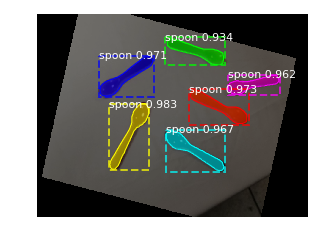

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  210.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   90.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


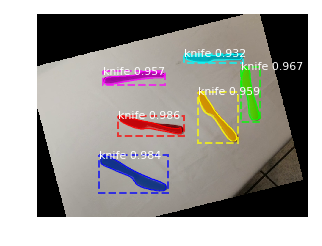

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  118.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


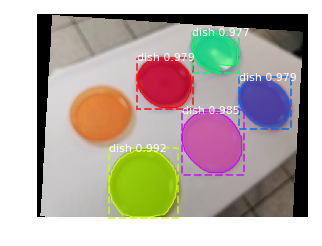

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  126.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   11.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


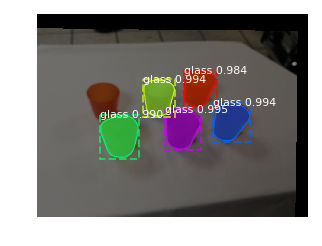

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  221.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  115.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


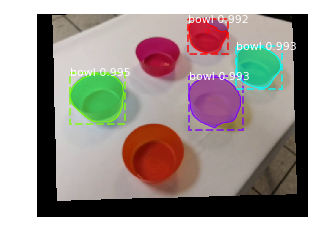

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  161.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   38.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


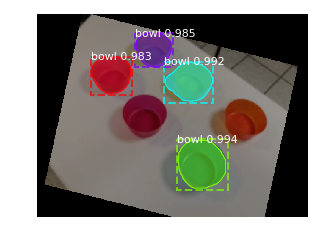

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  135.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


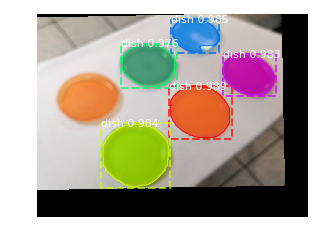

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  216.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   94.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


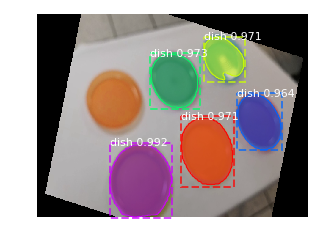

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  109.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


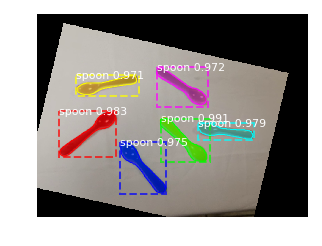

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  114.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


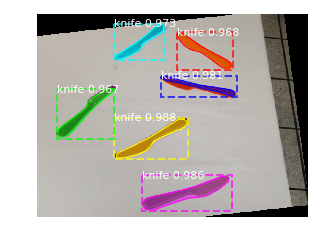

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  185.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   49.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


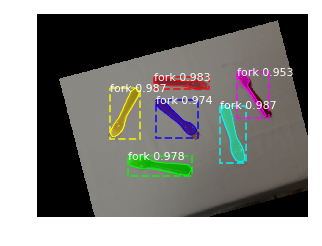

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  131.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


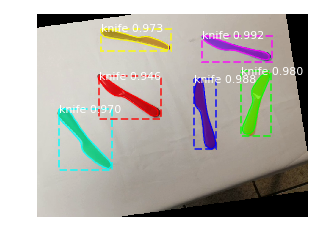

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  114.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


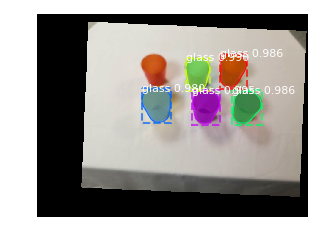

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  125.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   10.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


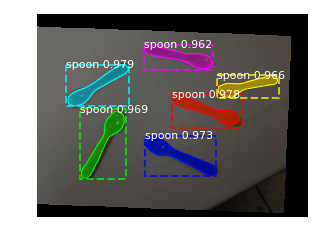

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  167.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   36.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


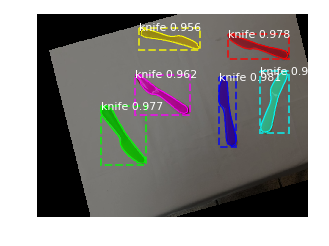

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  232.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  111.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


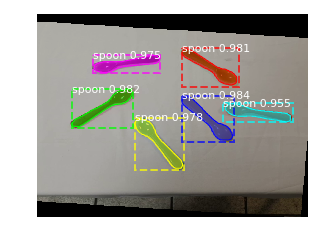

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  145.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


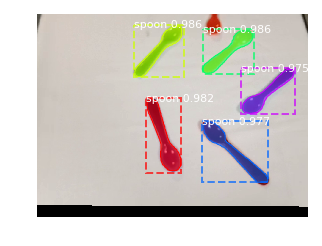

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  189.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   69.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


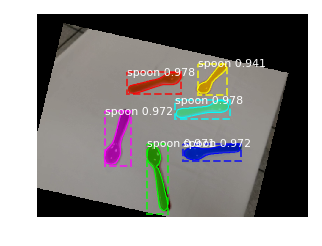

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  216.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   92.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


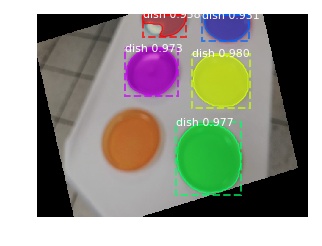

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  133.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   15.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


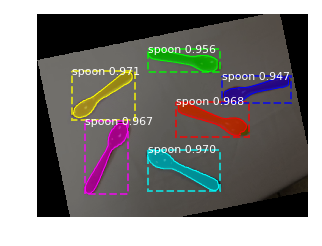

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  201.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   75.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


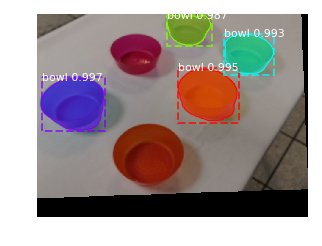

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  136.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   12.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


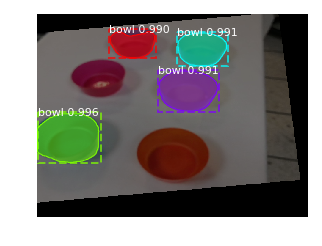

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  172.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   57.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


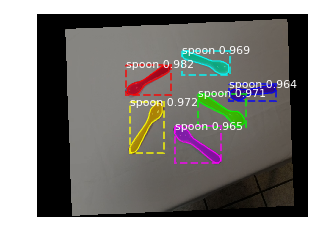

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  156.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   41.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


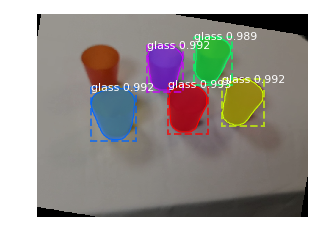

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  145.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


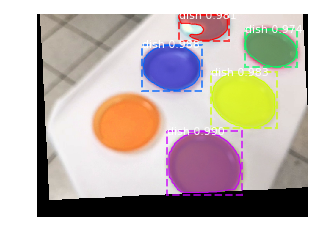

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  241.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  117.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


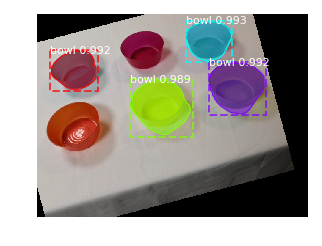

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  190.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   67.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


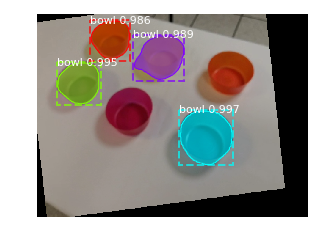

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  146.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   15.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


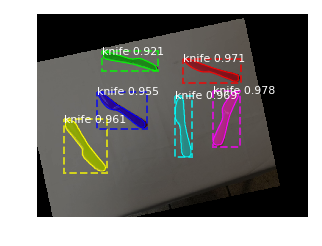

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  193.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   69.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


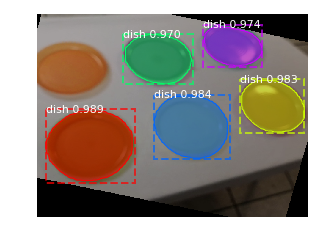

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  105.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


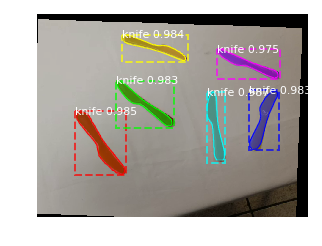

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  130.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


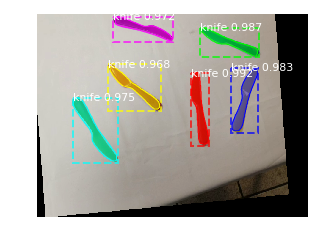

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  139.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


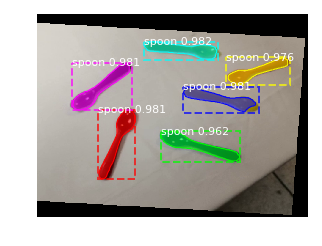

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  128.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


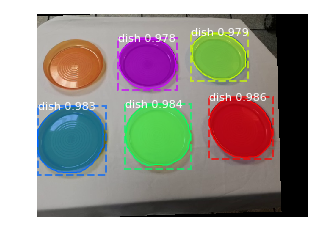

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  120.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


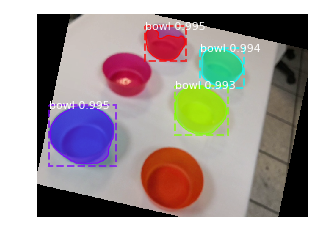

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  161.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   35.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


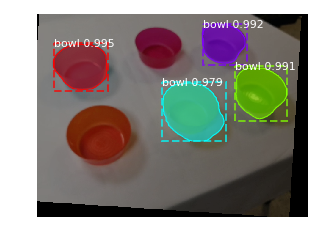

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  123.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


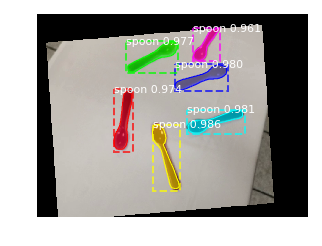

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  131.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


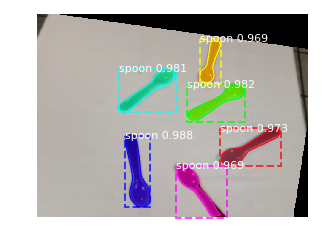

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  180.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   64.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


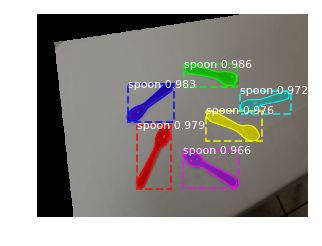

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  164.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   50.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


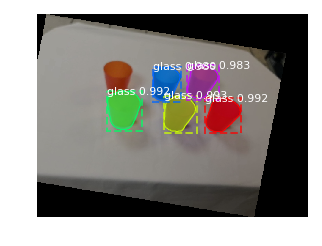

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  223.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   99.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


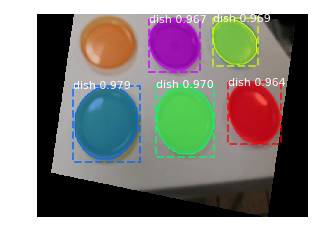

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  160.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   36.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


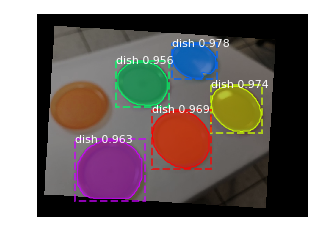

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  206.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   77.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


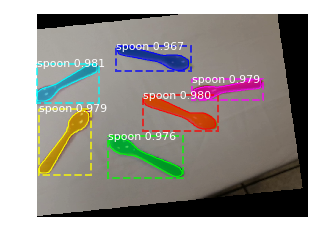

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  208.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   83.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


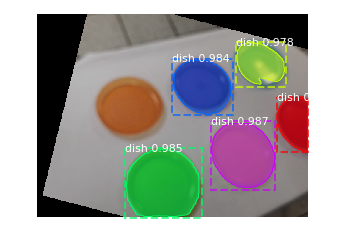

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  103.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


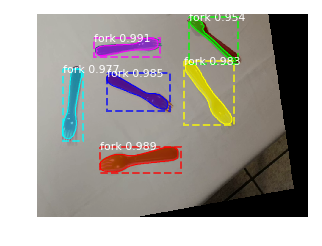

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  205.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   79.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


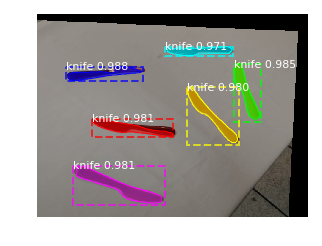

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  176.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   47.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


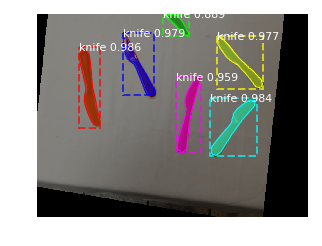

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  165.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   48.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


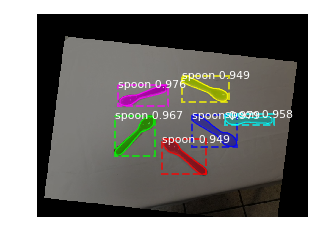

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  192.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   62.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


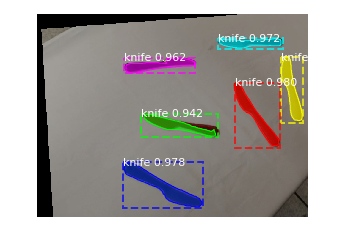

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  176.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   52.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


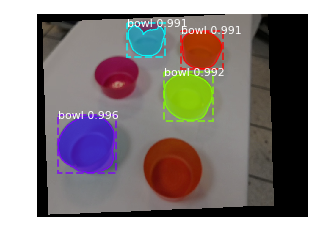

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  243.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  117.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


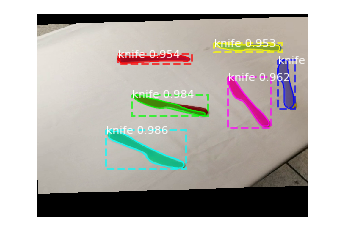

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  130.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


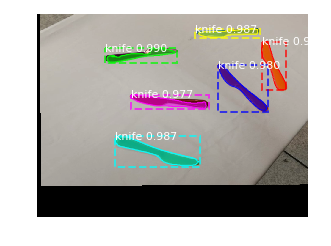

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  219.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   94.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


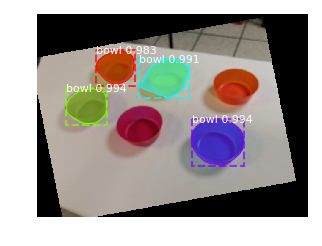

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  124.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


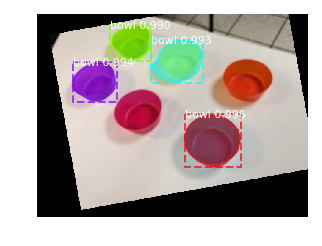

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  246.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  124.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


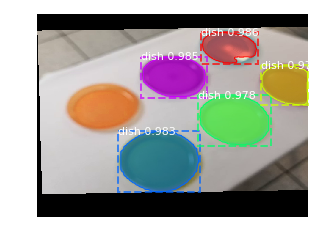

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  227.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  104.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


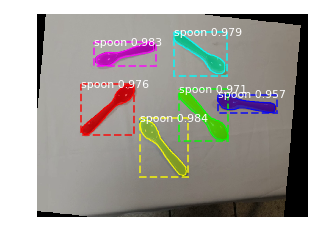

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  195.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   67.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


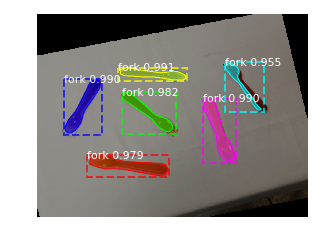

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  122.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


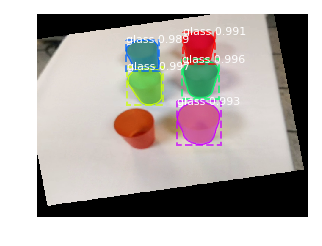

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  164.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   58.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


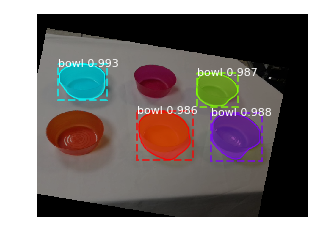

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  252.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  114.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


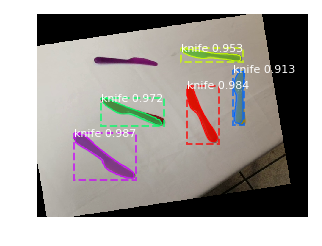

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  199.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   79.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


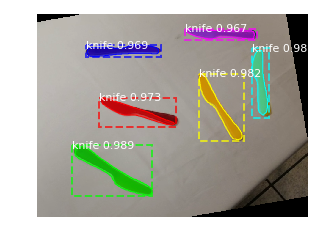

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  169.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   53.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


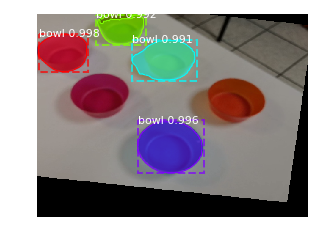

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  126.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


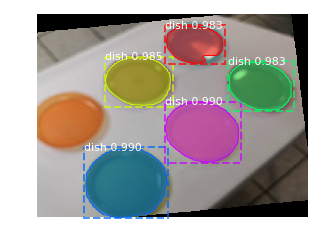

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  204.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   84.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


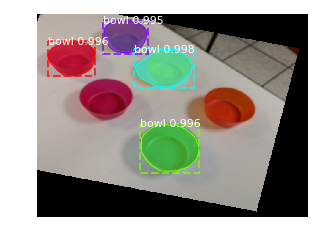

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  179.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   54.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


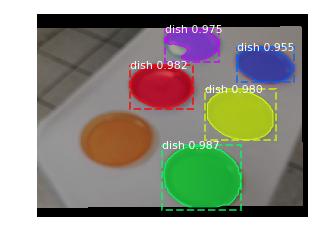

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  191.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   68.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


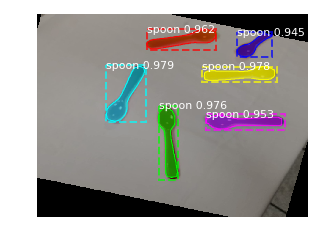

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  132.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   15.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


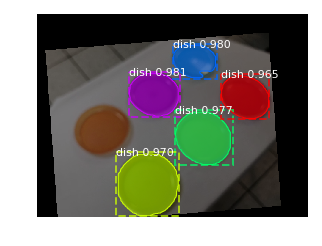

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  191.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   67.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


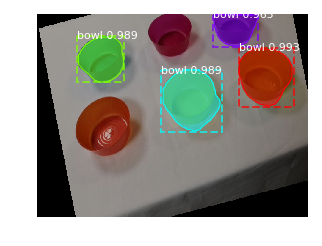

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


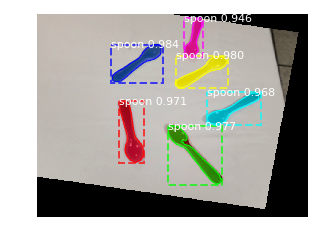

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  133.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   15.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


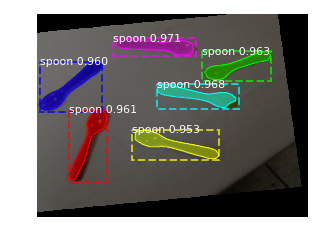

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  157.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   37.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


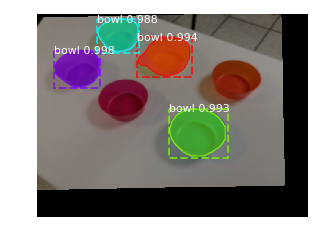

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  115.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


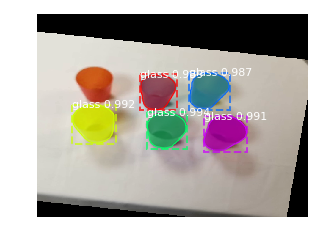

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  181.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   49.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


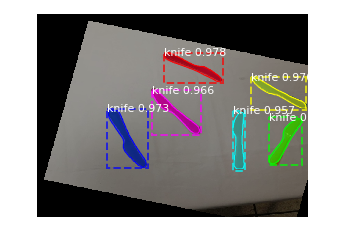

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  132.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


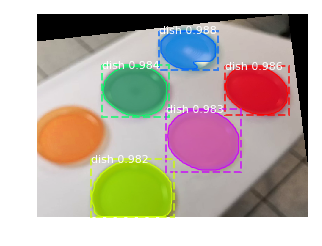

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  160.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   38.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


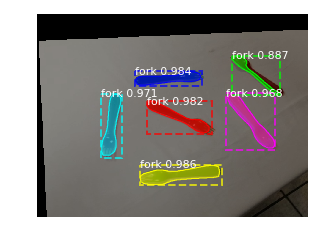

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  128.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


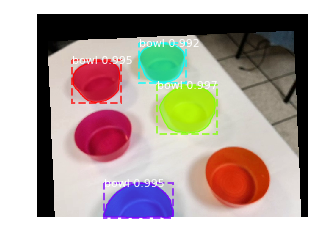

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  124.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


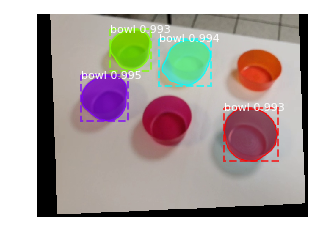

DEBUG:PIL.PngImagePlugin:STREAM 'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM 'IDAT' 41 65536


Processing 1 images
image                    shape: (480, 640, 3)         min:    0.00000  max:  202.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:   74.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max:  640.00000  float64
anchors                  shape: (1, 65472, 4)         min:   -0.17712  max:    1.05188  float32


KeyboardInterrupt: 

In [16]:
import skimage
#real_test_dir = '/home/biorobotica/docker_volumen/datasets/tableware/val/tableware_val2019'
real_test_dir = '/home/biorobotica/docker_volumen/datasets/tableware/val/images'
image_paths = []
for filename in os.listdir(real_test_dir):
    if os.path.splitext(filename)[1].lower() in ['.png', '.jpg', '.jpeg']:
        image_paths.append(os.path.join(real_test_dir, filename))

for image_path in image_paths:
    img = skimage.io.imread(image_path)
    img_arr = np.array(img)
    results = model.detect([img_arr], verbose=1)
    r = results[0]
    visualize.display_instances(img, r['rois'], r['masks'], r['class_ids'], 
                                dataset_val.class_names, r['scores'], figsize=(5,5))